# TO-DO:

- make tables of data for database

# Add Data
- three columns (filename, velocity, velocity error)
- check db maintenance

In [1]:
%load_ext autoreload
%autoreload 2

# Always run

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import composite
%matplotlib inline
from numpy import trapz
import copy
import glob as glob
from numpy import trapz
from astropy.time import Time
from scipy import interpolate
import spectral_analysis as sa
import sqlite3 as sq3
c = 299792 #speed of light in km/s

In [8]:
def gsmooth(x_array, y_array, var_y, vexp = .001, nsig = 5.0):
    #returns smoothed flux array
    # if no variance array create a constant one
    if len(var_y) == 0:
        var_y = np.zeros(len(y_array))
        
    for i in range(len(var_y)):
        if var_y[i] == 0:
            var_y[i] = 1E-20
            # var_y[i] = 1E-31
    
    # Output y-array
    new_y = np.zeros(len(x_array), float)
    
    # Loop over y-array elements
    for i in range(len(x_array)):
        
        # Construct a Gaussian of sigma = vexp*x_array[i]
        gaussian = np.zeros(len(x_array), float)
        sigma = vexp*x_array[i]
        
        # Restrict range to +/- nsig sigma
        sigrange = np.nonzero(abs(x_array-x_array[i]) <= nsig*sigma)
        gaussian[sigrange] = (1/(sigma*np.sqrt(2*np.pi)))*np.exp(-0.5*((x_array[sigrange]-x_array[i])/sigma)**2)
        
        # Multiply Gaussian by 1 / variance
        W_lambda = gaussian / var_y
        
        # Perform a weighted sum to give smoothed y value at x_array[i]
        W0 = np.sum(W_lambda)
        W1 = np.sum(W_lambda*y_array)
        new_y[i] = W1/W0

    # Return smoothed y-array
    return new_y

In [9]:
def autosmooth(x_array, y_array, var_y):
    new_y_init = gsmooth(x_array, y_array, var_y, .001)
    SNR = np.mean(new_y_init / var_y)
    
    if SNR < 5:
        vexp_auto = .0045#.0025 #temp value, need to fine tune using SNR in excel spreadsheet
    elif 5 <= SNR < 20:
        vexp_auto = .004#.002
    elif 20 <= SNR < 40:
        vexp_auto = .003#.0015
    elif 40 <= SNR < 60:
        vexp_auto = .002#.001
    elif 60 <= SNR < 100:
        vexp_auto = .0015#.00075
    else:
        vexp_auto = .001#.0005
    
    new_y = gsmooth(x_array, y_array, var_y, vexp_auto)
    return new_y

In [10]:
def autovexp(x_array, y_array, var_y):
    new_y_init = gsmooth(x_array, y_array, var_y, .001)
    SNR = np.mean(new_y_init / var_y)
        
    if SNR < 5:
        vexp_auto = .0045#.0025 #temp value, need to fine tune using SNR in excel spreadsheet
    elif 5 <= SNR < 20:
        vexp_auto = .004#.002
    elif 20 <= SNR < 40:
        vexp_auto = .003#.0015
    elif 40 <= SNR < 60:
        vexp_auto = .002#.001
    elif 60 <= SNR < 100:
        vexp_auto = .0015#.00075
    else:
        vexp_auto = .001#.0005
            
    return vexp_auto

In [15]:
sn_query = "SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN where phase >= -5 and phase <= 5"

In [16]:
SN_Array = composite.grab(sn_query, multi_epoch = False, make_corr = True, selection = "max_coverage")

1030 Total Spectra found
37 flagged spectra removed 993 spectra left
22 spectra of peculiar Ias removed 971 spectra left
203 spectra of SNe that have host reddening corrections
Arrays cleaned


In [17]:
SN_attributes = dir(SN_Array[0])
print(SN_attributes)

['Bmag_salt', 'Bmag_salt2', 'Ebv_host', 'SNR', '__class__', '__delattr__', '__dict__', '__doc__', '__format__', '__getattribute__', '__hash__', '__init__', '__module__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'av_25', 'av_mlcs17', 'av_mlcs31', 'av_mw', 'b_minus_v_cfa', 'b_minus_v_cfa_err', 'bias_lc', 'c_lc', 'c_salt', 'c_salt2', 'carbon', 'cov_mb_c_lc', 'cov_mb_s_lc', 'cov_s_c_lc', 'csp_light_curves', 'czCMB_host', 'czLG_host', 'cz_host', 'dec', 'delta_mlcs17', 'delta_mlcs31', 'dm15', 'dm15_array', 'dm15_from_fits', 'dm15_source', 'e_Bmag_salt', 'e_Bmag_salt2', 'e_av_mlcs17', 'e_av_mlcs31', 'e_c_lc', 'e_c_salt', 'e_c_salt2', 'e_delta_mlcs17', 'e_delta_mlcs31', 'e_dm15', 'e_logMst_lc', 'e_mb_lc', 'e_mu_mlcs17', 'e_mu_mlcs31', 'e_mu_salt', 'e_mu_salt2', 'e_s_salt', 'e_tmax_lc', 'e_v', 'e_x1_lc', 'e_x1_salt2', 'e_zCMB_mlcs17', 'e_zCMB_mlcs31', 'e_zCMB_salt', 'e_zCMB_salt2', 'filename', 'filt_host', '

In [18]:
for i, sn in enumerate(SN_Array):
    print(i, sn.name, sn.filename, sn.phase, sn.source)

(0, u'1991bg', u'sn1991bg-19911214-noz.flm', 1.6783071820396274, u'bsnip')
(1, u'1994d', u'1994D_19940317_2999_10549_00.dat', -4.576581395491049, u'other')
(2, u'1994s', u'sn1994s-19940616-uoi.flm', 0.9988405962732136, u'bsnip')
(3, u'1995d', u'sn1995d-19950224-uohp.flm', 3.670915125858948, u'bsnip')
(4, u'1995e', u'sn1995e-19950224-uoi2.flm', -2.176803499498083, u'bsnip')
(5, u'1997br', u'sn1997br-19970416-uoi.flm', -4.418660365560601, u'bsnip')
(6, u'1997y', u'sn1997y-19970209-uohp.flm', 2.7720191442561264, u'bsnip')
(7, u'1998dk', u'sn1998dk-19980831-ui.flm', -0.7283716550889345, u'bsnip')
(8, u'1998dm', u'sn1998dm-19980831-ui-corrected.flm', -4.865205879574189, u'bsnip')
(9, u'1998dx', u'sn1998dx-19980921-ui.flm', 4.71152240889689, u'bsnip')
(10, u'1998es', u'sn1998es-19981125-ui-corrected.flm', 0.4967508339381827, u'bsnip')
(11, u'1999aa', u'sn1999aa-19990223-ui.flm', 0.4603511483683075, u'bsnip')
(12, u'1999ac', u'sn1999ac-19990312-ui-corrected.flm', -0.3853392768725628, u'bsnip'

# Measurement Code

In [19]:
def find_min_wave(wavelength, flux, w1 = 5900, w2 = 6300):#, error = False, n = 1000):
    wave_domain = np.where((wavelength > w1) & (wavelength < w2))
    #print wavelength
    flux_range = []
    for position in wave_domain[0]:
        #print position
        fluxelem = flux[position]
        flux_range.append(fluxelem)
    
    #print flux_range
    elem_flux = np.amin(flux_range)
    min_index = np.where((flux == elem_flux))
    min_wave = wavelength[min_index][0]
    
    return min_wave

In [20]:
def find_max_wave(wavelength, flux, w1 = 5900, w2 = 6500):#, error = False, n = 1000):
    wave_domain = np.where((wavelength > w1) & (wavelength < w2))
    #print wavelength
    flux_range = []
    for position in wave_domain[0]:
        #print position
        fluxelem = flux[position]
        flux_range.append(fluxelem)
    
    elem_flux = np.amax(flux_range)
    max_index = np.where((flux == elem_flux))
    max_wave = wavelength[max_index][0]
    
    return max_wave

In [21]:
def find_velocity(wavelength_obs, wavelength_rest):
    ejecta_velocity = c * (wavelength_obs - wavelength_rest) / wavelength_rest
    return ejecta_velocity

In [22]:
def si_velocity(min_wave):
    si_velocity = find_velocity(min_wave, 6355.)
    
    return si_velocity

In [39]:
def si_velocity_error(wavelength, flux, flux_error, n=100):
    
    v_dist = []
    
    flux = gsmooth(wavelength, flux, flux_error, .001)
    
    SNR = np.mean(flux / flux_error)
    #print SNR
    
    if SNR < 5:
        vexp_auto = .0045#.0025 #temp value, need to fine tune using SNR in excel spreadsheet
    elif 5 <= SNR < 20:
        vexp_auto = .004#.002
    elif 20 <= SNR < 40:
        vexp_auto = .003#.0015
    elif 40 <= SNR < 60:
        vexp_auto = .002#.001
    elif 60 <= SNR < 100:
        vexp_auto = .0015#.00075
    else:
        vexp_auto = .001#.0005
        
    #print vexp_auto
    for i in range(n):
        #sample_vexp = np.random.normal(vexp_auto, vexp_auto / 4)
        sample_vexp = np.random.uniform(.001, .0045)
        #print sample_vexp
        sample_flux = gsmooth(wavelength, flux, flux_error, sample_vexp)
        min_wave = find_min_wave(wavelength, sample_flux)
        
        sample_v = si_velocity(min_wave)
        v_dist.append(sample_v)
        
    sigma = np.std(v_dist)
    
    #print v_dist
    return sigma
        

In [40]:
def ca_velocity(min_wave):
    ca_velocity = find_velocity(min_wave, 3950)
    
    return ca_velocity

In [25]:
def ca_velocity_error(wavelength, flux, flux_error, n=100):
    
    v_dist = []
    
    flux = gsmooth(wavelength, flux, flux_error, .001)
    
    SNR = np.mean(flux / flux_error)
    print SNR
    
    if SNR < 5:
        vexp_auto = .0045#.0025 #temp value, need to fine tune using SNR in excel spreadsheet
    elif 5 <= SNR < 20:
        vexp_auto = .004#.002
    elif 20 <= SNR < 40:
        vexp_auto = .003#.0015
    elif 40 <= SNR < 60:
        vexp_auto = .002#.001
    elif 60 <= SNR < 100:
        vexp_auto = .0015#.00075
    else:
        vexp_auto = .001#.0005
        
    print vexp_auto
    for i in range(n):
        #sample_vexp = np.random.normal(vexp_auto, vexp_auto / 4)
        sample_vexp = np.random.uniform(.001, .0045)
        print sample_vexp
        sample_flux = gsmooth(wavelength, flux, flux_error, sample_vexp)
        min_wave = find_min_wave(wavelength, sample_flux, 3650, 4100)
        
        sample_v = ca_velocity(min_wave)
        v_dist.append(sample_v)
        
    sigma = np.std(v_dist)
    
    print v_dist
    return sigma

In [26]:
def v_0(v_obs, phase):
    v_0 = (v_obs + .285*phase) / (1 - .0322*phase)
    
    return v_0

In [27]:
def intrinsic_color(v_0):
    B0V0 = -0.39 - (0.033 * v_0 / 1000)
    return B0V0

In [28]:
# wavelength, flux, left boundary domain 1, right boundary domain 1, left boundary domain 2, right boundary domain 2
def eq_width(wavelength, flux, b1w1=5900, b1w2=6100, b2w1=6250, b2w2=6450):
    
    
    max1 = find_max_wave(wavelength, flux, b1w1, b1w2)
    max2 = find_max_wave(wavelength, flux, b2w1, b2w2)
    #print max1, max2
    flux1 = flux[np.where(wavelength == max1)][0]
    flux2 = flux[np.where(wavelength == max2)][0]
    #print(flux1, flux2)
    domain = np.where((wavelength > max1) & (wavelength < max2))
    
    wave_range = []
    flux_range = []
   
    for index in domain:
        wave_range.append(wavelength[index])
        flux_range.append(flux[index])
        
    #fit normal line over dip
    line_elem = np.polyfit([max1, max2], [flux1, flux2], 1) 
    line = line_elem[1] + line_elem[0] * wave_range[0]
    
    #normalize spectrum
    norm = flux_range[0] / line
    
    a_curve = trapz((norm), x = wave_range)
    a_line = wave_range[0][-1] - wave_range[0][0]
    eq_width = a_line - a_curve
    
   # plt.figure(figsize=(10,4))
    #plt.plot(wave_range[0], line)#flux_range[0])
    #plt.plot(wave_range[0], flux_range[0])
    #plt.show()
    
    #print eq_width
    
    return eq_width[0]

In [29]:
def si_eq_width_error(wavelength, flux, var_flux, n = 100):
    
    si_eq_width_dist = []
    ideal_vexp = autovexp(wavelength, flux, var_flux)
    
    for i in range(n):
        sample_vexp = np.random.normal(ideal_vexp, ideal_vexp / 4) #temporary variable of randomness
        sample_flux = gsmooth(wavelength, flux, var_flux, sample_vexp)
        
        sample_eq_width = eq_width(wavelength, sample_flux)
        si_eq_width_dist.append(sample_eq_width)
        
    sigma = np.std(si_eq_width_dist)
    
    return sigma

In [30]:
def si_ratio(wavelength, flux):
    max1 = find_max_wave(wavelength, flux, 5500, 5700)
    max2 = find_max_wave(wavelength, flux, 5700, 6000)
    max3 = find_max_wave(wavelength, flux, 6000, 6500)
    
    maxindex1 = np.where(wavelength == max1)
    maxindex2 = np.where(wavelength == max2)
    maxindex3 = np.where(wavelength == max3)
    
    domain1 = np.where((wavelength >= max1) & (wavelength <= max2))
    line_elem1 = np.polyfit([max1, max2], [flux[maxindex1], flux[maxindex2]], 1)
    
    domain1 = np.ndarray.tolist(domain1[0])
    
    differences1 = []
    for index in domain1:
        line_flux = line_elem1[0]*wavelength[index] + line_elem1
        dip_flux = flux[index]
        differences1.append(line_flux - dip_flux)
        small_silc = np.amax(differences1)
        #print(small_silc)
        
        
    domain2 = np.where((wavelength >= max2) & (wavelength <= max3))
    line_elem2 = np.polyfit([max2, max3], [flux[maxindex2], flux[maxindex3]], 1)
    
    domain1 = np.ndarray.tolist(domain2[0])
    
    differences2 = []
    for index in domain2:
        line_flux = line_elem2[0]*wavelength[index] + line_elem2
        dip_flux = flux[index]
        differences2.append(line_flux - dip_flux)
        big_silc = np.amax(differences2)
        #print(big_silc)
        
    si_ratio = small_silc / big_silc
    
    
    return si_ratio

In [31]:
def si_ratio_error(wavelength, flux, flux_error, n = 100):
    
    si_ratio_dist = []
    ideal_vexp = autovexp(wavelength, flux, flux_error)
    
    for i in range(n):
        sample_vexp = np.random.normal(ideal_vexp, ideal_vexp / 4) #temporary variable of randomness
        #sample_vexp = np.random.uniform(.001, .0045)
        sample_flux = gsmooth(wavelength, flux, flux_error, sample_vexp)
        
        sample_si_ratio = si_ratio(wavelength, sample_flux)
        si_ratio_dist.append(sample_si_ratio)
        
    sigma = np.std(si_ratio_dist)
    
    return sigma

In [32]:
def eq_width_0(eq_width, phase):
    ew_0 = (eq_width + 4.48*phase) / (1 - 0.0339*phase)
    return ew_0

In [33]:
#v at max light for all spectra

# Graphs

In [34]:
test = SN_Array[9]

wavelength = test.wavelength[test.x1:test.x2]
flux = test.flux[test.x1:test.x2]
varflux = 1/test.ivar[test.x1:test.x2]
flux_error = np.sqrt(varflux)

print si_velocity_error(wavelength, flux, flux_error, 100)

32.94096616998766


(Scatter Plot) Equivalent Width vs. Velocity at Time of Max Light

In [35]:
vlist = []
ewlist = []
i = 0

for SN in SN_Array:

    
    
    wavelength = SN.wavelength[SN.x1:SN.x2]
    flux = autosmooth(wavelength, SN.flux[SN.x1:SN.x2], 1/SN.ivar[SN.x1:SN.x2])
    #print len(wavelength), len(flux), len(SN.ivar)
    
    if type(SN.v_at_max) == float:
        if SN.maxwave > 6500 and SN.minwave < 5800:
            min_wave = find_min_wave(wavelength, flux)
            v = si_velocity(min_wave)
        #try:
#             plt.plot(wavelength,flux)
#             plt.show()
            ewlist.append(eq_width(wavelength, flux))
        #if abs(SN.v_at_max) > 1000:
            vlist.append(v)

            print i
            i = i + 1
        #else:
             #vlist.append(v * 1000)
        #except:
            #print "hi"
            

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172


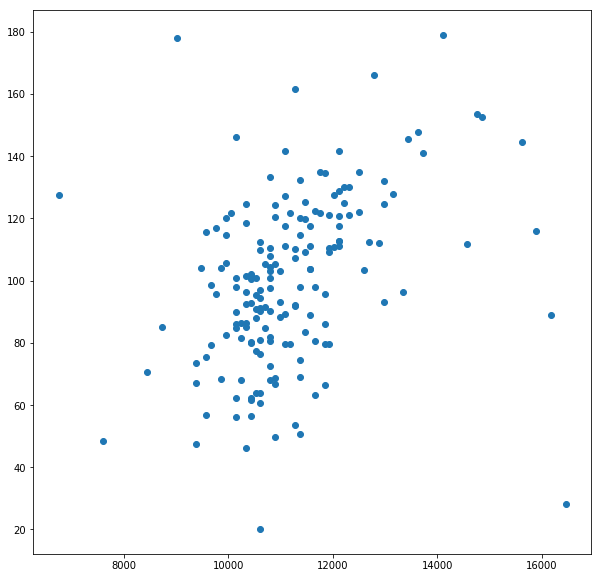

In [36]:
plt.figure(figsize=(10,10))
plt.scatter(np.abs(vlist), np.abs(ewlist))
plt.show()

(Scatter Plot) Silicon Ratio vs. Velocity at Time of Max Light (outliers filtered out)

C:\Anaconda3\envs\py27\lib\site-packages\ipykernel_launcher.py:10: RuntimeWarning: divide by zero encountered in divide
  # Remove the CWD from sys.path while we load stuff.


Could not find maximum in a specified range!
nan


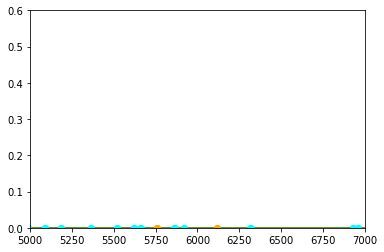

0.3228407215449737
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan


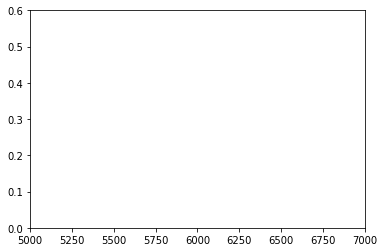

0.18819714427292203
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan


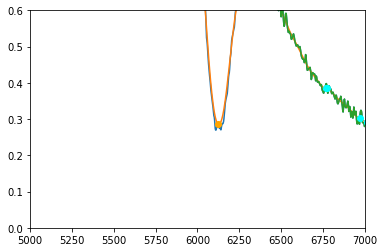

0.3847883382148858
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan


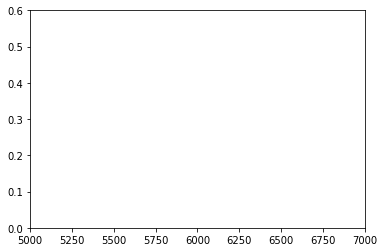

0.5331890625052783
Could not find maximum in a specified range!
nan


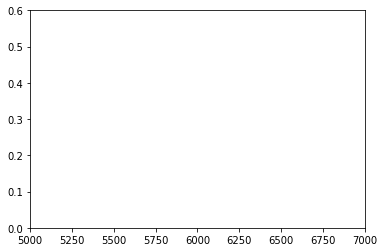

0.3332480904227945
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan


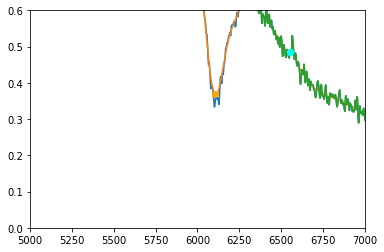

0.11131574796170052
Could not find maximum in a specified range!
nan


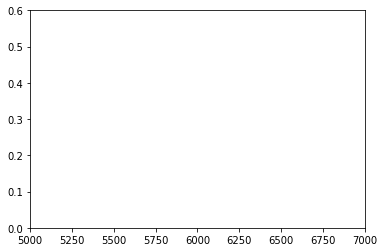

0.12809069492265399
Could not find maximum in a specified range!
nan


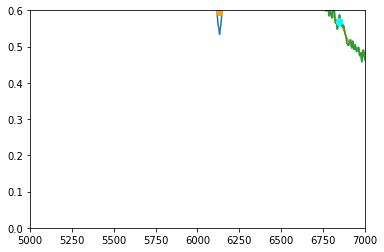

0.17931222186677995
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan


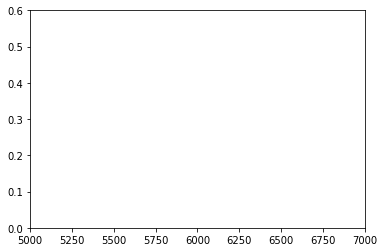

0.11988407531510079
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan


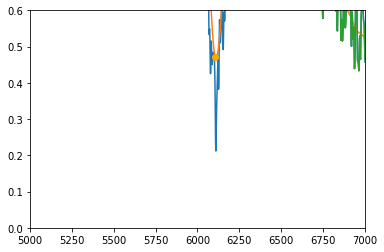

0.23291096281224777
Could not find maximum in a specified range!
nan


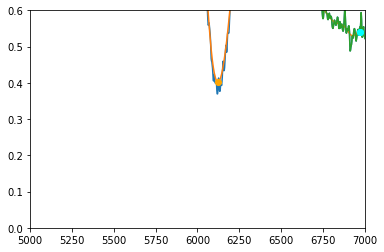

0.5493292875502201


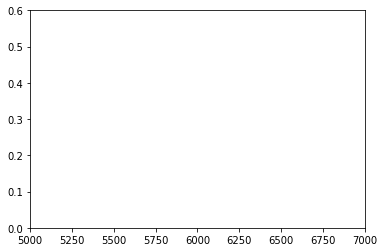

0.38497101878280876


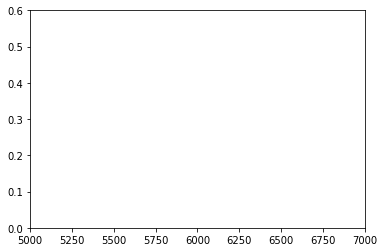

0.3835480039130737


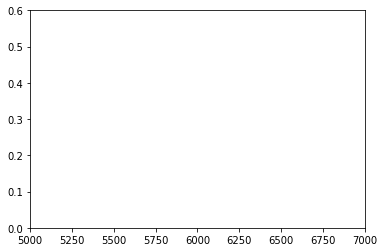

0.256438372134541


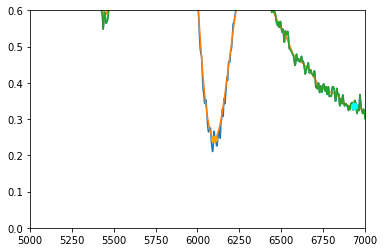

0.28635830948892105


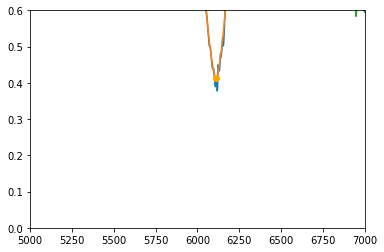

0.3428167514796004


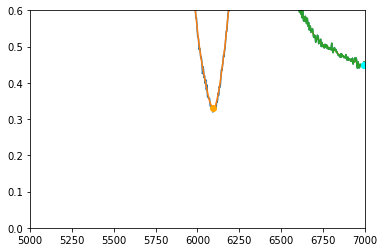

0.2184317685055165


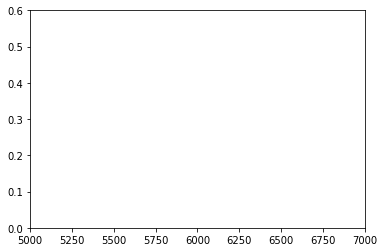

0.18044054867056164
Could not find maximum in a specified range!
nan


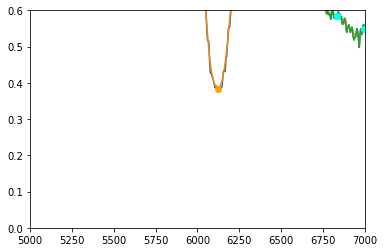

0.4768550842506673


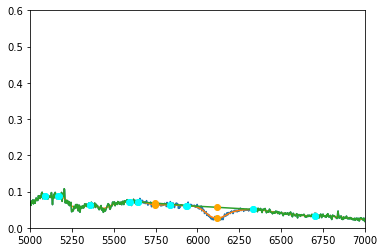

0.16727682738928276


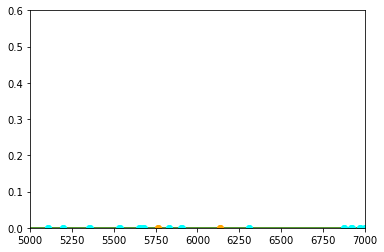

0.27109397449621864


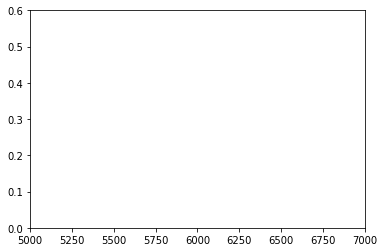

0.32279971112949785


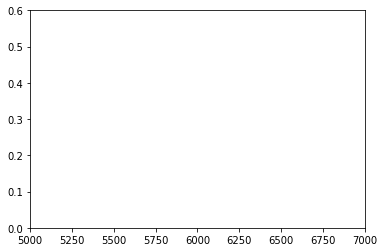

0.20243713648395117
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan


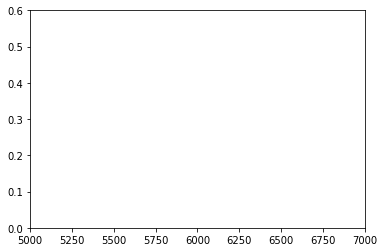

0.18311327628947785


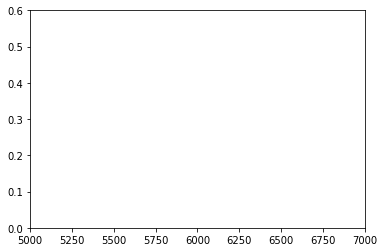

0.2906912264716415


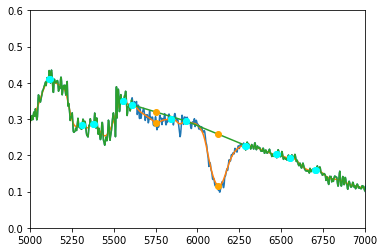

0.2068535225988586


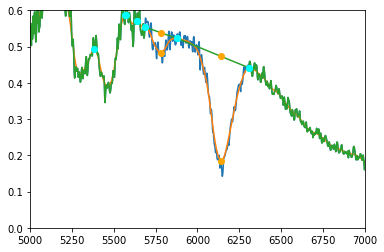

0.19394064674840392


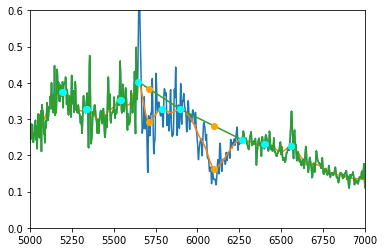

0.7714235695045308
Could not find maximum in a specified range!
nan


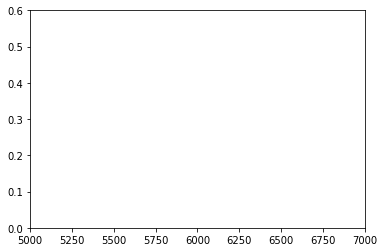

0.28956998127412326


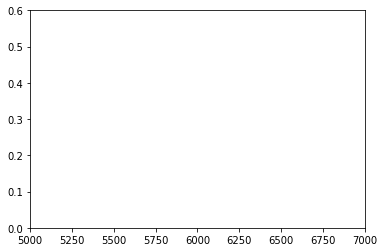

0.414041656905606


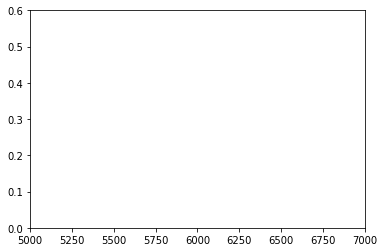

0.2963121939262837


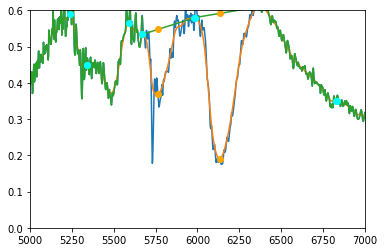

0.4437573066605446


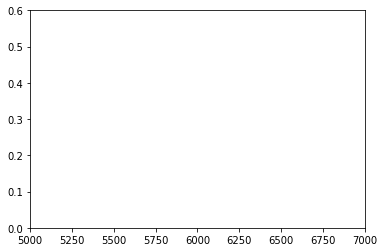

0.4722687070928848
Could not find maximum in a specified range!
nan


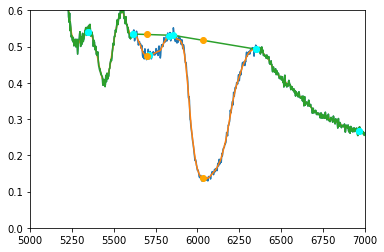

0.15274290265091753
Could not find maximum in a specified range!
nan


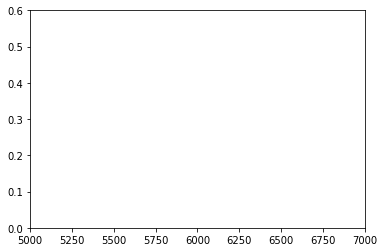

0.31571471874363644
Could not find maximum in a specified range!
nan


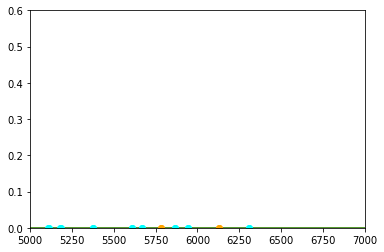

0.2378690938602062
Could not find maximum in a specified range!
nan


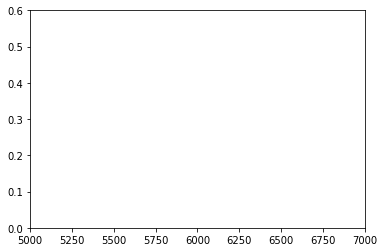

0.6568561842245753
Could not find maximum in a specified range!
nan


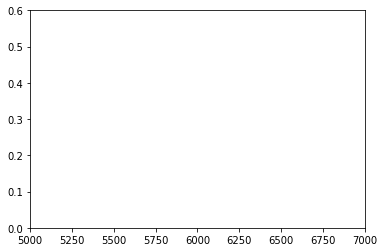

0.42184385242643363


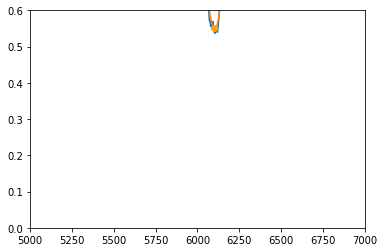

0.2699741480486159


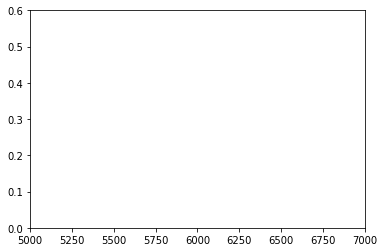

0.16801702275973063
Could not find maximum in a specified range!
nan


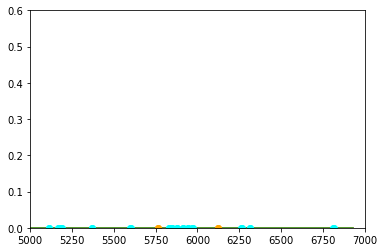

0.20817523542382016


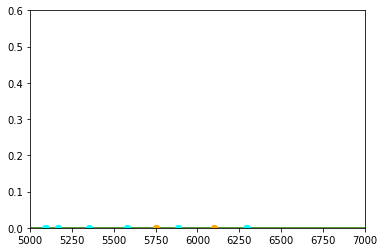

0.26647752472946595


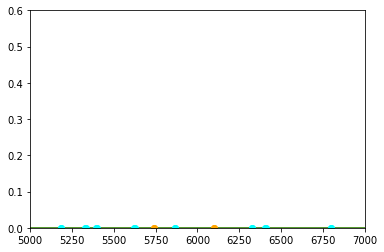

0.2996330118416288


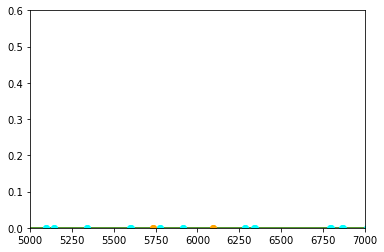

0.171613492371949


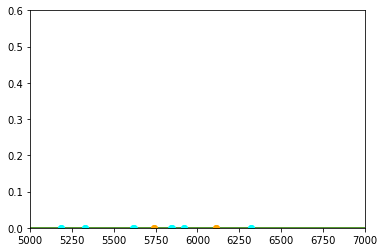

0.20572555586721653


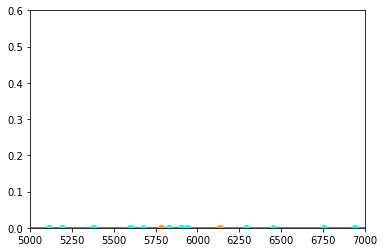

0.15513252676301603


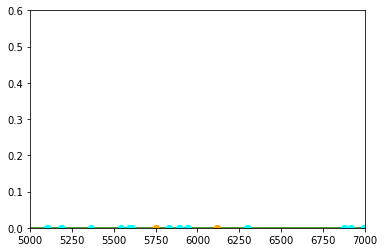

0.2164892864317321


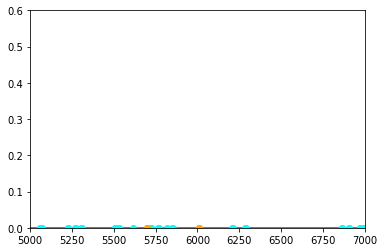

0.04063302343815334


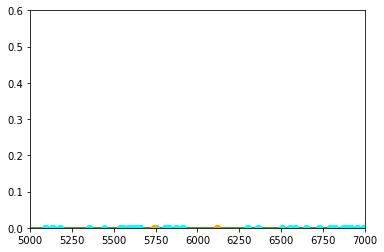

0.22740594257148491


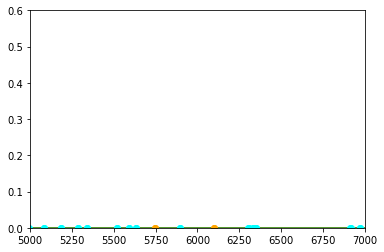

0.35589931121079993


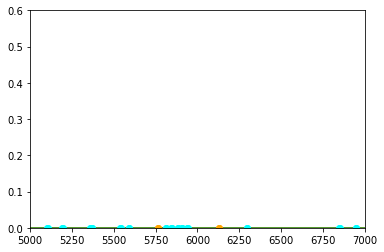

0.21301895557630535


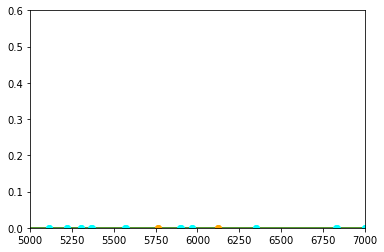

0.686570572779111


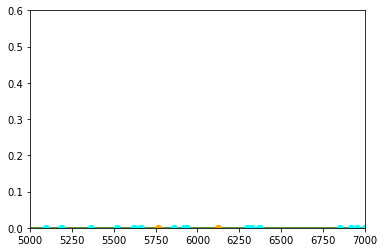

0.26007814261710077


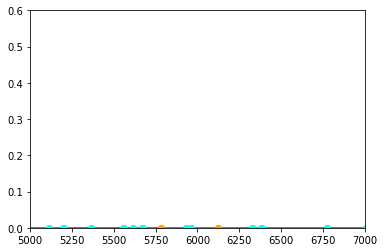

0.3539737351762958


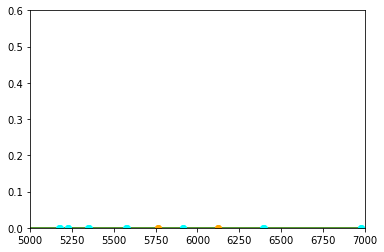

0.6244979996206642


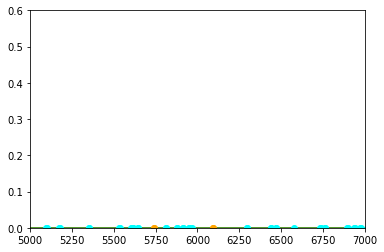

0.29574822300439374


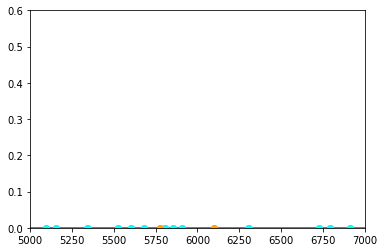

0.08495858008505239


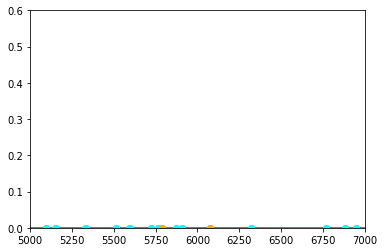

0.1763398618236187


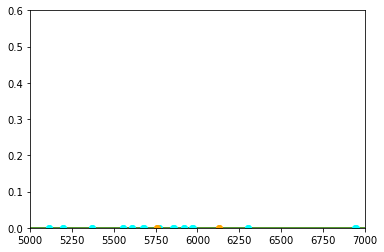

0.2752734266242261


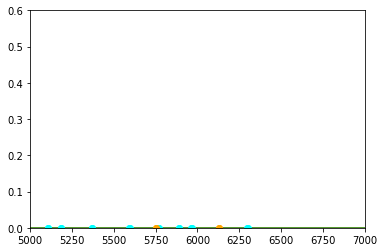

0.26853113118910943


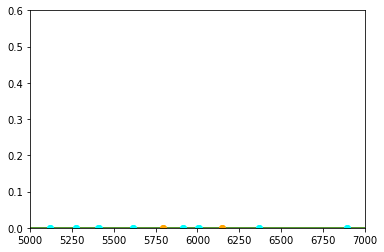

0.6861422270318269


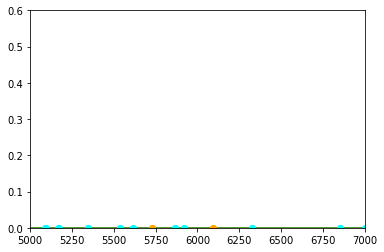

0.35143790712572165


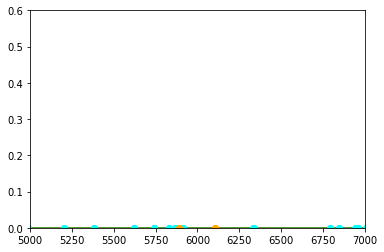

0.32519577768089963


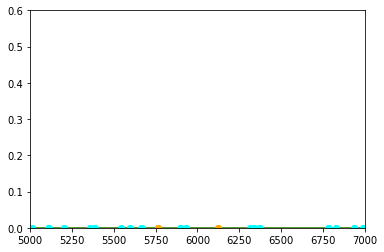

0.4158976235075985


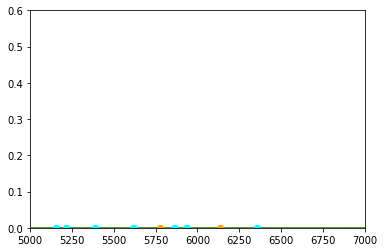

0.32024560358895593


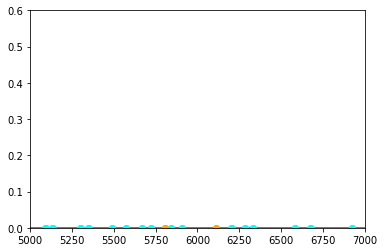

0.1486919343231764


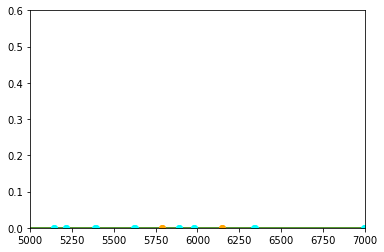

0.323634154876979


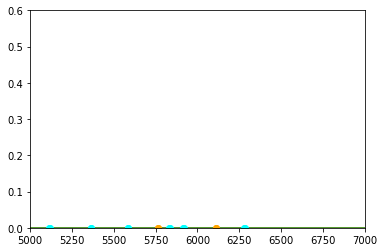

0.19447280211637924


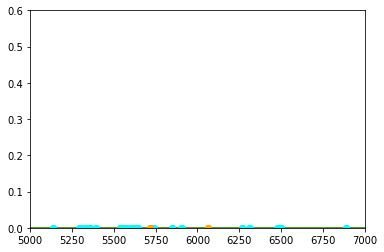

0.1370005707477817


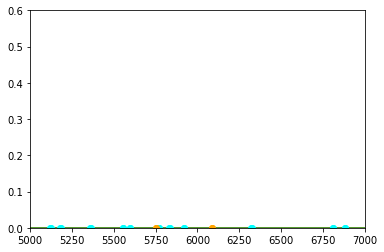

0.143145650863068


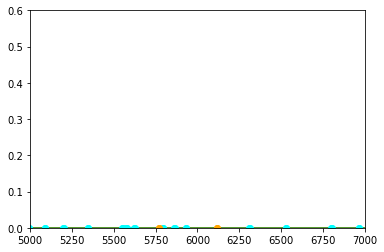

0.41070603076873224


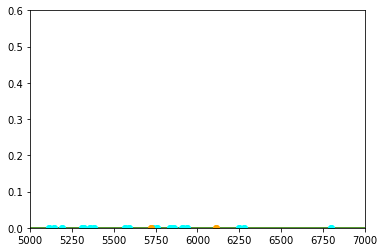

0.21192564237534342


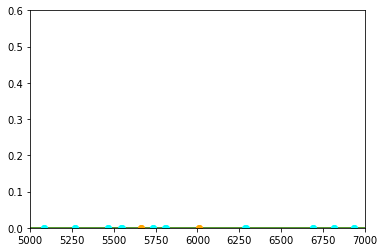

0.2485375589424827


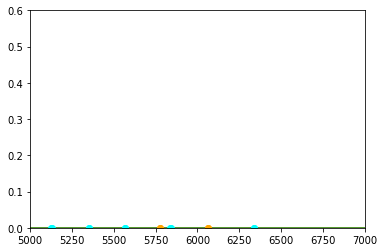

0.18877832708559564


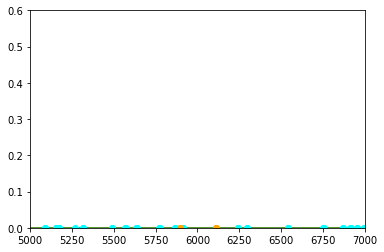

0.26018584133779865


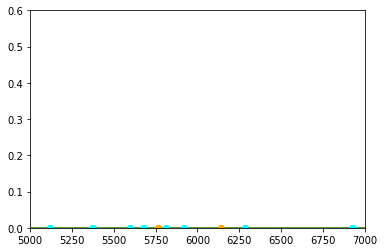

0.22976235255889546


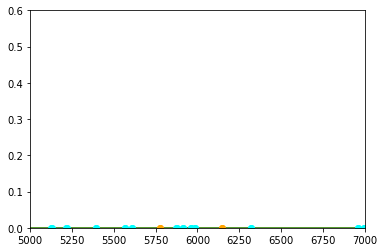

0.314134668424915


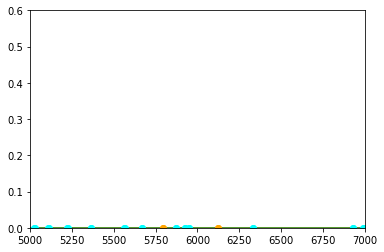

0.5438895426097337


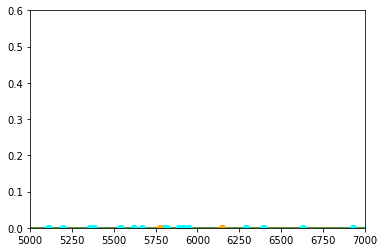

0.23859703020904457


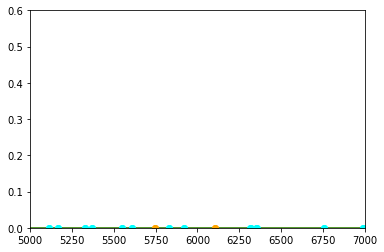

0.3324663053771509


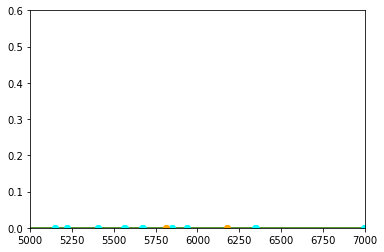

0.2523060555876569


spectral_analysis.py:10: RuntimeWarning: invalid value encountered in sqrt
  error = np.sqrt(var_y)


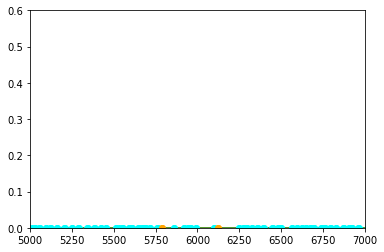

0.519020069146572


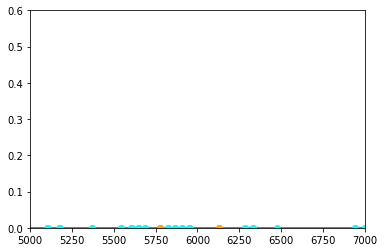

0.12941308396858814


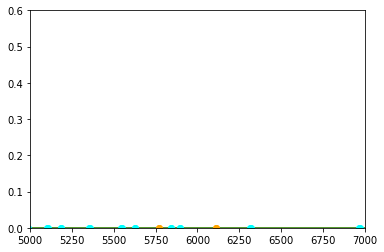

0.3059839575131656


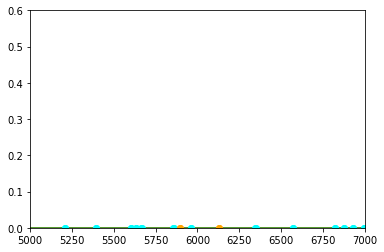

0.2842915673368157


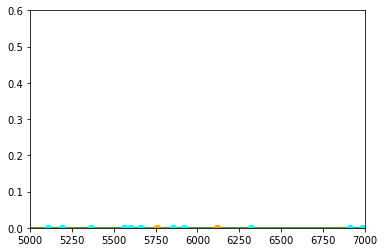

0.3174653766481515


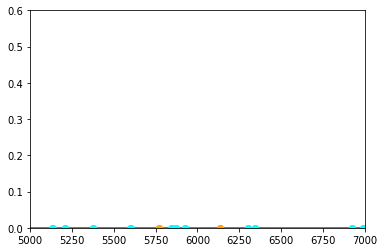

0.25642507091610023


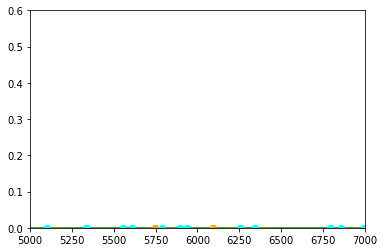

0.22155218542801408


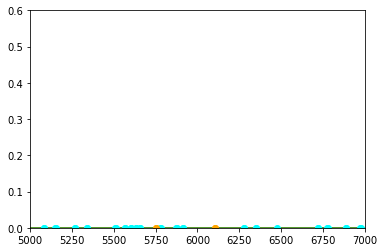

0.3453936447872727


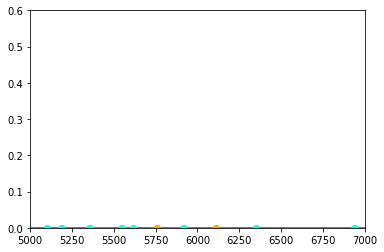

0.4655644597410384


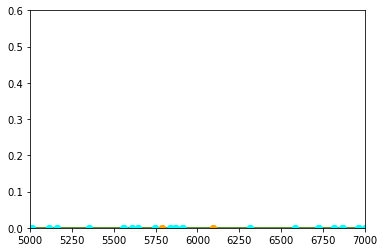

0.17725189617386544


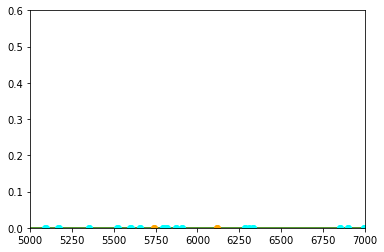

0.20026607767455398


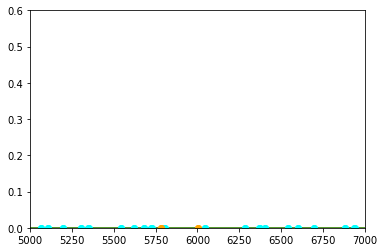

0.06152651922757245


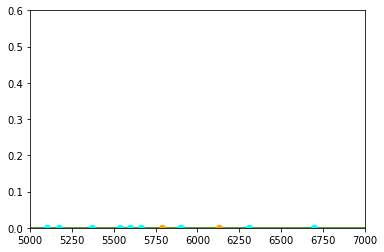

0.191857817410561


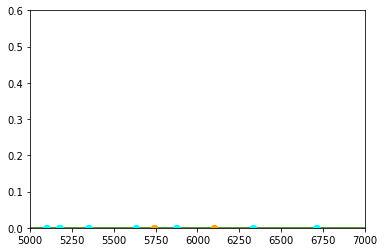

0.3270826215620332


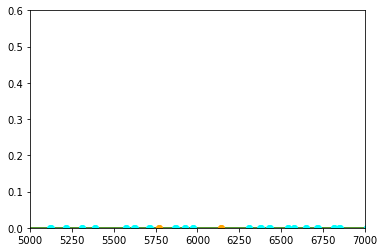

0.3906038105090727


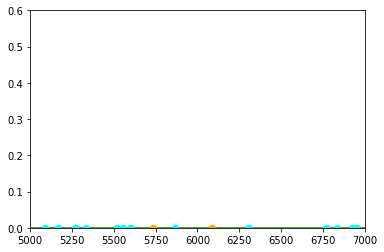

0.3971458818660905


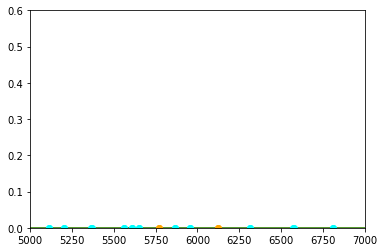

0.3094856364931083


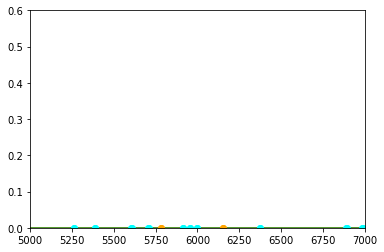

0.6928165047109378


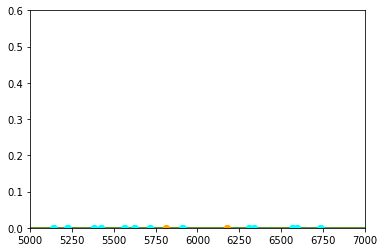

0.22939374184565126


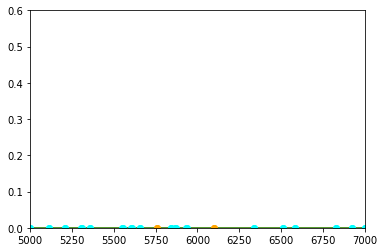

0.4663675898138669


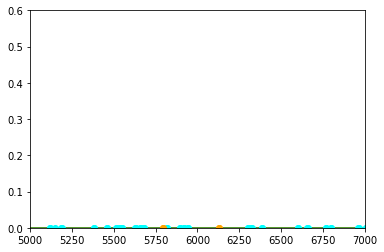

0.2013406956982955


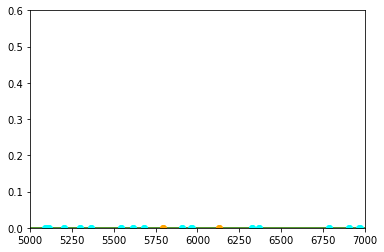

0.3210445720215498


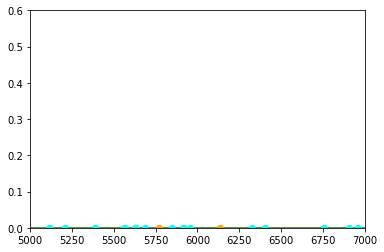

0.24943332798530787


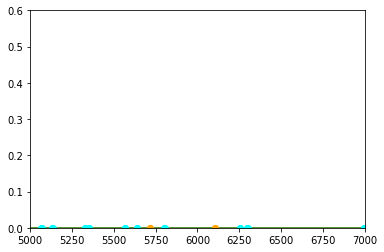

0.15570454982686127


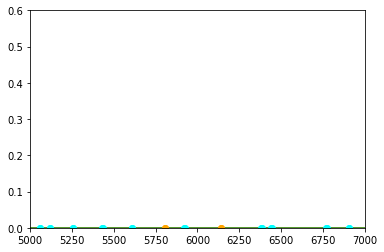

0.648828201627547


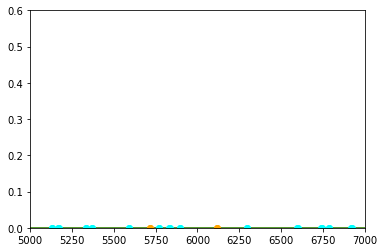

0.22716565918841455


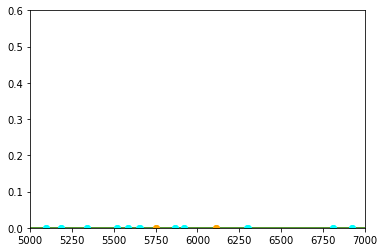

0.4028429017705928


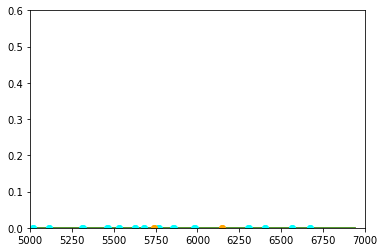

0.12256199357057049


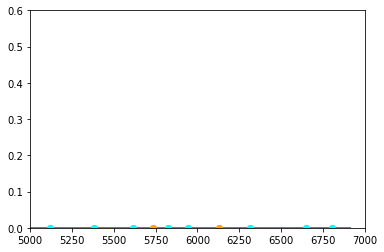

0.2185577589461175


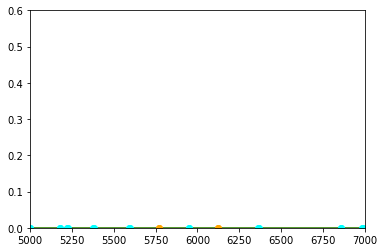

0.5950103193570616


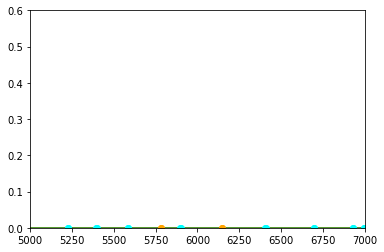

0.5863352048136614


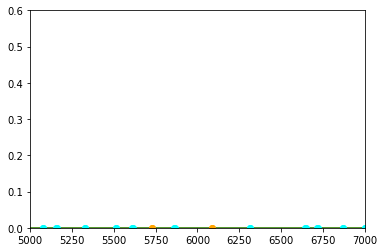

0.2610869731522032


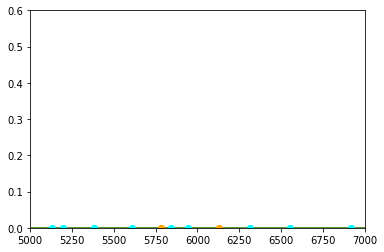

0.1753819035969008


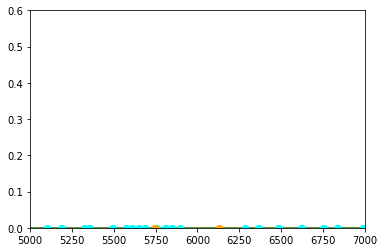

0.2437962330704016


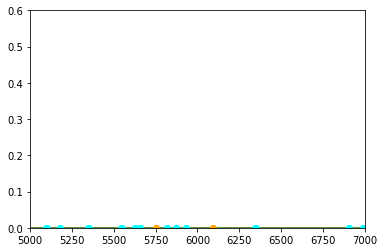

0.27519405850962775


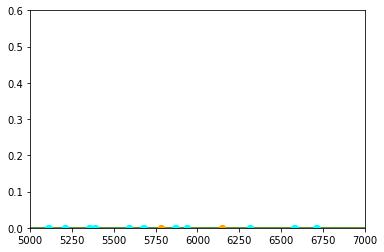

0.21881534130921254


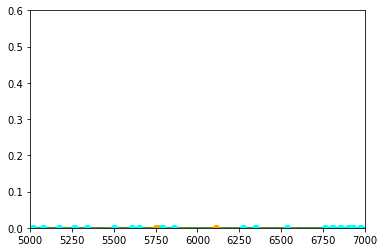

0.24406001579867248


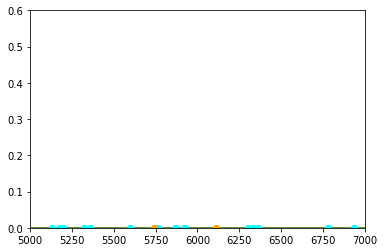

0.3554447459251924


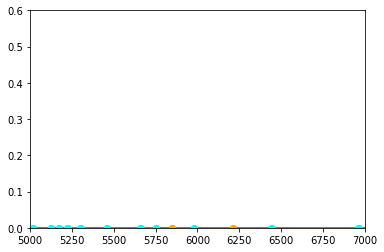

0.5863883314620105


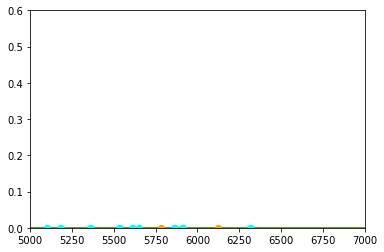

0.2022639155024577


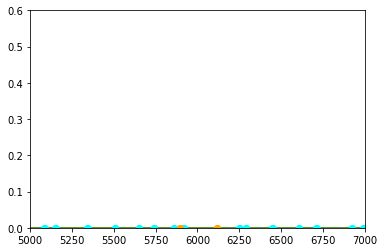

0.12182107936242931


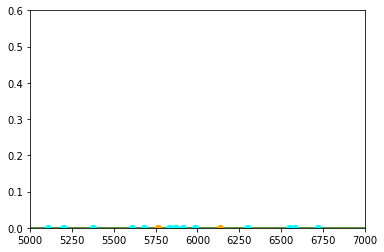

0.202834442100125


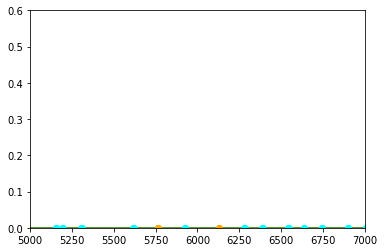

0.6892746721299204


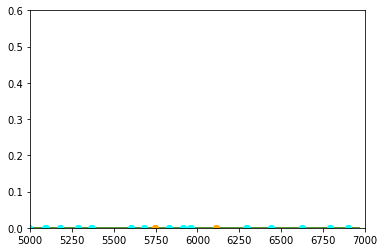

0.20488874116731115


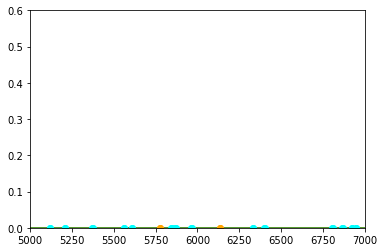

0.3385973228068667


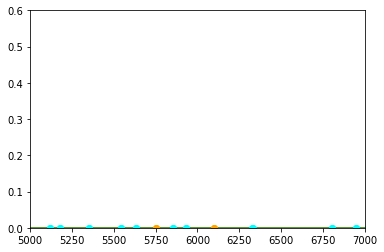

0.35120400440231236


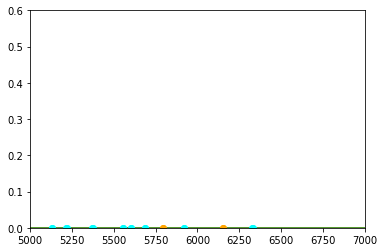

0.2583155380478906


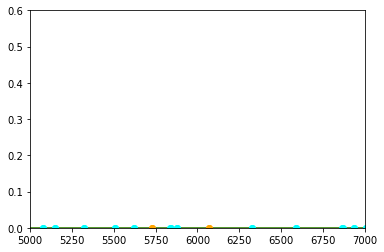

0.26338774508534446


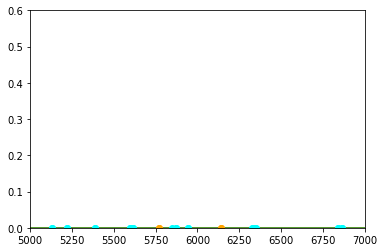

0.3674405915163139


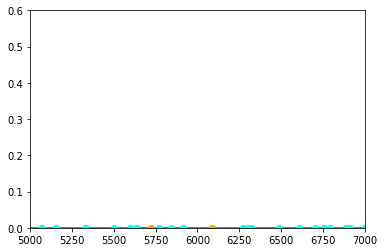

0.19830106913382098


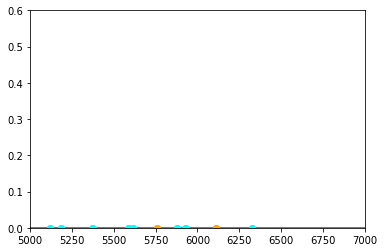

0.3525910176343618


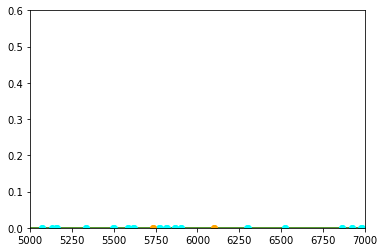

0.18706623678630763


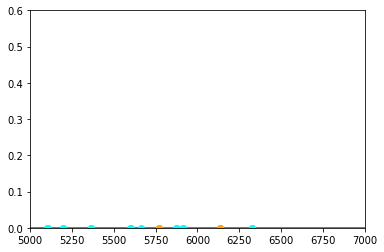

0.2331261244928061


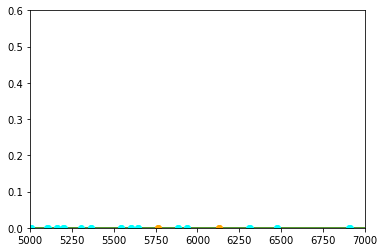

0.3209992972177543


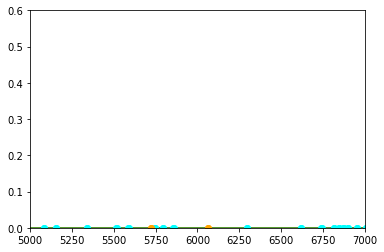

0.18143555619450408


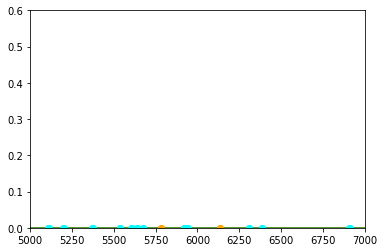

0.2586435226194902
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan
Could not find maximum in a specified range!
nan


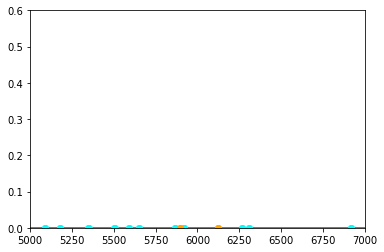

0.23351537193616156


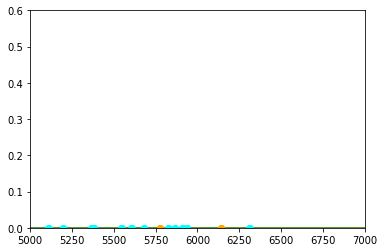

0.1933167536642116
Could not find maximum in a specified range!
nan


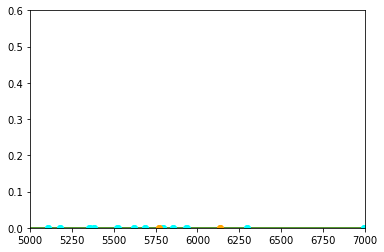

0.1233313503285889


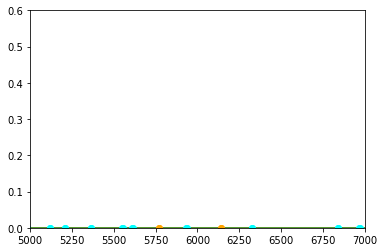

0.4771882792609376


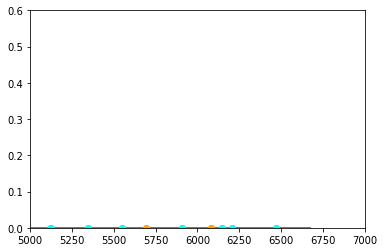

1.0327231121079155


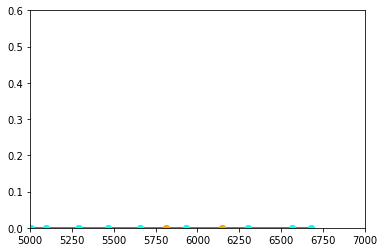

0.5165236720322626


IndexError: list index out of range

In [37]:
vlist = []
si_ratiolist = []
si_ratiolist_matt = []
for SN in SN_Array:
    wavelength = SN.wavelength[SN.x1:SN.x2]
    flux = gsmooth(wavelength, SN.flux[SN.x1:SN.x2], SN.ivar[SN.x1:SN.x2])
    
    if type(SN.v_at_max) == float:
#         si_ratiolist.append(si_ratio(wavelength, flux))
        var = 1./SN.ivar
        vexp, SNR = sa.autosmooth(SN.wavelength[SN.x1:SN.x2], SN.flux[SN.x1:SN.x2], var_y = var[SN.x1:SN.x2])
        r = sa.measure_si_ratio(SN.wavelength[SN.x1:SN.x2], SN.flux[SN.x1:SN.x2], varflux = var[SN.x1:SN.x2], vexp=vexp, dm15 = 1.1)
        si_ratiolist_matt.append(r)
        print r
        if abs(SN.v_at_max) > 1000:
            vlist.append(SN.v_at_max)
        else:
             vlist.append(SN.v_at_max * 1000)
vlist2 = []
si_ratiolist2 = []
for i in range(0, len(vlist)):
    if np.abs(si_ratiolist[i]) < 10:
        si_ratiolist2.append(si_ratiolist[i])
        vlist2.append(vlist[i])


plt.figure(figsize=(10,10))
plt.scatter(np.abs(vlist2), si_ratiolist2)

# Testing

Equivalent Width Continuum

In [38]:
SN = SN_Array[30]

wavelength = SN.wavelength[SN.x1:SN.x2]
flux = autosmooth(wavelength, SN.flux[SN.x1:SN.x2], 1/SN.ivar[SN.x1:SN.x2])

si_eq_width_error(wavelength, flux, 1/SN.ivar[SN.x1:SN.x2])


KeyboardInterrupt: 

# Velocity Evolution

In [28]:
v_evo_query = "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase <= 30 and minwave <= 5000 and maxwave >= 6500 and source != 'swift_uv'"

In [29]:
v_evo_SN_Array = composite.grab(v_evo_query, multi_epoch = True, make_corr = True)

('ERROR: ', u'2002bo_20020313_3360_7726_00.dat', None)
172 questionable files currently ignored
('Generate variance failed for: ', [u'2005cf_20050601_3243_9720_00.dat'])
177 questionable spectra removed 2655 spectra left
59 Peculiar Ias removed 2596 spectra left
(1213, 'spectra with host corrections')
(1213, 'valid SNe found')
Arrays cleaned


In [30]:
class SN_v_data:
    def __init__(self, name, files, phases, velocities, errors, sources):
        self.name = name
        self.files = files
        self.phases = phases
        self.velocities = velocities
        self.errors = errors
        self.sources = sources

In [31]:
for i, sn in enumerate(v_evo_SN_Array):
    print(i, sn.name, sn.filename, sn.phase, sn.source)

(0, u'1990o', u'sn1990o-19900717-opt2.flm', 12.57538829337492, u'bsnip')
(1, u'1990o', u'sn1990o-19900731-opt2.flm', 26.543082905780746, u'bsnip')
(2, u'1993ac', u'sn1993ac-19931022-uoi.flm', 12.50238322211436, u'bsnip')
(3, u'1993ac', u'sn1993ac-19931108-ui.flm', 28.47473784556277, u'bsnip')
(4, u'1994s', u'sn1994s-19940616-uoi.flm', 0.9988405962732136, u'bsnip')
(5, u'1995ac', u'sn1995ac-19950926-uoi.flm', -5.848265090872368, u'bsnip')
(6, u'1995ac', u'sn1995ac-19951029-ui.flm', 25.192013751661904, u'bsnip')
(7, u'1995e', u'sn1995e-19950224-uoi2.flm', -2.176803499498083, u'bsnip')
(8, u'1996bv', u'sn1996bv-19961207-opt.flm', 20.53267917283057, u'bsnip')
(9, u'1997cn', u'sn1997cn-19970606-uoi.flm', 18.927469629349428, u'bsnip')
(10, u'1997do', u'sn1997do-19971108-uoi.flm', -5.809210786832194, u'bsnip')
(11, u'1997e', u'sn1997e-19970209-uio.flm', 20.456045598640184, u'bsnip')
(12, u'1997y', u'sn1997y-19970209-uohp.flm', 2.7720191442561264, u'bsnip')
(13, u'1998de', u'sn1998de-19980831-

In [32]:
data_table = []
i = 0
print "Grabbing phase and velocity data..."
for SN in v_evo_SN_Array:
    
    wavelength = SN.wavelength[SN.x1:SN.x2]
    flux = autosmooth(wavelength, SN.flux[SN.x1:SN.x2], 1 / SN.ivar[SN.x1:SN.x2])
    
    min_wave = find_min_wave(wavelength, flux)

    name = SN.name
    filename = SN.filename
    
    phase = SN.phase
    
    v = si_velocity(min_wave)
    error = si_velocity_error(wavelength, SN.flux[SN.x1:SN.x2], (1 / SN.ivar[SN.x1:SN.x2]) ** .5, 10)
    
    source = SN.source

    data = [name, filename, phase, v, error, source]
    data_table.append(data)
    
    i = i + 1
    
    print "Instance number", i, "completed"

print "All complete"

Grabbing phase and velocity data...
Instance number 1 completed
Instance number 2 completed
Instance number 3 completed
Instance number 4 completed
Instance number 5 completed
Instance number 6 completed
Instance number 7 completed
Instance number 8 completed
Instance number 9 completed
Instance number 10 completed
Instance number 11 completed
Instance number 12 completed
Instance number 13 completed
Instance number 14 completed
Instance number 15 completed
Instance number 16 completed
Instance number 17 completed
Instance number 18 completed
Instance number 19 completed
Instance number 20 completed
Instance number 21 completed
Instance number 22 completed
Instance number 23 completed
Instance number 24 completed
Instance number 25 completed
Instance number 26 completed
Instance number 27 completed
Instance number 28 completed
Instance number 29 completed
Instance number 30 completed
Instance number 31 completed
Instance number 32 completed
Instance number 33 completed
Instance number 

C:\Anaconda3\envs\py27\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in divide
  import sys
C:\Anaconda3\envs\py27\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: divide by zero encountered in divide


Instance number 89 completed
Instance number 90 completed
Instance number 91 completed
Instance number 92 completed
Instance number 93 completed
Instance number 94 completed
Instance number 95 completed
Instance number 96 completed
Instance number 97 completed
Instance number 98 completed
Instance number 99 completed
Instance number 100 completed
Instance number 101 completed
Instance number 102 completed
Instance number 103 completed
Instance number 104 completed
Instance number 105 completed
Instance number 106 completed
Instance number 107 completed
Instance number 108 completed
Instance number 109 completed
Instance number 110 completed
Instance number 111 completed
Instance number 112 completed
Instance number 113 completed
Instance number 114 completed
Instance number 115 completed
Instance number 116 completed
Instance number 117 completed
Instance number 118 completed
Instance number 119 completed
Instance number 120 completed
Instance number 121 completed
Instance number 122 c

Instance number 363 completed
Instance number 364 completed
Instance number 365 completed
Instance number 366 completed
Instance number 367 completed
Instance number 368 completed
Instance number 369 completed
Instance number 370 completed
Instance number 371 completed
Instance number 372 completed
Instance number 373 completed
Instance number 374 completed
Instance number 375 completed
Instance number 376 completed
Instance number 377 completed
Instance number 378 completed
Instance number 379 completed
Instance number 380 completed
Instance number 381 completed
Instance number 382 completed
Instance number 383 completed
Instance number 384 completed
Instance number 385 completed
Instance number 386 completed
Instance number 387 completed
Instance number 388 completed
Instance number 389 completed
Instance number 390 completed
Instance number 391 completed
Instance number 392 completed
Instance number 393 completed
Instance number 394 completed
Instance number 395 completed
Instance n

Instance number 637 completed
Instance number 638 completed
Instance number 639 completed
Instance number 640 completed
Instance number 641 completed
Instance number 642 completed
Instance number 643 completed
Instance number 644 completed
Instance number 645 completed
Instance number 646 completed
Instance number 647 completed
Instance number 648 completed
Instance number 649 completed
Instance number 650 completed
Instance number 651 completed
Instance number 652 completed
Instance number 653 completed
Instance number 654 completed
Instance number 655 completed
Instance number 656 completed
Instance number 657 completed
Instance number 658 completed
Instance number 659 completed
Instance number 660 completed
Instance number 661 completed
Instance number 662 completed
Instance number 663 completed
Instance number 664 completed
Instance number 665 completed
Instance number 666 completed
Instance number 667 completed
Instance number 668 completed
Instance number 669 completed
Instance n

Instance number 911 completed
Instance number 912 completed
Instance number 913 completed
Instance number 914 completed
Instance number 915 completed
Instance number 916 completed
Instance number 917 completed
Instance number 918 completed
Instance number 919 completed
Instance number 920 completed
Instance number 921 completed
Instance number 922 completed
Instance number 923 completed
Instance number 924 completed
Instance number 925 completed
Instance number 926 completed
Instance number 927 completed
Instance number 928 completed
Instance number 929 completed
Instance number 930 completed
Instance number 931 completed
Instance number 932 completed
Instance number 933 completed
Instance number 934 completed
Instance number 935 completed
Instance number 936 completed
Instance number 937 completed
Instance number 938 completed
Instance number 939 completed
Instance number 940 completed
Instance number 941 completed
Instance number 942 completed
Instance number 943 completed
Instance n

Instance number 1179 completed
Instance number 1180 completed
Instance number 1181 completed
Instance number 1182 completed
Instance number 1183 completed
Instance number 1184 completed
Instance number 1185 completed
Instance number 1186 completed
Instance number 1187 completed
Instance number 1188 completed
Instance number 1189 completed
Instance number 1190 completed
Instance number 1191 completed
Instance number 1192 completed
Instance number 1193 completed
Instance number 1194 completed
Instance number 1195 completed
Instance number 1196 completed
Instance number 1197 completed
Instance number 1198 completed
Instance number 1199 completed
Instance number 1200 completed
Instance number 1201 completed
Instance number 1202 completed
Instance number 1203 completed
Instance number 1204 completed
Instance number 1205 completed
Instance number 1206 completed
Instance number 1207 completed
Instance number 1208 completed
Instance number 1209 completed
Instance number 1210 completed
Instance

[-174.40433953477077, -737.4382702698422, -374.0535521378097, -726.867320379286, 0.0, -386.4432689267776, -373.9271841101654, -43.19351509529224, -1064.2778088178038, -260.19741739729034, 0.0, -126.6742467689237, -51.797596023679034, -1068.9145139195098, -33.36659658280587, -370.1837747792961, -49.10823445694314, -730.5960084150647, -60.656861989459685, -110.73120798764148, -46.91653955650236, -85.43368061461842, -84.92891096063795, -58.93983828167893, -51.251249741172614, -83.17659270551485, -26.047619098989344, -88.15661902258944, -77.66089814696443, 0.0, -307.8212360928046, -4729.74477722164, -1.0913936421275139e-11, -51.78401607660635, -353.7633860890801, -34.05118029244659, -45.20072556285595, -1088.1487772053224, -207.87539195474164, -445.575908109422, -44.714673179734746, -66.49679287232539, -334.8916476454033, -62.017103540728385, -123.8171204291175, -51.32988573231887, -751.0479105882778, -75.35901324491442, -48.610227382207086, -96.87354878636324, -704.2547889977432, -71.1207

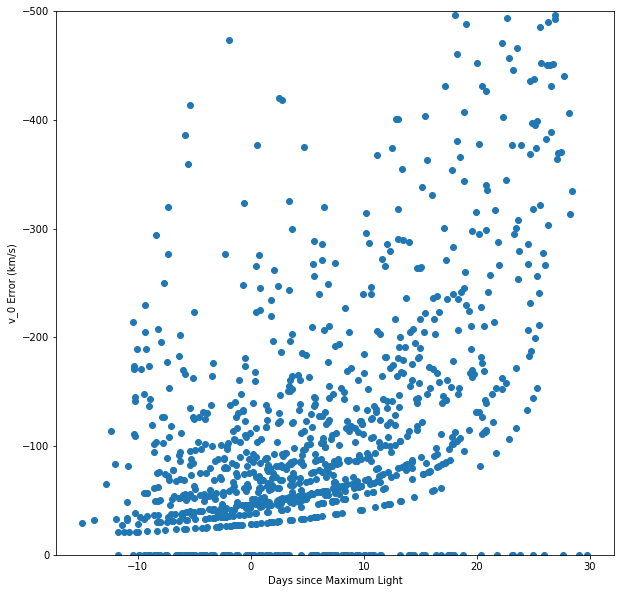

In [33]:
error_v_0 = []
phase_v = []

for x in data_table:
    vobs_max = x[3] + x[4]
    vobs_min = x[3] - x[4]
    
    v_0_max = v_0(vobs_max, x[2])
    v_0_min = v_0(vobs_min, x[2])
    
    error_v_0.append((v_0_min - v_0_max) / 2)
    phase_v.append(x[2])
    
print error_v_0
plt.figure(figsize=(10,10))
plt.xlabel("Days since Maximum Light")
plt.ylabel("v_0 Error (km/s)")
ax = plt.gca()
ax.invert_yaxis()
plt.ylim(0, -500)
plt.plot(phase_v, error_v_0, 'o')

In [34]:
print data_table

[[u'1990o', u'sn1990o-19900717-opt2.flm', 12.57538829337492, -10519.845161290323, 103.78322580645194, u'bsnip'], [u'1990o', u'sn1990o-19900731-opt2.flm', 26.543082905780746, -10614.193548387097, 107.1591685793328, u'bsnip'], [u'1993ac', u'sn1993ac-19931022-uoi.flm', 12.50238322211436, -10991.587096774194, 223.46829262548422, u'bsnip'], [u'1993ac', u'sn1993ac-19931108-ui.flm', 28.47473784556277, -9765.05806451613, 60.41244441820494, u'bsnip'], [u'1994s', u'sn1994s-19940616-uoi.flm', 0.9988405962732136, -10142.451612903225, 0.0, u'bsnip'], [u'1995ac', u'sn1995ac-19950926-uoi.flm', -5.848265090872368, 5141.987096774194, 459.21599919917793, u'bsnip'], [u'1995ac', u'sn1995ac-19951029-ui.flm', 25.192013751661904, -13727.690322580645, 70.60386790217024, u'bsnip'], [u'1995e', u'sn1995e-19950224-uoi2.flm', -2.176803499498083, -10519.845161290323, 46.22108128833687, u'bsnip'], [u'1996bv', u'sn1996bv-19961207-opt.flm', 20.53267917283057, -5991.122580645161, 360.62812028294985, u'bsnip'], [u'1997c

In [35]:
big_table = []
x = 0

print "Building event velocity evolutions..."

for i in range(len(data_table)):
    x = x+1
    print x, data_table[i][0]
    
    if data_table[i][0] == data_table[i-1][0]:
        pass
    
    else:
        sn_name = data_table[i][0]
        filenames= []
        phase_data = []
        velocity_data = []
        v_error_data = []
        source_data = []
        
        filenames.append(data_table[i][1])
        phase_data.append(data_table[i][2])
        velocity_data.append(data_table[i][3])
        v_error_data.append(data_table[i][4])
        source_data.append(data_table[i][5])
        #event_data.append([data_table[i][1], data_table[i][2]])
        
        for n in range(i+1, len(data_table)):
            if data_table[i][0] == data_table[n][0]:
                filenames.append(data_table[n][1])
                phase_data.append(data_table[n][2])
                velocity_data.append(data_table[n][3])
                v_error_data.append(data_table[n][4])
                source_data.append(data_table[n][5])
        
        object_data = [sn_name, filenames, phase_data, velocity_data, v_error_data, source_data]
        
        print object_data
        big_table.append(object_data)

Building event velocity evolutions...
1 1990o
[u'1990o', [u'sn1990o-19900717-opt2.flm', u'sn1990o-19900731-opt2.flm'], [12.57538829337492, 26.543082905780746], [-10519.845161290323, -10614.193548387097], [103.78322580645194, 107.1591685793328], [u'bsnip', u'bsnip']]
2 1990o
3 1993ac
[u'1993ac', [u'sn1993ac-19931022-uoi.flm', u'sn1993ac-19931108-ui.flm', u'sn1993ac-19931016.49-mmt.flm', u'sn1993ac-19931020.52-mmt.flm'], [12.50238322211436, 28.47473784556277, 6.749285033359839, 10.591039084836327], [-10991.587096774194, -9765.05806451613, -11746.374193548387, -12312.464516129032], [223.46829262548422, 60.41244441820494, 46.22108128833776, 157.87504810366858], [u'bsnip', u'bsnip', u'cfa', u'cfa']]
4 1993ac
5 1994s
[u'1994s', [u'sn1994s-19940616-uoi.flm', u'sn1994S-19940611.28-fast.flm', u'sn1994S-19940616.24-fast.flm', u'sn1994S-19940712.18-fast.flm', u'1994S_19940706_3501_9665_00.dat'], [0.9988405962732136, -3.983541786310848, 0.9023057062930295, 26.45450005269994, 20.366891684897784], [

[u'1998v', [u'sn1998v-19980326-br.flm', u'sn1998V-19980319.51-fast.flm', u'sn1998V-19980320.50-fast.flm', u'sn1998V-19980321.51-fast.flm', u'sn1998V-19980331.48-fast.flm', u'sn1998V-19980401.50-fast.flm', u'sn1998V-19980403.49-fast.flm'], [7.391021495972468, 0.3862081435904848, 1.3590988869752822, 2.3516439888163427, 12.149341677268389, 13.15171395833043, 15.107322624328155], [-10425.496774193549, -10802.890322580644, -10708.54193548387, -10897.23870967742, -10048.103225806452, -9670.709677419354, -10236.8], [46.221081288336876, 50.808161380344984, 132.08774193548342, 28.304516129032162, 28.304516129032166, 110.02818130350632, 0.0], [u'bsnip', u'cfa', u'cfa', u'cfa', u'cfa', u'cfa', u'cfa']]
20 1999aa
[u'1999aa', [u'sn1999aa-19990212-uoi.flm', u'sn1999aa-19990223-ui.flm', u'sn1999aa-19990309-uvoir.flm', u'sn1999aa-19990312-ui.flm', u'sn1999aa-19990213.35-fast.flm', u'sn1999aa-19990214.33-fast.flm', u'sn1999aa-19990215.28-fast.flm', u'sn1999aa-19990216.24-fast.flm', u'sn1999aa-19990217.

[u'2006bw', [u'sn2006bw-20060505.353-ui.flm', u'sn2006bw-20060502.31-fast.flm'], [11.78444313700972, 8.830079941593477], [-9953.754838709678, -11085.935483870968], [28.304516129032166, 122.65290322580681], [u'bsnip', u'cfa']]
158 2006bz
[u'2006bz', [u'sn2006bz-20060505.218-ui.flm', u'sn2006bz-20060506.16-fast.flm', u'sn2006bz-20060507.22-fast.flm', u'sn2006bz-20060508.23-fast.flm'], [12.076006950052307, 12.99243316023372, 14.023655859583341, 15.0062359787791], [-11180.283870967742, -11652.025806451613, -11085.935483870968, -10708.54193548387], [82.25101696817921, 169.03903174805023, 157.87504810366858, 98.50260799116604], [u'bsnip', u'cfa', u'cfa', u'cfa']]
159 2006cc
[u'2006cc', [u'sn2006cc-20060605.406-ui.flm', u'sn2006cc-20060508.34-fast.flm'], [17.70119773875781, -9.48060538735891], [-10708.54193548387, -11274.632258064516], [0.0, 193.35665548566865], [u'bsnip', u'cfa']]
160 2006cf
[u'2006cf', [u'sn2006cf-20060523.291-ui.flm', u'sn2006cf-20060528.299-ui.flm', u'sn2006cf-20060605.22

[u'1998v', [u'sn1998V-19980319.51-fast.flm', u'sn1998V-19980320.50-fast.flm', u'sn1998V-19980321.51-fast.flm', u'sn1998V-19980331.48-fast.flm', u'sn1998V-19980401.50-fast.flm', u'sn1998V-19980403.49-fast.flm'], [0.3862081435904848, 1.3590988869752822, 2.3516439888163427, 12.149341677268389, 13.15171395833043, 15.107322624328155], [-10802.890322580644, -10708.54193548387, -10897.23870967742, -10048.103225806452, -9670.709677419354, -10236.8], [50.808161380344984, 132.08774193548342, 28.304516129032162, 28.304516129032166, 110.02818130350632, 0.0], [u'cfa', u'cfa', u'cfa', u'cfa', u'cfa', u'cfa']]
372 1998v
373 1998v
374 1998v
375 1998v
376 1998v
377 1999aa
[u'1999aa', [u'sn1999aa-19990213.35-fast.flm', u'sn1999aa-19990214.33-fast.flm', u'sn1999aa-19990215.28-fast.flm', u'sn1999aa-19990216.24-fast.flm', u'sn1999aa-19990217.26-fast.flm', u'sn1999aa-19990218.25-fast.flm', u'sn1999aa-19990219.28-fast.flm', u'sn1999aa-19990220.29-fast.flm', u'sn1999aa-19990221.29-fast.flm', u'sn1999aa-199902

[u'2002g', [u'sn2002G-20020120.53-fast.flm', u'sn2002G-20020122.52-fast.flm'], [-4.052287961056329, -2.127233522646983], [-11840.72258064516, -11652.025806451613], [115.16688343515423, 37.73935483870955], [u'cfa', u'cfa']]
641 2002g
642 2002ha
[u'2002ha', [u'sn2002ha-20021029.13-fast.flm', u'sn2002ha-20021104.11-mmt.flm', u'sn2002ha-20021108.09-fast.flm', u'sn2002ha-20021112.08-fast.flm'], [-3.996451104104619, 1.8986593059931745, 5.822160883276224, 9.755520504732493], [-10991.587096774194, -10991.587096774194, -10614.193548387097, -10425.496774193549], [0.0, 66.04387096774228, 70.60386790217024, 84.38776284634018], [u'cfa', u'cfa', u'cfa', u'cfa']]
643 2002ha
644 2002ha
645 2002ha
646 2002hd
[u'2002hd', [u'sn2002hd-20021029.52-fast.flm', u'sn2002hd-20021109.51-fast.flm', u'sn2002hd-20021113.51-fast.flm'], [9.773630115389068, 20.434890161861336, 24.3152395873271], [-9576.36129032258, -7878.090322580645, -8915.922580645161], [60.41244441820563, 147.37689194897953, 203.45152834790113], [u

[u'2006kf', [u'sn2006kf-20061027.39-fast.flm', u'SN06kf_061027_b01_DUP_WF.dat', u'SN06kf_061103_b01_HIL_BC.dat', u'SN06kf_061103_g01_NTT_EM.dat', u'SN06kf_061116_b01_DUP_WF.dat', u'SN06kf_061117_b01_HIL_BC.dat', u'SN06kf_061130_b01_HIL_BC.dat'], [-5.033775547075015, -5.112107008557515, 2.7406220106235364, 1.663564414387821, 14.421801212153719, 16.47800207761173, 29.12853311589084], [-11652.025806451613, -11935.070967741936, -10614.193548387097, -11085.935483870968, -9765.05806451613, -9670.709677419354, -9765.05806451613], [0.0, 46.221081288336876, 37.73935483870955, 0.0, 1.8189894035458565e-12, 37.73935483871028, 120.8248888364105], [u'cfa', u'csp', u'csp', u'csp', u'csp', u'csp', u'csp']]
942 2006le
[u'2006le', [u'sn2006le-20061030.43-fast.flm', u'sn2006le-20061031.45-fast.flm', u'sn2006le-20061101.43-fast.flm', u'sn2006le-20061112.40-fast.flm', u'sn2006le-20061114.38-fast.flm', u'sn2006le-20061115.44-fast.flm', u'sn2006le-20061116.42-fast.flm', u'sn2006le-20061117.44-fast.flm', u'sn

In [36]:
print big_table

[[u'1990o', [u'sn1990o-19900717-opt2.flm', u'sn1990o-19900731-opt2.flm'], [12.57538829337492, 26.543082905780746], [-10519.845161290323, -10614.193548387097], [103.78322580645194, 107.1591685793328], [u'bsnip', u'bsnip']], [u'1993ac', [u'sn1993ac-19931022-uoi.flm', u'sn1993ac-19931108-ui.flm', u'sn1993ac-19931016.49-mmt.flm', u'sn1993ac-19931020.52-mmt.flm'], [12.50238322211436, 28.47473784556277, 6.749285033359839, 10.591039084836327], [-10991.587096774194, -9765.05806451613, -11746.374193548387, -12312.464516129032], [223.46829262548422, 60.41244441820494, 46.22108128833776, 157.87504810366858], [u'bsnip', u'bsnip', u'cfa', u'cfa']], [u'1994s', [u'sn1994s-19940616-uoi.flm', u'sn1994S-19940611.28-fast.flm', u'sn1994S-19940616.24-fast.flm', u'sn1994S-19940712.18-fast.flm', u'1994S_19940706_3501_9665_00.dat'], [0.9988405962732136, -3.983541786310848, 0.9023057062930295, 26.45450005269994, 20.366891684897784], [-10142.451612903225, -10897.23870967742, -10519.845161290323, -9104.619354838

In [37]:
SN_v_object_list = []
for entry in big_table:
    SN_v_object = SN_v_data(entry[0], entry[1], entry[2], entry[3], entry[4], entry[5])
    SN_v_object_list.append(SN_v_object)
    
print SN_v_object_list

[<__main__.SN_v_data instance at 0x0000000061C45E08>, <__main__.SN_v_data instance at 0x0000000061C45C88>, <__main__.SN_v_data instance at 0x0000000061C45FC8>, <__main__.SN_v_data instance at 0x0000000061C459C8>, <__main__.SN_v_data instance at 0x0000000061C45F88>, <__main__.SN_v_data instance at 0x0000000061C45E88>, <__main__.SN_v_data instance at 0x0000000061C457C8>, <__main__.SN_v_data instance at 0x0000000061C45E48>, <__main__.SN_v_data instance at 0x0000000061C3AB08>, <__main__.SN_v_data instance at 0x000000001852D408>, <__main__.SN_v_data instance at 0x000000000F503048>, <__main__.SN_v_data instance at 0x000000000F503088>, <__main__.SN_v_data instance at 0x000000000F5030C8>, <__main__.SN_v_data instance at 0x000000000F503108>, <__main__.SN_v_data instance at 0x000000000F503148>, <__main__.SN_v_data instance at 0x000000000F503188>, <__main__.SN_v_data instance at 0x000000000F5031C8>, <__main__.SN_v_data instance at 0x000000000F503208>, <__main__.SN_v_data instance at 0x000000000F5

In [38]:
for object in SN_v_object_list:
    print object.errors

[103.78322580645194, 107.1591685793328]
[223.46829262548422, 60.41244441820494, 46.22108128833776, 157.87504810366858]
[0.0, 84.38776284634017, 59.671159357809316, 94.81895553759507, 78.37165636859015]
[459.21599919917793, 70.60386790217024, 740.559716757307, 28.304516129032166]
[46.22108128833687, 37.73935483870955, 1.8189894035458565e-12, 28.304516129032166, 47.174193548386945, 46.221081288336876, 63.29082213475553]
[360.62812028294985]
[101.61632276068997, 28.304516129032162, 62.583639915042376, 105.06191747358257, 0.0, 112.03250237473708, 37.73935483870955, 101.61632276069027, 297.75848728746064, 112.03250237473671, 208.6358376275749, 66.043870967742]
[0.0, 28.30451612903271, 28.30451612903162, 128.32768046435336, 66.04387096774171, 46.22108128833687, 0.0, 0.0, 37.73935483870955, 62.583639915042326, 46.22108128833687, 60.41244441820494, 47.17419354838694, 37.73935483870955]
[43.235862556796114, 0.0, 103.35347975426514, 60.41244441820494]
[47.174193548386945, 1.8189894035458565e-12,

[78.37165636859015]
[28.304516129032162, 46.221081288336876, 46.221081288336876, 47.174193548386945, 127.98037893319172, 96.21685337649114, 62.58363991504155, 46.221081288336876]
[101.61632276068997, 66.04387096774228, 169.0390317480507]
[158.99872810700728, 37.73935483870955, 28.304516129032166, 0.0, 28.304516129032713, 62.58363991504155, 92.44216257667374, 127.98037893319209, 403.49795033256464, 274.2602292506065, 96.21685337649136]
[42.19388142317009, 56.60903225806433, 94.81895553759476, 75.47870967741973, 46.221081288336876, 1.8189894035458565e-12, 28.304516129032162, 37.73935483871028, 60.412444418205425, 70.60386790217024, 43.235862556796114, 47.174193548386945, 47.174193548386945, 60.412444418205745, 42.19388142317049]
[144.94074247332995, 141.20773580434047]
[129.70758767038907, 1.8189894035458565e-12, 82.25101696817958, 37.73935483870955, 28.304516129032166, 28.304516129032713, 0.0, 0.0, 66.0438709677423]
[267.02427111328194, 46.22108128833687, 28.304516129032166, 43.23586255

In [39]:
def color(source):
    
    if source == 'bsnip':
        color_code = 'blue'
    
    elif source == 'cfa':
        color_code = 'orange'
    
    elif source == 'csp':
        color_code = 'green'
   
    elif source == 'foley_hst':
        color_code == 'yellow'
    
    else:
        color_code = 'grey'
     
    return color_code

1990o [u'sn1990o-19900717-opt2.flm', u'sn1990o-19900731-opt2.flm']


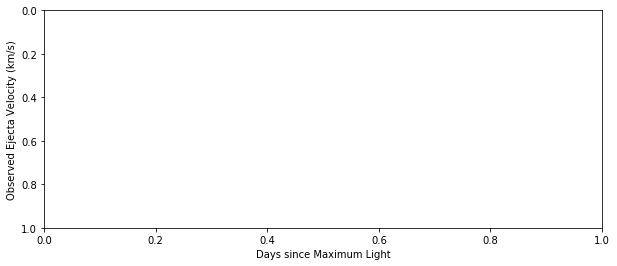

1993ac [u'sn1993ac-19931022-uoi.flm', u'sn1993ac-19931108-ui.flm', u'sn1993ac-19931016.49-mmt.flm', u'sn1993ac-19931020.52-mmt.flm']


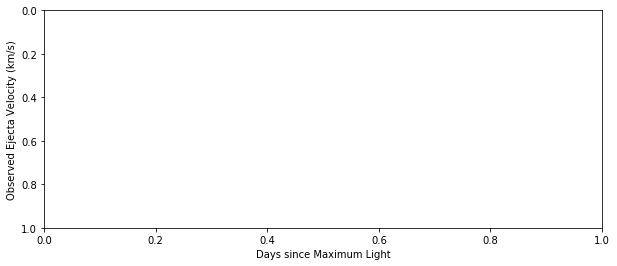

1994s [u'sn1994s-19940616-uoi.flm', u'sn1994S-19940611.28-fast.flm', u'sn1994S-19940616.24-fast.flm', u'sn1994S-19940712.18-fast.flm', u'1994S_19940706_3501_9665_00.dat']


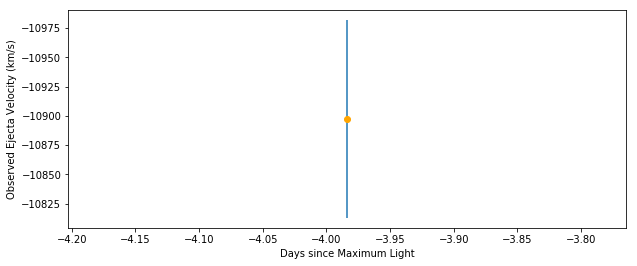

1995ac [u'sn1995ac-19950926-uoi.flm', u'sn1995ac-19951029-ui.flm', u'sn1995ac-19950927.31-fast.flm', u'sn1995ac-19951028.23-fast.flm']


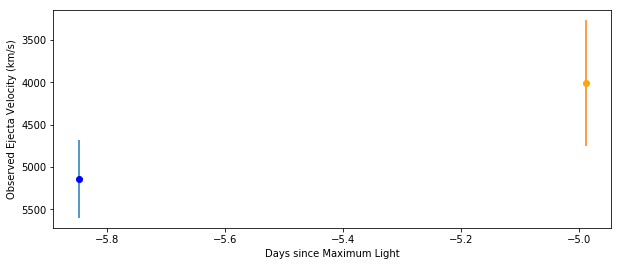

1995e [u'sn1995e-19950224-uoi2.flm', u'sn1995E-19950224.27-fast.flm', u'sn1995E-19950226.27-fast.flm', u'sn1995E-19950228.23-fast.flm', u'sn1995E-19950303.16-fast.flm', u'sn1995E-19950305.17-fast.flm', u'sn1995E-19950308.16-mmt.flm']


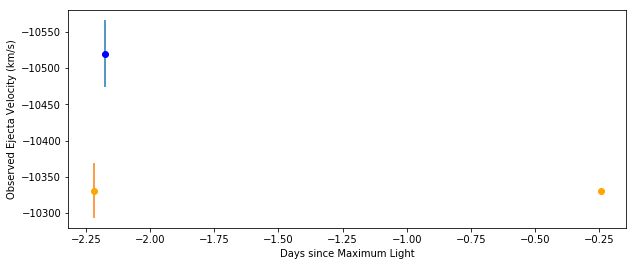

1996bv [u'sn1996bv-19961207-opt.flm']


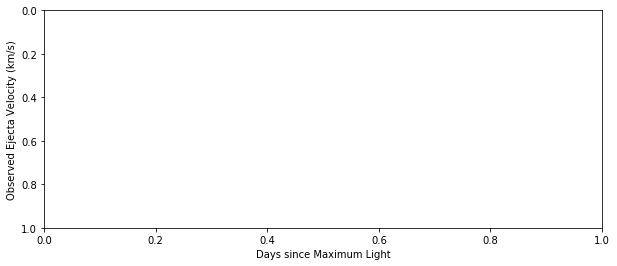

1997cn [u'sn1997cn-19970606-uoi.flm', u'sn1997cn-19970529.27-fast.flm', u'sn1997cn-19970530.20-fast.flm', u'sn1997cn-19970531.33-fast.flm', u'sn1997cn-19970601.35-fast.flm', u'sn1997cn-19970602.36-fast.flm', u'sn1997cn-19970603.23-fast.flm', u'sn1997cn-19970605.30-fast.flm', u'sn1997cn-19970607.18-fast.flm', u'sn1997cn-19970608.29-fast.flm', u'sn1997cn-19970609.21-fast.flm', u'sn1997cn-19970611.22-fast.flm']


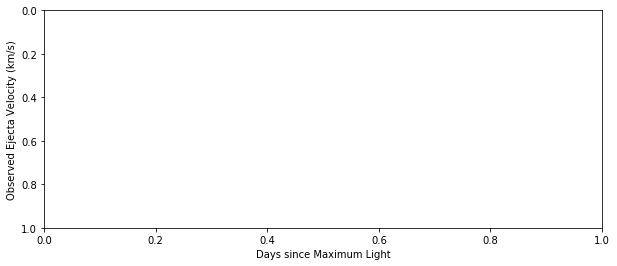

1997do [u'sn1997do-19971108-uoi.flm', u'sn1997do-19971102.46-fast.flm', u'sn1997do-19971103.43-fast.flm', u'sn1997do-19971106.51-fast.flm', u'sn1997do-19971107.51-fast.flm', u'sn1997do-19971122.45-fast.flm', u'sn1997do-19971124.45-fast.flm', u'sn1997do-19971125.38-fast.flm', u'sn1997do-19971126.37-fast.flm', u'sn1997do-19971128.50-fast.flm', u'sn1997do-19971129.55-fast.flm', u'sn1997do-19971204.33-fast.flm', u'sn1997do-19971205.30-fast.flm', u'sn1997do-19971205.35-mmt.flm']


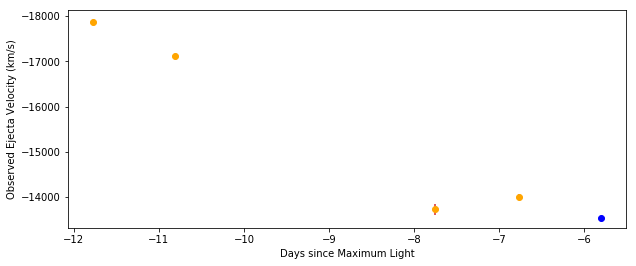

1997e [u'sn1997e-19970209-uio.flm', u'sn1997E-19970116.25-fast.flm', u'sn1997E-19970131.26-fast.flm', u'sn1997E-19970209.23-fast.flm']


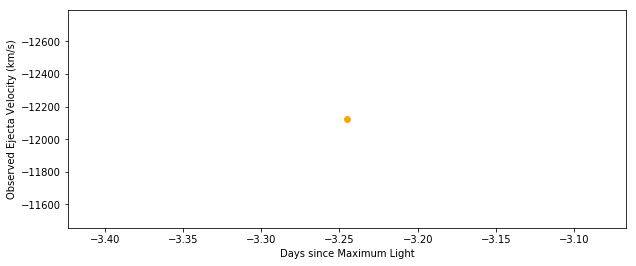

1997y [u'sn1997y-19970209-uohp.flm', u'sn1997Y-19970209.41-fast.flm', u'sn1997Y-19970210.40-fast.flm', u'sn1997Y-19970214.47-fast.flm', u'sn1997Y-19970302.35-fast.flm']


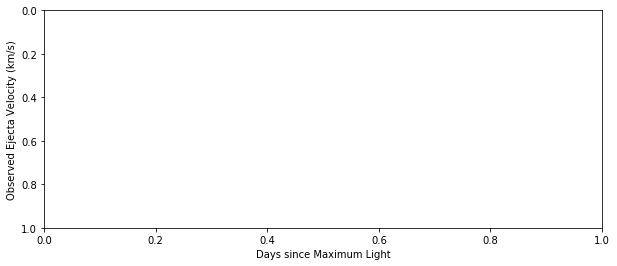

1998de [u'sn1998de-19980831-ui.flm', u'sn1998de-19980725.46-fast.flm', u'sn1998de-19980726.47-fast.flm', u'sn1998de-19980727.45-fast.flm', u'sn1998de-19980729.50-fast.flm', u'sn1998de-19980730.46-fast.flm', u'sn1998de-19980801.41-fast.flm', u'sn1998de-19980804.46-fast.flm']


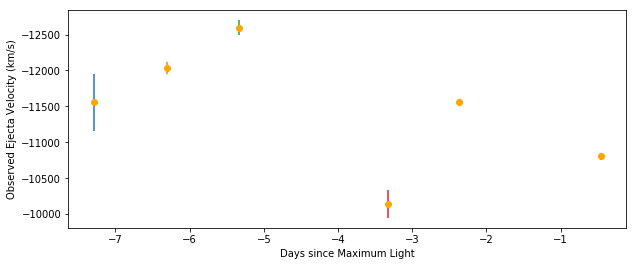

1998dx [u'sn1998dx-19980921-ui.flm', u'sn1998dx-19981015-ui.flm', u'sn1998dx-19980914.18-fast.flm', u'sn1998dx-19980915.22-fast.flm', u'sn1998dx-19980917.13-fast.flm', u'sn1998dx-19980918.15-fast.flm', u'sn1998dx-19980922.12-fast.flm', u'sn1998dx-19980924.16-fast.flm', u'sn1998dx-19980929.13-fast.flm']


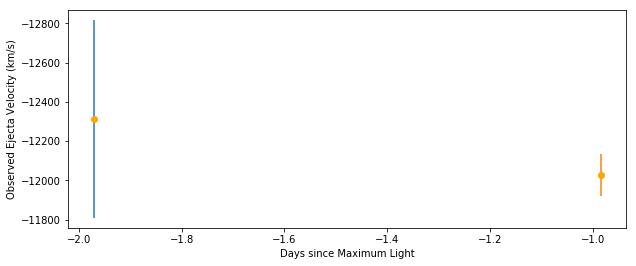

1998ef [u'sn1998ef-19981019-br.flm', u'sn1998ef-19981125-ui.flm', u'sn1998ef-19981023.37-fast.flm', u'sn1998ef-19981024.30-fast.flm', u'sn1998ef-19981029.31-fast.flm', u'sn1998ef-19981115.25-fast.flm']


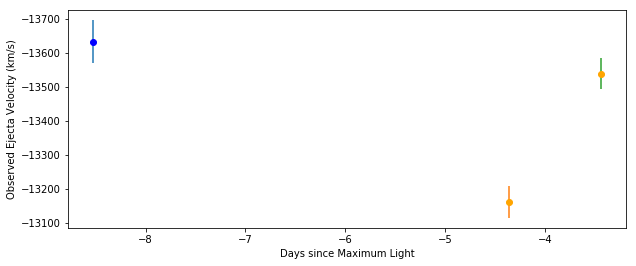

1998v [u'sn1998v-19980326-br.flm', u'sn1998V-19980319.51-fast.flm', u'sn1998V-19980320.50-fast.flm', u'sn1998V-19980321.51-fast.flm', u'sn1998V-19980331.48-fast.flm', u'sn1998V-19980401.50-fast.flm', u'sn1998V-19980403.49-fast.flm']


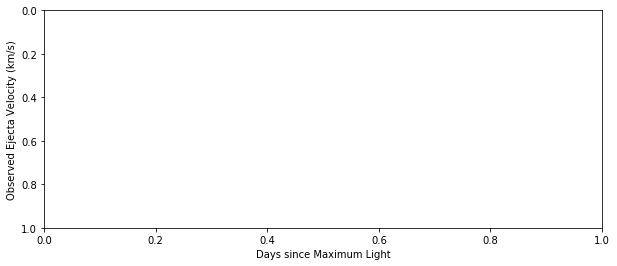

1999aa [u'sn1999aa-19990212-uoi.flm', u'sn1999aa-19990223-ui.flm', u'sn1999aa-19990309-uvoir.flm', u'sn1999aa-19990312-ui.flm', u'sn1999aa-19990213.35-fast.flm', u'sn1999aa-19990214.33-fast.flm', u'sn1999aa-19990215.28-fast.flm', u'sn1999aa-19990216.24-fast.flm', u'sn1999aa-19990217.26-fast.flm', u'sn1999aa-19990218.25-fast.flm', u'sn1999aa-19990219.28-fast.flm', u'sn1999aa-19990220.29-fast.flm', u'sn1999aa-19990221.29-fast.flm', u'sn1999aa-19990223.25-fast.flm', u'sn1999aa-19990309.25-fast.flm', u'sn1999aa-19990310.23-fast.flm', u'sn1999aa-19990311.23-fast.flm', u'sn1999aa-19990312.29-fast.flm', u'sn1999aa-19990322.27-fast.flm', u'sn1999aa-19990323.19-fast.flm', u'sn1999aa-19990324.18-fast.flm', u'sn1999aa-19990325.12-fast.flm']


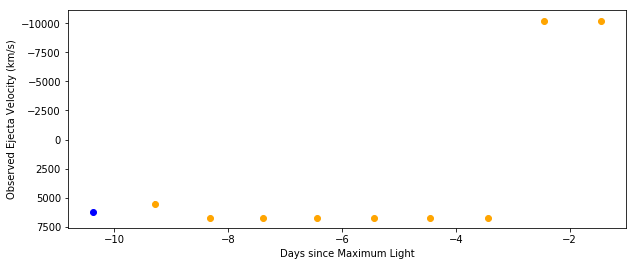

1999ac [u'sn1999ac-19990312-ui-corrected.flm', u'sn1999ac-19990309.53-fast.flm', u'sn1999ac-19990310.53-fast.flm', u'sn1999ac-19990312.53-fast.flm', u'sn1999ac-19990322.51-fast.flm', u'sn1999ac-19990323.51-fast.flm', u'sn1999ac-19990324.51-fast.flm', u'sn1999ac-19990325.50-fast.flm', u'sn1999ac-19990407.46-fast.flm', u'sn1999ac-19990409.45-fast.flm', u'sn1999ac-19990411.48-fast.flm']


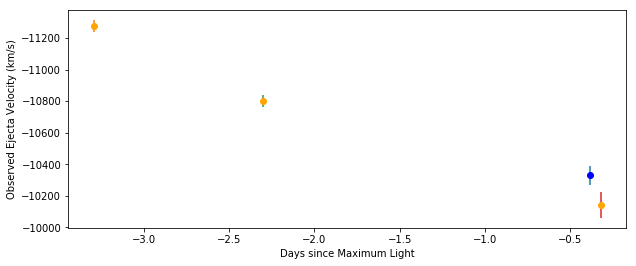

1999cp [u'sn1999cp-19990709-ui-corrected.flm', u'sn1999cp-19990718-ui-corrected.flm', u'sn1999cp-19990619.19-fast.flm', u'sn1999cp-19990620.28-fast.flm', u'sn1999cp-19990622.20-fast.flm']


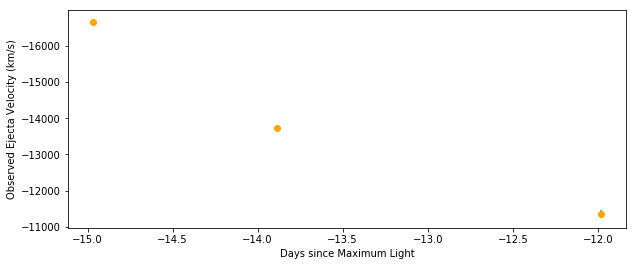

1999da [u'sn1999da-19990709-ui.flm', u'sn1999da-19990718-ui.flm', u'sn1999da-19990709.45-fast.flm']


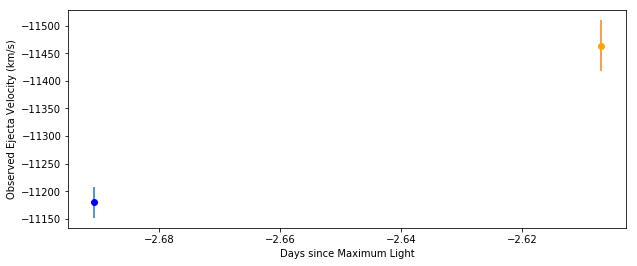

1999dk [u'sn1999dk-19990817-ui.flm', u'sn1999dk-19990910-ui.flm', u'sn1999dk-19990917-clear-ui.flm']


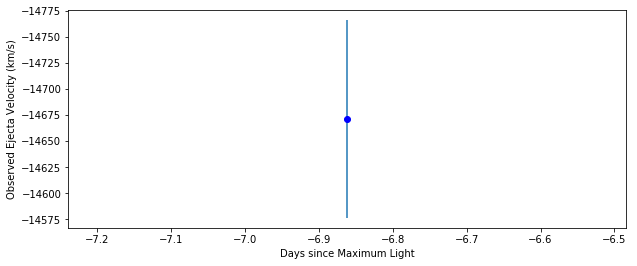

1999dq [u'sn1999dq-19990910-ui-corrected.flm', u'sn1999dq-19991008-ui-corrected.flm', u'sn1999dq-near-19990917-clear-ui-corrected.flm', u'sn1999dq-19990905.45-fast.flm', u'sn1999dq-19990906.43-fast.flm', u'sn1999dq-19990907.48-fast.flm', u'sn1999dq-19990908.48-fast.flm', u'sn1999dq-19990909.44-fast.flm', u'sn1999dq-19990910.44-fast.flm', u'sn1999dq-19990911.46-fast.flm', u'sn1999dq-19990912.51-fast.flm', u'sn1999dq-19990915.45-fast.flm', u'sn1999dq-19990916.45-fast.flm', u'sn1999dq-19990917.46-fast.flm', u'sn1999dq-19990918.45-fast.flm', u'sn1999dq-19990920.46-fast.flm', u'sn1999dq-19991002.47-fast.flm', u'sn1999dq-19991003.45-fast.flm', u'sn1999dq-19991011.45-fast.flm', u'sn1999dq-19991014.32-fast.flm']


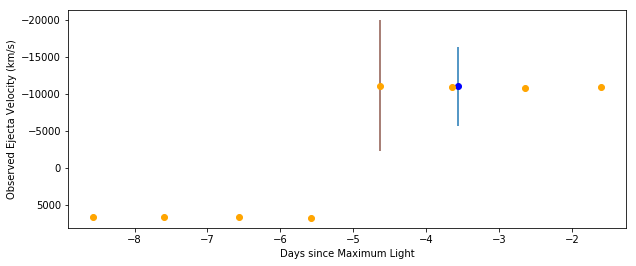

1999ee [u'sn1999ee-19991105-ui.flm']


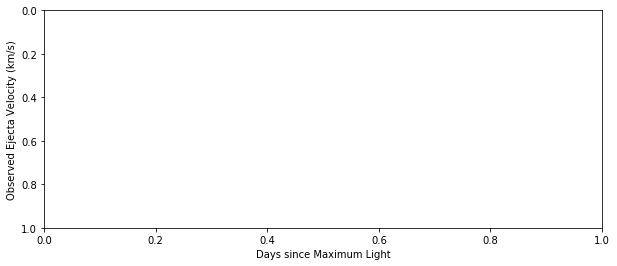

1999ek [u'sn1999ek-19991105-ui.flm', u'sn1999ek-19991103.40-fast.flm', u'sn1999ek-19991109.42-fast.flm', u'sn1999ek-19991112.46-fast.flm']


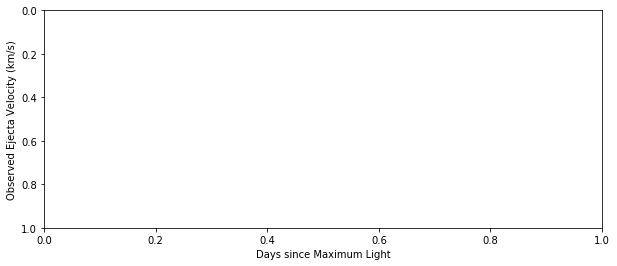

1999gd [u'sn1999gd-19991205-uvoir.flm', u'sn1999gd-19991208.52-fast.flm', u'sn1999gd-19991215.46-fast.flm', u'sn1999gd-20000102.39-fast.flm', u'sn1999gd-20000106.44-fast.flm']


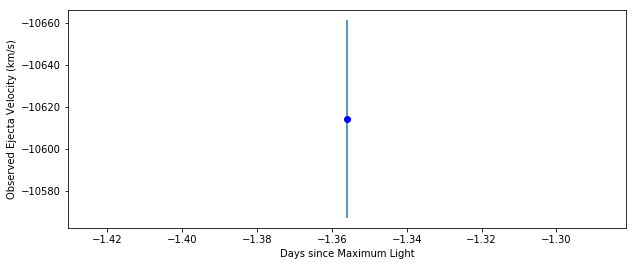

2000ce [u'sn2000ce-20000531-ui.flm', u'sn2000ce-20000510.15-fast.flm', u'sn2000ce-20000512.15-fast.flm', u'sn2000ce-20000523.14-fast.flm', u'sn2000ce-20000525.15-fast.flm']


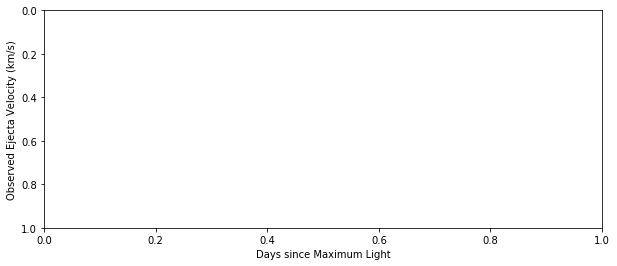

2000cn [u'sn2000cn-20000627-ui-corrected.flm', u'sn2000cn-20000706-ui-corrected.flm', u'sn2000cn-20000603.37-fast.flm', u'sn2000cn-20000604.38-fast.flm', u'sn2000cn-20000605.37-fast.flm', u'sn2000cn-20000621.37-fast.flm', u'sn2000cn-20000625.36-fast.flm', u'sn2000cn-20000709.24-fast.flm', u'sn2000cn-20000710.27-fast.flm']


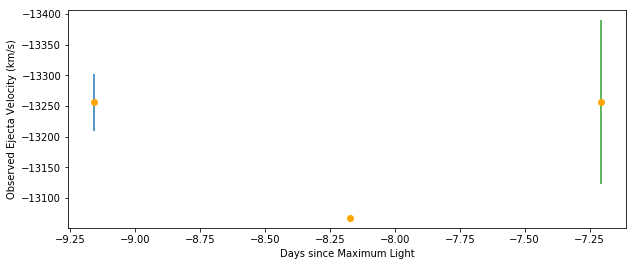

2000dk [u'sn2000dk-20000926-ui-corrected.flm', u'sn2000dk-20001006-ui-corrected.flm', u'sn2000dk-20001024-ui-corrected.flm', u'sn2000dk-20000920.39-fast.flm', u'sn2000dk-20000921.27-fast.flm', u'sn2000dk-20000926.37-fast.flm', u'sn2000dk-20000929.34-fast.flm', u'sn2000dk-20001005.33-fast.flm']


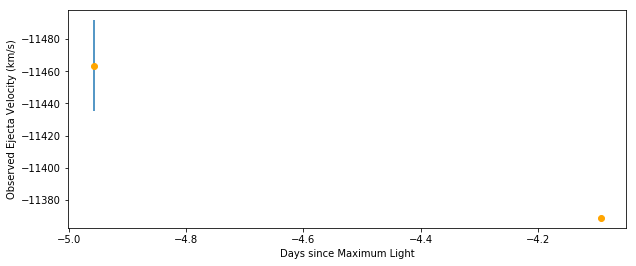

2000fa [u'sn2000fa-20001205-ui-corrected.flm', u'sn2000fa-20001221-ui-corrected.flm', u'sn2000fa-20001203.44-mmt.flm', u'sn2000fa-20001203.48-fast.flm', u'sn2000fa-20001215.36-fast.flm', u'sn2000fa-20001216.36-fast.flm', u'sn2000fa-20001218.38-fast.flm', u'sn2000fa-20001223.35-fast.flm', u'sn2000fa-20001225.42-fast.flm', u'sn2000fa-20001228.41-fast.flm', u'sn2000fa-20001230.43-fast.flm', u'sn2000fa-20010101.42-fast.flm', u'sn2000fa-20010104.36-fast.flm']


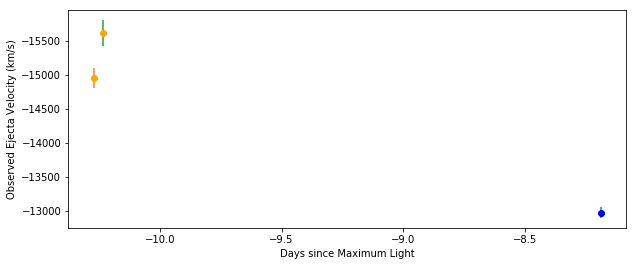

2001az [u'sn2001az-20010430-ui.flm', u'sn2001az-20010430.40-fast.flm', u'sn2001az-20010522.33-fast.flm', u'sn2001az-20010524.43-mmt.flm', u'sn2001az-20010529.35-fast.flm']


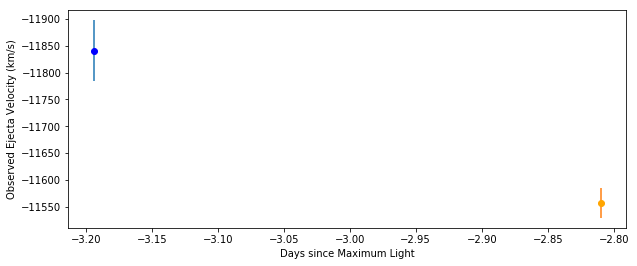

2001ba [u'sn2001ba-20010430-ui.flm']


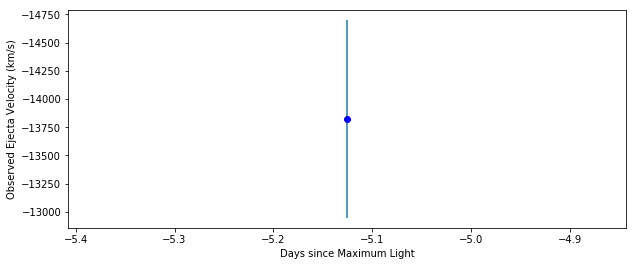

2001bf [u'sn2001bf-20010516-ui-corrected.flm', u'sn2001bf-20010517.48-fast.flm', u'sn2001bf-20010521.43-fast.flm', u'sn2001bf-20010524.44-fast.flm', u'sn2001bf-20010525.47-mmt.flm', u'sn2001bf-20010529.37-fast.flm']


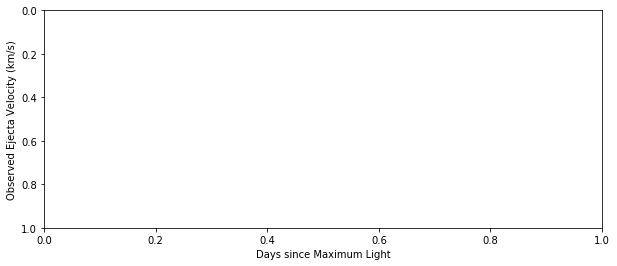

2001cp [u'sn2001cp-20010629-ui.flm', u'sn2001cp-20010716-ui.flm', u'sn2001cp-20010727-ui.flm', u'sn2001cp-20010621.45-fast.flm', u'sn2001cp-20010623.44-fast.flm', u'sn2001cp-20010624.40-fast.flm', u'sn2001cp-20010627.26-fast.flm', u'sn2001cp-20010629.28-fast.flm', u'sn2001cp-20010715.25-fast.flm', u'sn2001cp-20010721.21-fast.flm', u'sn2001cp-20010725.26-fast.flm']


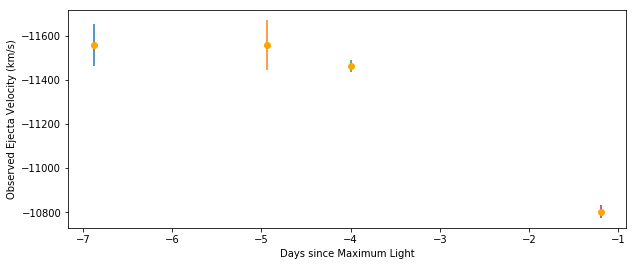

2001da [u'sn2001da-20010716-ui-corrected.flm', u'sn2001da-20010727-ui-corrected.flm', u'sn2001da-20010714.46-fast.flm', u'sn2001da-20010715.47-mmt.flm', u'sn2001da-20010716.46-fast.flm', u'sn2001da-20010718.45-fast.flm', u'sn2001da-20010719.47-fast.flm', u'sn2001da-20010724.45-fast.flm']


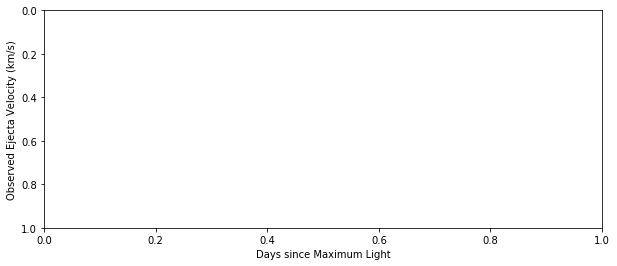

2001eh [u'sn2001eh-20010911-ui.flm', u'sn2001eh-20010912-ui.flm', u'sn2001eh-20010920-ui.flm', u'sn2001eh-20010912.44-fast.flm', u'sn2001eh-20010915.42-fast.flm', u'sn2001eh-20010917.39-fast.flm', u'sn2001eh-20010920.33-fast.flm', u'sn2001eh-20010921.35-fast.flm', u'sn2001eh-20010922.35-fast.flm', u'sn2001eh-20010923.37-fast.flm', u'sn2001eh-20010926.37-fast.flm', u'sn2001eh-20011013.33-fast.flm', u'sn2001eh-20011014.32-fast.flm', u'sn2001eh-20011015.32-fast.flm', u'sn2001eh-20011017.33-fast.flm']


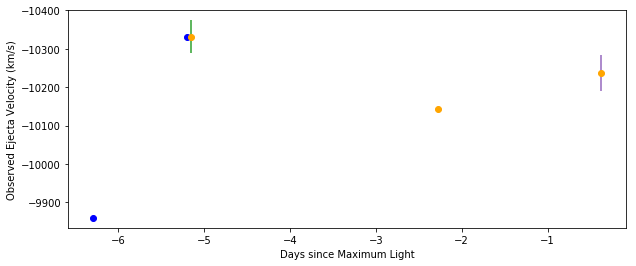

2001en [u'sn2001en-20011020-ui-corrected.flm', u'sn2001en-20011025-ui-corrected.flm', u'sn2001en-20011011.39-fast.flm', u'sn2001en-20011014.34-fast.flm', u'sn2001en-20011015.31-fast.flm', u'sn2001en-20011016.33-fast.flm', u'sn2001en-20011018.35-fast.flm', u'sn2001en-20011020.29-fast.flm', u'sn2001en-20011022.29-fast.flm', u'sn2001en-20011024.25-fast.flm']


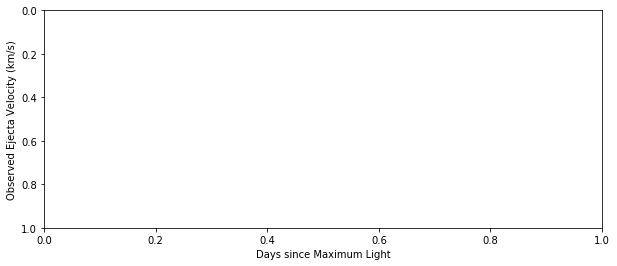

2001ep [u'sn2001ep-20011020-ui-corrected.flm', u'sn2001ep-20011022.654-joined-corrected.flm', u'sn2001ep-20011023.652-joined-corrected.flm', u'sn2001ep-20011025-ui-corrected.flm', u'sn2001ep-20011115-ui.flm', u'sn2001ep-20011010.49-fast.flm', u'sn2001ep-20011014.45-fast.flm', u'sn2001ep-20011015.45-fast.flm', u'sn2001ep-20011016.45-fast.flm', u'sn2001ep-20011017.42-fast.flm', u'sn2001ep-20011018.43-fast.flm', u'sn2001ep-20011019.44-fast.flm', u'sn2001ep-20011020.44-fast.flm', u'sn2001ep-20011021.43-fast.flm', u'sn2001ep-20011022.43-fast.flm', u'sn2001ep-20011023.45-fast.flm', u'sn2001ep-20011024.43-fast.flm', u'sn2001ep-20011025.43-fast.flm', u'sn2001ep-20011107.39-fast.flm', u'sn2001ep-20011115.37-fast.flm']


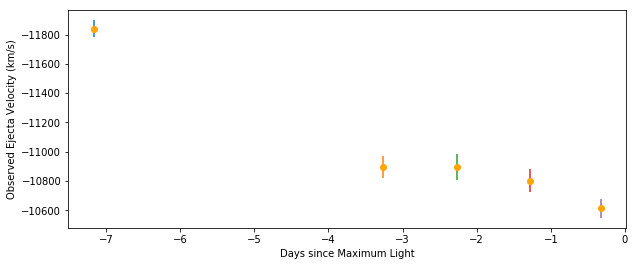

2001fe [u'sn2001fe-20011115-ui.flm', u'sn2001fe-20011114.49-fast.flm', u'sn2001fe-20011116.51-fast.flm', u'sn2001fe-20011119.47-fast.flm', u'sn2001fe-20011122.48-fast.flm', u'sn2001fe-20011207.49-fast.flm', u'sn2001fe-20011214.48-fast.flm']


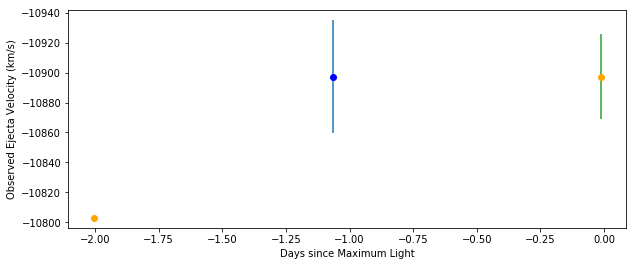

2001fh [u'sn2001fh-20011116-ui-corrected.flm', u'sn2001fh-comb-20011118.196-joined-corrected.flm']


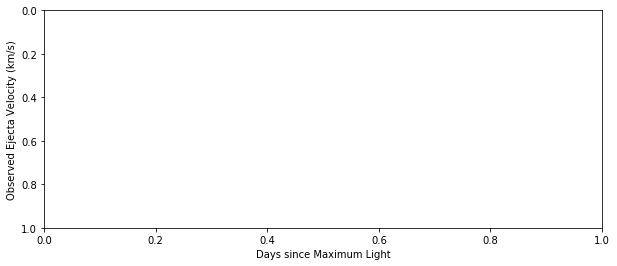

2001g [u'sn2001g-20010201-ui.flm', u'sn2001G-20010115.32-fast.flm', u'sn2001G-20010125.34-fast.flm', u'sn2001G-20010201.39-fast.flm', u'sn2001G-20010216.31-fast.flm']


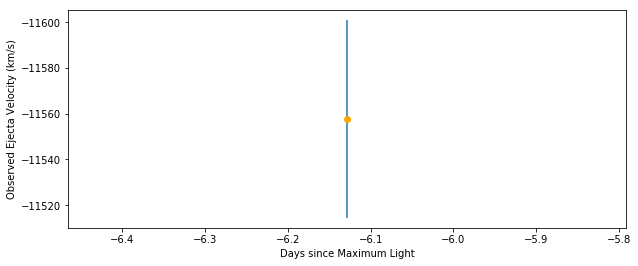

2001ic [u'sn2001ic-20011223-br.flm']


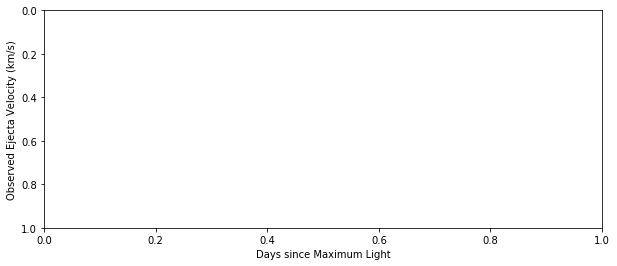

2001n [u'sn2001n-20010201-ui.flm', u'sn2001N-20010122.46-fast.flm', u'sn2001N-20010124.39-fast.flm', u'sn2001N-20010126.24-mmt.flm', u'sn2001N-20010131.40-fast.flm', u'sn2001N-20010201.37-fast.flm', u'sn2001N-20010217.39-fast.flm']


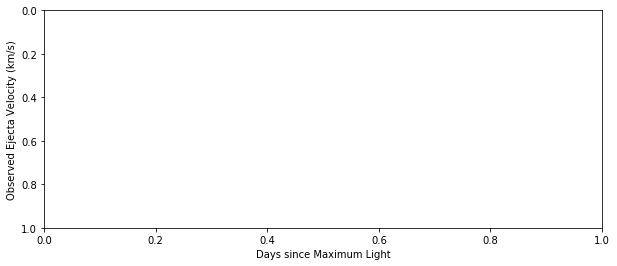

2001v [u'sn2001v-20010321-ui.flm', u'sn2001v-20010329-o.flm', u'sn2001v-20010330-ui.flm', u'sn2001V-20010219.40-fast.flm', u'sn2001V-20010220.29-fast.flm', u'sn2001V-20010221.39-fast.flm', u'sn2001V-20010222.44-fast.flm', u'sn2001V-20010223.33-fast.flm', u'sn2001V-20010225.30-fast.flm', u'sn2001V-20010226.30-fast.flm', u'sn2001V-20010227.33-fast.flm', u'sn2001V-20010301.47-fast.flm', u'sn2001V-20010314.43-fast.flm', u'sn2001V-20010315.44-fast.flm', u'sn2001V-20010316.29-fast.flm', u'sn2001V-20010317.45-fast.flm', u'sn2001V-20010318.47-fast.flm', u'sn2001V-20010323.24-fast.flm', u'sn2001V-20010324.21-fast.flm', u'sn2001V-20010325.21-fast.flm', u'sn2001V-20010325.40-mmt.flm', u'sn2001V-20010326.24-fast.flm', u'sn2001V-20010326.47-mmt.flm', u'sn2001V-20010327.32-fast.flm', u'sn2001V-20010328.29-fast.flm', u'sn2001V-20010329.29-fast.flm', u'sn2001V-20010401.22-fast.flm', u'sn2001V-20010402.19-fast.flm']


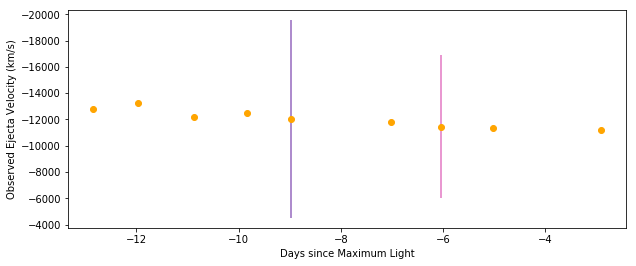

2002bz [u'sn2002bz-20020408-ui.flm']


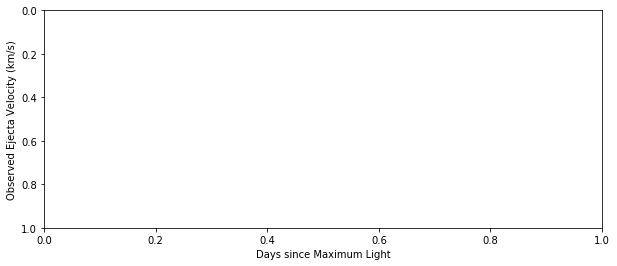

2002ck [u'sn2002ck-20020507-ui.flm', u'sn2002ck-20020502.46-fast.flm', u'sn2002ck-20020503.34-fast.flm', u'sn2002ck-20020505.37-fast.flm', u'sn2002ck-20020507.38-fast.flm', u'sn2002ck-20020515.29-fast.flm', u'sn2002ck-20020519.24-fast.flm']


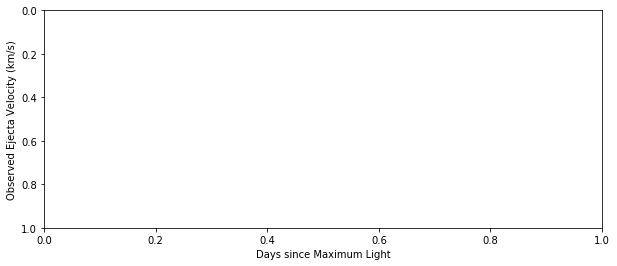

2002cr [u'sn2002cr-20020507-ui-corrected.flm', u'sn2002cr-20020608-ui-corrected.flm', u'sn2002cr-20020503.29-fast.flm', u'sn2002cr-20020506.25-fast.flm', u'sn2002cr-20020508.21-fast.flm', u'sn2002cr-20020512.19-fast.flm', u'sn2002cr-20020515.28-fast.flm', u'sn2002cr-20020519.18-fast.flm', u'sn2002cr-20020603.16-fast.flm']


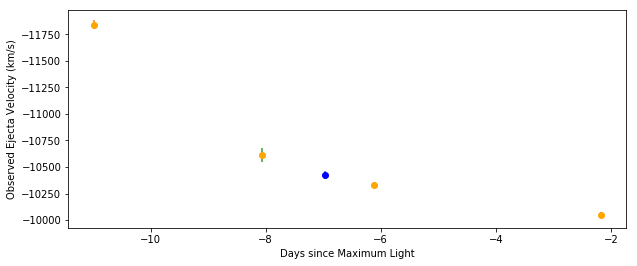

2002de [u'sn2002de-20020608.374-ui-corrected.flm', u'sn2002de-20020617-ui-corrected.flm', u'sn2002de-20020602.24-fast.flm', u'sn2002de-20020603.33-fast.flm', u'sn2002de-20020604.23-fast.flm', u'sn2002de-20020605.41-fast.flm', u'sn2002de-20020606.22-fast.flm', u'sn2002de-20020610.28-fast.flm', u'sn2002de-20020611.29-fast.flm', u'sn2002de-20020612.29-fast.flm', u'sn2002de-20020617.23-fast.flm', u'sn2002de-20020706.18-fast.flm']


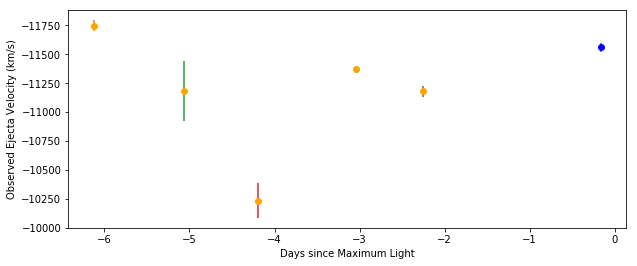

2002dj [u'sn2002dj-20020617-ui-corrected.flm', u'sn2002dj-20020615.17-fast.flm', u'sn2002dj-20020617.17-fast.flm', u'sn2002dj-20020618.17-fast.flm', u'sn2002dj-20020619.18-fast.flm', u'sn2002dj-20020705.18-fast.flm', u'sn2002dj-20020712.17-fast.flm', u'2002dj_20020613_3256_9273_00.dat', u'2002dj_20020614_3745_9776_00.dat', u'2002dj_20020615_3307_9271_00.dat', u'2002dj_20020616_3343_9272_00.dat', u'2002dj_20020618_3256_9271_00.dat', u'2002dj_20020620_3210_9231_00.dat', u'2002dj_20020621_3255_9271_00.dat', u'2002dj_20020703_3397_9281_00.dat', u'2002dj_20020704_3340_10256_00.dat', u'2002dj_20020707_3201_9077_00.dat', u'2002dj_20020711_3304_10259_00.dat', u'2002dj_20020716_3300_9077_00.dat', u'2002dj_20020725_3741_10264_00.dat']


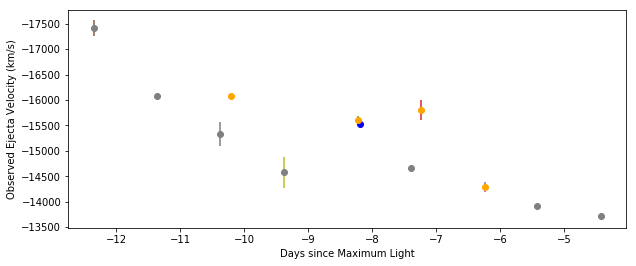

2002do [u'sn2002do-20020711.455-ui-corrected.flm', u'sn2002do-20020619.43-fast.flm', u'sn2002do-20020706.20-fast.flm', u'sn2002do-20020710.33-fast.flm']


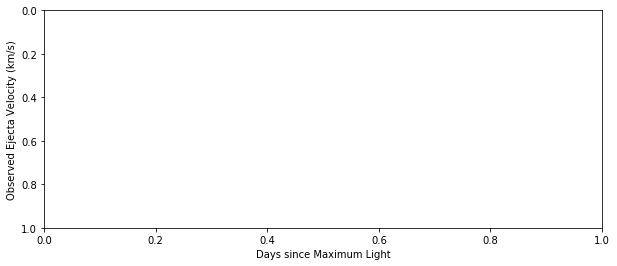

2002dp [u'sn2002dp-20020711-ui-corrected.flm', u'sn2002dp-20020620.47-fast.flm', u'sn2002dp-20020702.45-fast.flm', u'sn2002dp-20020705.43-fast.flm', u'sn2002dp-20020708.44-fast.flm', u'sn2002dp-20020712.41-fast.flm', u'sn2002dp-20020718.47-fast.flm']


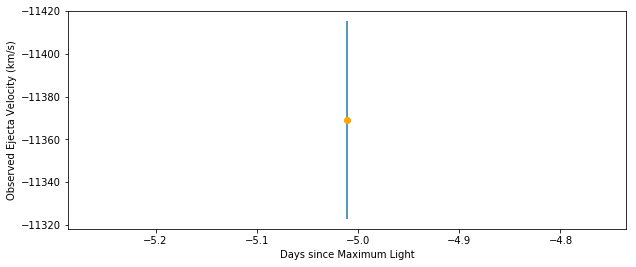

2002fb [u'sn2002fb-20020913-ui-corrected.flm', u'sn2002fb-20021001-ui-corrected.flm', u'sn2002fb-20020907.51-fast.flm', u'sn2002fb-20020909.43-fast.flm', u'sn2002fb-20020912.44-fast.flm', u'sn2002fb-20020929.42-fast.flm', u'sn2002fb-20021005.37-fast.flm', u'sn2002fb-20021009.34-fast.flm']


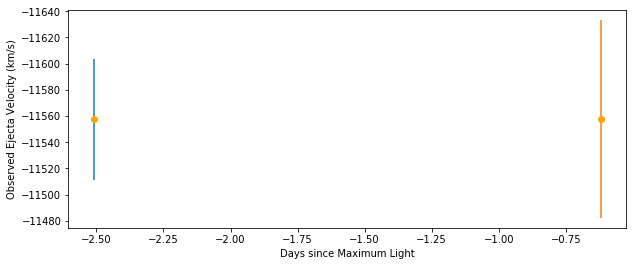

2002g [u'sn2002g-20020211-ui.flm', u'sn2002G-20020120.53-fast.flm', u'sn2002G-20020122.52-fast.flm']


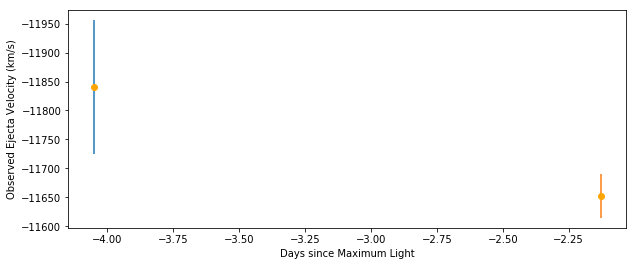

2002ha [u'sn2002ha-20021102-ui-corrected.flm', u'sn2002ha-20021108-br-corrected.flm', u'sn2002ha-20021111-br.flm', u'sn2002ha-20021029.13-fast.flm', u'sn2002ha-20021104.11-mmt.flm', u'sn2002ha-20021108.09-fast.flm', u'sn2002ha-20021112.08-fast.flm']


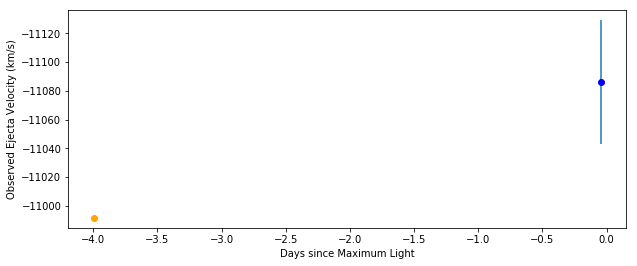

2002hd [u'sn2002hd-20021102-ui.flm', u'sn2002hd-20021109-joined.flm', u'sn2002hd-20021029.52-fast.flm', u'sn2002hd-20021109.51-fast.flm', u'sn2002hd-20021113.51-fast.flm']


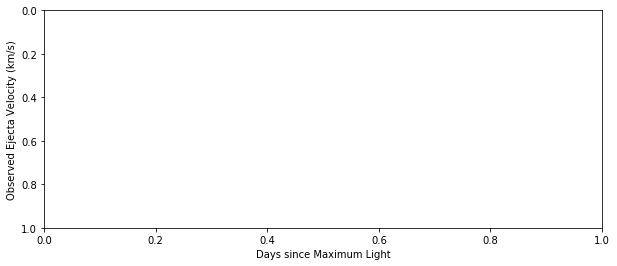

2002he [u'sn2002he-20021101.642-joined.flm', u'sn2002he-20021106.649-joined.flm', u'sn2002he-20021108-br.flm', u'sn2002he-20021111-br.flm', u'sn2002he-20021030.48-fast.flm', u'sn2002he-20021104.50-mmt.flm', u'sn2002he-20021111.52-fast.flm', u'sn2002he-20021113.53-fast.flm']


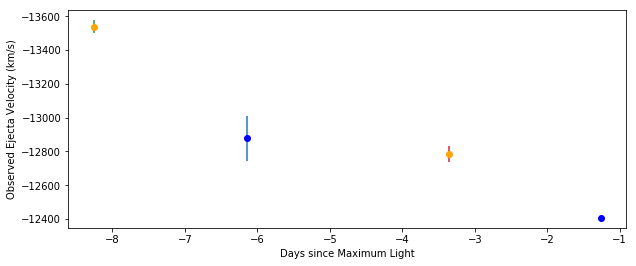

2002hu [u'sn2002hu-20021108-br.flm', u'sn2002hu-20021108.41-fast.flm', u'sn2002hu-20021110.31-fast.flm', u'sn2002hu-20021113.25-fast.flm', u'sn2002hu-20021206.29-fast.flm']


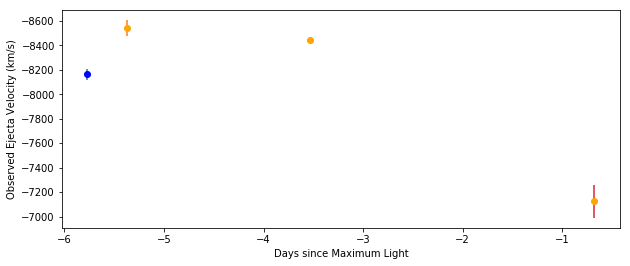

2002hw [u'sn2002hw-20021111-br.flm', u'sn2002hw-20021212-ui.flm', u'sn2002hw-20021111.20-fast.flm', u'sn2002hw-20021112.10-fast.flm', u'sn2002hw-20021114.10-fast.flm', u'sn2002hw-20021205.12-fast.flm', u'sn2002hw-20021208.15-fast.flm']


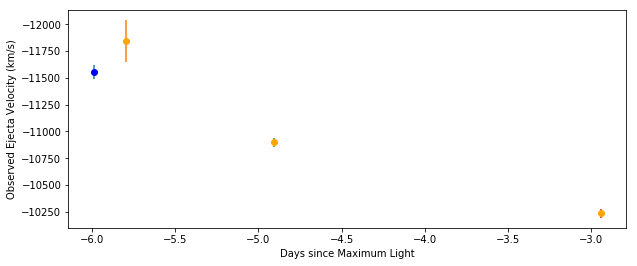

2002jy [u'sn2002jy-20030107-br.flm', u'sn2002jy-20021226.12-fast.flm', u'sn2002jy-20021227.11-fast.flm', u'sn2002jy-20021229.08-fast.flm', u'sn2002jy-20030101.10-fast.flm', u'sn2002jy-20030102.12-fast.flm', u'sn2002jy-20030103.12-fast.flm', u'sn2002jy-20030105.11-fast.flm', u'sn2002jy-20030111.08-fast.flm', u'sn2002jy-20030113.10-fast.flm']


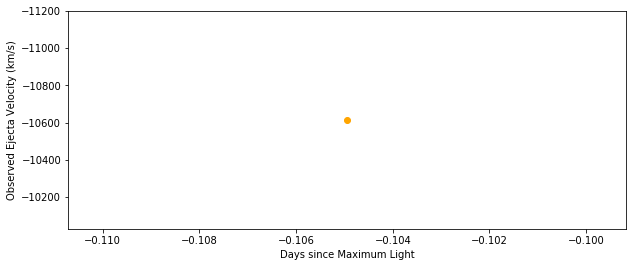

2002kf [u'sn2002kf-20030106-br.flm', u'sn2002kf-20021231.34-fast.flm', u'sn2002kf-20030101.39-fast.flm', u'sn2002kf-20030102.35-fast.flm', u'sn2002kf-20030103.31-fast.flm', u'sn2002kf-20030105.30-fast.flm', u'sn2002kf-20030107.30-fast.flm', u'sn2002kf-20030111.16-fast.flm', u'sn2002kf-20030113.31-fast.flm', u'sn2002kf-20030127.21-fast.flm', u'sn2002kf-20030129.21-fast.flm', u'sn2002kf-20030129.28-mmt.flm']


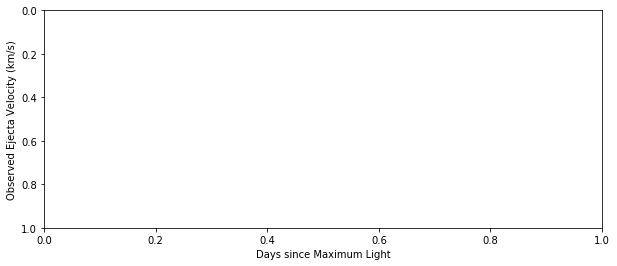

2003cq [u'sn2003cq-20030408-ui.flm', u'sn2003cq-20030403.28-fast.flm', u'sn2003cq-20030407.36-fast.flm', u'sn2003cq-20030409.25-fast.flm', u'sn2003cq-20030410.22-fast.flm', u'sn2003cq-20030411.25-fast.flm', u'sn2003cq-20030427.22-fast.flm', u'sn2003cq-20030509.15-fast.flm']


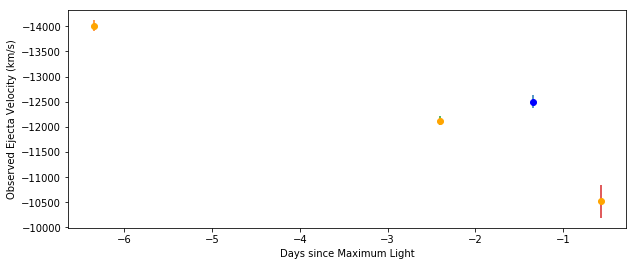

2003d [u'sn2003d-20030107-br.flm']


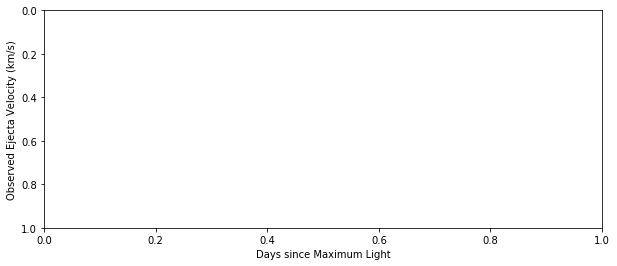

2003fa [u'sn2003fa-20030607.426-ui.flm', u'sn2003fa-20030707.379-ui.flm', u'sn2003fa-20030605.42-fast.flm', u'sn2003fa-20030606.36-fast.flm', u'sn2003fa-20030607.34-fast.flm', u'sn2003fa-20030608.29-fast.flm', u'sn2003fa-20030609.38-fast.flm', u'sn2003fa-20030610.34-mmt.flm', u'sn2003fa-20030623.33-fast.flm', u'sn2003fa-20030624.29-fast.flm', u'sn2003fa-20030625.30-fast.flm', u'sn2003fa-20030627.30-fast.flm', u'sn2003fa-20030628.23-fast.flm', u'sn2003fa-20030630.22-fast.flm', u'sn2003fa-20030701.39-fast.flm', u'sn2003fa-20030702.29-fast.flm', u'sn2003fa-20030703.38-fast.flm', u'sn2003fa-20030704.24-fast.flm', u'sn2003fa-20030704.46-mmt.flm', u'sn2003fa-20030705.41-mmt.flm', u'sn2003fa-20030706.28-fast.flm']


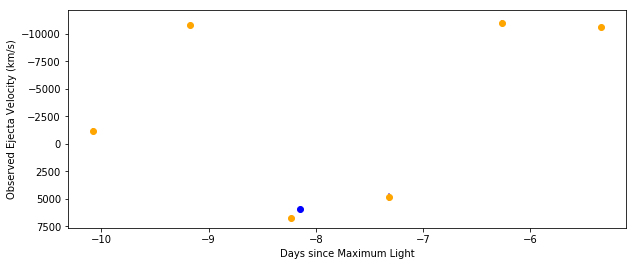

2003iv [u'sn2003iv-20031028-ui.flm', u'sn2003iv-20031019.38-fast.flm', u'sn2003iv-20031020.40-fast.flm', u'sn2003iv-20031021.38-fast.flm', u'sn2003iv-20031022.38-fast.flm', u'sn2003iv-20031023.35-fast.flm', u'sn2003iv-20031025.37-fast.flm', u'sn2003iv-20031029.34-fast.flm']


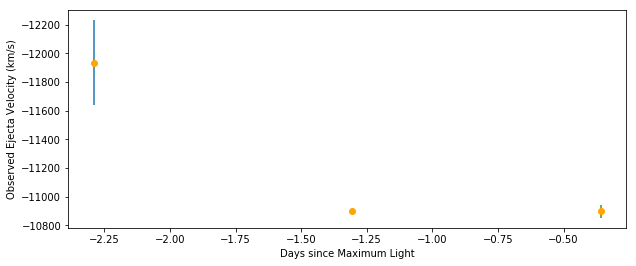

2003u [u'sn2003U-20030204-ui.flm', u'sn2003U-20030129.53-mmt.flm', u'sn2003U-20030201.55-fast.flm', u'sn2003U-20030206.55-fast.flm']


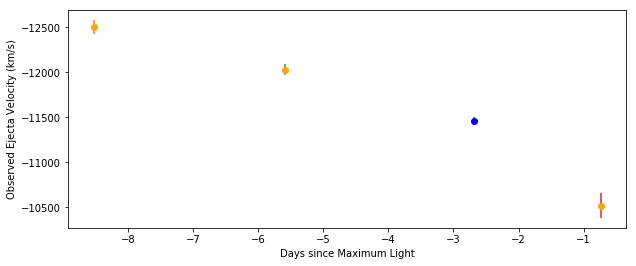

2003w [u'sn2003W-20030204-ui.flm', u'sn2003w-20030228-br.flm', u'sn2003W-20030129.35-mmt.flm', u'sn2003W-20030130.31-fast.flm', u'sn2003W-20030131.39-fast.flm', u'sn2003W-20030201.35-fast.flm', u'sn2003W-20030202.30-fast.flm', u'sn2003W-20030203.33-fast.flm', u'sn2003W-20030204.27-fast.flm', u'sn2003W-20030206.32-fast.flm', u'sn2003W-20030207.40-fast.flm', u'sn2003W-20030209.35-fast.flm', u'sn2003W-20030210.35-fast.flm', u'sn2003W-20030303.37-fast.flm', u'sn2003W-20030307.28-fast.flm', u'sn2003W-20030310.28-fast.flm', u'sn2003W-20030312.27-fast.flm']


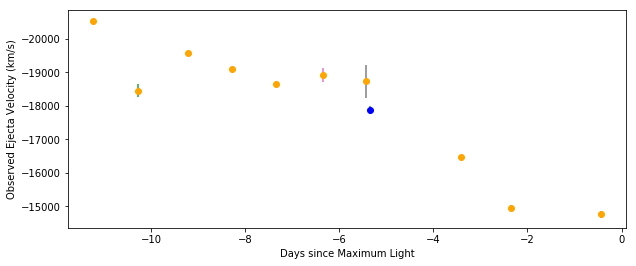

2004as [u'sn2004as-20040316.608-br-corrected.flm', u'sn2004as-20040313.30-fast.flm', u'sn2004as-20040314.32-fast.flm', u'sn2004as-20040315.31-fast.flm', u'sn2004as-20040316.35-fast.flm', u'sn2004as-20040317.39-fast.flm', u'sn2004as-20040318.36-fast.flm', u'sn2004as-20040319.28-fast.flm', u'sn2004as-20040320.38-fast.flm', u'sn2004as-20040321.27-fast.flm', u'sn2004as-20040323.26-fast.flm', u'sn2004as-20040324.34-fast.flm', u'sn2004as-20040327.35-fast.flm', u'sn2004as-20040328.22-fast.flm', u'sn2004as-20040329.23-fast.flm', u'sn2004as-20040330.24-fast.flm', u'sn2004as-20040416.27-fast.flm', u'sn2004as-20040419.26-fast.flm']


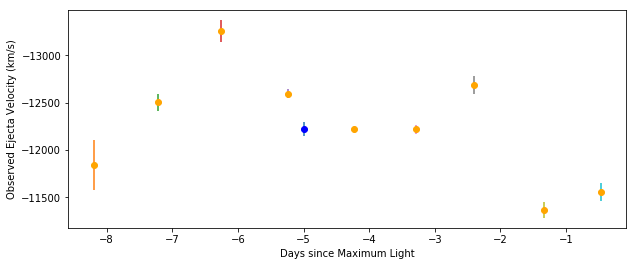

2004bg [u'sn2004bg-20040424.256-ui.flm', u'sn2004bg-20040512.298-ui.flm', u'sn2004bg-20040411.39-fast.flm', u'sn2004bg-20040417.19-fast.flm', u'sn2004bg-20040420.33-fast.flm', u'sn2004bg-20040425.25-fast.flm', u'sn2004bg-20040427.28-fast.flm']


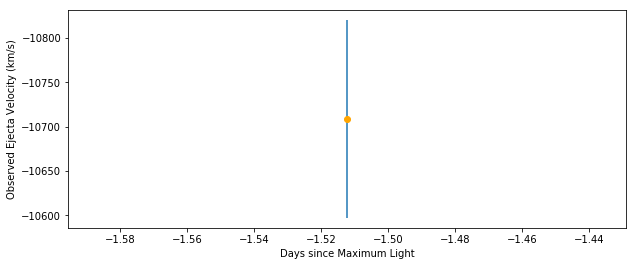

2004eo [u'sn2004eo-20040924.242-ui.flm', u'sn2004eo-20041013.300-ui.flm', u'SN04eo_040919_b01_DUP_WF.dat', u'SN04eo_040920_b01_DUP_WF.dat', u'SN04eo_041025_b01_CLA_LD.dat']


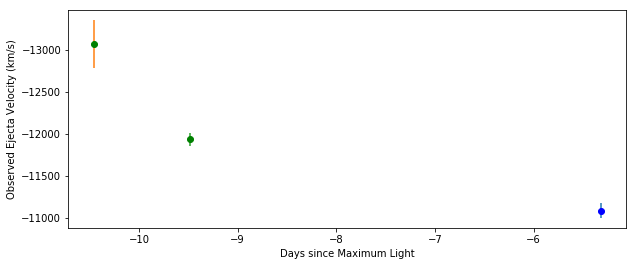

2004ey [u'sn2004ey-20041018-br.flm', u'sn2004ey-20041114-br.flm', u'SN04ey_041025_b01_CLA_LD.dat']


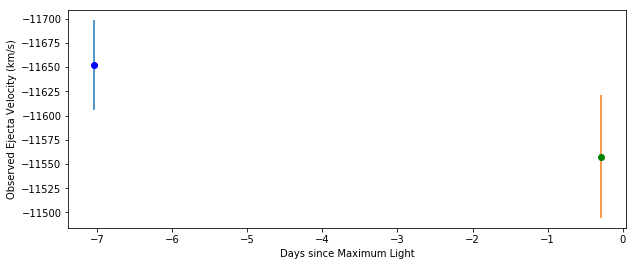

2004gs [u'sn2004gs-20041217.447-ui-corrected.flm', u'sn2004gs-20041213.44-fast.flm', u'sn2004gs-20041215.48-fast.flm', u'sn2004gs-20041216.49-fast.flm', u'sn2004gs-20041218.46-fast.flm', u'sn2004gs-20041219.42-fast.flm', u'sn2004gs-20041220.44-fast.flm', u'sn2004gs-20050106.40-fast.flm', u'sn2004gs-20050109.38-fast.flm', u'SN04gs_041213_b01_DUP_WF.dat', u'SN04gs_041219_b01_CLA_LD.dat']


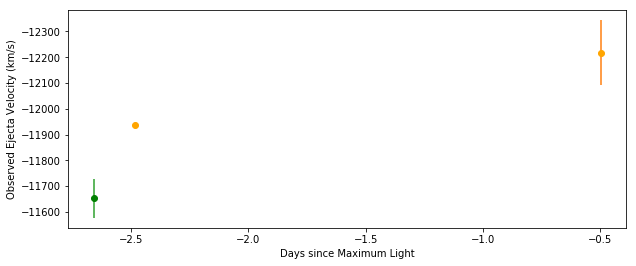

2004gu [u'sn2004gu-20041217.539-ui.flm', u'SN04gu_041219_b01_CLA_LD.dat']


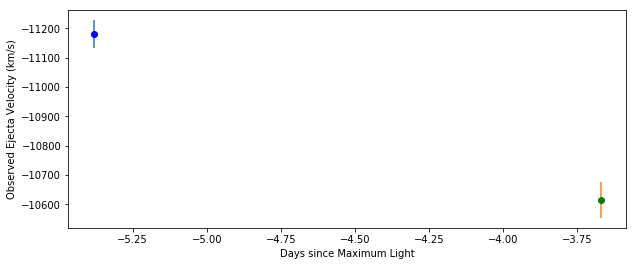

2004s [u'sn2004s-20040213.341-br.flm']


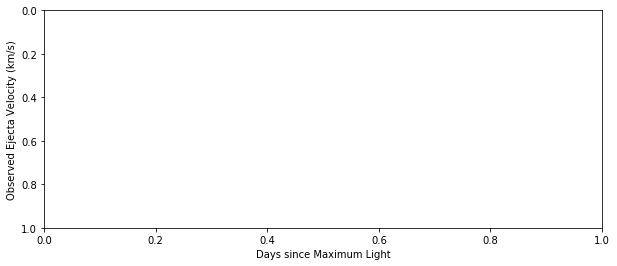

2005ag [u'sn2005ag-20050212.596-br.flm', u'SN05ag_050212_b01_DUP_WF.dat', u'SN05ag_050315_b01_DUP_WF.dat']


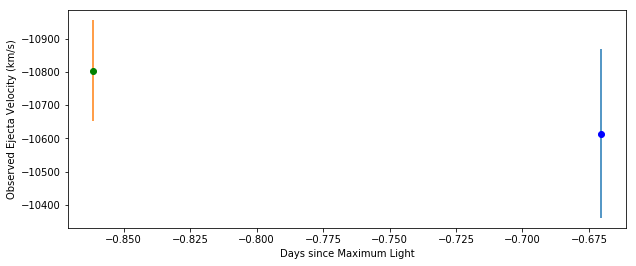

2005bo [u'sn2005bo-20050515.289-ui.flm', u'sn2005bo-20050418.21-fast.flm', u'sn2005bo-20050510.29-fast.flm', u'SN05bo_050418_b01_DUP_WF.dat', u'SN05bo_050419_b01_DUP_WF.dat']


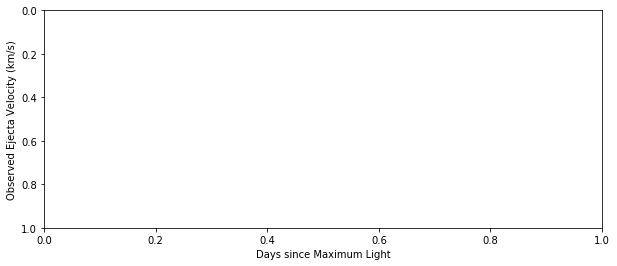

2005dv [u'sn2005dv-20050911.170-ui.flm']


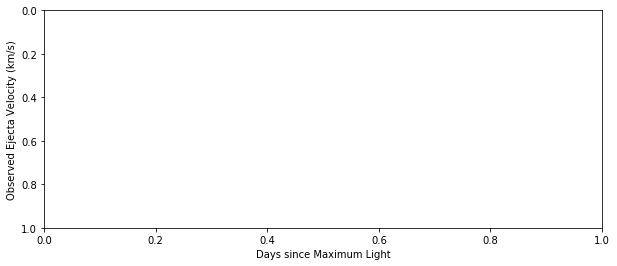

2005el [u'sn2005el-20050926.496-ui-corrected.flm', u'sn2005el-20051004.534-ui-corrected.flm', u'sn2005el-20051011.512-ui-corrected.flm', u'sn2005el-20050927.47-fast.flm', u'sn2005el-20050928.47-fast.flm', u'sn2005el-20050929.48-fast.flm', u'sn2005el-20051005.49-fast.flm', u'sn2005el-20051007.48-fast.flm', u'sn2005el-20051026.50-fast.flm', u'SN05el_050926_b01_DUP_WF.dat', u'SN05el_050927_b01_DUP_WF.dat', u'SN05el_051005_b01_DUP_WF.dat', u'SN05el_051018_g01_NTT_EM.dat']


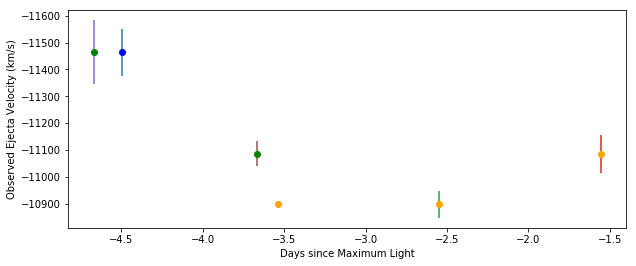

2005eq [u'sn2005eq-20051004.512-ui.flm', u'sn2005eq-20051007.633-br-corrected.flm', u'sn2005eq-20051011.376-ui-corrected.flm', u'sn2005eq-20051002.51-fast.flm', u'sn2005eq-20051005.41-fast.flm', u'sn2005eq-20051007.40-fast.flm', u'sn2005eq-20051009.42-fast.flm', u'sn2005eq-20051011.39-fast.flm', u'sn2005eq-20051012.33-fast.flm', u'sn2005eq-20051025.38-fast.flm', u'sn2005eq-20051028.34-fast.flm', u'sn2005eq-20051107.38-fast.flm', u'SN05eq_051005_b01_DUP_WF.dat', u'SN05eq_051018_g01_NTT_EM.dat']


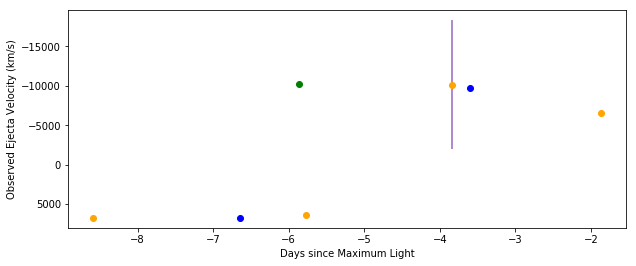

2005eu [u'sn2005eu-20051006.584-deimos.flm', u'sn2005eu-20051007.622-br.flm', u'sn2005eu-20051011.350-ui-corrected.flm', u'sn2005eu-20051007.38-fast.flm', u'sn2005eu-20051009.38-fast.flm', u'sn2005eu-20051011.37-fast.flm', u'sn2005eu-20051025.29-fast.flm', u'sn2005eu-20051027.36-fast.flm', u'sn2005eu-20051109.30-fast.flm']


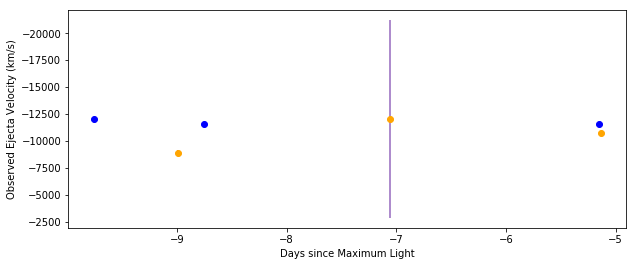

2005hc [u'sn2005hc-20051108.465-deimos.flm', u'sn2005hc-20051030.32-fast.flm', u'sn2005hc-20051031.29-fast.flm', u'sn2005hc-20051105.31-fast.flm', u'SN05hc_051018_g01_NTT_EM.dat', u'SN05hc_051022_b01_MGH_BC.dat', u'SN05hc_051024_b01_MGH_BC.dat']


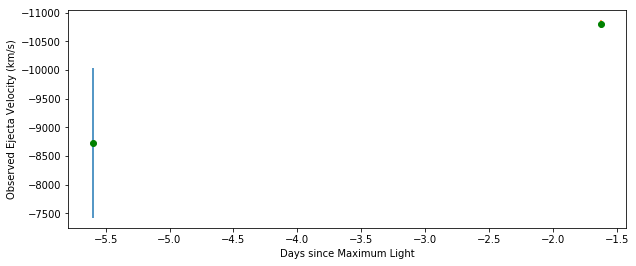

2005hj [u'sn2005hj-20051108.457-deimos.flm']


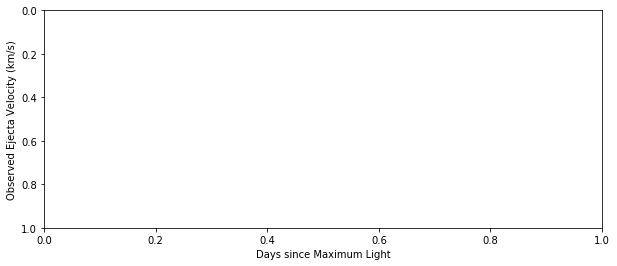

2005iq [u'sn2005iq-20051107.215-deimos.flm', u'sn2005iq-20051107.21-fast.flm', u'SN05iq_051124_b01_DUP_MS.dat']


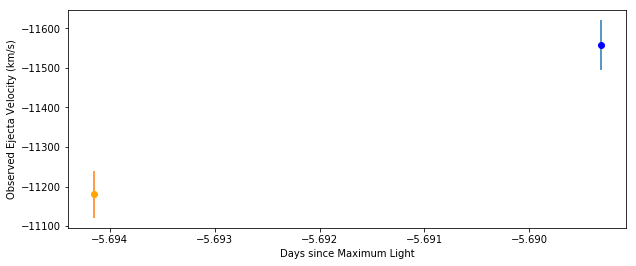

2005kc [u'sn2005kc-20051203.188-deimos.flm', u'sn2005kc-20051205.181-br.flm', u'sn2005kc-20051130.11-fast.flm', u'sn2005kc-20051203.17-fast.flm', u'sn2005kc-20051205.09-fast.flm', u'sn2005kc-20051209.08-fast.flm', u'sn2005kc-20051223.08-fast.flm', u'SN05kc_051124_b01_DUP_MS.dat', u'SN05kc_051125_b01_DUP_MS.dat', u'SN05kc_051222_b01_DUP_WF.dat']


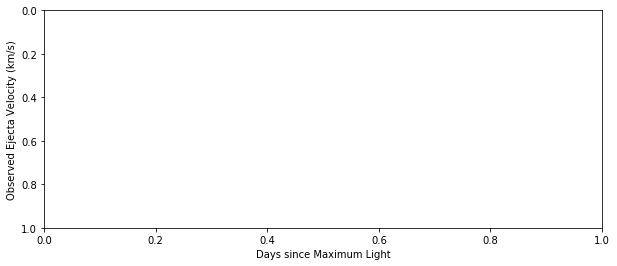

2005ki [u'sn2005ki-20051202.649-deimos.flm', u'sn2005ki-20051209.514-ui.flm', u'sn2005ki-20051202.52-fast.flm', u'SN05ki_051123_b01_DUP_MS.dat', u'SN05ki_051125_b01_DUP_MS.dat', u'SN05ki_051222_b01_DUP_WF.dat']


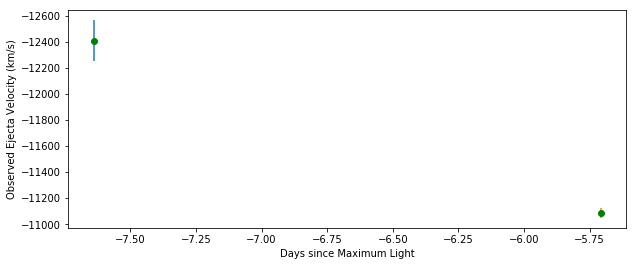

2005ls [u'sn2005ls-20060106.246-ui.flm', u'sn2005ls-20051221.22-fast.flm', u'sn2005ls-20051227.20-fast.flm']


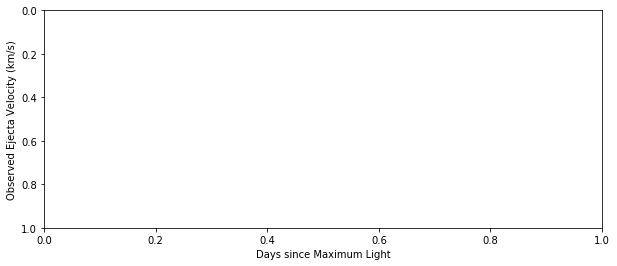

2005lz [u'sn2005lz-20060101.381-deimos.flm', u'sn2005lz-20051227.29-fast.flm']


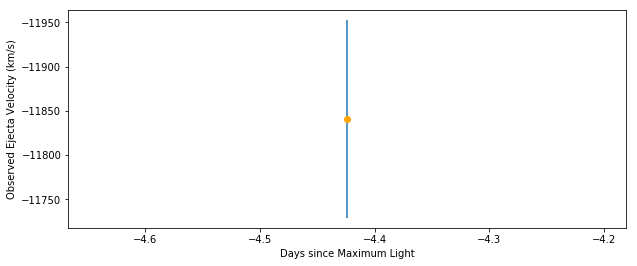

2005mc [u'sn2005mc-20060105.368-ui.flm', u'sn2005mc-20060124.354-ui.flm', u'sn2005mc-20051227.37-fast.flm', u'sn2005mc-20060104.38-fast.flm']


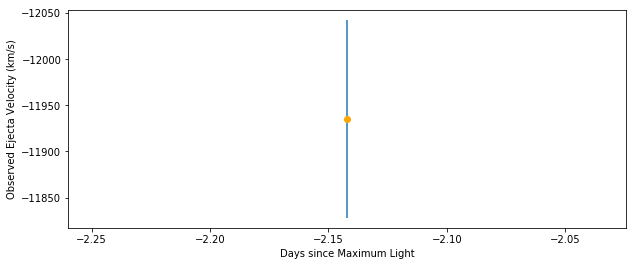

2005ms [u'sn2005ms-20060106.400-ui.flm', u'sn2005ms-20060123.318-ui.flm']


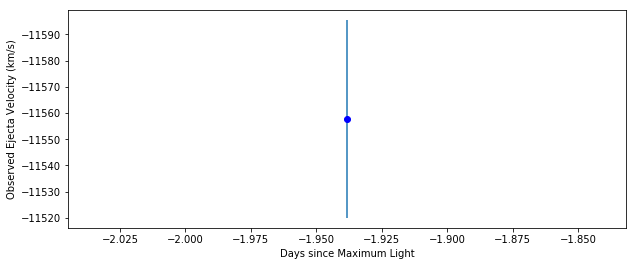

2005na [u'sn2005na-20060105.335-ui.flm', u'sn2005na-20060106.361-ui-corrected.flm', u'sn2005na-20060123.255-ui-corrected.flm', u'sn2005na-20060130.320-ui-corrected.flm', u'sn2005na-20060104.34-fast.flm', u'sn2005na-20060107.32-fast.flm', u'sn2005na-20060109.43-fast.flm', u'sn2005na-20060122.27-fast.flm', u'sn2005na-20060126.39-fast.flm', u'sn2005na-20060130.24-fast.flm', u'SN05na_060116_g01_NTT_EM.dat', u'SN05na_060124_g01_CLA_LD.dat']


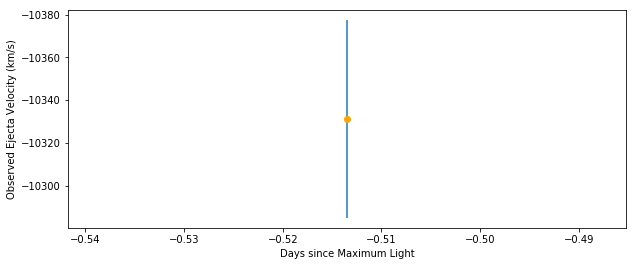

2006ac [u'sn2006ac-20060222.439-ui-corrected.flm', u'sn2006ac-20060221.43-fast.flm', u'sn2006ac-20060222.43-fast.flm', u'sn2006ac-20060224.37-fast.flm', u'sn2006ac-20060225.38-fast.flm', u'sn2006ac-20060226.34-fast.flm', u'sn2006ac-20060228.36-fast.flm', u'sn2006ac-20060302.48-fast.flm', u'sn2006ac-20060304.54-fast.flm', u'sn2006ac-20060305.48-fast.flm', u'sn2006ac-20060309.33-fast.flm']


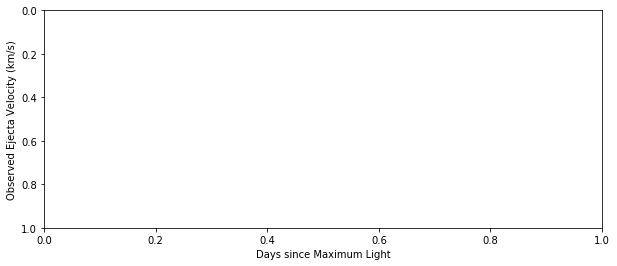

2006ak [u'sn2006ak-20060222.389-ui.flm', u'sn2006ak-20060221.33-fast.flm']


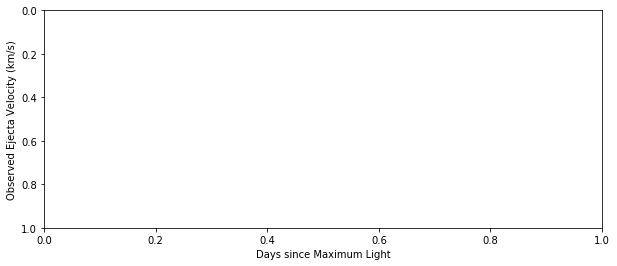

2006ax [u'sn2006ax-20060322.396-ui.flm', u'sn2006ax-20060428.224-ui.flm', u'sn2006ax-20060323.31-fast.flm', u'sn2006ax-20060324.30-fast.flm', u'sn2006ax-20060326.29-fast.flm', u'sn2006ax-20060402.30-fast.flm', u'SN06ax_060322_b01_DUP_WF.dat', u'SN06ax_060323_b01_DUP_WF.dat', u'SN06ax_060324_b01_DUP_WF.dat', u'SN06ax_060330_b01_DUP_WF.dat', u'SN06ax_060331_b01_DUP_WF.dat', u'SN06ax_060402_b01_DUP_WF.dat', u'SN06ax_060416_b01_BAA_IM.dat', u'SN06ax_060421_b01_DUP_WF.dat']


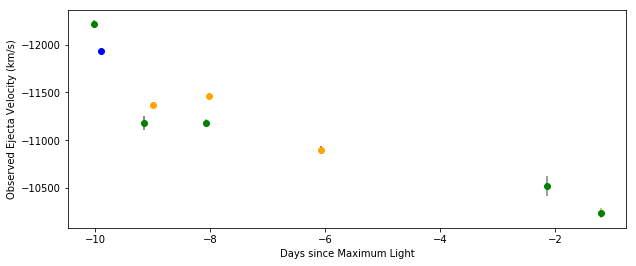

2006az [u'sn2006az-20060428.289-ui.flm', u'sn2006az-20060331.37-fast.flm', u'sn2006az-20060403.30-fast.flm']


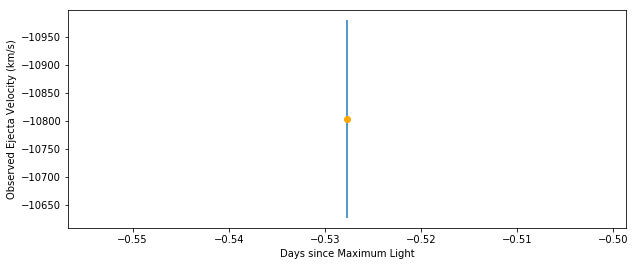

2006bq [u'sn2006bq-20060427.636-br.flm', u'sn2006bq-20060505.375-ui.flm', u'sn2006bq-20060505.473-ui.flm', u'sn2006bq-20060427.35-fast.flm']


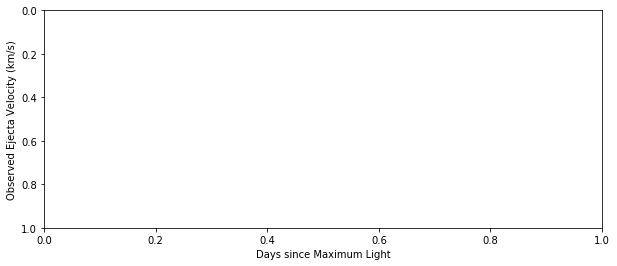

2006bt [u'sn2006bt-20060428.425-ui.flm', u'sn2006bt-20060505.444-ui.flm', u'sn2006bt-20060429.41-fast.flm', u'sn2006bt-20060501.39-fast.flm', u'sn2006bt-20060504.35-fast.flm', u'sn2006bt-20060505.27-fast.flm', u'sn2006bt-20060507.30-fast.flm', u'sn2006bt-20060508.31-fast.flm', u'sn2006bt-20060519.28-fast.flm']


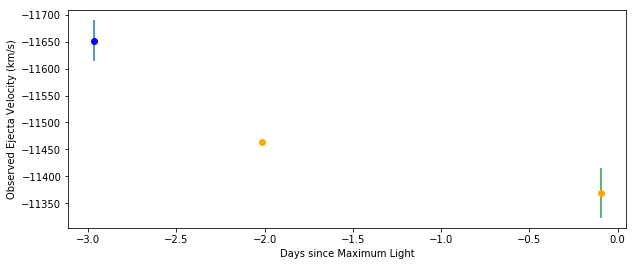

2006bu [u'sn2006bu-20060505.325-ui.flm', u'sn2006bu-20060505.19-fast.flm']


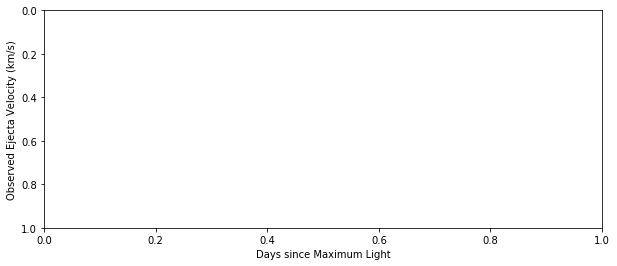

2006bw [u'sn2006bw-20060505.353-ui.flm', u'sn2006bw-20060502.31-fast.flm']


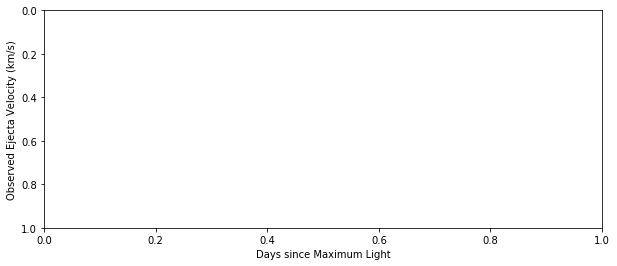

2006bz [u'sn2006bz-20060505.218-ui.flm', u'sn2006bz-20060506.16-fast.flm', u'sn2006bz-20060507.22-fast.flm', u'sn2006bz-20060508.23-fast.flm']


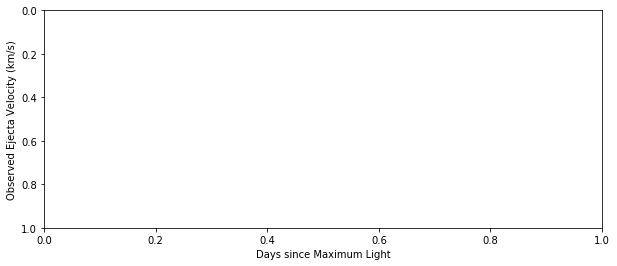

2006cc [u'sn2006cc-20060605.406-ui.flm', u'sn2006cc-20060508.34-fast.flm']


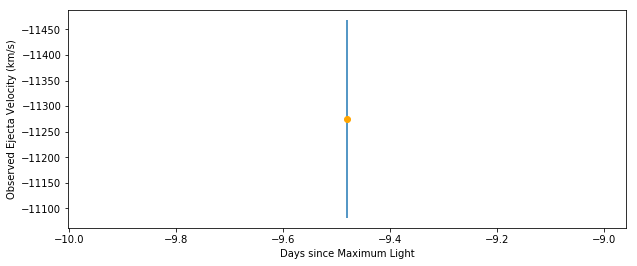

2006cf [u'sn2006cf-20060523.291-ui.flm', u'sn2006cf-20060528.299-ui.flm', u'sn2006cf-20060605.221-ui.flm', u'sn2006cf-20060519.25-fast.flm', u'sn2006cf-20060520.16-fast.flm', u'sn2006cf-20060521.27-fast.flm', u'sn2006cf-20060522.26-fast.flm', u'sn2006cf-20060524.21-fast.flm', u'sn2006cf-20060604.22-fast.flm']


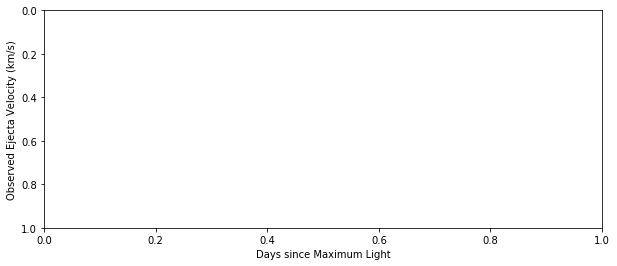

2006cj [u'sn2006cj-20060528.349-ui.flm', u'sn2006cj-20060522.29-fast.flm', u'sn2006cj-20060523.33-fast.flm', u'sn2006cj-20060528.19-fast.flm', u'sn2006cj-20060601.28-fast.flm', u'sn2006cj-20060602.21-fast.flm', u'sn2006cj-20060604.27-fast.flm']


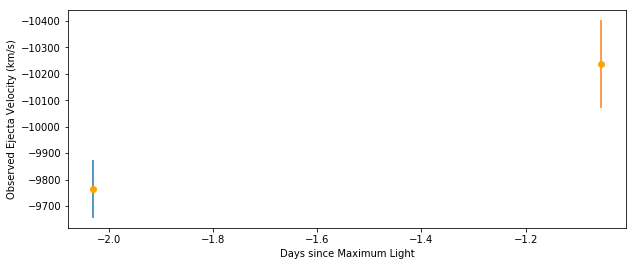

2006cp [u'sn2006cp-20060605.281-ui.flm', u'sn2006cp-20060530.25-fast.flm', u'sn2006cp-20060531.25-fast.flm', u'sn2006cp-20060601.26-fast.flm', u'sn2006cp-20060602.16-fast.flm', u'sn2006cp-20060604.24-fast.flm', u'sn2006cp-20060617.21-fast.flm', u'sn2006cp-20060618.21-fast.flm', u'sn2006cp-20060620.19-fast.flm']


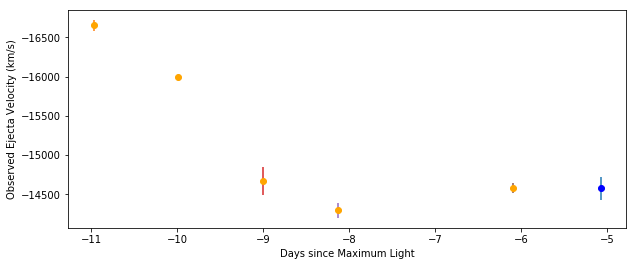

2006cq [u'sn2006cq-20060605.307-ui.flm', u'sn2006cq-20060531.27-fast.flm']


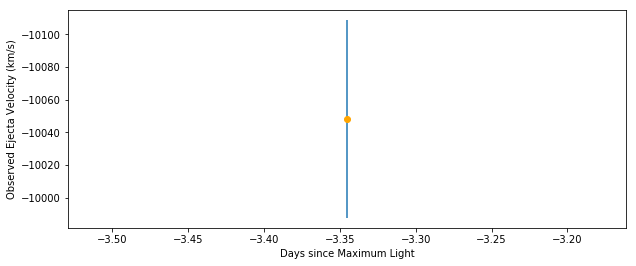

2006cs [u'sn2006cs-20060605.335-ui.flm']


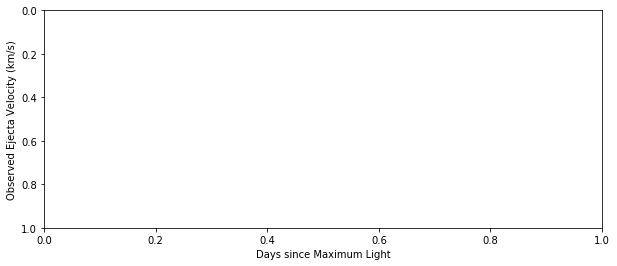

2006ef [u'sn2006ef-20060824.454-ui-corrected.flm']


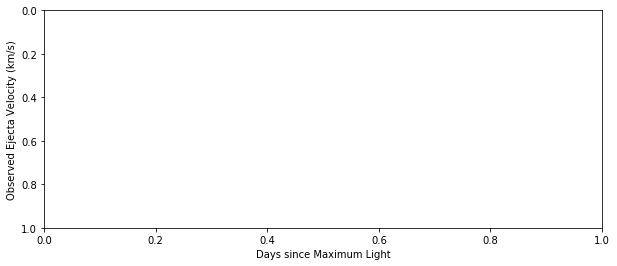

2006ej [u'sn2006ej-20060824.430-ui.flm', u'sn2006ej-20060902.398-ui.flm', u'sn2006ej-20060919.290-ui.flm']


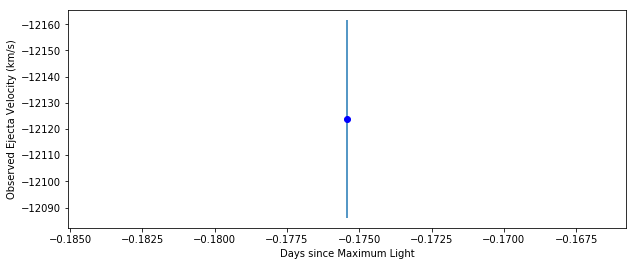

2006em [u'sn2006em-20060902.440-ui.flm', u'sn2006em-20060919.456-ui.flm', u'sn2006em-20060925.415-ui.flm', u'sn2006em-20060902.41-fast.flm']


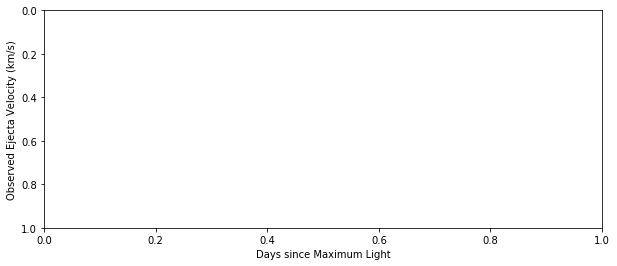

2006en [u'sn2006en-20060902.319-ui-corrected.flm', u'sn2006en-20060919.209-ui-corrected.flm']


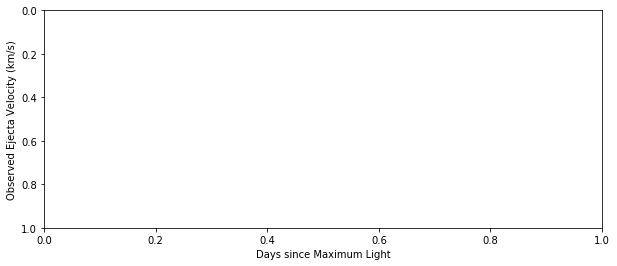

2006et [u'sn2006et-20060919.345-ui.flm', u'sn2006et-20060925.321-ui.flm', u'sn2006et-20060918.36-fast.flm', u'sn2006et-20060922.37-fast.flm', u'SN06et_060925_b01_DUP_WF.dat', u'SN06et_060926_b01_DUP_WF.dat', u'SN06et_061005_g01_NTT_EM.dat', u'SN06et_061011_b01_DUP_WF.dat']


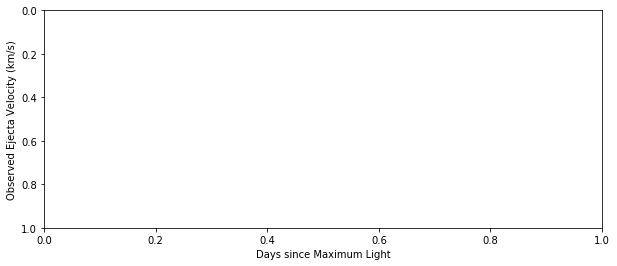

2006gj [u'sn2006gj-20060925.482-ui.flm', u'sn2006gj-20060920.43-fast.flm', u'sn2006gj-20060924.46-fast.flm', u'SN06gj_060925_b01_DUP_WF.dat', u'SN06gj_060927_b01_DUP_WF.dat', u'SN06gj_060928_b01_DUP_WF.dat', u'SN06gj_061005_g01_NTT_EM.dat', u'SN06gj_061007_b01_HIL_BC.dat', u'SN06gj_061011_b01_DUP_WF.dat', u'SN06gj_061016_b01_HIL_BC.dat']


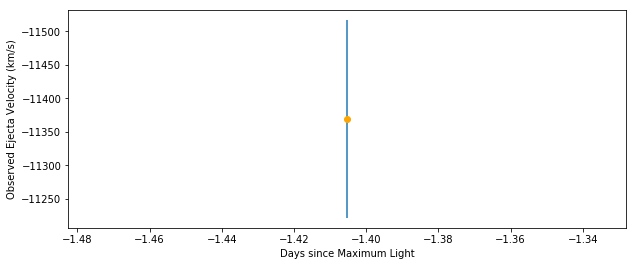

2006gr [u'sn2006gr-20060925.202-ui.flm', u'sn2006gr-20061024.150-ui.flm', u'sn2006gr-20061030.101-ui.flm', u'sn2006gr-20060923.22-fast.flm', u'sn2006gr-20060924.26-fast.flm', u'sn2006gr-20060925.23-fast.flm', u'sn2006gr-20060926.25-fast.flm', u'sn2006gr-20060927.30-fast.flm', u'sn2006gr-20060928.18-fast.flm', u'sn2006gr-20060929.13-fast.flm', u'sn2006gr-20060930.30-fast.flm', u'sn2006gr-20061002.26-fast.flm', u'sn2006gr-20061003.26-fast.flm', u'sn2006gr-20061014.14-fast.flm', u'sn2006gr-20061017.24-fast.flm', u'sn2006gr-20061023.18-fast.flm', u'sn2006gr-20061028.16-fast.flm', u'sn2006gr-20061029.23-fast.flm']


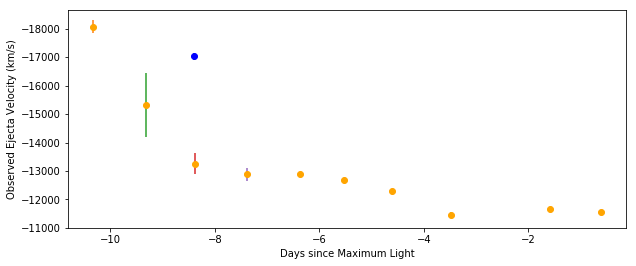

2006gt [u'sn2006gt-20060925.348-ui.flm', u'sn2006gt-20060925.36-fast.flm', u'sn2006gt-20060926.38-fast.flm', u'sn2006gt-20060927.37-fast.flm', u'SN06gt_060925_b01_DUP_WF.dat', u'SN06gt_060927_b01_DUP_WF.dat', u'SN06gt_060928_b01_DUP_WF.dat', u'SN06gt_061010_b01_DUP_WF.dat']


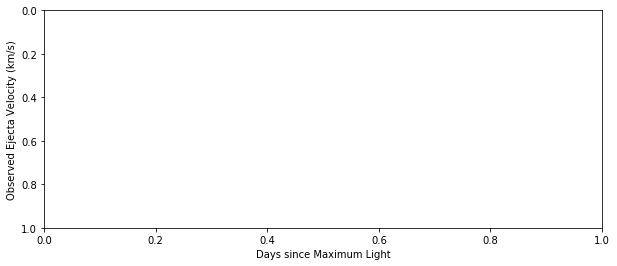

2006kf [u'sn2006kf-20061024.352-ui.flm', u'sn2006kf-20061030.385-ui.flm', u'sn2006kf-20061120.241-ui.flm', u'sn2006kf-20061027.39-fast.flm', u'SN06kf_061027_b01_DUP_WF.dat', u'SN06kf_061103_b01_HIL_BC.dat', u'SN06kf_061103_g01_NTT_EM.dat', u'SN06kf_061116_b01_DUP_WF.dat', u'SN06kf_061117_b01_HIL_BC.dat', u'SN06kf_061130_b01_HIL_BC.dat']


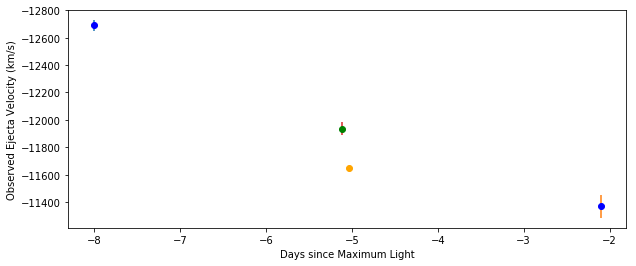

2006le [u'sn2006le-20061030.456-ui-corrected.flm', u'sn2006le-20061120.427-ui-corrected.flm', u'sn2006le-20061030.43-fast.flm', u'sn2006le-20061031.45-fast.flm', u'sn2006le-20061101.43-fast.flm', u'sn2006le-20061112.40-fast.flm', u'sn2006le-20061114.38-fast.flm', u'sn2006le-20061115.44-fast.flm', u'sn2006le-20061116.42-fast.flm', u'sn2006le-20061117.44-fast.flm', u'sn2006le-20061119.40-fast.flm', u'sn2006le-20061121.37-fast.flm', u'sn2006le-20061122.38-fast.flm', u'sn2006le-20061123.36-fast.flm', u'sn2006le-20061125.36-fast.flm']


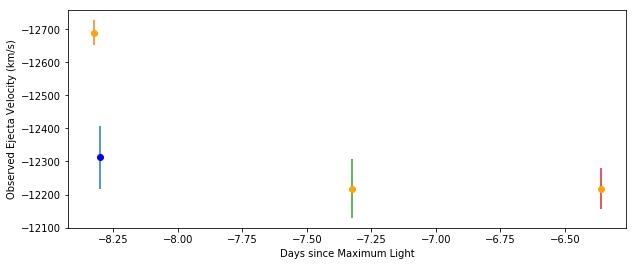

2006lf [u'sn2006lf-20061030.420-ui-corrected.flm', u'sn2006lf-20061120.276-ui-corrected.flm', u'sn2006lf-20061201.194-ui-corrected.flm']


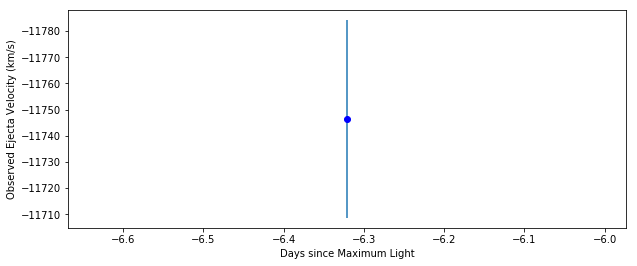

2006mo [u'sn2006mo-20061120.174-ui.flm', u'sn2006mo-20061113.21-fast.flm']


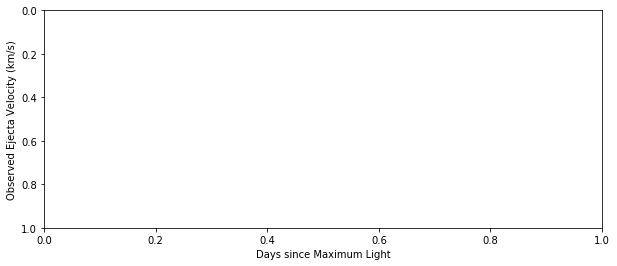

2006mp [u'sn2006mp-20061120.101-ui.flm']


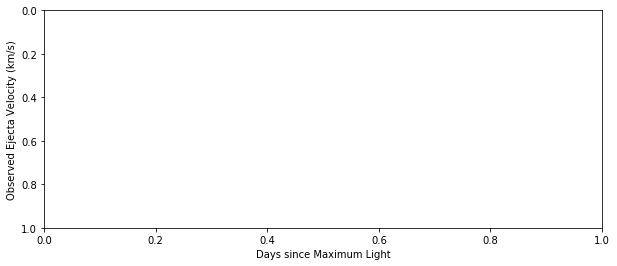

2006n [u'sn2006n-20060123.286-ui.flm', u'sn2006n-20060124.285-ui.flm', u'sn2006n-20060206.285-ui.flm', u'sn2006n-20060222.131-ui.flm', u'sn2006N-20060122.23-fast.flm', u'sn2006N-20060124.26-fast.flm', u'sn2006N-20060126.32-fast.flm', u'sn2006N-20060127.24-fast.flm', u'sn2006N-20060128.22-fast.flm', u'sn2006N-20060130.22-fast.flm', u'sn2006N-20060131.22-fast.flm', u'sn2006N-20060201.21-fast.flm', u'sn2006N-20060202.20-fast.flm', u'sn2006N-20060203.21-fast.flm', u'sn2006N-20060206.32-fast.flm', u'sn2006N-20060223.18-fast.flm']


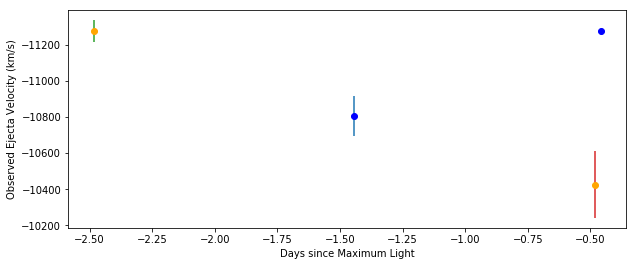

2006or [u'sn2006or-20061123.654-br.flm', u'sn2006or-20061201.530-ui.flm']


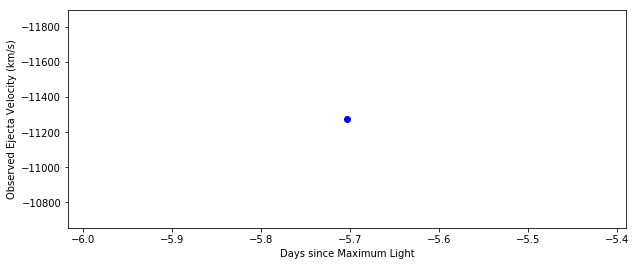

2006os [u'sn2006os-20061201.142-ui.flm', u'sn2006os-20061220.233-ui.flm', u'SN06os_061122_b01_DUP_WF.dat', u'SN06os_061213_b01_DUP_BC.dat']


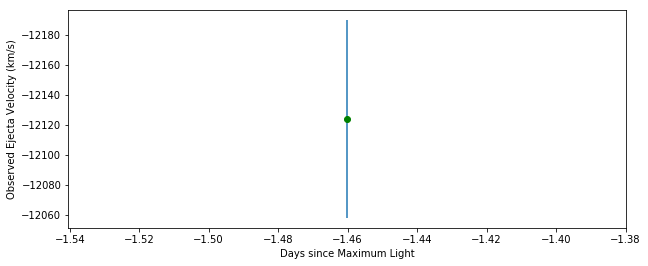

2006qo [u'sn2006qo-20061201.436-ui.flm']


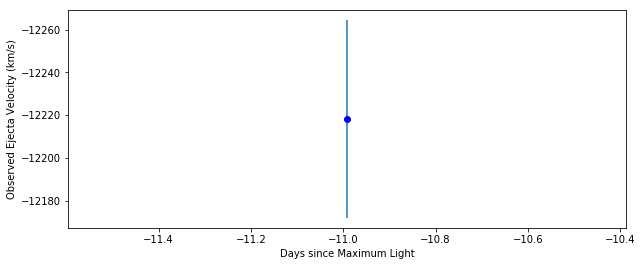

2006s [u'sn2006s-20060130.375-ui.flm', u'sn2006s-20060206.517-ui.flm', u'sn2006s-20060222.476-ui.flm', u'sn2006S-20060128.50-fast.flm', u'sn2006S-20060129.51-fast.flm', u'sn2006S-20060131.49-fast.flm', u'sn2006S-20060202.47-fast.flm', u'sn2006S-20060203.47-fast.flm', u'sn2006S-20060204.47-fast.flm', u'sn2006S-20060206.48-fast.flm', u'sn2006S-20060207.43-mmt.flm', u'sn2006S-20060224.39-fast.flm']


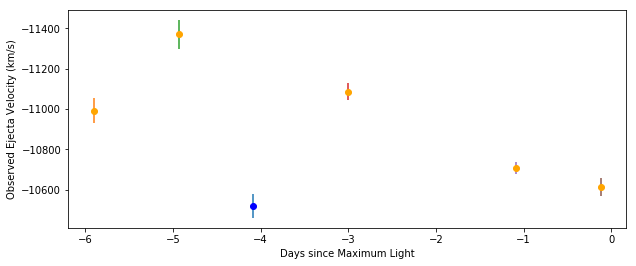

2006sr [u'sn2006sr-20061220.097-ui.flm', u'sn2006sr-20061225.242-br.flm', u'sn2006sr-20061222.12-fast.flm', u'sn2006sr-20061224.09-fast.flm', u'sn2006sr-20061225.12-fast.flm', u'sn2006sr-20061226.13-fast.flm', u'sn2006sr-20061227.09-fast.flm', u'sn2006sr-20070110.12-fast.flm']


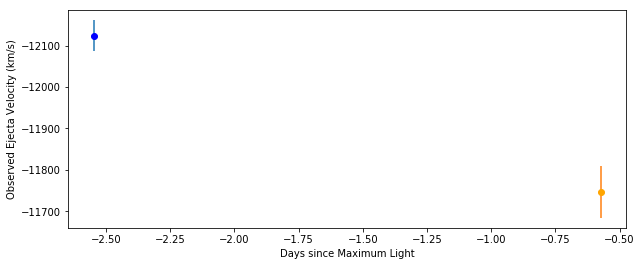

2006td [u'sn2006td-20070121.218-ui.flm']


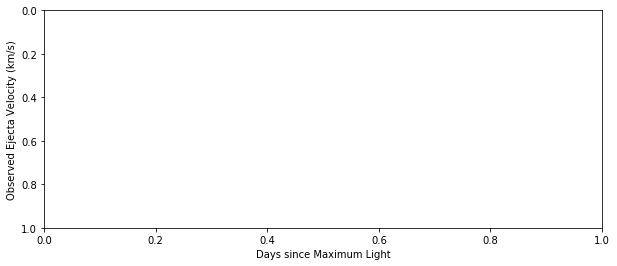

2006te [u'sn2006te-20070121.393-ui.flm', u'sn2006te-20070109.49-fast.flm']


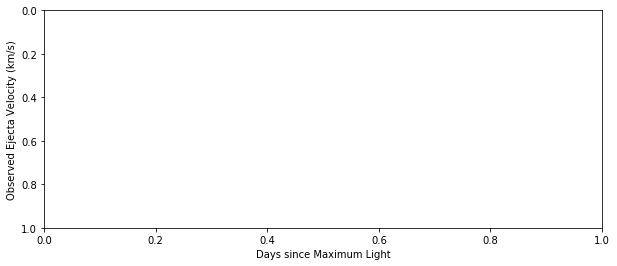

2007al [u'sn2007al-20070313.289-ui.flm', u'sn2007al-20070312.31-fast.flm', u'sn2007al-20070313.23-fast.flm', u'sn2007al-20070314.26-fast.flm', u'sn2007al-20070315.23-fast.flm', u'sn2007al-20070318.25-fast.flm', u'sn2007al-20070320.24-fast.flm', u'SN07al_070313_g01_BAA_IM.dat']


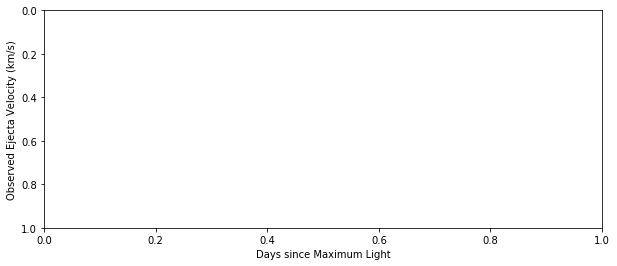

2007ap [u'sn2007ap-20070317.649-deimos.flm', u'sn2007ap-20070315.45-fast.flm', u'sn2007ap-20070319.46-fast.flm']


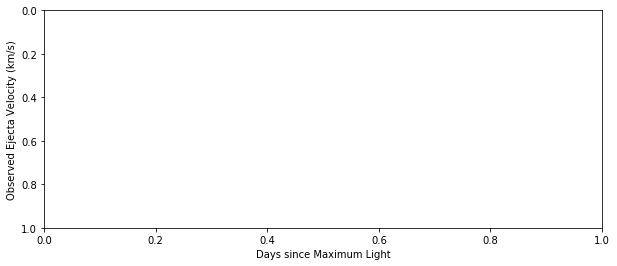

2007au [u'sn2007au-20070410.192-ui-corrected.flm', u'sn2007au-20070319.26-fast.flm', u'sn2007au-20070320.20-fast.flm', u'sn2007au-20070321.14-fast.flm', u'sn2007au-20070326.15-fast.flm']


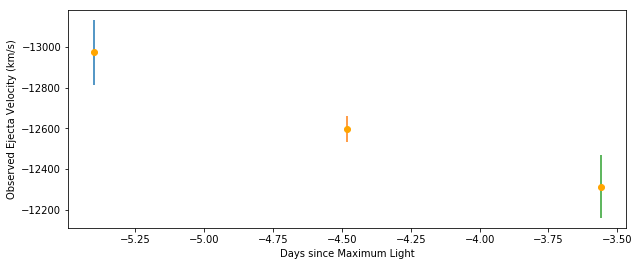

2007ba [u'sn2007ba-20070410.475-ui.flm', u'sn2007ba-20070413.629-deimos.flm', u'sn2007ba-20070416.623-deimos.flm', u'sn2007ba-20070409.43-fast.flm', u'sn2007ba-20070411.50-fast.flm', u'sn2007ba-20070412.47-fast.flm', u'SN07ba_070409_b01_BAA_IM.dat', u'SN07ba_070412_b01_DUP_WF.dat']


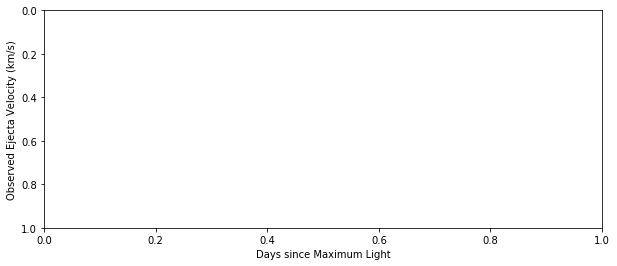

2007bc [u'sn2007bc-20070410.323-ui-corrected.flm', u'sn2007bc-20070407.24-fast.flm', u'sn2007bc-20070414.27-fast.flm', u'sn2007bc-20070416.21-fast.flm', u'sn2007bc-20070417.36-fast.flm', u'SN07bc_070409_b01_BAA_IM.dat', u'SN07bc_070412_b01_DUP_WF.dat', u'SN07bc_070417_b01_DUP_WF.dat']


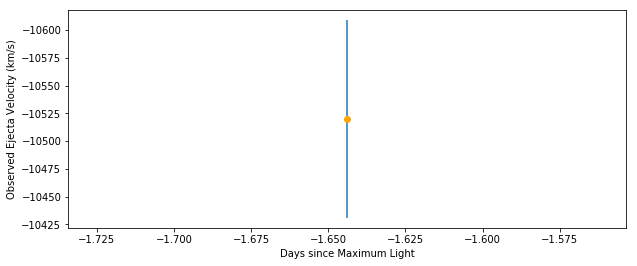

2007bd [u'sn2007bd-20070410.254-ui.flm', u'sn2007bd-20070426.226-ui.flm', u'sn2007bd-20070407.18-fast.flm', u'sn2007bd-20070408.18-fast.flm', u'sn2007bd-20070412.18-fast.flm', u'sn2007bd-20070415.20-fast.flm', u'sn2007bd-20070418.22-fast.flm', u'sn2007bd-20070425.17-fast.flm', u'SN07bd_070409_b01_BAA_IM.dat', u'SN07bd_070412_b01_DUP_WF.dat', u'SN07bd_070417_b01_DUP_WF.dat', u'SN07bd_070430_b01_DUP_BC.dat']


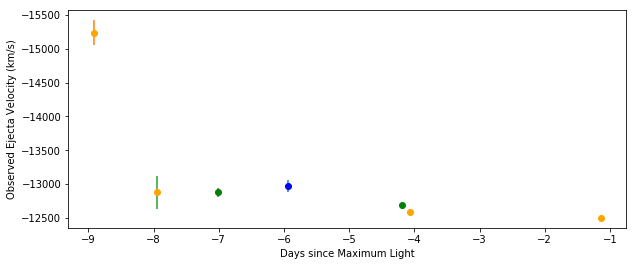

2007bz [u'sn2007bz-20070426.419-ui.flm', u'sn2007bz-20070512.31-fast.flm']


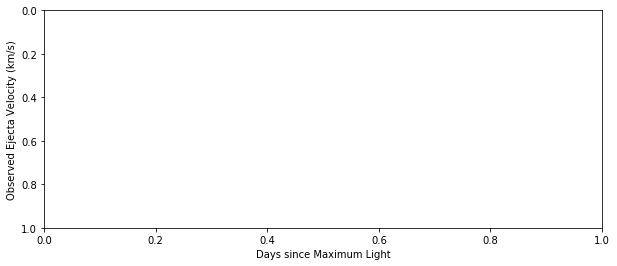

2007ca [u'sn2007ca-20070426.305-ui.flm', u'sn2007ca-20070524.291-ui-corrected.flm', u'sn2007ca-20070510.23-fast.flm', u'sn2007ca-20070512.27-fast.flm', u'sn2007ca-20070513.21-fast.flm', u'sn2007ca-20070516.26-fast.flm', u'sn2007ca-20070518.32-fast.flm', u'sn2007ca-20070520.22-fast.flm', u'SN07ca_070508_b01_BAA_IM.dat', u'SN07ca_070511_b01_DUP_BC.dat']


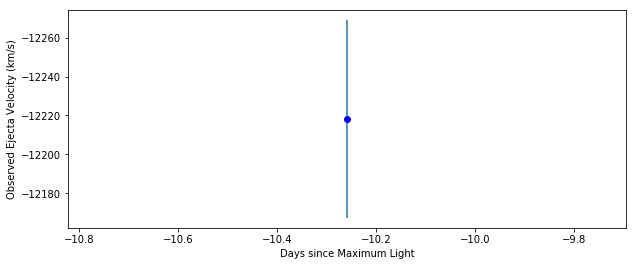

2007cg [u'sn2007cg-20070524.234-ui.flm', u'sn2007cg-20070514.24-fast.flm', u'sn2007cg-20070515.22-fast.flm', u'sn2007cg-20070516.24-fast.flm']


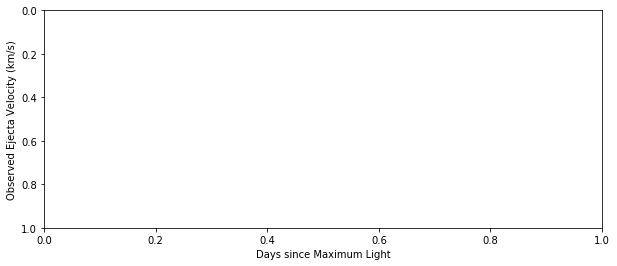

2007ci [u'sn2007ci-20070519.316-ui.flm', u'sn2007ci-20070524.264-ui-corrected.flm', u'sn2007ci-20070623.249-ui.flm', u'sn2007ci-20070518.20-fast.flm', u'sn2007ci-20070519.18-fast.flm', u'sn2007ci-20070520.20-fast.flm', u'sn2007ci-20070521.19-fast.flm', u'sn2007ci-20070522.19-fast.flm', u'sn2007ci-20070524.19-fast.flm', u'sn2007ci-20070525.19-fast.flm', u'sn2007ci-20070608.18-fast.flm', u'sn2007ci-20070612.19-fast.flm', u'sn2007ci-20070614.18-fast.flm', u'sn2007ci-20070617.20-fast.flm']


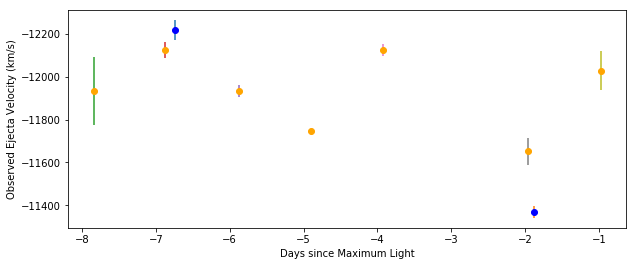

2007co [u'sn2007co-20070609.398-ui-corrected.flm', u'sn2007co-20070614.468-ui-corrected.flm', u'sn2007co-20070623.408-ui-corrected.flm', u'sn2007co-20070707.316-ui-corrected.flm', u'sn2007co-20070608.35-fast.flm', u'sn2007co-20070609.33-fast.flm', u'sn2007co-20070610.39-fast.flm', u'sn2007co-20070612.35-fast.flm', u'sn2007co-20070613.39-fast.flm', u'sn2007co-20070614.38-fast.flm', u'sn2007co-20070615.36-fast.flm', u'sn2007co-20070616.35-fast.flm', u'sn2007co-20070617.34-fast.flm', u'sn2007co-20070619.45-fast.flm', u'sn2007co-20070620.34-fast.flm', u'sn2007co-20070621.33-fast.flm', u'sn2007co-20070622.38-fast.flm', u'sn2007co-20070624.36-fast.flm', u'sn2007co-20070625.40-fast.flm']


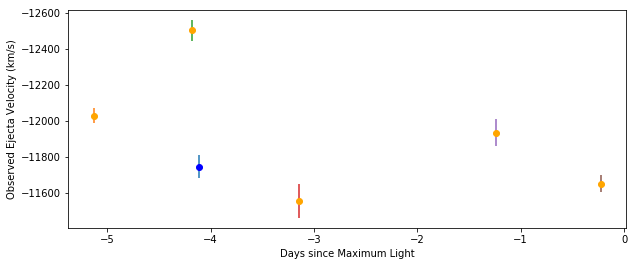

2007cq [u'sn2007cq-20070623.431-ui.flm', u'sn2007cq-20070707.439-ui.flm', u'sn2007cq-20070715.374-ui-corrected.flm', u'sn2007cq-20070720.319-ui-corrected.flm', u'sn2007cq-20070624.45-fast.flm', u'sn2007cq-20070625.45-fast.flm']


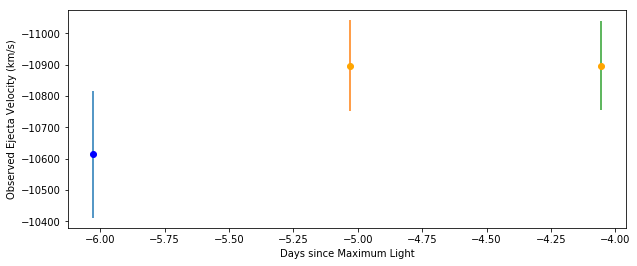

2007f [u'sn2007f-20070113.658-br.flm', u'sn2007f-20070126.534-ui.flm', u'sn2007f-20070218.420-ui.flm', u'sn2007F-20070114.49-fast.flm', u'sn2007F-20070115.53-fast.flm', u'sn2007F-20070116.54-fast.flm', u'sn2007F-20070117.53-fast.flm', u'sn2007F-20070121.55-fast.flm', u'sn2007F-20070122.49-fast.flm', u'sn2007F-20070126.43-fast.flm', u'sn2007F-20070210.39-fast.flm', u'sn2007F-20070219.43-fast.flm']


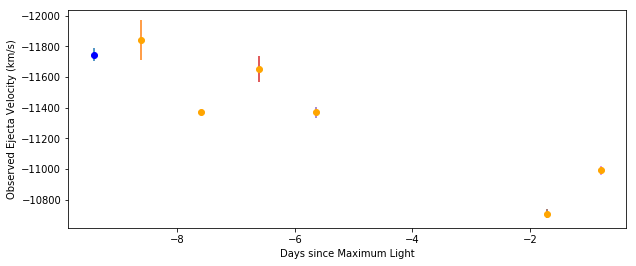

2007n [u'sn2007n-20070122.583-deimos.flm', u'sn2007n-20070214.668-br.flm']


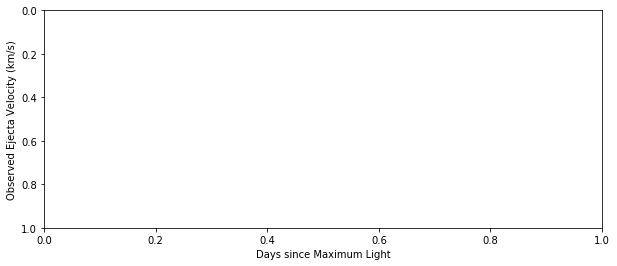

2007o [u'sn2007o-20070122.663-deimos.flm', u'sn2007o-20070218.487-ui.flm']


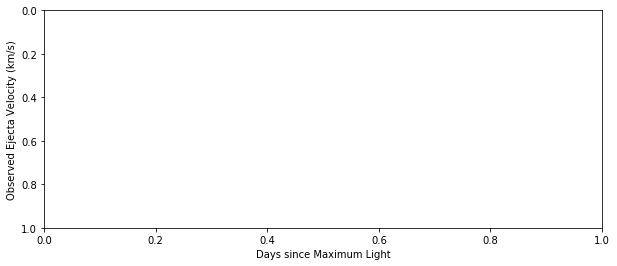

2007qe [u'sn2007qe-20071118.104-ui.flm', u'sn2007qe-20071201.176-ui.flm', u'sn2007qe-20071211.187-ui.flm', u'sn2007qe-20071115.28-fast.flm', u'sn2007qe-20071116.11-fast.flm', u'sn2007qe-20071203.12-fast.flm', u'sn2007qe-20071204.14-fast.flm', u'sn2007qe-20071206.15-fast.flm', u'sn2007qe-20071214.07-mmt.flm', u'sn2007qe-20071214.11-fast.flm', u'sn2007qe-20071216.12-fast.flm', u'sn2007qe-20071218.14-fast.flm']


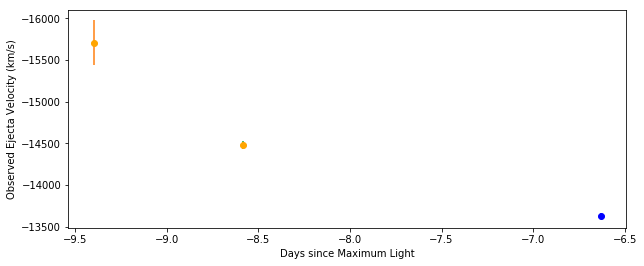

2007r [u'sn2007r-20070218.230-ui.flm']


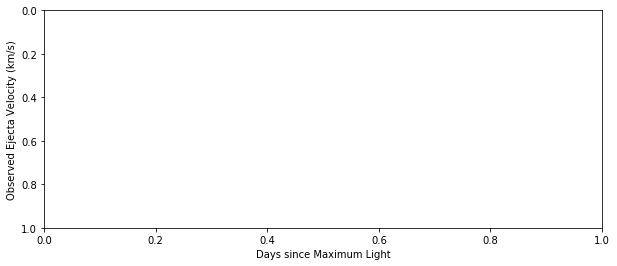

2007s [u'sn2007s-20070218.375-ui.flm', u'sn2007S-20070208.34-fast.flm', u'sn2007S-20070209.30-fast.flm', u'sn2007S-20070210.32-fast.flm', u'sn2007S-20070212.33-fast.flm', u'sn2007S-20070219.32-fast.flm', u'sn2007S-20070221.32-fast.flm', u'sn2007S-20070225.30-fast.flm', u'sn2007S-20070226.30-fast.flm', u'sn2007S-20070310.28-fast.flm']


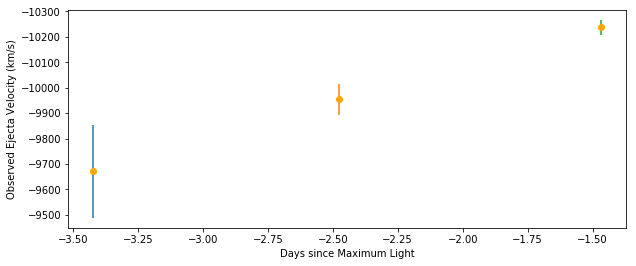

2008af [u'sn2008af-20080229.527-ir.flm', u'sn2008af-20080211.48-fast.flm', u'sn2008af-20080301.49-fast.flm']


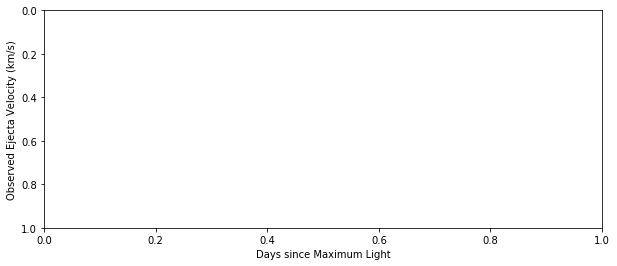

2008bf [u'sn2008bf-20080427-ui.flm', u'sn2008bf-20080330.31-fast.flm', u'sn2008bf-20080401.29-fast.flm', u'sn2008bf-20080402.35-fast.flm', u'sn2008bf-20080403.30-fast.flm', u'sn2008bf-20080406.29-fast.flm', u'sn2008bf-20080409.33-fast.flm', u'sn2008bf-20080410.28-fast.flm', u'sn2008bf-20080412.30-fast.flm', u'sn2008bf-20080415.24-fast.flm', u'SN08bf_080320_b01_CLA_LD.dat', u'SN08bf_080324_b01_CLA_LD.dat', u'SN08bf_080325_b01_CLA_LD.dat', u'SN08bf_080326_b01_CLA_LD.dat', u'SN08bf_080328_g01_NTT_EM.dat', u'SN08bf_080331_b01_DUP_WF.dat', u'SN08bf_080407_b01_DUP_WF.dat', u'SN08bf_080412_b01_DUP_WF.dat', u'SN08bf_080429_b01_DUP_WF.dat']


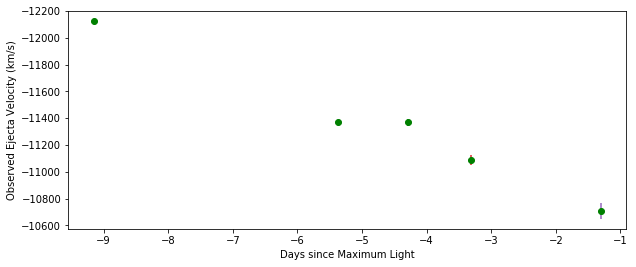

1993ac [u'sn1993ac-19931016.49-mmt.flm', u'sn1993ac-19931020.52-mmt.flm']


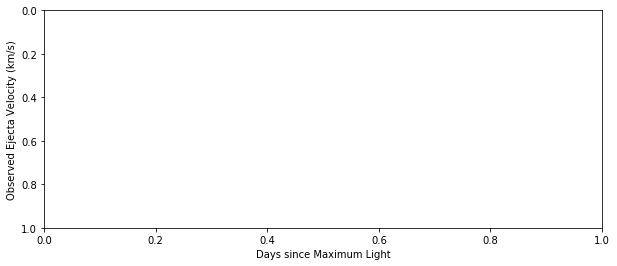

1994m [u'sn1994M-19940504.15-fast.flm', u'sn1994M-19940505.17-fast.flm', u'sn1994M-19940506.26-fast.flm', u'sn1994M-19940507.29-fast.flm', u'sn1994M-19940508.26-fast.flm', u'sn1994M-19940509.23-fast.flm', u'sn1994M-19940514.29-mmt.flm', u'sn1994M-19940515.27-mmt.flm']


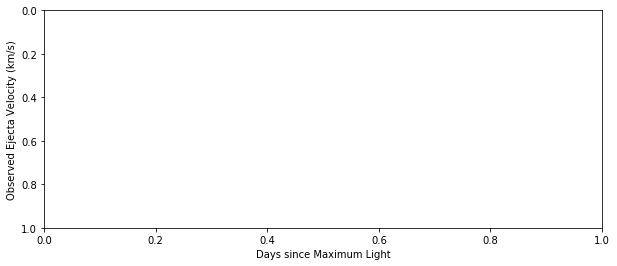

1994s [u'sn1994S-19940611.28-fast.flm', u'sn1994S-19940616.24-fast.flm', u'sn1994S-19940712.18-fast.flm', u'1994S_19940706_3501_9665_00.dat']


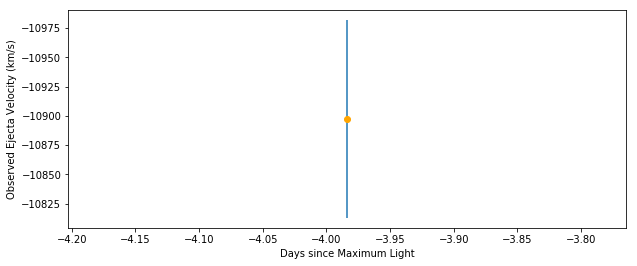

1994t [u'sn1994T-19940611.21-fast.flm', u'sn1994T-19940612.19-fast.flm', u'sn1994T-19940616.23-fast.flm']


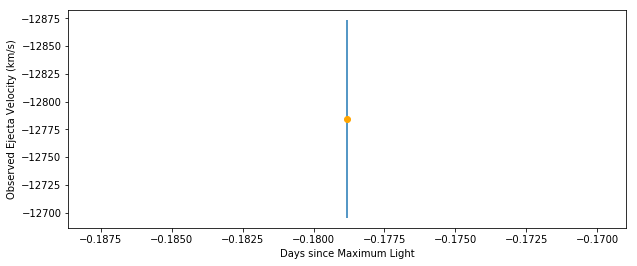

1995ac [u'sn1995ac-19950927.31-fast.flm', u'sn1995ac-19951028.23-fast.flm']


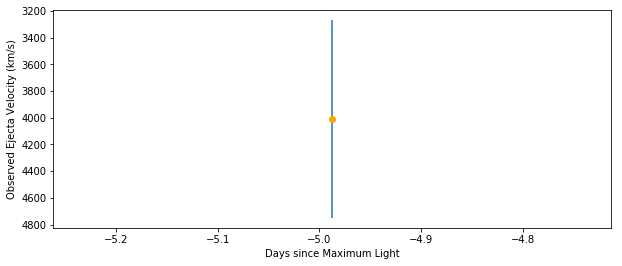

1995ak [u'sn1995ak-19951114.25-fast.flm', u'sn1995ak-19951118.33-fast.flm', u'sn1995ak-19951123.38-fast.flm', u'sn1995ak-19951127.26-fast.flm']


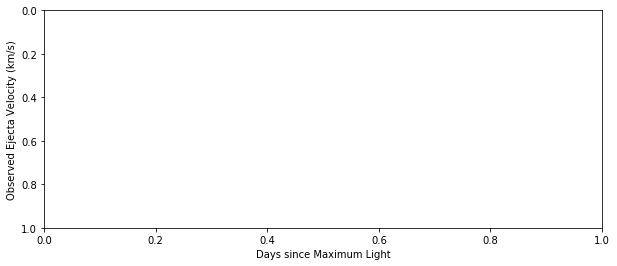

1995bd [u'sn1995bd-19951223.34-fast.flm', u'sn1995bd-19951225.27-fast.flm', u'sn1995bd-19951226.26-fast.flm', u'sn1995bd-19960115.24-fast.flm', u'sn1995bd-19960125.23-fast.flm']


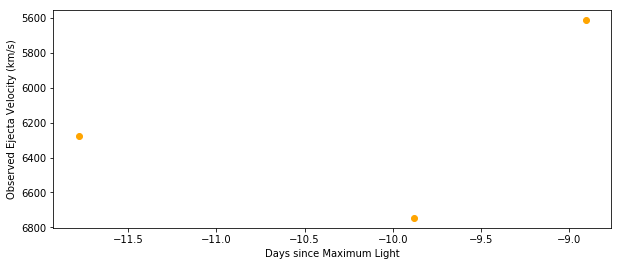

1995e [u'sn1995E-19950224.27-fast.flm', u'sn1995E-19950226.27-fast.flm', u'sn1995E-19950228.23-fast.flm', u'sn1995E-19950303.16-fast.flm', u'sn1995E-19950305.17-fast.flm', u'sn1995E-19950308.16-mmt.flm']


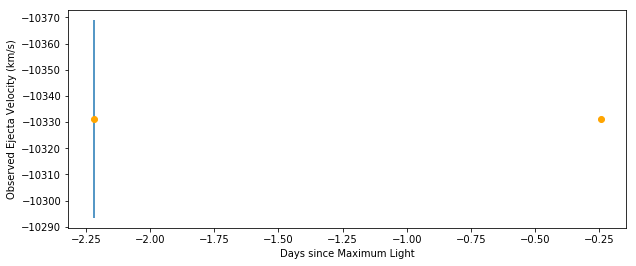

1996ab [u'sn1996ab-19960522.37-fast.flm']


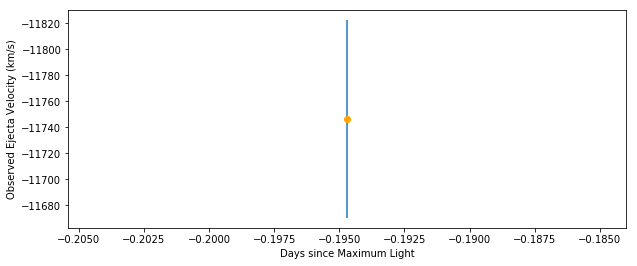

1996bl [u'sn1996bl-19961016.29-fast.flm', u'sn1996bl-19961018.18-fast.flm', u'sn1996bl-19961103.25-fast.flm', u'sn1996bl-19961108.24-fast.flm']


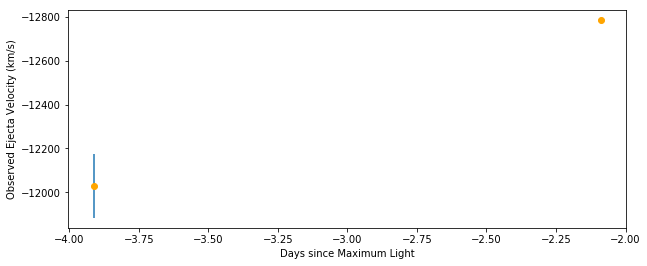

1996bo [u'sn1996bo-19961103.27-fast.flm', u'sn1996bo-19961105.24-fast.flm', u'sn1996bo-19961107.15-fast.flm', u'sn1996bo-19961109.28-fast.flm', u'sn1996bo-19961111.27-fast.flm']


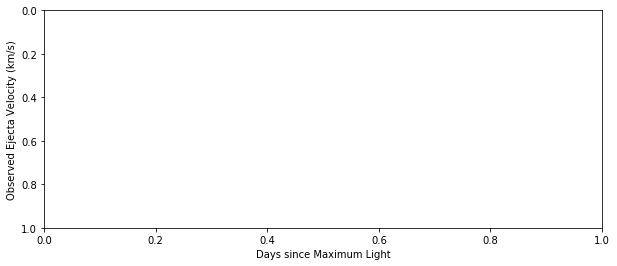

1996c [u'sn1996C-19960217.48-fast.flm', u'sn1996C-19960220.40-fast.flm', u'sn1996C-19960223.44-mmt.flm']


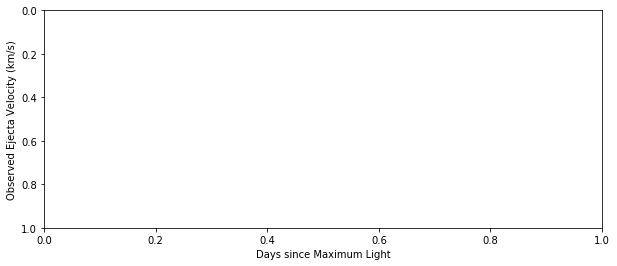

1997cn [u'sn1997cn-19970529.27-fast.flm', u'sn1997cn-19970530.20-fast.flm', u'sn1997cn-19970531.33-fast.flm', u'sn1997cn-19970601.35-fast.flm', u'sn1997cn-19970602.36-fast.flm', u'sn1997cn-19970603.23-fast.flm', u'sn1997cn-19970605.30-fast.flm', u'sn1997cn-19970607.18-fast.flm', u'sn1997cn-19970608.29-fast.flm', u'sn1997cn-19970609.21-fast.flm', u'sn1997cn-19970611.22-fast.flm']


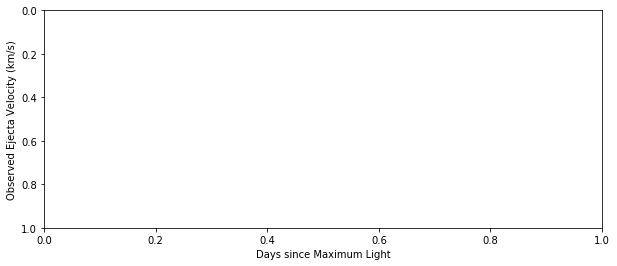

1997do [u'sn1997do-19971102.46-fast.flm', u'sn1997do-19971103.43-fast.flm', u'sn1997do-19971106.51-fast.flm', u'sn1997do-19971107.51-fast.flm', u'sn1997do-19971122.45-fast.flm', u'sn1997do-19971124.45-fast.flm', u'sn1997do-19971125.38-fast.flm', u'sn1997do-19971126.37-fast.flm', u'sn1997do-19971128.50-fast.flm', u'sn1997do-19971129.55-fast.flm', u'sn1997do-19971204.33-fast.flm', u'sn1997do-19971205.30-fast.flm', u'sn1997do-19971205.35-mmt.flm']


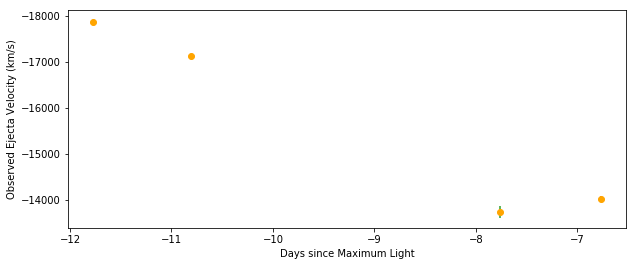

1997e [u'sn1997E-19970116.25-fast.flm', u'sn1997E-19970131.26-fast.flm', u'sn1997E-19970209.23-fast.flm']


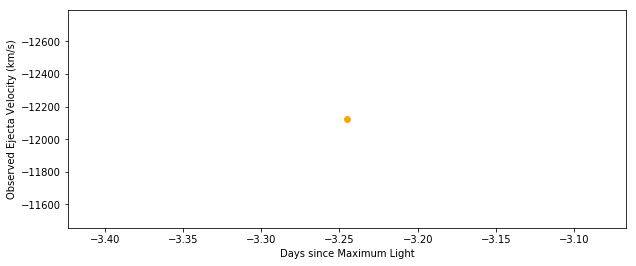

1997y [u'sn1997Y-19970209.41-fast.flm', u'sn1997Y-19970210.40-fast.flm', u'sn1997Y-19970214.47-fast.flm', u'sn1997Y-19970302.35-fast.flm']


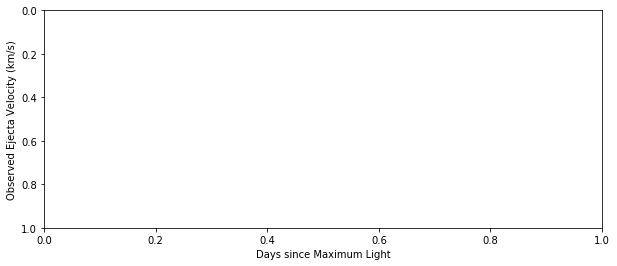

1998ab [u'sn1998ab-19980403.38-fast.flm', u'sn1998ab-19980418.28-fast.flm', u'sn1998ab-19980419.29-fast.flm', u'sn1998ab-19980429.28-fast.flm', u'sn1998ab-19980430.26-fast.flm', u'sn1998ab-19980501.27-fast.flm', u'sn1998ab-19980502.26-fast.flm', u'sn1998ab-19980503.26-fast.flm', u'sn1998ab-19980504.28-fast.flm']


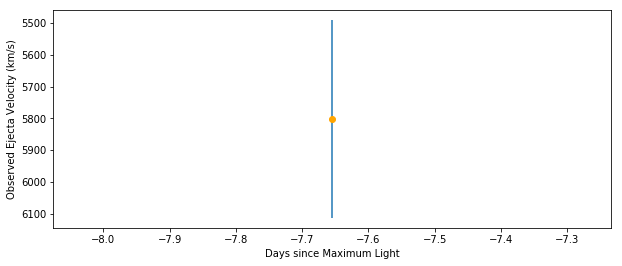

1998bp [u'sn1998bp-19980430.47-fast.flm', u'sn1998bp-19980501.47-fast.flm', u'sn1998bp-19980502.47-fast.flm', u'sn1998bp-19980503.45-fast.flm', u'sn1998bp-19980504.39-fast.flm', u'sn1998bp-19980528.47-fast.flm', u'sn1998bp-19980529.42-fast.flm', u'sn1998bp-19980531.40-fast.flm', u'sn1998bp-19980602.35-fast.flm']


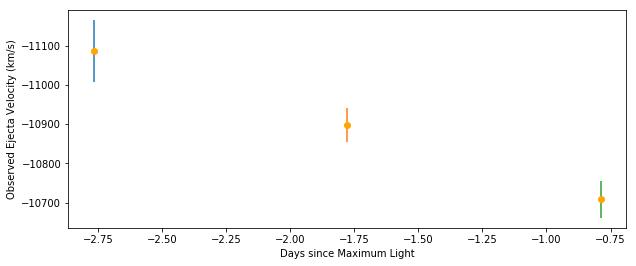

1998co [u'sn1998co-19980623.45-fast.flm', u'sn1998co-19980624.45-fast.flm', u'sn1998co-19980630.47-fast.flm', u'sn1998co-19980716.41-fast.flm', u'sn1998co-19980718.47-fast.flm']


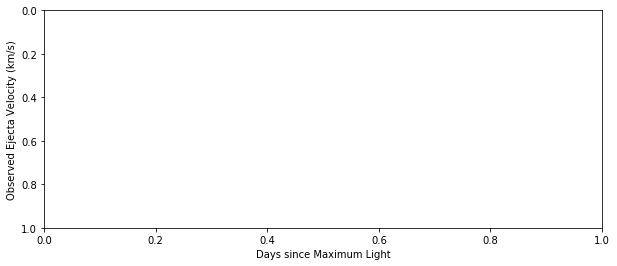

1998de [u'sn1998de-19980725.46-fast.flm', u'sn1998de-19980726.47-fast.flm', u'sn1998de-19980727.45-fast.flm', u'sn1998de-19980729.50-fast.flm', u'sn1998de-19980730.46-fast.flm', u'sn1998de-19980801.41-fast.flm', u'sn1998de-19980804.46-fast.flm']


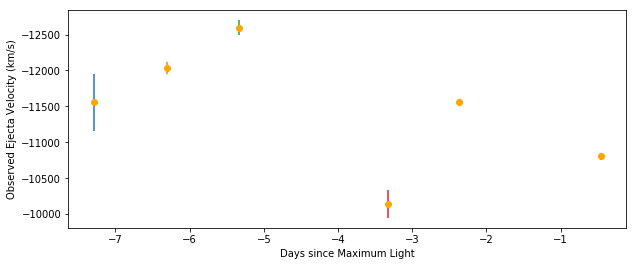

1998dx [u'sn1998dx-19980914.18-fast.flm', u'sn1998dx-19980915.22-fast.flm', u'sn1998dx-19980917.13-fast.flm', u'sn1998dx-19980918.15-fast.flm', u'sn1998dx-19980922.12-fast.flm', u'sn1998dx-19980924.16-fast.flm', u'sn1998dx-19980929.13-fast.flm']


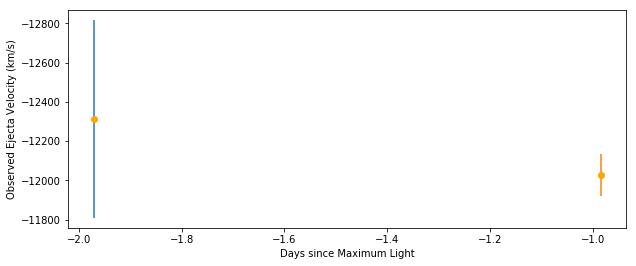

1998ef [u'sn1998ef-19981023.37-fast.flm', u'sn1998ef-19981024.30-fast.flm', u'sn1998ef-19981029.31-fast.flm', u'sn1998ef-19981115.25-fast.flm']


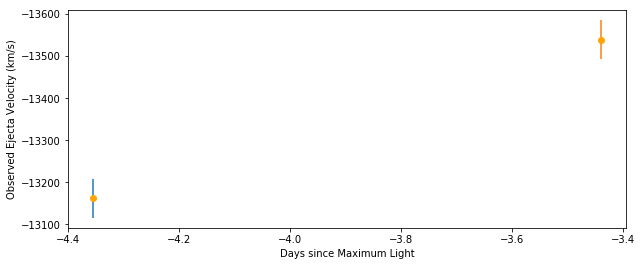

1998eg [u'sn1998eg-19981024.15-fast.flm', u'sn1998eg-19981029.19-fast.flm', u'sn1998eg-19981030.16-fast.flm', u'sn1998eg-19981111.16-fast.flm', u'sn1998eg-19981113.19-fast.flm', u'sn1998eg-19981117.18-fast.flm']


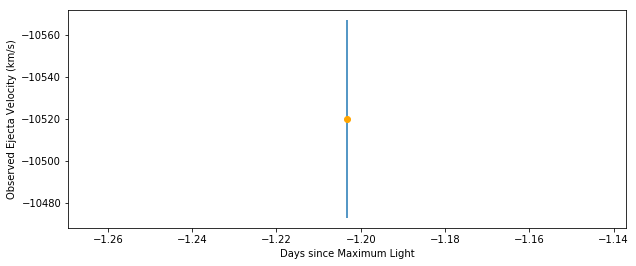

1998v [u'sn1998V-19980319.51-fast.flm', u'sn1998V-19980320.50-fast.flm', u'sn1998V-19980321.51-fast.flm', u'sn1998V-19980331.48-fast.flm', u'sn1998V-19980401.50-fast.flm', u'sn1998V-19980403.49-fast.flm']


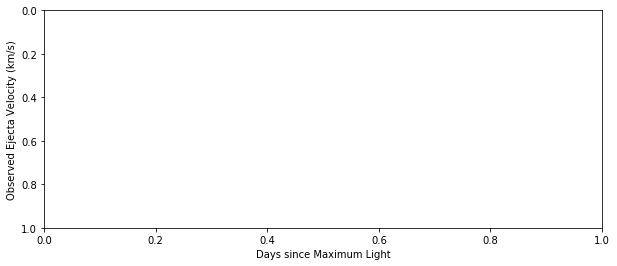

1999aa [u'sn1999aa-19990213.35-fast.flm', u'sn1999aa-19990214.33-fast.flm', u'sn1999aa-19990215.28-fast.flm', u'sn1999aa-19990216.24-fast.flm', u'sn1999aa-19990217.26-fast.flm', u'sn1999aa-19990218.25-fast.flm', u'sn1999aa-19990219.28-fast.flm', u'sn1999aa-19990220.29-fast.flm', u'sn1999aa-19990221.29-fast.flm', u'sn1999aa-19990223.25-fast.flm', u'sn1999aa-19990309.25-fast.flm', u'sn1999aa-19990310.23-fast.flm', u'sn1999aa-19990311.23-fast.flm', u'sn1999aa-19990312.29-fast.flm', u'sn1999aa-19990322.27-fast.flm', u'sn1999aa-19990323.19-fast.flm', u'sn1999aa-19990324.18-fast.flm', u'sn1999aa-19990325.12-fast.flm']


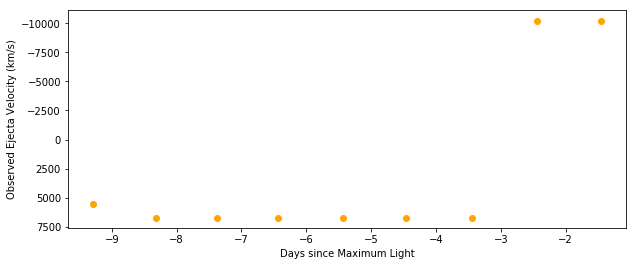

1999ac [u'sn1999ac-19990309.53-fast.flm', u'sn1999ac-19990310.53-fast.flm', u'sn1999ac-19990312.53-fast.flm', u'sn1999ac-19990322.51-fast.flm', u'sn1999ac-19990323.51-fast.flm', u'sn1999ac-19990324.51-fast.flm', u'sn1999ac-19990325.50-fast.flm', u'sn1999ac-19990407.46-fast.flm', u'sn1999ac-19990409.45-fast.flm', u'sn1999ac-19990411.48-fast.flm']


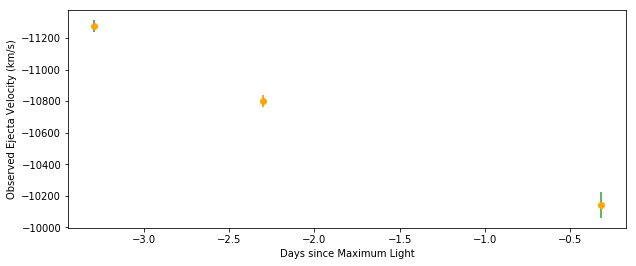

1999cc [u'sn1999cc-19990514.36-fast.flm', u'sn1999cc-19990516.34-fast.flm', u'sn1999cc-19990517.40-fast.flm', u'sn1999cc-19990519.36-fast.flm', u'sn1999cc-19990605.35-fast.flm', u'sn1999cc-19990610.37-fast.flm', u'sn1999cc-19990612.32-fast.flm']


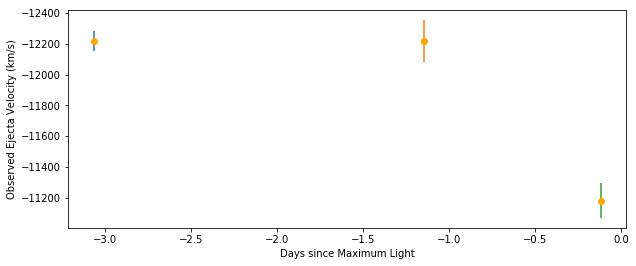

1999cp [u'sn1999cp-19990619.19-fast.flm', u'sn1999cp-19990620.28-fast.flm', u'sn1999cp-19990622.20-fast.flm']


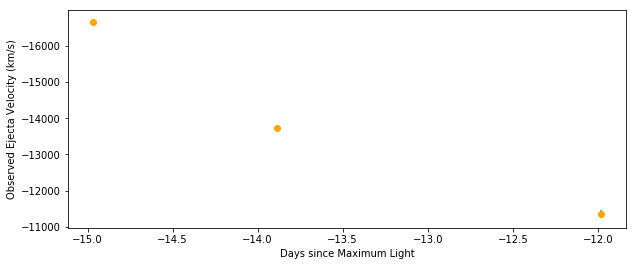

1999da [u'sn1999da-19990709.45-fast.flm']


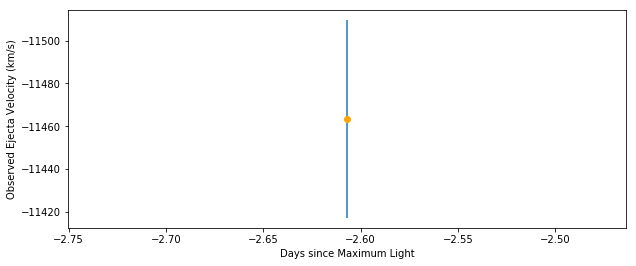

1999dq [u'sn1999dq-19990905.45-fast.flm', u'sn1999dq-19990906.43-fast.flm', u'sn1999dq-19990907.48-fast.flm', u'sn1999dq-19990908.48-fast.flm', u'sn1999dq-19990909.44-fast.flm', u'sn1999dq-19990910.44-fast.flm', u'sn1999dq-19990911.46-fast.flm', u'sn1999dq-19990912.51-fast.flm', u'sn1999dq-19990915.45-fast.flm', u'sn1999dq-19990916.45-fast.flm', u'sn1999dq-19990917.46-fast.flm', u'sn1999dq-19990918.45-fast.flm', u'sn1999dq-19990920.46-fast.flm', u'sn1999dq-19991002.47-fast.flm', u'sn1999dq-19991003.45-fast.flm', u'sn1999dq-19991011.45-fast.flm', u'sn1999dq-19991014.32-fast.flm']


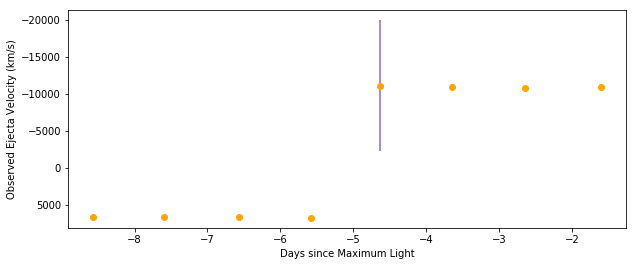

1999ef [u'sn1999ef-19991013.29-fast.flm', u'sn1999ef-19991014.31-fast.flm', u'sn1999ef-19991016.30-fast.flm']


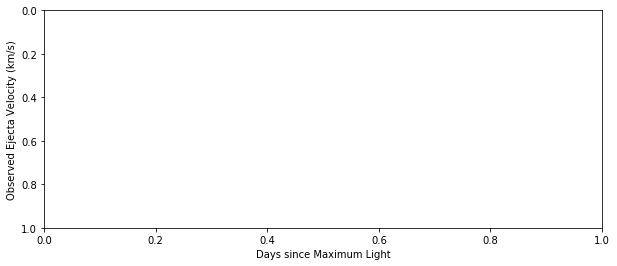

1999ej [u'sn1999ej-19991030.28-fast.flm', u'sn1999ej-19991102.20-fast.flm', u'sn1999ej-19991104.27-fast.flm', u'sn1999ej-19991109.26-fast.flm', u'sn1999ej-19991112.27-fast.flm']


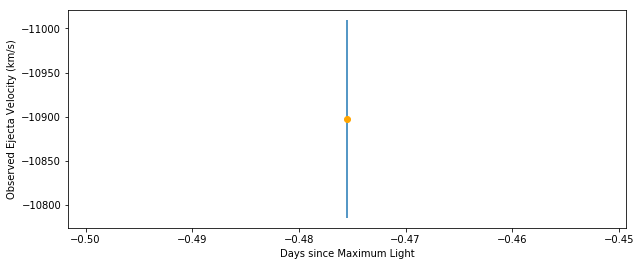

1999ek [u'sn1999ek-19991103.40-fast.flm', u'sn1999ek-19991109.42-fast.flm', u'sn1999ek-19991112.46-fast.flm']


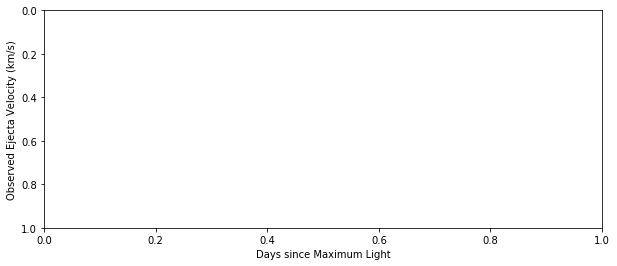

1999gd [u'sn1999gd-19991208.52-fast.flm', u'sn1999gd-19991215.46-fast.flm', u'sn1999gd-20000102.39-fast.flm', u'sn1999gd-20000106.44-fast.flm']


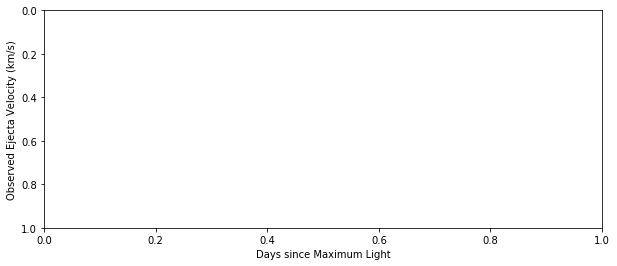

1999gp [u'sn1999gp-20000102.21-fast.flm', u'sn1999gp-20000105.10-fast.flm', u'sn1999gp-20000107.13-fast.flm', u'sn1999gp-20000110.11-fast.flm', u'sn1999gp-20000112.09-fast.flm', u'sn1999gp-20000114.16-fast.flm', u'sn1999gp-20000129.10-fast.flm']


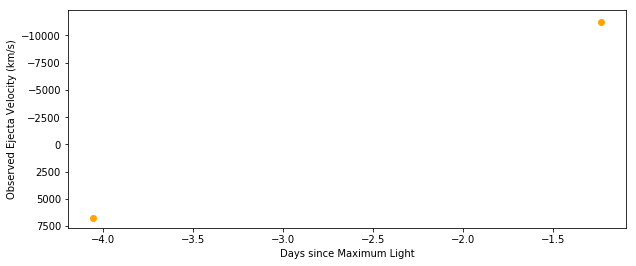

2000bh [u'sn2000bh-20000427.24-fast.flm']


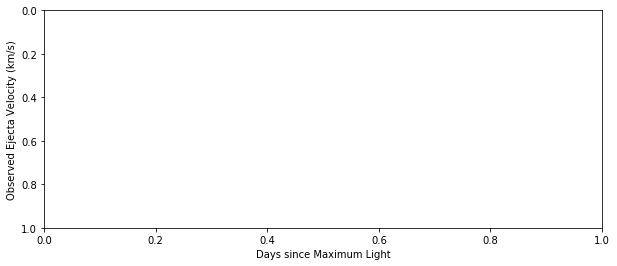

2000ce [u'sn2000ce-20000510.15-fast.flm', u'sn2000ce-20000512.15-fast.flm', u'sn2000ce-20000523.14-fast.flm', u'sn2000ce-20000525.15-fast.flm']


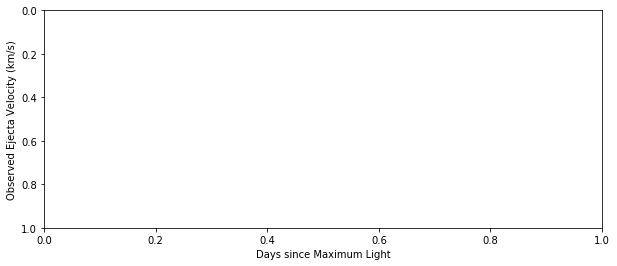

2000cf [u'sn2000cf-20000511.34-fast.flm', u'sn2000cf-20000512.36-fast.flm', u'sn2000cf-20000523.31-fast.flm', u'sn2000cf-20000525.35-fast.flm', u'sn2000cf-20000602.33-fast.flm', u'sn2000cf-20000603.33-fast.flm']


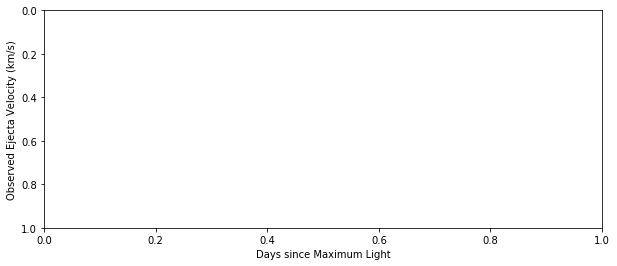

2000cn [u'sn2000cn-20000603.37-fast.flm', u'sn2000cn-20000604.38-fast.flm', u'sn2000cn-20000605.37-fast.flm', u'sn2000cn-20000621.37-fast.flm', u'sn2000cn-20000625.36-fast.flm', u'sn2000cn-20000709.24-fast.flm', u'sn2000cn-20000710.27-fast.flm']


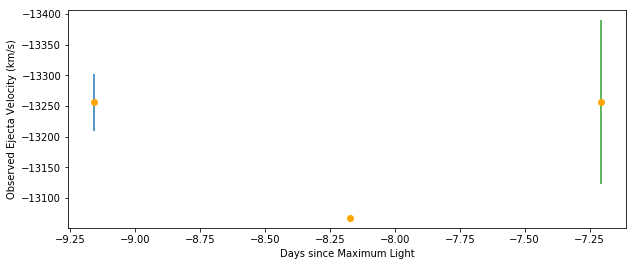

2000dk [u'sn2000dk-20000920.39-fast.flm', u'sn2000dk-20000921.27-fast.flm', u'sn2000dk-20000926.37-fast.flm', u'sn2000dk-20000929.34-fast.flm', u'sn2000dk-20001005.33-fast.flm']


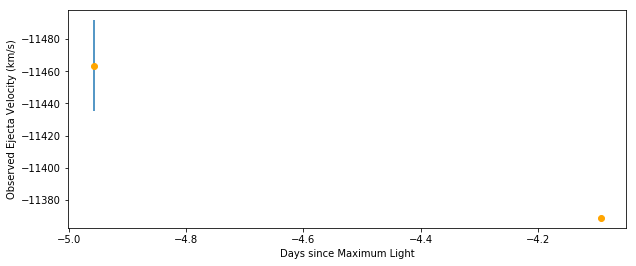

2000fa [u'sn2000fa-20001203.44-mmt.flm', u'sn2000fa-20001203.48-fast.flm', u'sn2000fa-20001215.36-fast.flm', u'sn2000fa-20001216.36-fast.flm', u'sn2000fa-20001218.38-fast.flm', u'sn2000fa-20001223.35-fast.flm', u'sn2000fa-20001225.42-fast.flm', u'sn2000fa-20001228.41-fast.flm', u'sn2000fa-20001230.43-fast.flm', u'sn2000fa-20010101.42-fast.flm', u'sn2000fa-20010104.36-fast.flm']


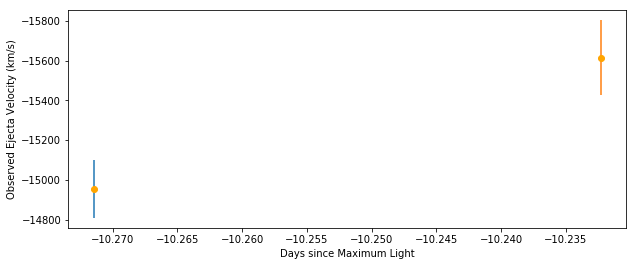

2001ah [u'sn2001ah-20010328.22-fast.flm', u'sn2001ah-20010329.25-fast.flm', u'sn2001ah-20010426.30-mmt.flm']


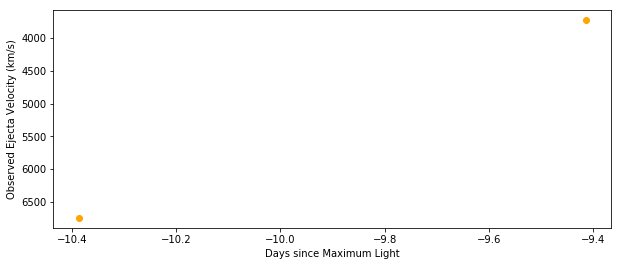

2001az [u'sn2001az-20010430.40-fast.flm', u'sn2001az-20010522.33-fast.flm', u'sn2001az-20010524.43-mmt.flm', u'sn2001az-20010529.35-fast.flm']


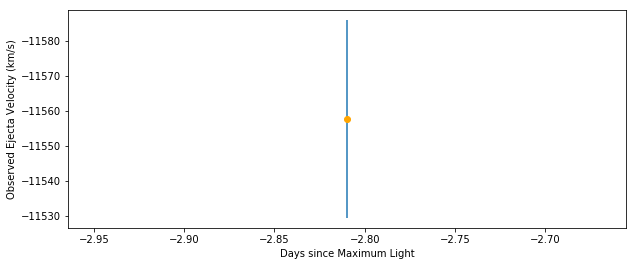

2001bf [u'sn2001bf-20010517.48-fast.flm', u'sn2001bf-20010521.43-fast.flm', u'sn2001bf-20010524.44-fast.flm', u'sn2001bf-20010525.47-mmt.flm', u'sn2001bf-20010529.37-fast.flm']


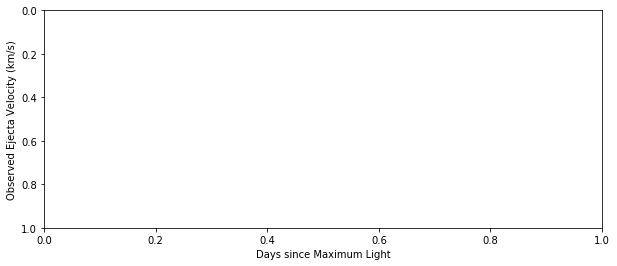

2001cp [u'sn2001cp-20010621.45-fast.flm', u'sn2001cp-20010623.44-fast.flm', u'sn2001cp-20010624.40-fast.flm', u'sn2001cp-20010627.26-fast.flm', u'sn2001cp-20010629.28-fast.flm', u'sn2001cp-20010715.25-fast.flm', u'sn2001cp-20010721.21-fast.flm', u'sn2001cp-20010725.26-fast.flm']


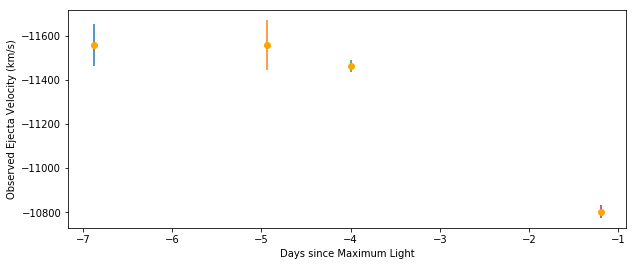

2001da [u'sn2001da-20010714.46-fast.flm', u'sn2001da-20010715.47-mmt.flm', u'sn2001da-20010716.46-fast.flm', u'sn2001da-20010718.45-fast.flm', u'sn2001da-20010719.47-fast.flm', u'sn2001da-20010724.45-fast.flm']


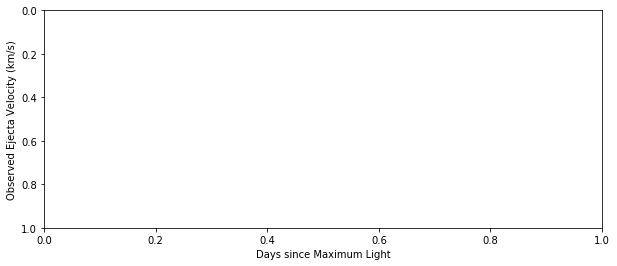

2001eh [u'sn2001eh-20010912.44-fast.flm', u'sn2001eh-20010915.42-fast.flm', u'sn2001eh-20010917.39-fast.flm', u'sn2001eh-20010920.33-fast.flm', u'sn2001eh-20010921.35-fast.flm', u'sn2001eh-20010922.35-fast.flm', u'sn2001eh-20010923.37-fast.flm', u'sn2001eh-20010926.37-fast.flm', u'sn2001eh-20011013.33-fast.flm', u'sn2001eh-20011014.32-fast.flm', u'sn2001eh-20011015.32-fast.flm', u'sn2001eh-20011017.33-fast.flm']


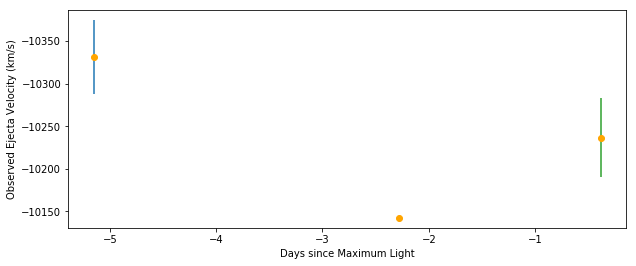

2001en [u'sn2001en-20011011.39-fast.flm', u'sn2001en-20011014.34-fast.flm', u'sn2001en-20011015.31-fast.flm', u'sn2001en-20011016.33-fast.flm', u'sn2001en-20011018.35-fast.flm', u'sn2001en-20011020.29-fast.flm', u'sn2001en-20011022.29-fast.flm', u'sn2001en-20011024.25-fast.flm']


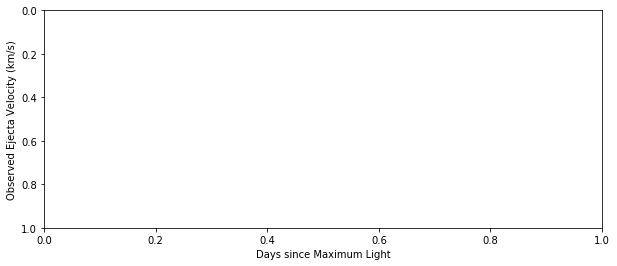

2001ep [u'sn2001ep-20011010.49-fast.flm', u'sn2001ep-20011014.45-fast.flm', u'sn2001ep-20011015.45-fast.flm', u'sn2001ep-20011016.45-fast.flm', u'sn2001ep-20011017.42-fast.flm', u'sn2001ep-20011018.43-fast.flm', u'sn2001ep-20011019.44-fast.flm', u'sn2001ep-20011020.44-fast.flm', u'sn2001ep-20011021.43-fast.flm', u'sn2001ep-20011022.43-fast.flm', u'sn2001ep-20011023.45-fast.flm', u'sn2001ep-20011024.43-fast.flm', u'sn2001ep-20011025.43-fast.flm', u'sn2001ep-20011107.39-fast.flm', u'sn2001ep-20011115.37-fast.flm']


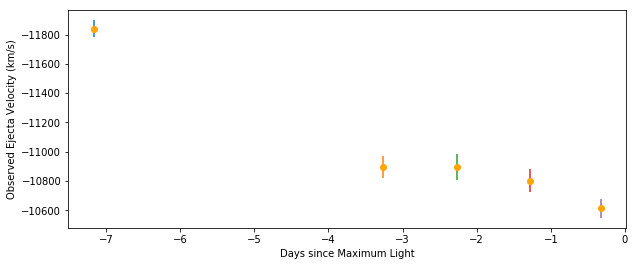

2001fe [u'sn2001fe-20011114.49-fast.flm', u'sn2001fe-20011116.51-fast.flm', u'sn2001fe-20011119.47-fast.flm', u'sn2001fe-20011122.48-fast.flm', u'sn2001fe-20011207.49-fast.flm', u'sn2001fe-20011214.48-fast.flm']


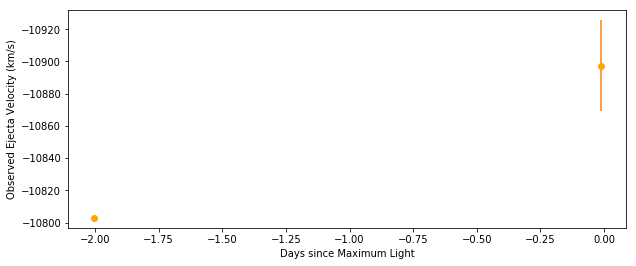

2001g [u'sn2001G-20010115.32-fast.flm', u'sn2001G-20010125.34-fast.flm', u'sn2001G-20010201.39-fast.flm', u'sn2001G-20010216.31-fast.flm']


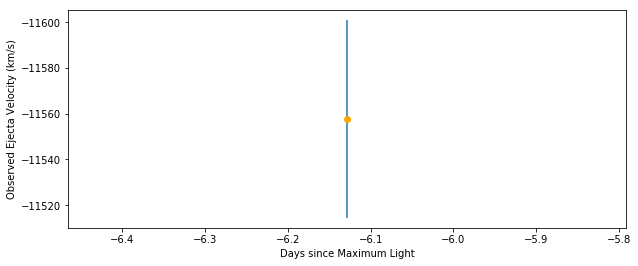

2001n [u'sn2001N-20010122.46-fast.flm', u'sn2001N-20010124.39-fast.flm', u'sn2001N-20010126.24-mmt.flm', u'sn2001N-20010131.40-fast.flm', u'sn2001N-20010201.37-fast.flm', u'sn2001N-20010217.39-fast.flm']


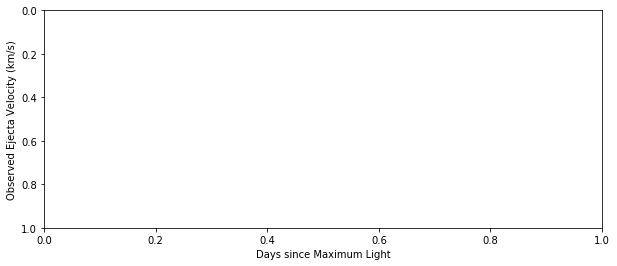

2001v [u'sn2001V-20010219.40-fast.flm', u'sn2001V-20010220.29-fast.flm', u'sn2001V-20010221.39-fast.flm', u'sn2001V-20010222.44-fast.flm', u'sn2001V-20010223.33-fast.flm', u'sn2001V-20010225.30-fast.flm', u'sn2001V-20010226.30-fast.flm', u'sn2001V-20010227.33-fast.flm', u'sn2001V-20010301.47-fast.flm', u'sn2001V-20010314.43-fast.flm', u'sn2001V-20010315.44-fast.flm', u'sn2001V-20010316.29-fast.flm', u'sn2001V-20010317.45-fast.flm', u'sn2001V-20010318.47-fast.flm', u'sn2001V-20010323.24-fast.flm', u'sn2001V-20010324.21-fast.flm', u'sn2001V-20010325.21-fast.flm', u'sn2001V-20010325.40-mmt.flm', u'sn2001V-20010326.24-fast.flm', u'sn2001V-20010326.47-mmt.flm', u'sn2001V-20010327.32-fast.flm', u'sn2001V-20010328.29-fast.flm', u'sn2001V-20010329.29-fast.flm', u'sn2001V-20010401.22-fast.flm', u'sn2001V-20010402.19-fast.flm']


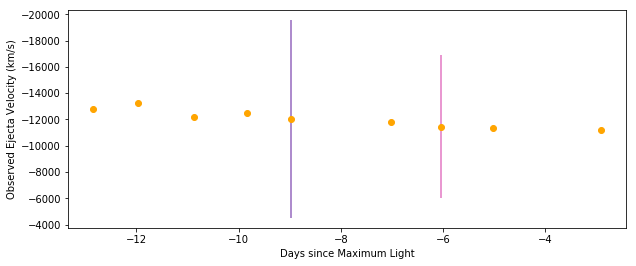

2002ck [u'sn2002ck-20020502.46-fast.flm', u'sn2002ck-20020503.34-fast.flm', u'sn2002ck-20020505.37-fast.flm', u'sn2002ck-20020507.38-fast.flm', u'sn2002ck-20020515.29-fast.flm', u'sn2002ck-20020519.24-fast.flm']


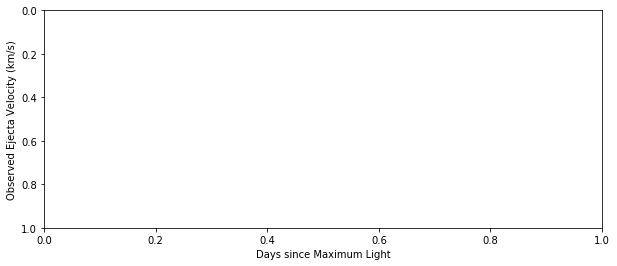

2002cr [u'sn2002cr-20020503.29-fast.flm', u'sn2002cr-20020506.25-fast.flm', u'sn2002cr-20020508.21-fast.flm', u'sn2002cr-20020512.19-fast.flm', u'sn2002cr-20020515.28-fast.flm', u'sn2002cr-20020519.18-fast.flm', u'sn2002cr-20020603.16-fast.flm']


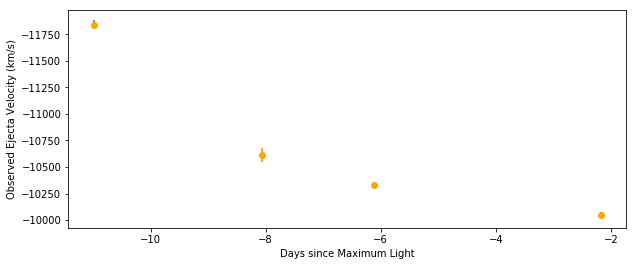

2002de [u'sn2002de-20020602.24-fast.flm', u'sn2002de-20020603.33-fast.flm', u'sn2002de-20020604.23-fast.flm', u'sn2002de-20020605.41-fast.flm', u'sn2002de-20020606.22-fast.flm', u'sn2002de-20020610.28-fast.flm', u'sn2002de-20020611.29-fast.flm', u'sn2002de-20020612.29-fast.flm', u'sn2002de-20020617.23-fast.flm', u'sn2002de-20020706.18-fast.flm']


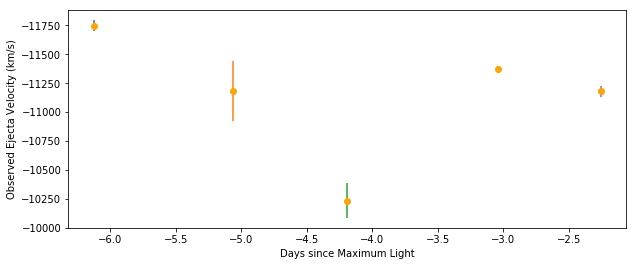

2002dj [u'sn2002dj-20020615.17-fast.flm', u'sn2002dj-20020617.17-fast.flm', u'sn2002dj-20020618.17-fast.flm', u'sn2002dj-20020619.18-fast.flm', u'sn2002dj-20020705.18-fast.flm', u'sn2002dj-20020712.17-fast.flm', u'2002dj_20020613_3256_9273_00.dat', u'2002dj_20020614_3745_9776_00.dat', u'2002dj_20020615_3307_9271_00.dat', u'2002dj_20020616_3343_9272_00.dat', u'2002dj_20020618_3256_9271_00.dat', u'2002dj_20020620_3210_9231_00.dat', u'2002dj_20020621_3255_9271_00.dat', u'2002dj_20020703_3397_9281_00.dat', u'2002dj_20020704_3340_10256_00.dat', u'2002dj_20020707_3201_9077_00.dat', u'2002dj_20020711_3304_10259_00.dat', u'2002dj_20020716_3300_9077_00.dat', u'2002dj_20020725_3741_10264_00.dat']


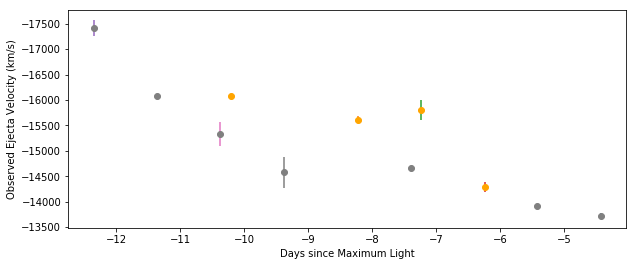

2002do [u'sn2002do-20020619.43-fast.flm', u'sn2002do-20020706.20-fast.flm', u'sn2002do-20020710.33-fast.flm']


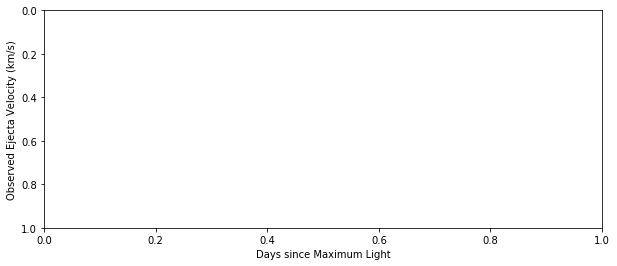

2002dp [u'sn2002dp-20020620.47-fast.flm', u'sn2002dp-20020702.45-fast.flm', u'sn2002dp-20020705.43-fast.flm', u'sn2002dp-20020708.44-fast.flm', u'sn2002dp-20020712.41-fast.flm', u'sn2002dp-20020718.47-fast.flm']


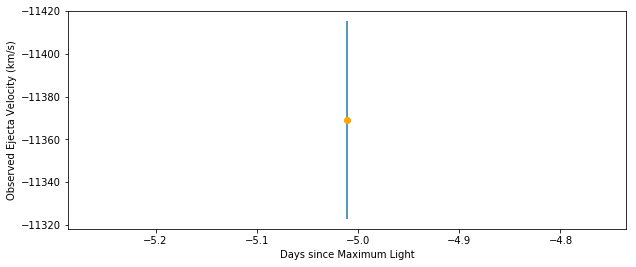

2002es [u'sn2002es-20020903.45-fast.flm', u'sn2002es-20020905.50-fast.flm', u'sn2002es-20020906.49-fast.flm', u'sn2002es-20020910.46-fast.flm', u'sn2002es-20020912.46-fast.flm']


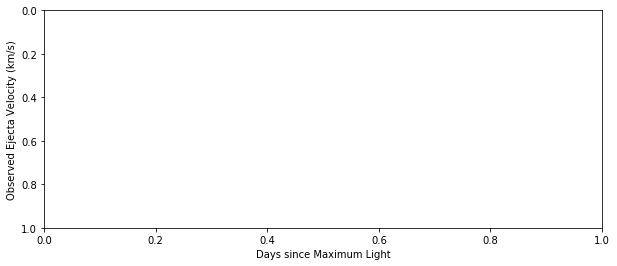

2002fb [u'sn2002fb-20020907.51-fast.flm', u'sn2002fb-20020909.43-fast.flm', u'sn2002fb-20020912.44-fast.flm', u'sn2002fb-20020929.42-fast.flm', u'sn2002fb-20021005.37-fast.flm', u'sn2002fb-20021009.34-fast.flm']


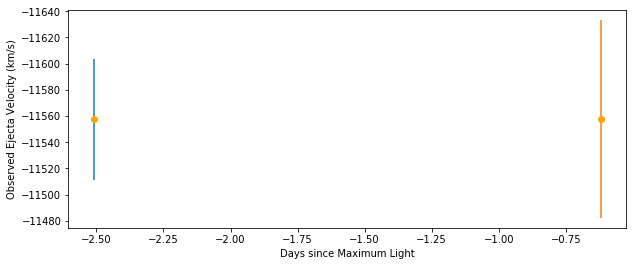

2002g [u'sn2002G-20020120.53-fast.flm', u'sn2002G-20020122.52-fast.flm']


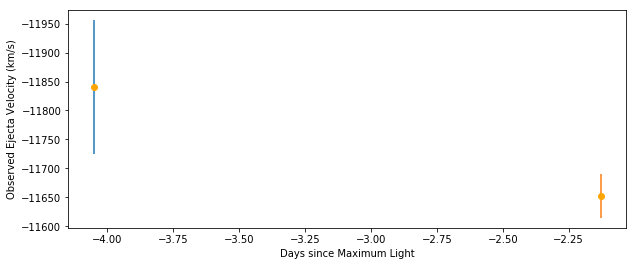

2002ha [u'sn2002ha-20021029.13-fast.flm', u'sn2002ha-20021104.11-mmt.flm', u'sn2002ha-20021108.09-fast.flm', u'sn2002ha-20021112.08-fast.flm']


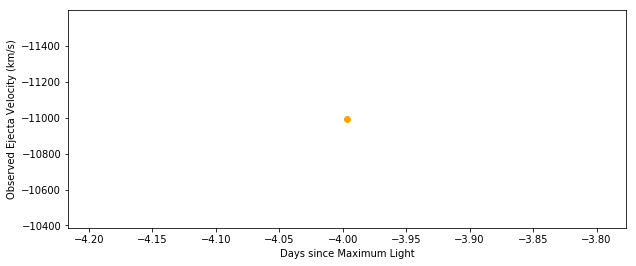

2002hd [u'sn2002hd-20021029.52-fast.flm', u'sn2002hd-20021109.51-fast.flm', u'sn2002hd-20021113.51-fast.flm']


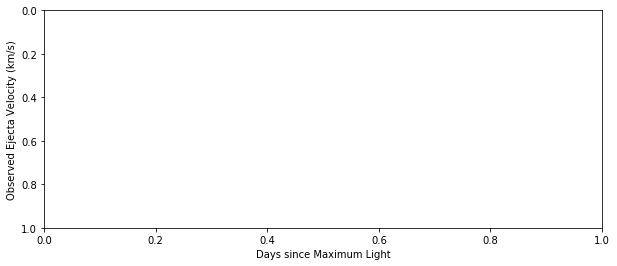

2002he [u'sn2002he-20021030.48-fast.flm', u'sn2002he-20021104.50-mmt.flm', u'sn2002he-20021111.52-fast.flm', u'sn2002he-20021113.53-fast.flm']


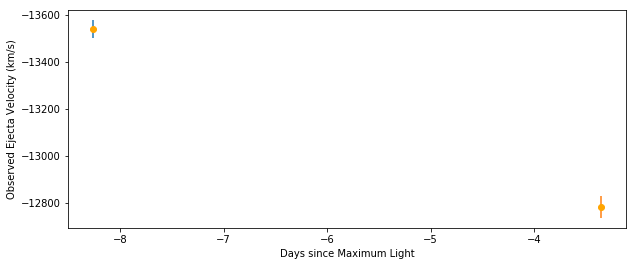

2002hu [u'sn2002hu-20021108.41-fast.flm', u'sn2002hu-20021110.31-fast.flm', u'sn2002hu-20021113.25-fast.flm', u'sn2002hu-20021206.29-fast.flm']


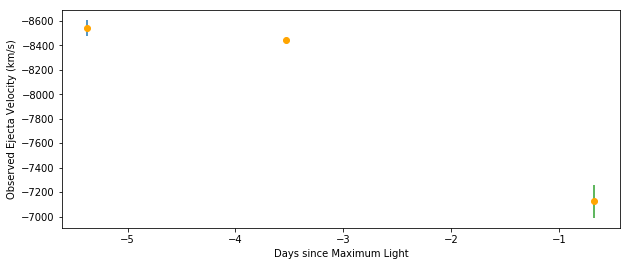

2002hw [u'sn2002hw-20021111.20-fast.flm', u'sn2002hw-20021112.10-fast.flm', u'sn2002hw-20021114.10-fast.flm', u'sn2002hw-20021205.12-fast.flm', u'sn2002hw-20021208.15-fast.flm']


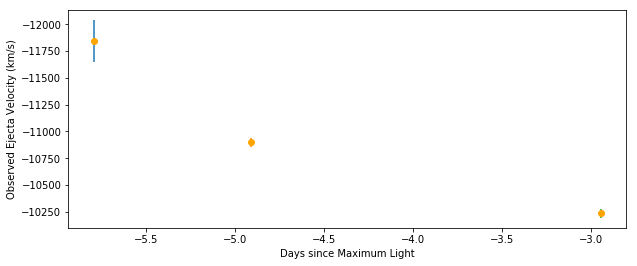

2002jy [u'sn2002jy-20021226.12-fast.flm', u'sn2002jy-20021227.11-fast.flm', u'sn2002jy-20021229.08-fast.flm', u'sn2002jy-20030101.10-fast.flm', u'sn2002jy-20030102.12-fast.flm', u'sn2002jy-20030103.12-fast.flm', u'sn2002jy-20030105.11-fast.flm', u'sn2002jy-20030111.08-fast.flm', u'sn2002jy-20030113.10-fast.flm']


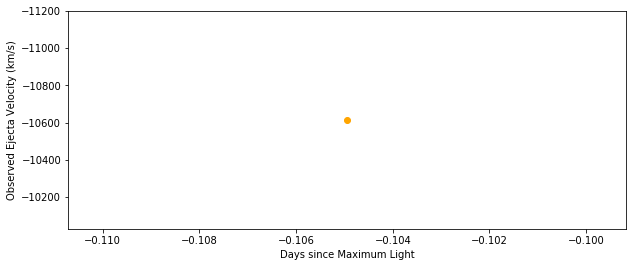

2002kf [u'sn2002kf-20021231.34-fast.flm', u'sn2002kf-20030101.39-fast.flm', u'sn2002kf-20030102.35-fast.flm', u'sn2002kf-20030103.31-fast.flm', u'sn2002kf-20030105.30-fast.flm', u'sn2002kf-20030107.30-fast.flm', u'sn2002kf-20030111.16-fast.flm', u'sn2002kf-20030113.31-fast.flm', u'sn2002kf-20030127.21-fast.flm', u'sn2002kf-20030129.21-fast.flm', u'sn2002kf-20030129.28-mmt.flm']


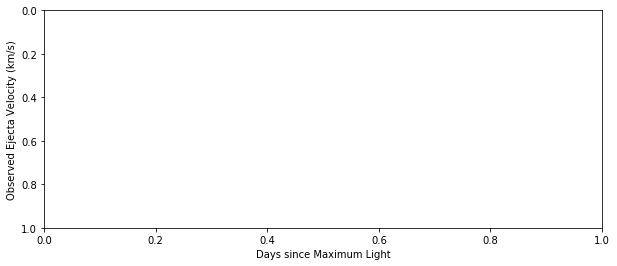

2003ch [u'sn2003ch-20030325.16-fast.flm', u'sn2003ch-20030327.13-fast.flm', u'sn2003ch-20030328.14-fast.flm', u'sn2003ch-20030329.11-mmt.flm', u'sn2003ch-20030329.17-fast.flm', u'sn2003ch-20030330.16-fast.flm', u'sn2003ch-20030331.15-fast.flm', u'sn2003ch-20030401.17-fast.flm', u'sn2003ch-20030402.03-ldss2.flm', u'sn2003ch-20030403.16-fast.flm', u'sn2003ch-20030410.17-fast.flm', u'sn2003ch-20030411.18-fast.flm']


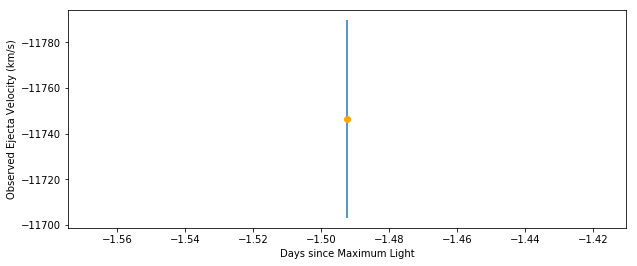

2003cq [u'sn2003cq-20030403.28-fast.flm', u'sn2003cq-20030407.36-fast.flm', u'sn2003cq-20030409.25-fast.flm', u'sn2003cq-20030410.22-fast.flm', u'sn2003cq-20030411.25-fast.flm', u'sn2003cq-20030427.22-fast.flm', u'sn2003cq-20030509.15-fast.flm']


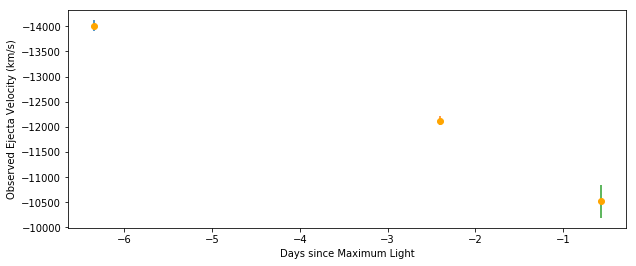

2003fa [u'sn2003fa-20030605.42-fast.flm', u'sn2003fa-20030606.36-fast.flm', u'sn2003fa-20030607.34-fast.flm', u'sn2003fa-20030608.29-fast.flm', u'sn2003fa-20030609.38-fast.flm', u'sn2003fa-20030610.34-mmt.flm', u'sn2003fa-20030623.33-fast.flm', u'sn2003fa-20030624.29-fast.flm', u'sn2003fa-20030625.30-fast.flm', u'sn2003fa-20030627.30-fast.flm', u'sn2003fa-20030628.23-fast.flm', u'sn2003fa-20030630.22-fast.flm', u'sn2003fa-20030701.39-fast.flm', u'sn2003fa-20030702.29-fast.flm', u'sn2003fa-20030703.38-fast.flm', u'sn2003fa-20030704.24-fast.flm', u'sn2003fa-20030704.46-mmt.flm', u'sn2003fa-20030705.41-mmt.flm', u'sn2003fa-20030706.28-fast.flm']


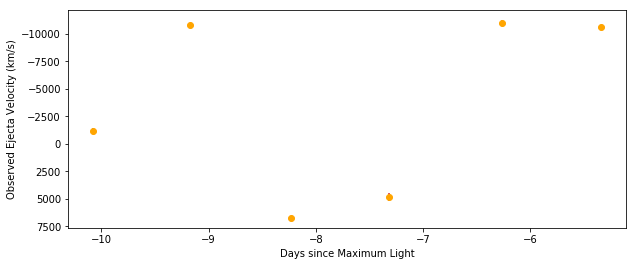

2003hu [u'sn2003hu-20030919.19-fast.flm', u'sn2003hu-20030921.16-fast.flm', u'sn2003hu-20030927.14-fast.flm', u'sn2003hu-20030928.12-fast.flm', u'sn2003hu-20030930.16-fast.flm']


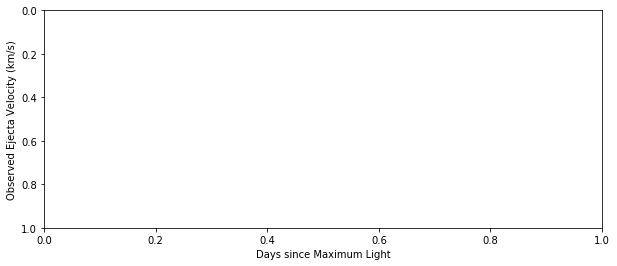

2003ic [u'sn2003ic-20030921.36-fast.flm', u'sn2003ic-20030928.30-fast.flm', u'sn2003ic-20031001.32-fast.flm', u'sn2003ic-20031017.23-fast.flm']


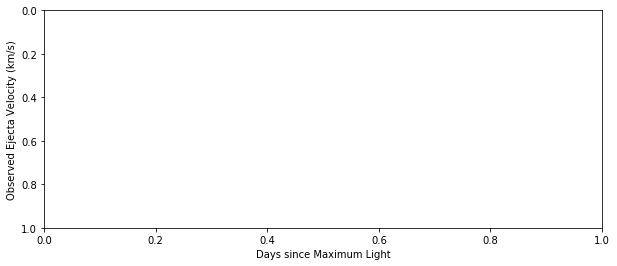

2003it [u'sn2003it-20031019.18-fast.flm', u'sn2003it-20031020.23-fast.flm', u'sn2003it-20031021.31-fast.flm', u'sn2003it-20031022.26-fast.flm', u'sn2003it-20031023.25-fast.flm', u'sn2003it-20031024.24-fast.flm', u'sn2003it-20031025.24-fast.flm', u'sn2003it-20031026.25-fast.flm', u'sn2003it-20031029.21-fast.flm', u'sn2003it-20031030.22-fast.flm', u'sn2003it-20031031.23-fast.flm', u'sn2003it-20031101.21-fast.flm']


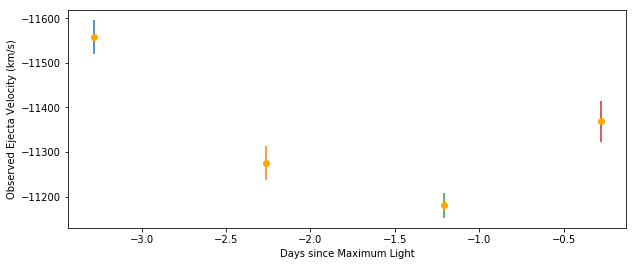

2003iv [u'sn2003iv-20031019.38-fast.flm', u'sn2003iv-20031020.40-fast.flm', u'sn2003iv-20031021.38-fast.flm', u'sn2003iv-20031022.38-fast.flm', u'sn2003iv-20031023.35-fast.flm', u'sn2003iv-20031025.37-fast.flm', u'sn2003iv-20031029.34-fast.flm']


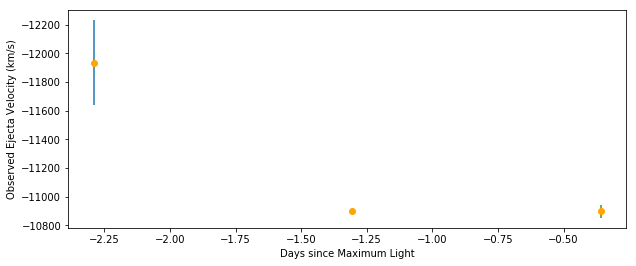

2003u [u'sn2003U-20030129.53-mmt.flm', u'sn2003U-20030201.55-fast.flm', u'sn2003U-20030206.55-fast.flm']


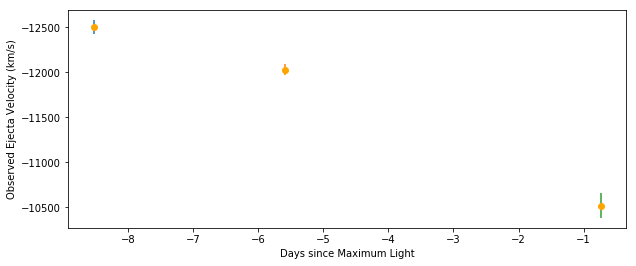

2003w [u'sn2003W-20030129.35-mmt.flm', u'sn2003W-20030130.31-fast.flm', u'sn2003W-20030131.39-fast.flm', u'sn2003W-20030201.35-fast.flm', u'sn2003W-20030202.30-fast.flm', u'sn2003W-20030203.33-fast.flm', u'sn2003W-20030204.27-fast.flm', u'sn2003W-20030206.32-fast.flm', u'sn2003W-20030207.40-fast.flm', u'sn2003W-20030209.35-fast.flm', u'sn2003W-20030210.35-fast.flm', u'sn2003W-20030303.37-fast.flm', u'sn2003W-20030307.28-fast.flm', u'sn2003W-20030310.28-fast.flm', u'sn2003W-20030312.27-fast.flm']


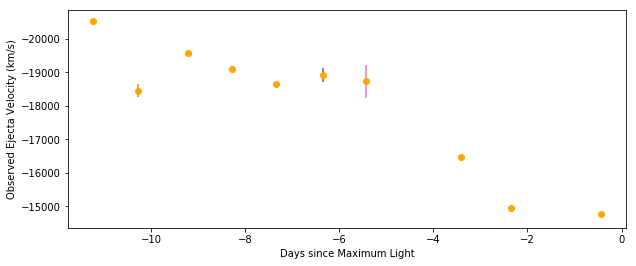

2004as [u'sn2004as-20040313.30-fast.flm', u'sn2004as-20040314.32-fast.flm', u'sn2004as-20040315.31-fast.flm', u'sn2004as-20040316.35-fast.flm', u'sn2004as-20040317.39-fast.flm', u'sn2004as-20040318.36-fast.flm', u'sn2004as-20040319.28-fast.flm', u'sn2004as-20040320.38-fast.flm', u'sn2004as-20040321.27-fast.flm', u'sn2004as-20040323.26-fast.flm', u'sn2004as-20040324.34-fast.flm', u'sn2004as-20040327.35-fast.flm', u'sn2004as-20040328.22-fast.flm', u'sn2004as-20040329.23-fast.flm', u'sn2004as-20040330.24-fast.flm', u'sn2004as-20040416.27-fast.flm', u'sn2004as-20040419.26-fast.flm']


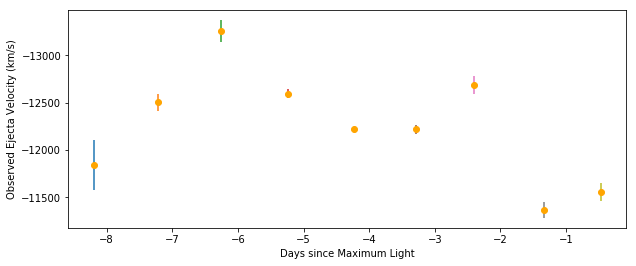

2004bg [u'sn2004bg-20040411.39-fast.flm', u'sn2004bg-20040417.19-fast.flm', u'sn2004bg-20040420.33-fast.flm', u'sn2004bg-20040425.25-fast.flm', u'sn2004bg-20040427.28-fast.flm']


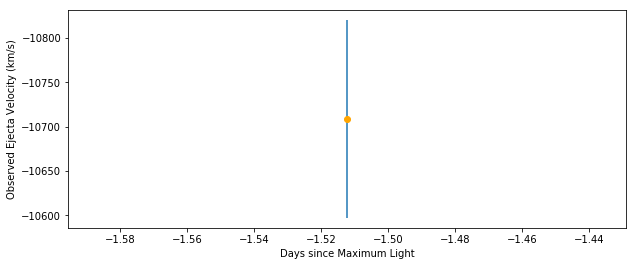

2004gs [u'sn2004gs-20041213.44-fast.flm', u'sn2004gs-20041215.48-fast.flm', u'sn2004gs-20041216.49-fast.flm', u'sn2004gs-20041218.46-fast.flm', u'sn2004gs-20041219.42-fast.flm', u'sn2004gs-20041220.44-fast.flm', u'sn2004gs-20050106.40-fast.flm', u'sn2004gs-20050109.38-fast.flm', u'SN04gs_041213_b01_DUP_WF.dat', u'SN04gs_041219_b01_CLA_LD.dat']


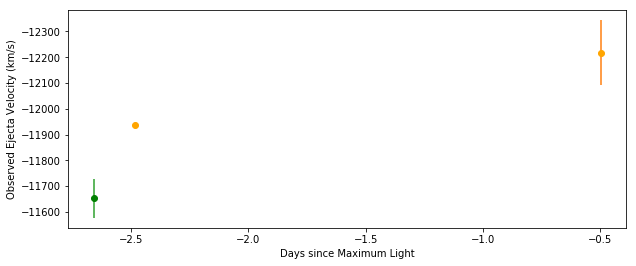

2004l [u'sn2004L-20040127.40-fast.flm', u'sn2004L-20040128.37-fast.flm', u'sn2004L-20040130.33-fast.flm', u'sn2004L-20040214.46-fast.flm', u'sn2004L-20040216.35-fast.flm', u'sn2004L-20040217.35-fast.flm', u'sn2004L-20040218.33-fast.flm', u'sn2004L-20040220.29-fast.flm', u'sn2004L-20040221.36-fast.flm', u'sn2004L-20040222.30-fast.flm']


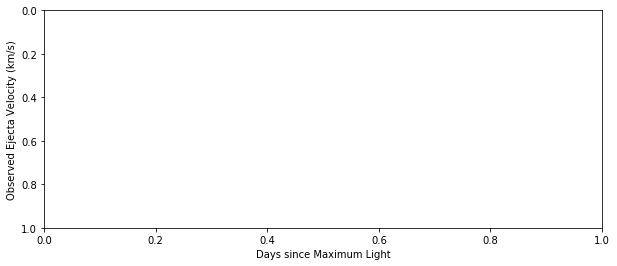

2005bo [u'sn2005bo-20050418.21-fast.flm', u'sn2005bo-20050510.29-fast.flm', u'SN05bo_050418_b01_DUP_WF.dat', u'SN05bo_050419_b01_DUP_WF.dat']


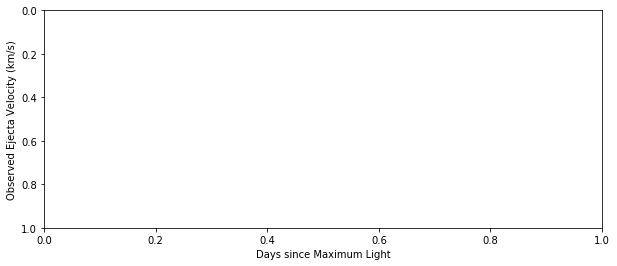

2005el [u'sn2005el-20050927.47-fast.flm', u'sn2005el-20050928.47-fast.flm', u'sn2005el-20050929.48-fast.flm', u'sn2005el-20051005.49-fast.flm', u'sn2005el-20051007.48-fast.flm', u'sn2005el-20051026.50-fast.flm', u'SN05el_050926_b01_DUP_WF.dat', u'SN05el_050927_b01_DUP_WF.dat', u'SN05el_051005_b01_DUP_WF.dat', u'SN05el_051018_g01_NTT_EM.dat']


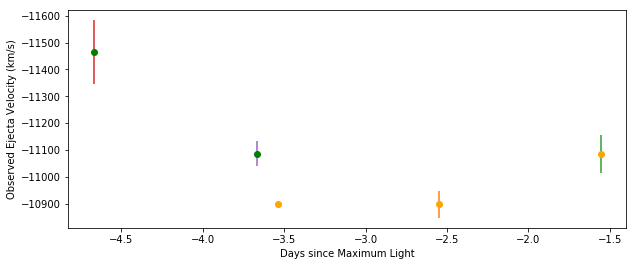

2005eq [u'sn2005eq-20051002.51-fast.flm', u'sn2005eq-20051005.41-fast.flm', u'sn2005eq-20051007.40-fast.flm', u'sn2005eq-20051009.42-fast.flm', u'sn2005eq-20051011.39-fast.flm', u'sn2005eq-20051012.33-fast.flm', u'sn2005eq-20051025.38-fast.flm', u'sn2005eq-20051028.34-fast.flm', u'sn2005eq-20051107.38-fast.flm', u'SN05eq_051005_b01_DUP_WF.dat', u'SN05eq_051018_g01_NTT_EM.dat']


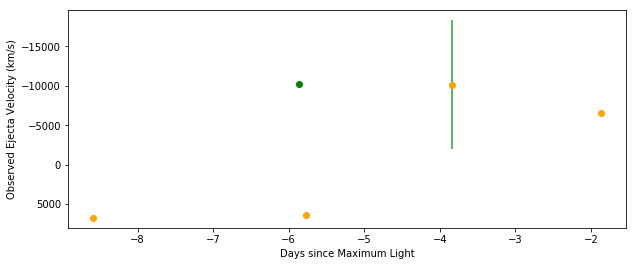

2005eu [u'sn2005eu-20051007.38-fast.flm', u'sn2005eu-20051009.38-fast.flm', u'sn2005eu-20051011.37-fast.flm', u'sn2005eu-20051025.29-fast.flm', u'sn2005eu-20051027.36-fast.flm', u'sn2005eu-20051109.30-fast.flm']


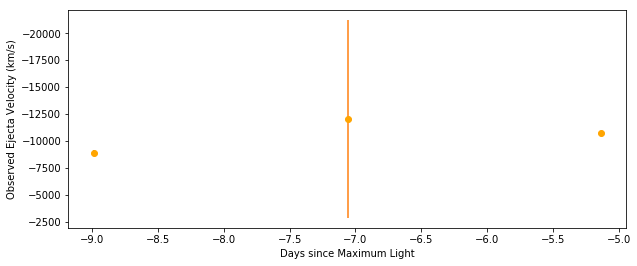

2005hc [u'sn2005hc-20051030.32-fast.flm', u'sn2005hc-20051031.29-fast.flm', u'sn2005hc-20051105.31-fast.flm', u'SN05hc_051018_g01_NTT_EM.dat', u'SN05hc_051022_b01_MGH_BC.dat', u'SN05hc_051024_b01_MGH_BC.dat']


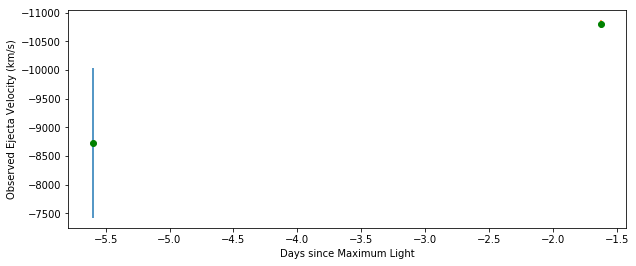

2005hf [u'sn2005hf-20051103.26-fast.flm']


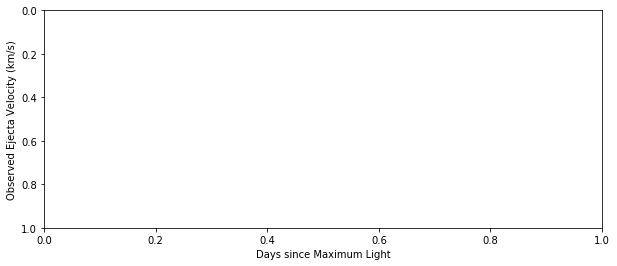

2005iq [u'sn2005iq-20051107.21-fast.flm', u'SN05iq_051124_b01_DUP_MS.dat']


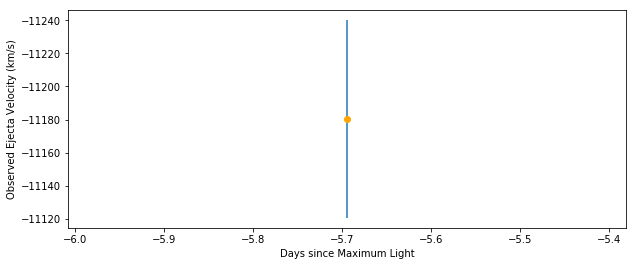

2005kc [u'sn2005kc-20051130.11-fast.flm', u'sn2005kc-20051203.17-fast.flm', u'sn2005kc-20051205.09-fast.flm', u'sn2005kc-20051209.08-fast.flm', u'sn2005kc-20051223.08-fast.flm', u'SN05kc_051124_b01_DUP_MS.dat', u'SN05kc_051125_b01_DUP_MS.dat', u'SN05kc_051222_b01_DUP_WF.dat']


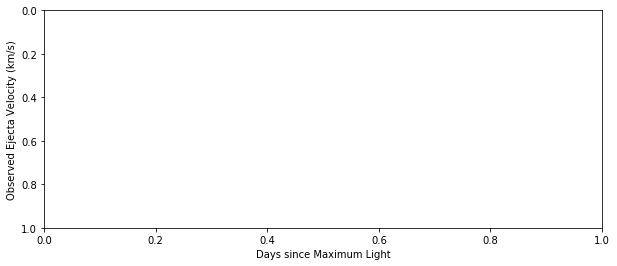

2005ki [u'sn2005ki-20051202.52-fast.flm', u'SN05ki_051123_b01_DUP_MS.dat', u'SN05ki_051125_b01_DUP_MS.dat', u'SN05ki_051222_b01_DUP_WF.dat']


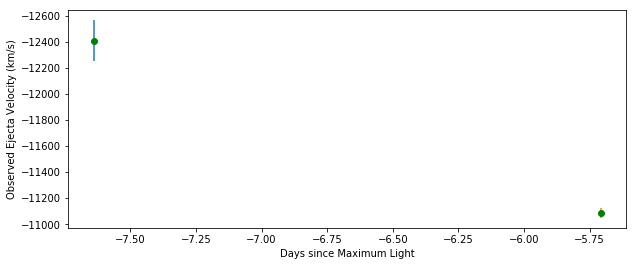

2005ls [u'sn2005ls-20051221.22-fast.flm', u'sn2005ls-20051227.20-fast.flm']


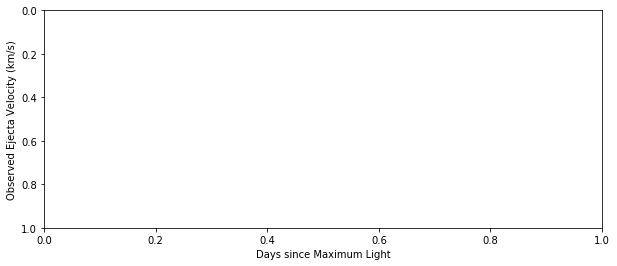

2005lz [u'sn2005lz-20051227.29-fast.flm']


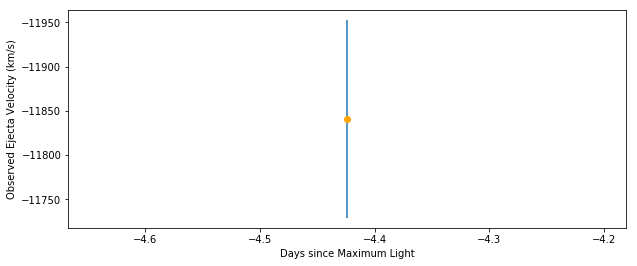

2005mc [u'sn2005mc-20051227.37-fast.flm', u'sn2005mc-20060104.38-fast.flm']


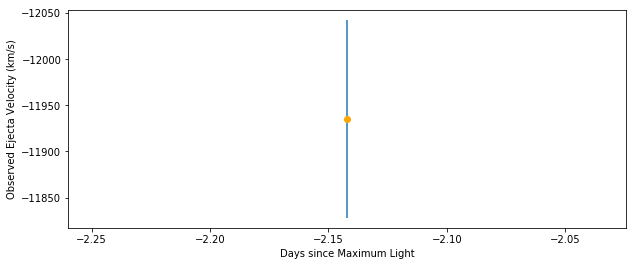

2005mz [u'sn2005mz-20060103.13-fast.flm', u'sn2005mz-20060123.15-fast.flm', u'sn2005mz-20060201.15-fast.flm']


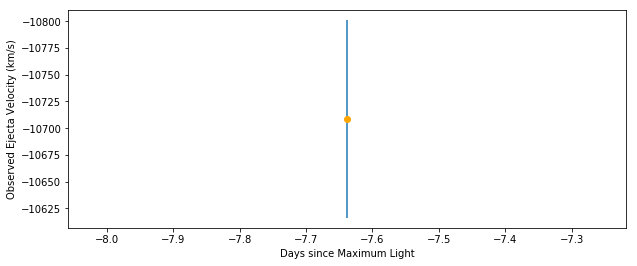

2005na [u'sn2005na-20060104.34-fast.flm', u'sn2005na-20060107.32-fast.flm', u'sn2005na-20060109.43-fast.flm', u'sn2005na-20060122.27-fast.flm', u'sn2005na-20060126.39-fast.flm', u'sn2005na-20060130.24-fast.flm', u'SN05na_060116_g01_NTT_EM.dat', u'SN05na_060124_g01_CLA_LD.dat']


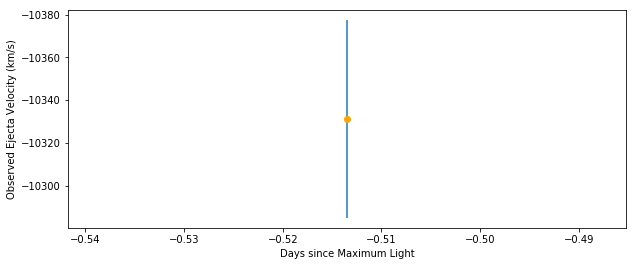

2006ac [u'sn2006ac-20060221.43-fast.flm', u'sn2006ac-20060222.43-fast.flm', u'sn2006ac-20060224.37-fast.flm', u'sn2006ac-20060225.38-fast.flm', u'sn2006ac-20060226.34-fast.flm', u'sn2006ac-20060228.36-fast.flm', u'sn2006ac-20060302.48-fast.flm', u'sn2006ac-20060304.54-fast.flm', u'sn2006ac-20060305.48-fast.flm', u'sn2006ac-20060309.33-fast.flm']


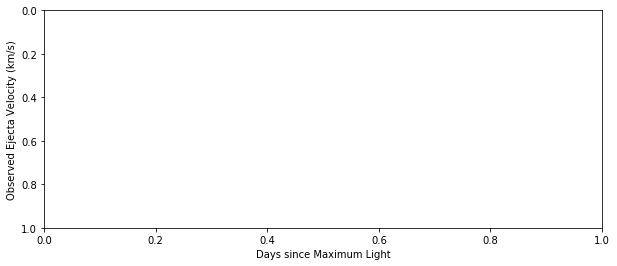

2006ak [u'sn2006ak-20060221.33-fast.flm']


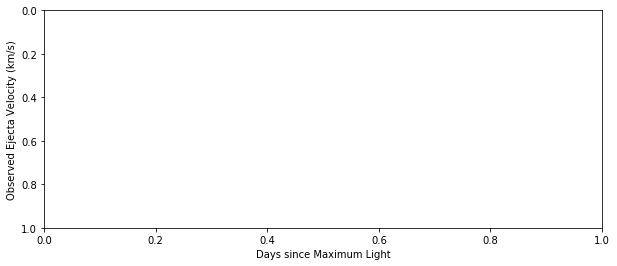

2006al [u'sn2006al-20060224.34-fast.flm', u'sn2006al-20060225.32-fast.flm', u'sn2006al-20060226.29-fast.flm', u'sn2006al-20060227.42-fast.flm', u'sn2006al-20060228.38-fast.flm', u'sn2006al-20060303.35-fast.flm']


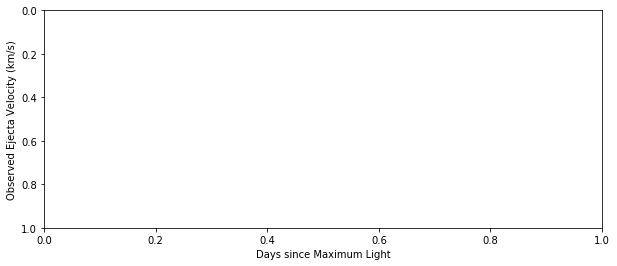

2006ax [u'sn2006ax-20060323.31-fast.flm', u'sn2006ax-20060324.30-fast.flm', u'sn2006ax-20060326.29-fast.flm', u'sn2006ax-20060402.30-fast.flm', u'SN06ax_060322_b01_DUP_WF.dat', u'SN06ax_060323_b01_DUP_WF.dat', u'SN06ax_060324_b01_DUP_WF.dat', u'SN06ax_060330_b01_DUP_WF.dat', u'SN06ax_060331_b01_DUP_WF.dat', u'SN06ax_060402_b01_DUP_WF.dat', u'SN06ax_060416_b01_BAA_IM.dat', u'SN06ax_060421_b01_DUP_WF.dat']


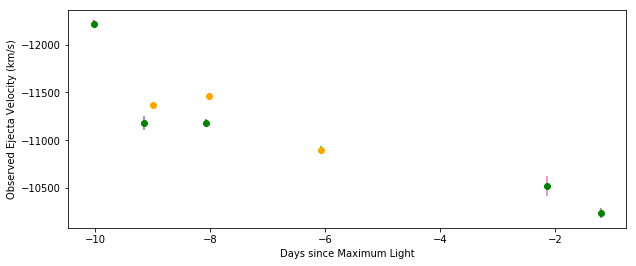

2006az [u'sn2006az-20060331.37-fast.flm', u'sn2006az-20060403.30-fast.flm']


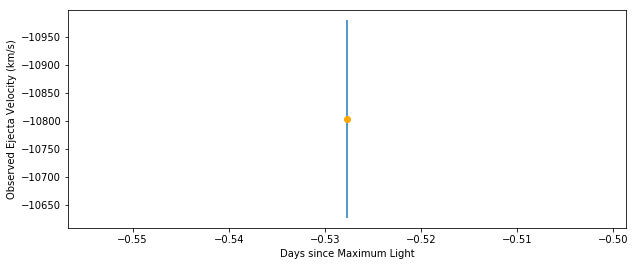

2006bq [u'sn2006bq-20060427.35-fast.flm']


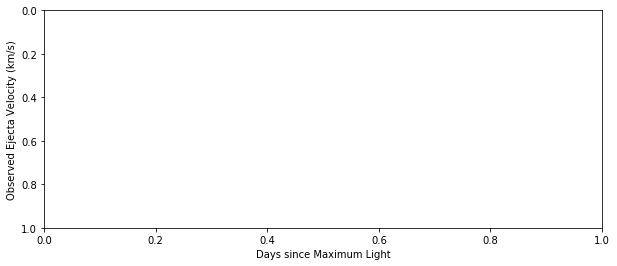

2006bt [u'sn2006bt-20060429.41-fast.flm', u'sn2006bt-20060501.39-fast.flm', u'sn2006bt-20060504.35-fast.flm', u'sn2006bt-20060505.27-fast.flm', u'sn2006bt-20060507.30-fast.flm', u'sn2006bt-20060508.31-fast.flm', u'sn2006bt-20060519.28-fast.flm']


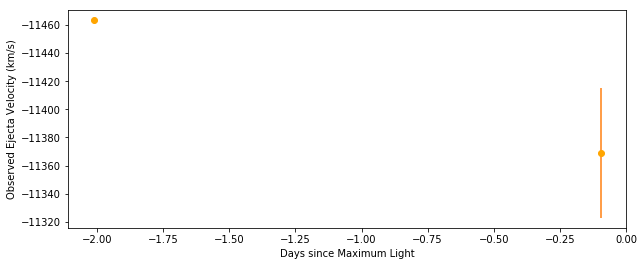

2006bu [u'sn2006bu-20060505.19-fast.flm']


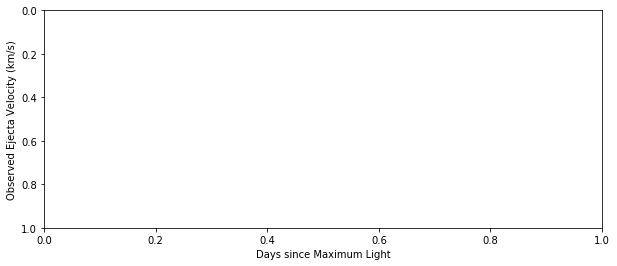

2006bw [u'sn2006bw-20060502.31-fast.flm']


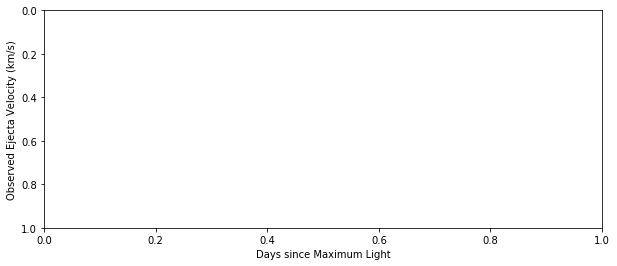

2006bz [u'sn2006bz-20060506.16-fast.flm', u'sn2006bz-20060507.22-fast.flm', u'sn2006bz-20060508.23-fast.flm']


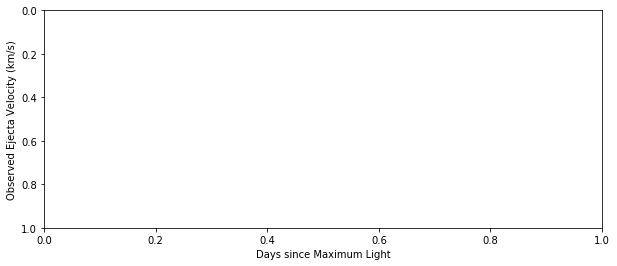

2006cc [u'sn2006cc-20060508.34-fast.flm']


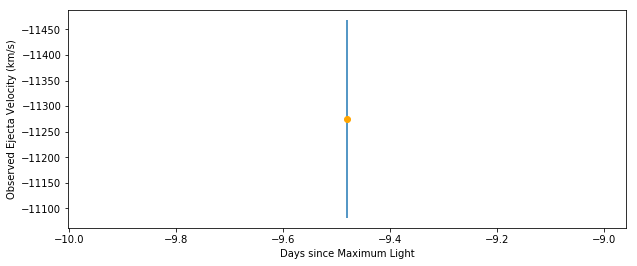

2006cf [u'sn2006cf-20060519.25-fast.flm', u'sn2006cf-20060520.16-fast.flm', u'sn2006cf-20060521.27-fast.flm', u'sn2006cf-20060522.26-fast.flm', u'sn2006cf-20060524.21-fast.flm', u'sn2006cf-20060604.22-fast.flm']


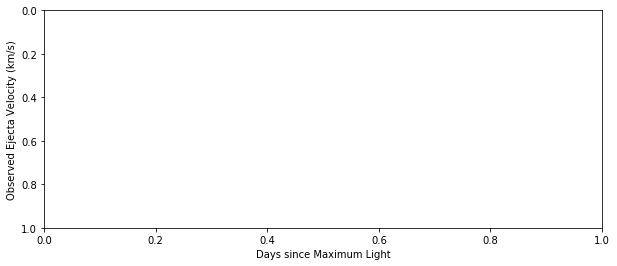

2006cj [u'sn2006cj-20060522.29-fast.flm', u'sn2006cj-20060523.33-fast.flm', u'sn2006cj-20060528.19-fast.flm', u'sn2006cj-20060601.28-fast.flm', u'sn2006cj-20060602.21-fast.flm', u'sn2006cj-20060604.27-fast.flm']


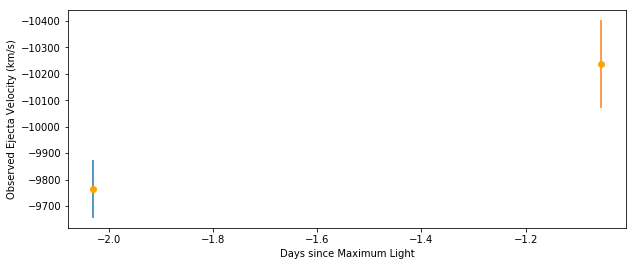

2006cp [u'sn2006cp-20060530.25-fast.flm', u'sn2006cp-20060531.25-fast.flm', u'sn2006cp-20060601.26-fast.flm', u'sn2006cp-20060602.16-fast.flm', u'sn2006cp-20060604.24-fast.flm', u'sn2006cp-20060617.21-fast.flm', u'sn2006cp-20060618.21-fast.flm', u'sn2006cp-20060620.19-fast.flm']


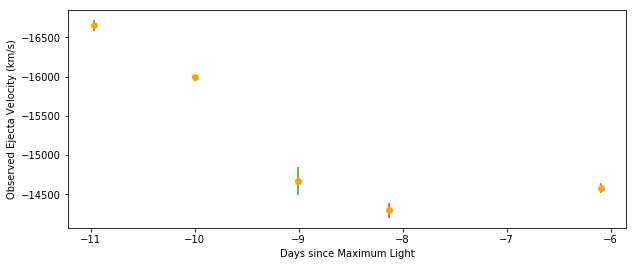

2006cq [u'sn2006cq-20060531.27-fast.flm']


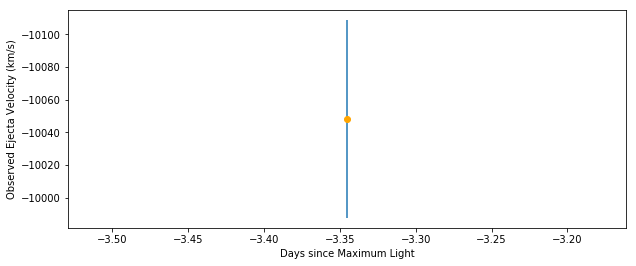

2006em [u'sn2006em-20060902.41-fast.flm']


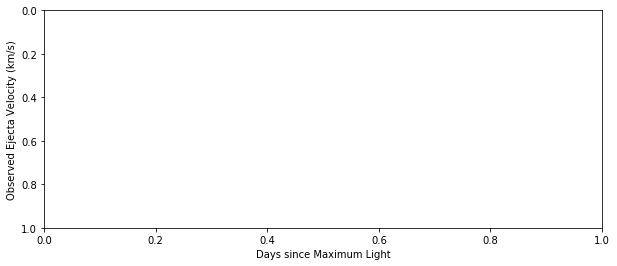

2006et [u'sn2006et-20060918.36-fast.flm', u'sn2006et-20060922.37-fast.flm', u'SN06et_060925_b01_DUP_WF.dat', u'SN06et_060926_b01_DUP_WF.dat', u'SN06et_061005_g01_NTT_EM.dat', u'SN06et_061011_b01_DUP_WF.dat']


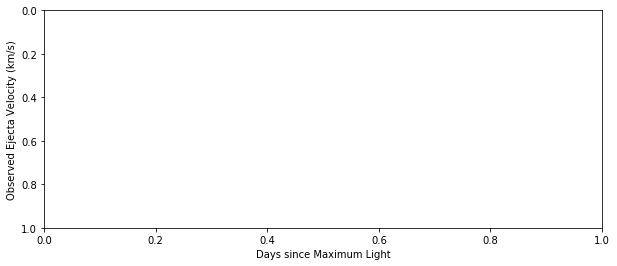

2006gj [u'sn2006gj-20060920.43-fast.flm', u'sn2006gj-20060924.46-fast.flm', u'SN06gj_060925_b01_DUP_WF.dat', u'SN06gj_060927_b01_DUP_WF.dat', u'SN06gj_060928_b01_DUP_WF.dat', u'SN06gj_061005_g01_NTT_EM.dat', u'SN06gj_061007_b01_HIL_BC.dat', u'SN06gj_061011_b01_DUP_WF.dat', u'SN06gj_061016_b01_HIL_BC.dat']


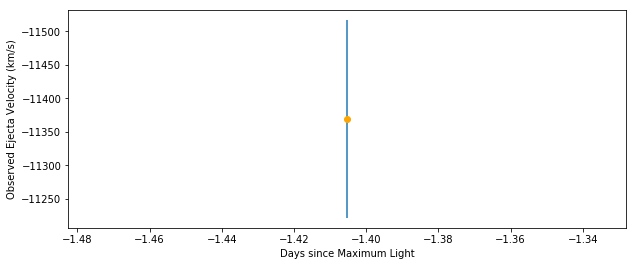

2006gr [u'sn2006gr-20060923.22-fast.flm', u'sn2006gr-20060924.26-fast.flm', u'sn2006gr-20060925.23-fast.flm', u'sn2006gr-20060926.25-fast.flm', u'sn2006gr-20060927.30-fast.flm', u'sn2006gr-20060928.18-fast.flm', u'sn2006gr-20060929.13-fast.flm', u'sn2006gr-20060930.30-fast.flm', u'sn2006gr-20061002.26-fast.flm', u'sn2006gr-20061003.26-fast.flm', u'sn2006gr-20061014.14-fast.flm', u'sn2006gr-20061017.24-fast.flm', u'sn2006gr-20061023.18-fast.flm', u'sn2006gr-20061028.16-fast.flm', u'sn2006gr-20061029.23-fast.flm']


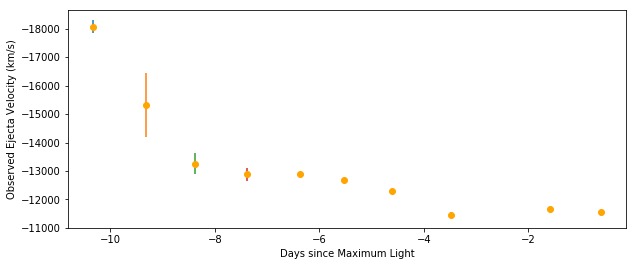

2006gt [u'sn2006gt-20060925.36-fast.flm', u'sn2006gt-20060926.38-fast.flm', u'sn2006gt-20060927.37-fast.flm', u'SN06gt_060925_b01_DUP_WF.dat', u'SN06gt_060927_b01_DUP_WF.dat', u'SN06gt_060928_b01_DUP_WF.dat', u'SN06gt_061010_b01_DUP_WF.dat']


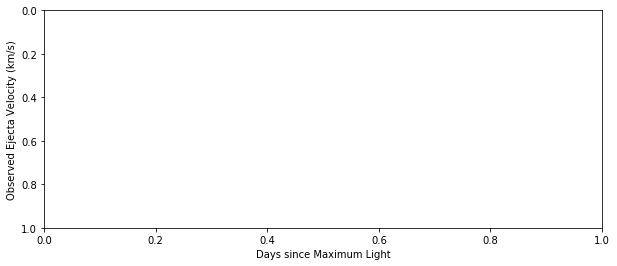

2006hb [u'sn2006hb-20060928.51-fast.flm', u'sn2006hb-20060929.51-fast.flm', u'sn2006hb-20060930.50-fast.flm', u'sn2006hb-20061001.52-fast.flm', u'sn2006hb-20061002.47-fast.flm', u'sn2006hb-20061003.51-fast.flm', u'SN06hb_060928_b01_DUP_WF.dat', u'SN06hb_061005_g01_NTT_EM.dat', u'SN06hb_061007_b01_HIL_BC.dat', u'SN06hb_061010_b01_DUP_WF.dat']


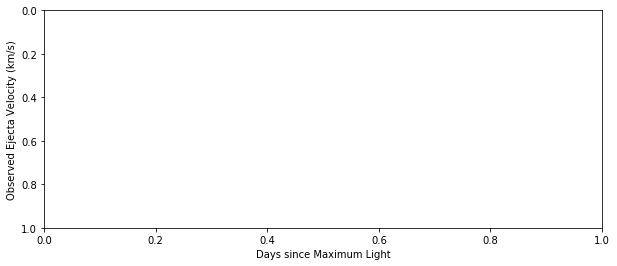

2006kf [u'sn2006kf-20061027.39-fast.flm', u'SN06kf_061027_b01_DUP_WF.dat', u'SN06kf_061103_b01_HIL_BC.dat', u'SN06kf_061103_g01_NTT_EM.dat', u'SN06kf_061116_b01_DUP_WF.dat', u'SN06kf_061117_b01_HIL_BC.dat', u'SN06kf_061130_b01_HIL_BC.dat']


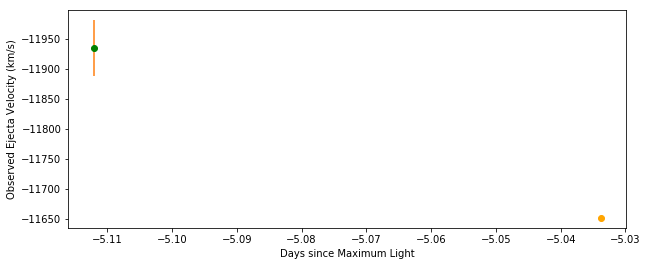

2006le [u'sn2006le-20061030.43-fast.flm', u'sn2006le-20061031.45-fast.flm', u'sn2006le-20061101.43-fast.flm', u'sn2006le-20061112.40-fast.flm', u'sn2006le-20061114.38-fast.flm', u'sn2006le-20061115.44-fast.flm', u'sn2006le-20061116.42-fast.flm', u'sn2006le-20061117.44-fast.flm', u'sn2006le-20061119.40-fast.flm', u'sn2006le-20061121.37-fast.flm', u'sn2006le-20061122.38-fast.flm', u'sn2006le-20061123.36-fast.flm', u'sn2006le-20061125.36-fast.flm']


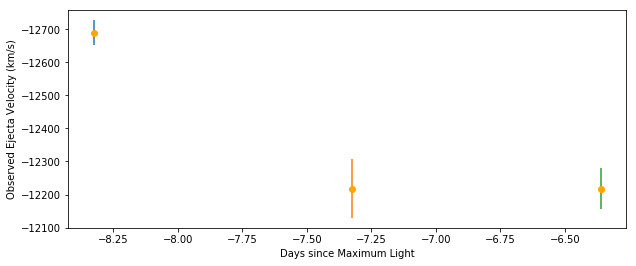

2006mo [u'sn2006mo-20061113.21-fast.flm']


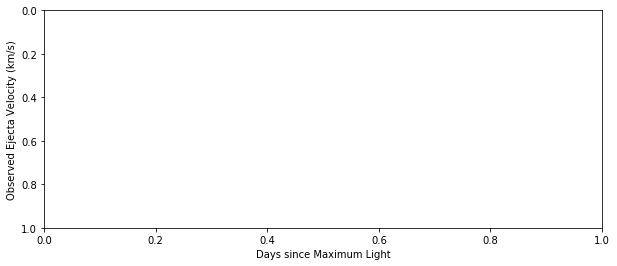

2006n [u'sn2006N-20060122.23-fast.flm', u'sn2006N-20060124.26-fast.flm', u'sn2006N-20060126.32-fast.flm', u'sn2006N-20060127.24-fast.flm', u'sn2006N-20060128.22-fast.flm', u'sn2006N-20060130.22-fast.flm', u'sn2006N-20060131.22-fast.flm', u'sn2006N-20060201.21-fast.flm', u'sn2006N-20060202.20-fast.flm', u'sn2006N-20060203.21-fast.flm', u'sn2006N-20060206.32-fast.flm', u'sn2006N-20060223.18-fast.flm']


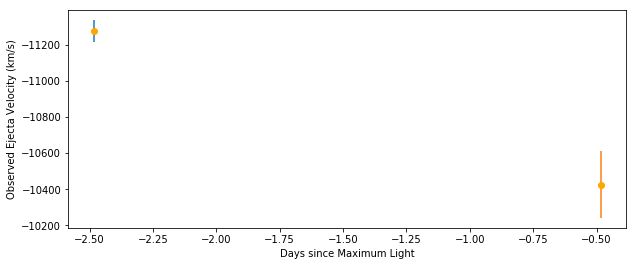

2006oa [u'sn2006oa-20061118.16-fast.flm', u'sn2006oa-20061119.16-fast.flm', u'sn2006oa-20061121.09-fast.flm', u'sn2006oa-20061122.16-fast.flm', u'sn2006oa-20061123.13-fast.flm', u'sn2006oa-20061125.08-fast.flm', u'sn2006oa-20061127.10-fast.flm']


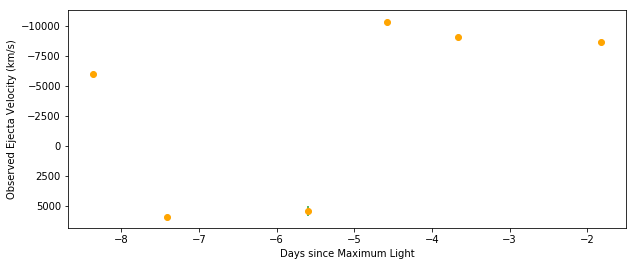

2006s [u'sn2006S-20060128.50-fast.flm', u'sn2006S-20060129.51-fast.flm', u'sn2006S-20060131.49-fast.flm', u'sn2006S-20060202.47-fast.flm', u'sn2006S-20060203.47-fast.flm', u'sn2006S-20060204.47-fast.flm', u'sn2006S-20060206.48-fast.flm', u'sn2006S-20060207.43-mmt.flm', u'sn2006S-20060224.39-fast.flm']


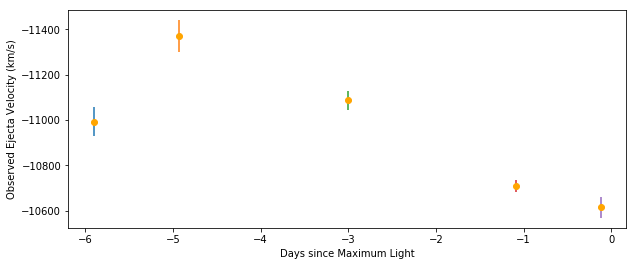

2006sr [u'sn2006sr-20061222.12-fast.flm', u'sn2006sr-20061224.09-fast.flm', u'sn2006sr-20061225.12-fast.flm', u'sn2006sr-20061226.13-fast.flm', u'sn2006sr-20061227.09-fast.flm', u'sn2006sr-20070110.12-fast.flm']


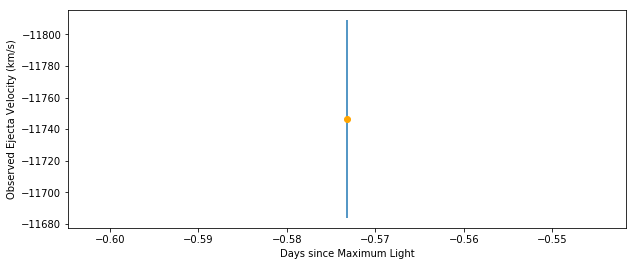

2006te [u'sn2006te-20070109.49-fast.flm']


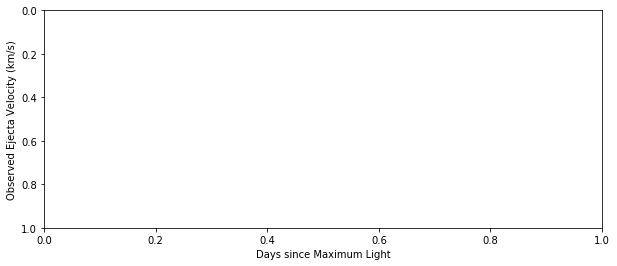

2007ae [u'sn2007ae-20070225.54-fast.flm', u'sn2007ae-20070226.53-fast.flm']


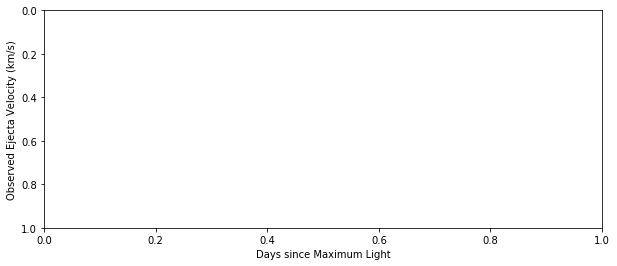

2007al [u'sn2007al-20070312.31-fast.flm', u'sn2007al-20070313.23-fast.flm', u'sn2007al-20070314.26-fast.flm', u'sn2007al-20070315.23-fast.flm', u'sn2007al-20070318.25-fast.flm', u'sn2007al-20070320.24-fast.flm', u'SN07al_070313_g01_BAA_IM.dat']


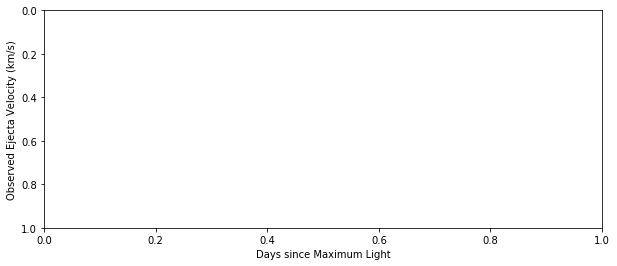

2007ap [u'sn2007ap-20070315.45-fast.flm', u'sn2007ap-20070319.46-fast.flm']


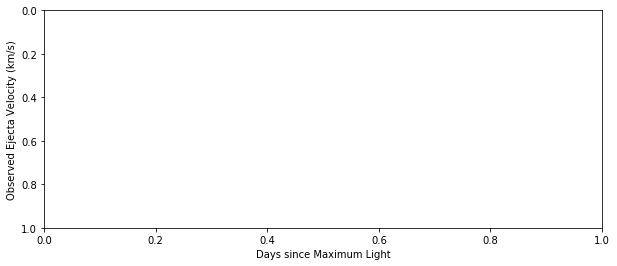

2007au [u'sn2007au-20070319.26-fast.flm', u'sn2007au-20070320.20-fast.flm', u'sn2007au-20070321.14-fast.flm', u'sn2007au-20070326.15-fast.flm']


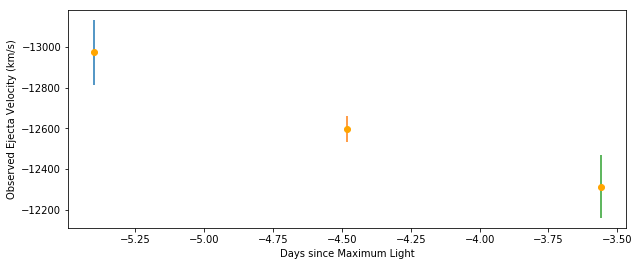

2007ba [u'sn2007ba-20070409.43-fast.flm', u'sn2007ba-20070411.50-fast.flm', u'sn2007ba-20070412.47-fast.flm', u'SN07ba_070409_b01_BAA_IM.dat', u'SN07ba_070412_b01_DUP_WF.dat']


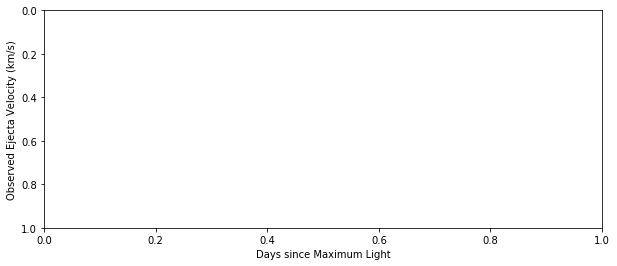

2007bc [u'sn2007bc-20070407.24-fast.flm', u'sn2007bc-20070414.27-fast.flm', u'sn2007bc-20070416.21-fast.flm', u'sn2007bc-20070417.36-fast.flm', u'SN07bc_070409_b01_BAA_IM.dat', u'SN07bc_070412_b01_DUP_WF.dat', u'SN07bc_070417_b01_DUP_WF.dat']


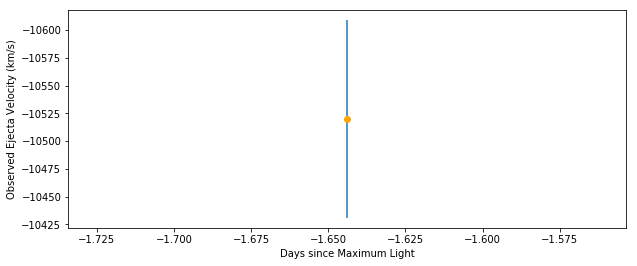

2007bd [u'sn2007bd-20070407.18-fast.flm', u'sn2007bd-20070408.18-fast.flm', u'sn2007bd-20070412.18-fast.flm', u'sn2007bd-20070415.20-fast.flm', u'sn2007bd-20070418.22-fast.flm', u'sn2007bd-20070425.17-fast.flm', u'SN07bd_070409_b01_BAA_IM.dat', u'SN07bd_070412_b01_DUP_WF.dat', u'SN07bd_070417_b01_DUP_WF.dat', u'SN07bd_070430_b01_DUP_BC.dat']


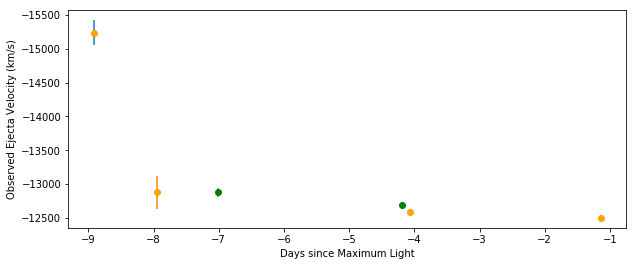

2007bz [u'sn2007bz-20070512.31-fast.flm']


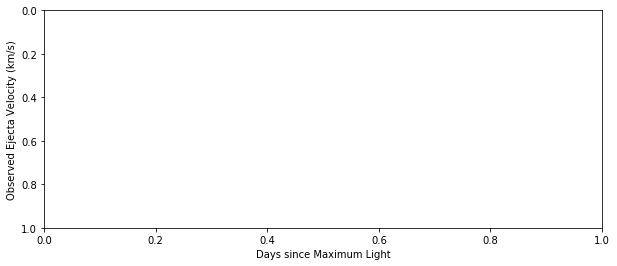

2007ca [u'sn2007ca-20070510.23-fast.flm', u'sn2007ca-20070512.27-fast.flm', u'sn2007ca-20070513.21-fast.flm', u'sn2007ca-20070516.26-fast.flm', u'sn2007ca-20070518.32-fast.flm', u'sn2007ca-20070520.22-fast.flm', u'SN07ca_070508_b01_BAA_IM.dat', u'SN07ca_070511_b01_DUP_BC.dat']


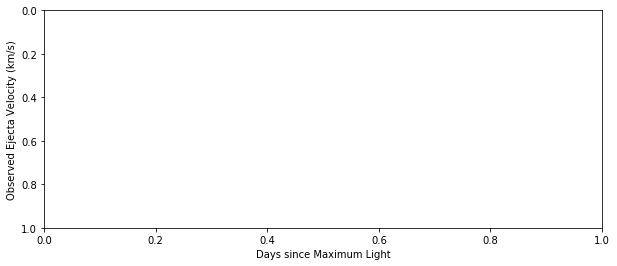

2007cg [u'sn2007cg-20070514.24-fast.flm', u'sn2007cg-20070515.22-fast.flm', u'sn2007cg-20070516.24-fast.flm']


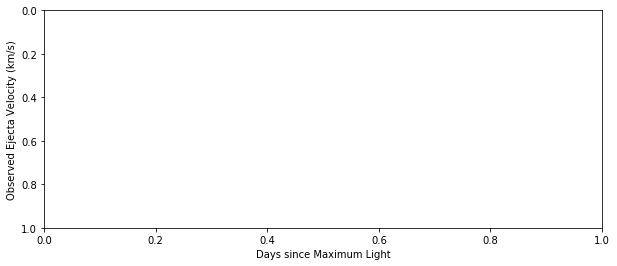

2007ci [u'sn2007ci-20070518.20-fast.flm', u'sn2007ci-20070519.18-fast.flm', u'sn2007ci-20070520.20-fast.flm', u'sn2007ci-20070521.19-fast.flm', u'sn2007ci-20070522.19-fast.flm', u'sn2007ci-20070524.19-fast.flm', u'sn2007ci-20070525.19-fast.flm', u'sn2007ci-20070608.18-fast.flm', u'sn2007ci-20070612.19-fast.flm', u'sn2007ci-20070614.18-fast.flm', u'sn2007ci-20070617.20-fast.flm']


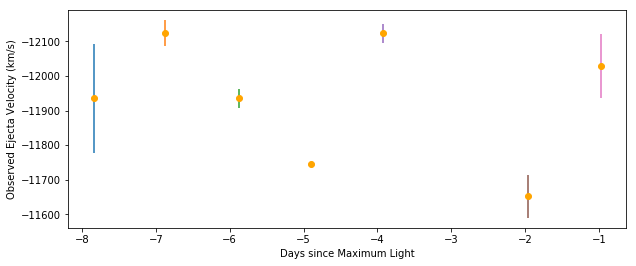

2007co [u'sn2007co-20070608.35-fast.flm', u'sn2007co-20070609.33-fast.flm', u'sn2007co-20070610.39-fast.flm', u'sn2007co-20070612.35-fast.flm', u'sn2007co-20070613.39-fast.flm', u'sn2007co-20070614.38-fast.flm', u'sn2007co-20070615.36-fast.flm', u'sn2007co-20070616.35-fast.flm', u'sn2007co-20070617.34-fast.flm', u'sn2007co-20070619.45-fast.flm', u'sn2007co-20070620.34-fast.flm', u'sn2007co-20070621.33-fast.flm', u'sn2007co-20070622.38-fast.flm', u'sn2007co-20070624.36-fast.flm', u'sn2007co-20070625.40-fast.flm']


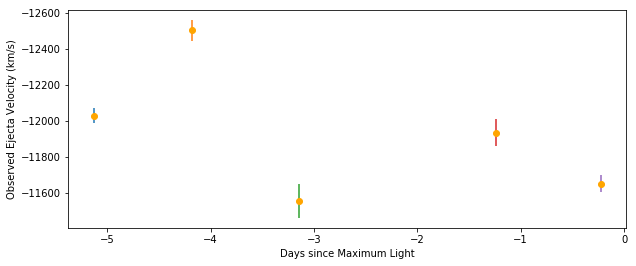

2007cq [u'sn2007cq-20070624.45-fast.flm', u'sn2007cq-20070625.45-fast.flm']


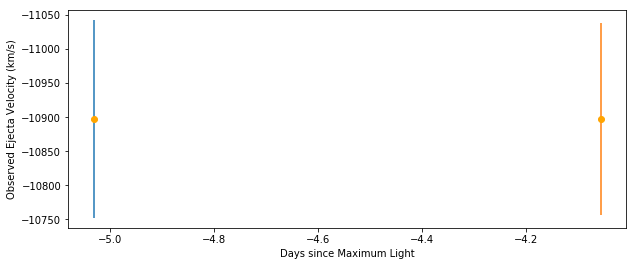

2007f [u'sn2007F-20070114.49-fast.flm', u'sn2007F-20070115.53-fast.flm', u'sn2007F-20070116.54-fast.flm', u'sn2007F-20070117.53-fast.flm', u'sn2007F-20070121.55-fast.flm', u'sn2007F-20070122.49-fast.flm', u'sn2007F-20070126.43-fast.flm', u'sn2007F-20070210.39-fast.flm', u'sn2007F-20070219.43-fast.flm']


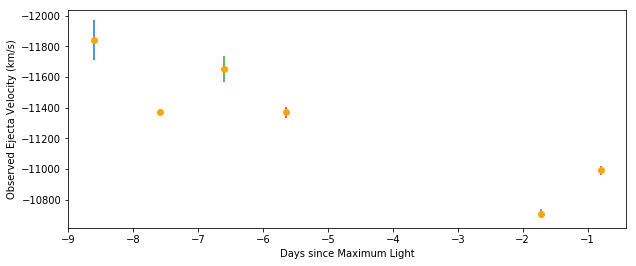

2007qe [u'sn2007qe-20071115.28-fast.flm', u'sn2007qe-20071116.11-fast.flm', u'sn2007qe-20071203.12-fast.flm', u'sn2007qe-20071204.14-fast.flm', u'sn2007qe-20071206.15-fast.flm', u'sn2007qe-20071214.07-mmt.flm', u'sn2007qe-20071214.11-fast.flm', u'sn2007qe-20071216.12-fast.flm', u'sn2007qe-20071218.14-fast.flm']


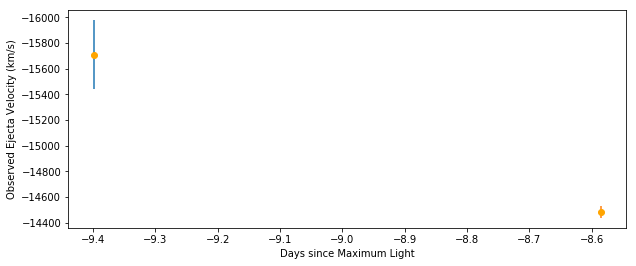

2007s [u'sn2007S-20070208.34-fast.flm', u'sn2007S-20070209.30-fast.flm', u'sn2007S-20070210.32-fast.flm', u'sn2007S-20070212.33-fast.flm', u'sn2007S-20070219.32-fast.flm', u'sn2007S-20070221.32-fast.flm', u'sn2007S-20070225.30-fast.flm', u'sn2007S-20070226.30-fast.flm', u'sn2007S-20070310.28-fast.flm']


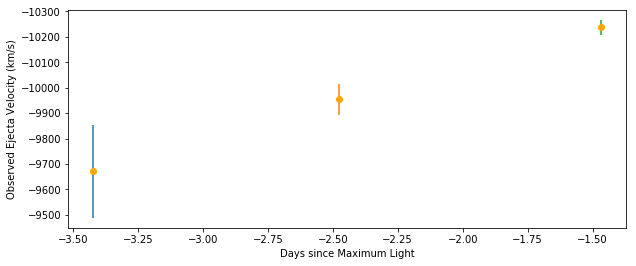

2008af [u'sn2008af-20080211.48-fast.flm', u'sn2008af-20080301.49-fast.flm']


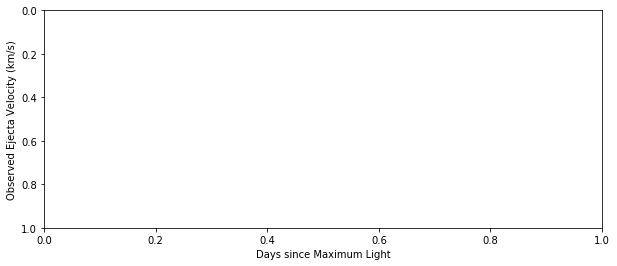

2008bf [u'sn2008bf-20080330.31-fast.flm', u'sn2008bf-20080401.29-fast.flm', u'sn2008bf-20080402.35-fast.flm', u'sn2008bf-20080403.30-fast.flm', u'sn2008bf-20080406.29-fast.flm', u'sn2008bf-20080409.33-fast.flm', u'sn2008bf-20080410.28-fast.flm', u'sn2008bf-20080412.30-fast.flm', u'sn2008bf-20080415.24-fast.flm', u'SN08bf_080320_b01_CLA_LD.dat', u'SN08bf_080324_b01_CLA_LD.dat', u'SN08bf_080325_b01_CLA_LD.dat', u'SN08bf_080326_b01_CLA_LD.dat', u'SN08bf_080328_g01_NTT_EM.dat', u'SN08bf_080331_b01_DUP_WF.dat', u'SN08bf_080407_b01_DUP_WF.dat', u'SN08bf_080412_b01_DUP_WF.dat', u'SN08bf_080429_b01_DUP_WF.dat']


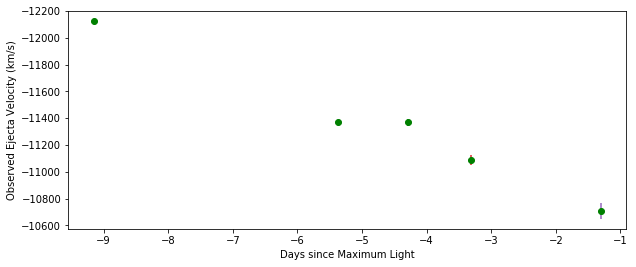

2008l [u'sn2008L-20080202.15-fast.flm']


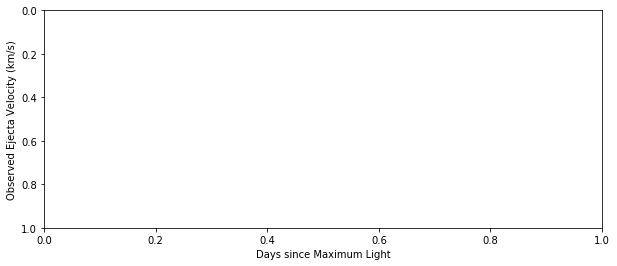

2004eo [u'SN04eo_040919_b01_DUP_WF.dat', u'SN04eo_040920_b01_DUP_WF.dat', u'SN04eo_041025_b01_CLA_LD.dat']


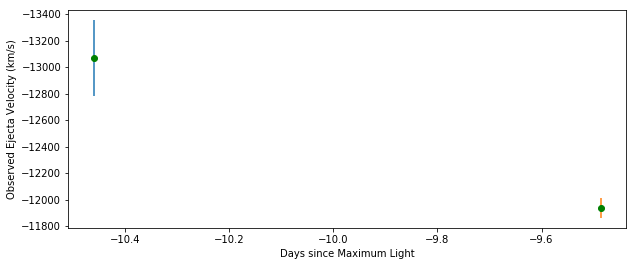

2004ey [u'SN04ey_041025_b01_CLA_LD.dat']


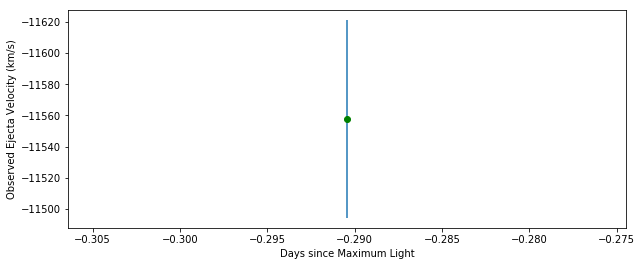

2004gs [u'SN04gs_041213_b01_DUP_WF.dat', u'SN04gs_041219_b01_CLA_LD.dat']


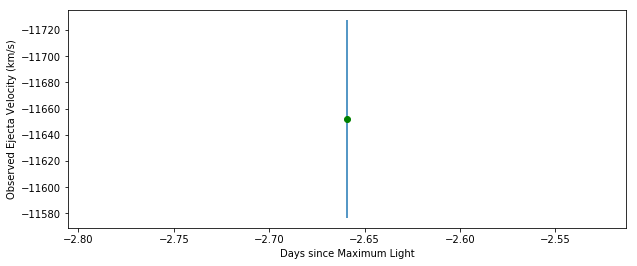

2004gu [u'SN04gu_041219_b01_CLA_LD.dat']


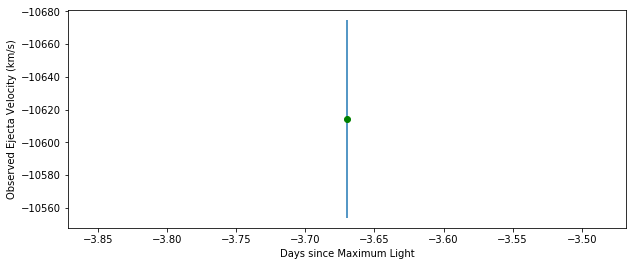

2005ag [u'SN05ag_050212_b01_DUP_WF.dat', u'SN05ag_050315_b01_DUP_WF.dat']


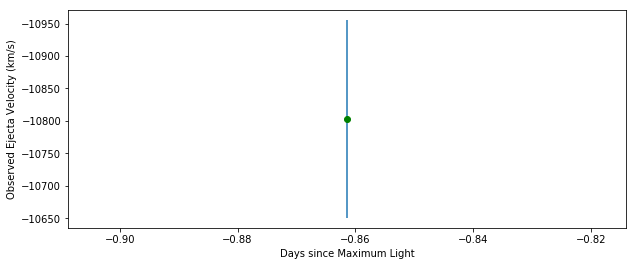

2005al [u'SN05al_050315_b01_DUP_WF.dat', u'SN05al_050319_b01_DUP_WF.dat', u'SN05al_050324_b01_DUP_MS.dat']


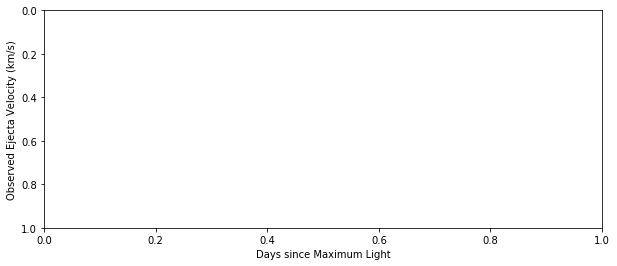

2005bg [u'SN05bg_050412_b01_DUP_WF.dat', u'SN05bg_050415_b01_DUP_WF.dat']


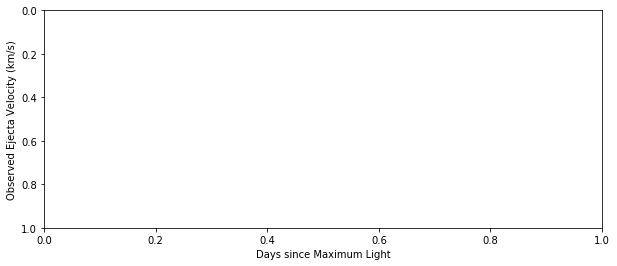

2005bo [u'SN05bo_050418_b01_DUP_WF.dat', u'SN05bo_050419_b01_DUP_WF.dat']


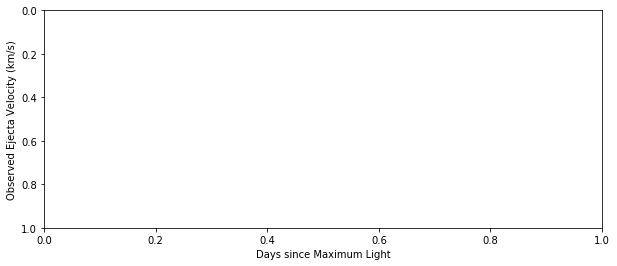

2005el [u'SN05el_050926_b01_DUP_WF.dat', u'SN05el_050927_b01_DUP_WF.dat', u'SN05el_051005_b01_DUP_WF.dat', u'SN05el_051018_g01_NTT_EM.dat']


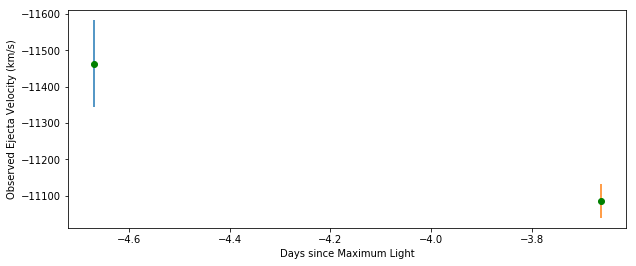

2005eq [u'SN05eq_051005_b01_DUP_WF.dat', u'SN05eq_051018_g01_NTT_EM.dat']


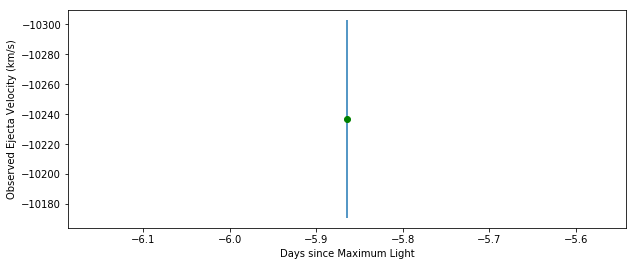

2005hc [u'SN05hc_051018_g01_NTT_EM.dat', u'SN05hc_051022_b01_MGH_BC.dat', u'SN05hc_051024_b01_MGH_BC.dat']


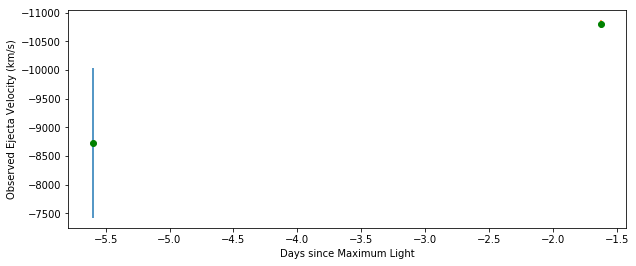

2005iq [u'SN05iq_051124_b01_DUP_MS.dat']


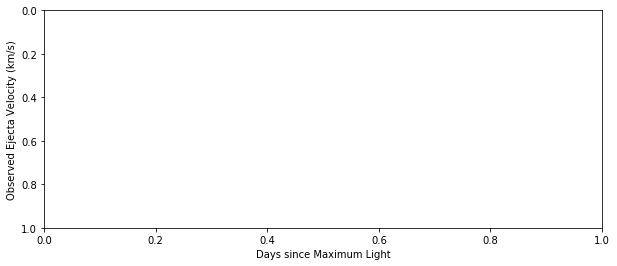

2005kc [u'SN05kc_051124_b01_DUP_MS.dat', u'SN05kc_051125_b01_DUP_MS.dat', u'SN05kc_051222_b01_DUP_WF.dat']


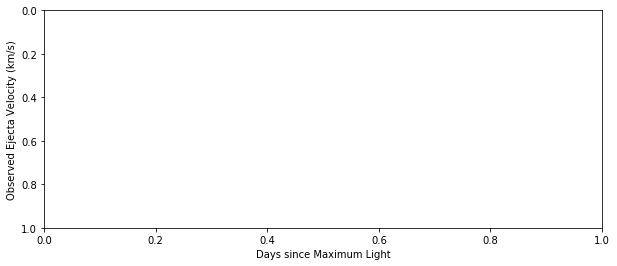

2005ki [u'SN05ki_051123_b01_DUP_MS.dat', u'SN05ki_051125_b01_DUP_MS.dat', u'SN05ki_051222_b01_DUP_WF.dat']


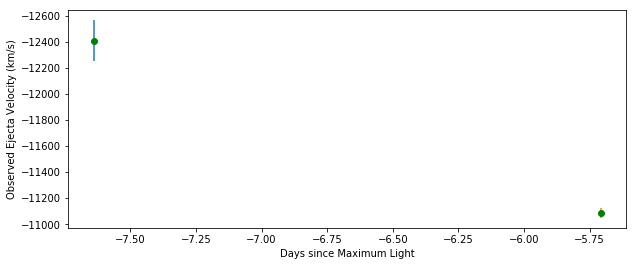

2005na [u'SN05na_060116_g01_NTT_EM.dat', u'SN05na_060124_g01_CLA_LD.dat']


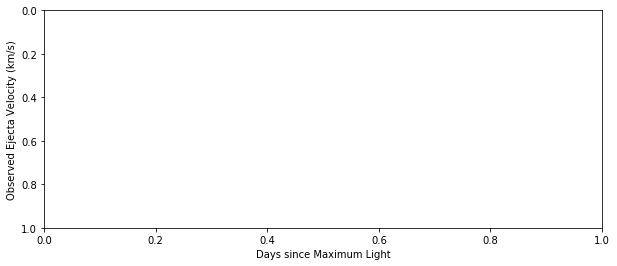

2006ax [u'SN06ax_060322_b01_DUP_WF.dat', u'SN06ax_060323_b01_DUP_WF.dat', u'SN06ax_060324_b01_DUP_WF.dat', u'SN06ax_060330_b01_DUP_WF.dat', u'SN06ax_060331_b01_DUP_WF.dat', u'SN06ax_060402_b01_DUP_WF.dat', u'SN06ax_060416_b01_BAA_IM.dat', u'SN06ax_060421_b01_DUP_WF.dat']


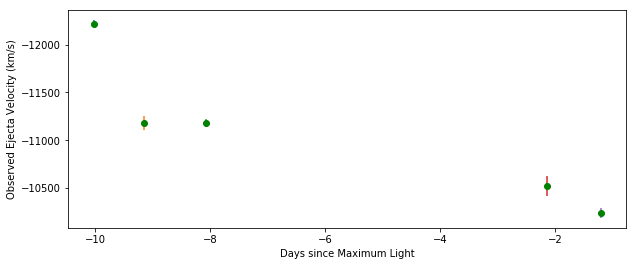

2006bh [u'SN06bh_060416_b01_BAA_IM.dat', u'SN06bh_060424_b01_DUP_WF.dat']


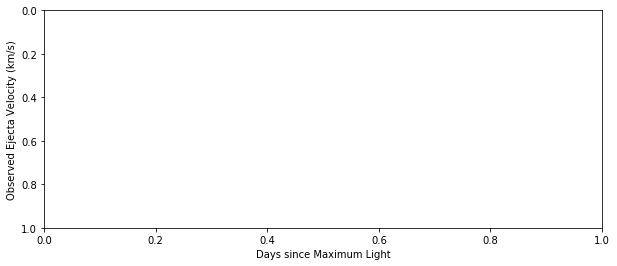

2006et [u'SN06et_060925_b01_DUP_WF.dat', u'SN06et_060926_b01_DUP_WF.dat', u'SN06et_061005_g01_NTT_EM.dat', u'SN06et_061011_b01_DUP_WF.dat']


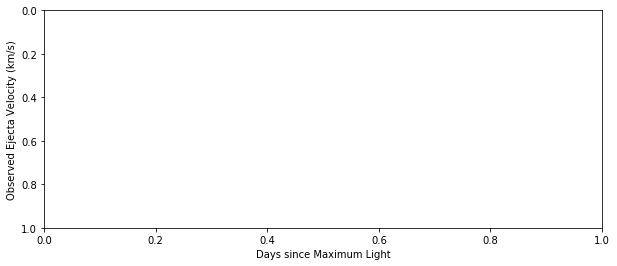

2006gj [u'SN06gj_060925_b01_DUP_WF.dat', u'SN06gj_060927_b01_DUP_WF.dat', u'SN06gj_060928_b01_DUP_WF.dat', u'SN06gj_061005_g01_NTT_EM.dat', u'SN06gj_061007_b01_HIL_BC.dat', u'SN06gj_061011_b01_DUP_WF.dat', u'SN06gj_061016_b01_HIL_BC.dat']


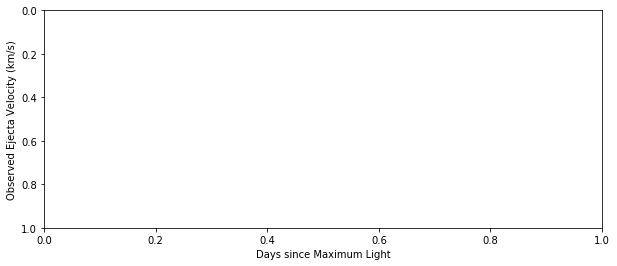

2006gt [u'SN06gt_060925_b01_DUP_WF.dat', u'SN06gt_060927_b01_DUP_WF.dat', u'SN06gt_060928_b01_DUP_WF.dat', u'SN06gt_061010_b01_DUP_WF.dat']


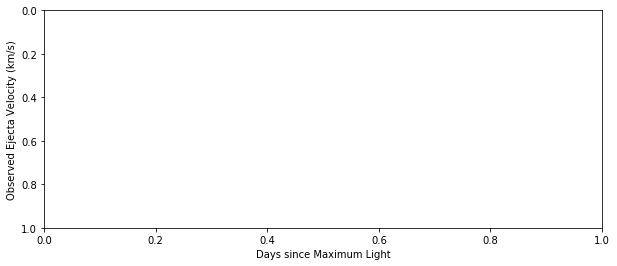

2006hb [u'SN06hb_060928_b01_DUP_WF.dat', u'SN06hb_061005_g01_NTT_EM.dat', u'SN06hb_061007_b01_HIL_BC.dat', u'SN06hb_061010_b01_DUP_WF.dat']


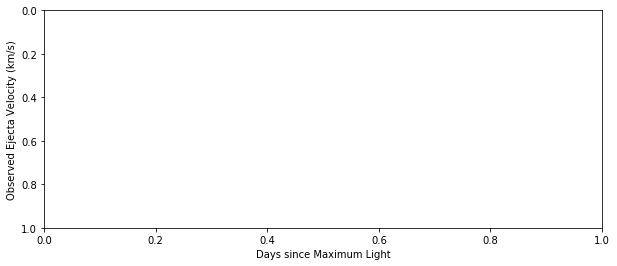

2006is [u'SN06is_061001_b01_BAA_IM.dat', u'SN06is_061005_g01_NTT_EM.dat', u'SN06is_061008_b01_HIL_BC.dat', u'SN06is_061010_b01_DUP_WF.dat', u'SN06is_061011_b01_DUP_WF.dat', u'SN06is_061013_b01_DUP_WF.dat', u'SN06is_061016_b01_HIL_BC.dat', u'SN06is_061018_b01_HIL_BC.dat', u'SN06is_061021_b01_HIL_BC.dat']


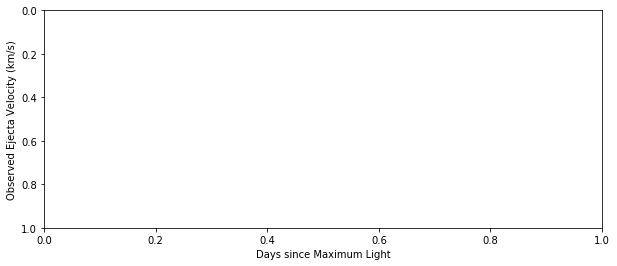

2006kf [u'SN06kf_061027_b01_DUP_WF.dat', u'SN06kf_061103_b01_HIL_BC.dat', u'SN06kf_061103_g01_NTT_EM.dat', u'SN06kf_061116_b01_DUP_WF.dat', u'SN06kf_061117_b01_HIL_BC.dat', u'SN06kf_061130_b01_HIL_BC.dat']


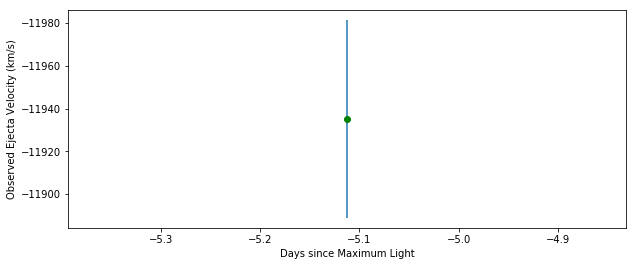

2006ob [u'SN06ob_061218_b01_DUP_WF.dat']


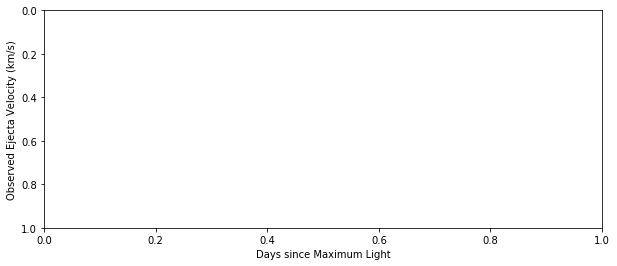

2006os [u'SN06os_061122_b01_DUP_WF.dat', u'SN06os_061213_b01_DUP_BC.dat']


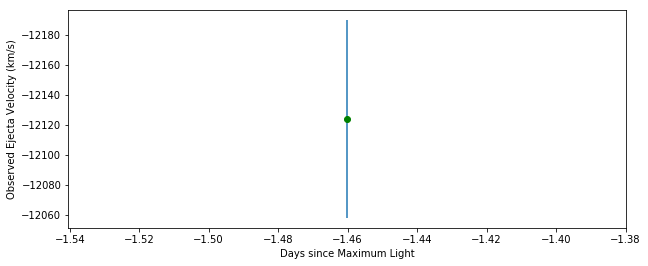

2007ai [u'SN07ai_070314_b01_DUP_BC.dat', u'SN07ai_070319_b01_DUP_BC.dat', u'SN07ai_070326_b01_DUP_BC.dat']


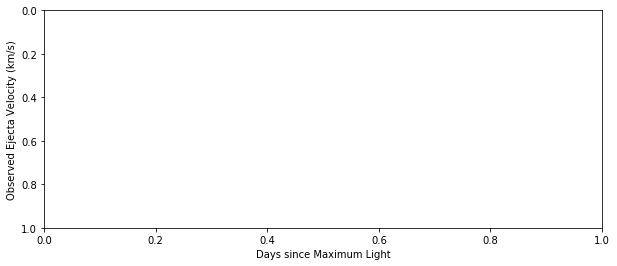

2007al [u'SN07al_070313_g01_BAA_IM.dat']


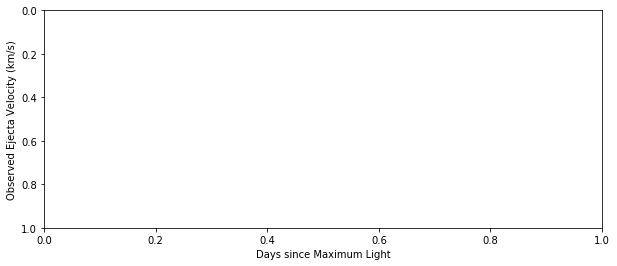

2007ba [u'SN07ba_070409_b01_BAA_IM.dat', u'SN07ba_070412_b01_DUP_WF.dat']


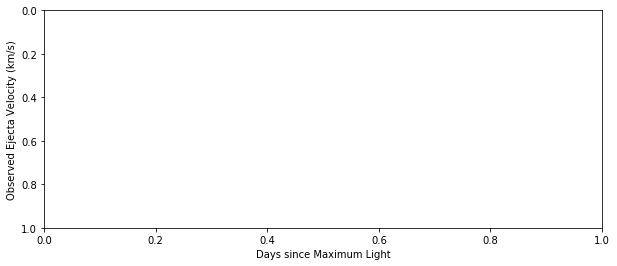

2007bc [u'SN07bc_070409_b01_BAA_IM.dat', u'SN07bc_070412_b01_DUP_WF.dat', u'SN07bc_070417_b01_DUP_WF.dat']


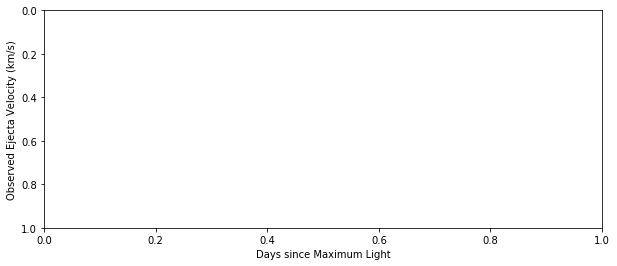

2007bd [u'SN07bd_070409_b01_BAA_IM.dat', u'SN07bd_070412_b01_DUP_WF.dat', u'SN07bd_070417_b01_DUP_WF.dat', u'SN07bd_070430_b01_DUP_BC.dat']


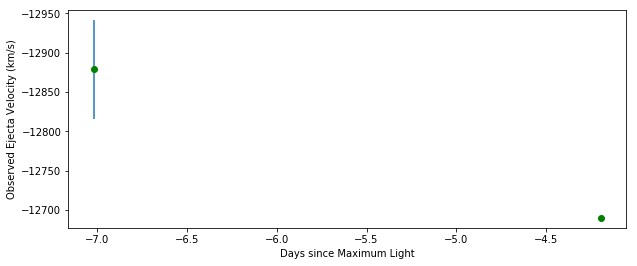

2007ca [u'SN07ca_070508_b01_BAA_IM.dat', u'SN07ca_070511_b01_DUP_BC.dat']


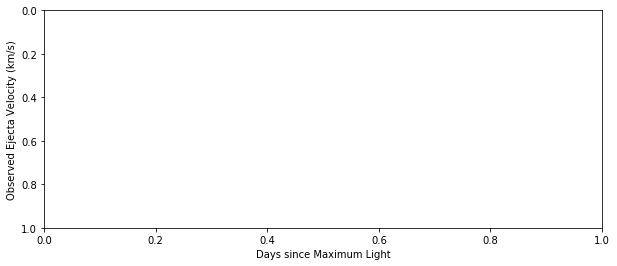

2008bf [u'SN08bf_080320_b01_CLA_LD.dat', u'SN08bf_080324_b01_CLA_LD.dat', u'SN08bf_080325_b01_CLA_LD.dat', u'SN08bf_080326_b01_CLA_LD.dat', u'SN08bf_080328_g01_NTT_EM.dat', u'SN08bf_080331_b01_DUP_WF.dat', u'SN08bf_080407_b01_DUP_WF.dat', u'SN08bf_080412_b01_DUP_WF.dat', u'SN08bf_080429_b01_DUP_WF.dat']


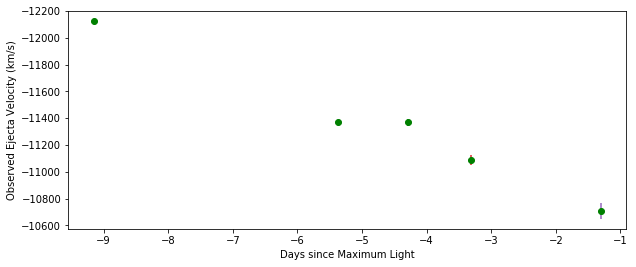

1994s [u'1994S_19940706_3501_9665_00.dat']


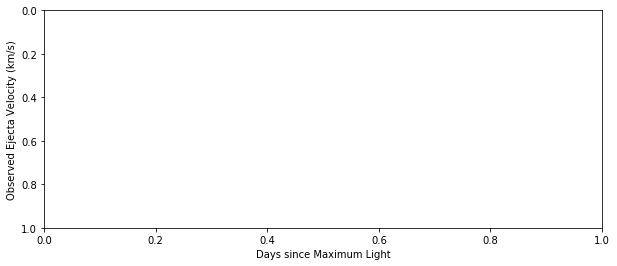

2002dj [u'2002dj_20020613_3256_9273_00.dat', u'2002dj_20020614_3745_9776_00.dat', u'2002dj_20020615_3307_9271_00.dat', u'2002dj_20020616_3343_9272_00.dat', u'2002dj_20020618_3256_9271_00.dat', u'2002dj_20020620_3210_9231_00.dat', u'2002dj_20020621_3255_9271_00.dat', u'2002dj_20020703_3397_9281_00.dat', u'2002dj_20020704_3340_10256_00.dat', u'2002dj_20020707_3201_9077_00.dat', u'2002dj_20020711_3304_10259_00.dat', u'2002dj_20020716_3300_9077_00.dat', u'2002dj_20020725_3741_10264_00.dat']


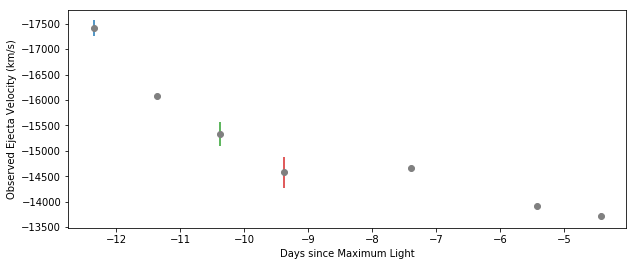

In [40]:
for object in SN_v_object_list:
    print object.name, object.files
    
    #print object.sources
    color_data = []
    for entry in object.sources:
        color_code = color(entry)
        color_data.append(color_code)
    
    #print color_data
    x = object.phases
    y = object.velocities
    
    plt.figure(figsize=(10,4))
    plt.xlabel("Days since Maximum Light")
    plt.ylabel("Observed Ejecta Velocity (km/s)")
    ax = plt.gca()
    ax.invert_yaxis()
    for i in range(len(x)):
        if x[i] < 0:
            plt.plot(x[i],y[i], "o", color=color_data[i])
            plt.errorbar(x[i], y[i], object.errors[i]) 
    plt.show()

Only using events with abundant data:

In [41]:
ab_data_events = []
for object in SN_v_object_list:
    if len(object.files) > 7 and np.min(object.phases) < 5 and np.max(object.phases) > 15:
        ab_data_events.append(object)
        
print ab_data_events

[<__main__.SN_v_data instance at 0x0000000061C45E48>, <__main__.SN_v_data instance at 0x000000000F503048>, <__main__.SN_v_data instance at 0x000000000F503088>, <__main__.SN_v_data instance at 0x000000000F503148>, <__main__.SN_v_data instance at 0x000000000F503188>, <__main__.SN_v_data instance at 0x000000000F503288>, <__main__.SN_v_data instance at 0x000000000F5033C8>, <__main__.SN_v_data instance at 0x000000000F503408>, <__main__.SN_v_data instance at 0x000000000F503448>, <__main__.SN_v_data instance at 0x000000000F503548>, <__main__.SN_v_data instance at 0x000000000F5035C8>, <__main__.SN_v_data instance at 0x000000000F503608>, <__main__.SN_v_data instance at 0x000000000F503648>, <__main__.SN_v_data instance at 0x000000000F5037C8>, <__main__.SN_v_data instance at 0x000000000F503888>, <__main__.SN_v_data instance at 0x000000000F5038C8>, <__main__.SN_v_data instance at 0x000000000F503908>, <__main__.SN_v_data instance at 0x000000000F5039C8>, <__main__.SN_v_data instance at 0x000000000F5

1997do [u'sn1997do-19971108-uoi.flm', u'sn1997do-19971102.46-fast.flm', u'sn1997do-19971103.43-fast.flm', u'sn1997do-19971106.51-fast.flm', u'sn1997do-19971107.51-fast.flm', u'sn1997do-19971122.45-fast.flm', u'sn1997do-19971124.45-fast.flm', u'sn1997do-19971125.38-fast.flm', u'sn1997do-19971126.37-fast.flm', u'sn1997do-19971128.50-fast.flm', u'sn1997do-19971129.55-fast.flm', u'sn1997do-19971204.33-fast.flm', u'sn1997do-19971205.30-fast.flm', u'sn1997do-19971205.35-mmt.flm']


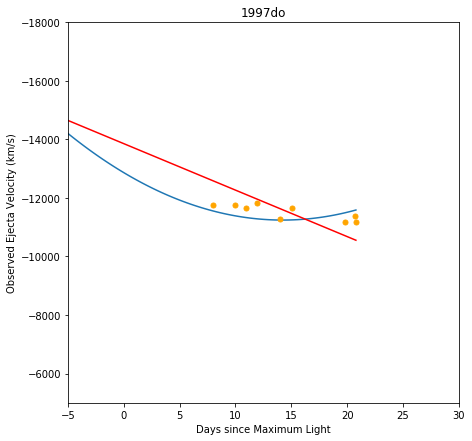

1998de [u'sn1998de-19980831-ui.flm', u'sn1998de-19980725.46-fast.flm', u'sn1998de-19980726.47-fast.flm', u'sn1998de-19980727.45-fast.flm', u'sn1998de-19980729.50-fast.flm', u'sn1998de-19980730.46-fast.flm', u'sn1998de-19980801.41-fast.flm', u'sn1998de-19980804.46-fast.flm']


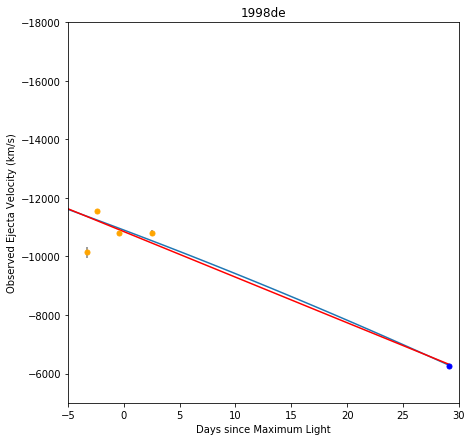

1998dx [u'sn1998dx-19980921-ui.flm', u'sn1998dx-19981015-ui.flm', u'sn1998dx-19980914.18-fast.flm', u'sn1998dx-19980915.22-fast.flm', u'sn1998dx-19980917.13-fast.flm', u'sn1998dx-19980918.15-fast.flm', u'sn1998dx-19980922.12-fast.flm', u'sn1998dx-19980924.16-fast.flm', u'sn1998dx-19980929.13-fast.flm']


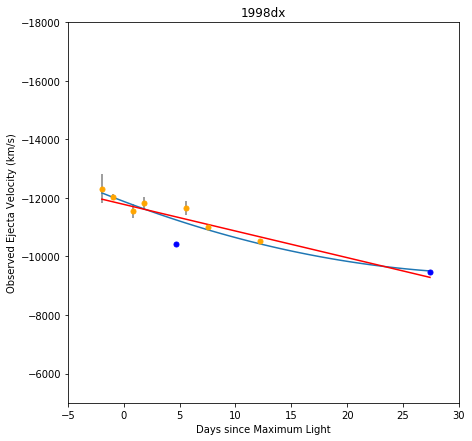

1999aa [u'sn1999aa-19990212-uoi.flm', u'sn1999aa-19990223-ui.flm', u'sn1999aa-19990309-uvoir.flm', u'sn1999aa-19990312-ui.flm', u'sn1999aa-19990213.35-fast.flm', u'sn1999aa-19990214.33-fast.flm', u'sn1999aa-19990215.28-fast.flm', u'sn1999aa-19990216.24-fast.flm', u'sn1999aa-19990217.26-fast.flm', u'sn1999aa-19990218.25-fast.flm', u'sn1999aa-19990219.28-fast.flm', u'sn1999aa-19990220.29-fast.flm', u'sn1999aa-19990221.29-fast.flm', u'sn1999aa-19990223.25-fast.flm', u'sn1999aa-19990309.25-fast.flm', u'sn1999aa-19990310.23-fast.flm', u'sn1999aa-19990311.23-fast.flm', u'sn1999aa-19990312.29-fast.flm', u'sn1999aa-19990322.27-fast.flm', u'sn1999aa-19990323.19-fast.flm', u'sn1999aa-19990324.18-fast.flm', u'sn1999aa-19990325.12-fast.flm']


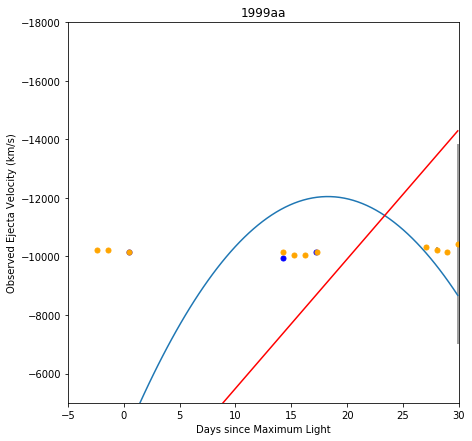

1999ac [u'sn1999ac-19990312-ui-corrected.flm', u'sn1999ac-19990309.53-fast.flm', u'sn1999ac-19990310.53-fast.flm', u'sn1999ac-19990312.53-fast.flm', u'sn1999ac-19990322.51-fast.flm', u'sn1999ac-19990323.51-fast.flm', u'sn1999ac-19990324.51-fast.flm', u'sn1999ac-19990325.50-fast.flm', u'sn1999ac-19990407.46-fast.flm', u'sn1999ac-19990409.45-fast.flm', u'sn1999ac-19990411.48-fast.flm']


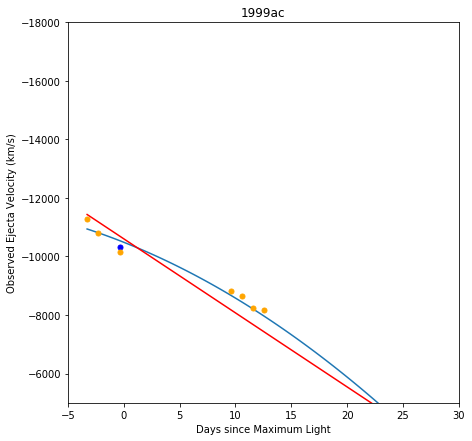

1999dq [u'sn1999dq-19990910-ui-corrected.flm', u'sn1999dq-19991008-ui-corrected.flm', u'sn1999dq-near-19990917-clear-ui-corrected.flm', u'sn1999dq-19990905.45-fast.flm', u'sn1999dq-19990906.43-fast.flm', u'sn1999dq-19990907.48-fast.flm', u'sn1999dq-19990908.48-fast.flm', u'sn1999dq-19990909.44-fast.flm', u'sn1999dq-19990910.44-fast.flm', u'sn1999dq-19990911.46-fast.flm', u'sn1999dq-19990912.51-fast.flm', u'sn1999dq-19990915.45-fast.flm', u'sn1999dq-19990916.45-fast.flm', u'sn1999dq-19990917.46-fast.flm', u'sn1999dq-19990918.45-fast.flm', u'sn1999dq-19990920.46-fast.flm', u'sn1999dq-19991002.47-fast.flm', u'sn1999dq-19991003.45-fast.flm', u'sn1999dq-19991011.45-fast.flm', u'sn1999dq-19991014.32-fast.flm']


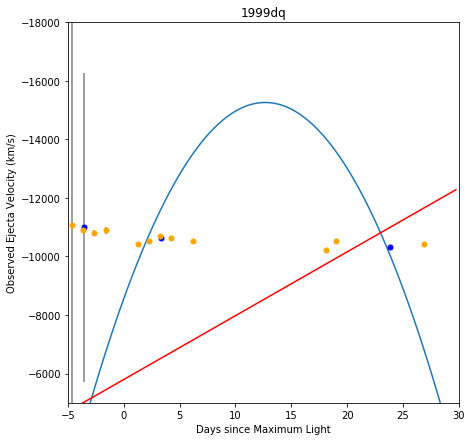

2000cn [u'sn2000cn-20000627-ui-corrected.flm', u'sn2000cn-20000706-ui-corrected.flm', u'sn2000cn-20000603.37-fast.flm', u'sn2000cn-20000604.38-fast.flm', u'sn2000cn-20000605.37-fast.flm', u'sn2000cn-20000621.37-fast.flm', u'sn2000cn-20000625.36-fast.flm', u'sn2000cn-20000709.24-fast.flm', u'sn2000cn-20000710.27-fast.flm']


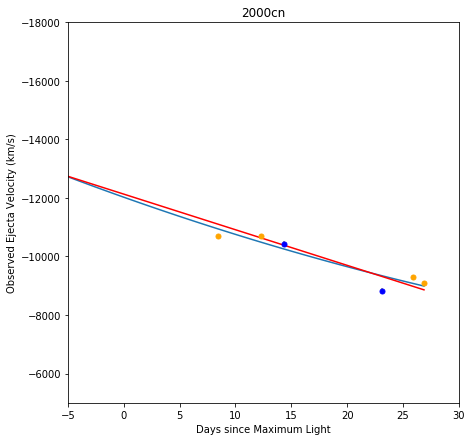

2000dk [u'sn2000dk-20000926-ui-corrected.flm', u'sn2000dk-20001006-ui-corrected.flm', u'sn2000dk-20001024-ui-corrected.flm', u'sn2000dk-20000920.39-fast.flm', u'sn2000dk-20000921.27-fast.flm', u'sn2000dk-20000926.37-fast.flm', u'sn2000dk-20000929.34-fast.flm', u'sn2000dk-20001005.33-fast.flm']


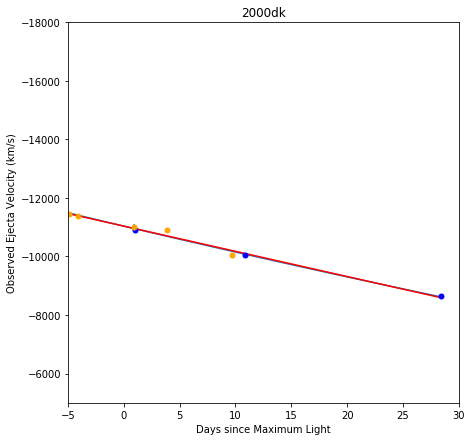

2000fa [u'sn2000fa-20001205-ui-corrected.flm', u'sn2000fa-20001221-ui-corrected.flm', u'sn2000fa-20001203.44-mmt.flm', u'sn2000fa-20001203.48-fast.flm', u'sn2000fa-20001215.36-fast.flm', u'sn2000fa-20001216.36-fast.flm', u'sn2000fa-20001218.38-fast.flm', u'sn2000fa-20001223.35-fast.flm', u'sn2000fa-20001225.42-fast.flm', u'sn2000fa-20001228.41-fast.flm', u'sn2000fa-20001230.43-fast.flm', u'sn2000fa-20010101.42-fast.flm', u'sn2000fa-20010104.36-fast.flm']


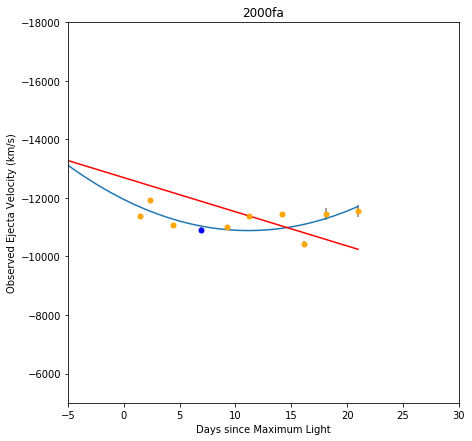

2001cp [u'sn2001cp-20010629-ui.flm', u'sn2001cp-20010716-ui.flm', u'sn2001cp-20010727-ui.flm', u'sn2001cp-20010621.45-fast.flm', u'sn2001cp-20010623.44-fast.flm', u'sn2001cp-20010624.40-fast.flm', u'sn2001cp-20010627.26-fast.flm', u'sn2001cp-20010629.28-fast.flm', u'sn2001cp-20010715.25-fast.flm', u'sn2001cp-20010721.21-fast.flm', u'sn2001cp-20010725.26-fast.flm']


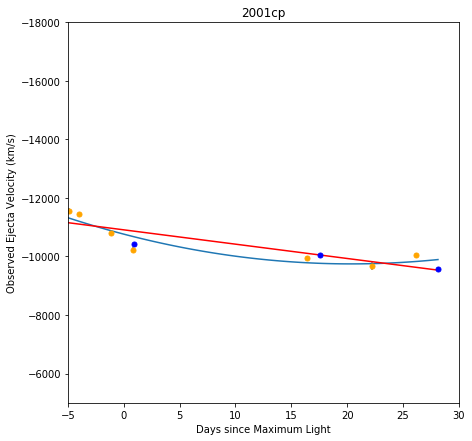

2001eh [u'sn2001eh-20010911-ui.flm', u'sn2001eh-20010912-ui.flm', u'sn2001eh-20010920-ui.flm', u'sn2001eh-20010912.44-fast.flm', u'sn2001eh-20010915.42-fast.flm', u'sn2001eh-20010917.39-fast.flm', u'sn2001eh-20010920.33-fast.flm', u'sn2001eh-20010921.35-fast.flm', u'sn2001eh-20010922.35-fast.flm', u'sn2001eh-20010923.37-fast.flm', u'sn2001eh-20010926.37-fast.flm', u'sn2001eh-20011013.33-fast.flm', u'sn2001eh-20011014.32-fast.flm', u'sn2001eh-20011015.32-fast.flm', u'sn2001eh-20011017.33-fast.flm']


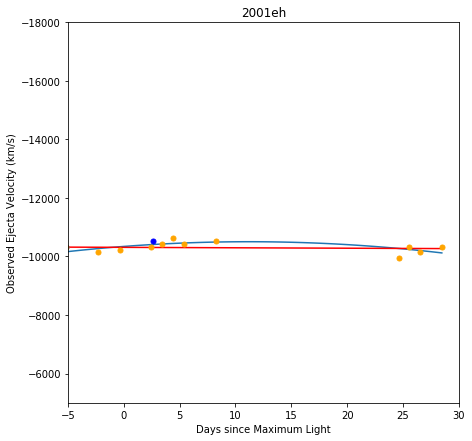

2001en [u'sn2001en-20011020-ui-corrected.flm', u'sn2001en-20011025-ui-corrected.flm', u'sn2001en-20011011.39-fast.flm', u'sn2001en-20011014.34-fast.flm', u'sn2001en-20011015.31-fast.flm', u'sn2001en-20011016.33-fast.flm', u'sn2001en-20011018.35-fast.flm', u'sn2001en-20011020.29-fast.flm', u'sn2001en-20011022.29-fast.flm', u'sn2001en-20011024.25-fast.flm']


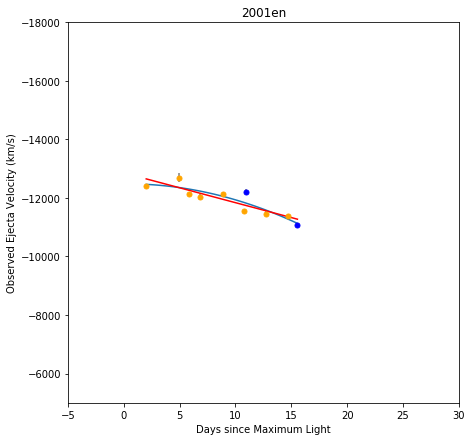

2001ep [u'sn2001ep-20011020-ui-corrected.flm', u'sn2001ep-20011022.654-joined-corrected.flm', u'sn2001ep-20011023.652-joined-corrected.flm', u'sn2001ep-20011025-ui-corrected.flm', u'sn2001ep-20011115-ui.flm', u'sn2001ep-20011010.49-fast.flm', u'sn2001ep-20011014.45-fast.flm', u'sn2001ep-20011015.45-fast.flm', u'sn2001ep-20011016.45-fast.flm', u'sn2001ep-20011017.42-fast.flm', u'sn2001ep-20011018.43-fast.flm', u'sn2001ep-20011019.44-fast.flm', u'sn2001ep-20011020.44-fast.flm', u'sn2001ep-20011021.43-fast.flm', u'sn2001ep-20011022.43-fast.flm', u'sn2001ep-20011023.45-fast.flm', u'sn2001ep-20011024.43-fast.flm', u'sn2001ep-20011025.43-fast.flm', u'sn2001ep-20011107.39-fast.flm', u'sn2001ep-20011115.37-fast.flm']


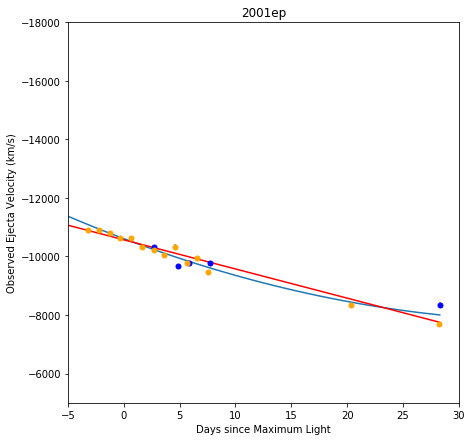

2001v [u'sn2001v-20010321-ui.flm', u'sn2001v-20010329-o.flm', u'sn2001v-20010330-ui.flm', u'sn2001V-20010219.40-fast.flm', u'sn2001V-20010220.29-fast.flm', u'sn2001V-20010221.39-fast.flm', u'sn2001V-20010222.44-fast.flm', u'sn2001V-20010223.33-fast.flm', u'sn2001V-20010225.30-fast.flm', u'sn2001V-20010226.30-fast.flm', u'sn2001V-20010227.33-fast.flm', u'sn2001V-20010301.47-fast.flm', u'sn2001V-20010314.43-fast.flm', u'sn2001V-20010315.44-fast.flm', u'sn2001V-20010316.29-fast.flm', u'sn2001V-20010317.45-fast.flm', u'sn2001V-20010318.47-fast.flm', u'sn2001V-20010323.24-fast.flm', u'sn2001V-20010324.21-fast.flm', u'sn2001V-20010325.21-fast.flm', u'sn2001V-20010325.40-mmt.flm', u'sn2001V-20010326.24-fast.flm', u'sn2001V-20010326.47-mmt.flm', u'sn2001V-20010327.32-fast.flm', u'sn2001V-20010328.29-fast.flm', u'sn2001V-20010329.29-fast.flm', u'sn2001V-20010401.22-fast.flm', u'sn2001V-20010402.19-fast.flm']


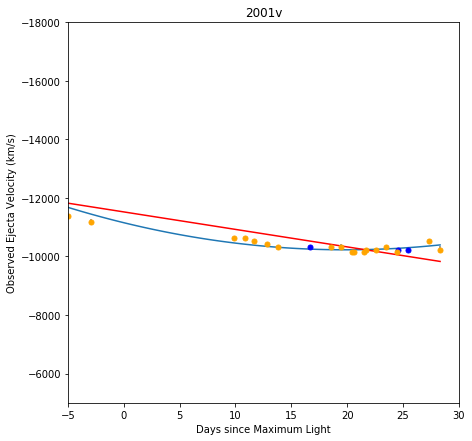

2002cr [u'sn2002cr-20020507-ui-corrected.flm', u'sn2002cr-20020608-ui-corrected.flm', u'sn2002cr-20020503.29-fast.flm', u'sn2002cr-20020506.25-fast.flm', u'sn2002cr-20020508.21-fast.flm', u'sn2002cr-20020512.19-fast.flm', u'sn2002cr-20020515.28-fast.flm', u'sn2002cr-20020519.18-fast.flm', u'sn2002cr-20020603.16-fast.flm']


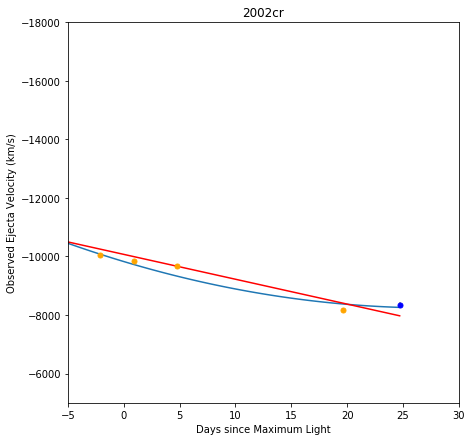

2002de [u'sn2002de-20020608.374-ui-corrected.flm', u'sn2002de-20020617-ui-corrected.flm', u'sn2002de-20020602.24-fast.flm', u'sn2002de-20020603.33-fast.flm', u'sn2002de-20020604.23-fast.flm', u'sn2002de-20020605.41-fast.flm', u'sn2002de-20020606.22-fast.flm', u'sn2002de-20020610.28-fast.flm', u'sn2002de-20020611.29-fast.flm', u'sn2002de-20020612.29-fast.flm', u'sn2002de-20020617.23-fast.flm', u'sn2002de-20020706.18-fast.flm']


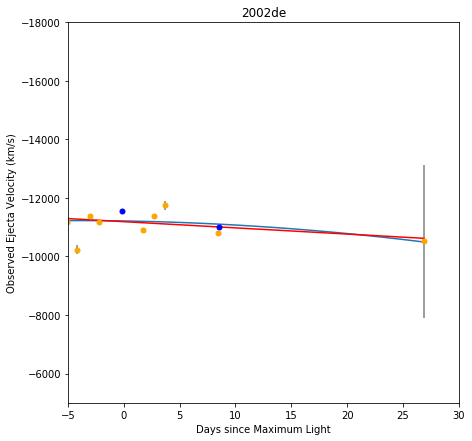

2002dj [u'sn2002dj-20020617-ui-corrected.flm', u'sn2002dj-20020615.17-fast.flm', u'sn2002dj-20020617.17-fast.flm', u'sn2002dj-20020618.17-fast.flm', u'sn2002dj-20020619.18-fast.flm', u'sn2002dj-20020705.18-fast.flm', u'sn2002dj-20020712.17-fast.flm', u'2002dj_20020613_3256_9273_00.dat', u'2002dj_20020614_3745_9776_00.dat', u'2002dj_20020615_3307_9271_00.dat', u'2002dj_20020616_3343_9272_00.dat', u'2002dj_20020618_3256_9271_00.dat', u'2002dj_20020620_3210_9231_00.dat', u'2002dj_20020621_3255_9271_00.dat', u'2002dj_20020703_3397_9281_00.dat', u'2002dj_20020704_3340_10256_00.dat', u'2002dj_20020707_3201_9077_00.dat', u'2002dj_20020711_3304_10259_00.dat', u'2002dj_20020716_3300_9077_00.dat', u'2002dj_20020725_3741_10264_00.dat']


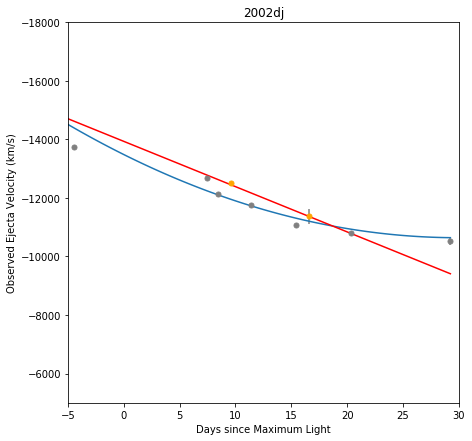

2002fb [u'sn2002fb-20020913-ui-corrected.flm', u'sn2002fb-20021001-ui-corrected.flm', u'sn2002fb-20020907.51-fast.flm', u'sn2002fb-20020909.43-fast.flm', u'sn2002fb-20020912.44-fast.flm', u'sn2002fb-20020929.42-fast.flm', u'sn2002fb-20021005.37-fast.flm', u'sn2002fb-20021009.34-fast.flm']


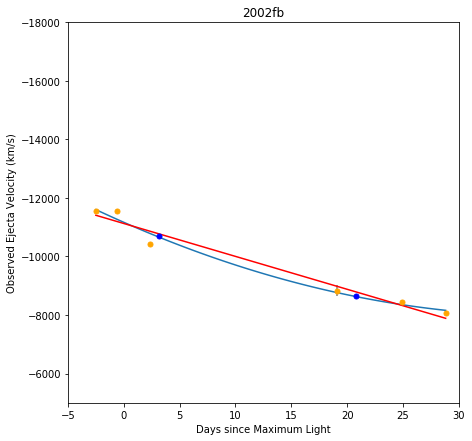

2002jy [u'sn2002jy-20030107-br.flm', u'sn2002jy-20021226.12-fast.flm', u'sn2002jy-20021227.11-fast.flm', u'sn2002jy-20021229.08-fast.flm', u'sn2002jy-20030101.10-fast.flm', u'sn2002jy-20030102.12-fast.flm', u'sn2002jy-20030103.12-fast.flm', u'sn2002jy-20030105.11-fast.flm', u'sn2002jy-20030111.08-fast.flm', u'sn2002jy-20030113.10-fast.flm']


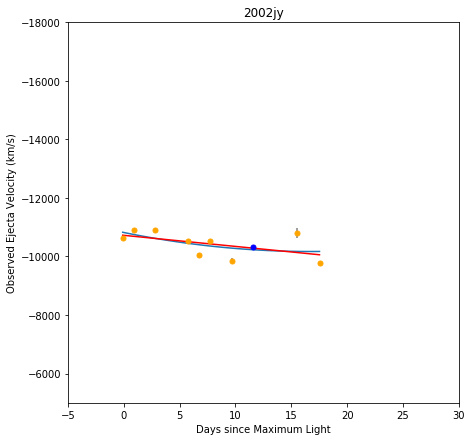

2002kf [u'sn2002kf-20030106-br.flm', u'sn2002kf-20021231.34-fast.flm', u'sn2002kf-20030101.39-fast.flm', u'sn2002kf-20030102.35-fast.flm', u'sn2002kf-20030103.31-fast.flm', u'sn2002kf-20030105.30-fast.flm', u'sn2002kf-20030107.30-fast.flm', u'sn2002kf-20030111.16-fast.flm', u'sn2002kf-20030113.31-fast.flm', u'sn2002kf-20030127.21-fast.flm', u'sn2002kf-20030129.21-fast.flm', u'sn2002kf-20030129.28-mmt.flm']


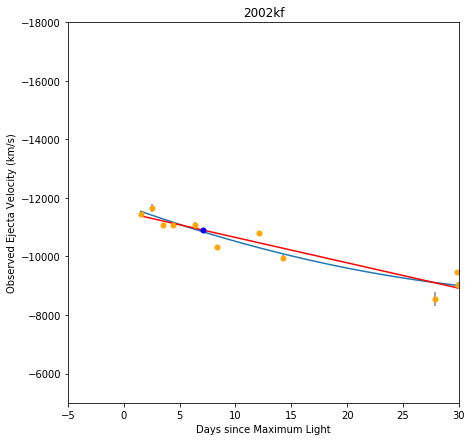

2003cq [u'sn2003cq-20030408-ui.flm', u'sn2003cq-20030403.28-fast.flm', u'sn2003cq-20030407.36-fast.flm', u'sn2003cq-20030409.25-fast.flm', u'sn2003cq-20030410.22-fast.flm', u'sn2003cq-20030411.25-fast.flm', u'sn2003cq-20030427.22-fast.flm', u'sn2003cq-20030509.15-fast.flm']


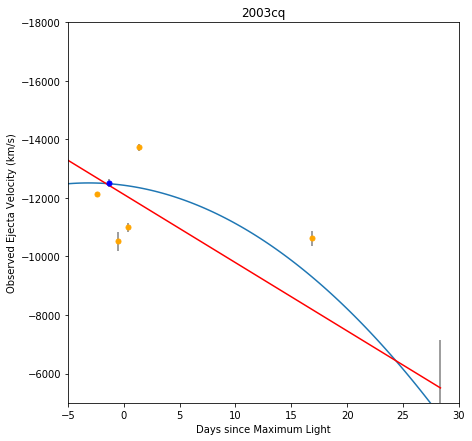

2003fa [u'sn2003fa-20030607.426-ui.flm', u'sn2003fa-20030707.379-ui.flm', u'sn2003fa-20030605.42-fast.flm', u'sn2003fa-20030606.36-fast.flm', u'sn2003fa-20030607.34-fast.flm', u'sn2003fa-20030608.29-fast.flm', u'sn2003fa-20030609.38-fast.flm', u'sn2003fa-20030610.34-mmt.flm', u'sn2003fa-20030623.33-fast.flm', u'sn2003fa-20030624.29-fast.flm', u'sn2003fa-20030625.30-fast.flm', u'sn2003fa-20030627.30-fast.flm', u'sn2003fa-20030628.23-fast.flm', u'sn2003fa-20030630.22-fast.flm', u'sn2003fa-20030701.39-fast.flm', u'sn2003fa-20030702.29-fast.flm', u'sn2003fa-20030703.38-fast.flm', u'sn2003fa-20030704.24-fast.flm', u'sn2003fa-20030704.46-mmt.flm', u'sn2003fa-20030705.41-mmt.flm', u'sn2003fa-20030706.28-fast.flm']


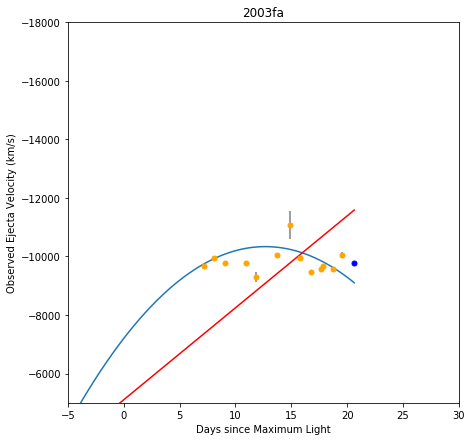

2003w [u'sn2003W-20030204-ui.flm', u'sn2003w-20030228-br.flm', u'sn2003W-20030129.35-mmt.flm', u'sn2003W-20030130.31-fast.flm', u'sn2003W-20030131.39-fast.flm', u'sn2003W-20030201.35-fast.flm', u'sn2003W-20030202.30-fast.flm', u'sn2003W-20030203.33-fast.flm', u'sn2003W-20030204.27-fast.flm', u'sn2003W-20030206.32-fast.flm', u'sn2003W-20030207.40-fast.flm', u'sn2003W-20030209.35-fast.flm', u'sn2003W-20030210.35-fast.flm', u'sn2003W-20030303.37-fast.flm', u'sn2003W-20030307.28-fast.flm', u'sn2003W-20030310.28-fast.flm', u'sn2003W-20030312.27-fast.flm']


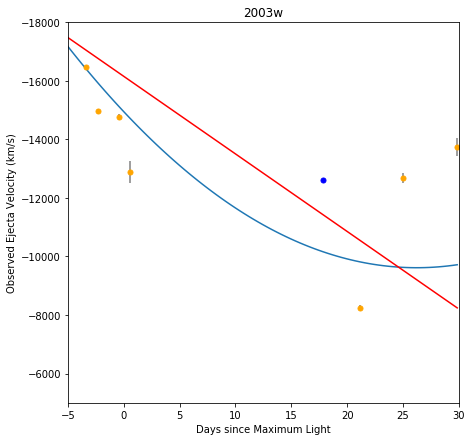

2004as [u'sn2004as-20040316.608-br-corrected.flm', u'sn2004as-20040313.30-fast.flm', u'sn2004as-20040314.32-fast.flm', u'sn2004as-20040315.31-fast.flm', u'sn2004as-20040316.35-fast.flm', u'sn2004as-20040317.39-fast.flm', u'sn2004as-20040318.36-fast.flm', u'sn2004as-20040319.28-fast.flm', u'sn2004as-20040320.38-fast.flm', u'sn2004as-20040321.27-fast.flm', u'sn2004as-20040323.26-fast.flm', u'sn2004as-20040324.34-fast.flm', u'sn2004as-20040327.35-fast.flm', u'sn2004as-20040328.22-fast.flm', u'sn2004as-20040329.23-fast.flm', u'sn2004as-20040330.24-fast.flm', u'sn2004as-20040416.27-fast.flm', u'sn2004as-20040419.26-fast.flm']


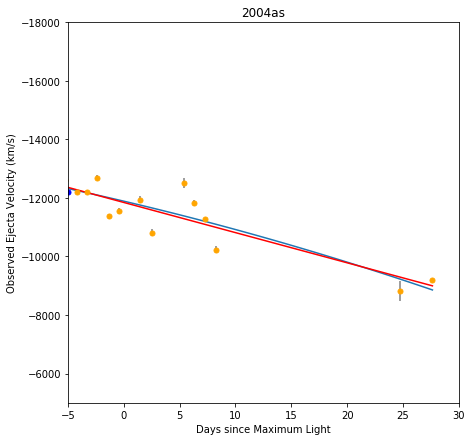

2004gs [u'sn2004gs-20041217.447-ui-corrected.flm', u'sn2004gs-20041213.44-fast.flm', u'sn2004gs-20041215.48-fast.flm', u'sn2004gs-20041216.49-fast.flm', u'sn2004gs-20041218.46-fast.flm', u'sn2004gs-20041219.42-fast.flm', u'sn2004gs-20041220.44-fast.flm', u'sn2004gs-20050106.40-fast.flm', u'sn2004gs-20050109.38-fast.flm', u'SN04gs_041213_b01_DUP_WF.dat', u'SN04gs_041219_b01_CLA_LD.dat']


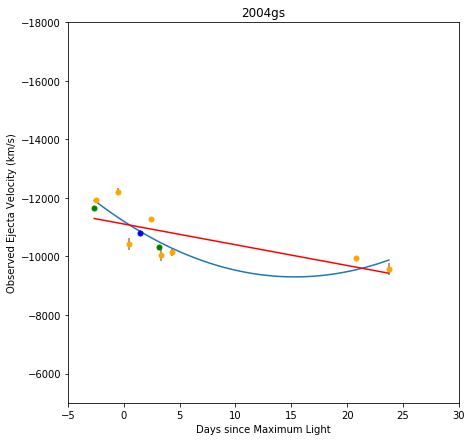

2005el [u'sn2005el-20050926.496-ui-corrected.flm', u'sn2005el-20051004.534-ui-corrected.flm', u'sn2005el-20051011.512-ui-corrected.flm', u'sn2005el-20050927.47-fast.flm', u'sn2005el-20050928.47-fast.flm', u'sn2005el-20050929.48-fast.flm', u'sn2005el-20051005.49-fast.flm', u'sn2005el-20051007.48-fast.flm', u'sn2005el-20051026.50-fast.flm', u'SN05el_050926_b01_DUP_WF.dat', u'SN05el_050927_b01_DUP_WF.dat', u'SN05el_051005_b01_DUP_WF.dat', u'SN05el_051018_g01_NTT_EM.dat']


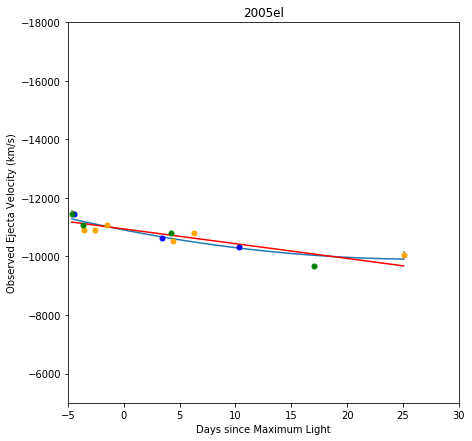

2005eq [u'sn2005eq-20051004.512-ui.flm', u'sn2005eq-20051007.633-br-corrected.flm', u'sn2005eq-20051011.376-ui-corrected.flm', u'sn2005eq-20051002.51-fast.flm', u'sn2005eq-20051005.41-fast.flm', u'sn2005eq-20051007.40-fast.flm', u'sn2005eq-20051009.42-fast.flm', u'sn2005eq-20051011.39-fast.flm', u'sn2005eq-20051012.33-fast.flm', u'sn2005eq-20051025.38-fast.flm', u'sn2005eq-20051028.34-fast.flm', u'sn2005eq-20051107.38-fast.flm', u'SN05eq_051005_b01_DUP_WF.dat', u'SN05eq_051018_g01_NTT_EM.dat']


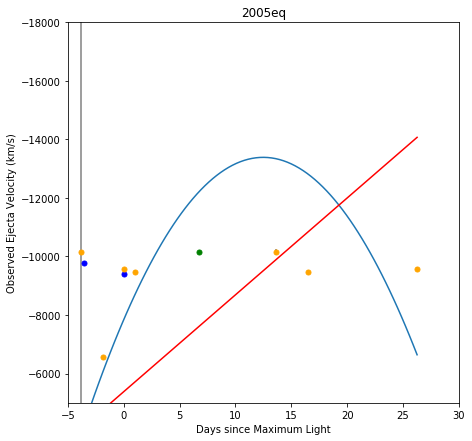

2005eu [u'sn2005eu-20051006.584-deimos.flm', u'sn2005eu-20051007.622-br.flm', u'sn2005eu-20051011.350-ui-corrected.flm', u'sn2005eu-20051007.38-fast.flm', u'sn2005eu-20051009.38-fast.flm', u'sn2005eu-20051011.37-fast.flm', u'sn2005eu-20051025.29-fast.flm', u'sn2005eu-20051027.36-fast.flm', u'sn2005eu-20051109.30-fast.flm']


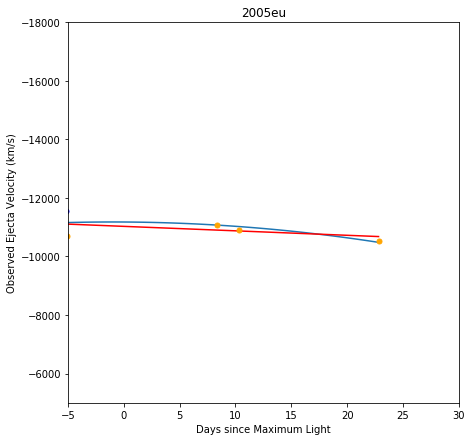

2005kc [u'sn2005kc-20051203.188-deimos.flm', u'sn2005kc-20051205.181-br.flm', u'sn2005kc-20051130.11-fast.flm', u'sn2005kc-20051203.17-fast.flm', u'sn2005kc-20051205.09-fast.flm', u'sn2005kc-20051209.08-fast.flm', u'sn2005kc-20051223.08-fast.flm', u'SN05kc_051124_b01_DUP_MS.dat', u'SN05kc_051125_b01_DUP_MS.dat', u'SN05kc_051222_b01_DUP_WF.dat']


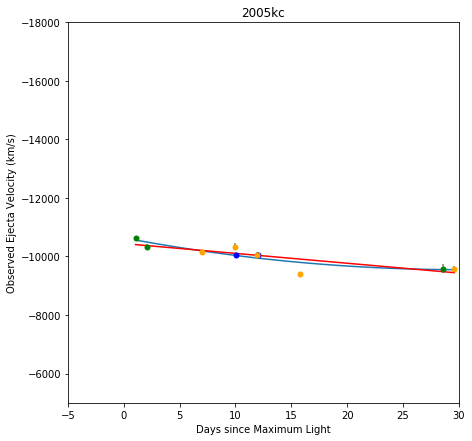

2005na [u'sn2005na-20060105.335-ui.flm', u'sn2005na-20060106.361-ui-corrected.flm', u'sn2005na-20060123.255-ui-corrected.flm', u'sn2005na-20060130.320-ui-corrected.flm', u'sn2005na-20060104.34-fast.flm', u'sn2005na-20060107.32-fast.flm', u'sn2005na-20060109.43-fast.flm', u'sn2005na-20060122.27-fast.flm', u'sn2005na-20060126.39-fast.flm', u'sn2005na-20060130.24-fast.flm', u'SN05na_060116_g01_NTT_EM.dat', u'SN05na_060124_g01_CLA_LD.dat']


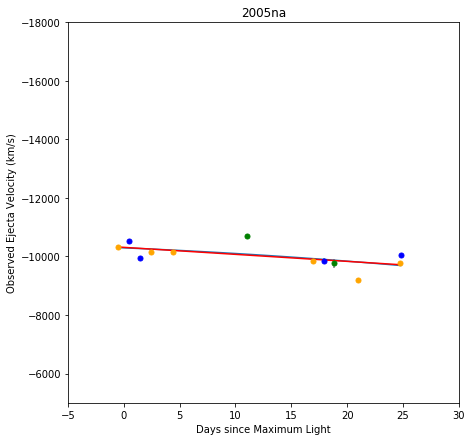

2006ax [u'sn2006ax-20060322.396-ui.flm', u'sn2006ax-20060428.224-ui.flm', u'sn2006ax-20060323.31-fast.flm', u'sn2006ax-20060324.30-fast.flm', u'sn2006ax-20060326.29-fast.flm', u'sn2006ax-20060402.30-fast.flm', u'SN06ax_060322_b01_DUP_WF.dat', u'SN06ax_060323_b01_DUP_WF.dat', u'SN06ax_060324_b01_DUP_WF.dat', u'SN06ax_060330_b01_DUP_WF.dat', u'SN06ax_060331_b01_DUP_WF.dat', u'SN06ax_060402_b01_DUP_WF.dat', u'SN06ax_060416_b01_BAA_IM.dat', u'SN06ax_060421_b01_DUP_WF.dat']


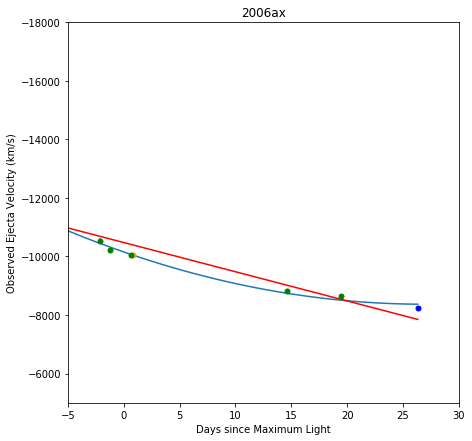

2006bt [u'sn2006bt-20060428.425-ui.flm', u'sn2006bt-20060505.444-ui.flm', u'sn2006bt-20060429.41-fast.flm', u'sn2006bt-20060501.39-fast.flm', u'sn2006bt-20060504.35-fast.flm', u'sn2006bt-20060505.27-fast.flm', u'sn2006bt-20060507.30-fast.flm', u'sn2006bt-20060508.31-fast.flm', u'sn2006bt-20060519.28-fast.flm']


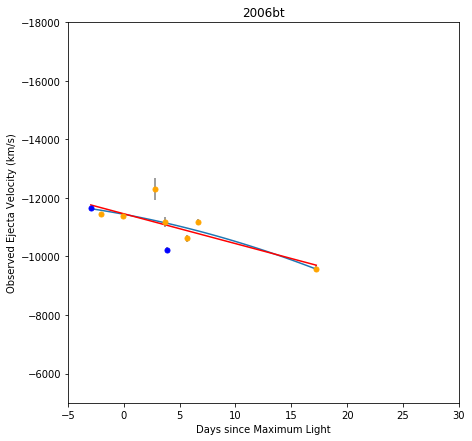

2006cf [u'sn2006cf-20060523.291-ui.flm', u'sn2006cf-20060528.299-ui.flm', u'sn2006cf-20060605.221-ui.flm', u'sn2006cf-20060519.25-fast.flm', u'sn2006cf-20060520.16-fast.flm', u'sn2006cf-20060521.27-fast.flm', u'sn2006cf-20060522.26-fast.flm', u'sn2006cf-20060524.21-fast.flm', u'sn2006cf-20060604.22-fast.flm']


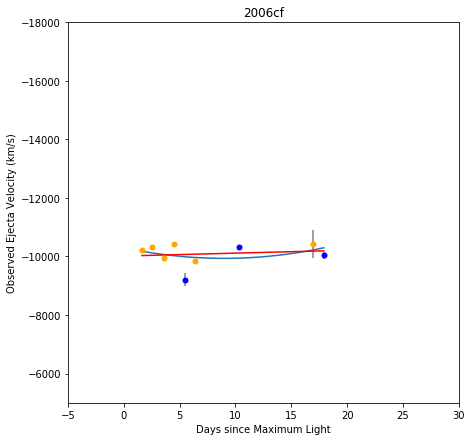

2006et [u'sn2006et-20060919.345-ui.flm', u'sn2006et-20060925.321-ui.flm', u'sn2006et-20060918.36-fast.flm', u'sn2006et-20060922.37-fast.flm', u'SN06et_060925_b01_DUP_WF.dat', u'SN06et_060926_b01_DUP_WF.dat', u'SN06et_061005_g01_NTT_EM.dat', u'SN06et_061011_b01_DUP_WF.dat']


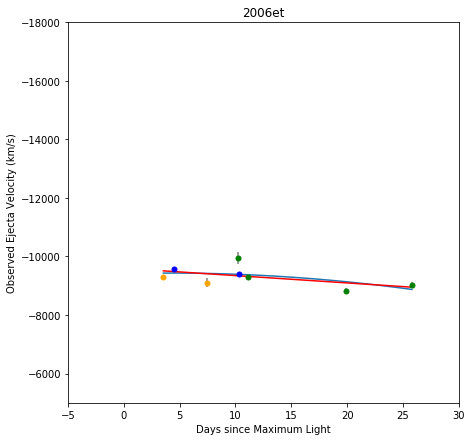

2006gj [u'sn2006gj-20060925.482-ui.flm', u'sn2006gj-20060920.43-fast.flm', u'sn2006gj-20060924.46-fast.flm', u'SN06gj_060925_b01_DUP_WF.dat', u'SN06gj_060927_b01_DUP_WF.dat', u'SN06gj_060928_b01_DUP_WF.dat', u'SN06gj_061005_g01_NTT_EM.dat', u'SN06gj_061007_b01_HIL_BC.dat', u'SN06gj_061011_b01_DUP_WF.dat', u'SN06gj_061016_b01_HIL_BC.dat']


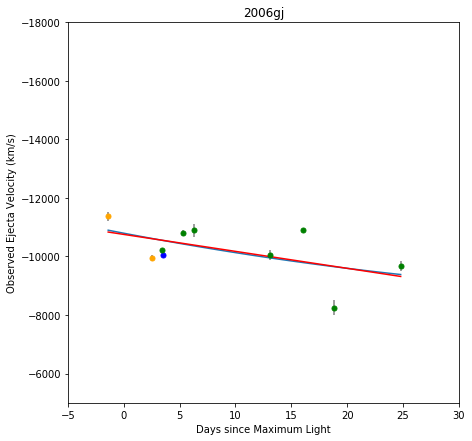

2006gr [u'sn2006gr-20060925.202-ui.flm', u'sn2006gr-20061024.150-ui.flm', u'sn2006gr-20061030.101-ui.flm', u'sn2006gr-20060923.22-fast.flm', u'sn2006gr-20060924.26-fast.flm', u'sn2006gr-20060925.23-fast.flm', u'sn2006gr-20060926.25-fast.flm', u'sn2006gr-20060927.30-fast.flm', u'sn2006gr-20060928.18-fast.flm', u'sn2006gr-20060929.13-fast.flm', u'sn2006gr-20060930.30-fast.flm', u'sn2006gr-20061002.26-fast.flm', u'sn2006gr-20061003.26-fast.flm', u'sn2006gr-20061014.14-fast.flm', u'sn2006gr-20061017.24-fast.flm', u'sn2006gr-20061023.18-fast.flm', u'sn2006gr-20061028.16-fast.flm', u'sn2006gr-20061029.23-fast.flm']


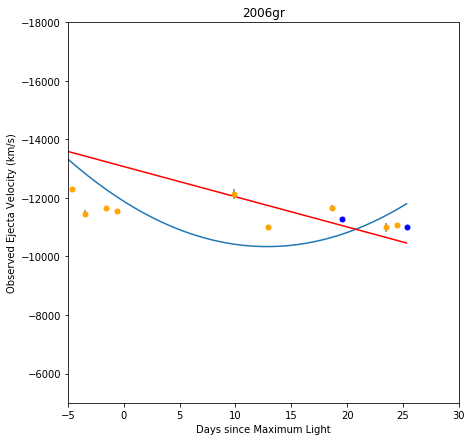

2006kf [u'sn2006kf-20061024.352-ui.flm', u'sn2006kf-20061030.385-ui.flm', u'sn2006kf-20061120.241-ui.flm', u'sn2006kf-20061027.39-fast.flm', u'SN06kf_061027_b01_DUP_WF.dat', u'SN06kf_061103_b01_HIL_BC.dat', u'SN06kf_061103_g01_NTT_EM.dat', u'SN06kf_061116_b01_DUP_WF.dat', u'SN06kf_061117_b01_HIL_BC.dat', u'SN06kf_061130_b01_HIL_BC.dat']


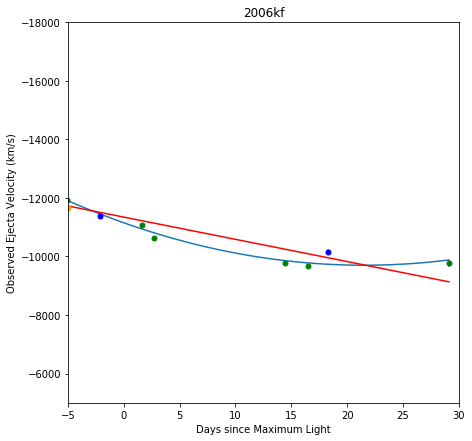

2006le [u'sn2006le-20061030.456-ui-corrected.flm', u'sn2006le-20061120.427-ui-corrected.flm', u'sn2006le-20061030.43-fast.flm', u'sn2006le-20061031.45-fast.flm', u'sn2006le-20061101.43-fast.flm', u'sn2006le-20061112.40-fast.flm', u'sn2006le-20061114.38-fast.flm', u'sn2006le-20061115.44-fast.flm', u'sn2006le-20061116.42-fast.flm', u'sn2006le-20061117.44-fast.flm', u'sn2006le-20061119.40-fast.flm', u'sn2006le-20061121.37-fast.flm', u'sn2006le-20061122.38-fast.flm', u'sn2006le-20061123.36-fast.flm', u'sn2006le-20061125.36-fast.flm']


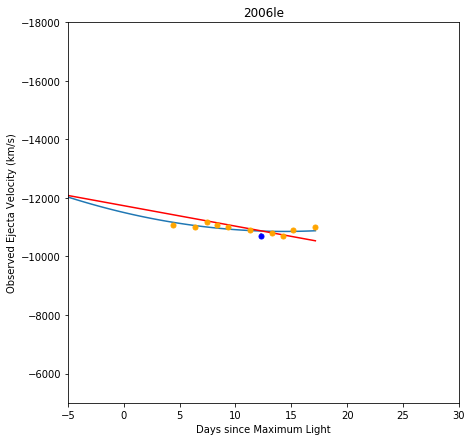

2006n [u'sn2006n-20060123.286-ui.flm', u'sn2006n-20060124.285-ui.flm', u'sn2006n-20060206.285-ui.flm', u'sn2006n-20060222.131-ui.flm', u'sn2006N-20060122.23-fast.flm', u'sn2006N-20060124.26-fast.flm', u'sn2006N-20060126.32-fast.flm', u'sn2006N-20060127.24-fast.flm', u'sn2006N-20060128.22-fast.flm', u'sn2006N-20060130.22-fast.flm', u'sn2006N-20060131.22-fast.flm', u'sn2006N-20060201.21-fast.flm', u'sn2006N-20060202.20-fast.flm', u'sn2006N-20060203.21-fast.flm', u'sn2006N-20060206.32-fast.flm', u'sn2006N-20060223.18-fast.flm']


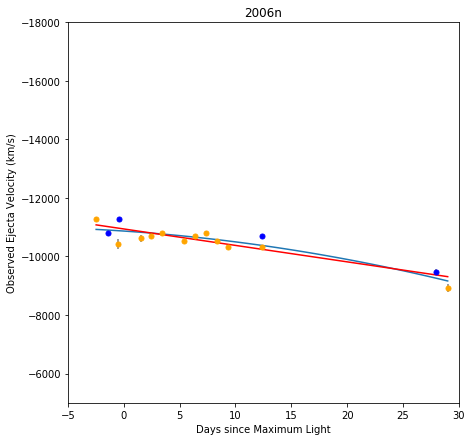

2006s [u'sn2006s-20060130.375-ui.flm', u'sn2006s-20060206.517-ui.flm', u'sn2006s-20060222.476-ui.flm', u'sn2006S-20060128.50-fast.flm', u'sn2006S-20060129.51-fast.flm', u'sn2006S-20060131.49-fast.flm', u'sn2006S-20060202.47-fast.flm', u'sn2006S-20060203.47-fast.flm', u'sn2006S-20060204.47-fast.flm', u'sn2006S-20060206.48-fast.flm', u'sn2006S-20060207.43-mmt.flm', u'sn2006S-20060224.39-fast.flm']


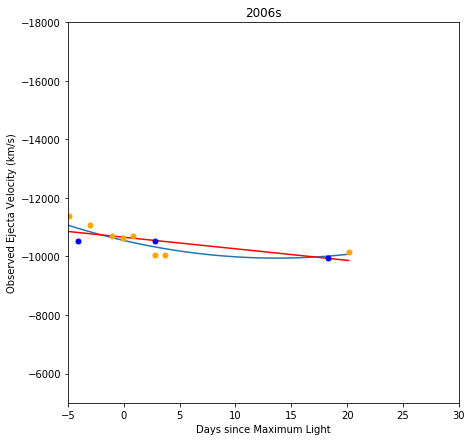

2006sr [u'sn2006sr-20061220.097-ui.flm', u'sn2006sr-20061225.242-br.flm', u'sn2006sr-20061222.12-fast.flm', u'sn2006sr-20061224.09-fast.flm', u'sn2006sr-20061225.12-fast.flm', u'sn2006sr-20061226.13-fast.flm', u'sn2006sr-20061227.09-fast.flm', u'sn2006sr-20070110.12-fast.flm']


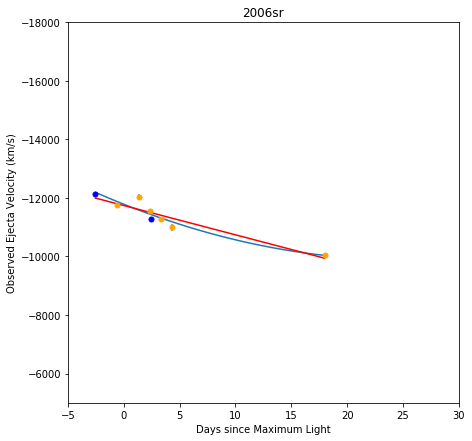

2007ca [u'sn2007ca-20070426.305-ui.flm', u'sn2007ca-20070524.291-ui-corrected.flm', u'sn2007ca-20070510.23-fast.flm', u'sn2007ca-20070512.27-fast.flm', u'sn2007ca-20070513.21-fast.flm', u'sn2007ca-20070516.26-fast.flm', u'sn2007ca-20070518.32-fast.flm', u'sn2007ca-20070520.22-fast.flm', u'SN07ca_070508_b01_BAA_IM.dat', u'SN07ca_070511_b01_DUP_BC.dat']


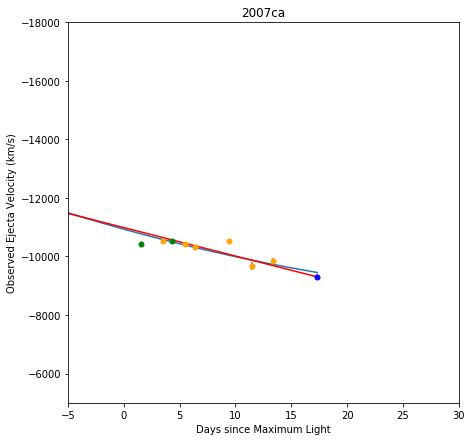

2007ci [u'sn2007ci-20070519.316-ui.flm', u'sn2007ci-20070524.264-ui-corrected.flm', u'sn2007ci-20070623.249-ui.flm', u'sn2007ci-20070518.20-fast.flm', u'sn2007ci-20070519.18-fast.flm', u'sn2007ci-20070520.20-fast.flm', u'sn2007ci-20070521.19-fast.flm', u'sn2007ci-20070522.19-fast.flm', u'sn2007ci-20070524.19-fast.flm', u'sn2007ci-20070525.19-fast.flm', u'sn2007ci-20070608.18-fast.flm', u'sn2007ci-20070612.19-fast.flm', u'sn2007ci-20070614.18-fast.flm', u'sn2007ci-20070617.20-fast.flm']


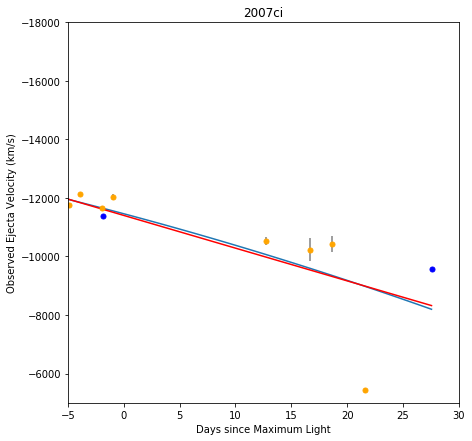

2007co [u'sn2007co-20070609.398-ui-corrected.flm', u'sn2007co-20070614.468-ui-corrected.flm', u'sn2007co-20070623.408-ui-corrected.flm', u'sn2007co-20070707.316-ui-corrected.flm', u'sn2007co-20070608.35-fast.flm', u'sn2007co-20070609.33-fast.flm', u'sn2007co-20070610.39-fast.flm', u'sn2007co-20070612.35-fast.flm', u'sn2007co-20070613.39-fast.flm', u'sn2007co-20070614.38-fast.flm', u'sn2007co-20070615.36-fast.flm', u'sn2007co-20070616.35-fast.flm', u'sn2007co-20070617.34-fast.flm', u'sn2007co-20070619.45-fast.flm', u'sn2007co-20070620.34-fast.flm', u'sn2007co-20070621.33-fast.flm', u'sn2007co-20070622.38-fast.flm', u'sn2007co-20070624.36-fast.flm', u'sn2007co-20070625.40-fast.flm']


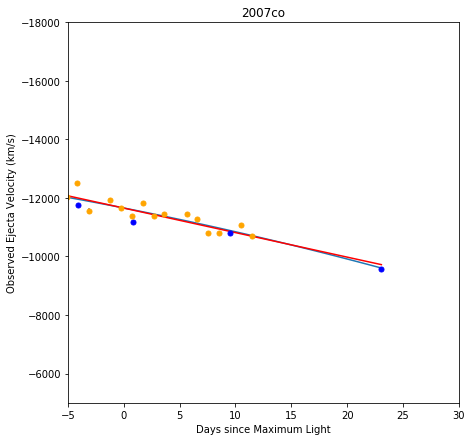

2007f [u'sn2007f-20070113.658-br.flm', u'sn2007f-20070126.534-ui.flm', u'sn2007f-20070218.420-ui.flm', u'sn2007F-20070114.49-fast.flm', u'sn2007F-20070115.53-fast.flm', u'sn2007F-20070116.54-fast.flm', u'sn2007F-20070117.53-fast.flm', u'sn2007F-20070121.55-fast.flm', u'sn2007F-20070122.49-fast.flm', u'sn2007F-20070126.43-fast.flm', u'sn2007F-20070210.39-fast.flm', u'sn2007F-20070219.43-fast.flm']


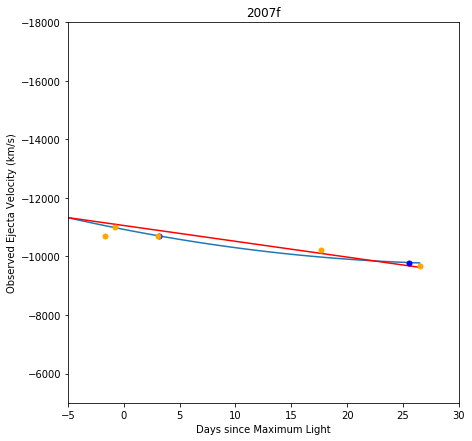

2007qe [u'sn2007qe-20071118.104-ui.flm', u'sn2007qe-20071201.176-ui.flm', u'sn2007qe-20071211.187-ui.flm', u'sn2007qe-20071115.28-fast.flm', u'sn2007qe-20071116.11-fast.flm', u'sn2007qe-20071203.12-fast.flm', u'sn2007qe-20071204.14-fast.flm', u'sn2007qe-20071206.15-fast.flm', u'sn2007qe-20071214.07-mmt.flm', u'sn2007qe-20071214.11-fast.flm', u'sn2007qe-20071216.12-fast.flm', u'sn2007qe-20071218.14-fast.flm']


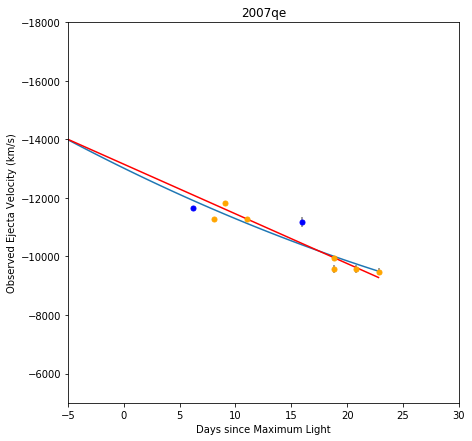

2007s [u'sn2007s-20070218.375-ui.flm', u'sn2007S-20070208.34-fast.flm', u'sn2007S-20070209.30-fast.flm', u'sn2007S-20070210.32-fast.flm', u'sn2007S-20070212.33-fast.flm', u'sn2007S-20070219.32-fast.flm', u'sn2007S-20070221.32-fast.flm', u'sn2007S-20070225.30-fast.flm', u'sn2007S-20070226.30-fast.flm', u'sn2007S-20070310.28-fast.flm']


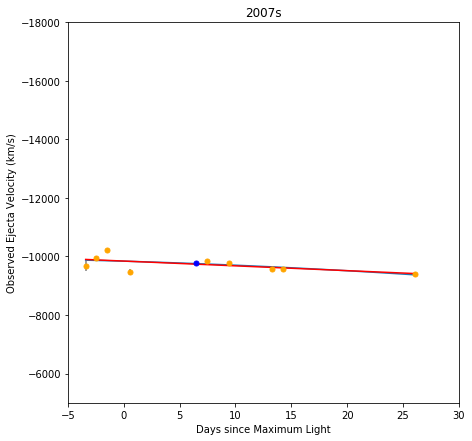

2008bf [u'sn2008bf-20080427-ui.flm', u'sn2008bf-20080330.31-fast.flm', u'sn2008bf-20080401.29-fast.flm', u'sn2008bf-20080402.35-fast.flm', u'sn2008bf-20080403.30-fast.flm', u'sn2008bf-20080406.29-fast.flm', u'sn2008bf-20080409.33-fast.flm', u'sn2008bf-20080410.28-fast.flm', u'sn2008bf-20080412.30-fast.flm', u'sn2008bf-20080415.24-fast.flm', u'SN08bf_080320_b01_CLA_LD.dat', u'SN08bf_080324_b01_CLA_LD.dat', u'SN08bf_080325_b01_CLA_LD.dat', u'SN08bf_080326_b01_CLA_LD.dat', u'SN08bf_080328_g01_NTT_EM.dat', u'SN08bf_080331_b01_DUP_WF.dat', u'SN08bf_080407_b01_DUP_WF.dat', u'SN08bf_080412_b01_DUP_WF.dat', u'SN08bf_080429_b01_DUP_WF.dat']


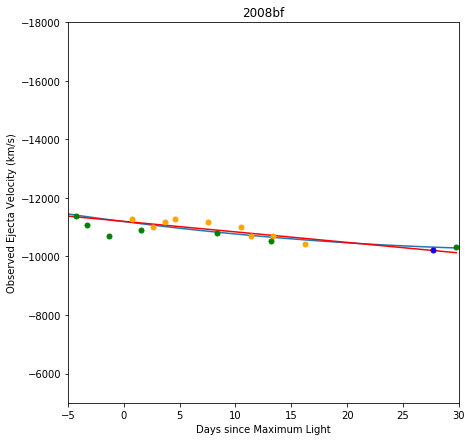

1997do [u'sn1997do-19971102.46-fast.flm', u'sn1997do-19971103.43-fast.flm', u'sn1997do-19971106.51-fast.flm', u'sn1997do-19971107.51-fast.flm', u'sn1997do-19971122.45-fast.flm', u'sn1997do-19971124.45-fast.flm', u'sn1997do-19971125.38-fast.flm', u'sn1997do-19971126.37-fast.flm', u'sn1997do-19971128.50-fast.flm', u'sn1997do-19971129.55-fast.flm', u'sn1997do-19971204.33-fast.flm', u'sn1997do-19971205.30-fast.flm', u'sn1997do-19971205.35-mmt.flm']


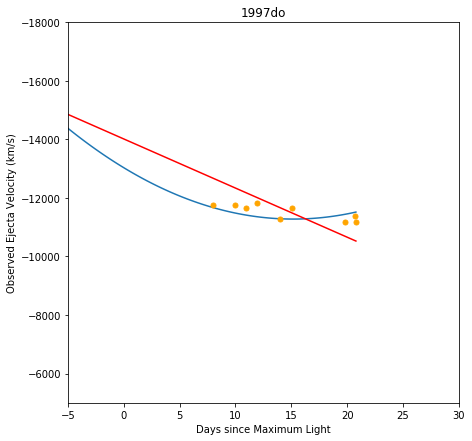

1998ab [u'sn1998ab-19980403.38-fast.flm', u'sn1998ab-19980418.28-fast.flm', u'sn1998ab-19980419.29-fast.flm', u'sn1998ab-19980429.28-fast.flm', u'sn1998ab-19980430.26-fast.flm', u'sn1998ab-19980501.27-fast.flm', u'sn1998ab-19980502.26-fast.flm', u'sn1998ab-19980503.26-fast.flm', u'sn1998ab-19980504.28-fast.flm']


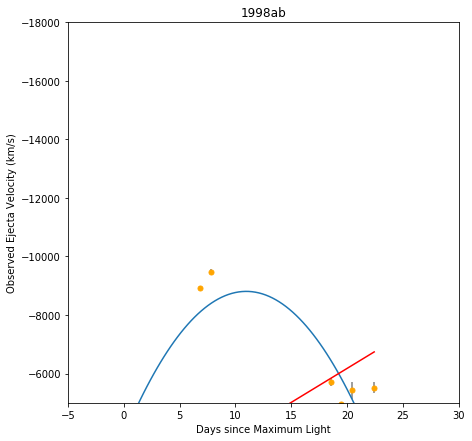

1998bp [u'sn1998bp-19980430.47-fast.flm', u'sn1998bp-19980501.47-fast.flm', u'sn1998bp-19980502.47-fast.flm', u'sn1998bp-19980503.45-fast.flm', u'sn1998bp-19980504.39-fast.flm', u'sn1998bp-19980528.47-fast.flm', u'sn1998bp-19980529.42-fast.flm', u'sn1998bp-19980531.40-fast.flm', u'sn1998bp-19980602.35-fast.flm']


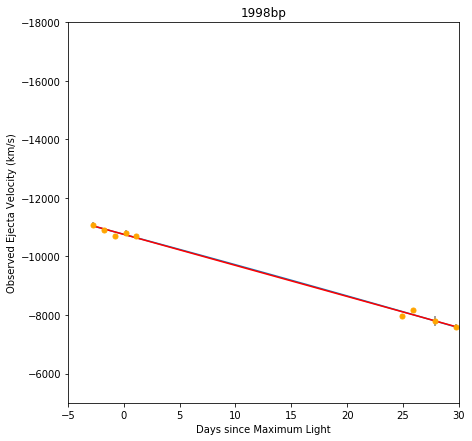

1999aa [u'sn1999aa-19990213.35-fast.flm', u'sn1999aa-19990214.33-fast.flm', u'sn1999aa-19990215.28-fast.flm', u'sn1999aa-19990216.24-fast.flm', u'sn1999aa-19990217.26-fast.flm', u'sn1999aa-19990218.25-fast.flm', u'sn1999aa-19990219.28-fast.flm', u'sn1999aa-19990220.29-fast.flm', u'sn1999aa-19990221.29-fast.flm', u'sn1999aa-19990223.25-fast.flm', u'sn1999aa-19990309.25-fast.flm', u'sn1999aa-19990310.23-fast.flm', u'sn1999aa-19990311.23-fast.flm', u'sn1999aa-19990312.29-fast.flm', u'sn1999aa-19990322.27-fast.flm', u'sn1999aa-19990323.19-fast.flm', u'sn1999aa-19990324.18-fast.flm', u'sn1999aa-19990325.12-fast.flm']


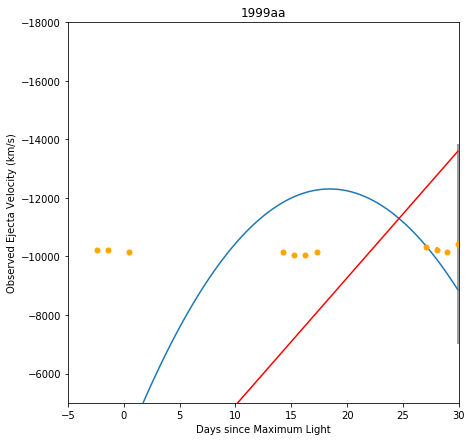

1999ac [u'sn1999ac-19990309.53-fast.flm', u'sn1999ac-19990310.53-fast.flm', u'sn1999ac-19990312.53-fast.flm', u'sn1999ac-19990322.51-fast.flm', u'sn1999ac-19990323.51-fast.flm', u'sn1999ac-19990324.51-fast.flm', u'sn1999ac-19990325.50-fast.flm', u'sn1999ac-19990407.46-fast.flm', u'sn1999ac-19990409.45-fast.flm', u'sn1999ac-19990411.48-fast.flm']


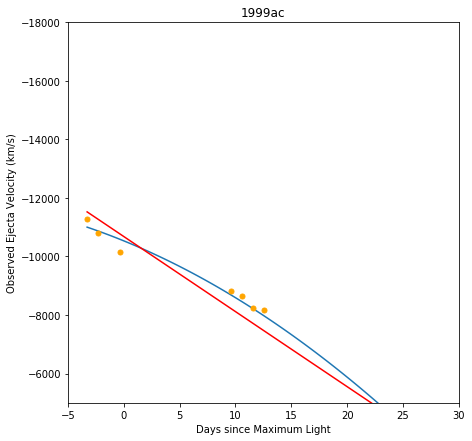

1999dq [u'sn1999dq-19990905.45-fast.flm', u'sn1999dq-19990906.43-fast.flm', u'sn1999dq-19990907.48-fast.flm', u'sn1999dq-19990908.48-fast.flm', u'sn1999dq-19990909.44-fast.flm', u'sn1999dq-19990910.44-fast.flm', u'sn1999dq-19990911.46-fast.flm', u'sn1999dq-19990912.51-fast.flm', u'sn1999dq-19990915.45-fast.flm', u'sn1999dq-19990916.45-fast.flm', u'sn1999dq-19990917.46-fast.flm', u'sn1999dq-19990918.45-fast.flm', u'sn1999dq-19990920.46-fast.flm', u'sn1999dq-19991002.47-fast.flm', u'sn1999dq-19991003.45-fast.flm', u'sn1999dq-19991011.45-fast.flm', u'sn1999dq-19991014.32-fast.flm']


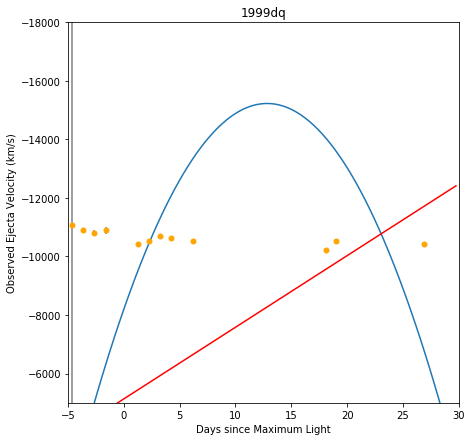

2000fa [u'sn2000fa-20001203.44-mmt.flm', u'sn2000fa-20001203.48-fast.flm', u'sn2000fa-20001215.36-fast.flm', u'sn2000fa-20001216.36-fast.flm', u'sn2000fa-20001218.38-fast.flm', u'sn2000fa-20001223.35-fast.flm', u'sn2000fa-20001225.42-fast.flm', u'sn2000fa-20001228.41-fast.flm', u'sn2000fa-20001230.43-fast.flm', u'sn2000fa-20010101.42-fast.flm', u'sn2000fa-20010104.36-fast.flm']


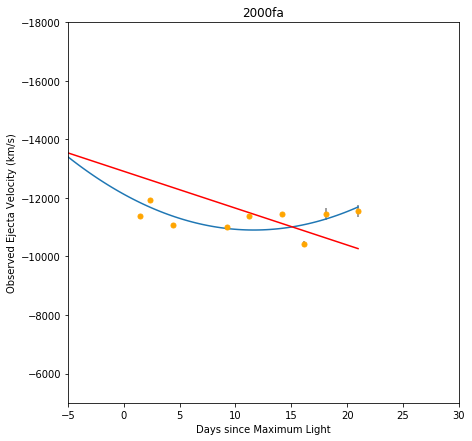

2001cp [u'sn2001cp-20010621.45-fast.flm', u'sn2001cp-20010623.44-fast.flm', u'sn2001cp-20010624.40-fast.flm', u'sn2001cp-20010627.26-fast.flm', u'sn2001cp-20010629.28-fast.flm', u'sn2001cp-20010715.25-fast.flm', u'sn2001cp-20010721.21-fast.flm', u'sn2001cp-20010725.26-fast.flm']


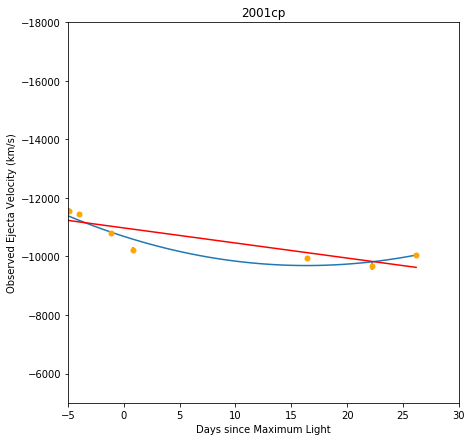

2001eh [u'sn2001eh-20010912.44-fast.flm', u'sn2001eh-20010915.42-fast.flm', u'sn2001eh-20010917.39-fast.flm', u'sn2001eh-20010920.33-fast.flm', u'sn2001eh-20010921.35-fast.flm', u'sn2001eh-20010922.35-fast.flm', u'sn2001eh-20010923.37-fast.flm', u'sn2001eh-20010926.37-fast.flm', u'sn2001eh-20011013.33-fast.flm', u'sn2001eh-20011014.32-fast.flm', u'sn2001eh-20011015.32-fast.flm', u'sn2001eh-20011017.33-fast.flm']


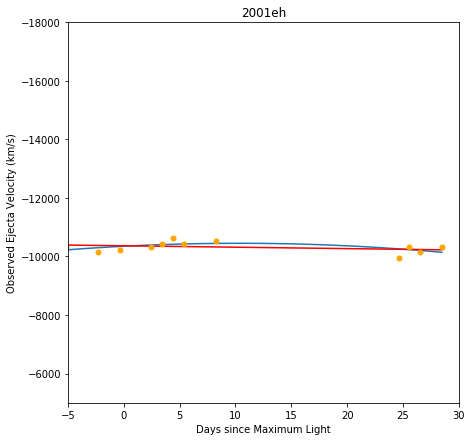

2001ep [u'sn2001ep-20011010.49-fast.flm', u'sn2001ep-20011014.45-fast.flm', u'sn2001ep-20011015.45-fast.flm', u'sn2001ep-20011016.45-fast.flm', u'sn2001ep-20011017.42-fast.flm', u'sn2001ep-20011018.43-fast.flm', u'sn2001ep-20011019.44-fast.flm', u'sn2001ep-20011020.44-fast.flm', u'sn2001ep-20011021.43-fast.flm', u'sn2001ep-20011022.43-fast.flm', u'sn2001ep-20011023.45-fast.flm', u'sn2001ep-20011024.43-fast.flm', u'sn2001ep-20011025.43-fast.flm', u'sn2001ep-20011107.39-fast.flm', u'sn2001ep-20011115.37-fast.flm']


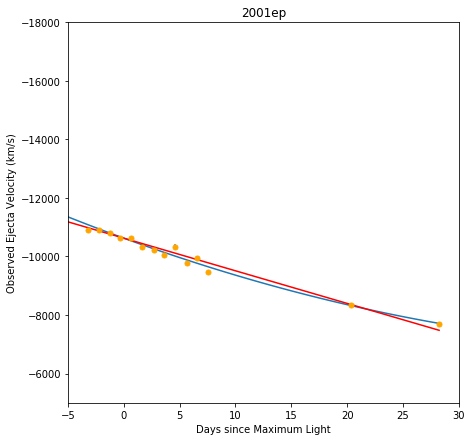

2001v [u'sn2001V-20010219.40-fast.flm', u'sn2001V-20010220.29-fast.flm', u'sn2001V-20010221.39-fast.flm', u'sn2001V-20010222.44-fast.flm', u'sn2001V-20010223.33-fast.flm', u'sn2001V-20010225.30-fast.flm', u'sn2001V-20010226.30-fast.flm', u'sn2001V-20010227.33-fast.flm', u'sn2001V-20010301.47-fast.flm', u'sn2001V-20010314.43-fast.flm', u'sn2001V-20010315.44-fast.flm', u'sn2001V-20010316.29-fast.flm', u'sn2001V-20010317.45-fast.flm', u'sn2001V-20010318.47-fast.flm', u'sn2001V-20010323.24-fast.flm', u'sn2001V-20010324.21-fast.flm', u'sn2001V-20010325.21-fast.flm', u'sn2001V-20010325.40-mmt.flm', u'sn2001V-20010326.24-fast.flm', u'sn2001V-20010326.47-mmt.flm', u'sn2001V-20010327.32-fast.flm', u'sn2001V-20010328.29-fast.flm', u'sn2001V-20010329.29-fast.flm', u'sn2001V-20010401.22-fast.flm', u'sn2001V-20010402.19-fast.flm']


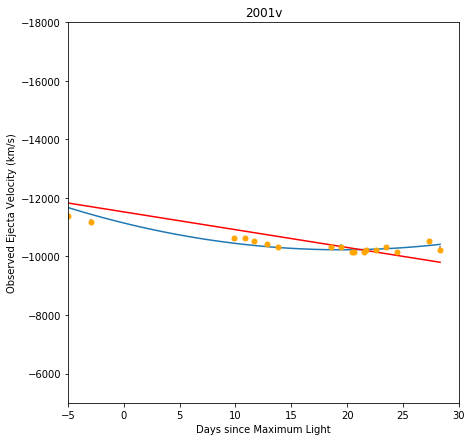

2002de [u'sn2002de-20020602.24-fast.flm', u'sn2002de-20020603.33-fast.flm', u'sn2002de-20020604.23-fast.flm', u'sn2002de-20020605.41-fast.flm', u'sn2002de-20020606.22-fast.flm', u'sn2002de-20020610.28-fast.flm', u'sn2002de-20020611.29-fast.flm', u'sn2002de-20020612.29-fast.flm', u'sn2002de-20020617.23-fast.flm', u'sn2002de-20020706.18-fast.flm']


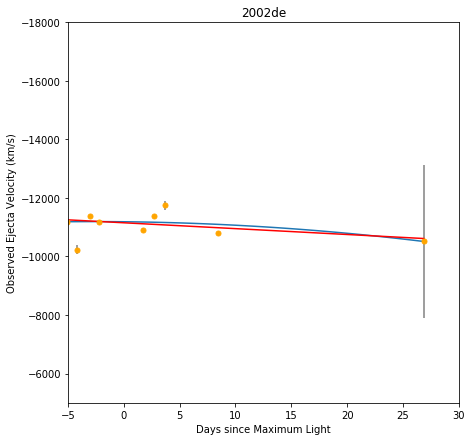

2002dj [u'sn2002dj-20020615.17-fast.flm', u'sn2002dj-20020617.17-fast.flm', u'sn2002dj-20020618.17-fast.flm', u'sn2002dj-20020619.18-fast.flm', u'sn2002dj-20020705.18-fast.flm', u'sn2002dj-20020712.17-fast.flm', u'2002dj_20020613_3256_9273_00.dat', u'2002dj_20020614_3745_9776_00.dat', u'2002dj_20020615_3307_9271_00.dat', u'2002dj_20020616_3343_9272_00.dat', u'2002dj_20020618_3256_9271_00.dat', u'2002dj_20020620_3210_9231_00.dat', u'2002dj_20020621_3255_9271_00.dat', u'2002dj_20020703_3397_9281_00.dat', u'2002dj_20020704_3340_10256_00.dat', u'2002dj_20020707_3201_9077_00.dat', u'2002dj_20020711_3304_10259_00.dat', u'2002dj_20020716_3300_9077_00.dat', u'2002dj_20020725_3741_10264_00.dat']


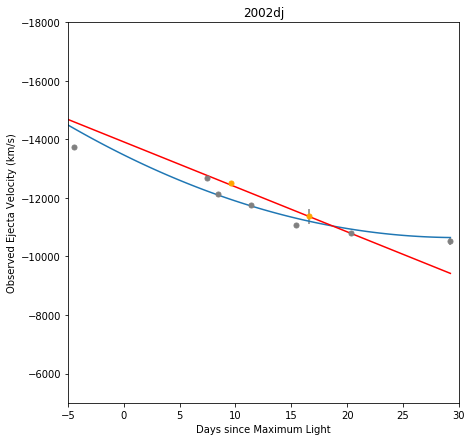

2002jy [u'sn2002jy-20021226.12-fast.flm', u'sn2002jy-20021227.11-fast.flm', u'sn2002jy-20021229.08-fast.flm', u'sn2002jy-20030101.10-fast.flm', u'sn2002jy-20030102.12-fast.flm', u'sn2002jy-20030103.12-fast.flm', u'sn2002jy-20030105.11-fast.flm', u'sn2002jy-20030111.08-fast.flm', u'sn2002jy-20030113.10-fast.flm']


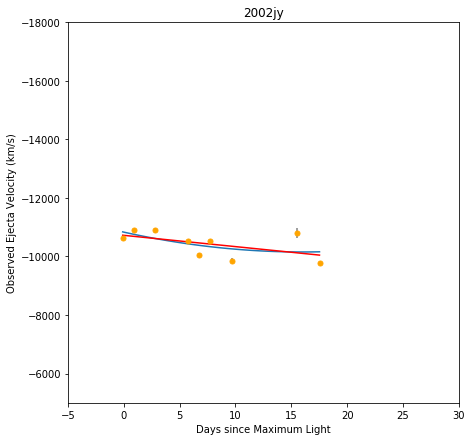

2002kf [u'sn2002kf-20021231.34-fast.flm', u'sn2002kf-20030101.39-fast.flm', u'sn2002kf-20030102.35-fast.flm', u'sn2002kf-20030103.31-fast.flm', u'sn2002kf-20030105.30-fast.flm', u'sn2002kf-20030107.30-fast.flm', u'sn2002kf-20030111.16-fast.flm', u'sn2002kf-20030113.31-fast.flm', u'sn2002kf-20030127.21-fast.flm', u'sn2002kf-20030129.21-fast.flm', u'sn2002kf-20030129.28-mmt.flm']


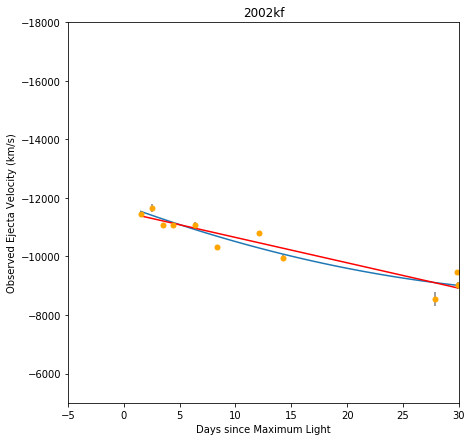

2003ch [u'sn2003ch-20030325.16-fast.flm', u'sn2003ch-20030327.13-fast.flm', u'sn2003ch-20030328.14-fast.flm', u'sn2003ch-20030329.11-mmt.flm', u'sn2003ch-20030329.17-fast.flm', u'sn2003ch-20030330.16-fast.flm', u'sn2003ch-20030331.15-fast.flm', u'sn2003ch-20030401.17-fast.flm', u'sn2003ch-20030402.03-ldss2.flm', u'sn2003ch-20030403.16-fast.flm', u'sn2003ch-20030410.17-fast.flm', u'sn2003ch-20030411.18-fast.flm']


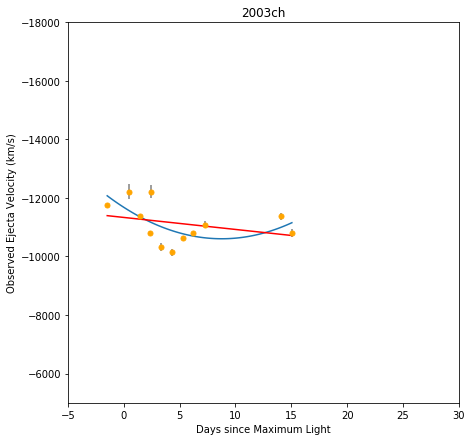

2003fa [u'sn2003fa-20030605.42-fast.flm', u'sn2003fa-20030606.36-fast.flm', u'sn2003fa-20030607.34-fast.flm', u'sn2003fa-20030608.29-fast.flm', u'sn2003fa-20030609.38-fast.flm', u'sn2003fa-20030610.34-mmt.flm', u'sn2003fa-20030623.33-fast.flm', u'sn2003fa-20030624.29-fast.flm', u'sn2003fa-20030625.30-fast.flm', u'sn2003fa-20030627.30-fast.flm', u'sn2003fa-20030628.23-fast.flm', u'sn2003fa-20030630.22-fast.flm', u'sn2003fa-20030701.39-fast.flm', u'sn2003fa-20030702.29-fast.flm', u'sn2003fa-20030703.38-fast.flm', u'sn2003fa-20030704.24-fast.flm', u'sn2003fa-20030704.46-mmt.flm', u'sn2003fa-20030705.41-mmt.flm', u'sn2003fa-20030706.28-fast.flm']


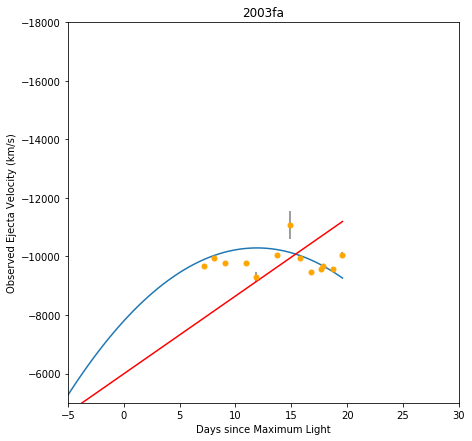

2003w [u'sn2003W-20030129.35-mmt.flm', u'sn2003W-20030130.31-fast.flm', u'sn2003W-20030131.39-fast.flm', u'sn2003W-20030201.35-fast.flm', u'sn2003W-20030202.30-fast.flm', u'sn2003W-20030203.33-fast.flm', u'sn2003W-20030204.27-fast.flm', u'sn2003W-20030206.32-fast.flm', u'sn2003W-20030207.40-fast.flm', u'sn2003W-20030209.35-fast.flm', u'sn2003W-20030210.35-fast.flm', u'sn2003W-20030303.37-fast.flm', u'sn2003W-20030307.28-fast.flm', u'sn2003W-20030310.28-fast.flm', u'sn2003W-20030312.27-fast.flm']


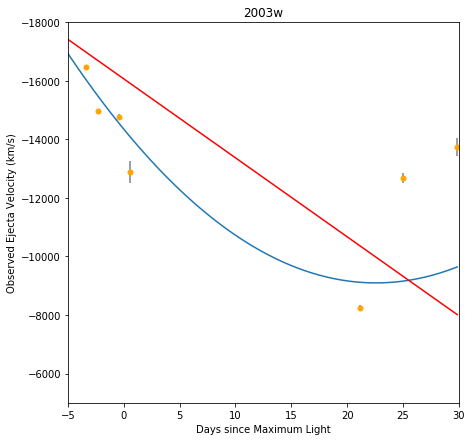

2004as [u'sn2004as-20040313.30-fast.flm', u'sn2004as-20040314.32-fast.flm', u'sn2004as-20040315.31-fast.flm', u'sn2004as-20040316.35-fast.flm', u'sn2004as-20040317.39-fast.flm', u'sn2004as-20040318.36-fast.flm', u'sn2004as-20040319.28-fast.flm', u'sn2004as-20040320.38-fast.flm', u'sn2004as-20040321.27-fast.flm', u'sn2004as-20040323.26-fast.flm', u'sn2004as-20040324.34-fast.flm', u'sn2004as-20040327.35-fast.flm', u'sn2004as-20040328.22-fast.flm', u'sn2004as-20040329.23-fast.flm', u'sn2004as-20040330.24-fast.flm', u'sn2004as-20040416.27-fast.flm', u'sn2004as-20040419.26-fast.flm']


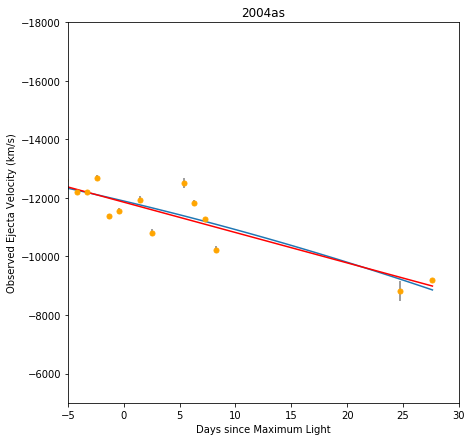

2004gs [u'sn2004gs-20041213.44-fast.flm', u'sn2004gs-20041215.48-fast.flm', u'sn2004gs-20041216.49-fast.flm', u'sn2004gs-20041218.46-fast.flm', u'sn2004gs-20041219.42-fast.flm', u'sn2004gs-20041220.44-fast.flm', u'sn2004gs-20050106.40-fast.flm', u'sn2004gs-20050109.38-fast.flm', u'SN04gs_041213_b01_DUP_WF.dat', u'SN04gs_041219_b01_CLA_LD.dat']


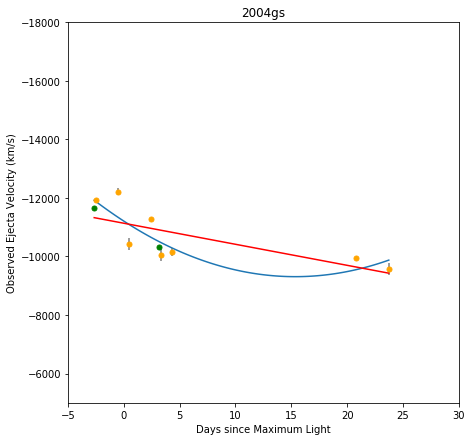

2004l [u'sn2004L-20040127.40-fast.flm', u'sn2004L-20040128.37-fast.flm', u'sn2004L-20040130.33-fast.flm', u'sn2004L-20040214.46-fast.flm', u'sn2004L-20040216.35-fast.flm', u'sn2004L-20040217.35-fast.flm', u'sn2004L-20040218.33-fast.flm', u'sn2004L-20040220.29-fast.flm', u'sn2004L-20040221.36-fast.flm', u'sn2004L-20040222.30-fast.flm']


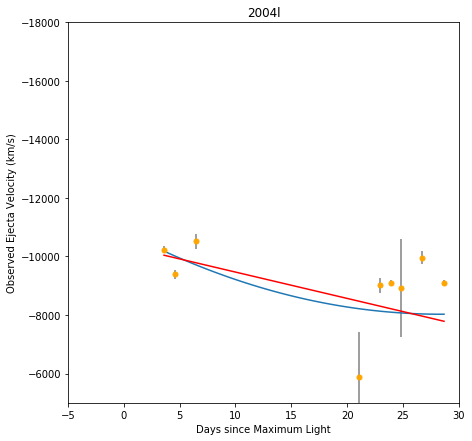

2005el [u'sn2005el-20050927.47-fast.flm', u'sn2005el-20050928.47-fast.flm', u'sn2005el-20050929.48-fast.flm', u'sn2005el-20051005.49-fast.flm', u'sn2005el-20051007.48-fast.flm', u'sn2005el-20051026.50-fast.flm', u'SN05el_050926_b01_DUP_WF.dat', u'SN05el_050927_b01_DUP_WF.dat', u'SN05el_051005_b01_DUP_WF.dat', u'SN05el_051018_g01_NTT_EM.dat']


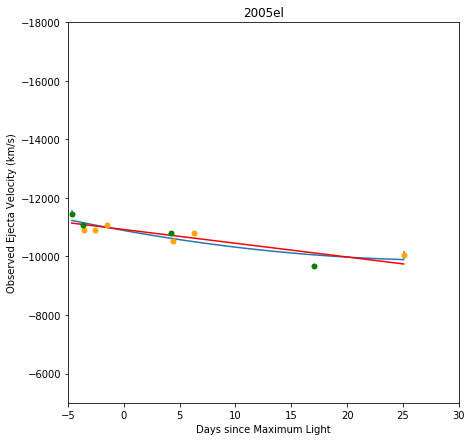

2005eq [u'sn2005eq-20051002.51-fast.flm', u'sn2005eq-20051005.41-fast.flm', u'sn2005eq-20051007.40-fast.flm', u'sn2005eq-20051009.42-fast.flm', u'sn2005eq-20051011.39-fast.flm', u'sn2005eq-20051012.33-fast.flm', u'sn2005eq-20051025.38-fast.flm', u'sn2005eq-20051028.34-fast.flm', u'sn2005eq-20051107.38-fast.flm', u'SN05eq_051005_b01_DUP_WF.dat', u'SN05eq_051018_g01_NTT_EM.dat']


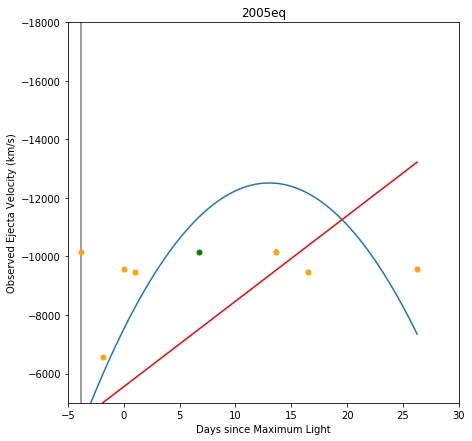

2005kc [u'sn2005kc-20051130.11-fast.flm', u'sn2005kc-20051203.17-fast.flm', u'sn2005kc-20051205.09-fast.flm', u'sn2005kc-20051209.08-fast.flm', u'sn2005kc-20051223.08-fast.flm', u'SN05kc_051124_b01_DUP_MS.dat', u'SN05kc_051125_b01_DUP_MS.dat', u'SN05kc_051222_b01_DUP_WF.dat']


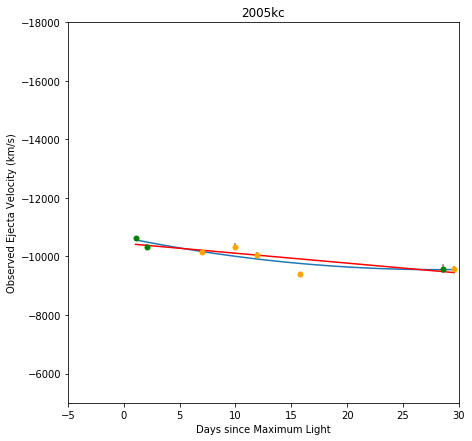

2005na [u'sn2005na-20060104.34-fast.flm', u'sn2005na-20060107.32-fast.flm', u'sn2005na-20060109.43-fast.flm', u'sn2005na-20060122.27-fast.flm', u'sn2005na-20060126.39-fast.flm', u'sn2005na-20060130.24-fast.flm', u'SN05na_060116_g01_NTT_EM.dat', u'SN05na_060124_g01_CLA_LD.dat']


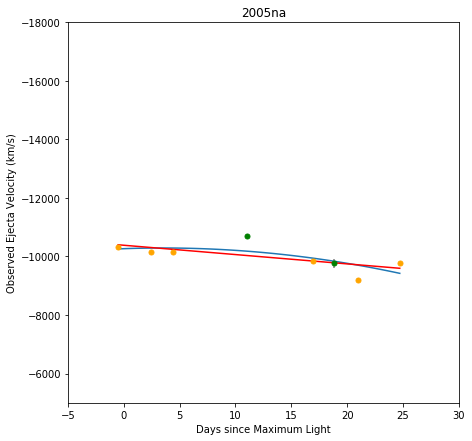

2006ax [u'sn2006ax-20060323.31-fast.flm', u'sn2006ax-20060324.30-fast.flm', u'sn2006ax-20060326.29-fast.flm', u'sn2006ax-20060402.30-fast.flm', u'SN06ax_060322_b01_DUP_WF.dat', u'SN06ax_060323_b01_DUP_WF.dat', u'SN06ax_060324_b01_DUP_WF.dat', u'SN06ax_060330_b01_DUP_WF.dat', u'SN06ax_060331_b01_DUP_WF.dat', u'SN06ax_060402_b01_DUP_WF.dat', u'SN06ax_060416_b01_BAA_IM.dat', u'SN06ax_060421_b01_DUP_WF.dat']


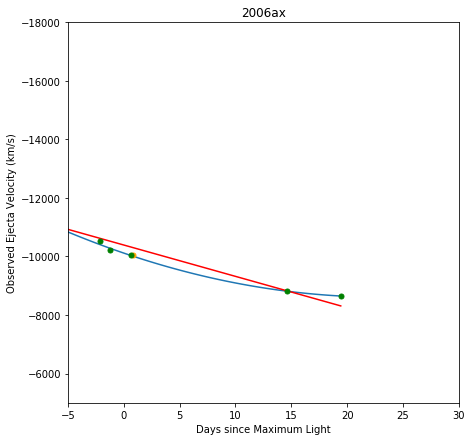

2006gj [u'sn2006gj-20060920.43-fast.flm', u'sn2006gj-20060924.46-fast.flm', u'SN06gj_060925_b01_DUP_WF.dat', u'SN06gj_060927_b01_DUP_WF.dat', u'SN06gj_060928_b01_DUP_WF.dat', u'SN06gj_061005_g01_NTT_EM.dat', u'SN06gj_061007_b01_HIL_BC.dat', u'SN06gj_061011_b01_DUP_WF.dat', u'SN06gj_061016_b01_HIL_BC.dat']


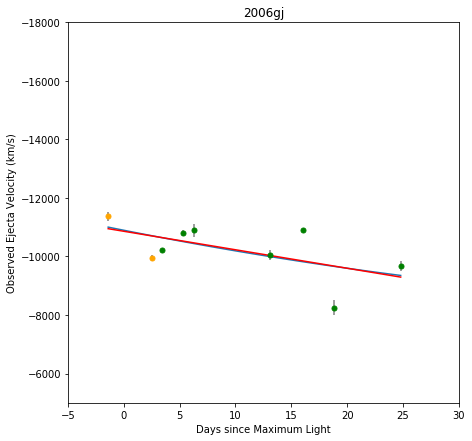

2006gr [u'sn2006gr-20060923.22-fast.flm', u'sn2006gr-20060924.26-fast.flm', u'sn2006gr-20060925.23-fast.flm', u'sn2006gr-20060926.25-fast.flm', u'sn2006gr-20060927.30-fast.flm', u'sn2006gr-20060928.18-fast.flm', u'sn2006gr-20060929.13-fast.flm', u'sn2006gr-20060930.30-fast.flm', u'sn2006gr-20061002.26-fast.flm', u'sn2006gr-20061003.26-fast.flm', u'sn2006gr-20061014.14-fast.flm', u'sn2006gr-20061017.24-fast.flm', u'sn2006gr-20061023.18-fast.flm', u'sn2006gr-20061028.16-fast.flm', u'sn2006gr-20061029.23-fast.flm']


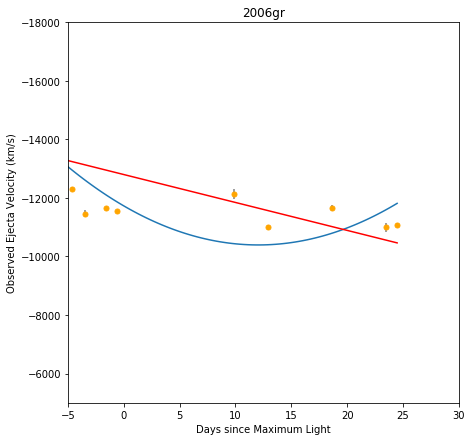

2006le [u'sn2006le-20061030.43-fast.flm', u'sn2006le-20061031.45-fast.flm', u'sn2006le-20061101.43-fast.flm', u'sn2006le-20061112.40-fast.flm', u'sn2006le-20061114.38-fast.flm', u'sn2006le-20061115.44-fast.flm', u'sn2006le-20061116.42-fast.flm', u'sn2006le-20061117.44-fast.flm', u'sn2006le-20061119.40-fast.flm', u'sn2006le-20061121.37-fast.flm', u'sn2006le-20061122.38-fast.flm', u'sn2006le-20061123.36-fast.flm', u'sn2006le-20061125.36-fast.flm']


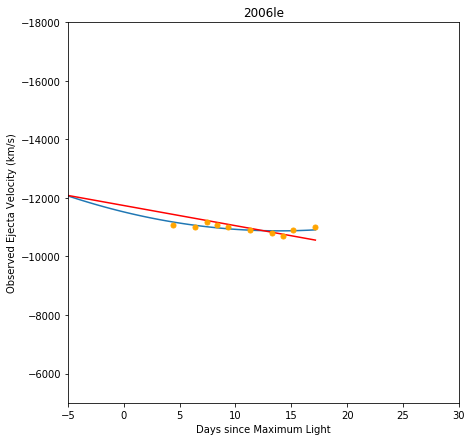

2006n [u'sn2006N-20060122.23-fast.flm', u'sn2006N-20060124.26-fast.flm', u'sn2006N-20060126.32-fast.flm', u'sn2006N-20060127.24-fast.flm', u'sn2006N-20060128.22-fast.flm', u'sn2006N-20060130.22-fast.flm', u'sn2006N-20060131.22-fast.flm', u'sn2006N-20060201.21-fast.flm', u'sn2006N-20060202.20-fast.flm', u'sn2006N-20060203.21-fast.flm', u'sn2006N-20060206.32-fast.flm', u'sn2006N-20060223.18-fast.flm']


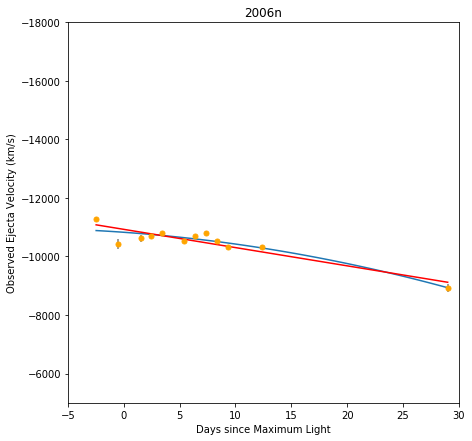

2006s [u'sn2006S-20060128.50-fast.flm', u'sn2006S-20060129.51-fast.flm', u'sn2006S-20060131.49-fast.flm', u'sn2006S-20060202.47-fast.flm', u'sn2006S-20060203.47-fast.flm', u'sn2006S-20060204.47-fast.flm', u'sn2006S-20060206.48-fast.flm', u'sn2006S-20060207.43-mmt.flm', u'sn2006S-20060224.39-fast.flm']


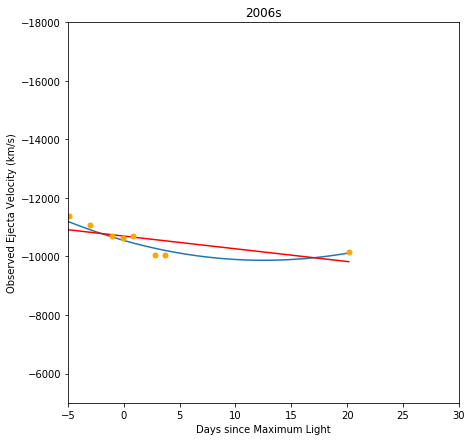

2007ci [u'sn2007ci-20070518.20-fast.flm', u'sn2007ci-20070519.18-fast.flm', u'sn2007ci-20070520.20-fast.flm', u'sn2007ci-20070521.19-fast.flm', u'sn2007ci-20070522.19-fast.flm', u'sn2007ci-20070524.19-fast.flm', u'sn2007ci-20070525.19-fast.flm', u'sn2007ci-20070608.18-fast.flm', u'sn2007ci-20070612.19-fast.flm', u'sn2007ci-20070614.18-fast.flm', u'sn2007ci-20070617.20-fast.flm']


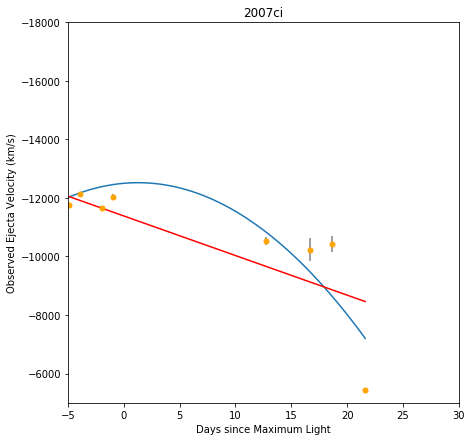

2007f [u'sn2007F-20070114.49-fast.flm', u'sn2007F-20070115.53-fast.flm', u'sn2007F-20070116.54-fast.flm', u'sn2007F-20070117.53-fast.flm', u'sn2007F-20070121.55-fast.flm', u'sn2007F-20070122.49-fast.flm', u'sn2007F-20070126.43-fast.flm', u'sn2007F-20070210.39-fast.flm', u'sn2007F-20070219.43-fast.flm']


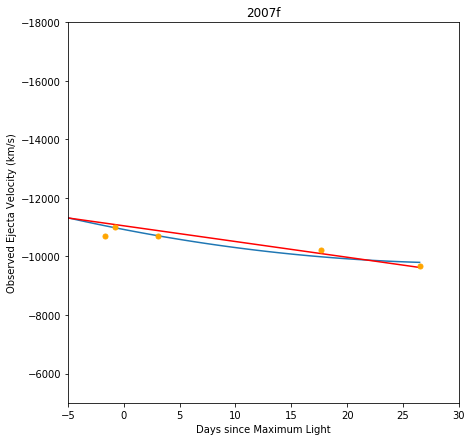

2007qe [u'sn2007qe-20071115.28-fast.flm', u'sn2007qe-20071116.11-fast.flm', u'sn2007qe-20071203.12-fast.flm', u'sn2007qe-20071204.14-fast.flm', u'sn2007qe-20071206.15-fast.flm', u'sn2007qe-20071214.07-mmt.flm', u'sn2007qe-20071214.11-fast.flm', u'sn2007qe-20071216.12-fast.flm', u'sn2007qe-20071218.14-fast.flm']


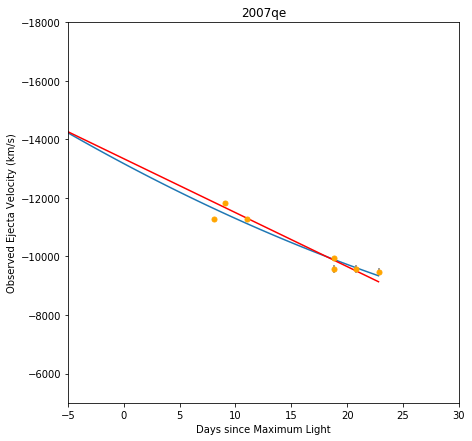

2007s [u'sn2007S-20070208.34-fast.flm', u'sn2007S-20070209.30-fast.flm', u'sn2007S-20070210.32-fast.flm', u'sn2007S-20070212.33-fast.flm', u'sn2007S-20070219.32-fast.flm', u'sn2007S-20070221.32-fast.flm', u'sn2007S-20070225.30-fast.flm', u'sn2007S-20070226.30-fast.flm', u'sn2007S-20070310.28-fast.flm']


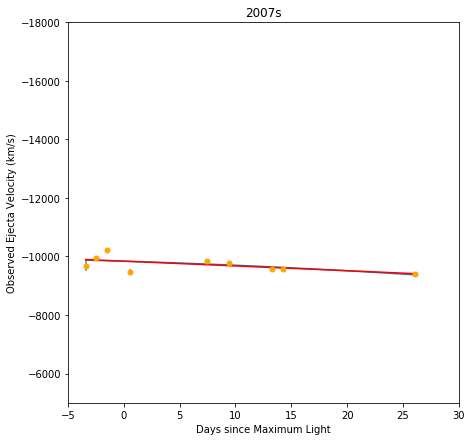

2008bf [u'sn2008bf-20080330.31-fast.flm', u'sn2008bf-20080401.29-fast.flm', u'sn2008bf-20080402.35-fast.flm', u'sn2008bf-20080403.30-fast.flm', u'sn2008bf-20080406.29-fast.flm', u'sn2008bf-20080409.33-fast.flm', u'sn2008bf-20080410.28-fast.flm', u'sn2008bf-20080412.30-fast.flm', u'sn2008bf-20080415.24-fast.flm', u'SN08bf_080320_b01_CLA_LD.dat', u'SN08bf_080324_b01_CLA_LD.dat', u'SN08bf_080325_b01_CLA_LD.dat', u'SN08bf_080326_b01_CLA_LD.dat', u'SN08bf_080328_g01_NTT_EM.dat', u'SN08bf_080331_b01_DUP_WF.dat', u'SN08bf_080407_b01_DUP_WF.dat', u'SN08bf_080412_b01_DUP_WF.dat', u'SN08bf_080429_b01_DUP_WF.dat']


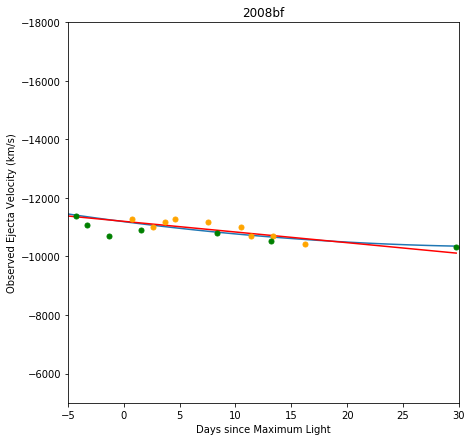

2006ax [u'SN06ax_060322_b01_DUP_WF.dat', u'SN06ax_060323_b01_DUP_WF.dat', u'SN06ax_060324_b01_DUP_WF.dat', u'SN06ax_060330_b01_DUP_WF.dat', u'SN06ax_060331_b01_DUP_WF.dat', u'SN06ax_060402_b01_DUP_WF.dat', u'SN06ax_060416_b01_BAA_IM.dat', u'SN06ax_060421_b01_DUP_WF.dat']


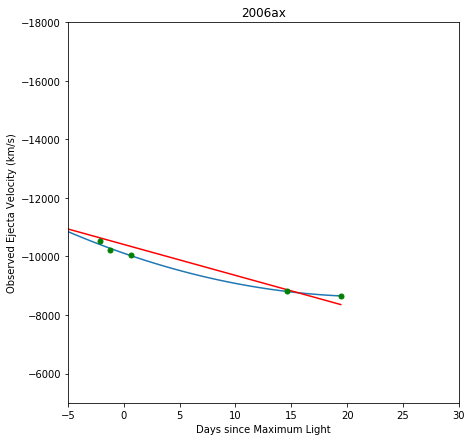

2008bf [u'SN08bf_080320_b01_CLA_LD.dat', u'SN08bf_080324_b01_CLA_LD.dat', u'SN08bf_080325_b01_CLA_LD.dat', u'SN08bf_080326_b01_CLA_LD.dat', u'SN08bf_080328_g01_NTT_EM.dat', u'SN08bf_080331_b01_DUP_WF.dat', u'SN08bf_080407_b01_DUP_WF.dat', u'SN08bf_080412_b01_DUP_WF.dat', u'SN08bf_080429_b01_DUP_WF.dat']


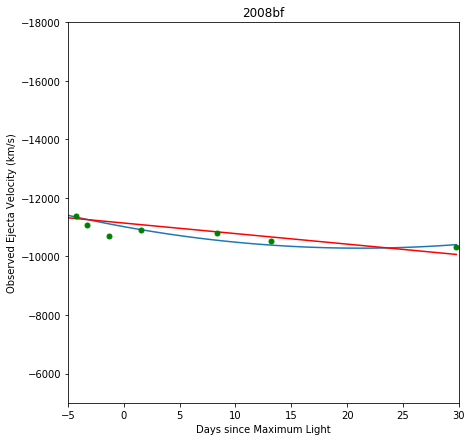

2002dj [u'2002dj_20020613_3256_9273_00.dat', u'2002dj_20020614_3745_9776_00.dat', u'2002dj_20020615_3307_9271_00.dat', u'2002dj_20020616_3343_9272_00.dat', u'2002dj_20020618_3256_9271_00.dat', u'2002dj_20020620_3210_9231_00.dat', u'2002dj_20020621_3255_9271_00.dat', u'2002dj_20020703_3397_9281_00.dat', u'2002dj_20020704_3340_10256_00.dat', u'2002dj_20020707_3201_9077_00.dat', u'2002dj_20020711_3304_10259_00.dat', u'2002dj_20020716_3300_9077_00.dat', u'2002dj_20020725_3741_10264_00.dat']


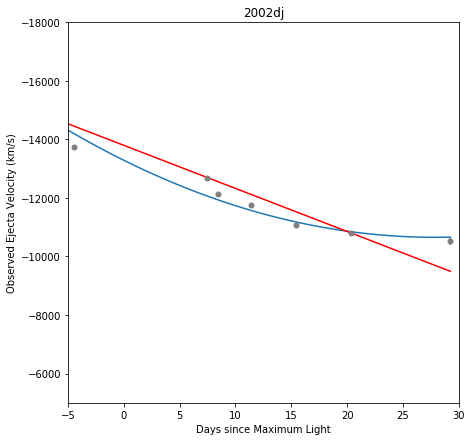

In [42]:
for object in ab_data_events:
    print object.name, object.files
    
    #print object.sources
    color_data = []
    for entry in object.sources:
        color_code = color(entry)
        color_data.append(color_code)
    
    #print color_data
    x = object.phases
    y = object.velocities
    
    coeff = np.polyfit(x, y, 2)
    coeff_lin = np.polyfit(x, y, 1)
    x_fit = np.linspace(np.min(x), np.max(x), 100)
    
    plt.figure(figsize=(7,7))
    plt.title(object.name)
    plt.xlabel("Days since Maximum Light")
    plt.ylabel("Observed Ejecta Velocity (km/s)")
    ax = plt.gca()
    ax.set_ylim([-18000, -5000])
    ax.set_xlim([-5, 30])
    ax.invert_yaxis()
    
    
    plt.plot(x_fit, coeff[0]*x_fit**2 + coeff[1]*x_fit + coeff[2])
    plt.plot(x_fit, coeff_lin[0]*x_fit + coeff_lin[1], color='red')
    for i in range(len(x)):
        if y[i] < 0:
            
            plt.plot(x[i],y[i], "o",markersize=5,  color=color_data[i])
            plt.errorbar(x[i], y[i], object.errors[i], color = 'grey')
    plt.show()

# Creating v_0, vgrad, and intrinsic color files

In [116]:
v_0_names = []
v_0_data = []
v_0_phase = []
int_color_data = []

for object in SN_v_object_list:
    velocities = object.velocities
    phases = object.phases
    
    index = np.argmin(np.abs(phases))
    exp_phase = phases[index]
    sn_v_0 = v_0(velocities[index], exp_phase)
    B0V0 = intrinsic_color(sn_v_0)
    
    v_0_names.append(object.name)
    v_0_data.append(sn_v_0)
    int_color_data.append(B0V0)
    v_0_phase.append(exp_phase)
    
    
print v_0_names, v_0_data, int_color_data, v_0_phase

[u'1990o', u'1993ac', u'1994s', u'1995ac', u'1995e', u'1996bv', u'1997cn', u'1997do', u'1997e', u'1997y', u'1998de', u'1998dx', u'1998ef', u'1998v', u'1999aa', u'1999ac', u'1999cp', u'1999da', u'1999dk', u'1999dq', u'1999ee', u'1999ek', u'1999gd', u'2000ce', u'2000cn', u'2000dk', u'2000fa', u'2001az', u'2001ba', u'2001bf', u'2001cp', u'2001da', u'2001eh', u'2001en', u'2001ep', u'2001fe', u'2001fh', u'2001g', u'2001ic', u'2001n', u'2001v', u'2002bz', u'2002ck', u'2002cr', u'2002de', u'2002dj', u'2002do', u'2002dp', u'2002fb', u'2002g', u'2002ha', u'2002hd', u'2002he', u'2002hu', u'2002hw', u'2002jy', u'2002kf', u'2003cq', u'2003d', u'2003fa', u'2003iv', u'2003u', u'2003w', u'2004as', u'2004bg', u'2004eo', u'2004ey', u'2004gs', u'2004gu', u'2004s', u'2005ag', u'2005bo', u'2005dv', u'2005el', u'2005eq', u'2005eu', u'2005hc', u'2005hj', u'2005iq', u'2005kc', u'2005ki', u'2005ls', u'2005lz', u'2005mc', u'2005ms', u'2005na', u'2006ac', u'2006ak', u'2006ax', u'2006az', u'2006bq', u'2006bt', u

In [123]:
si_v_0_file = open("si_v0.txt", "w")
for n in range(0, len(v_0_names)):
    si_v_0_file.write(v_0_names[n] + " " + str(v_0_data[n]) + " " + str(int_color_data[n]) + " " + str(v_0_phase[n]) + "\n")
si_v_0_file.close()

In [124]:
vgrad_names = []
vgrads = []

for object in SN_v_object_list:
    phases = np.asarray(object.phases)
    #print phases
    velocities = np.asarray(object.velocities)
    #print velocities
    #print phases
    phase_range = np.where((phases > -6) & (phases < 10))
   #print phase_range[0]
    if len(phase_range[0]) >= 3:
        vgradv = velocities[phase_range[0]]
        vgradp = phases[phase_range[0]]
        
        vgrad = np.polyfit(vgradp, vgradv, 1)[0]
        #print object.name, vgrad
        vgrad_names.append(object.name)
        vgrads.append(vgrad)

In [125]:
si_vgrad_file = open("si_vgrad.txt", "w")
for n in range(0, len(vgrads)):
    si_vgrad_file.write(vgrad_names[n] + " " + str(vgrads[n]) + "\n")
si_vgrad_file.close()

# V_0 Calculation Analysis

In [ ]:
#let's analyze v at max light calculated for individual events with different phases

In [ ]:
for object in ab_data_events:
    velocities = object.velocities
    phases = object.phases
    
    #find the velocity closest to max light from data
    index = np.argmin(np.abs(phases))
    exp_v_0 = velocities[index]
    exp_phase = phases[index]
    
    v_0_dist = []
    
    for n in range(len(velocities)):
        v_0_point = v_0(velocities[n], phases[n])
        v_0_dist.append(v_0_point)
       
    print v_0_dist 
    print "The closest velocity to max light observed is", exp_v_0, "at a phase of", exp_phase
    plt.figure(figsize=(10,6))
    plt.xlabel("Days since Maximum Light")
    plt.ylabel("Calculated Velocity at Max Light divided by Observed v_0")
    plt.plot(phases, v_0_dist, "o")
    plt.plot(exp_phase, exp_v_0, "o", color="red")
    plt.axhline(y=exp_v_0, color='red', linewidth=.5)
    ax = plt.gca()
    ax.invert_yaxis()
    plt.show()

Velocity Gradient vs Si II Velocity at Max Light

In [ ]:
v_0_list = []
v_grad_list = []

for object in ab_data_events:
    velocities = object.velocities
    phases = object.phases
    
    #find the velocity closest to max light from data
    index = np.argmin(np.abs(phases))
    exp_v_0 = velocities[index]
    exp_phase = phases[index]
    
    v_grad = np.polyfit(phases, velocities, 1)[0]
    
    v_0_list.append(exp_v_0)
    v_grad_list.append(v_grad)

plt.figure(figsize=(8,8))    
plt.xlabel("si II Velocity at Max Light")
plt.ylabel("SI II Velocity Gradient")
ax = plt.gca()
ax.invert_xaxis()
plt.plot(v_0_list, v_grad_list,"o")

In [ ]:
plt.figure(figsize=(10,8))
plt.xlabel("Days since Maximum Light")
plt.ylabel("Calculated Velocity at Max Light divided by Observed v_0")
plt.axhline(y=1, color='red', linewidth=.5)
for object in ab_data_events:
    velocities = object.velocities
    phases = object.phases
    
    #find the velocity closest to max light from data
    index = np.argmin(np.abs(phases))
    exp_v_0 = velocities[index]
    exp_phase = phases[index]
    
    v_0_dist = []
    
    for n in range(len(velocities)):
        v_0_point = v_0(velocities[n], phases[n])
        v_0_dist.append(v_0_point)
        
    print "The closest velocity to max light observed is", exp_v_0, "at a phase of", exp_phase
    if exp_v_0 > -10500:
        colorcode = "red"
    else:
        colorcode = "blue"
    plt.plot(phases, v_0_dist / exp_v_0, "o",color=colorcode)
    #plt.plot(exp_phase, exp_v_0, "o", color="red")
    #plt.axhline(y=exp_v_0, color='red', linewidth=.5)
    #ax = plt.gca()
    #ax.invert_yaxis()
    #plt.show()

In [ ]:
len(ab_data_events)

# Fitting curve to evolution

In [105]:
# add calcium velocity analysis

# Calcium Velocity Analysis

In [29]:
ca_v_query = "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -5 and phase <= 15 and minwave <= 3400 and maxwave >= 4100"# and source != 'swift_uv'"

In [30]:
ca_v_SN_Array = composite.grab(ca_v_query, multi_epoch = True, make_corr = True)

172 questionable files currently ignored
30 questionable spectra removed 457 spectra left
4 Peculiar Ias removed 453 spectra left
(313, 'spectra with host corrections')
(313, 'valid SNe found')
Arrays cleaned


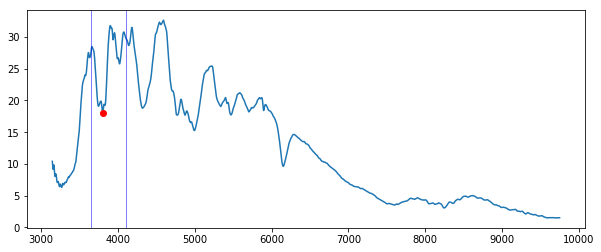

-11384.506329113925 7.23907849643


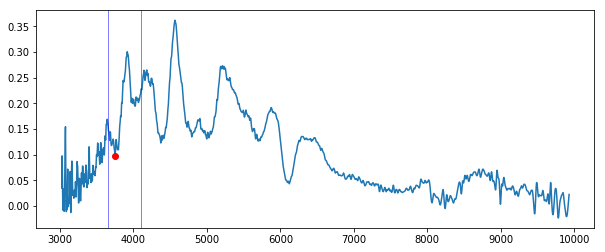

-15179.341772151898 12.5023832221


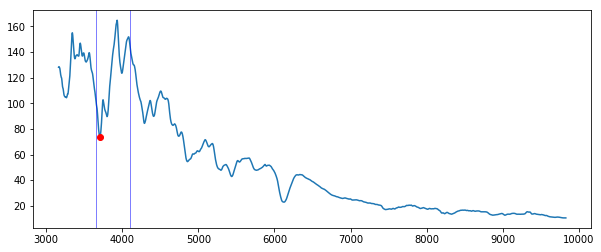

-18518.796962025317 -4.11852407745


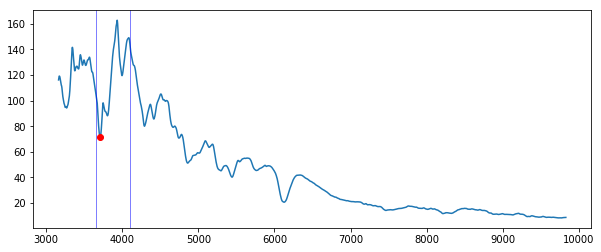

-18215.21012658228 -3.57863516883


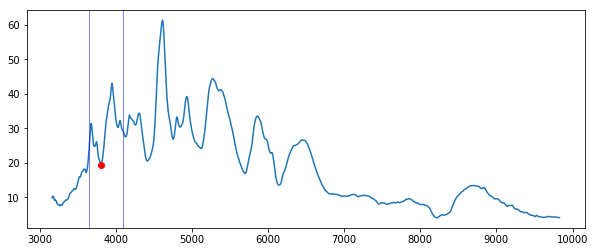

-10929.126075949367 13.780639444


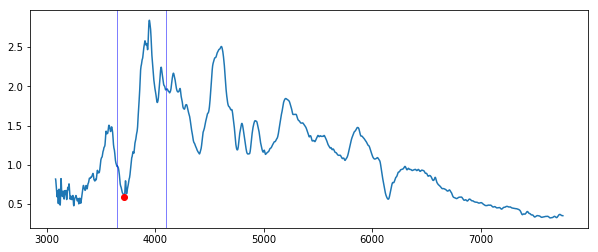

-17759.829873417722 9.95955569542


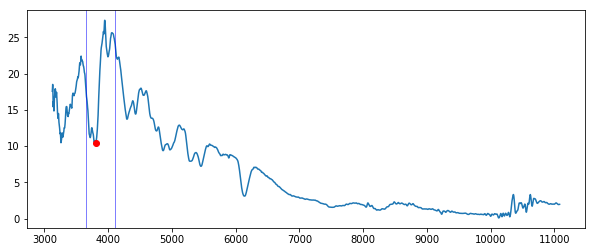

-11232.712911392406 0.998840596273


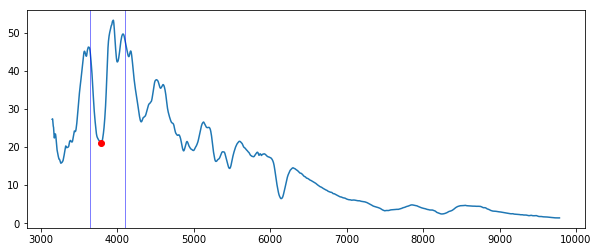

-12295.266835443039 3.67091512586


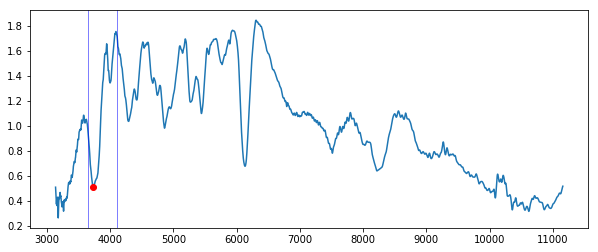

-16849.069367088607 -2.1768034995


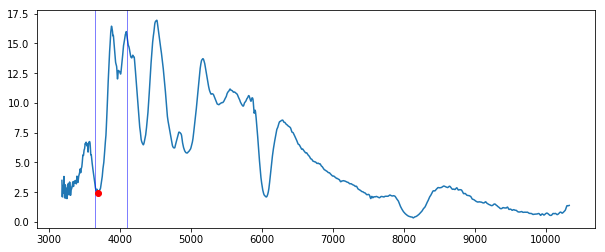

-19125.970632911394 6.22327216179


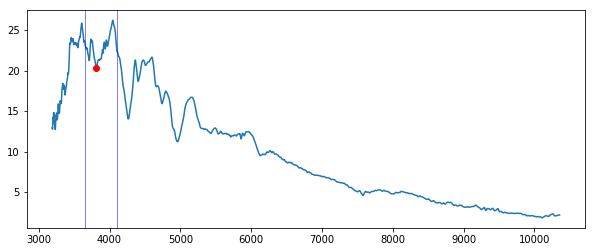

-10473.745822784811 -4.41866036556


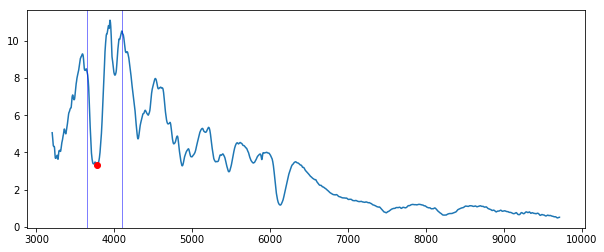

-13509.61417721519 2.77201914426


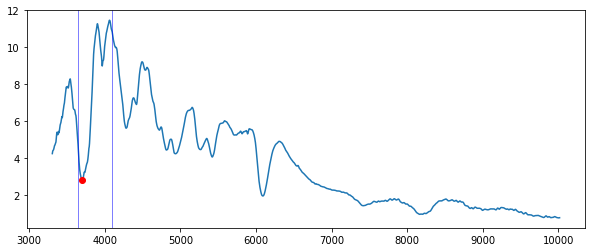

-19125.970632911394 -0.728371655089


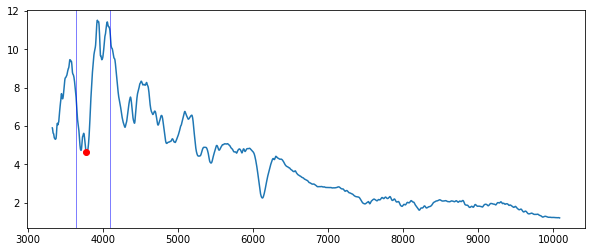

-12902.440506329114 -4.86520587957


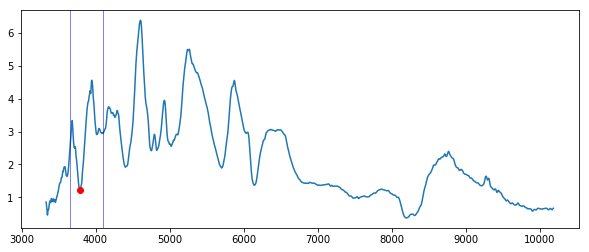

-12447.060253164556 14.96222188


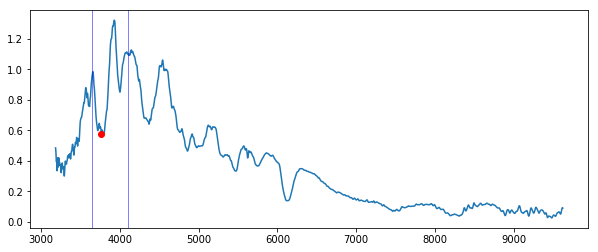

-14116.787848101267 4.7115224089


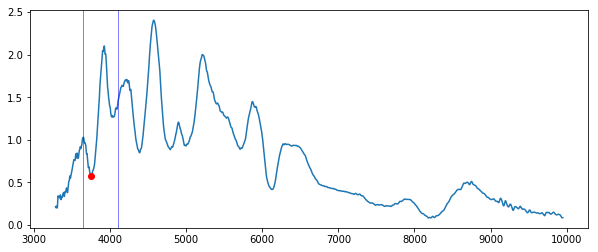

-15331.135189873417 12.1129522502


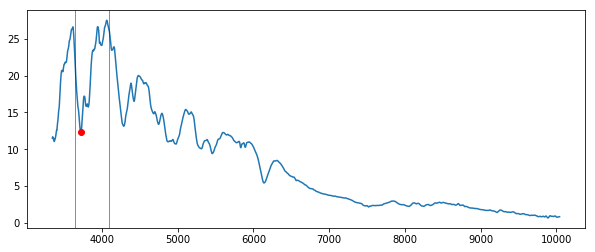

-17304.449620253166 0.496750833938


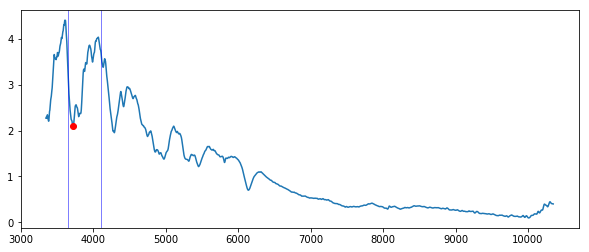

-17608.0364556962 0.460351148368


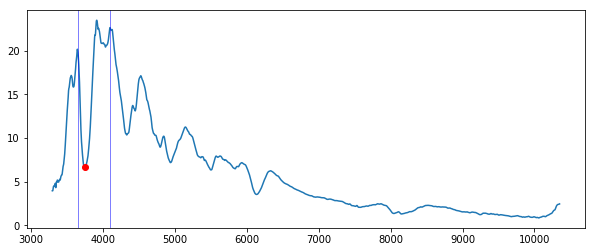

-15331.135189873417 -0.385339276873


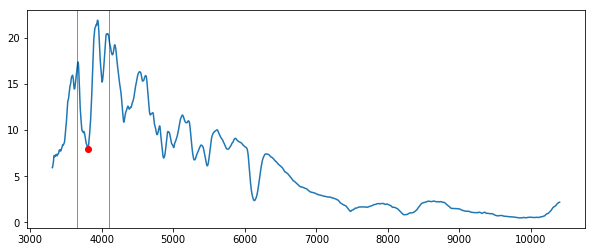

-10929.126075949367 4.85695605658


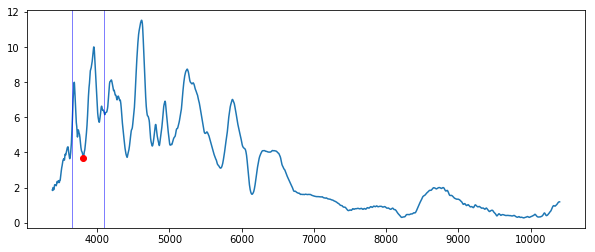

-10625.539240506328 13.7981931291


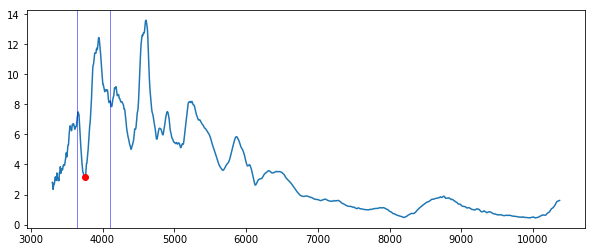

-14420.374683544303 14.3465050396


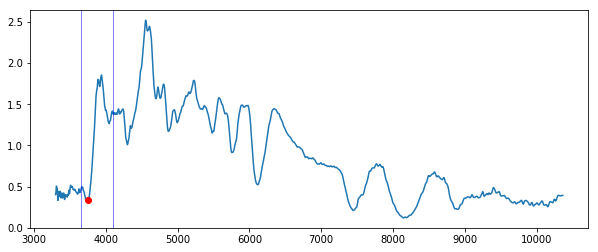

-14723.961518987342 -2.69083978888


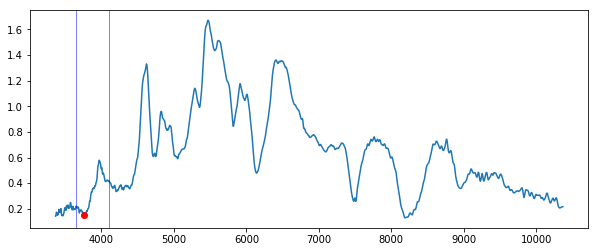

-14572.168101265823 6.18350046164


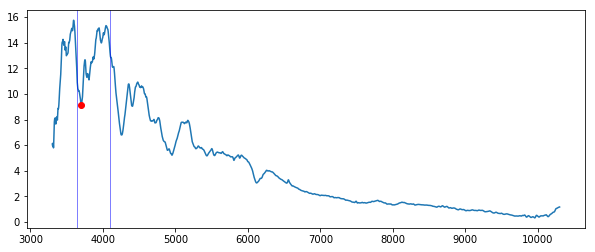

-18822.383797468356 -3.56098181356


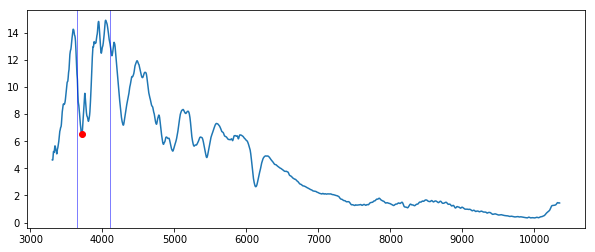

-18215.21012658228 3.33620223064


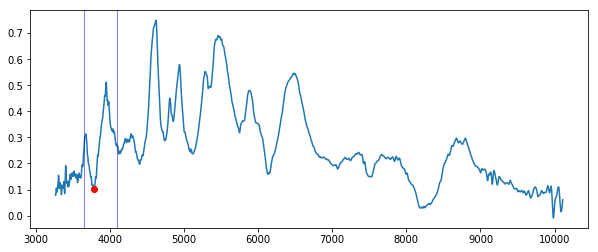

-12295.266835443039 14.3186128288


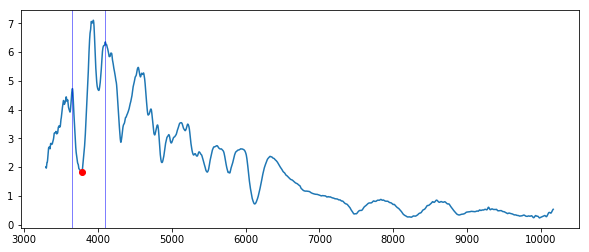

-13054.233924050634 1.02708557343


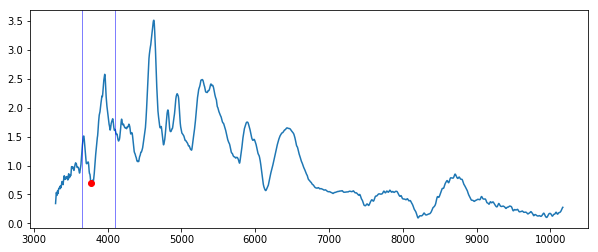

-12902.440506329114 10.8635185101


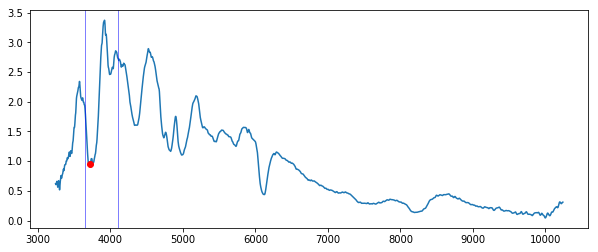

-17456.243037974684 6.92271915008


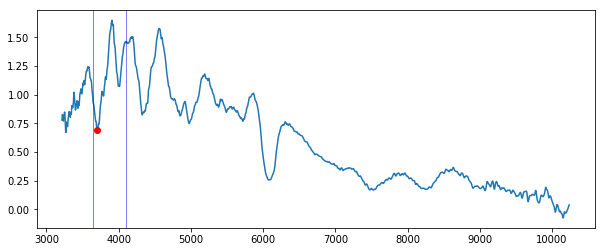

-18518.796962025317 6.37713007792


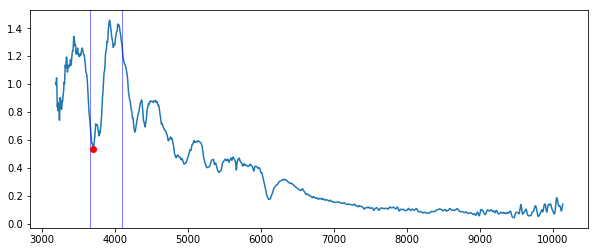

-18822.383797468356 -3.19401938128


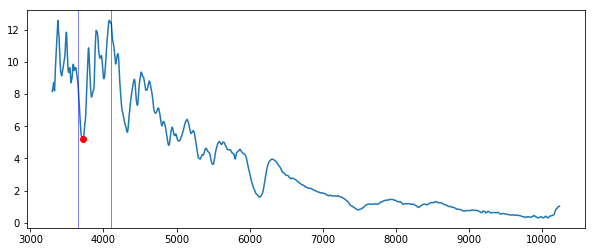

-17000.862784810128 1.95962387038


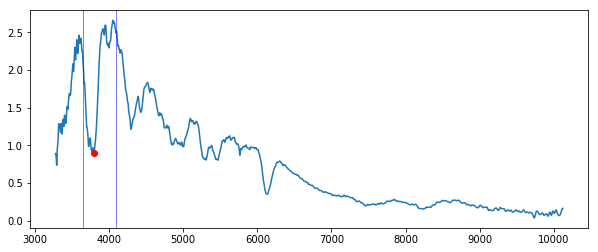

-11688.093164556962 0.917447344588


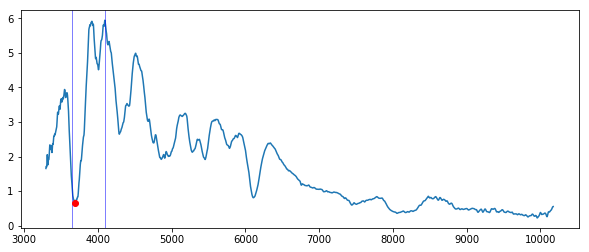

-19581.35088607595 2.21688073575


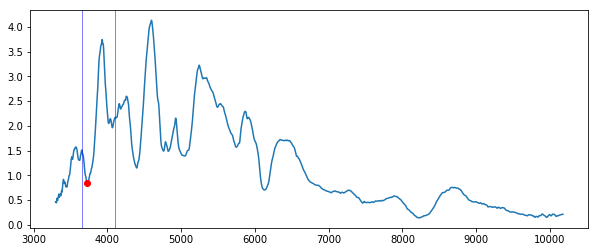

-17000.862784810128 13.058459784


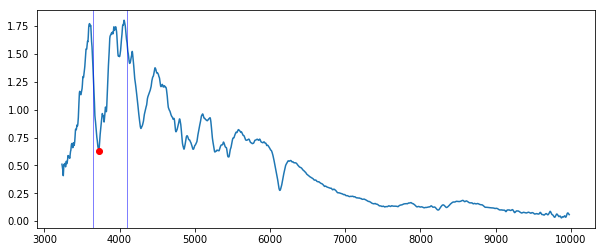

-17152.656202531645 2.59682402539


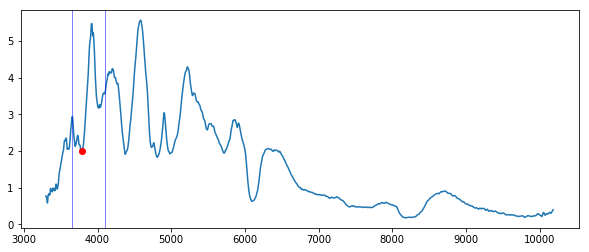

-12143.47341772152 10.9246154285


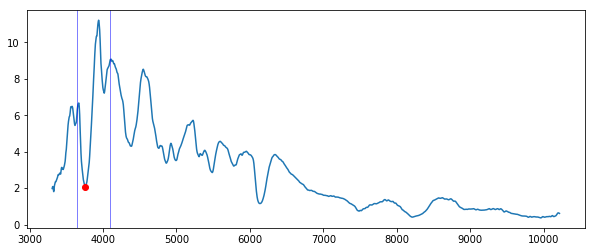

-14420.374683544303 2.68475189241


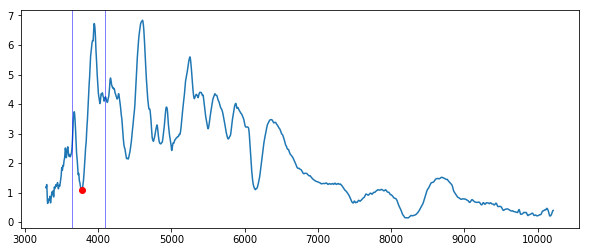

-12598.853670886076 7.70484311474


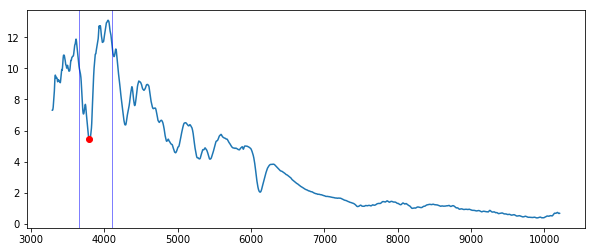

-11839.886582278481 -1.06458656253


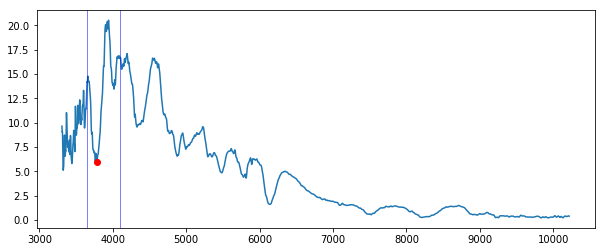

-12598.853670886076 5.86876474595


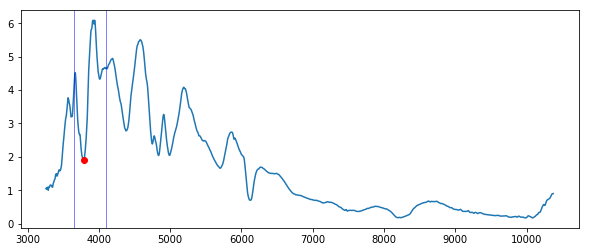

-11991.68 10.276660405


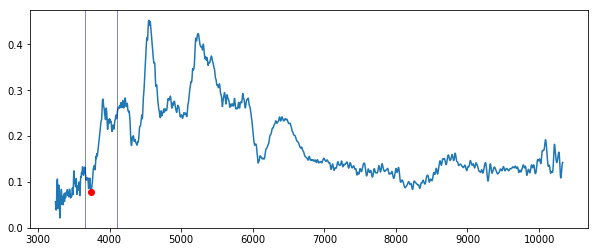

-16090.102278481012 13.0035993242


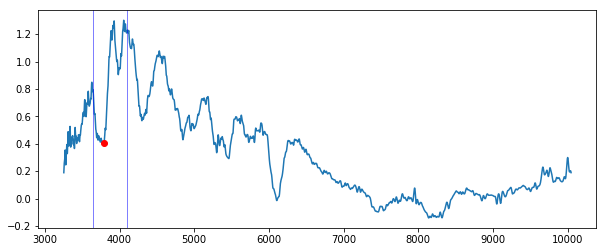

-12143.47341772152 4.15787297081


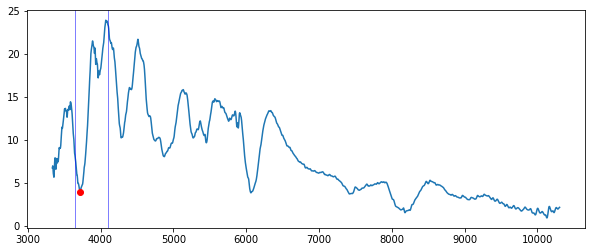

-17304.449620253166 -1.67788576436


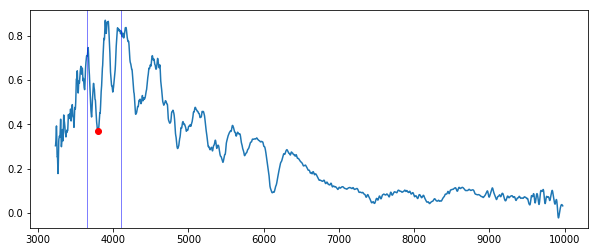

-11991.68 5.64141032365


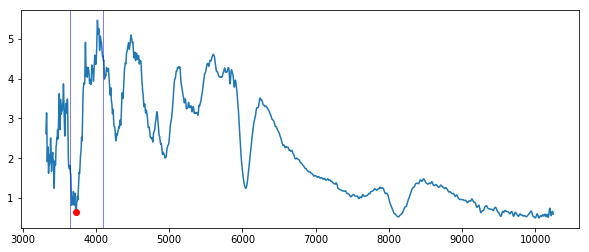

-16849.069367088607 1.36290214026


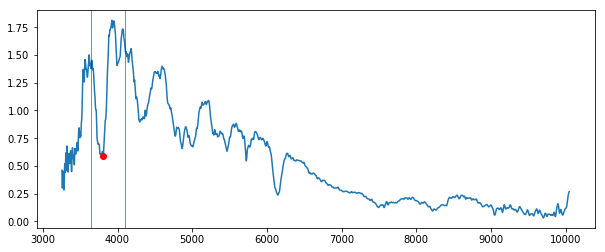

-10777.332658227848 5.22690374652


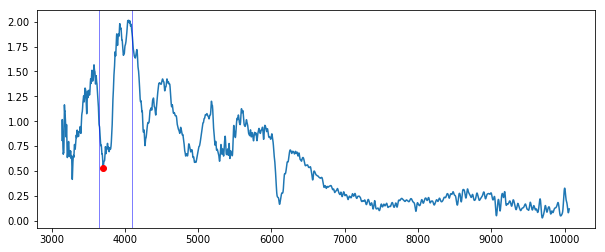

-18822.383797468356 -0.16048772706


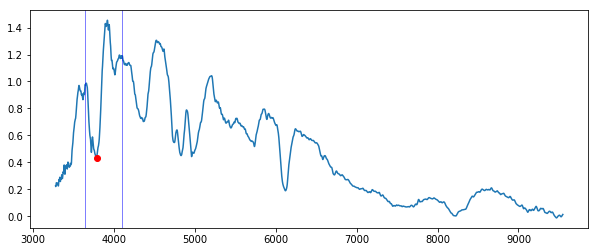

-12295.266835443039 8.52530259231


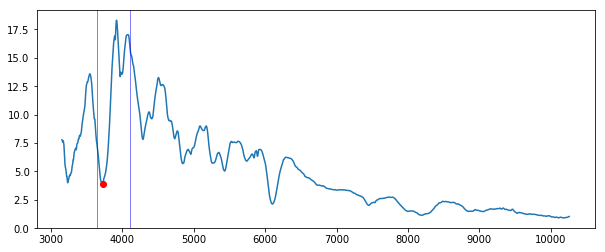

-17000.862784810128 -4.77607382341


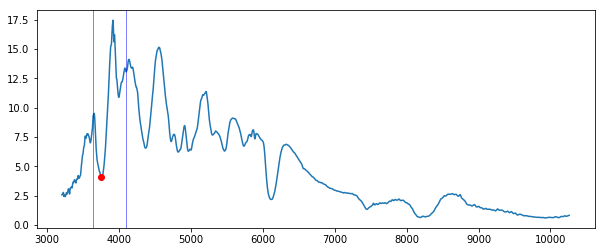

-14723.961518987342 5.06360992654


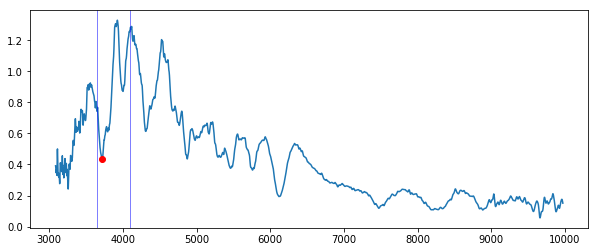

-17304.449620253166 4.4206679478


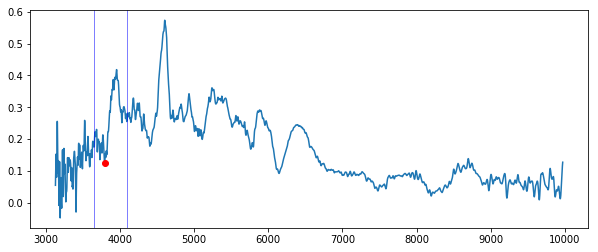

-11991.68 13.8547029469


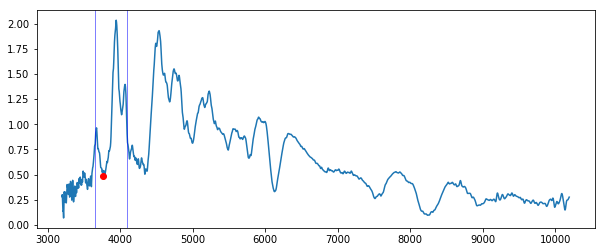

-13661.407594936709 3.18639735241


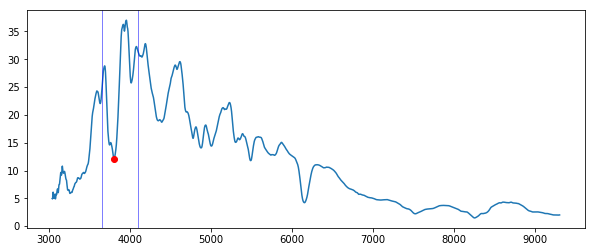

-11080.919493670886 7.08253692442


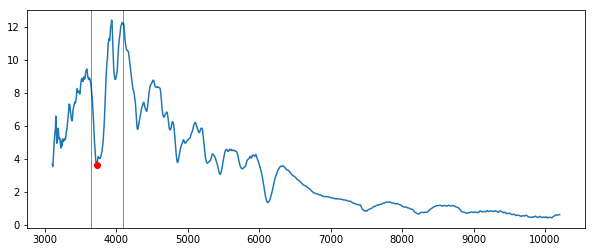

-16849.069367088607 -0.0433903773625


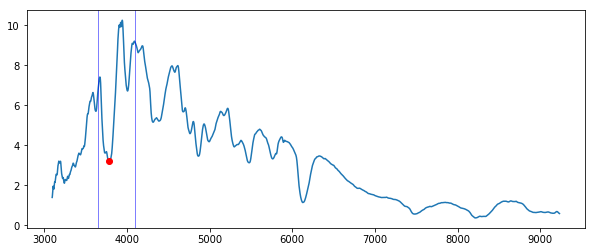

-12598.853670886076 5.73541897115


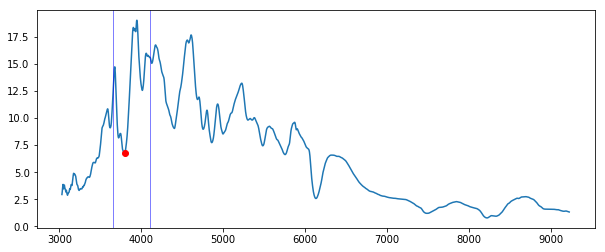

-11688.093164556962 8.69385379121


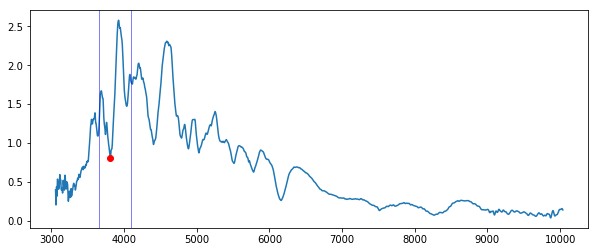

-10473.745822784811 13.6724112006


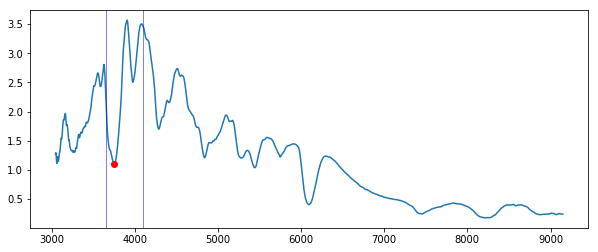

-15179.341772151898 0.0575854705037


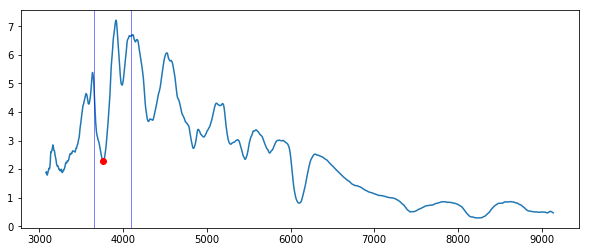

-14268.581265822784 2.98566024182


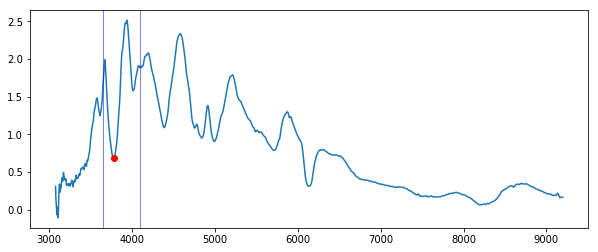

-12447.060253164556 11.5466849745


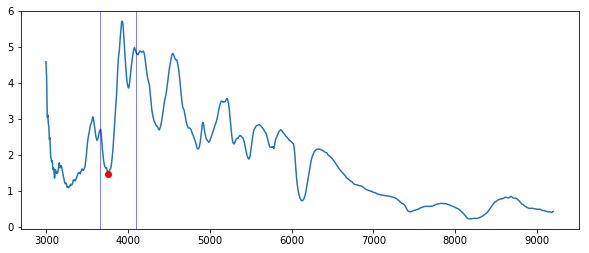

-14875.754936708861 7.06661434318


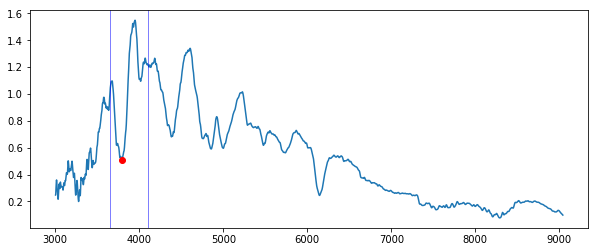

-11839.886582278481 8.104792907


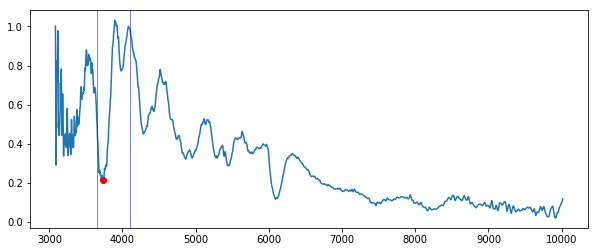

-16697.27594936709 -1.34909797218


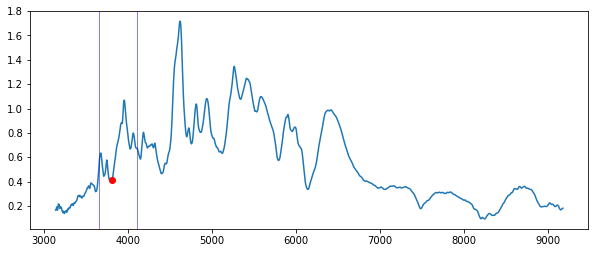

-10929.126075949367 5.35461482092


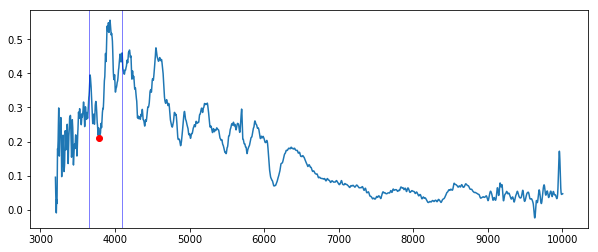

-11991.68 6.48260139398


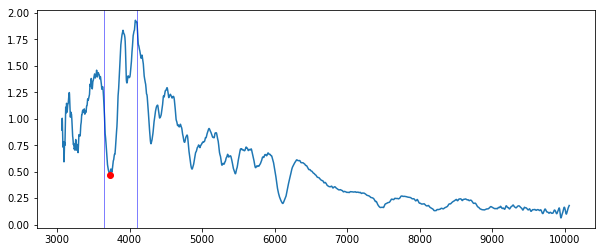

-17000.862784810128 -2.67712752871


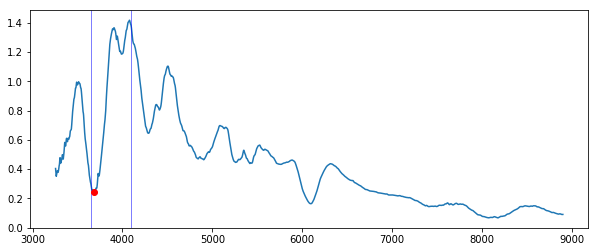

-20036.731139240506 -4.99116894806


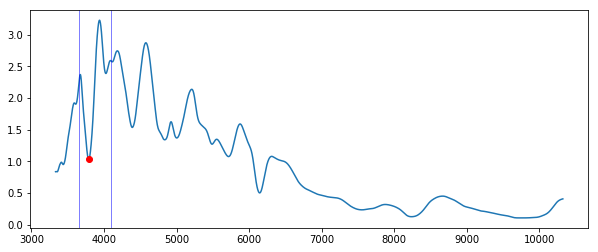

-12295.266835443039 11.088748182


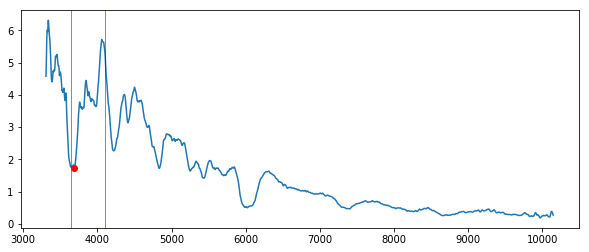

-19733.144303797468 -2.84290939758


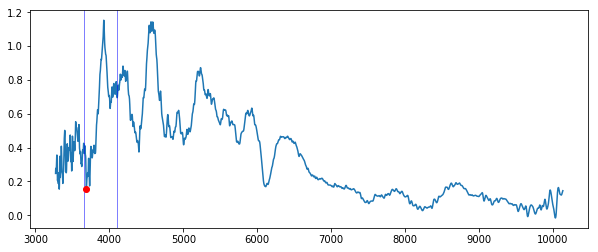

-19884.93772151899 7.99914644733


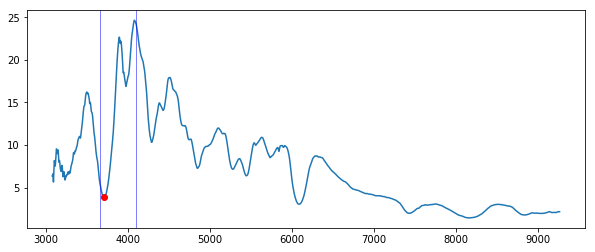

-18974.177215189873 -2.6238344844


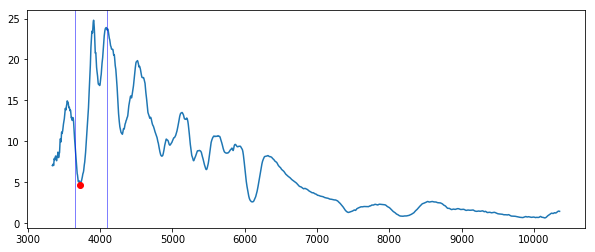

-17000.862784810128 2.4474589035


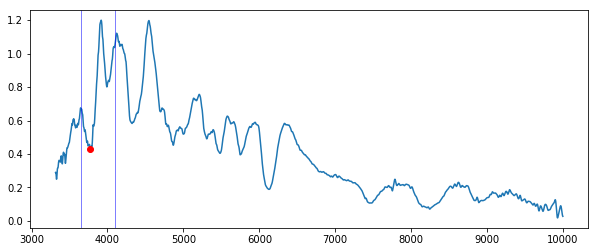

-13357.82075949367 1.41616176363


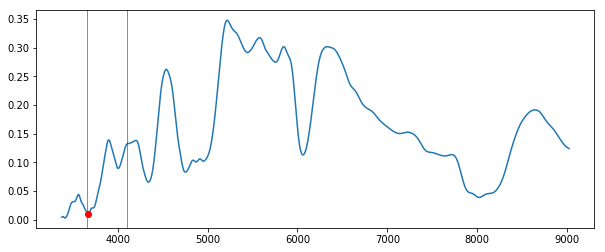

-21251.078481012657 8.32662908714


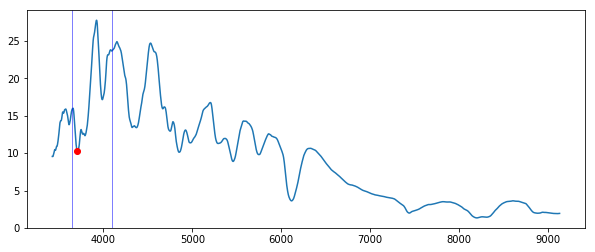

-18518.796962025317 6.04326425565


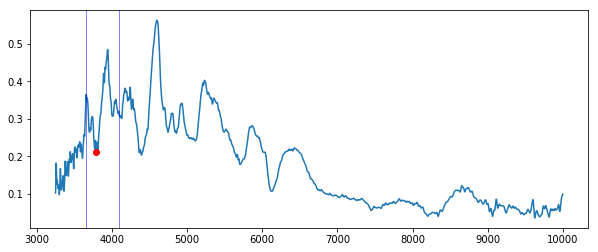

-11839.886582278481 14.1816425121


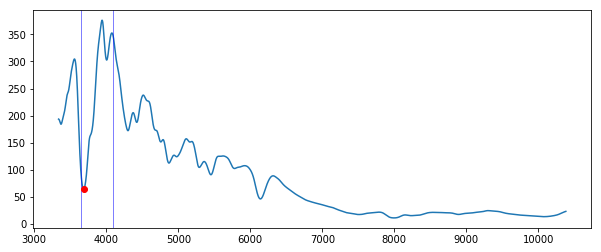

-20036.731139240506 -2.03783355739


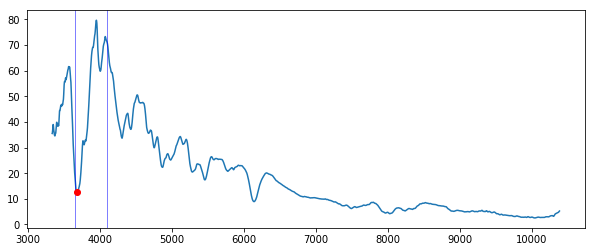

-19884.93772151899 -1.11579087516


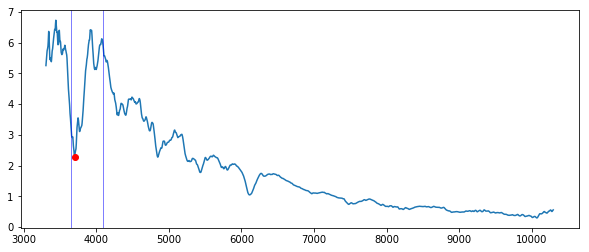

-18822.383797468356 -4.49596515947


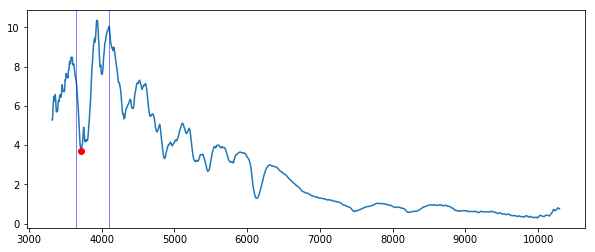

-17759.829873417722 3.42394892158


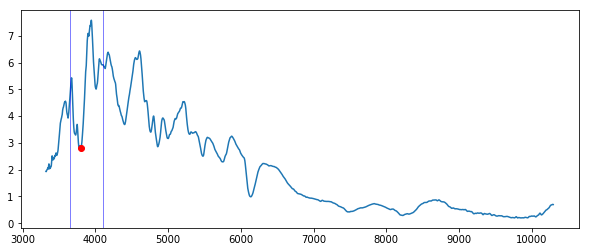

-11080.919493670886 10.2994354179


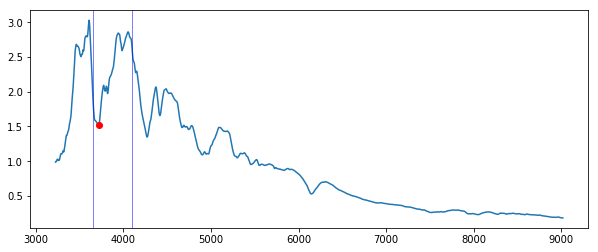

-17608.0364556962 -3.6064946058


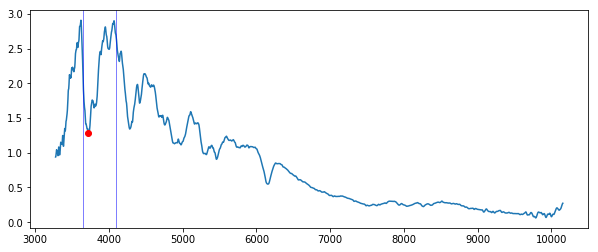

-17152.656202531645 0.0310988486616


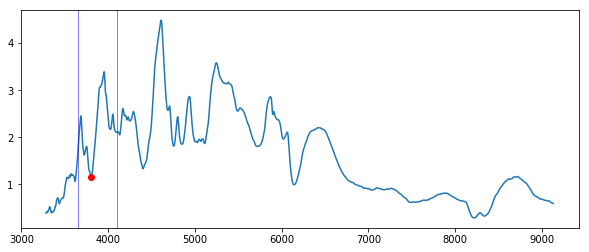

-11080.919493670886 11.9798644495


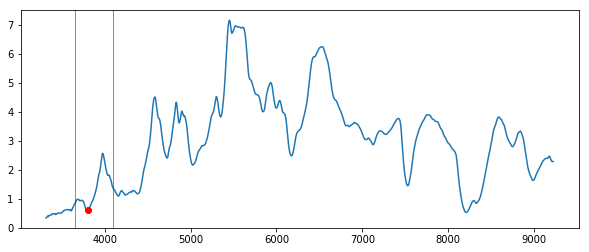

-10777.332658227848 9.86884006051


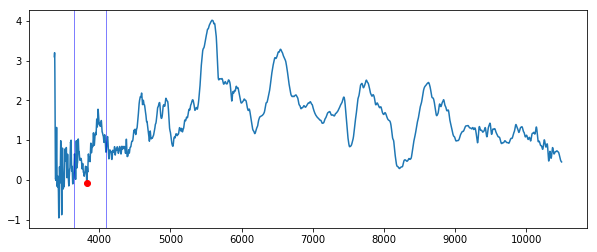

-9562.985316455697 14.825650824


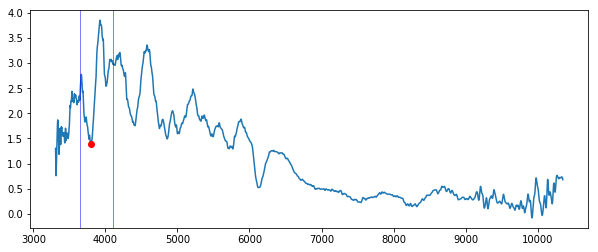

-11384.506329113925 8.21913507266


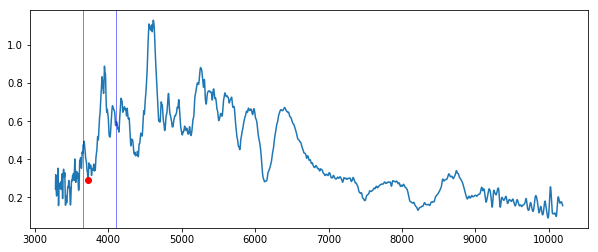

-17152.656202531645 6.63466706203


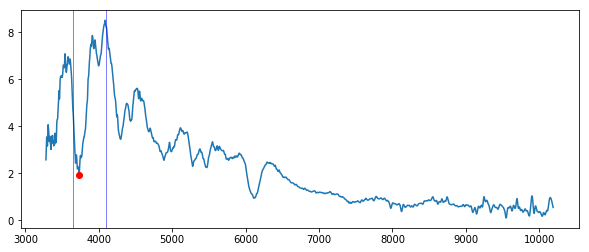

-16545.482531645568 -1.93815084608


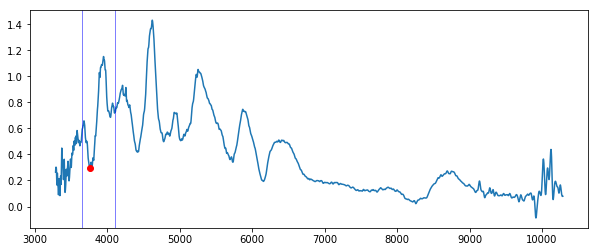

-14420.374683544303 14.5639306909


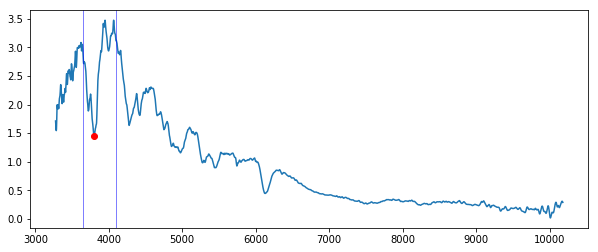

-11384.506329113925 0.455997240633


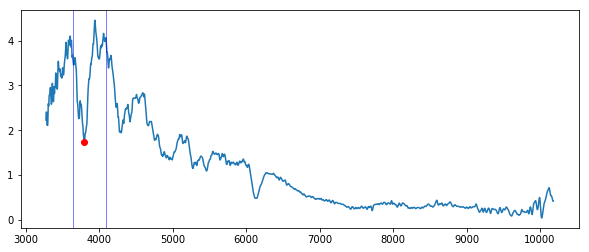

-11384.506329113925 1.45568349894


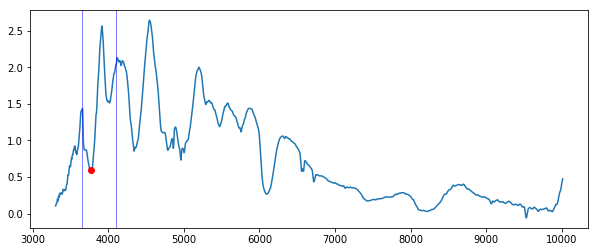

-13661.407594936709 7.32475422879


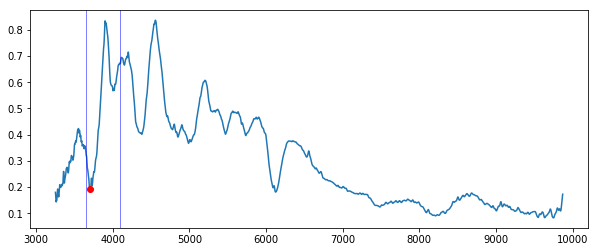

-18670.590379746835 9.27752624988


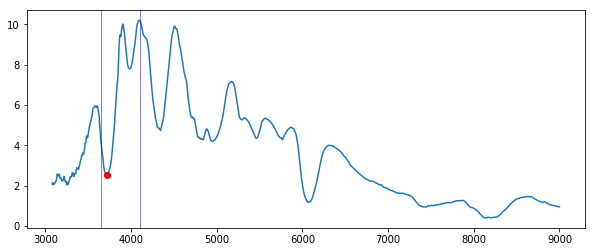

-17759.829873417722 7.20517073505


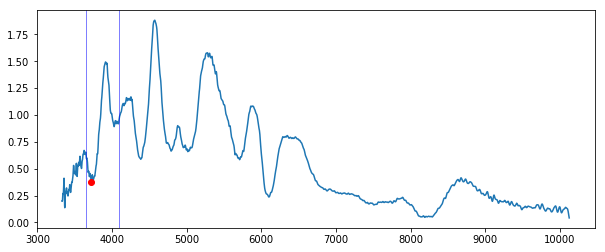

-17000.862784810128 14.8741810638


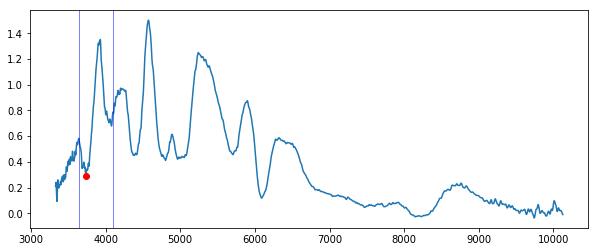

-16241.895696202531 14.8741810638


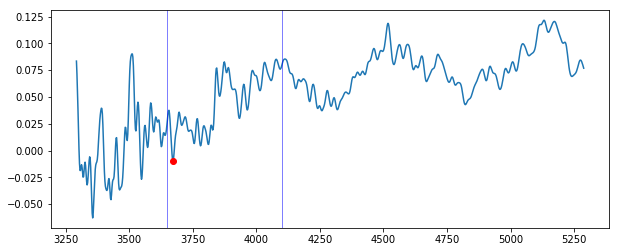

-21099.28506329114 5.31334485014


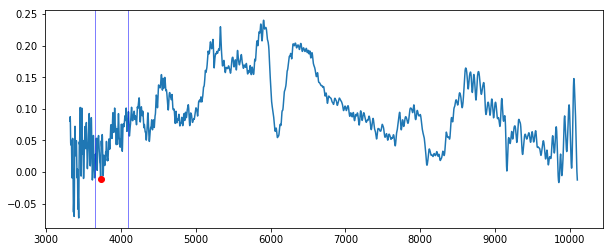

-16849.069367088607 12.0555539289


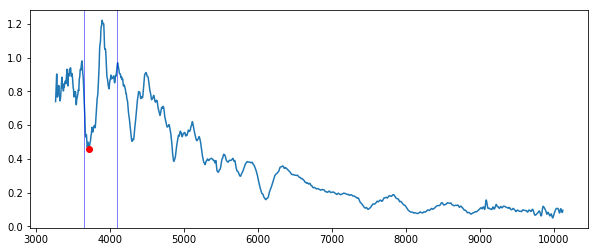

-17608.0364556962 -2.96757466894


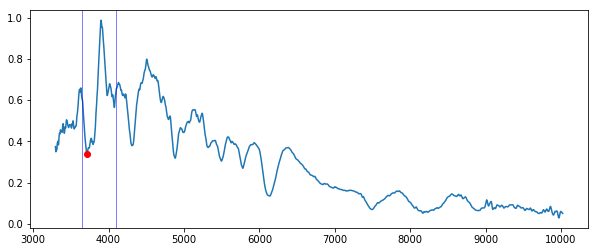

-18063.41670886076 3.83275396355


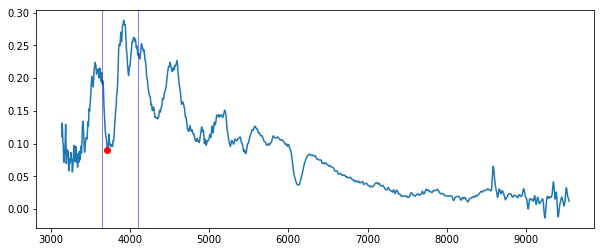

-17759.829873417722 6.94095015012


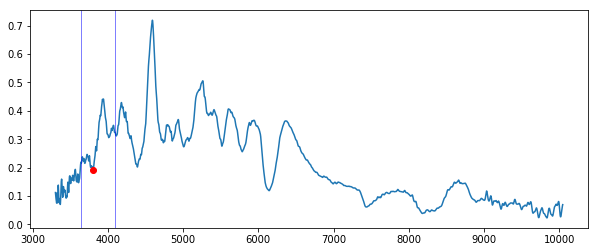

-11080.919493670886 11.784443137


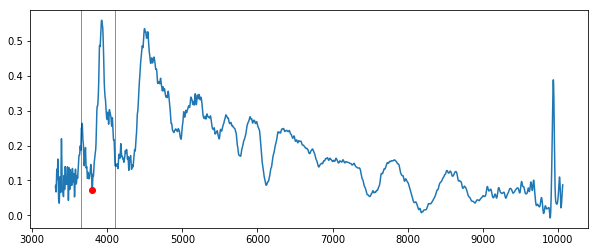

-11384.506329113925 12.0760069501


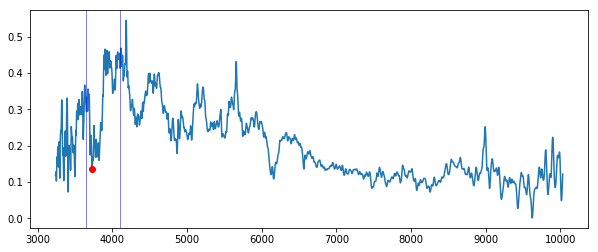

-16849.069367088607 5.5033258061


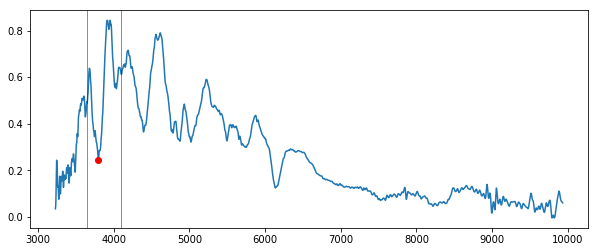

-11688.093164556962 10.3115350938


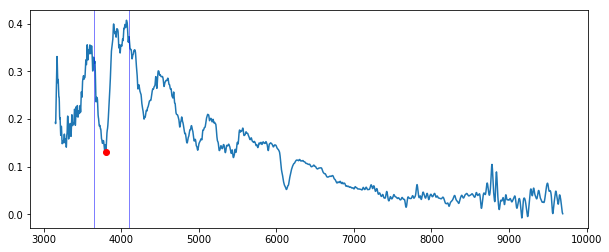

-11232.712911392406 3.64584357907


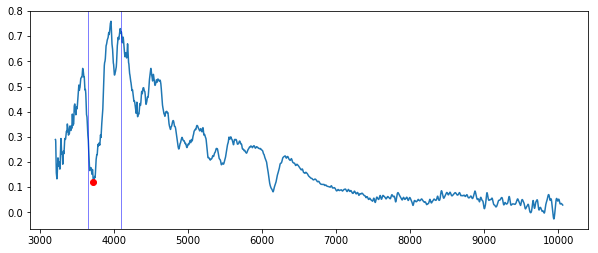

-17304.449620253166 1.45945435485


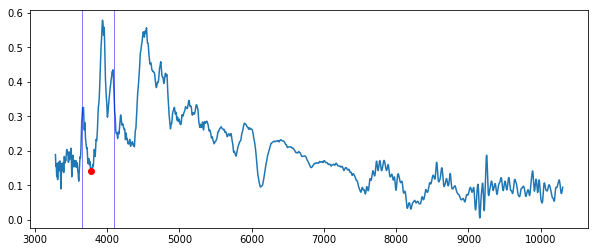

-13054.233924050634 1.81209679625


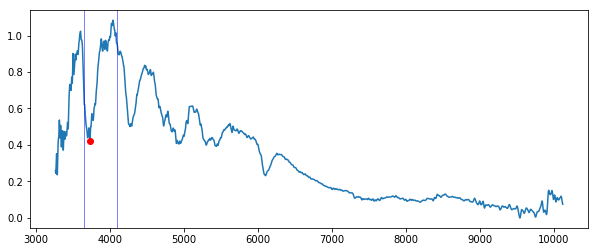

-16697.27594936709 -3.13399884815


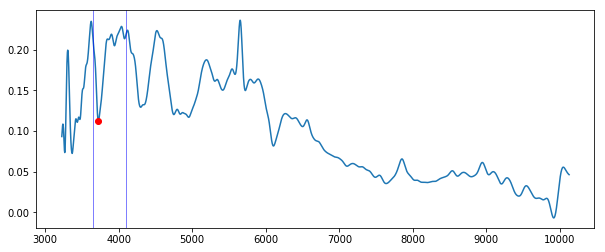

-17152.656202531645 2.66173929736


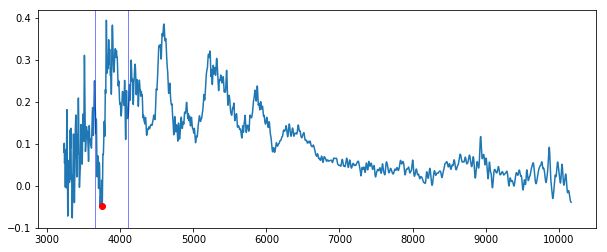

-14875.754936708861 10.3647533116


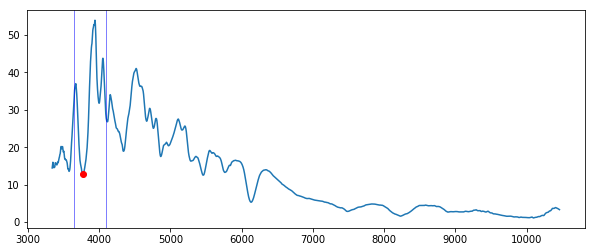

-13357.82075949367 2.81697337515


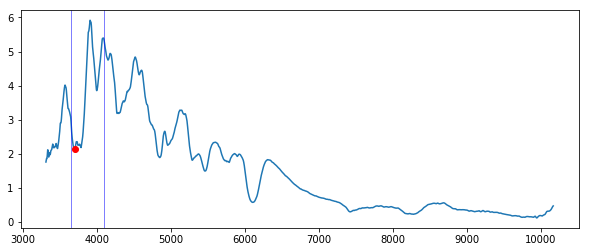

-18822.383797468356 6.26386430128


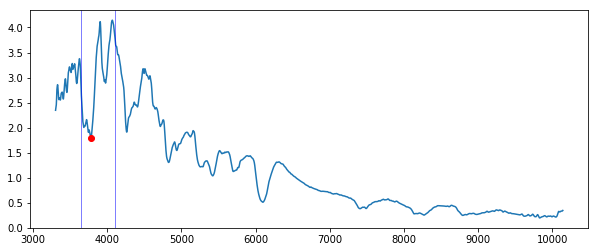

-12902.440506329114 -0.175412464277


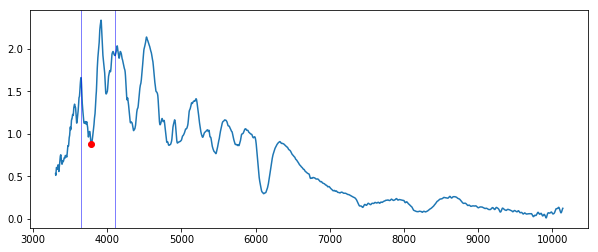

-12750.647088607595 8.61284999197


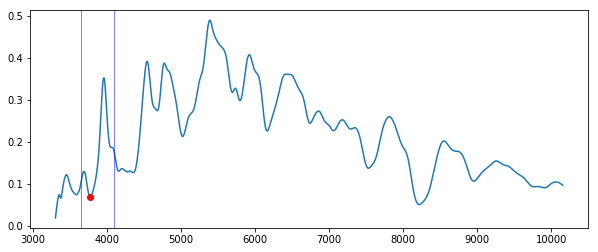

-13206.027341772153 6.03100566799


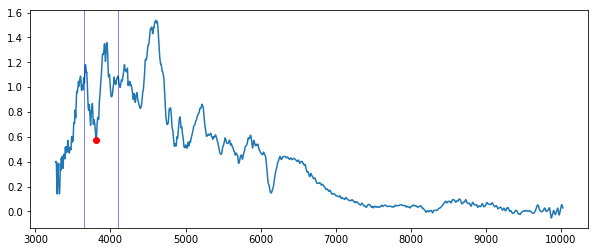

-10625.539240506328 8.8222268952


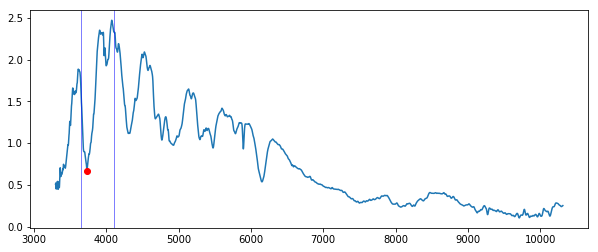

-16545.482531645568 4.50109960602


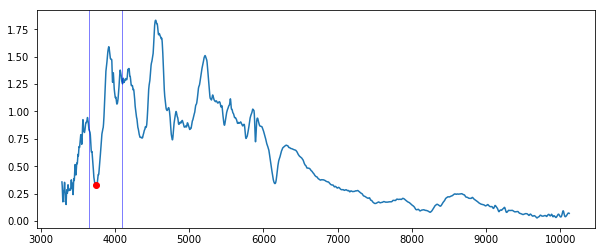

-15482.928607594937 10.3448039826


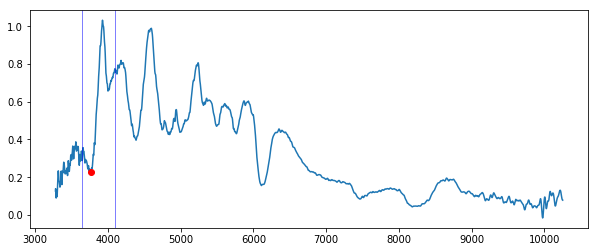

-14116.787848101267 11.6638622461


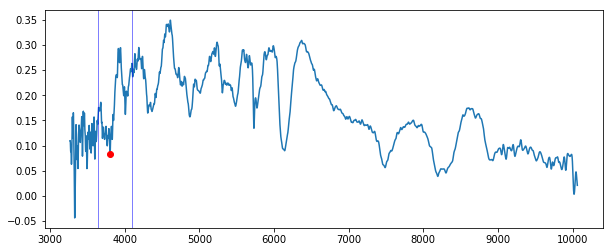

-10929.126075949367 3.50775508537


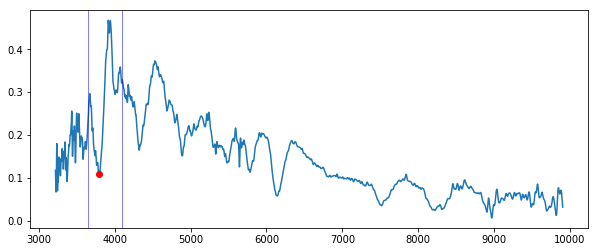

-11384.506329113925 0.490059544144


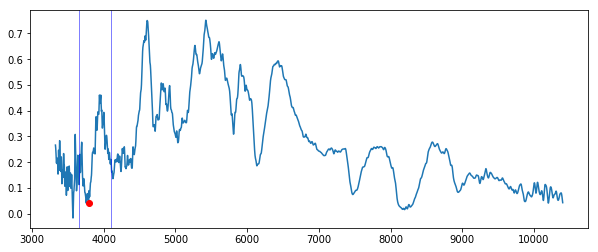

-12295.266835443039 6.36789405844


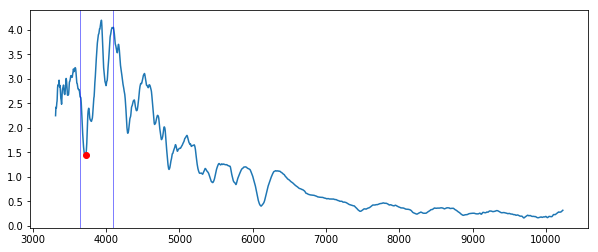

-17456.243037974684 -2.10124145575


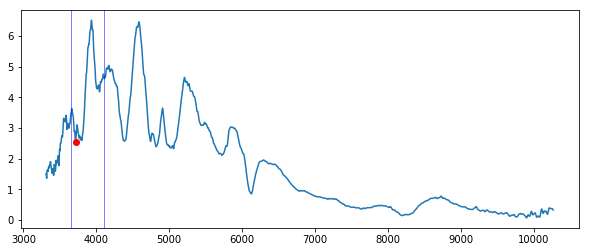

-17911.62329113924 12.3104050197


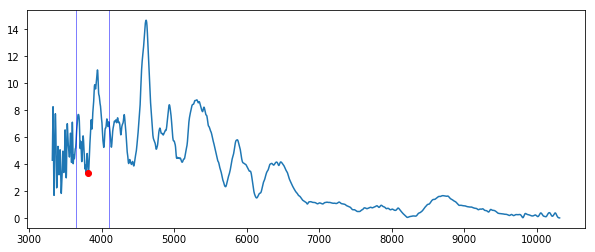

-9866.572151898734 14.2636344435


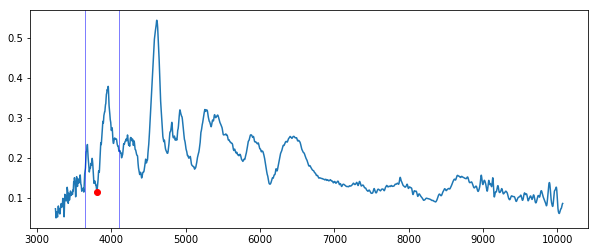

-11080.919493670886 13.1446226719


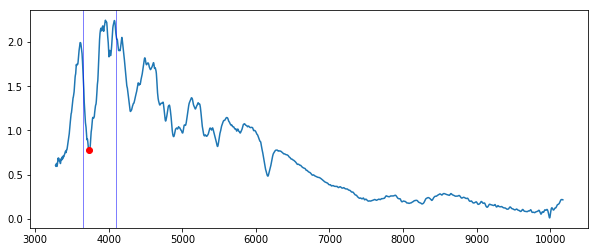

-16697.27594936709 5.55989031249


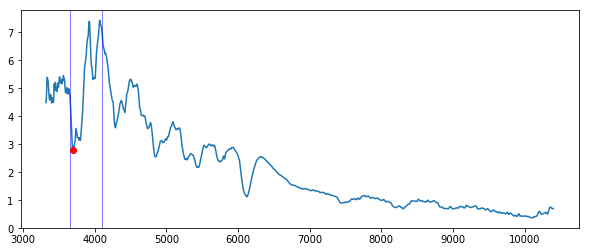

-18670.590379746835 -1.44339268267


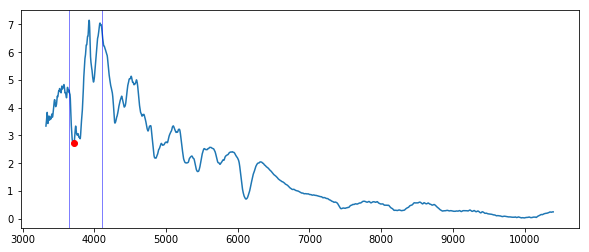

-17759.829873417722 -0.458454643058


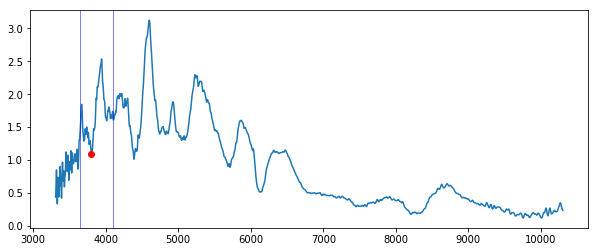

-11232.712911392406 12.3585568834


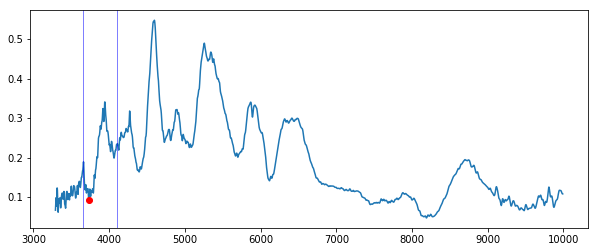

-16393.68911392405 2.01074814914


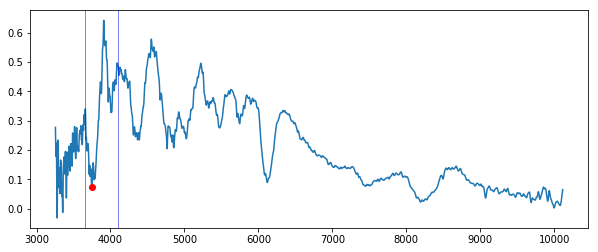

-15482.928607594937 7.21721053941


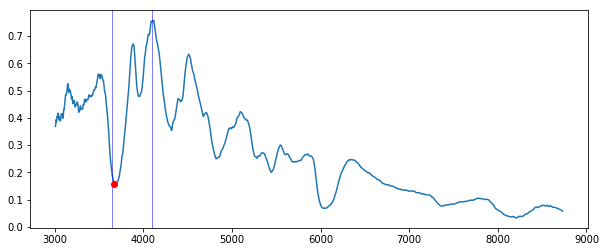

-21099.28506329114 0.0693191529807


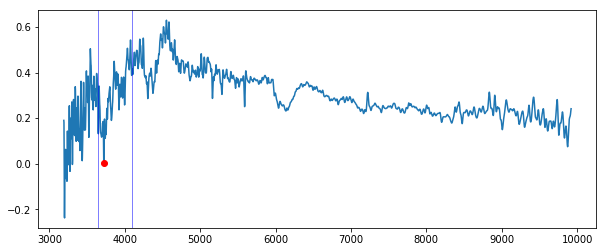

-17456.243037974684 7.5510397873


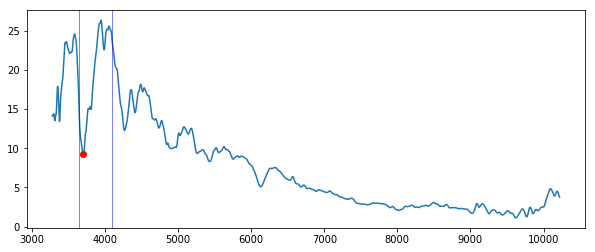

-18974.177215189873 -4.08777427037


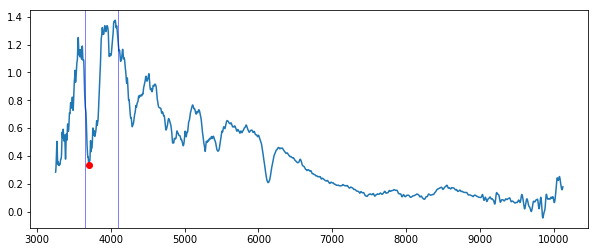

-18518.796962025317 2.83208442577


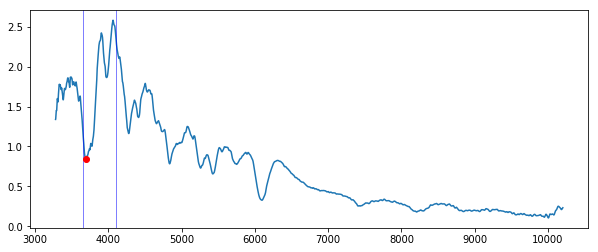

-19581.35088607595 -2.54847970004


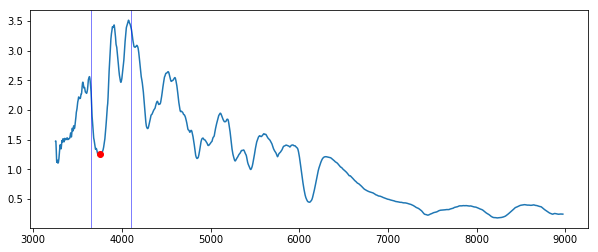

-15179.341772151898 2.47524752475


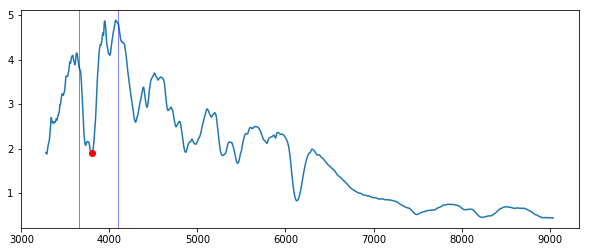

-11232.712911392406 0.476590306383


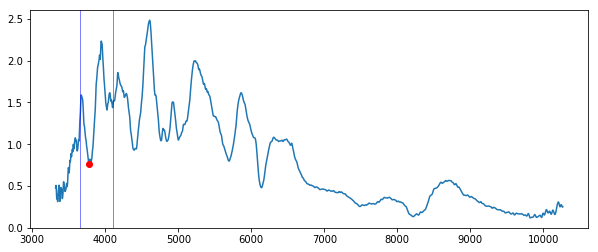

-13054.233924050634 13.1843549293


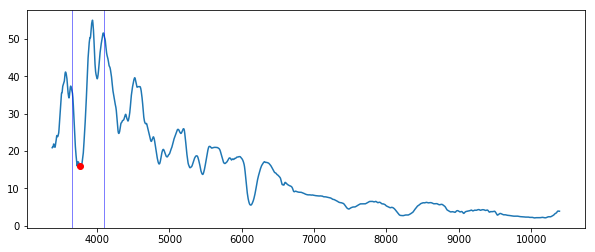

-14268.581265822784 -1.06219616018


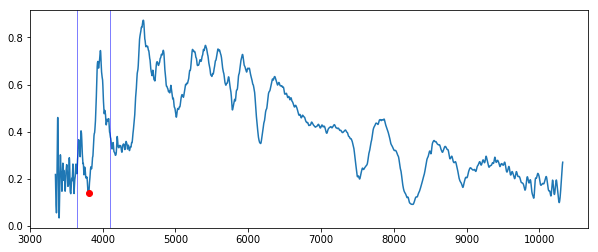

-10777.332658227848 3.75923135821


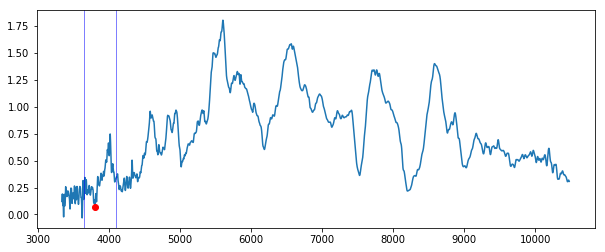

-10929.126075949367 12.5427310955


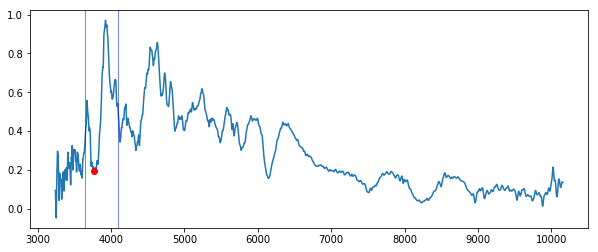

-13357.82075949367 3.55700891563


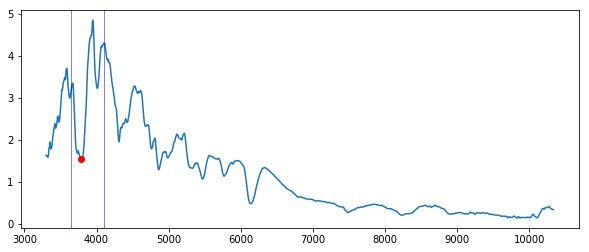

-12902.440506329114 1.3764105271


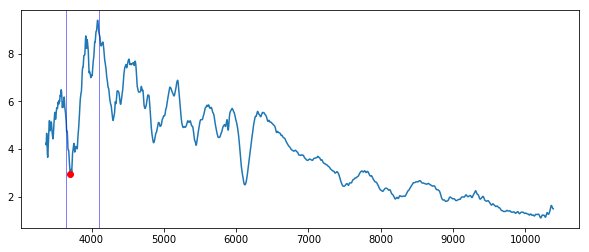

-18518.796962025317 -4.12637110904


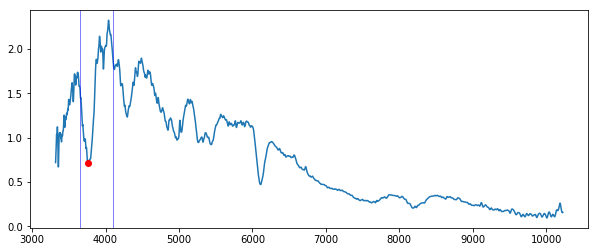

-14420.374683544303 0.94932558736


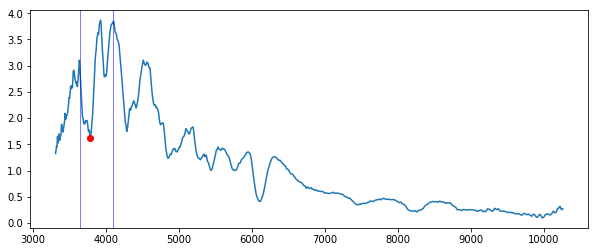

-12598.853670886076 -1.88581766893


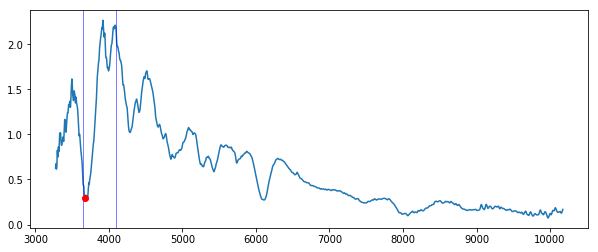

-20947.491645569622 -4.11212878373


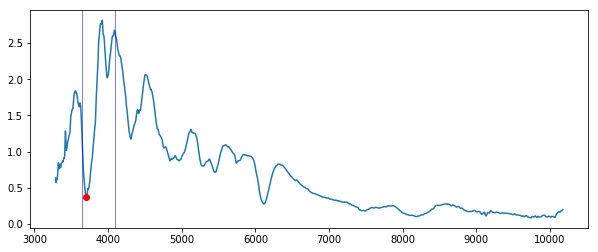

-18518.796962025317 0.824762746822


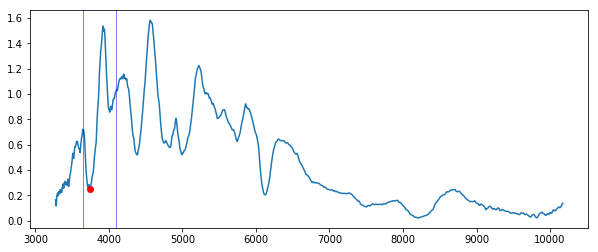

-16090.102278481012 9.53005077111


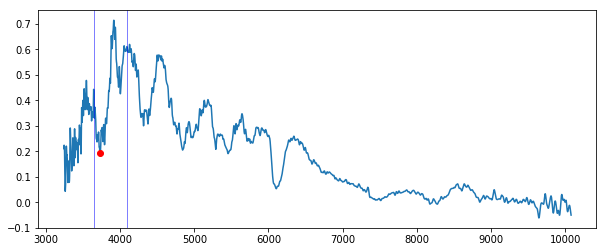

-16697.27594936709 4.30930112532


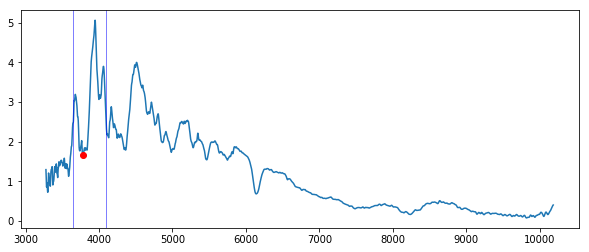

-13206.027341772153 7.62841451339


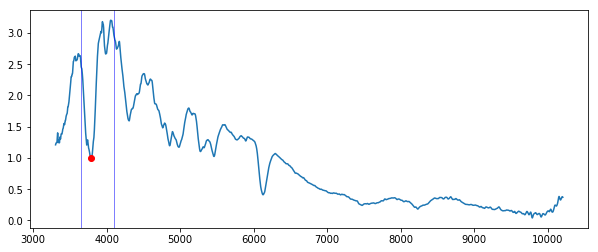

-12143.47341772152 3.15458029623


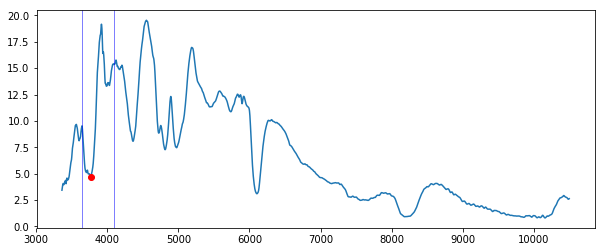

-13813.201012658228 8.21677505485


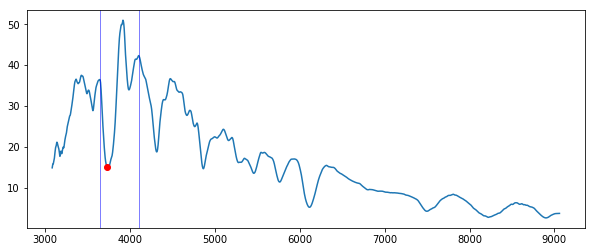

-16697.27594936709 -2.68555865827


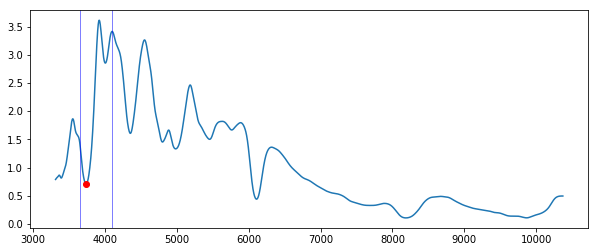

-16241.895696202531 6.18529411765


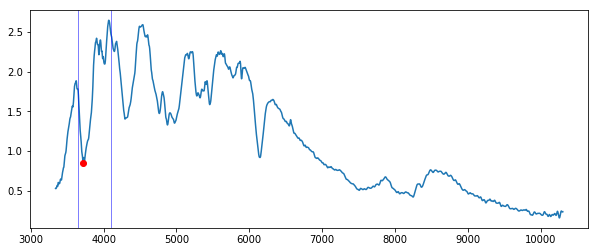

-17456.243037974684 6.47611411359


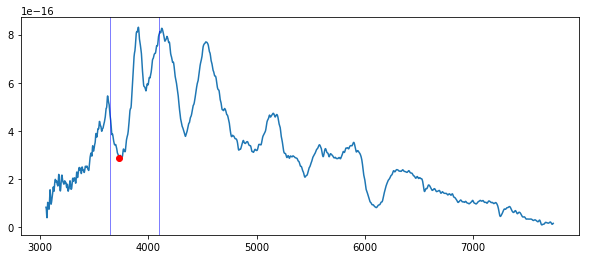

-16697.27594936709 6.74928503336


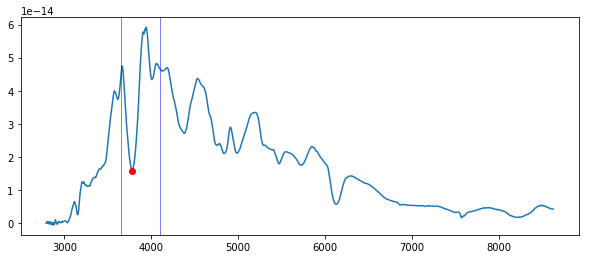

-12902.440506329114 8.84427034272


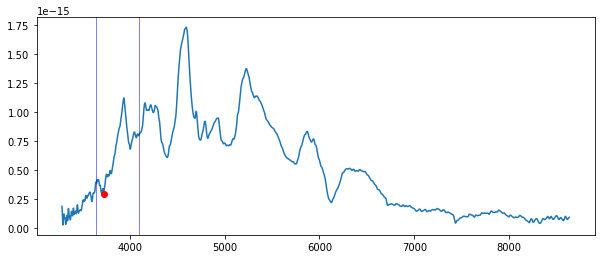

-17000.862784810128 12.7365129007


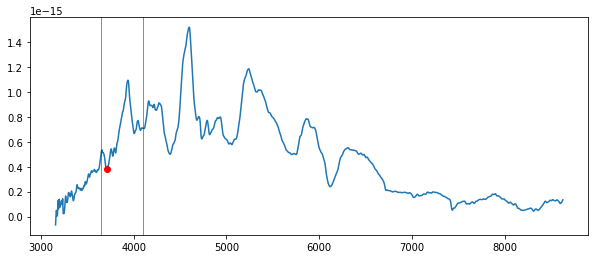

-18215.21012658228 13.6942924159


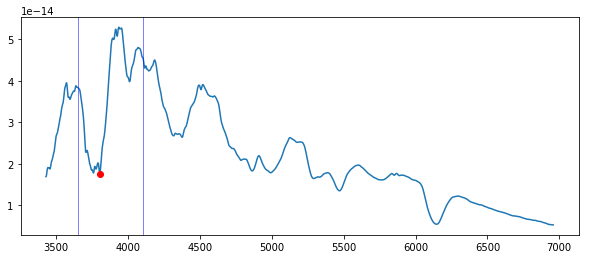

-11232.712911392406 5.50587594791


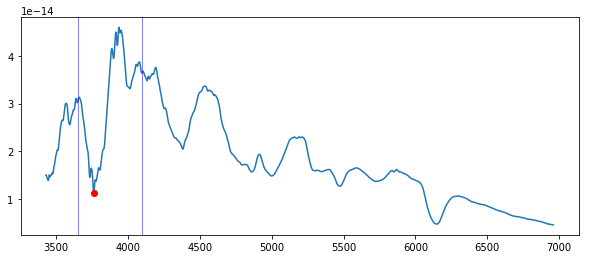

-14268.581265822784 7.47296984485


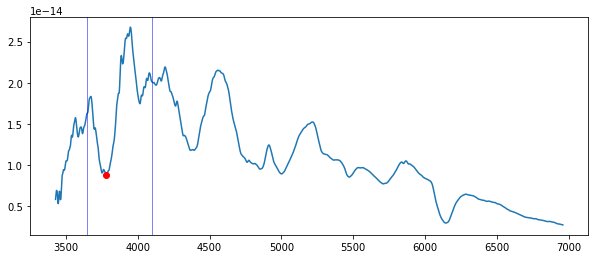

-12750.647088607595 9.49967264776


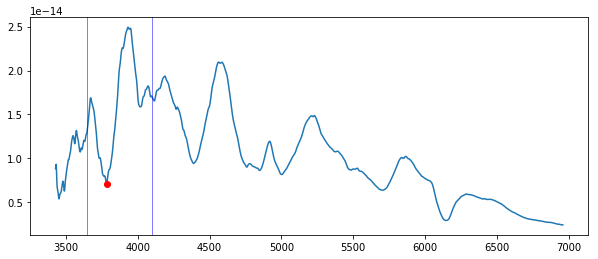

-12598.853670886076 11.5263754507


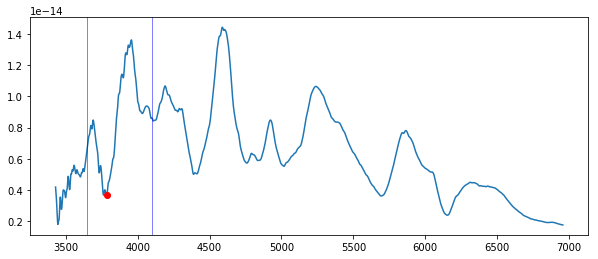

-12598.853670886076 14.4869511137


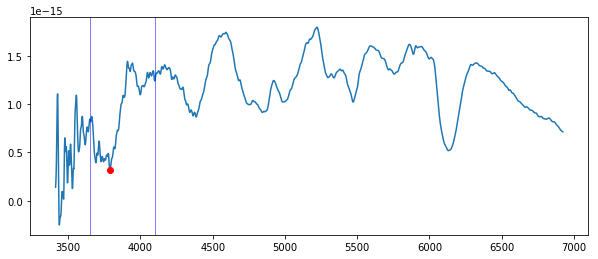

-12295.266835443039 6.57786125596


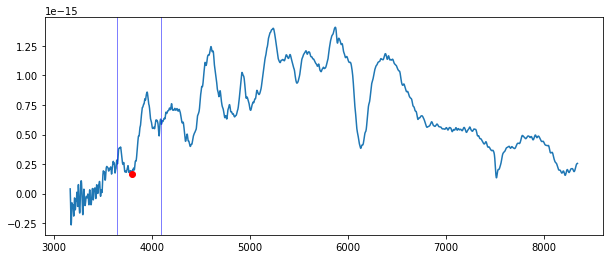

-11688.093164556962 9.53364802412


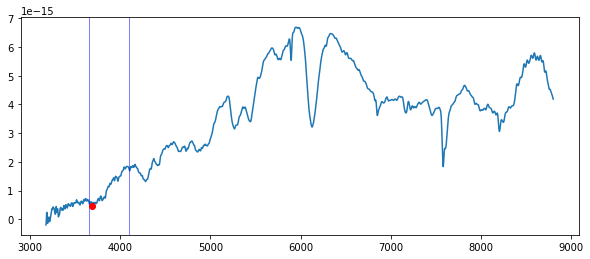

-20036.731139240506 13.3538552329


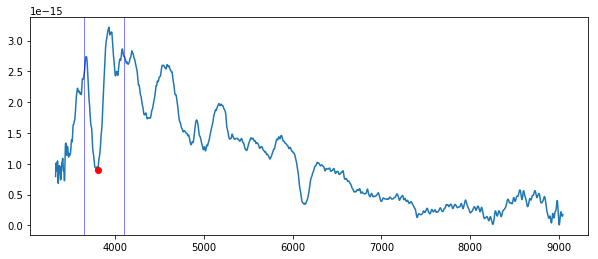

-11384.506329113925 7.66699123661


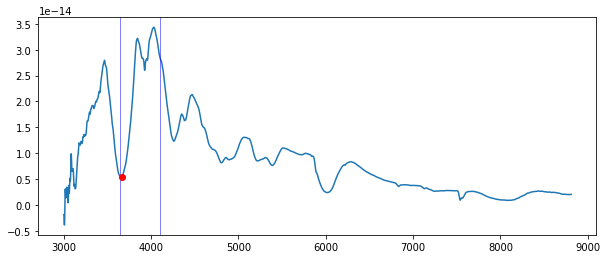

-21402.871898734178 -2.73328096859


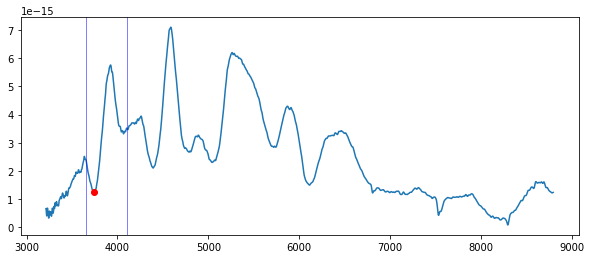

-15634.722025316456 12.3594882231


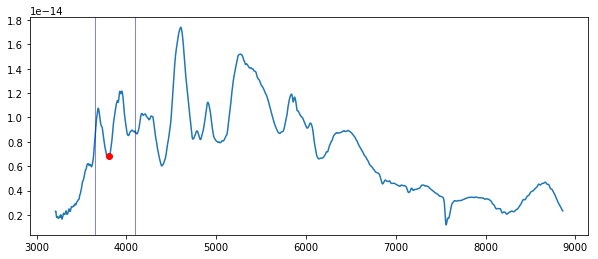

-10777.332658227848 12.3414327196


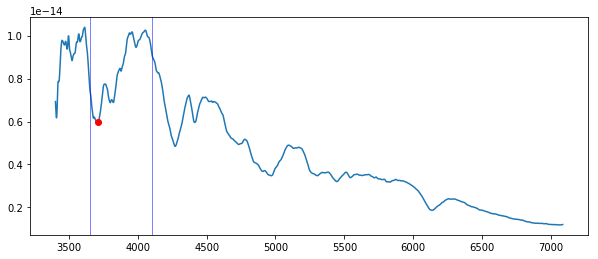

-18215.21012658228 -2.44469132321


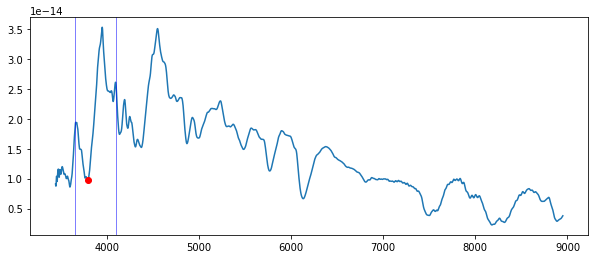

-11991.68 -3.50254658088


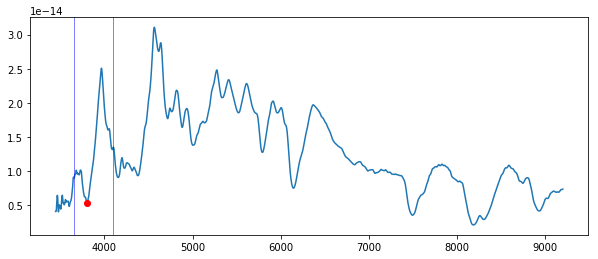

-11232.712911392406 2.48471253173


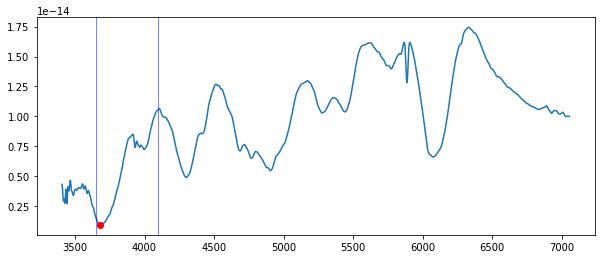

-20340.317974683545 -3.1152957149


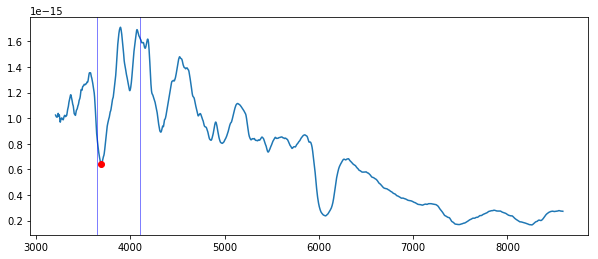

-19884.93772151899 2.89251866548


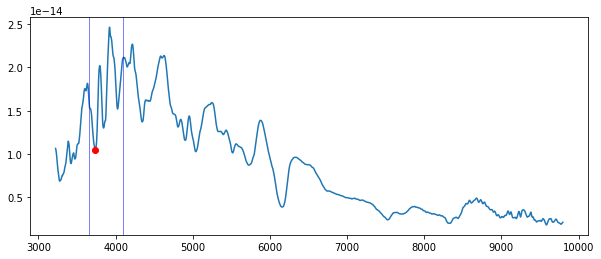

-16241.895696202531 10.8527711937


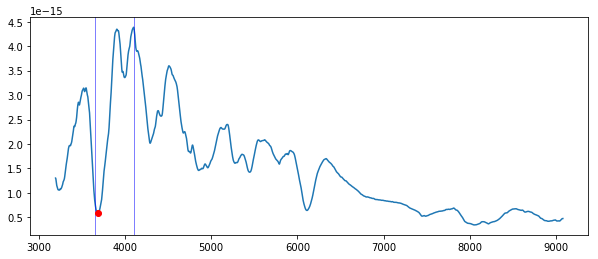

-19733.144303797468 1.24558221383


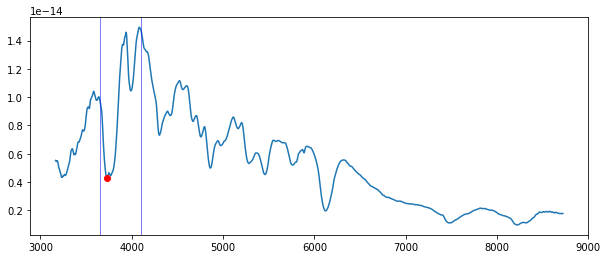

-16697.27594936709 1.89865930599


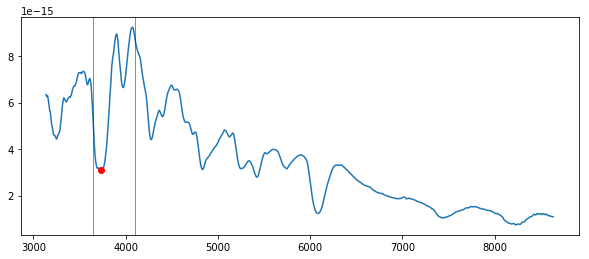

-16090.102278481012 -3.3585017627


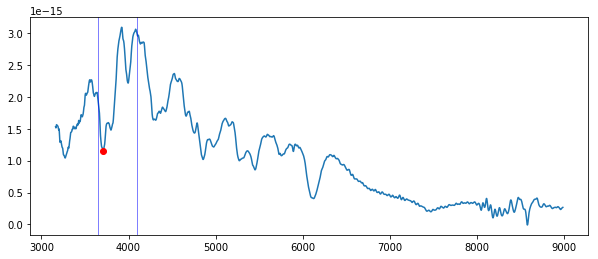

-18215.21012658228 2.34780579806


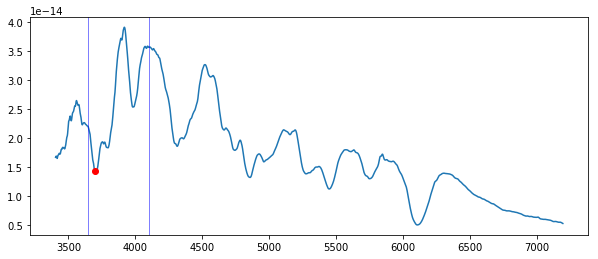

-19125.970632911394 4.00734597415


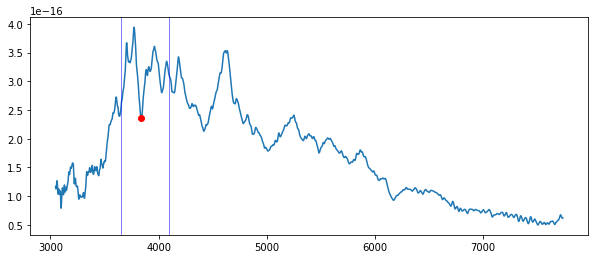

-8348.637974683545 10.8443492832


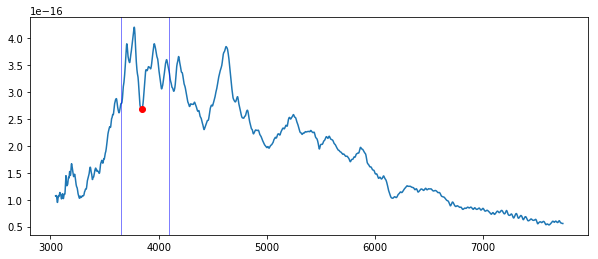

-7893.257721518988 11.7845838764


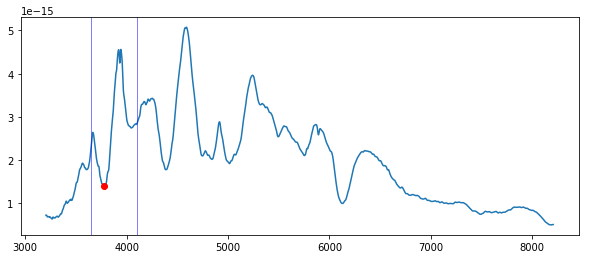

-13509.61417721519 11.7069813176


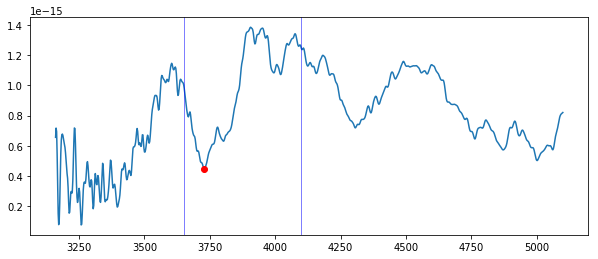

-16849.069367088607 6.72123866693


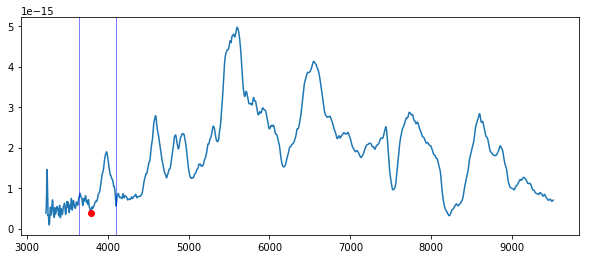

-12143.47341772152 13.5687843326


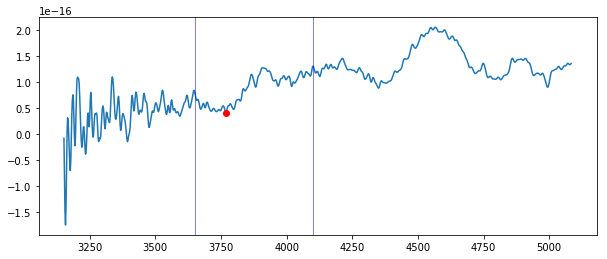

-13813.201012658228 10.6297522598


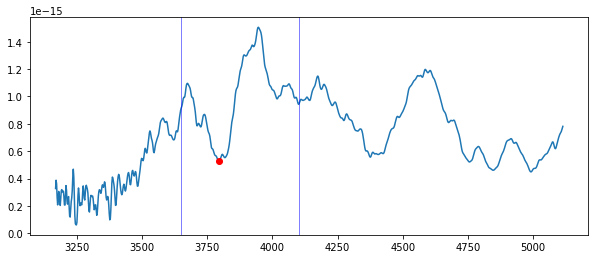

-11839.886582278481 11.0325999052


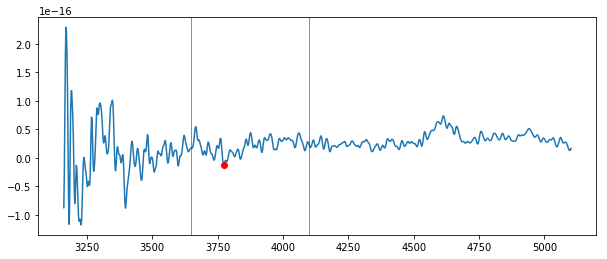

-13357.82075949367 13.0264428524


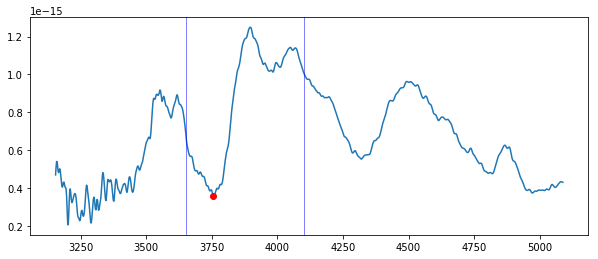

-14723.961518987342 9.95190816019


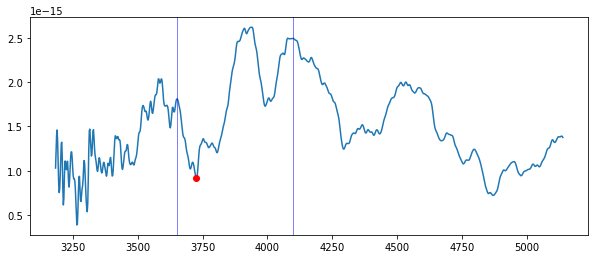

-17000.862784810128 1.64398154899


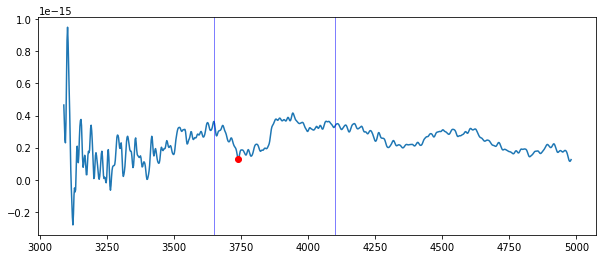

-16090.102278481012 6.62046705908


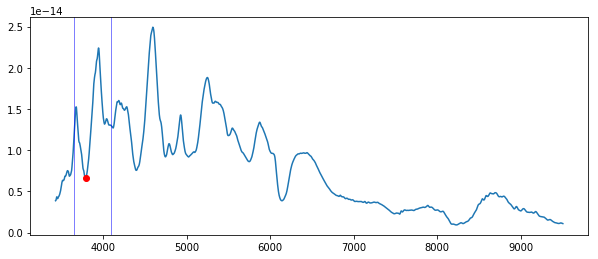

-11991.68 11.5936522839


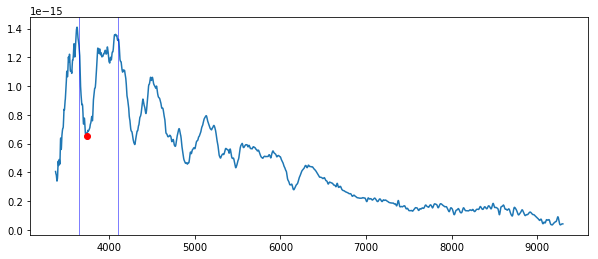

-15938.308860759495 0.1541202449


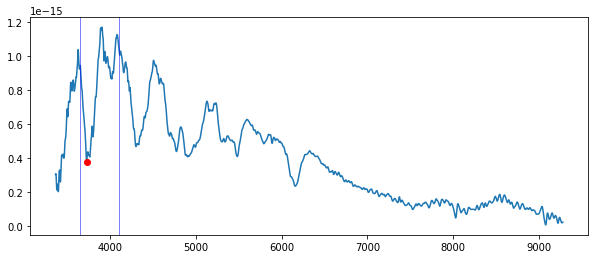

-17000.862784810128 4.9909757264


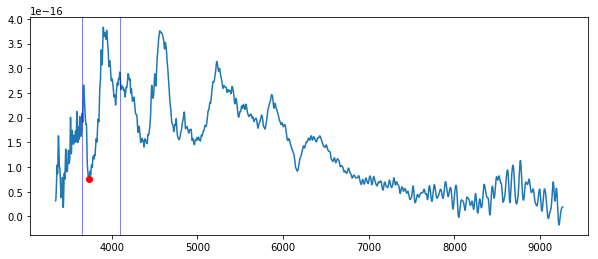

-16545.482531645568 11.7276782512


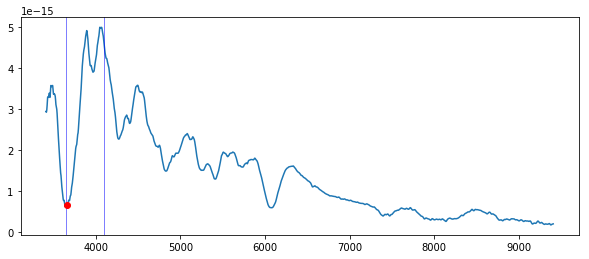

-22313.63240506329 -1.30211916225


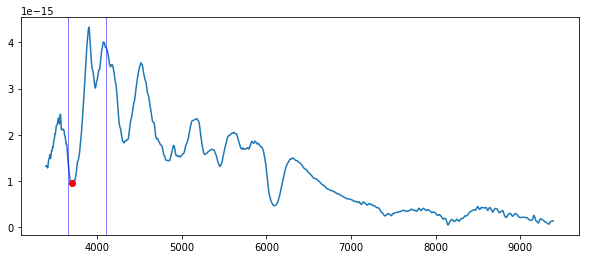

-18670.590379746835 5.59665556821


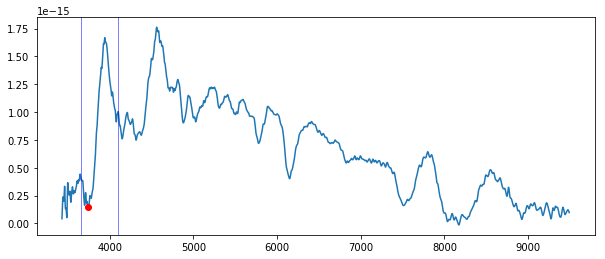

-15938.308860759495 -2.57429400577


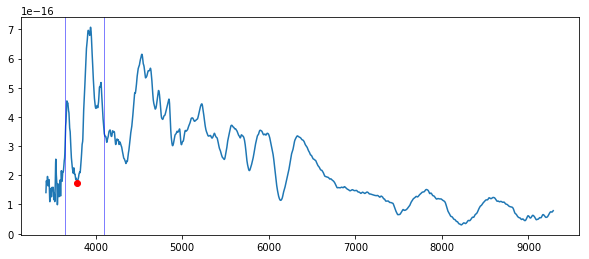

-12447.060253164556 2.36780858807


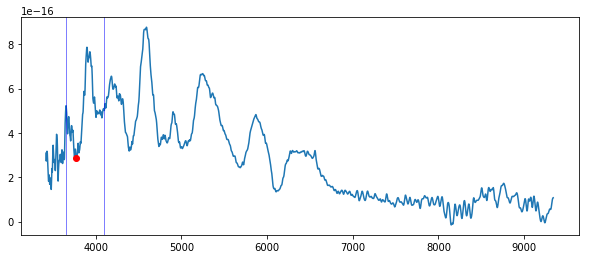

-13357.82075949367 13.226204472


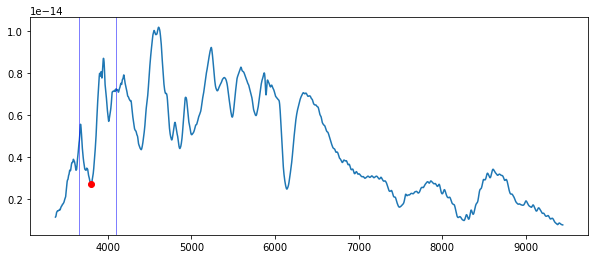

-11384.506329113925 10.5146932401


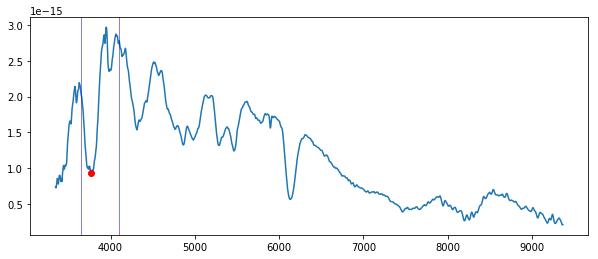

-13661.407594936709 4.32220388007


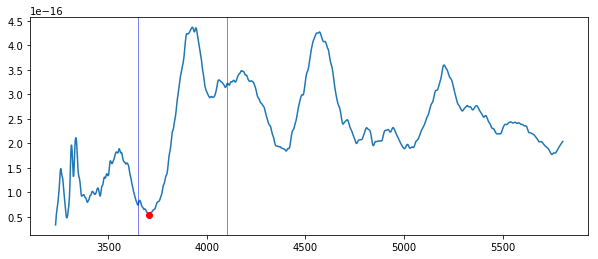

-18518.796962025317 9.92835042037


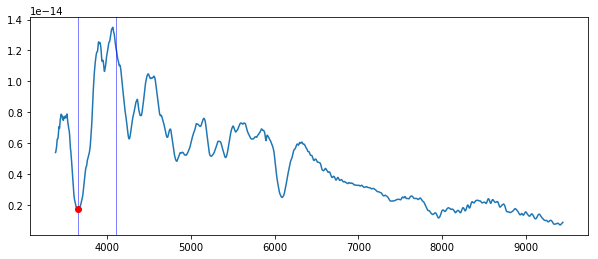

-22617.21924050633 -3.80443042306


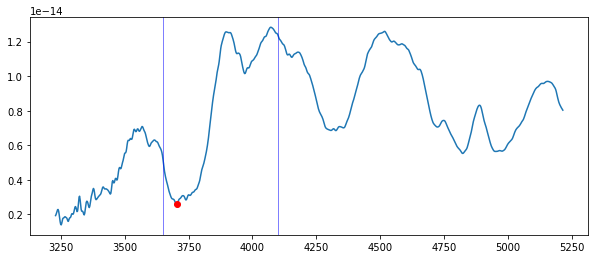

-18670.590379746835 4.19182673242


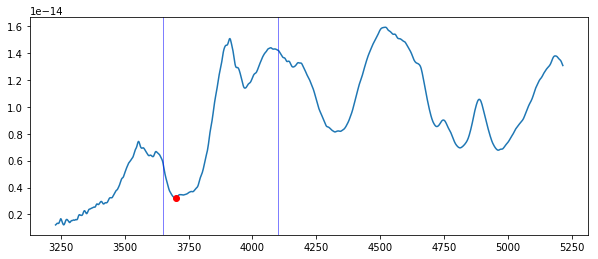

-18974.177215189873 5.18515060268


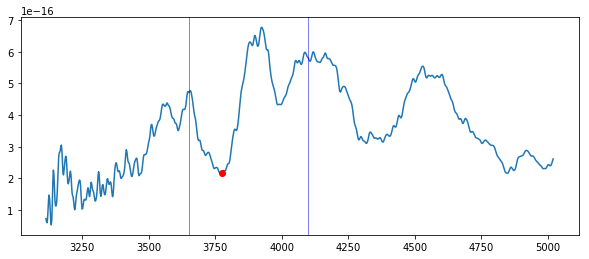

-13357.82075949367 5.28788141208


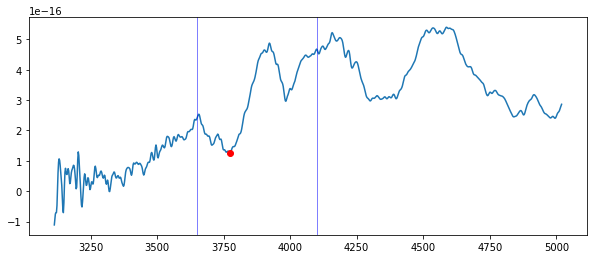

-13357.82075949367 6.24479082434


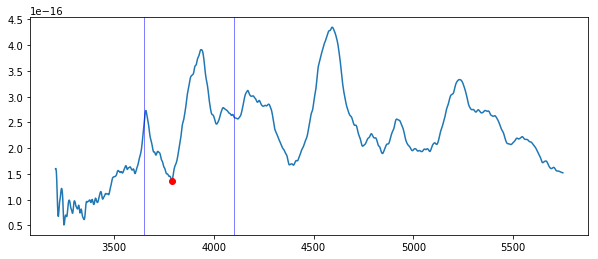

-12143.47341772152 10.9719233208


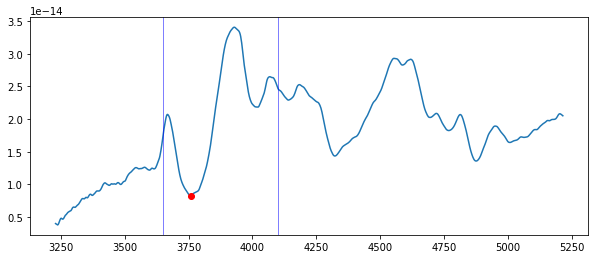

-14420.374683544303 4.03779471254


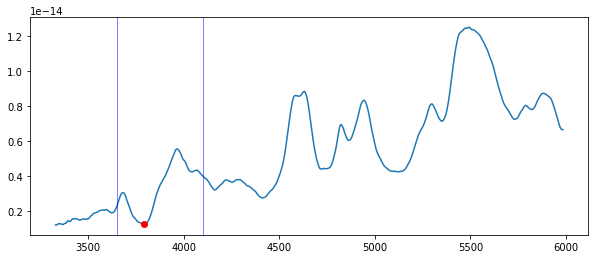

-11991.68 14.9072519351


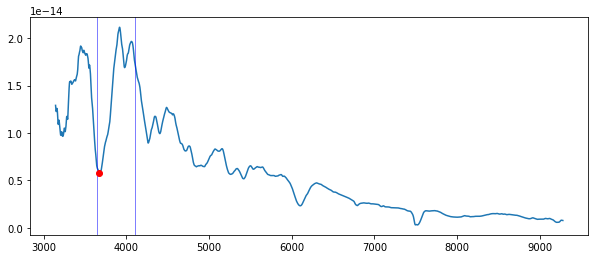

-20947.491645569622 -4.80352915581


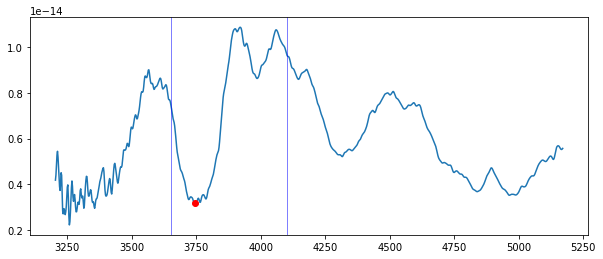

-15634.722025316456 4.19077379591


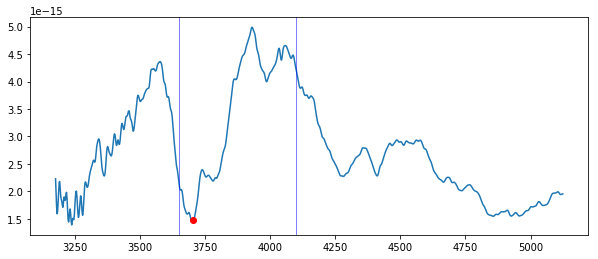

-18670.590379746835 -1.32320342178


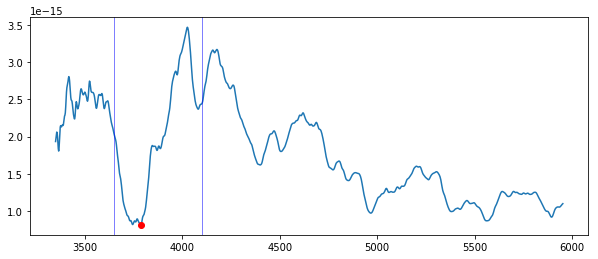

-12295.266835443039 -1.23392521296


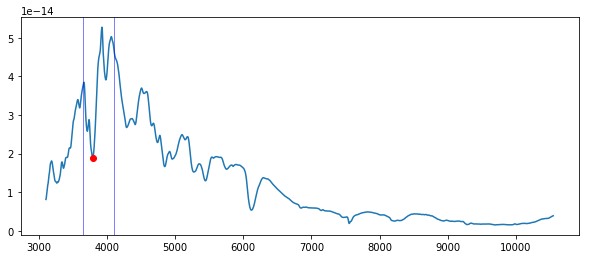

-11839.886582278481 0.0933516726309


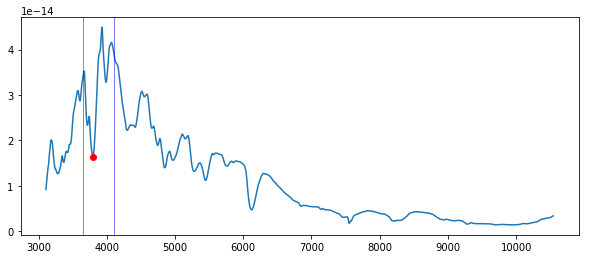

-11688.093164556962 1.08645457299


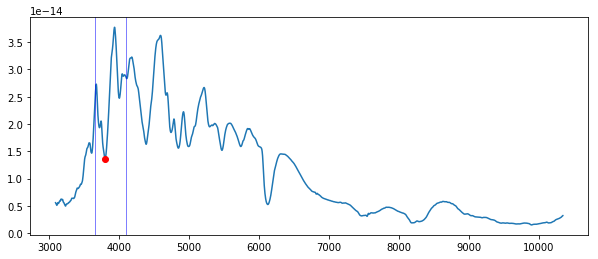

-11688.093164556962 7.04507197513


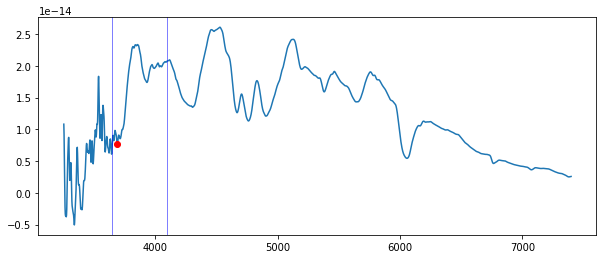

-19581.35088607595 8.0089574521


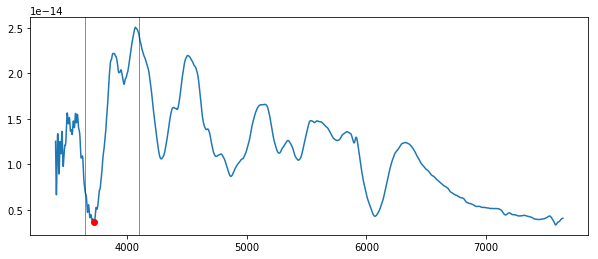

-17304.449620253166 -4.83151437903


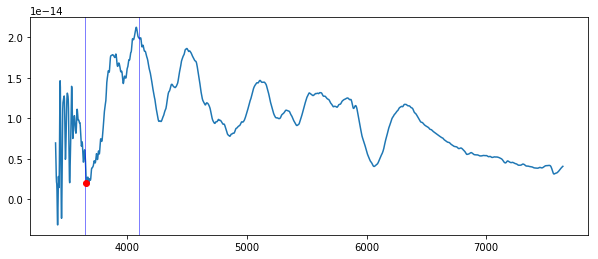

-22010.04556962025 -4.83151437903


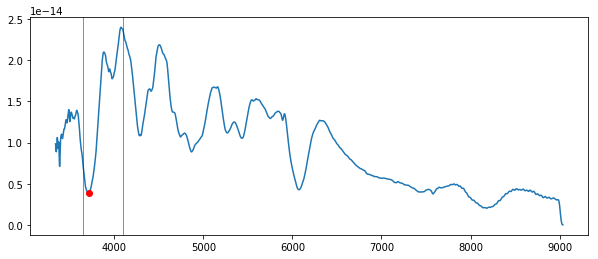

-17759.829873417722 -3.83573647734


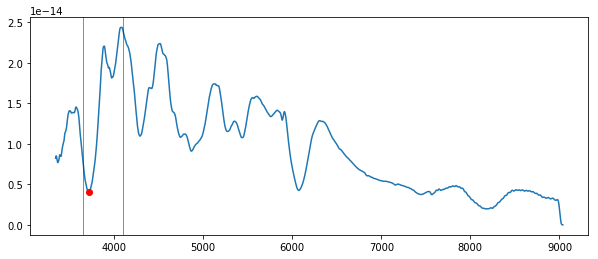

-17911.62329113924 -2.83995857564


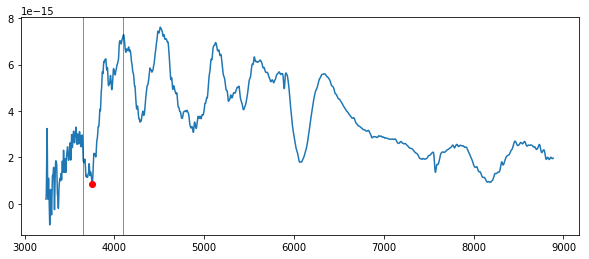

-14875.754936708861 -1.84418067394


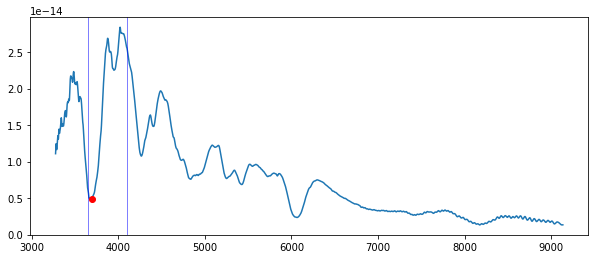

-19429.55746835443 -4.42741330681


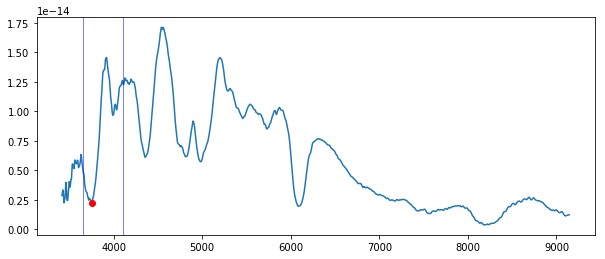

-14875.754936708861 7.46091958237


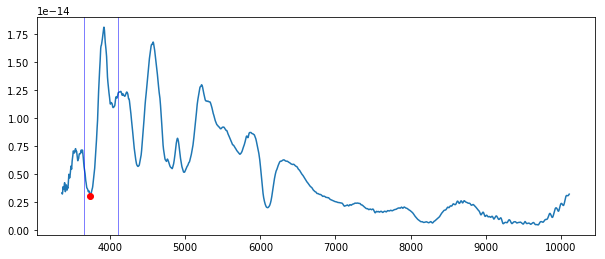

-16090.102278481012 8.4516139898


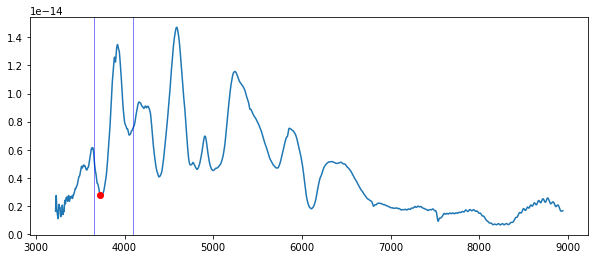

-17000.862784810128 11.4236972121


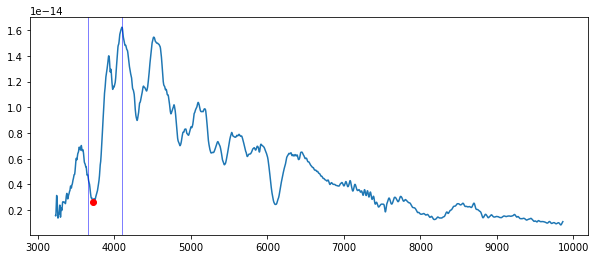

-17759.829873417722 -4.99222165266


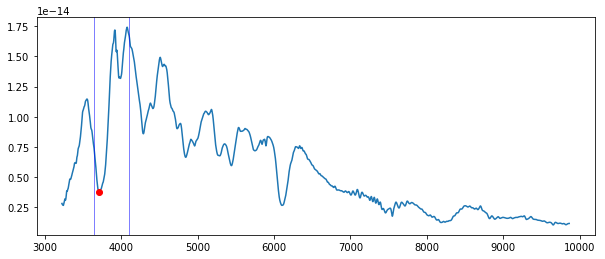

-18063.41670886076 -4.00071784876


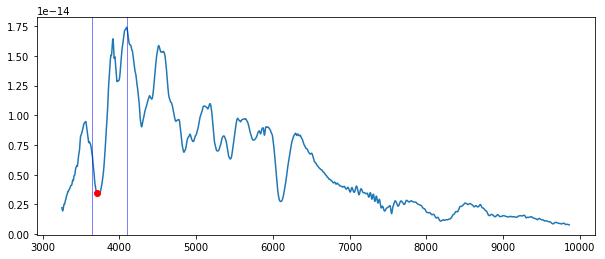

-18215.21012658228 -3.00921404485


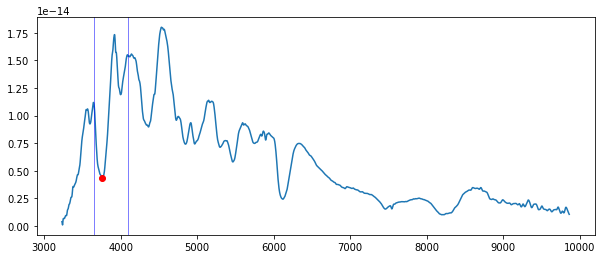

-14268.581265822784 1.94830497467


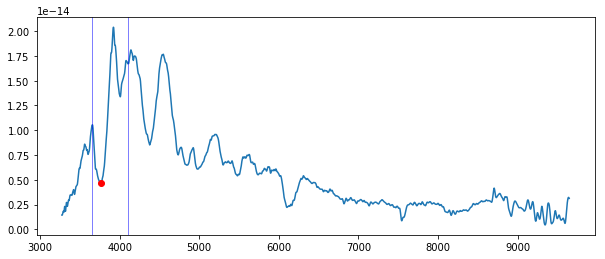

-13661.407594936709 3.93131258248


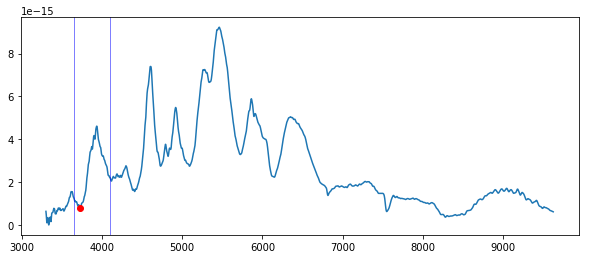

-17000.862784810128 13.8463506215


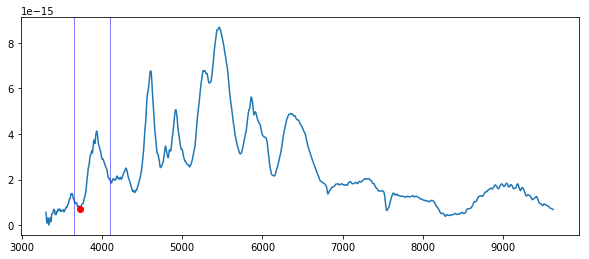

-17000.862784810128 14.8378544254


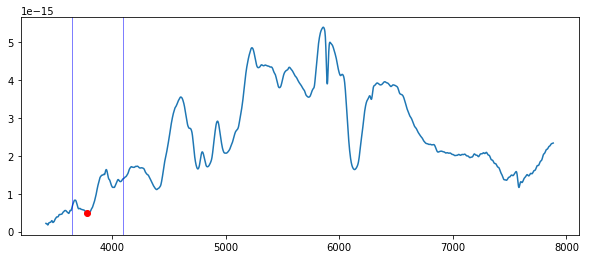

-12750.647088607595 9.67902562417


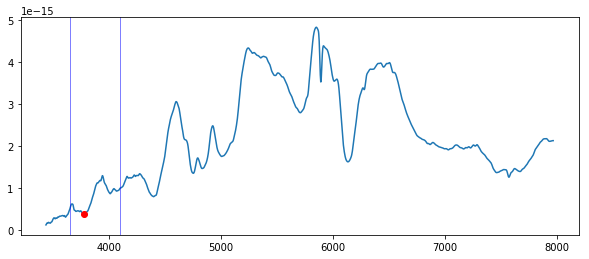

-13206.027341772153 10.6749126109


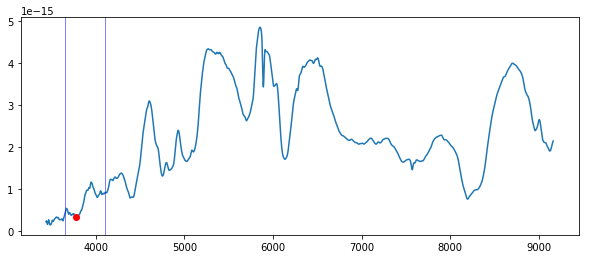

-12750.647088607595 11.6707995977


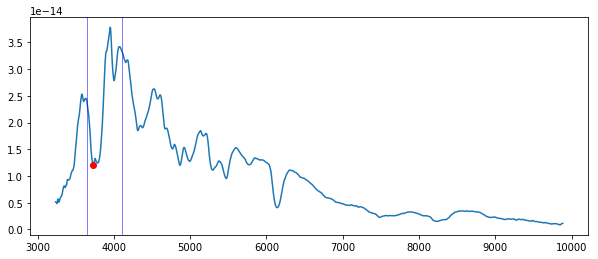

-16697.27594936709 2.6162975564


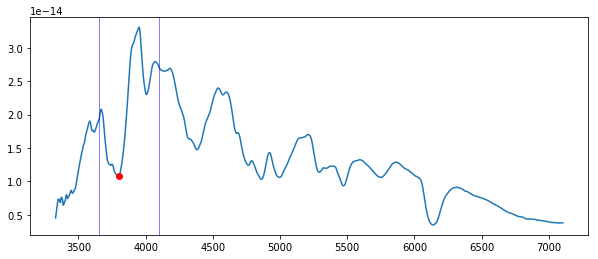

-11232.712911392406 5.59726704717


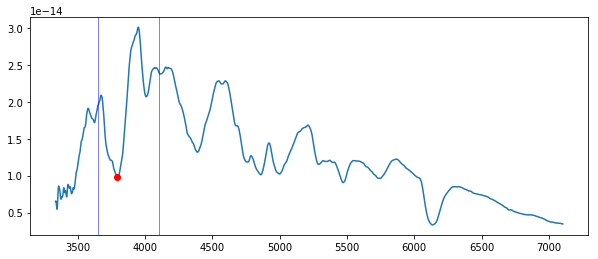

-11991.68 6.5909235441


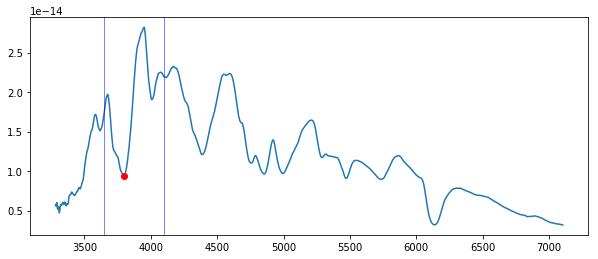

-11688.093164556962 7.58458004102


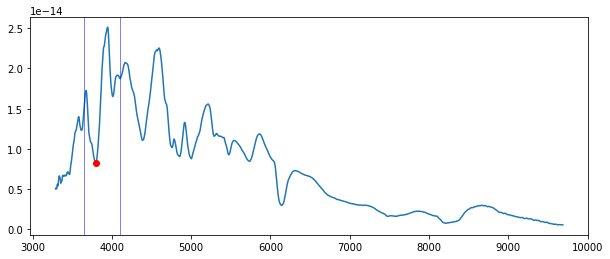

-11839.886582278481 8.57823653794


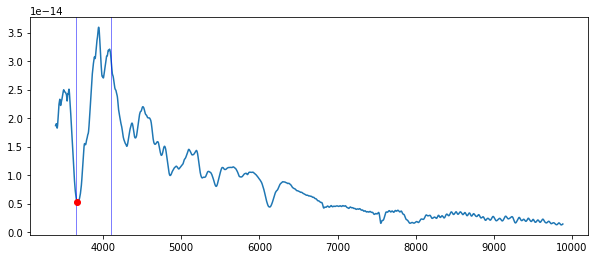

-20947.491645569622 -4.30021630247


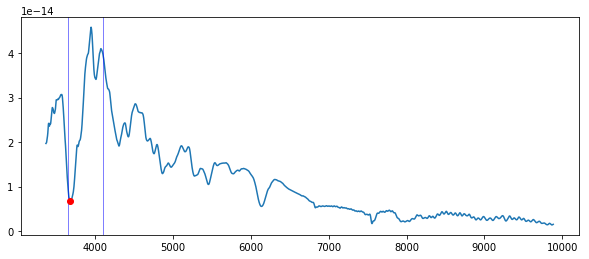

-20492.111392405062 -3.30663582593


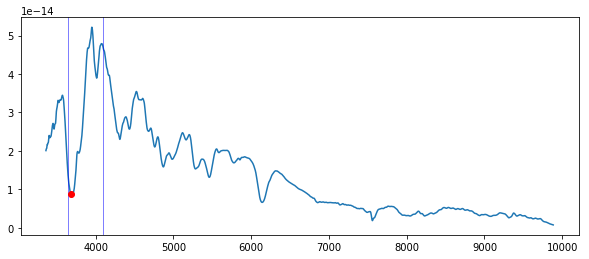

-20188.524556962024 -1.31947487285


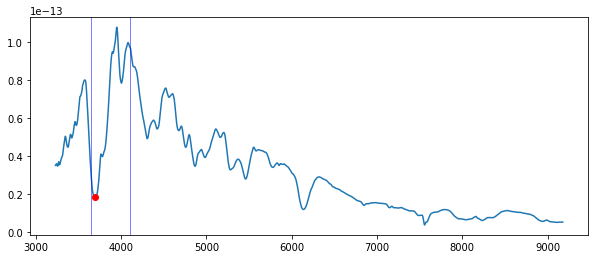

-19125.970632911394 -0.325894396307


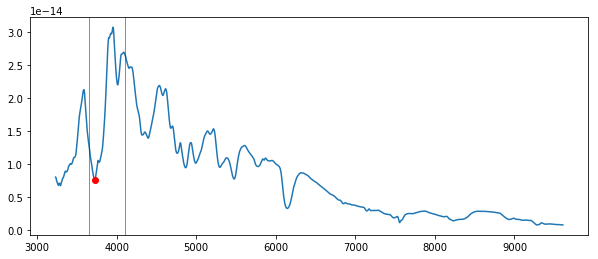

-17304.449620253166 3.64842750986


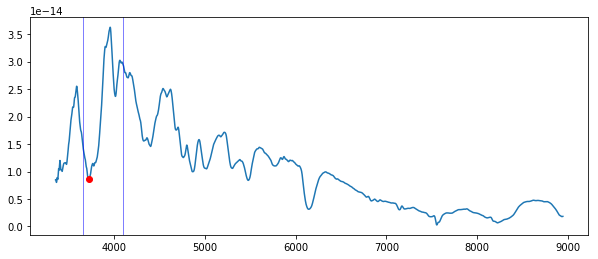

-17608.0364556962 4.6420079864


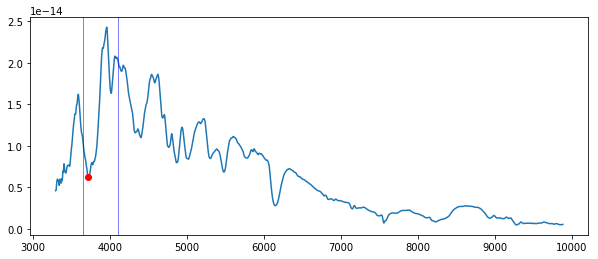

-17608.0364556962 5.63558846294


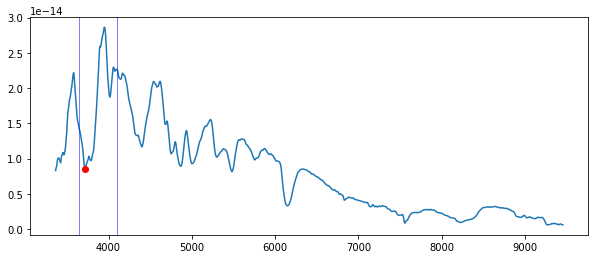

-17608.0364556962 6.62916893948


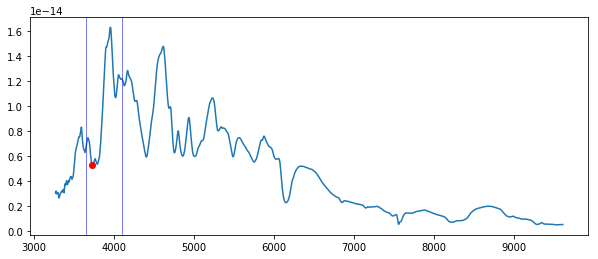

-17000.862784810128 8.61632989256


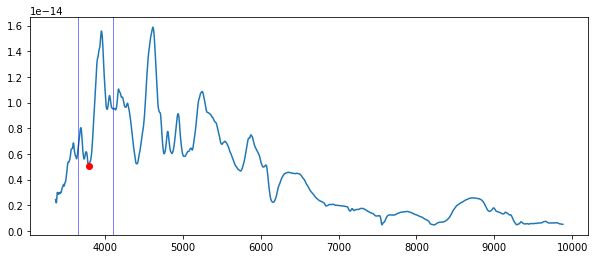

-12295.266835443039 11.5970713222


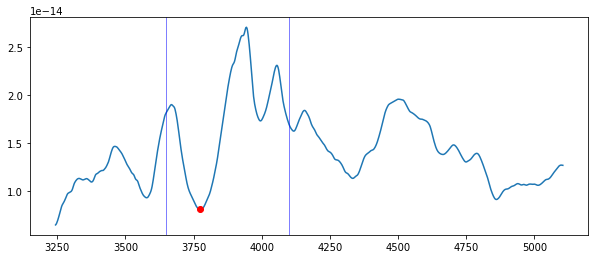

-13357.82075949367 -1.58040848701


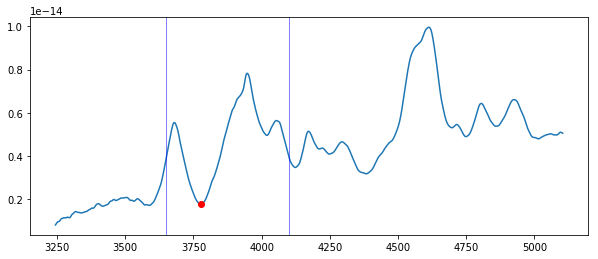

-13206.027341772153 12.3002181241


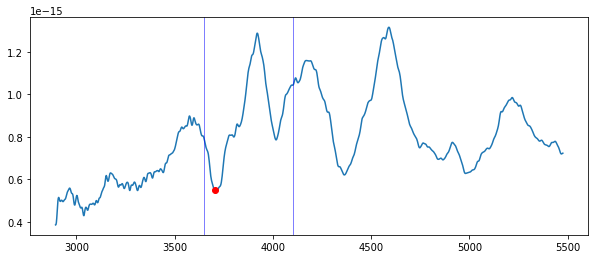

-18670.590379746835 8.31841777288


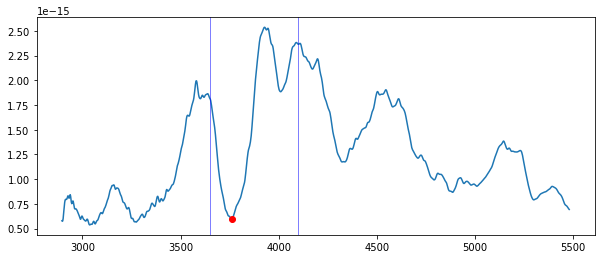

-14420.374683544303 2.64482685271


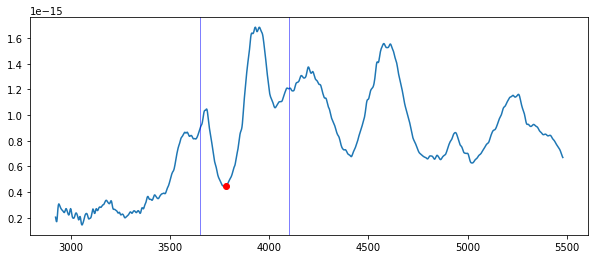

-12902.440506329114 10.4151591413


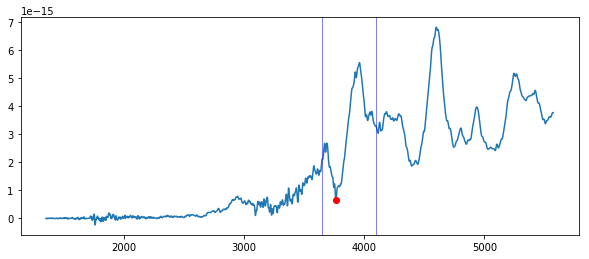

-14116.787848101267 10.1171716534


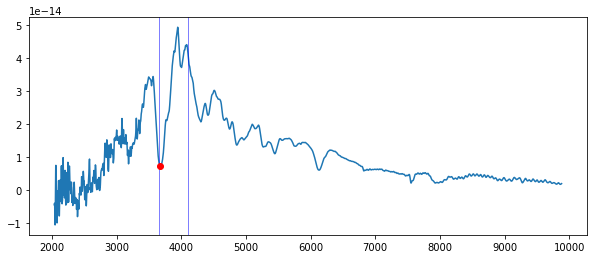

-20947.491645569622 -3.30663582593


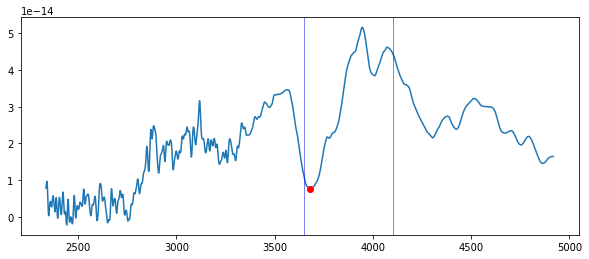

-20492.111392405062 -2.31305534939


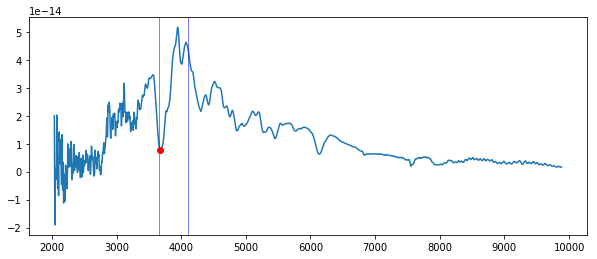

-20492.111392405062 -2.31305534939


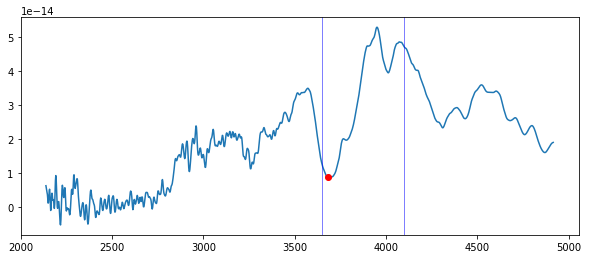

-20188.524556962024 -1.31947487285


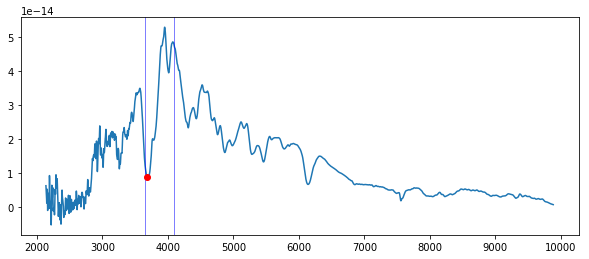

-20188.524556962024 -1.31947487285


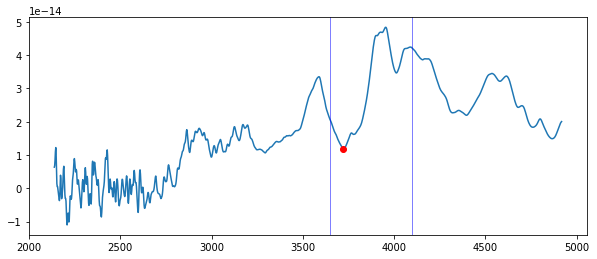

-17304.449620253166 4.6420079864


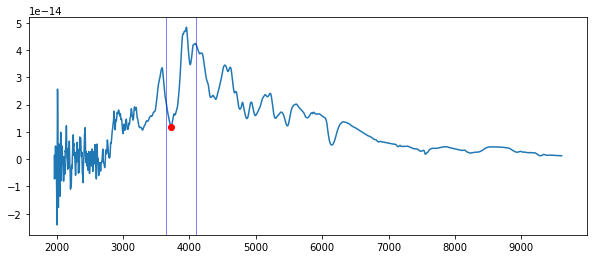

-17304.449620253166 4.6420079864


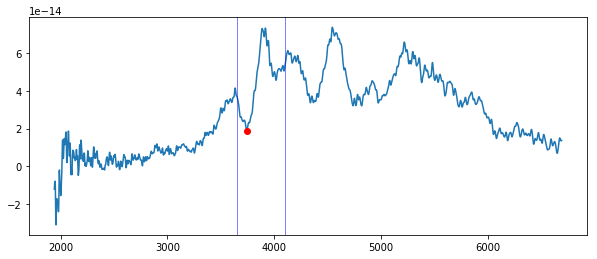

-15786.515443037975 11.1


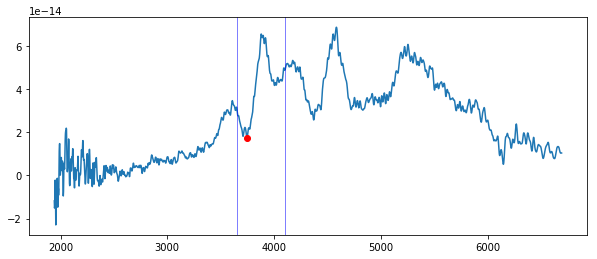

-15482.928607594937 12.1


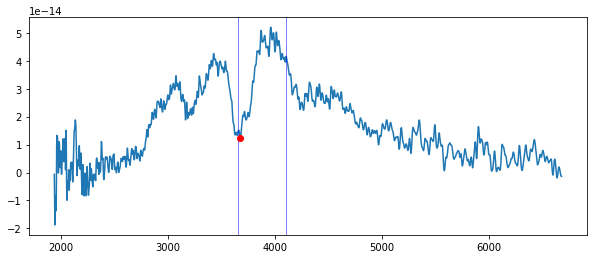

-20947.491645569622 -4.6


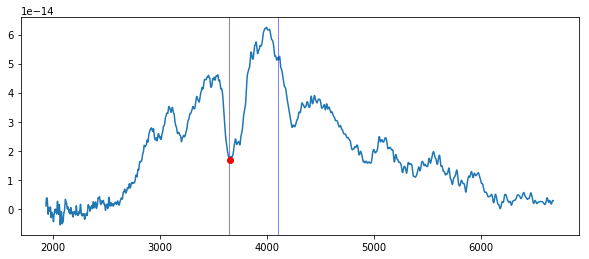

-22617.21924050633 -2.3


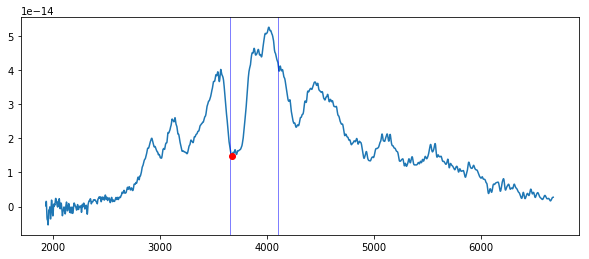

-21251.078481012657 1.3


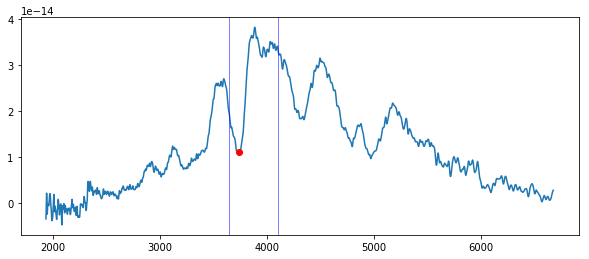

-16090.102278481012 8.2


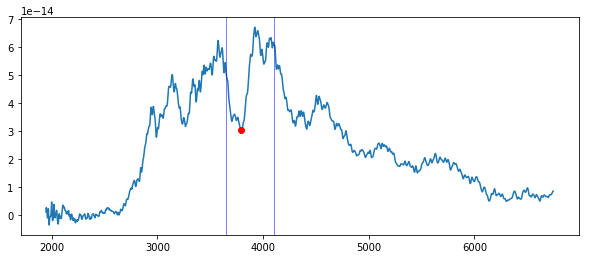

-12143.47341772152 -4.4


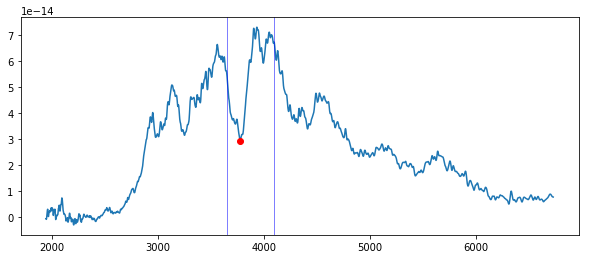

-13054.233924050634 -2.6


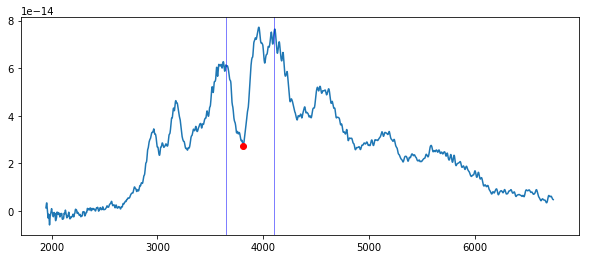

-10473.745822784811 0.6


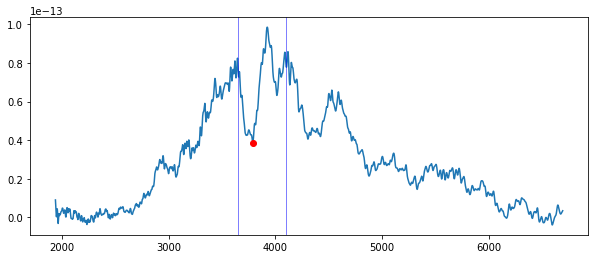

-12295.266835443039 -4.1


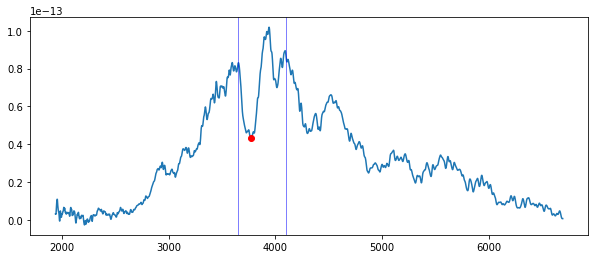

-13357.82075949367 -3.5


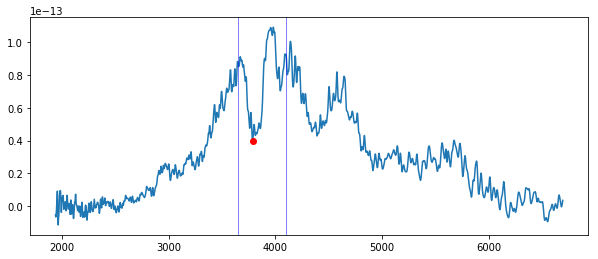

-12447.060253164556 -1.2


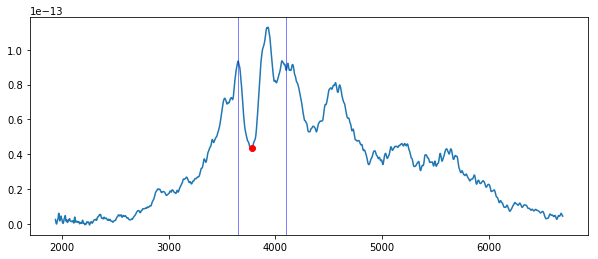

-12750.647088607595 0.5


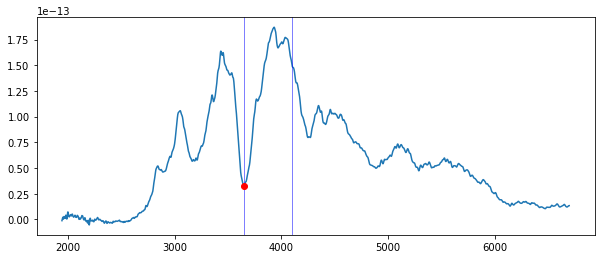

-22617.21924050633 -4.8


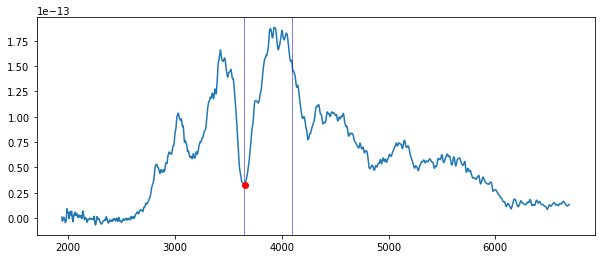

-22617.21924050633 -4.3


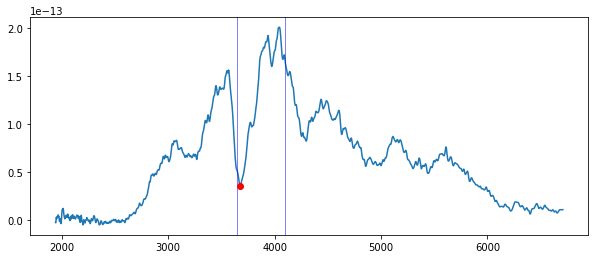

-20947.491645569622 -0.9


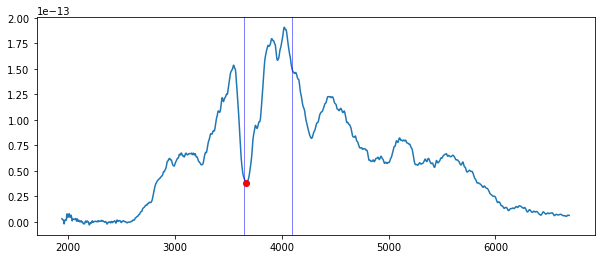

-21554.665316455696 0.9


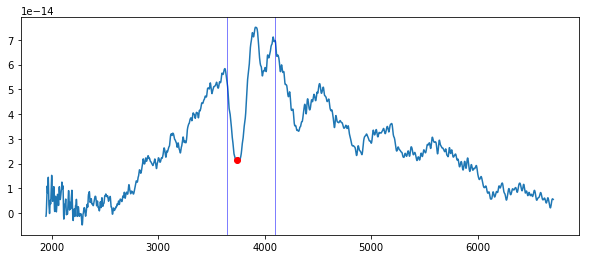

-15938.308860759495 -3.1


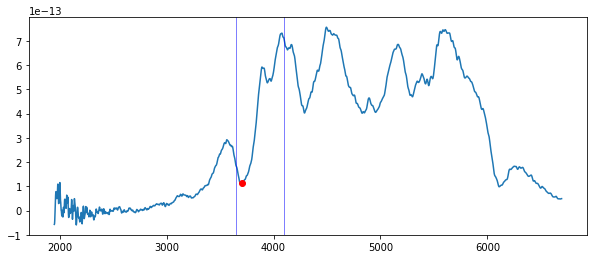

-18822.383797468356 2.1


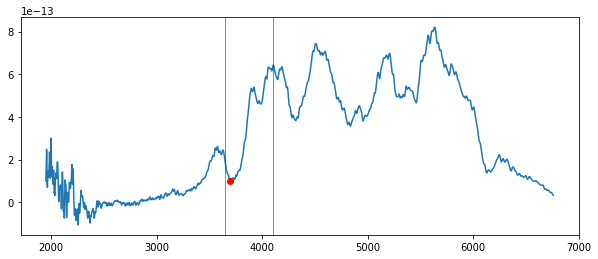

-19277.76405063291 3.9


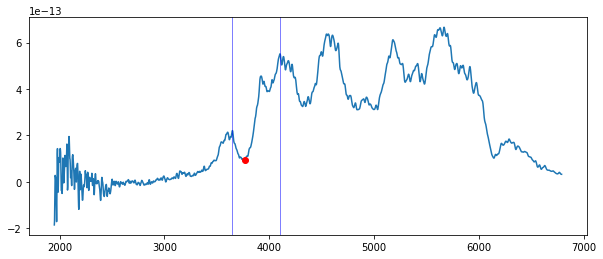

-13813.201012658228 4.9


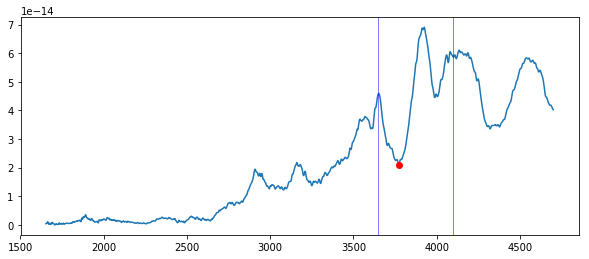

-13509.61417721519 4.9


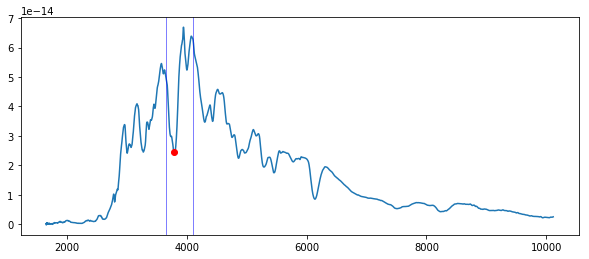

-11991.68 0.1


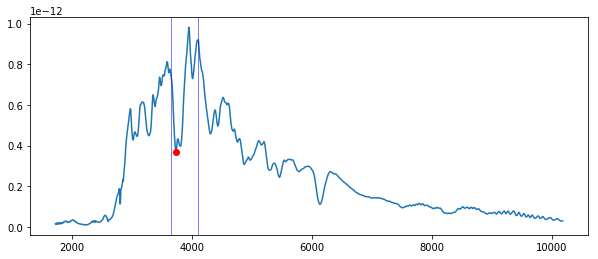

-16545.482531645568 -2.9


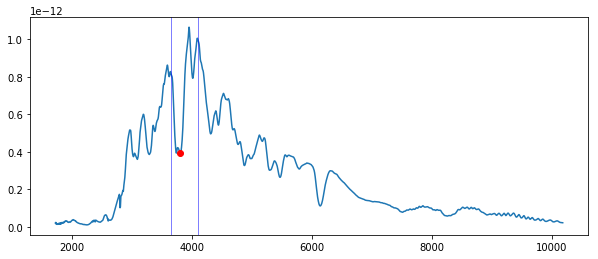

-11384.506329113925 0.1


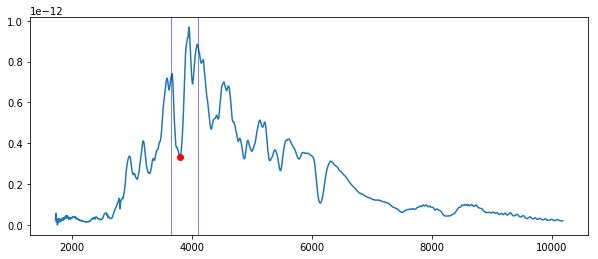

-11384.506329113925 3.4


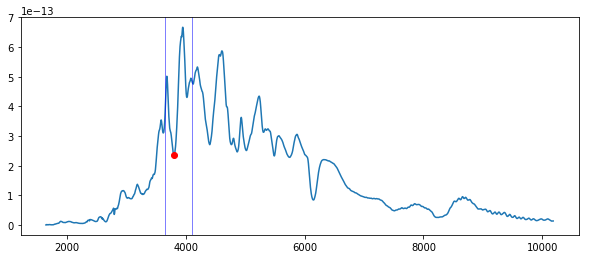

-10929.126075949367 9.3


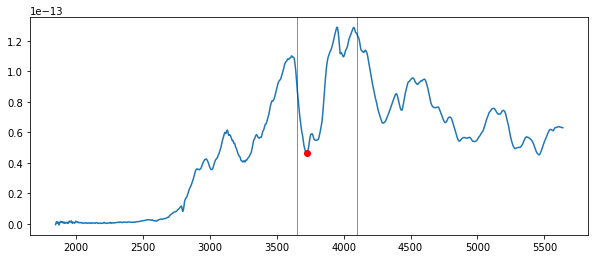

-17000.862784810128 2.1


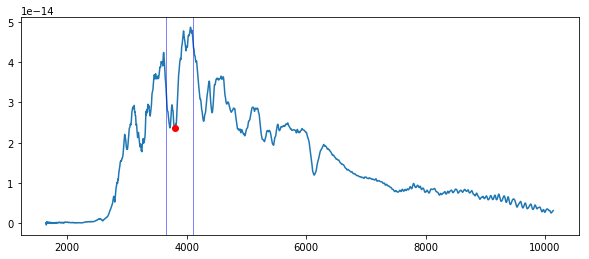

-11536.299746835442 -2.5


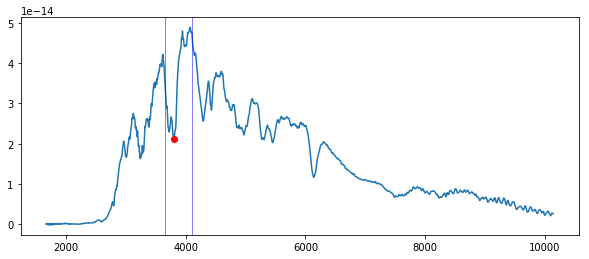

-11384.506329113925 -0.8


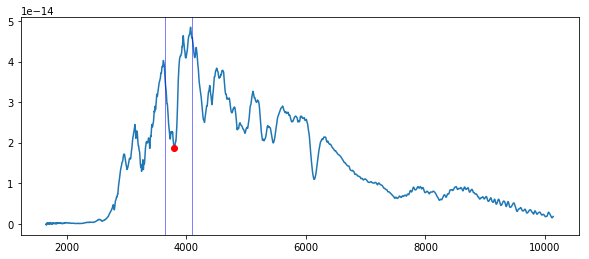

-11839.886582278481 1.2


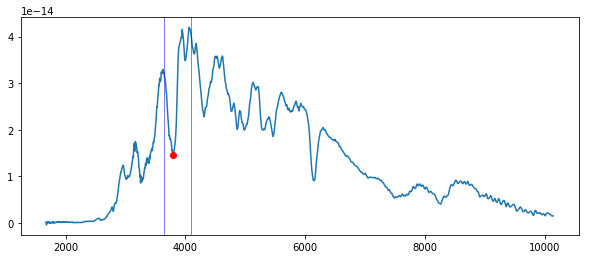

-11536.299746835442 4.5


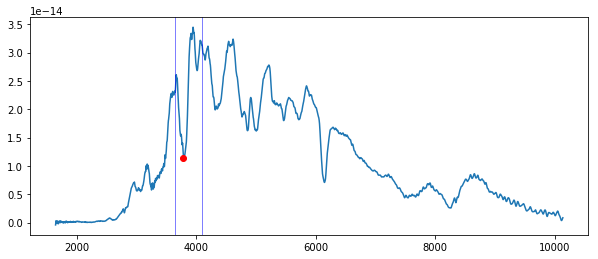

-12447.060253164556 8.4


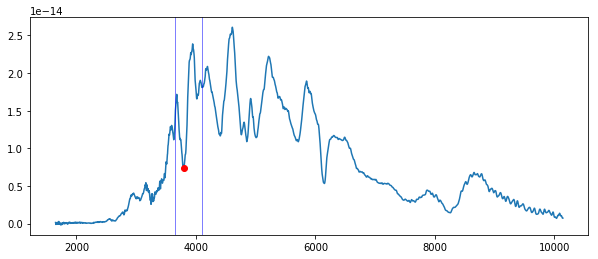

-11384.506329113925 12.0


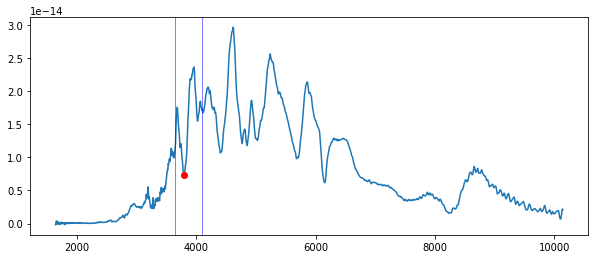

-12295.266835443039 14.0


In [31]:
ca_velocities = []
ca_velocities_file = []
for SN in ca_v_SN_Array:
    
    wavelength = SN.wavelength[SN.x1:SN.x2]
    flux = autosmooth(wavelength, SN.flux[SN.x1:SN.x2], 1 / SN.ivar[SN.x1:SN.x2])
    
    min_wave = find_min_wave(wavelength, flux, 3650, 4100)
    coflux = flux[np.where(wavelength == min_wave)[0]]
    
    plt.figure(figsize=(10,4))
    plt.plot(wavelength, flux)
    plt.axvline(x=3650, linewidth=0.5, color="blue")
    plt.axvline(x=4100, linewidth=0.5, color="blue")
    plt.plot(min_wave, coflux,"o", color = "red")
    plt.show()

    v = ca_velocity(min_wave)
    print v, SN.phase
    ca_velocities.append(v)
    ca_velocities_file.append(SN.filename)

# Calcium Velocity Evolution

In [21]:
ca_v_evo_query = "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -5 and phase <= 20"# and minwave <= 3400 and maxwave >= 4100"# and source != 'swift_uv'"

In [22]:
ca_v_evo_SN_Array = composite.grab(ca_v_evo_query, multi_epoch = True, make_corr = True)

('ERROR: ', u'2002bo_20020403_0_2_00.dat', None)
('ERROR: ', u'sn2006oa-20061122-not.dat', None)
('ERROR: ', u'sn2007jg-20070918-not.dat', None)
('ERROR: ', u'sn1992a-19920116.220-iue.flm', None)
172 questionable files currently ignored
('Generate variance failed for: ', [u'sn2004dt-20040820-hst.flm', u'sn2004dt-20040823-hst.flm', u'sn2004ef-20040914-hst.flm', u'sn2004ef-20040918-hst.flm', u'sn2005cf-20050611-hst.flm', u'sn2005cf-20050614-hst.flm', u'sn2005m-20050131-hst.flm'])
159 questionable spectra removed 2036 spectra left
40 Peculiar Ias removed 1996 spectra left
(873, 'spectra with host corrections')
(873, 'valid SNe found')
Arrays cleaned


In [30]:
class SN_ca_v_data:
    def __init__(self, name, files, phases, ca_velocities, sources):
        self.name = name
        self.files = files
        self.phases = phases
        self.ca_velocities = ca_velocities
        self.sources = sources

Grabbing phase and calcium velocity data...
Minimum violation


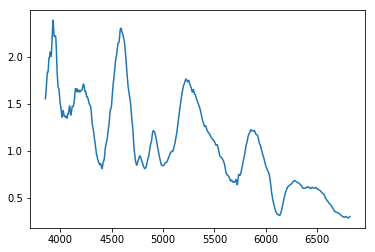

Instance number 1 completed
Instance number 2 completed
Instance number 3 completed
Instance number 4 completed
Instance number 5 completed
Instance number 6 completed
Instance number 7 completed
Instance number 8 completed
Minimum violation


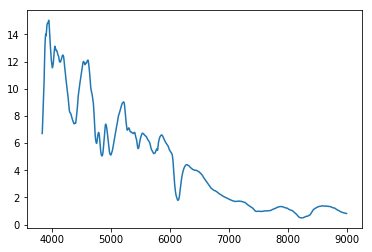

Instance number 9 completed
Instance number 10 completed
Minimum violation


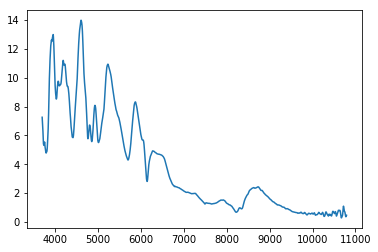

Instance number 11 completed
Instance number 12 completed
Minimum violation


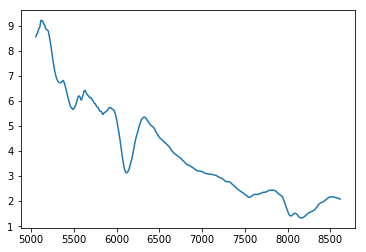

Instance number 13 completed
Instance number 14 completed
Instance number 15 completed
Instance number 16 completed
Instance number 17 completed
Instance number 18 completed
Instance number 19 completed
Instance number 20 completed
Instance number 21 completed
Instance number 22 completed
Instance number 23 completed
Minimum violation


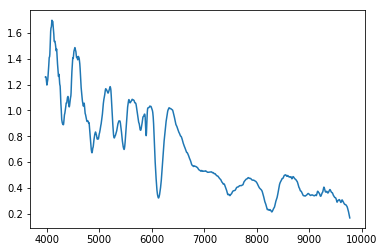

Instance number 24 completed
Instance number 25 completed
Instance number 26 completed
Instance number 27 completed
Instance number 28 completed
Instance number 29 completed
Instance number 30 completed
Instance number 31 completed
Instance number 32 completed
Instance number 33 completed
Instance number 34 completed
Instance number 35 completed
Instance number 36 completed
Instance number 37 completed
Instance number 38 completed
Minimum violation


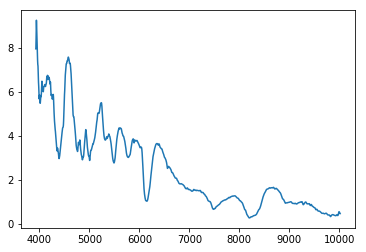

Instance number 39 completed
Minimum violation


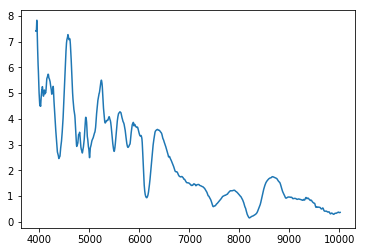

Instance number 40 completed
Instance number 41 completed
Instance number 42 completed
Instance number 43 completed
Minimum violation


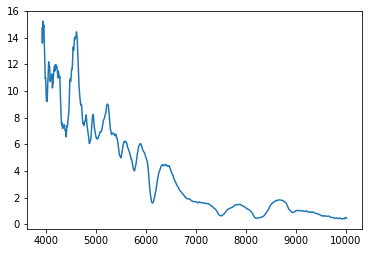

Instance number 44 completed
Instance number 45 completed
Instance number 46 completed
Instance number 47 completed
Instance number 48 completed
Instance number 49 completed
Instance number 50 completed
Instance number 51 completed
Instance number 52 completed
Instance number 53 completed
Instance number 54 completed
Instance number 55 completed
Instance number 56 completed
Instance number 57 completed
Instance number 58 completed


C:\Anaconda3\envs\py27\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in divide
  import sys


Minimum violation


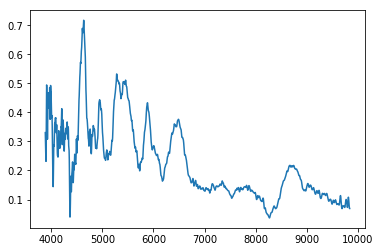

Instance number 59 completed
Minimum violation


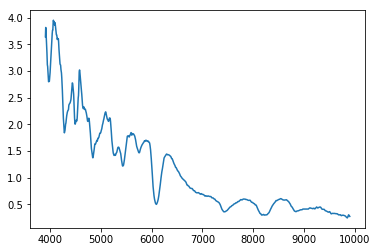

Instance number 60 completed
Instance number 61 completed
Instance number 62 completed
Instance number 63 completed
Instance number 64 completed
Instance number 65 completed
Instance number 66 completed
Instance number 67 completed
Instance number 68 completed
Instance number 69 completed
Instance number 70 completed
Instance number 71 completed
Instance number 72 completed
Instance number 73 completed
Instance number 74 completed
Instance number 75 completed
Instance number 76 completed
Instance number 77 completed
Instance number 78 completed
Instance number 79 completed
Instance number 80 completed
Instance number 81 completed
Minimum violation


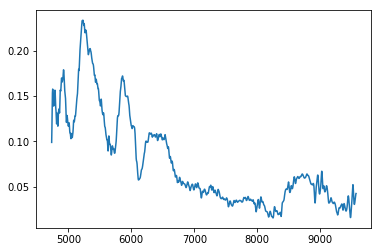

Instance number 82 completed
Minimum violation


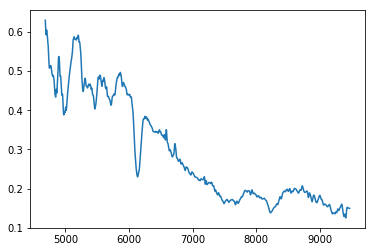

Instance number 83 completed
Minimum violation


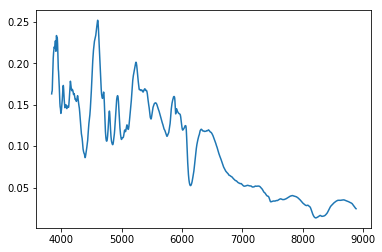

Instance number 84 completed
Instance number 85 completed
Minimum violation


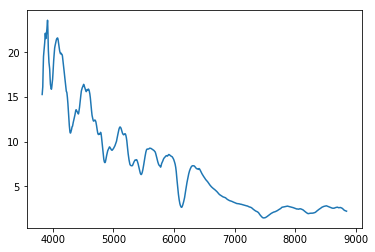

Instance number 86 completed
Instance number 87 completed
Minimum violation


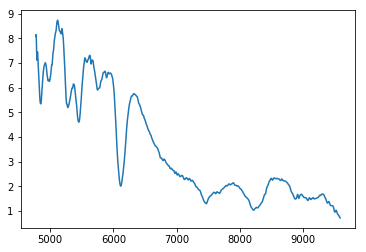

Instance number 88 completed
Instance number 89 completed
Instance number 90 completed
Instance number 91 completed
Instance number 92 completed
Instance number 93 completed
Instance number 94 completed
Instance number 95 completed
Instance number 96 completed
Instance number 97 completed
Instance number 98 completed
Instance number 99 completed
Instance number 100 completed
Instance number 101 completed
Instance number 102 completed
Instance number 103 completed
Instance number 104 completed
Instance number 105 completed
Instance number 106 completed
Instance number 107 completed
Instance number 108 completed
Instance number 109 completed
Instance number 110 completed
Instance number 111 completed
Instance number 112 completed
Instance number 113 completed
Instance number 114 completed
Instance number 115 completed
Instance number 116 completed
Instance number 117 completed
Instance number 118 completed
Instance number 119 completed
Instance number 120 completed
Instance number 121 co

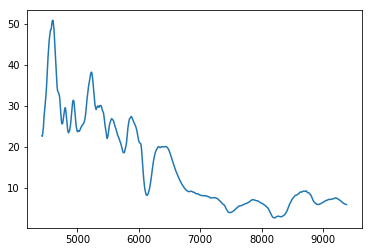

Instance number 139 completed
Instance number 140 completed
Instance number 141 completed
Minimum violation


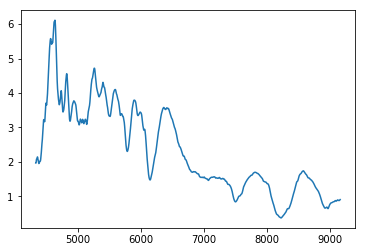

Instance number 142 completed
Minimum violation


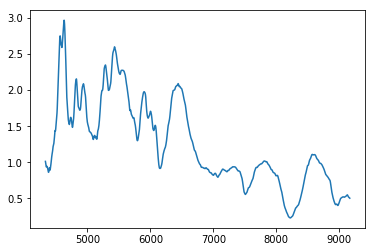

Instance number 143 completed
Instance number 144 completed
Instance number 145 completed
Instance number 146 completed
Instance number 147 completed
Instance number 148 completed
Instance number 149 completed
Instance number 150 completed
Instance number 151 completed
Instance number 152 completed
Instance number 153 completed
Instance number 154 completed
Minimum violation


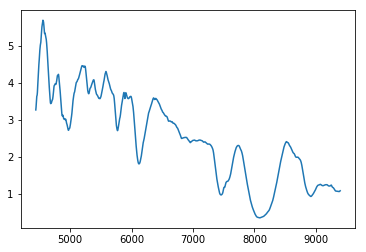

Instance number 155 completed
Minimum violation


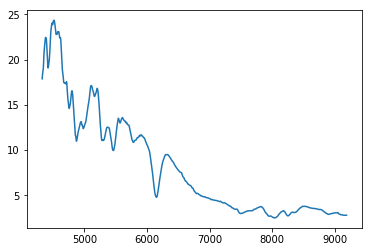

Instance number 156 completed
Instance number 157 completed
Instance number 158 completed
Instance number 159 completed
Instance number 160 completed
Instance number 161 completed
Minimum violation


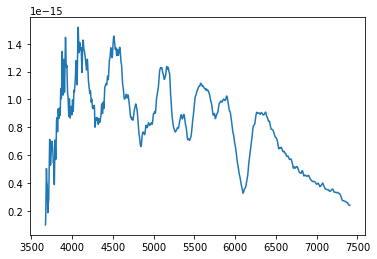

Instance number 162 completed
Minimum violation


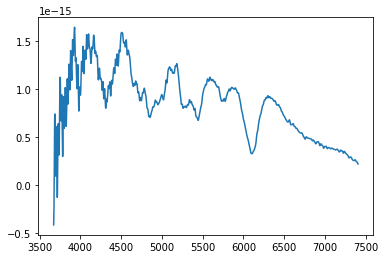

Instance number 163 completed
Minimum violation


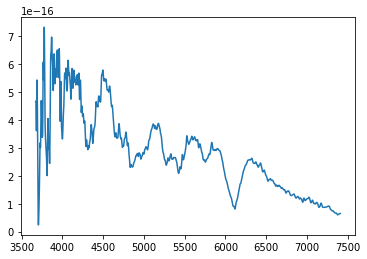

Instance number 164 completed
Minimum violation


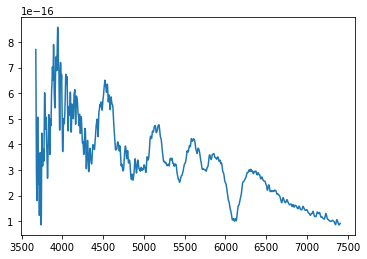

Instance number 165 completed
Minimum violation


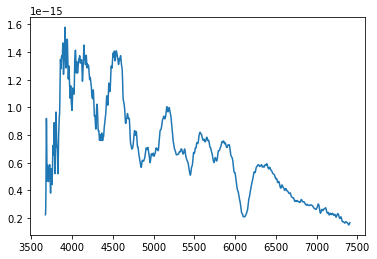

Instance number 166 completed
Minimum violation


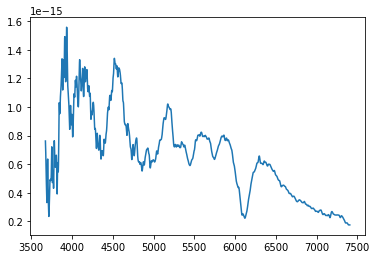

Instance number 167 completed
Instance number 168 completed
Instance number 169 completed
Minimum violation


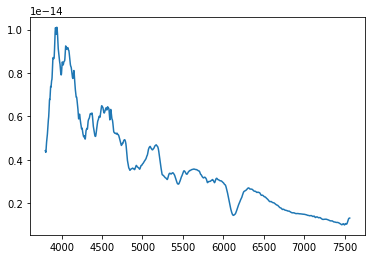

Instance number 170 completed
Minimum violation


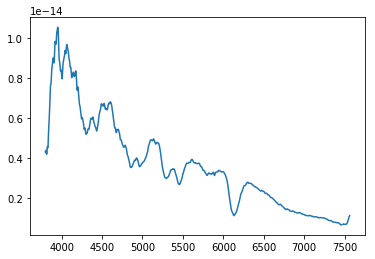

Instance number 171 completed
Minimum violation


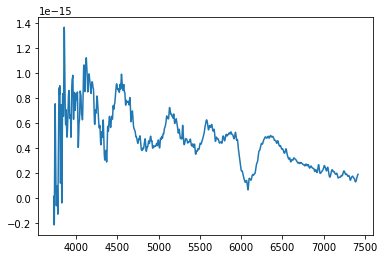

Instance number 172 completed
Minimum violation


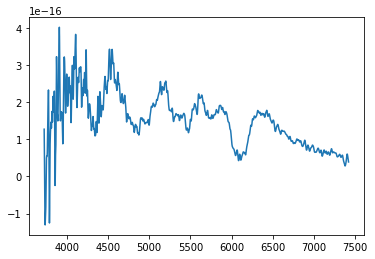

Instance number 173 completed
Minimum violation


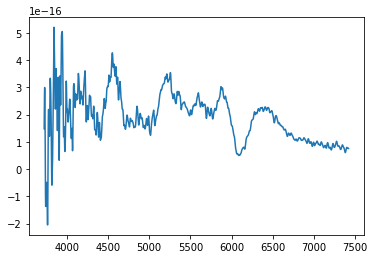

Instance number 174 completed
Instance number 175 completed
Minimum violation


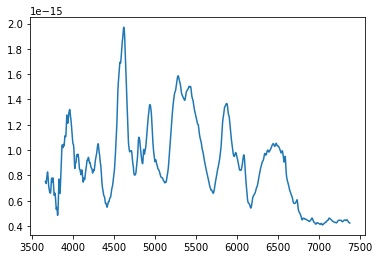

Instance number 176 completed
Minimum violation


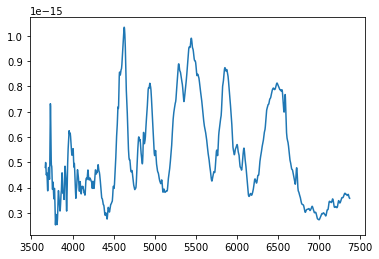

Instance number 177 completed
Minimum violation


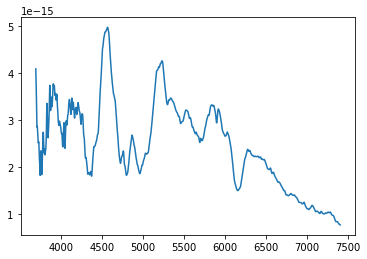

Instance number 178 completed
Instance number 179 completed
Instance number 180 completed
Instance number 181 completed
Instance number 182 completed
Instance number 183 completed
Instance number 184 completed
Instance number 185 completed
Instance number 186 completed
Instance number 187 completed
Instance number 188 completed
Instance number 189 completed
Minimum violation


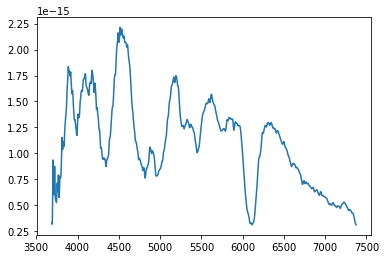

Instance number 190 completed
Minimum violation


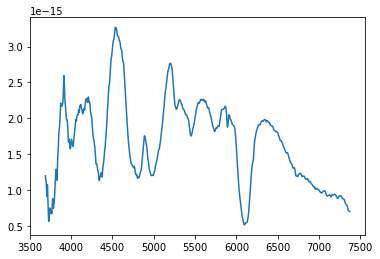

Instance number 191 completed
Minimum violation


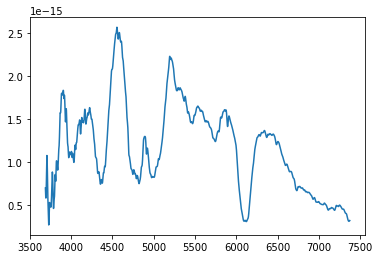

Instance number 192 completed
Minimum violation


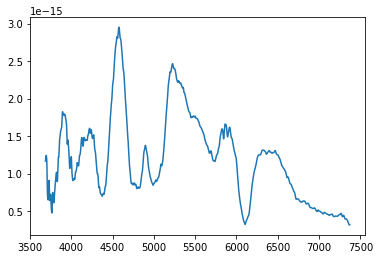

Instance number 193 completed
Minimum violation


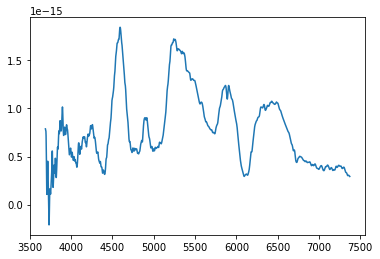

Instance number 194 completed
Minimum violation


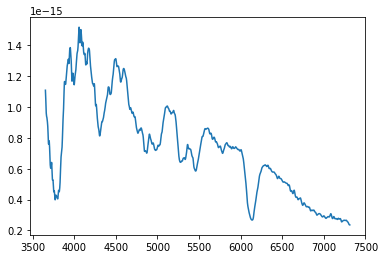

Instance number 195 completed
Minimum violation


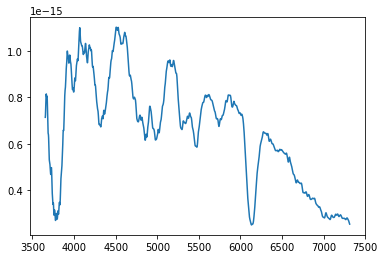

Instance number 196 completed
Instance number 197 completed
Minimum violation


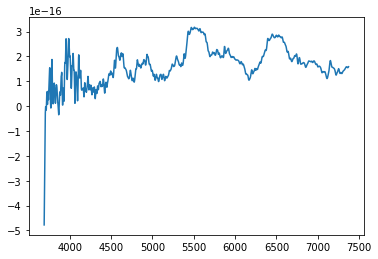

Instance number 198 completed
Minimum violation


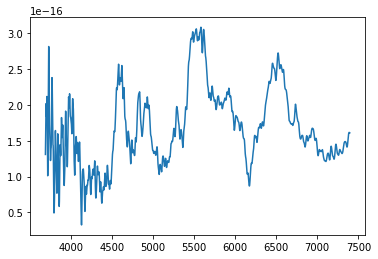

Instance number 199 completed
Minimum violation


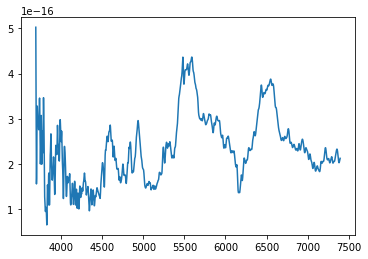

Instance number 200 completed
Minimum violation


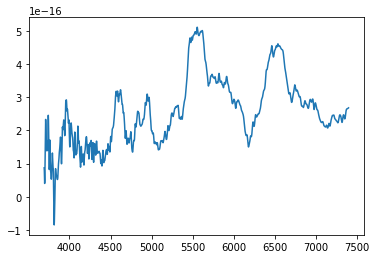

Instance number 201 completed
Minimum violation


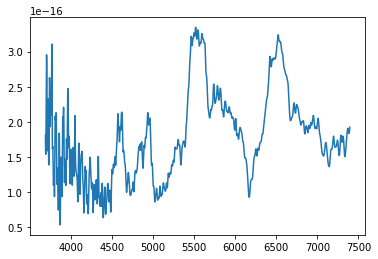

Instance number 202 completed
Minimum violation


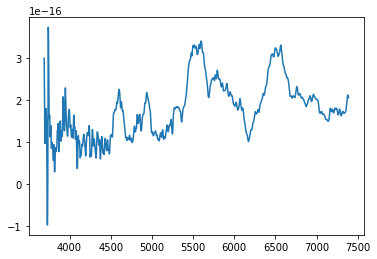

Instance number 203 completed
Minimum violation


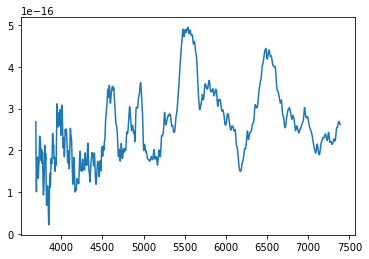

Instance number 204 completed
Minimum violation


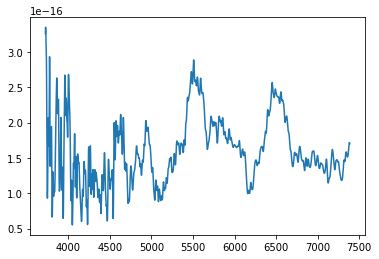

Instance number 205 completed
Minimum violation


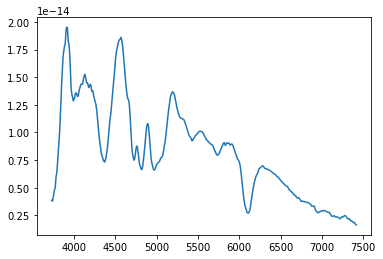

Instance number 206 completed
Minimum violation


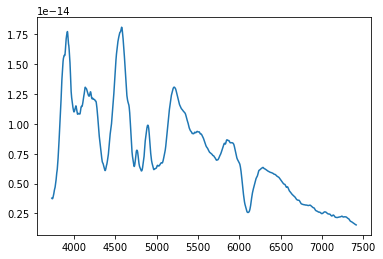

Instance number 207 completed
Minimum violation


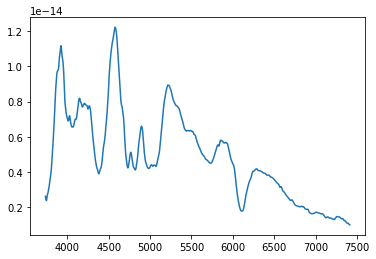

Instance number 208 completed
Minimum violation


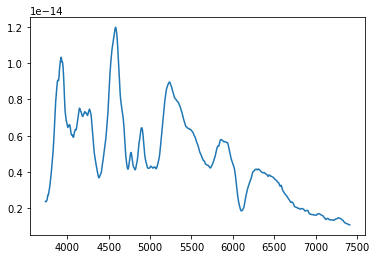

Instance number 209 completed
Minimum violation


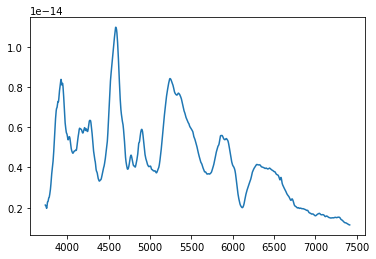

Instance number 210 completed
Minimum violation


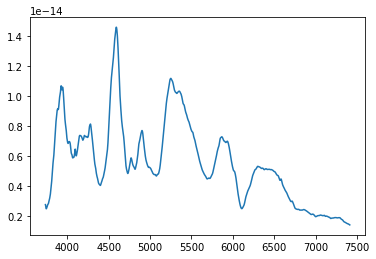

Instance number 211 completed
Minimum violation


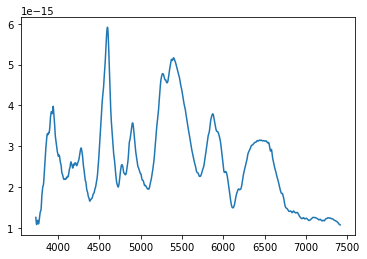

Instance number 212 completed
Minimum violation


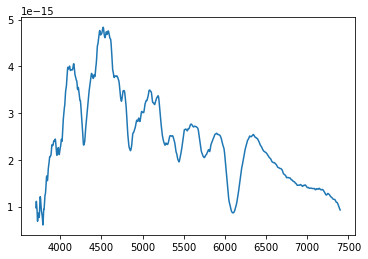

Instance number 213 completed
Minimum violation


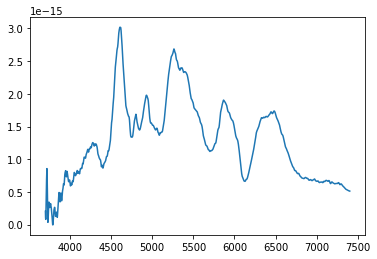

Instance number 214 completed
Minimum violation


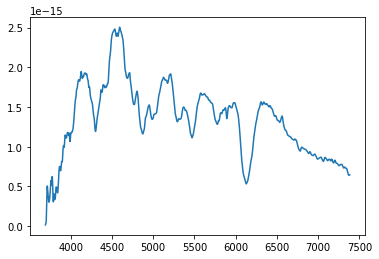

Instance number 215 completed
Minimum violation


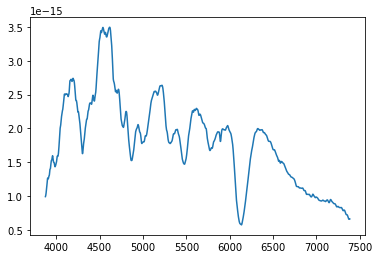

Instance number 216 completed
Minimum violation


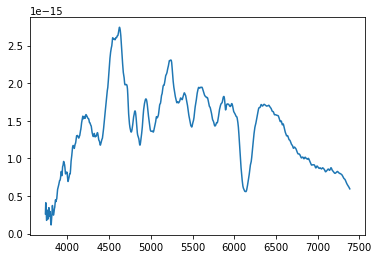

Instance number 217 completed
Minimum violation


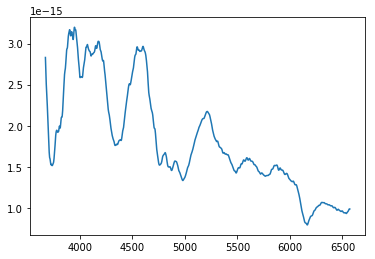

Instance number 218 completed
Instance number 219 completed
Minimum violation


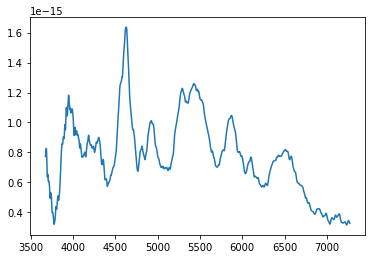

Instance number 220 completed
Minimum violation


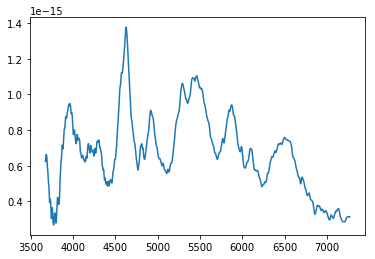

Instance number 221 completed
Minimum violation


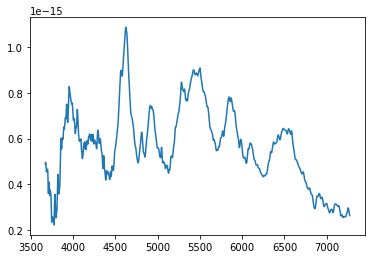

Instance number 222 completed
Minimum violation


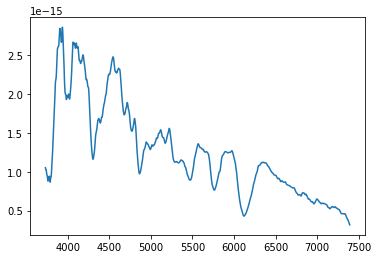

Instance number 223 completed
Minimum violation


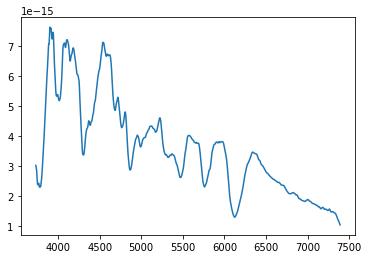

Instance number 224 completed
Minimum violation


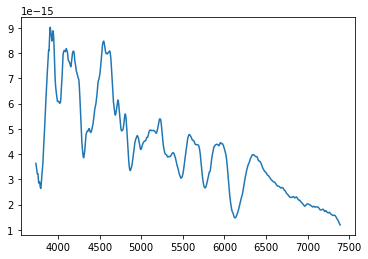

Instance number 225 completed
Minimum violation


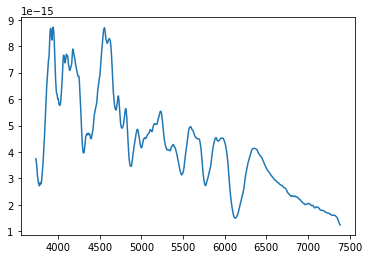

Instance number 226 completed
Minimum violation


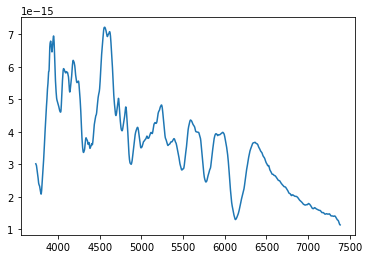

Instance number 227 completed
Minimum violation


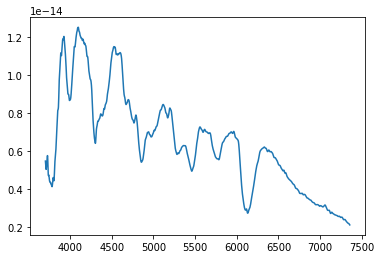

Instance number 228 completed
Minimum violation


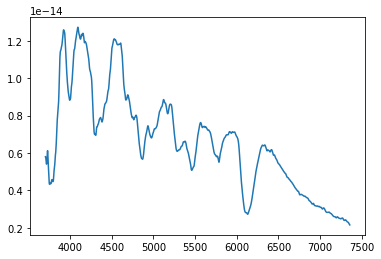

Instance number 229 completed
Minimum violation


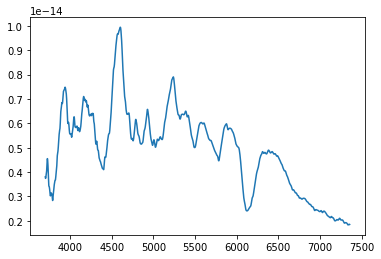

Instance number 230 completed
Minimum violation


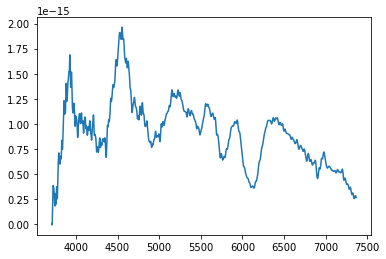

Instance number 231 completed
Minimum violation


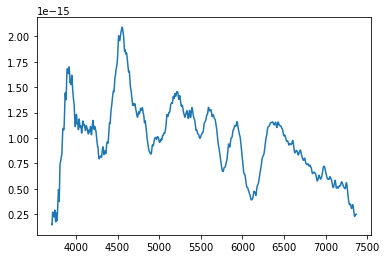

Instance number 232 completed
Minimum violation


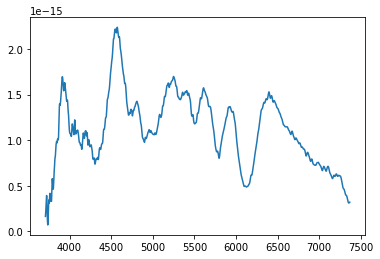

Instance number 233 completed
Minimum violation


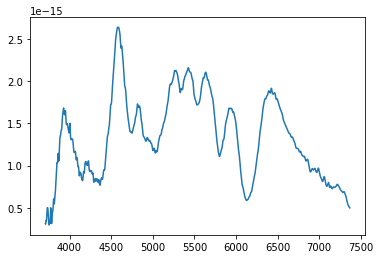

Instance number 234 completed
Instance number 235 completed
Instance number 236 completed
Instance number 237 completed
Instance number 238 completed
Instance number 239 completed
Instance number 240 completed
Instance number 241 completed
Minimum violation


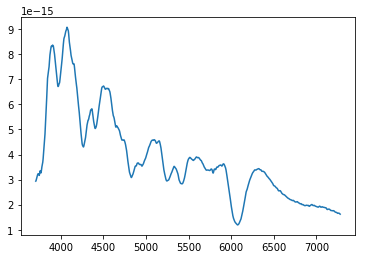

Instance number 242 completed
Minimum violation


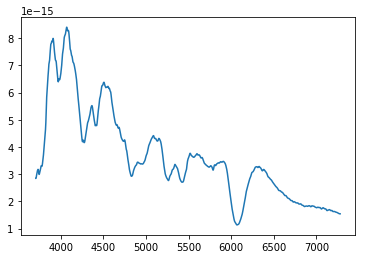

Instance number 243 completed
Minimum violation


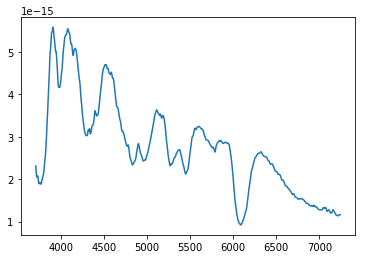

Instance number 244 completed
Minimum violation


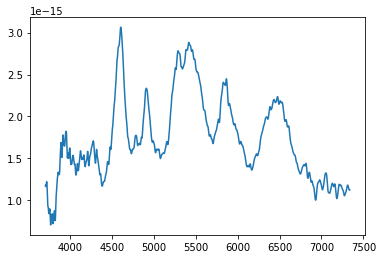

Instance number 245 completed
Minimum violation


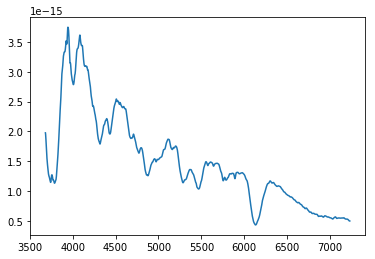

Instance number 246 completed
Minimum violation


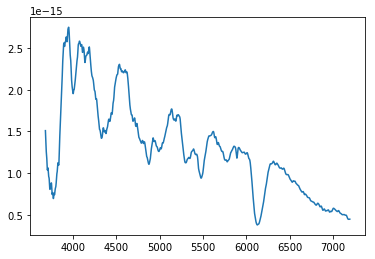

Instance number 247 completed
Minimum violation


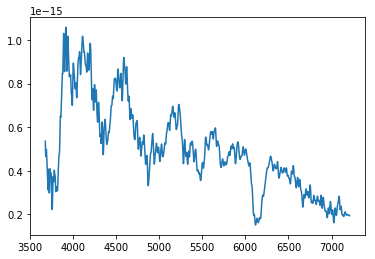

Instance number 248 completed
Minimum violation


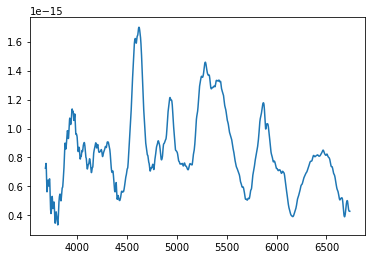

Instance number 249 completed
Minimum violation


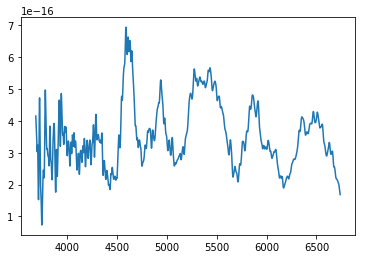

Instance number 250 completed
Minimum violation


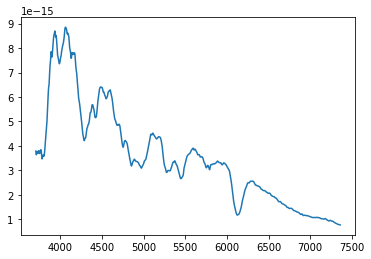

Instance number 251 completed
Minimum violation


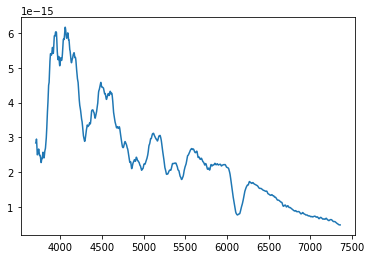

Instance number 252 completed
Minimum violation


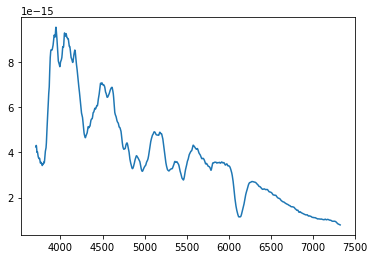

Instance number 253 completed
Minimum violation


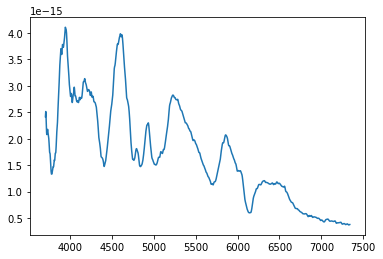

Instance number 254 completed
Minimum violation


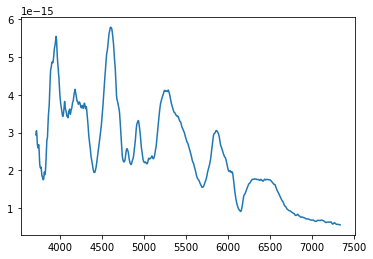

Instance number 255 completed
Minimum violation


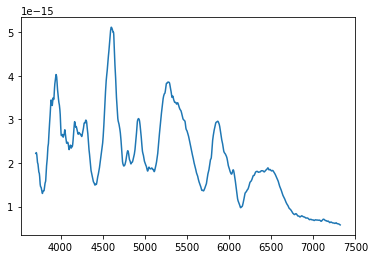

Instance number 256 completed
Instance number 257 completed
Instance number 258 completed
Instance number 259 completed
Minimum violation


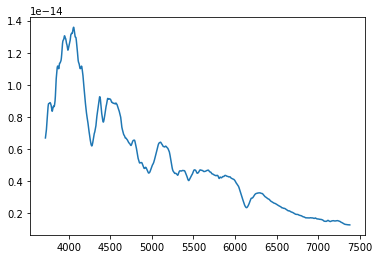

Instance number 260 completed
Minimum violation


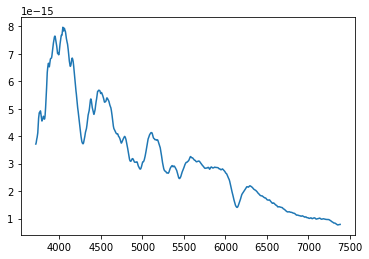

Instance number 261 completed
Minimum violation


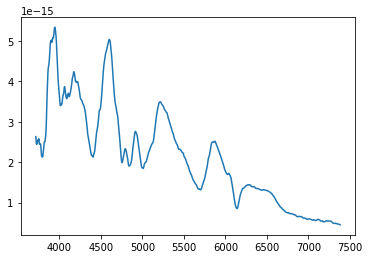

Instance number 262 completed
Minimum violation


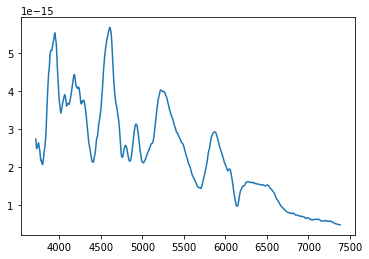

Instance number 263 completed
Minimum violation


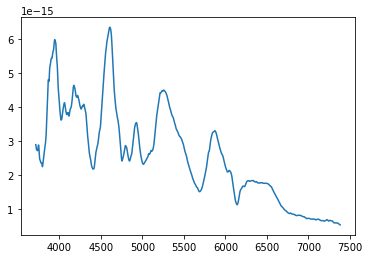

Instance number 264 completed
Minimum violation


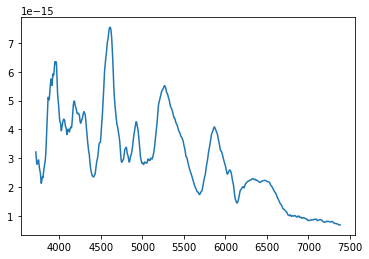

Instance number 265 completed
Minimum violation


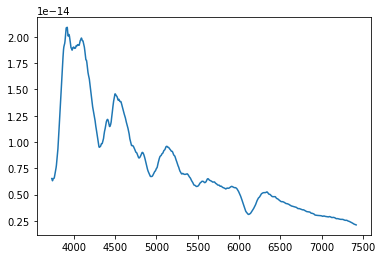

Instance number 266 completed
Minimum violation


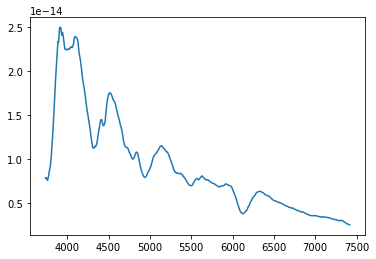

Instance number 267 completed
Minimum violation


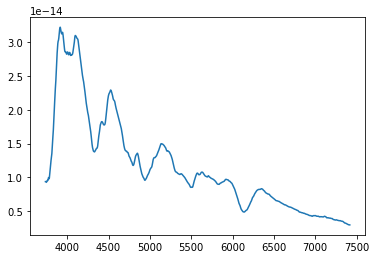

Instance number 268 completed
Minimum violation


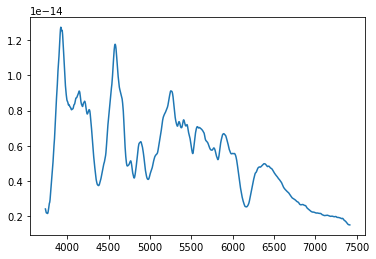

Instance number 269 completed
Minimum violation


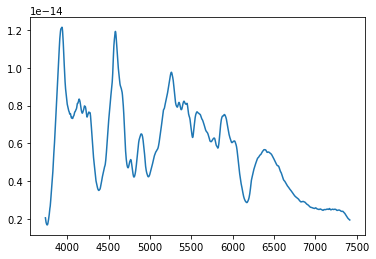

Instance number 270 completed
Minimum violation


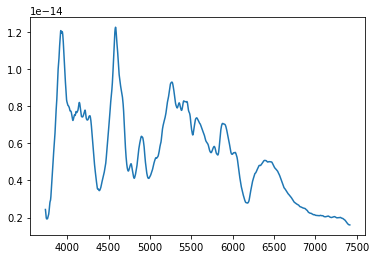

Instance number 271 completed
Minimum violation


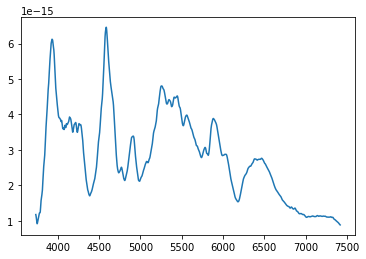

Instance number 272 completed
Minimum violation


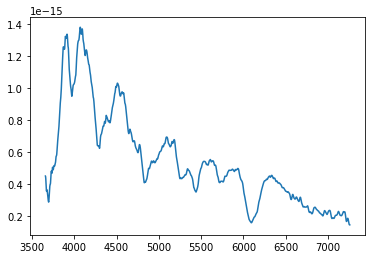

Instance number 273 completed
Minimum violation


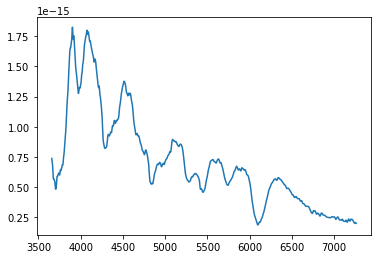

Instance number 274 completed
Minimum violation


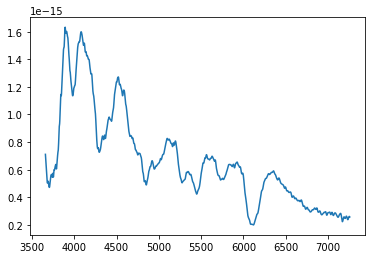

Instance number 275 completed
Minimum violation


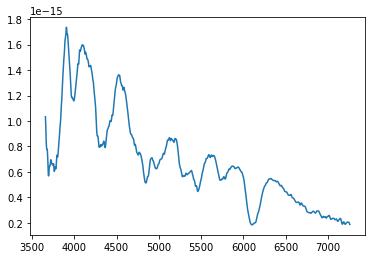

Instance number 276 completed
Minimum violation


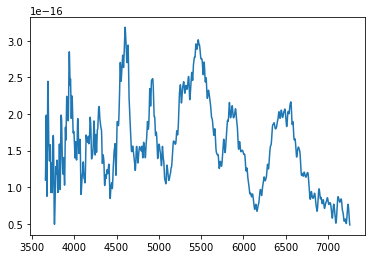

Instance number 277 completed
Minimum violation


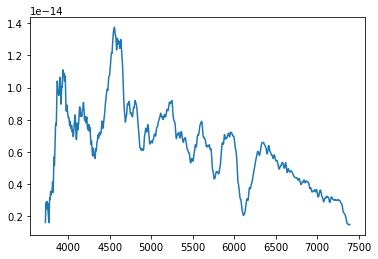

Instance number 278 completed
Minimum violation


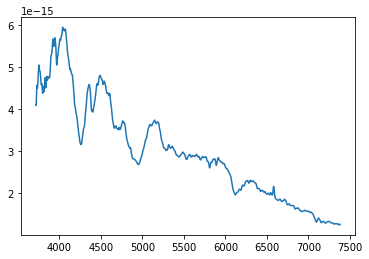

Instance number 279 completed
Minimum violation


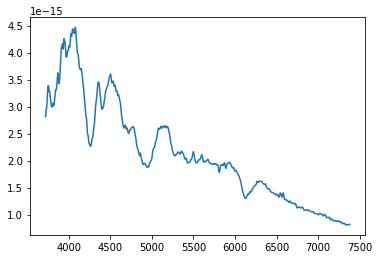

Instance number 280 completed
Minimum violation


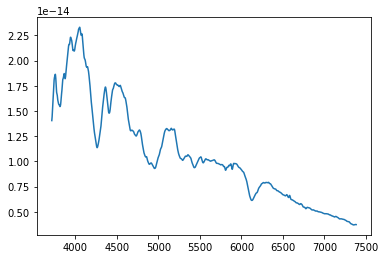

Instance number 281 completed
Minimum violation


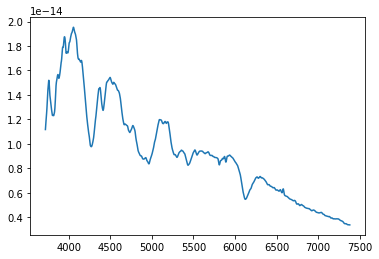

Instance number 282 completed
Minimum violation


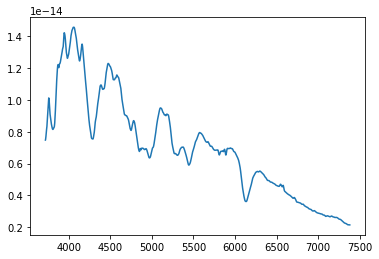

Instance number 283 completed
Minimum violation


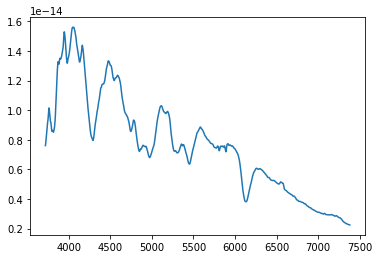

Instance number 284 completed
Minimum violation


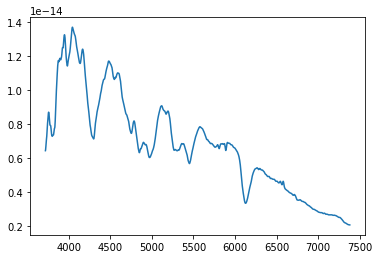

Instance number 285 completed
Minimum violation


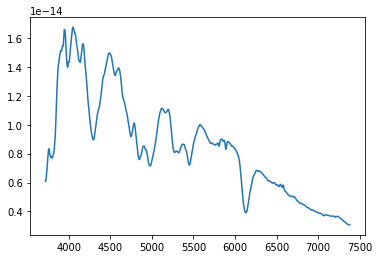

Instance number 286 completed
Minimum violation


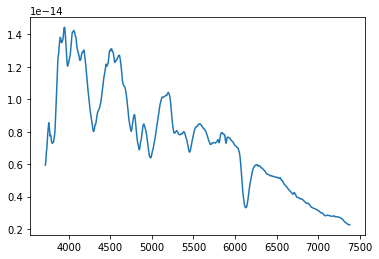

Instance number 287 completed
Minimum violation


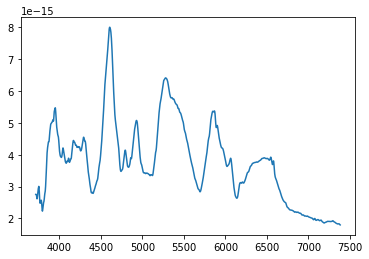

Instance number 288 completed
Minimum violation


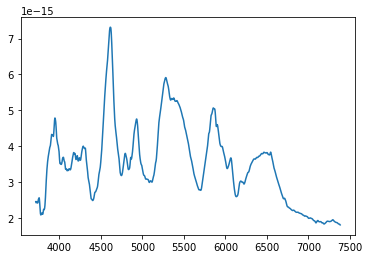

Instance number 289 completed
Instance number 290 completed
Instance number 291 completed
Instance number 292 completed
Minimum violation


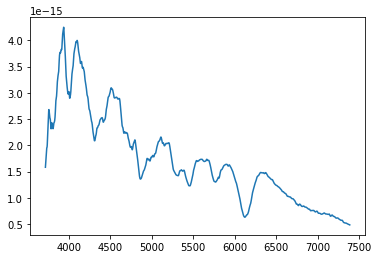

Instance number 293 completed
Minimum violation


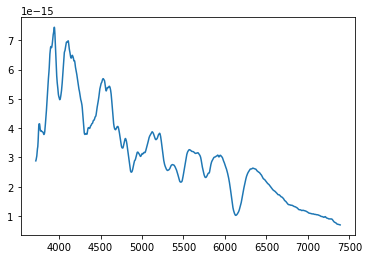

Instance number 294 completed
Minimum violation


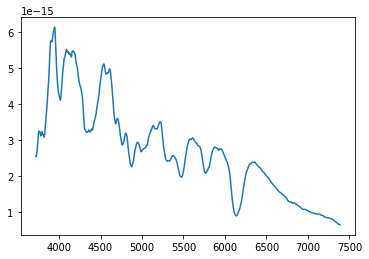

Instance number 295 completed
Minimum violation


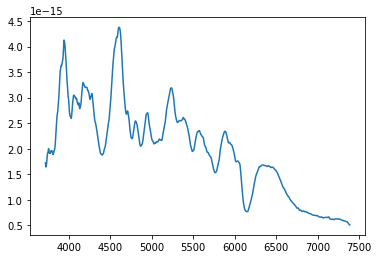

Instance number 296 completed
Minimum violation


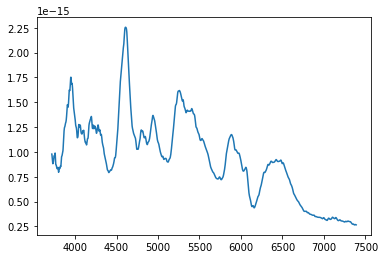

Instance number 297 completed
Minimum violation


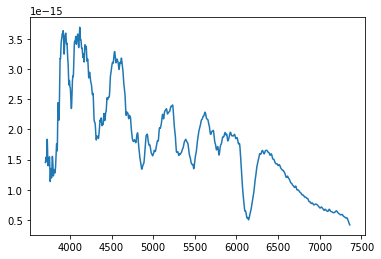

Instance number 298 completed
Minimum violation


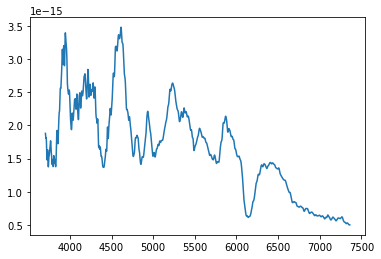

Instance number 299 completed
Minimum violation


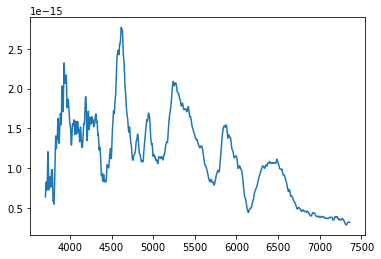

Instance number 300 completed
Minimum violation


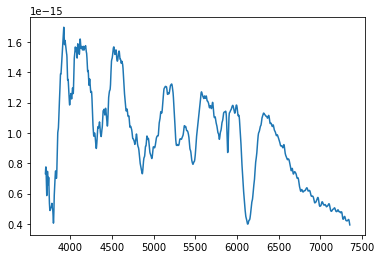

Instance number 301 completed
Minimum violation


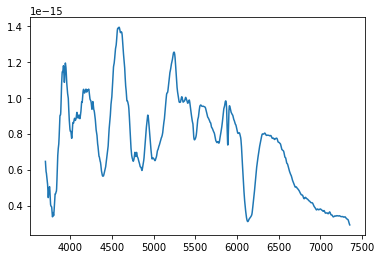

Instance number 302 completed
Minimum violation


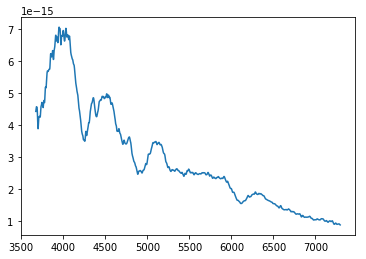

Instance number 303 completed
Minimum violation


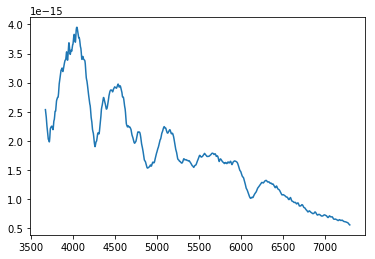

Instance number 304 completed
Minimum violation


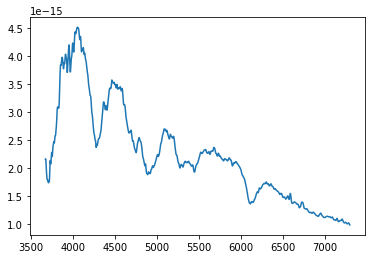

Instance number 305 completed
Minimum violation


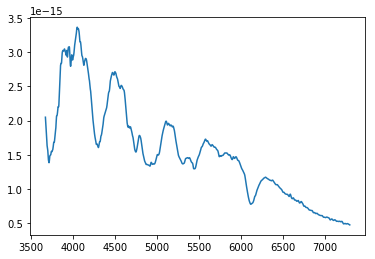

Instance number 306 completed
Minimum violation


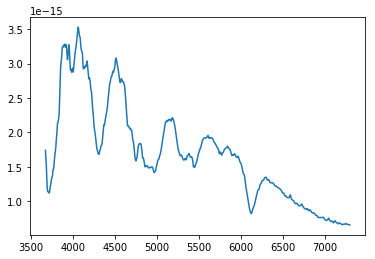

Instance number 307 completed
Minimum violation


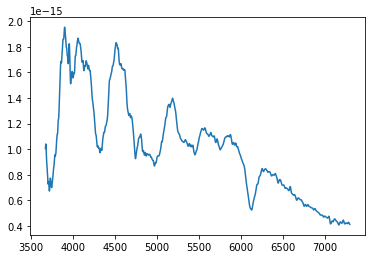

Instance number 308 completed
Minimum violation


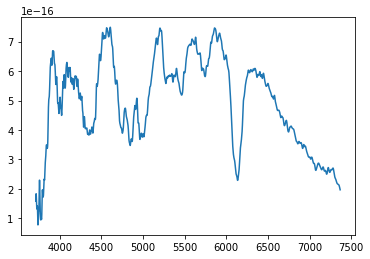

Instance number 309 completed
Minimum violation


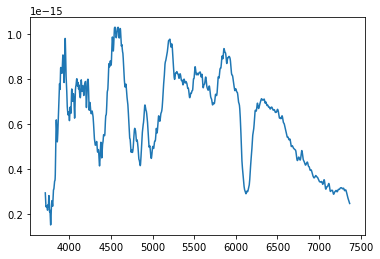

Instance number 310 completed
Minimum violation


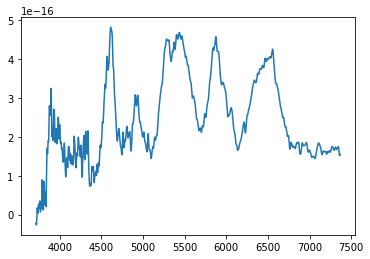

Instance number 311 completed
Instance number 312 completed
Instance number 313 completed
Instance number 314 completed
Instance number 315 completed
Minimum violation


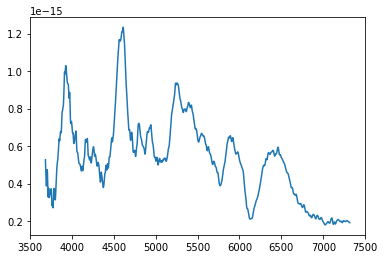

Instance number 316 completed
Minimum violation


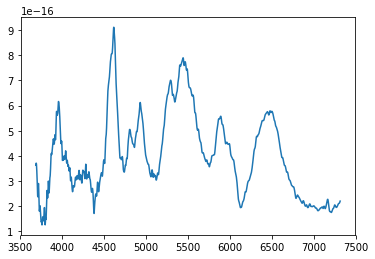

Instance number 317 completed
Minimum violation


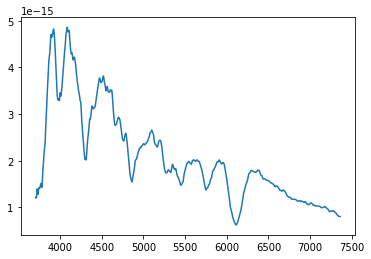

Instance number 318 completed
Minimum violation


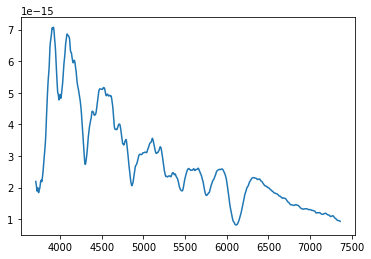

Instance number 319 completed
Minimum violation


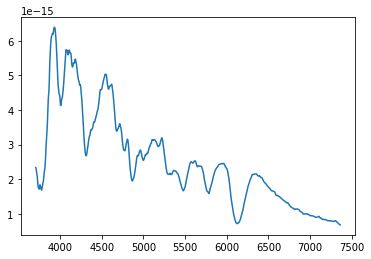

Instance number 320 completed
Minimum violation


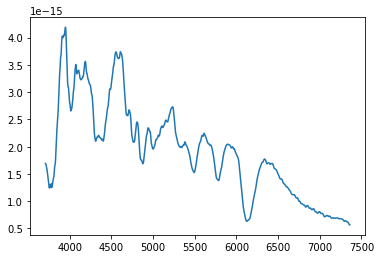

Instance number 321 completed
Instance number 322 completed
Minimum violation


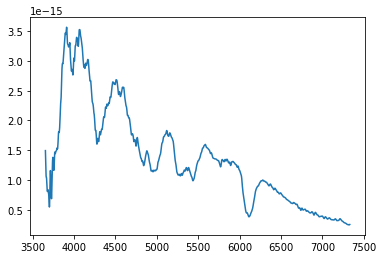

Instance number 323 completed
Minimum violation


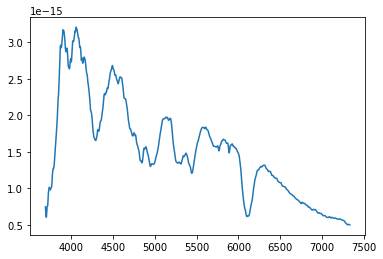

Instance number 324 completed
Minimum violation


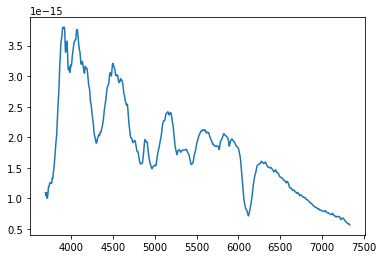

Instance number 325 completed
Minimum violation


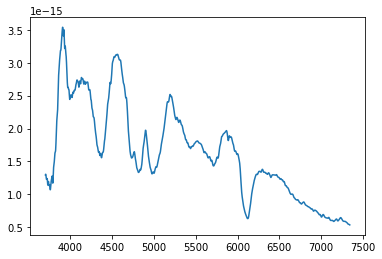

Instance number 326 completed
Minimum violation


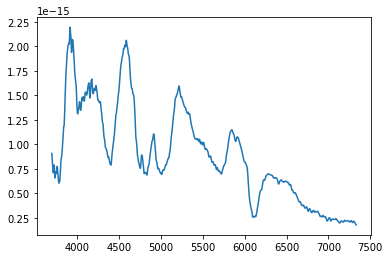

Instance number 327 completed
Minimum violation


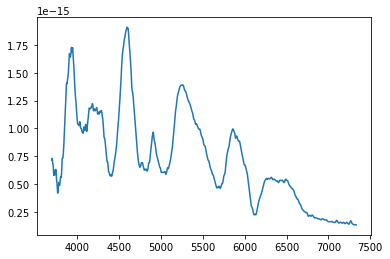

Instance number 328 completed
Minimum violation


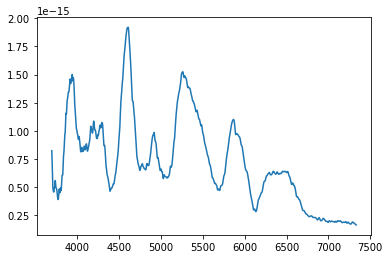

Instance number 329 completed
Minimum violation


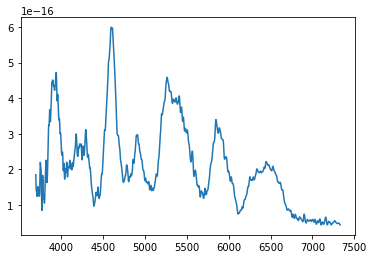

Instance number 330 completed
Instance number 331 completed
Instance number 332 completed
Instance number 333 completed
Minimum violation


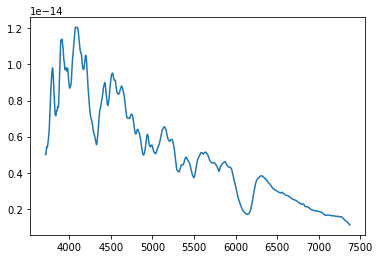

Instance number 334 completed
Minimum violation


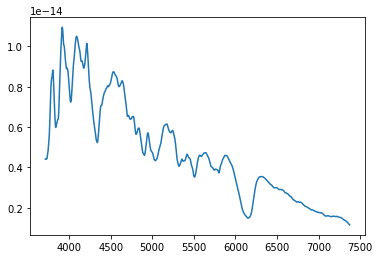

Instance number 335 completed
Minimum violation


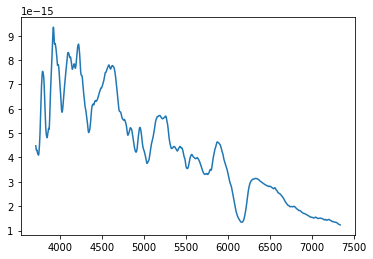

Instance number 336 completed
Instance number 337 completed
Minimum violation


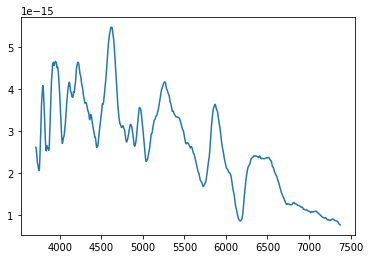

Instance number 338 completed
Minimum violation


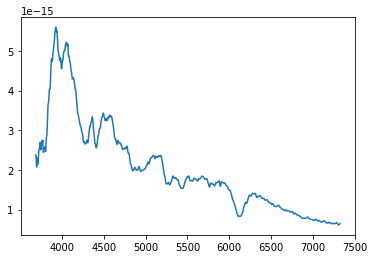

Instance number 339 completed
Minimum violation


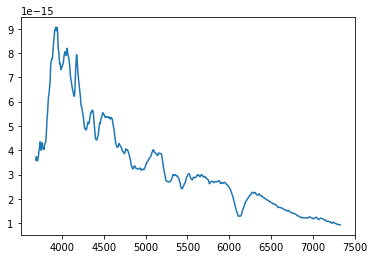

Instance number 340 completed
Minimum violation


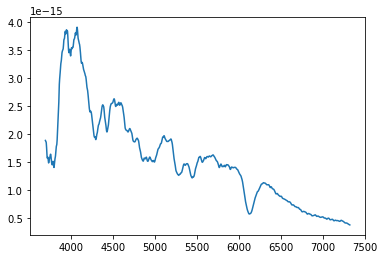

Instance number 341 completed
Minimum violation


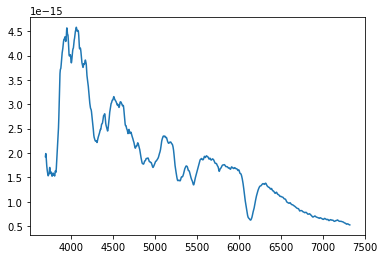

Instance number 342 completed
Minimum violation


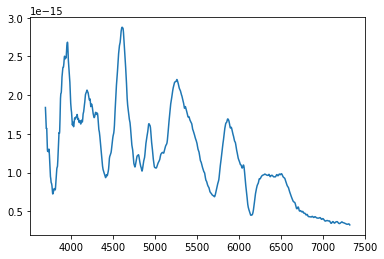

Instance number 343 completed
Minimum violation


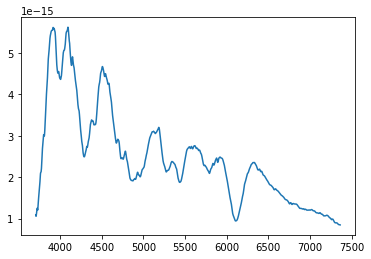

Instance number 344 completed
Instance number 345 completed
Minimum violation


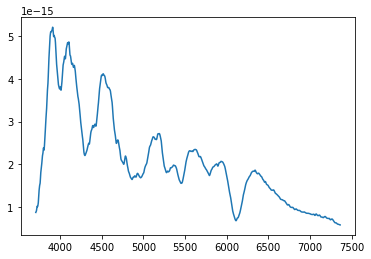

Instance number 346 completed
Minimum violation


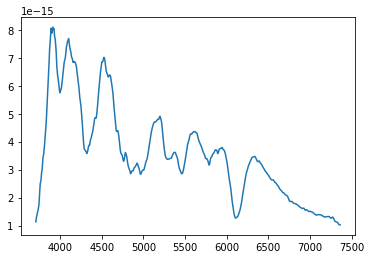

Instance number 347 completed
Minimum violation


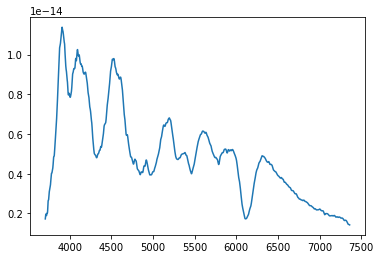

Instance number 348 completed
Minimum violation


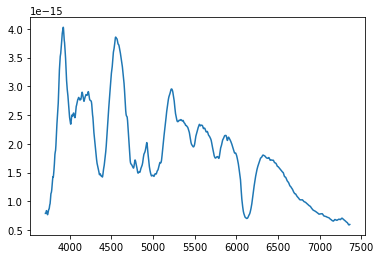

Instance number 349 completed
Instance number 350 completed
Instance number 351 completed
Instance number 352 completed
Instance number 353 completed
Instance number 354 completed
Instance number 355 completed
Instance number 356 completed
Minimum violation


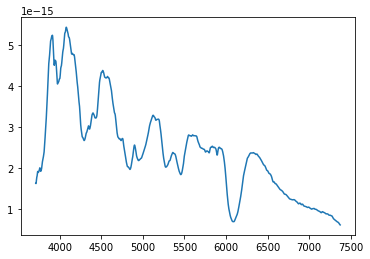

Instance number 357 completed
Minimum violation


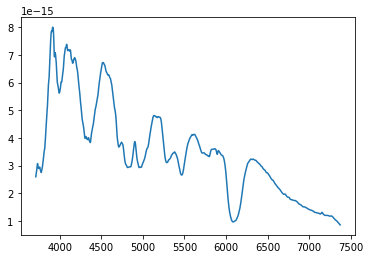

Instance number 358 completed
Minimum violation


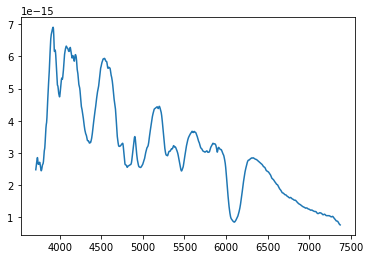

Instance number 359 completed
Minimum violation


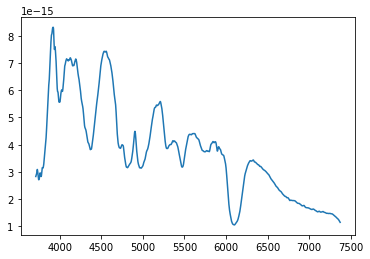

Instance number 360 completed
Minimum violation


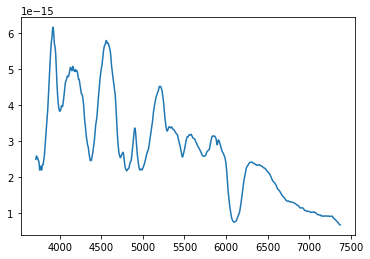

Instance number 361 completed
Minimum violation


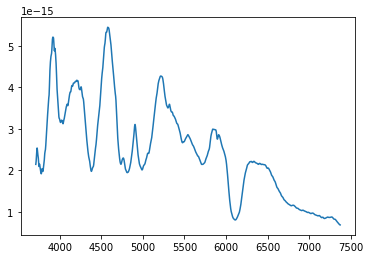

Instance number 362 completed
Minimum violation


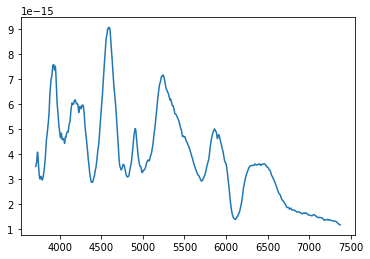

Instance number 363 completed
Minimum violation


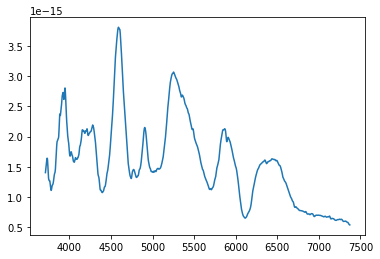

Instance number 364 completed
Minimum violation


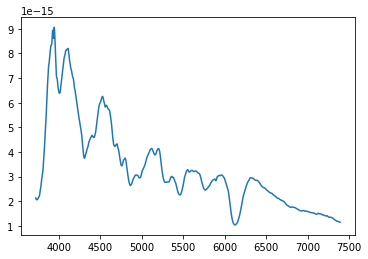

Instance number 365 completed
Minimum violation


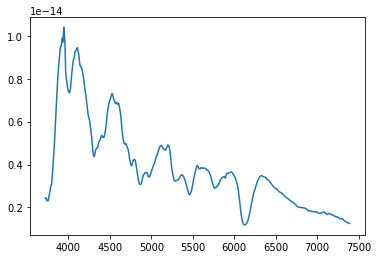

Instance number 366 completed
Minimum violation


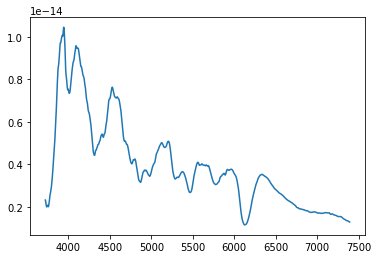

Instance number 367 completed
Minimum violation


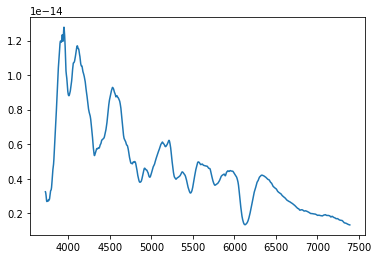

Instance number 368 completed
Minimum violation


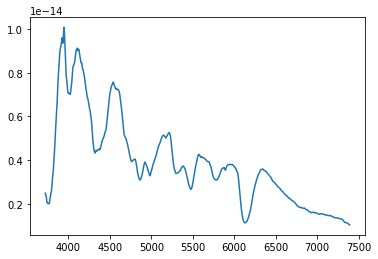

Instance number 369 completed
Minimum violation


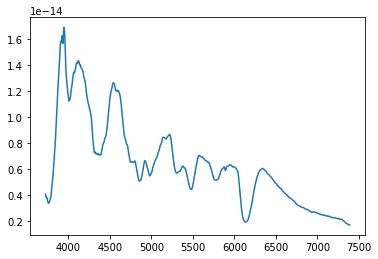

Instance number 370 completed
Minimum violation


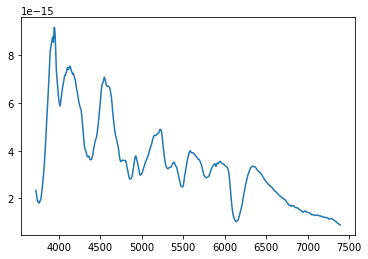

Instance number 371 completed
Minimum violation


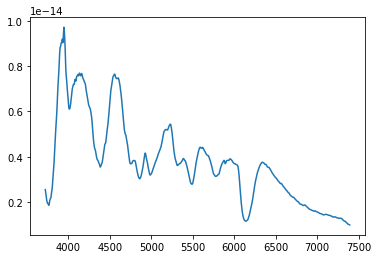

Instance number 372 completed
Minimum violation


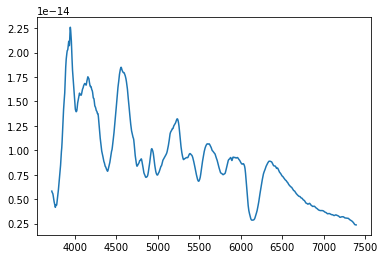

Instance number 373 completed
Minimum violation


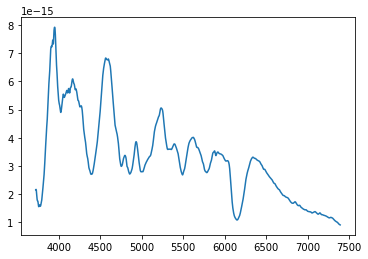

Instance number 374 completed
Minimum violation


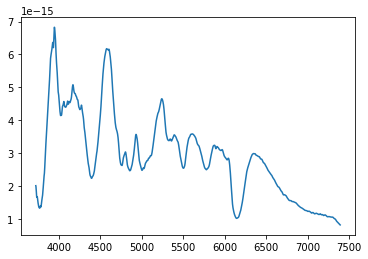

Instance number 375 completed
Minimum violation


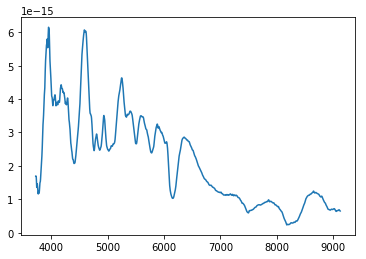

Instance number 376 completed
Minimum violation


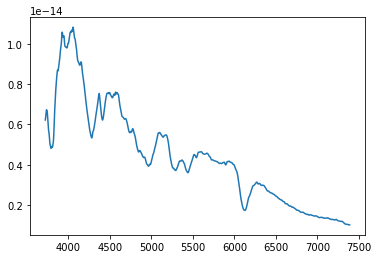

Instance number 377 completed
Minimum violation


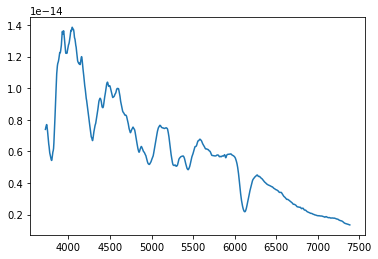

Instance number 378 completed
Minimum violation


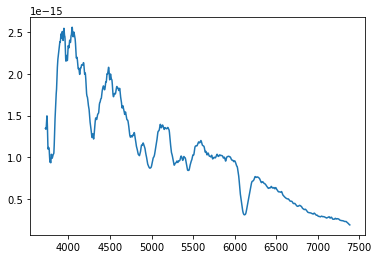

Instance number 379 completed
Minimum violation


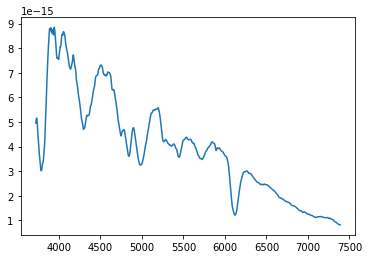

Instance number 380 completed
Minimum violation


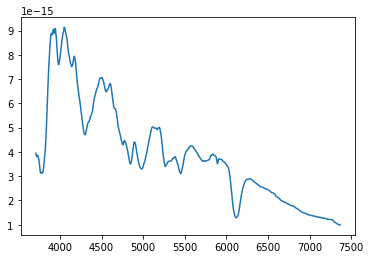

Instance number 381 completed
Minimum violation


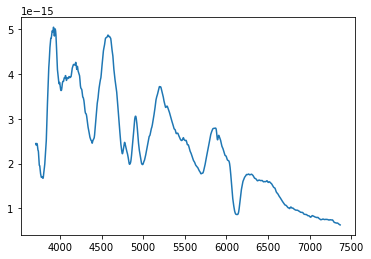

Instance number 382 completed
Minimum violation


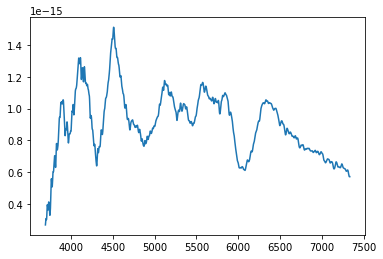

Instance number 383 completed
Minimum violation


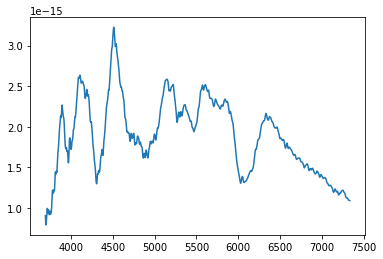

Instance number 384 completed
Instance number 385 completed
Minimum violation


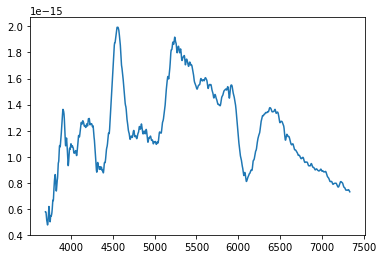

Instance number 386 completed
Minimum violation


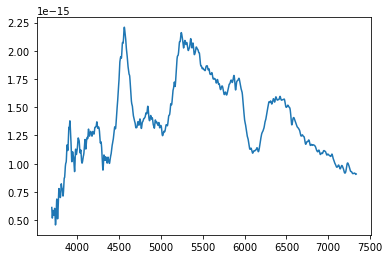

Instance number 387 completed
Minimum violation


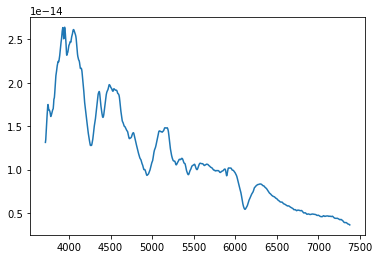

Instance number 388 completed
Minimum violation


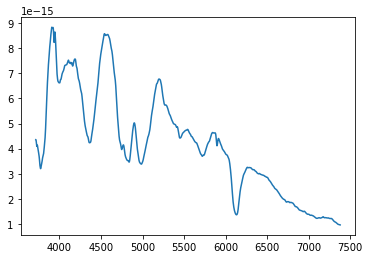

Instance number 389 completed
Minimum violation


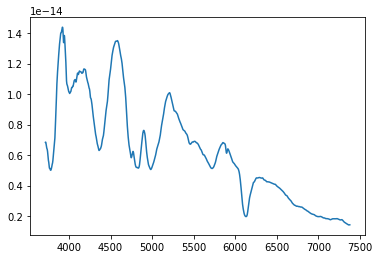

Instance number 390 completed
Minimum violation


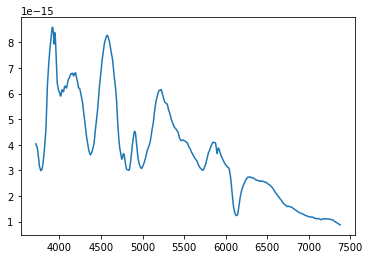

Instance number 391 completed
Minimum violation


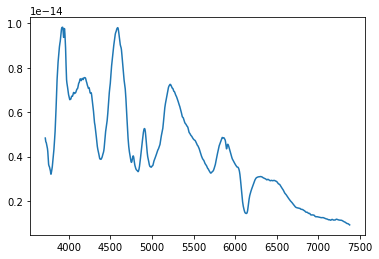

Instance number 392 completed
Minimum violation


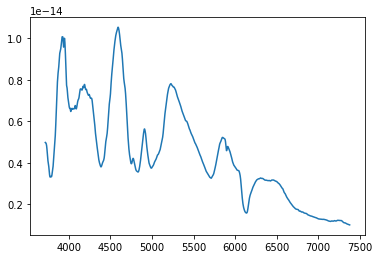

Instance number 393 completed
Minimum violation


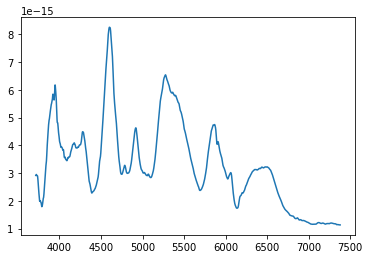

Instance number 394 completed
Minimum violation


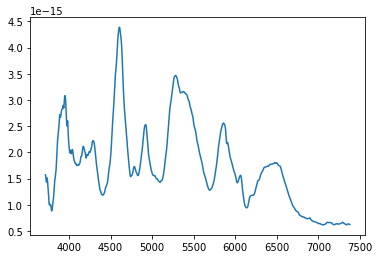

Instance number 395 completed
Minimum violation


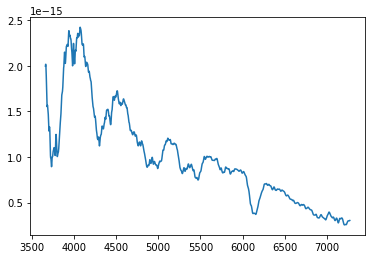

Instance number 396 completed
Minimum violation


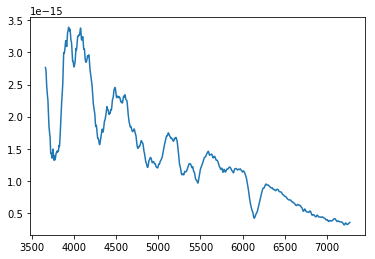

Instance number 397 completed
Minimum violation


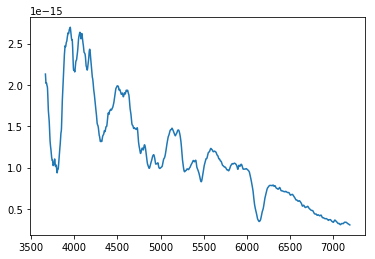

Instance number 398 completed
Minimum violation


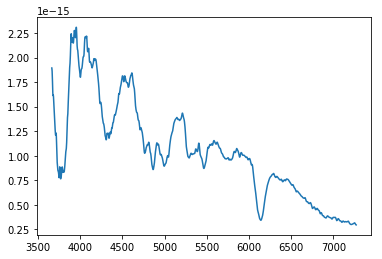

Instance number 399 completed
Minimum violation


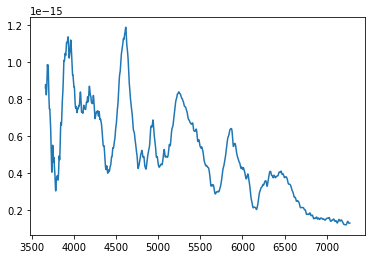

Instance number 400 completed
Minimum violation


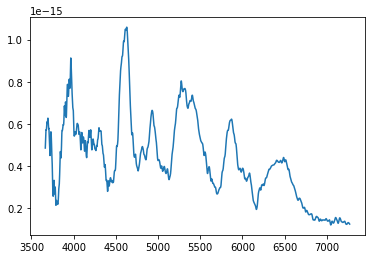

Instance number 401 completed
Minimum violation


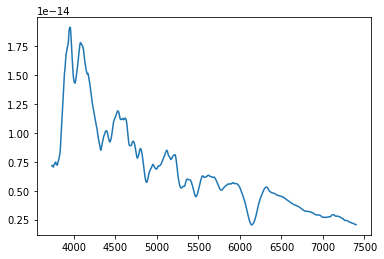

Instance number 402 completed
Minimum violation


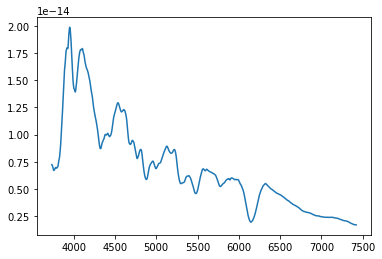

Instance number 403 completed
Minimum violation


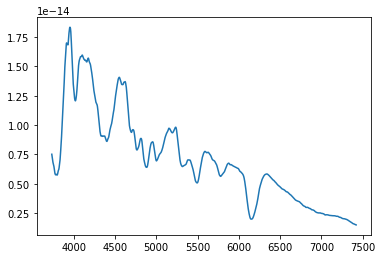

Instance number 404 completed
Minimum violation


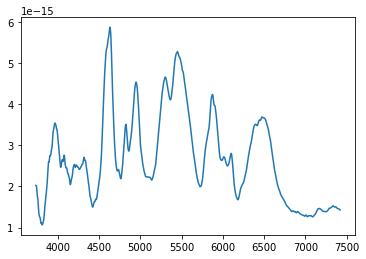

Instance number 405 completed
Minimum violation


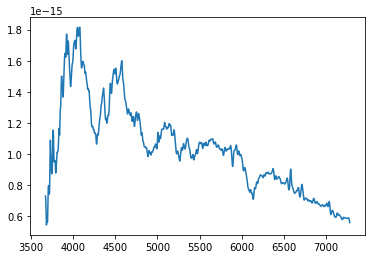

Instance number 406 completed
Minimum violation


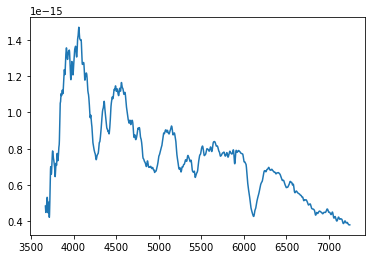

Instance number 407 completed
Minimum violation


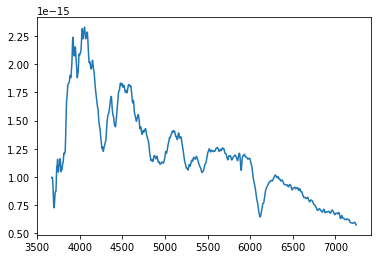

Instance number 408 completed
Minimum violation


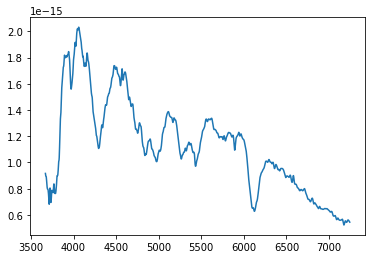

Instance number 409 completed
Minimum violation


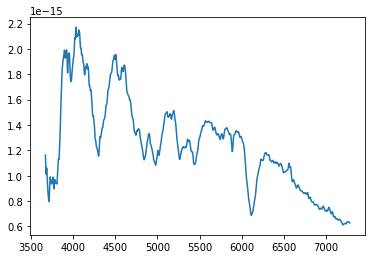

Instance number 410 completed
Minimum violation


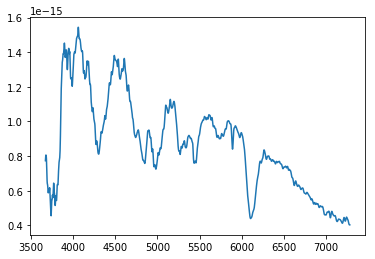

Instance number 411 completed
Minimum violation


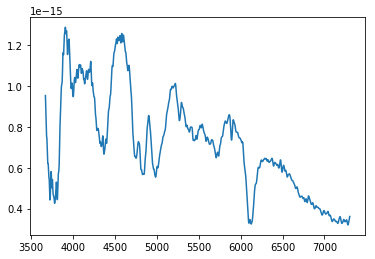

Instance number 412 completed
Minimum violation


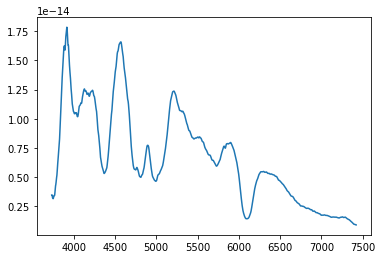

Instance number 413 completed
Minimum violation


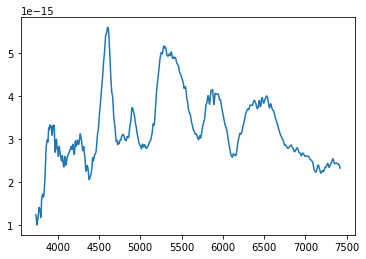

Instance number 414 completed
Minimum violation


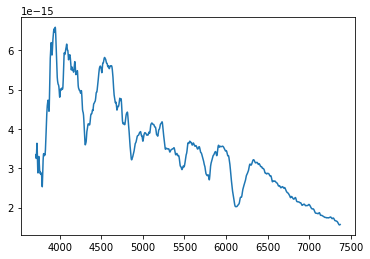

Instance number 415 completed
Minimum violation


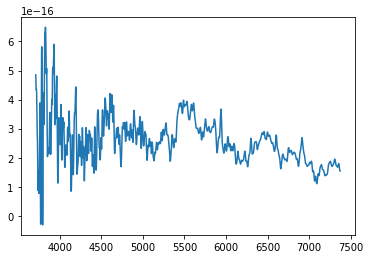

Instance number 416 completed
Minimum violation


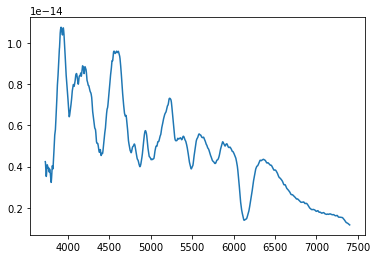

Instance number 417 completed
Minimum violation


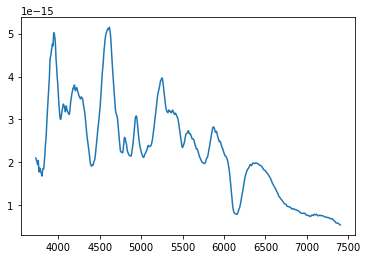

Instance number 418 completed
Minimum violation


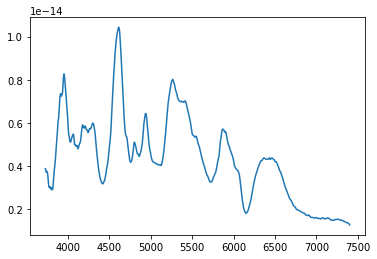

Instance number 419 completed
Minimum violation


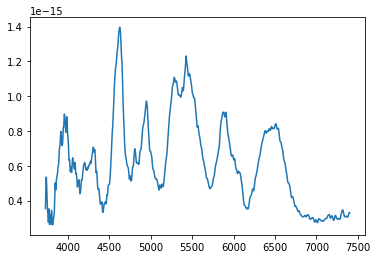

Instance number 420 completed
Minimum violation


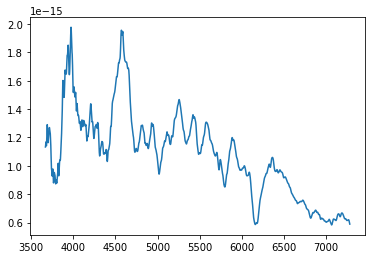

Instance number 421 completed
Minimum violation


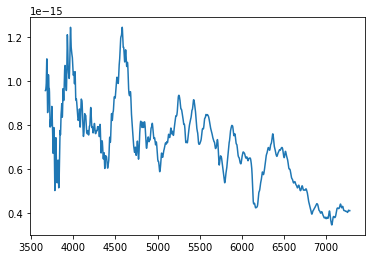

Instance number 422 completed
Minimum violation


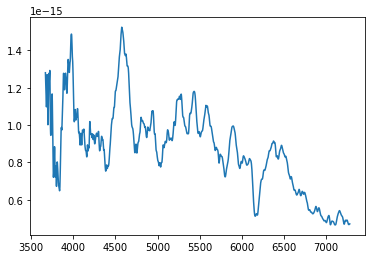

Instance number 423 completed
Minimum violation


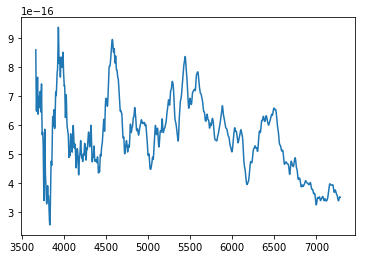

Instance number 424 completed
Minimum violation


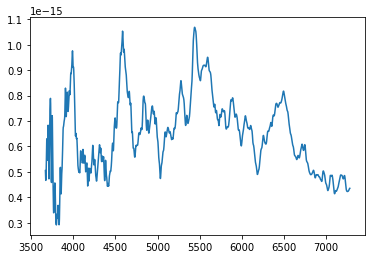

Instance number 425 completed
Minimum violation


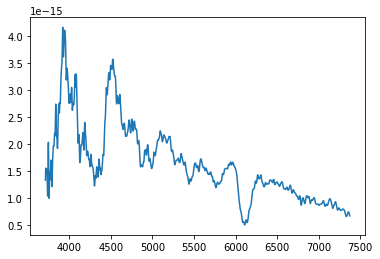

Instance number 426 completed
Minimum violation


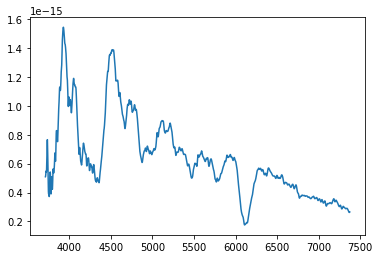

Instance number 427 completed
Minimum violation


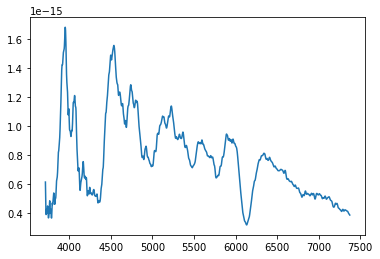

Instance number 428 completed
Minimum violation


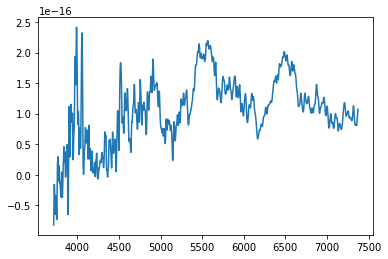

Instance number 429 completed
Minimum violation


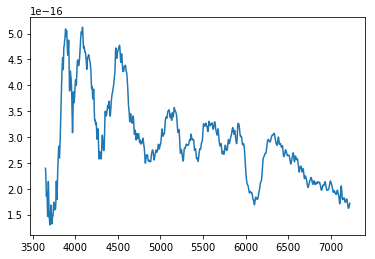

Instance number 430 completed
Minimum violation


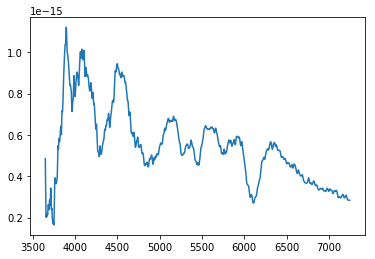

Instance number 431 completed
Minimum violation


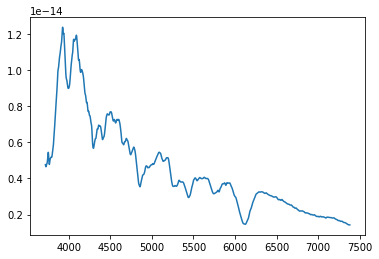

Instance number 432 completed
Instance number 433 completed
Minimum violation


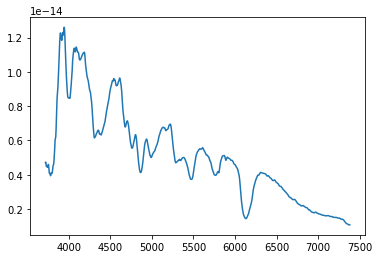

Instance number 434 completed
Minimum violation


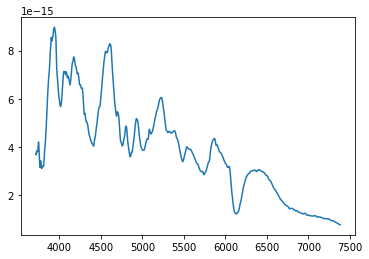

Instance number 435 completed
Minimum violation


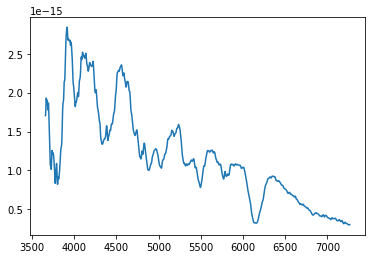

Instance number 436 completed
Instance number 437 completed
Minimum violation


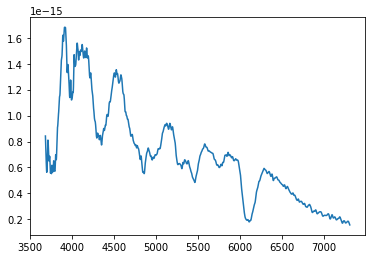

Instance number 438 completed
Minimum violation


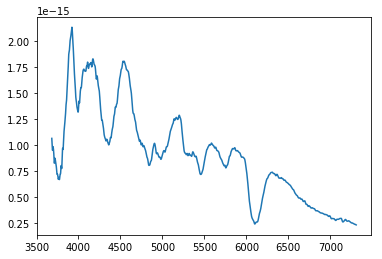

Instance number 439 completed
Minimum violation


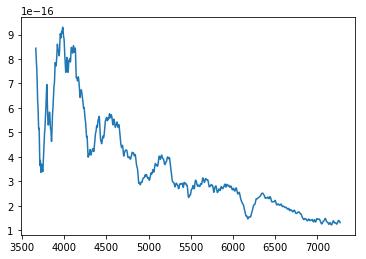

Instance number 440 completed
Minimum violation


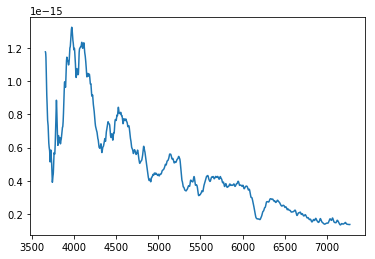

Instance number 441 completed
Minimum violation


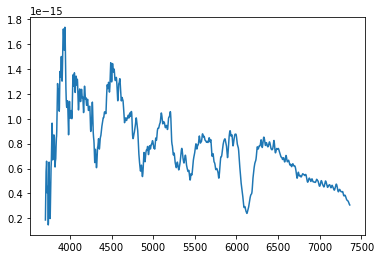

Instance number 442 completed
Minimum violation


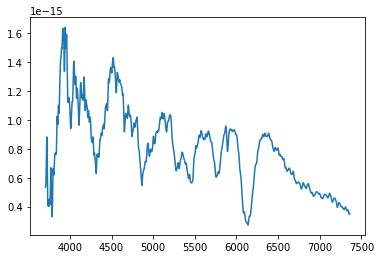

Instance number 443 completed
Minimum violation


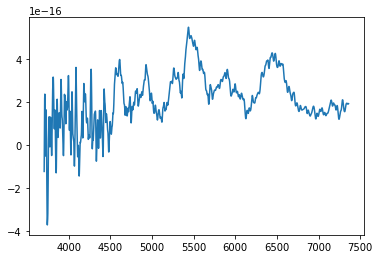

Instance number 444 completed
Minimum violation


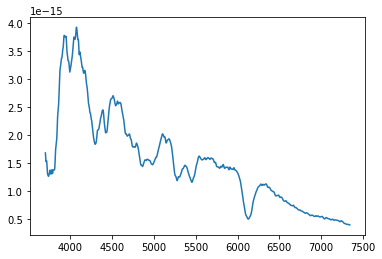

Instance number 445 completed
Minimum violation


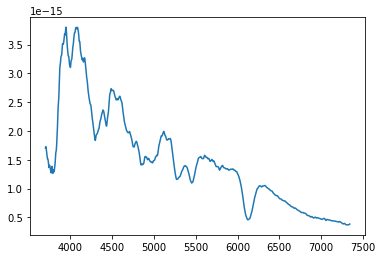

Instance number 446 completed
Minimum violation


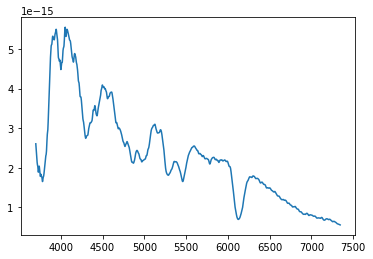

Instance number 447 completed
Minimum violation


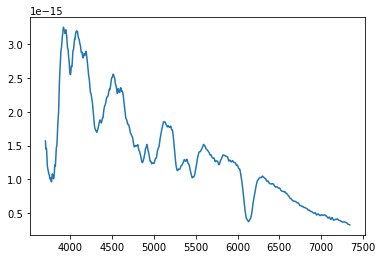

Instance number 448 completed
Minimum violation


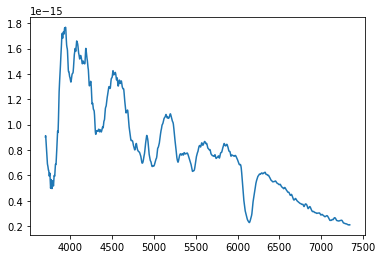

Instance number 449 completed
Minimum violation


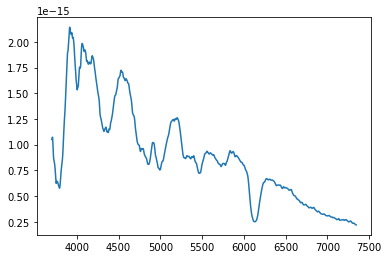

Instance number 450 completed
Minimum violation


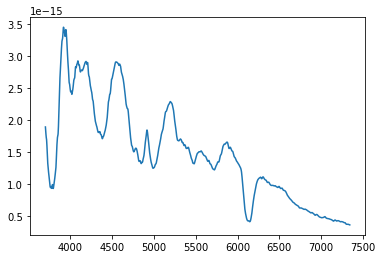

Instance number 451 completed
Minimum violation


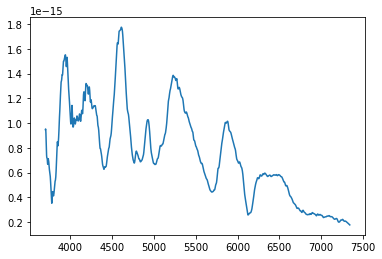

Instance number 452 completed
Minimum violation


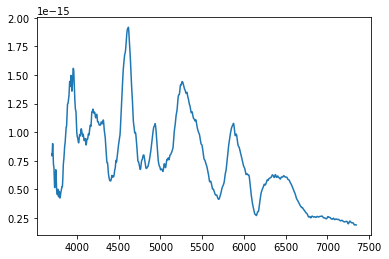

Instance number 453 completed
Minimum violation


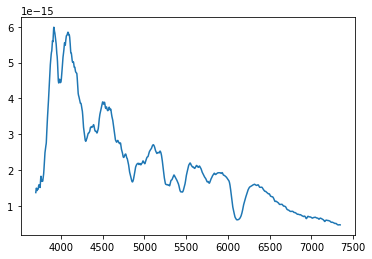

Instance number 454 completed
Minimum violation


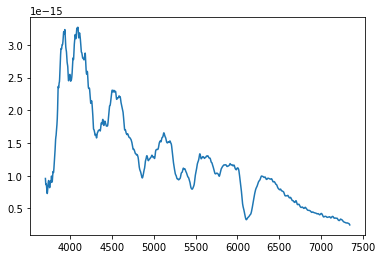

Instance number 455 completed
Minimum violation


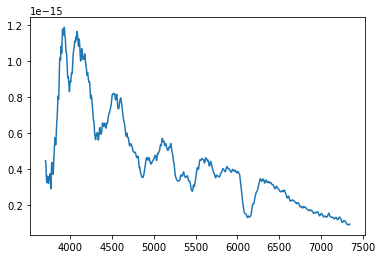

Instance number 456 completed
Minimum violation


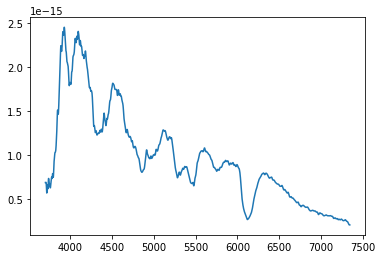

Instance number 457 completed
Minimum violation


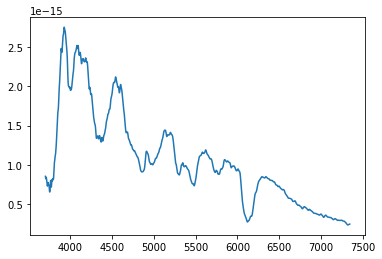

Instance number 458 completed
Minimum violation


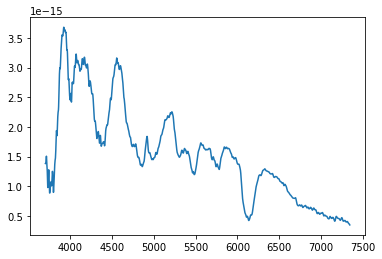

Instance number 459 completed
Minimum violation


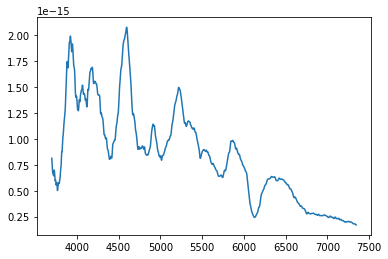

Instance number 460 completed
Minimum violation


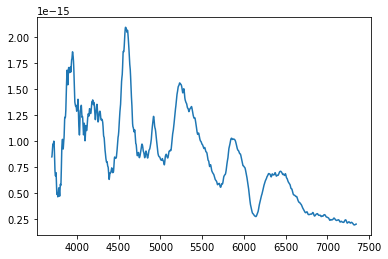

Instance number 461 completed
Minimum violation


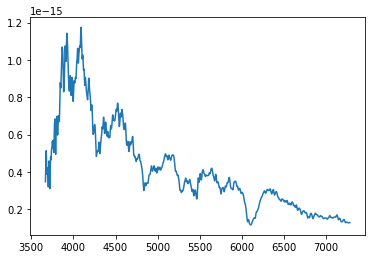

Instance number 462 completed
Minimum violation


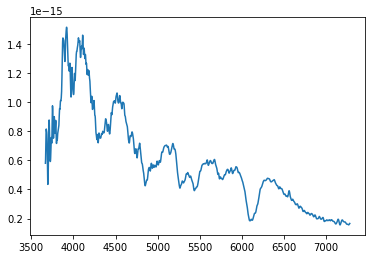

Instance number 463 completed
Minimum violation


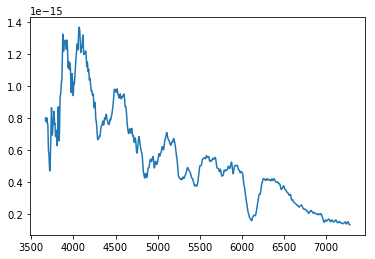

Instance number 464 completed
Instance number 465 completed
Minimum violation


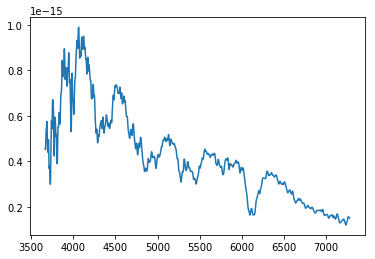

Instance number 466 completed
Minimum violation


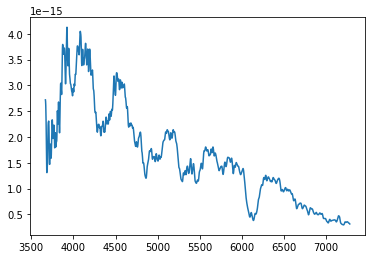

Instance number 467 completed
Minimum violation


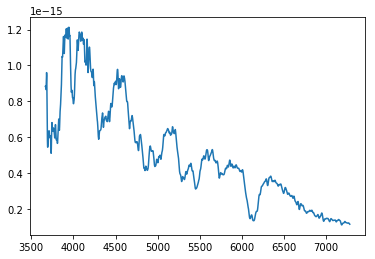

Instance number 468 completed
Minimum violation


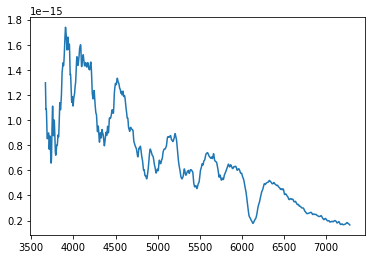

Instance number 469 completed
Minimum violation


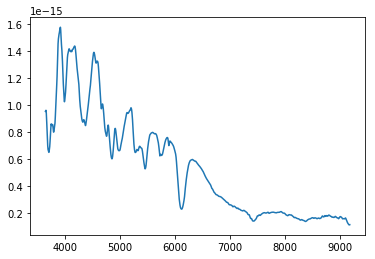

Instance number 470 completed
Minimum violation


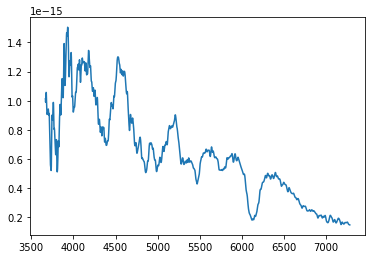

Instance number 471 completed
Minimum violation


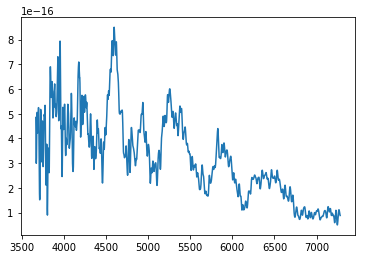

Instance number 472 completed
Minimum violation


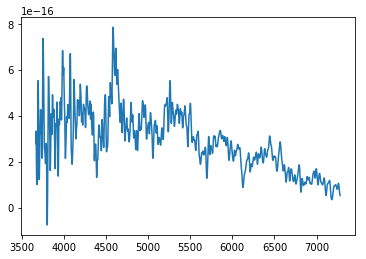

Instance number 473 completed
Minimum violation


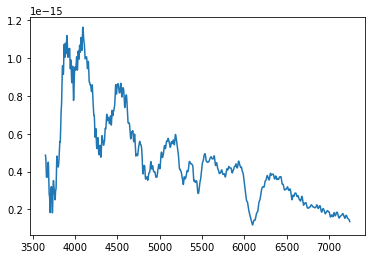

Instance number 474 completed
Minimum violation


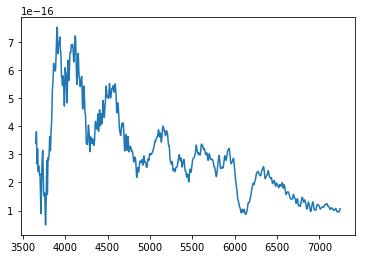

Instance number 475 completed
Minimum violation


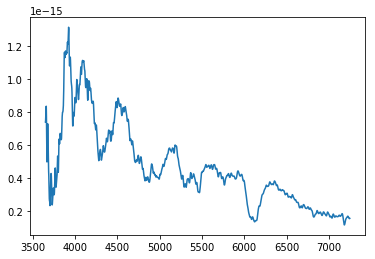

Instance number 476 completed
Minimum violation


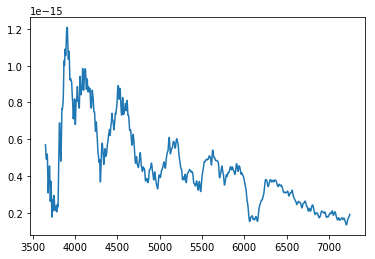

Instance number 477 completed
Minimum violation


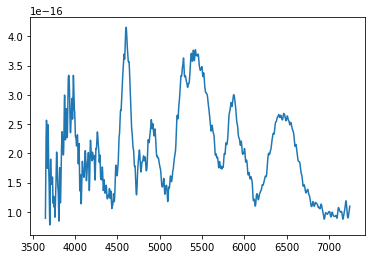

Instance number 478 completed
Instance number 479 completed
Instance number 480 completed
Instance number 481 completed
Instance number 482 completed
Instance number 483 completed
Instance number 484 completed
Instance number 485 completed
Instance number 486 completed
Instance number 487 completed
Instance number 488 completed
Minimum violation


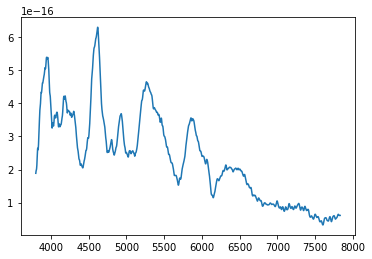

Instance number 489 completed
Instance number 490 completed
Instance number 491 completed
Instance number 492 completed
Instance number 493 completed
Instance number 494 completed
Instance number 495 completed
Instance number 496 completed
Instance number 497 completed
Instance number 498 completed
Instance number 499 completed
Minimum violation


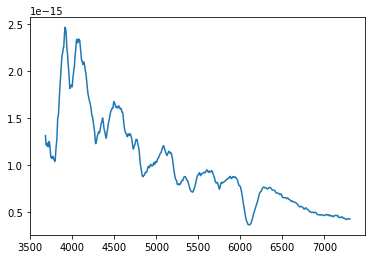

Instance number 500 completed
Minimum violation


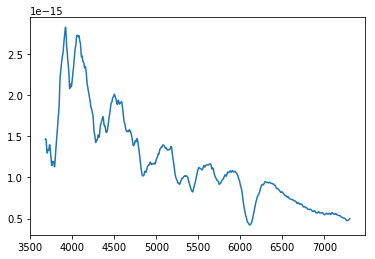

Instance number 501 completed
Minimum violation


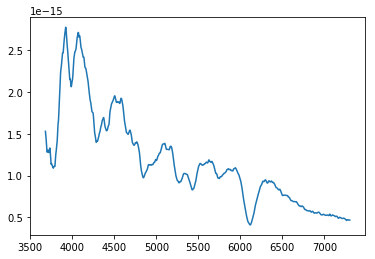

Instance number 502 completed
Minimum violation


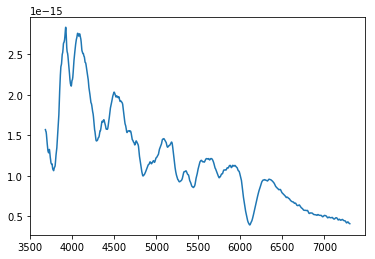

Instance number 503 completed
Minimum violation


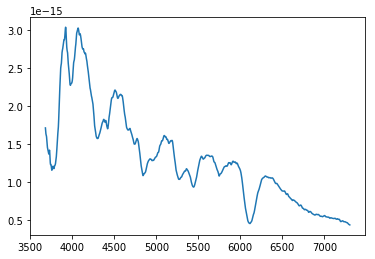

Instance number 504 completed
Minimum violation


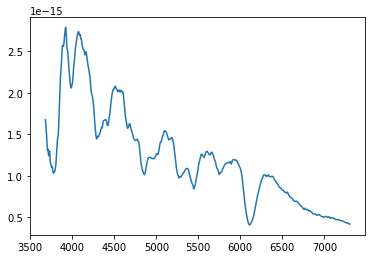

Instance number 505 completed
Minimum violation


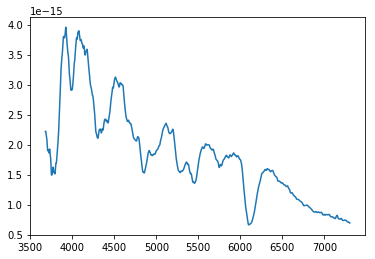

Instance number 506 completed
Minimum violation


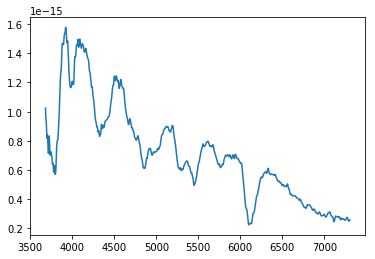

Instance number 507 completed
Minimum violation


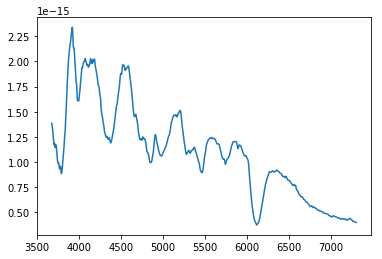

Instance number 508 completed
Minimum violation


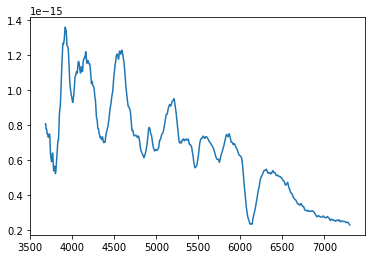

Instance number 509 completed
Minimum violation


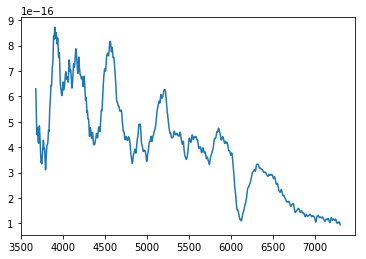

Instance number 510 completed
Minimum violation


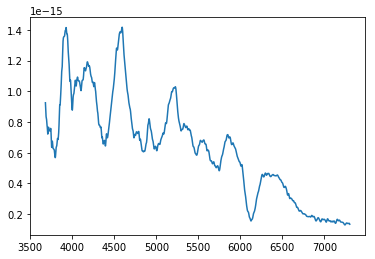

Instance number 511 completed
Minimum violation


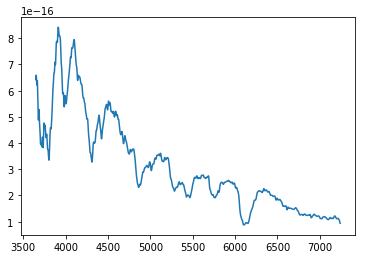

Instance number 512 completed
Minimum violation


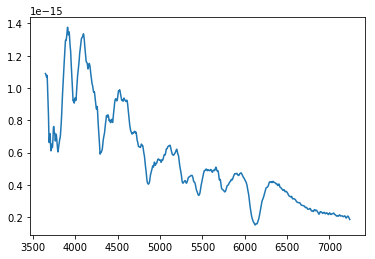

Instance number 513 completed
Minimum violation


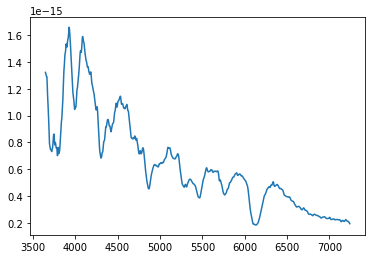

Instance number 514 completed
Minimum violation


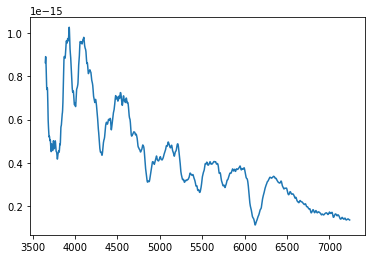

Instance number 515 completed
Minimum violation


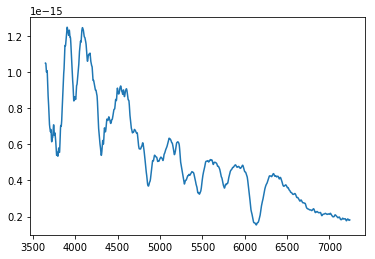

Instance number 516 completed
Minimum violation


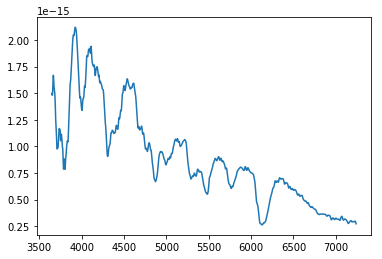

Instance number 517 completed
Minimum violation


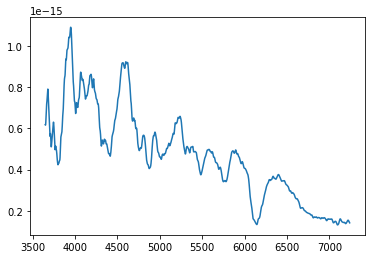

Instance number 518 completed
Minimum violation


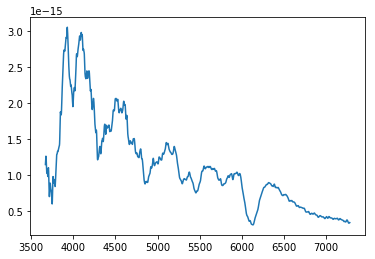

Instance number 519 completed
Minimum violation


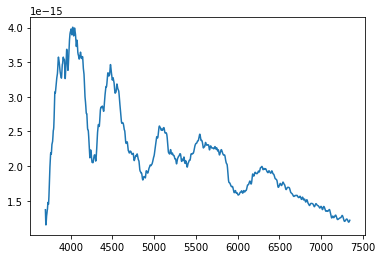

Instance number 520 completed
Minimum violation


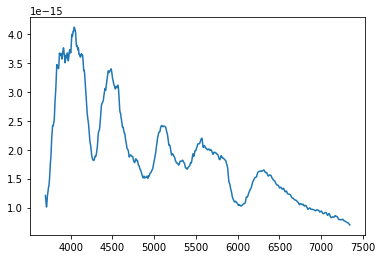

Instance number 521 completed
Minimum violation


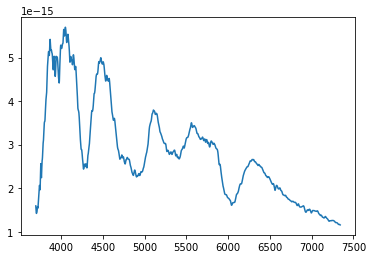

Instance number 522 completed
Minimum violation


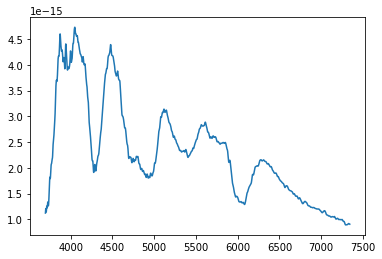

Instance number 523 completed
Minimum violation


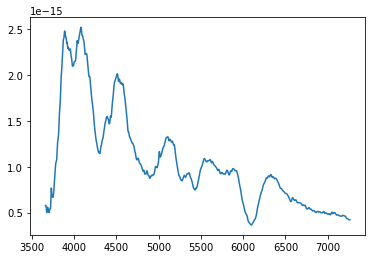

Instance number 524 completed
Minimum violation


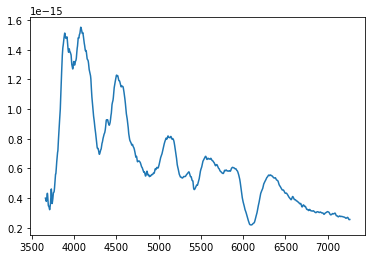

Instance number 525 completed
Minimum violation


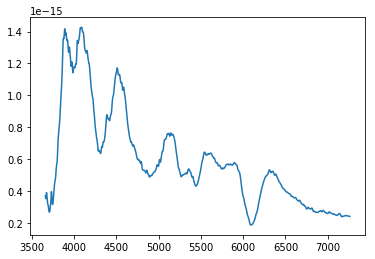

Instance number 526 completed
Minimum violation


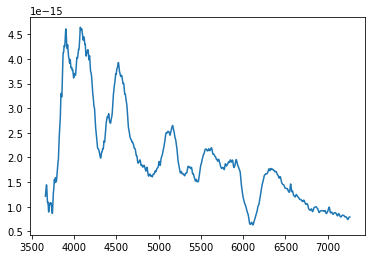

Instance number 527 completed
Minimum violation


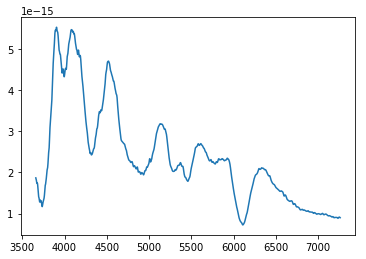

Instance number 528 completed
Minimum violation


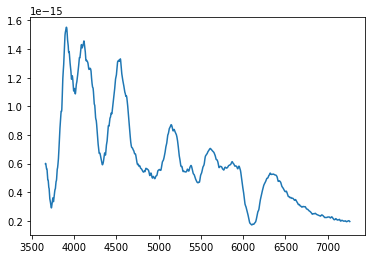

Instance number 529 completed
Minimum violation


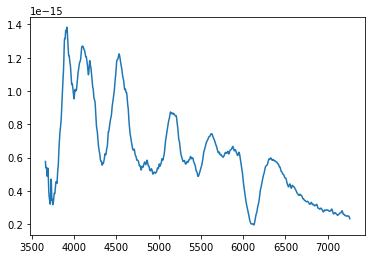

Instance number 530 completed
Minimum violation


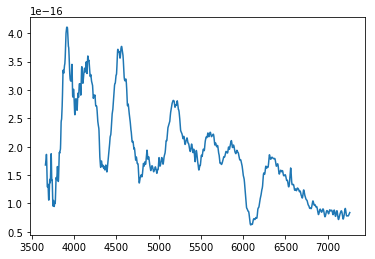

Instance number 531 completed
Minimum violation


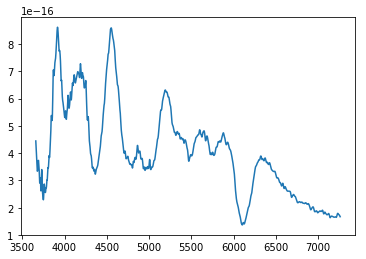

Instance number 532 completed
Minimum violation


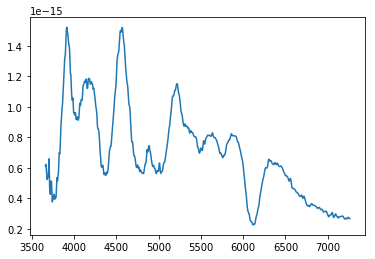

Instance number 533 completed
Minimum violation


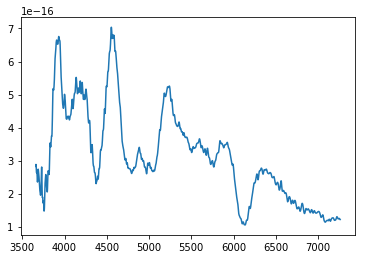

Instance number 534 completed
Minimum violation


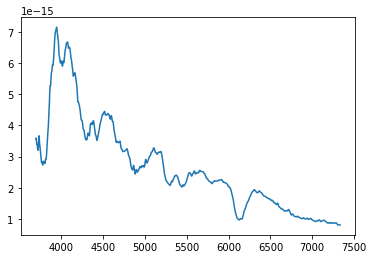

Instance number 535 completed
Minimum violation


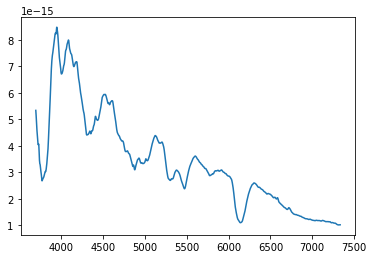

Instance number 536 completed
Minimum violation


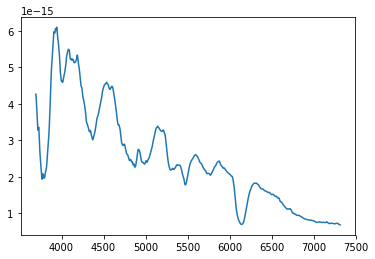

Instance number 537 completed
Minimum violation


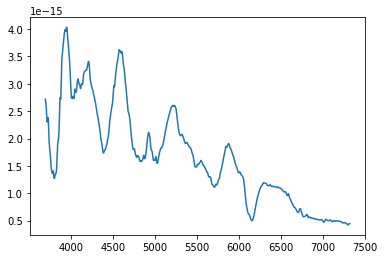

Instance number 538 completed
Minimum violation


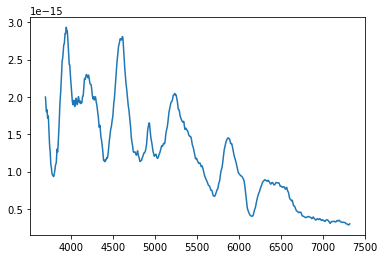

Instance number 539 completed
Instance number 540 completed
Instance number 541 completed
Instance number 542 completed
Instance number 543 completed
Instance number 544 completed
Instance number 545 completed
Minimum violation


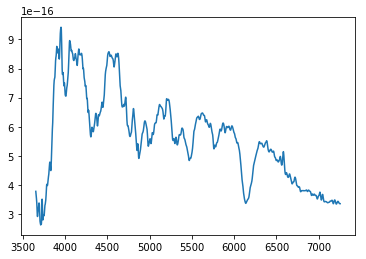

Instance number 546 completed
Minimum violation


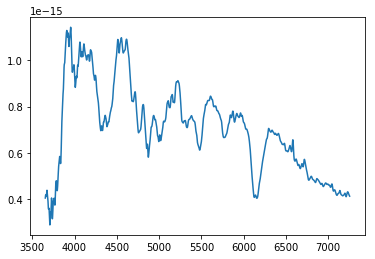

Instance number 547 completed
Minimum violation


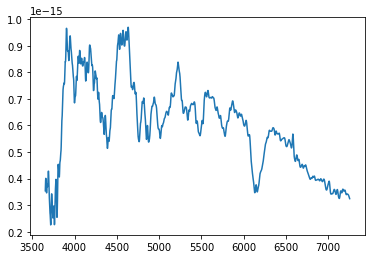

Instance number 548 completed
Instance number 549 completed
Instance number 550 completed
Instance number 551 completed
Instance number 552 completed
Instance number 553 completed
Instance number 554 completed
Instance number 555 completed
Instance number 556 completed
Instance number 557 completed
Instance number 558 completed
Instance number 559 completed
Instance number 560 completed
Instance number 561 completed
Instance number 562 completed
Instance number 563 completed
Instance number 564 completed
Instance number 565 completed
Instance number 566 completed
Instance number 567 completed
Instance number 568 completed
Instance number 569 completed
Instance number 570 completed
Instance number 571 completed
Instance number 572 completed
Instance number 573 completed
Instance number 574 completed
Instance number 575 completed
Instance number 576 completed
Minimum violation


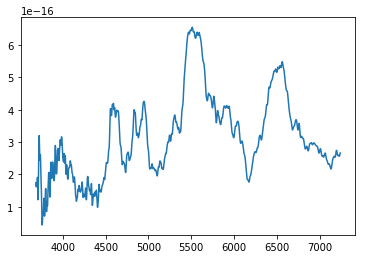

Instance number 577 completed
Instance number 578 completed
Instance number 579 completed
Instance number 580 completed
Instance number 581 completed
Instance number 582 completed
Instance number 583 completed
Instance number 584 completed
Instance number 585 completed
Instance number 586 completed
Instance number 587 completed
Instance number 588 completed
Instance number 589 completed
Instance number 590 completed
Instance number 591 completed
Instance number 592 completed
Instance number 593 completed
Instance number 594 completed
Instance number 595 completed
Instance number 596 completed
Minimum violation


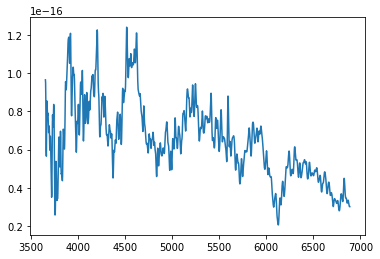

Instance number 597 completed
Instance number 598 completed
Instance number 599 completed
Instance number 600 completed
Instance number 601 completed
Instance number 602 completed
Instance number 603 completed
Instance number 604 completed
Instance number 605 completed
Instance number 606 completed
Instance number 607 completed
Instance number 608 completed
Instance number 609 completed
Instance number 610 completed
Instance number 611 completed
Instance number 612 completed
Instance number 613 completed
Instance number 614 completed
Instance number 615 completed
Instance number 616 completed
Instance number 617 completed
Instance number 618 completed
Instance number 619 completed
Instance number 620 completed
Instance number 621 completed
Instance number 622 completed
Instance number 623 completed
Instance number 624 completed
Instance number 625 completed
Instance number 626 completed
Instance number 627 completed
Instance number 628 completed
Instance number 629 completed
Instance n

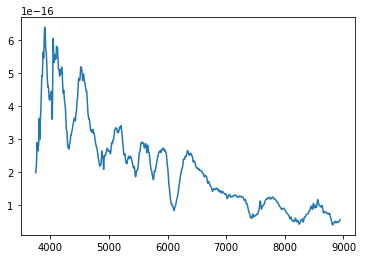

Instance number 777 completed
Instance number 778 completed
Instance number 779 completed
Instance number 780 completed
Minimum violation


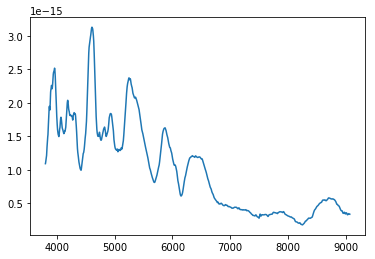

Instance number 781 completed
Minimum violation


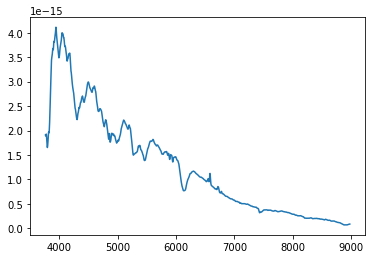

Instance number 782 completed
Minimum violation


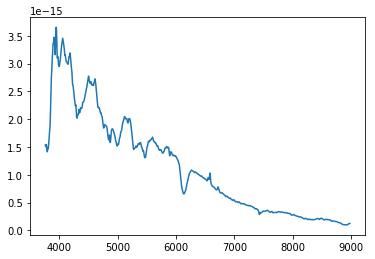

Instance number 783 completed
Minimum violation


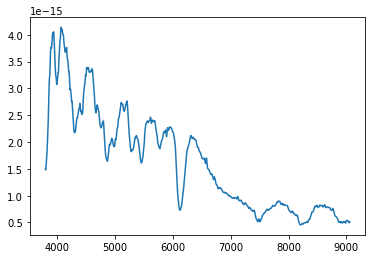

Instance number 784 completed
Minimum violation


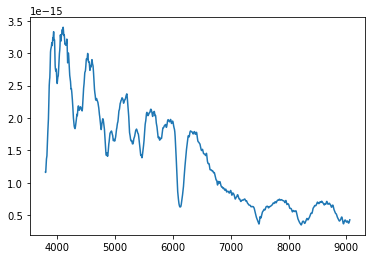

Instance number 785 completed
Minimum violation


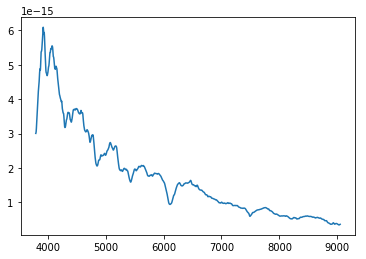

Instance number 786 completed
Minimum violation


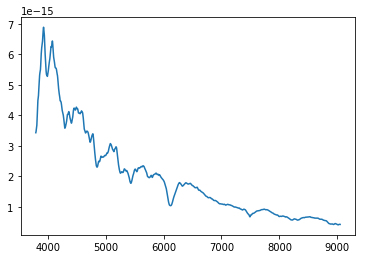

Instance number 787 completed
Minimum violation


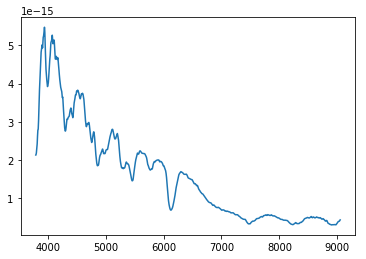

Instance number 788 completed
Instance number 789 completed
Minimum violation


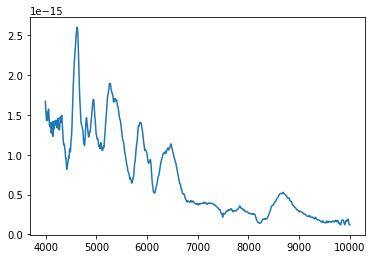

Instance number 790 completed
Minimum violation


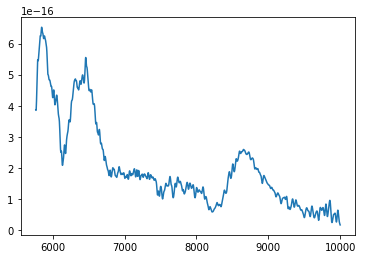

Instance number 791 completed
Instance number 792 completed
Minimum violation


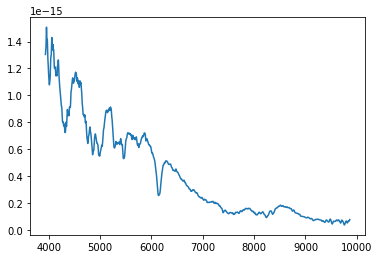

Instance number 793 completed
Minimum violation


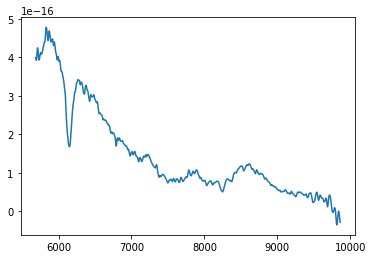

Instance number 794 completed
Minimum violation


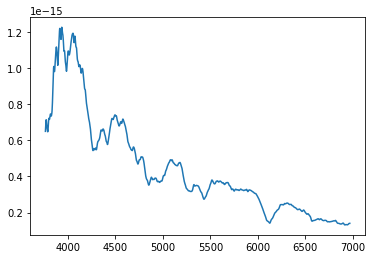

Instance number 795 completed
Minimum violation


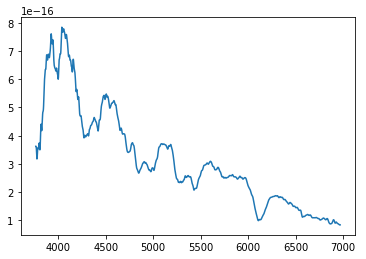

Instance number 796 completed
Minimum violation


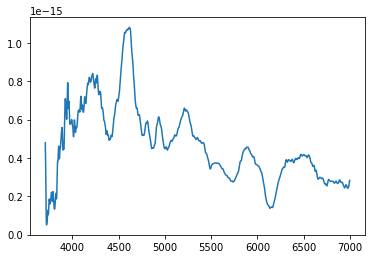

Instance number 797 completed
Minimum violation


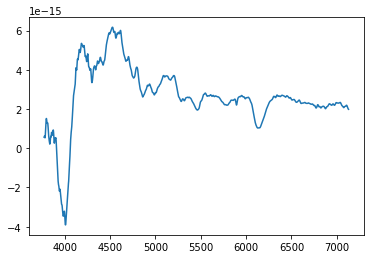

Instance number 798 completed
Minimum violation


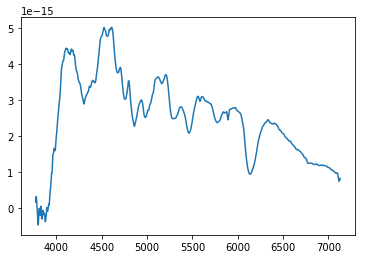

Instance number 799 completed
Instance number 800 completed
Minimum violation


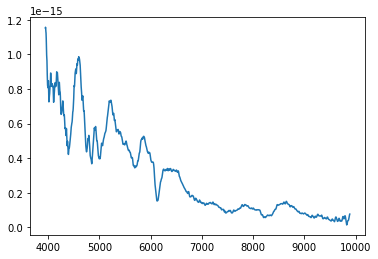

Instance number 801 completed
Minimum violation


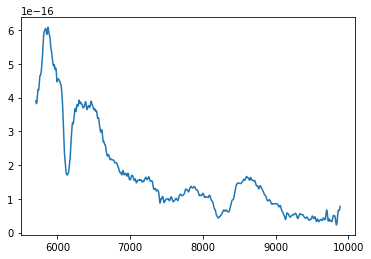

Instance number 802 completed
Minimum violation


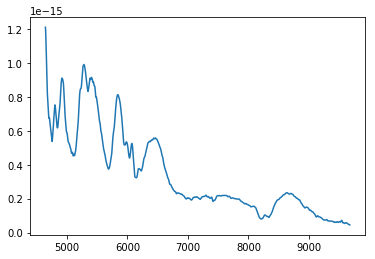

Instance number 803 completed
Minimum violation


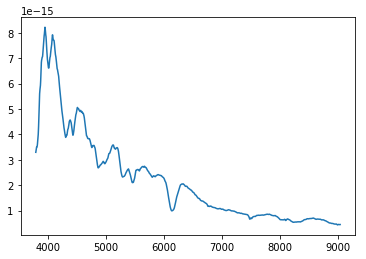

Instance number 804 completed
Minimum violation


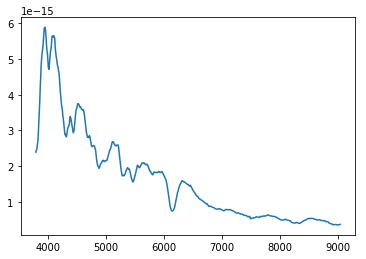

Instance number 805 completed
Minimum violation


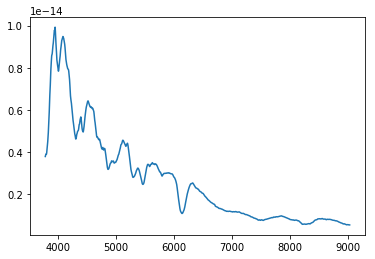

Instance number 806 completed
Minimum violation


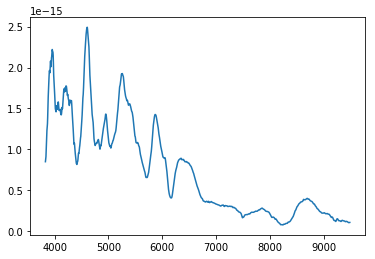

Instance number 807 completed
Minimum violation


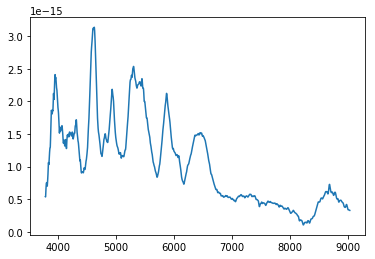

Instance number 808 completed
Minimum violation


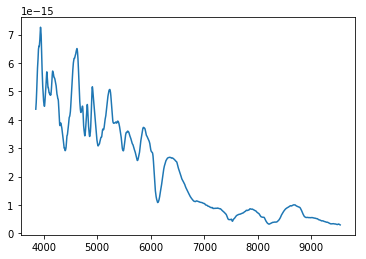

Instance number 809 completed
Minimum violation


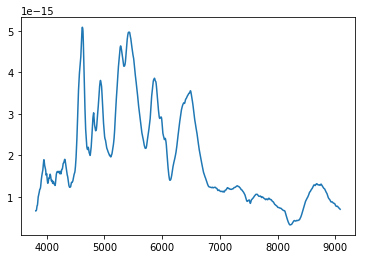

Instance number 810 completed
Minimum violation


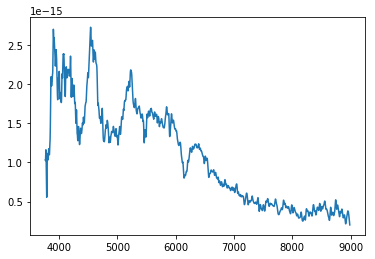

Instance number 811 completed
Minimum violation


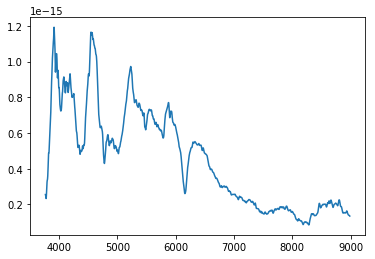

Instance number 812 completed
Instance number 813 completed
Minimum violation


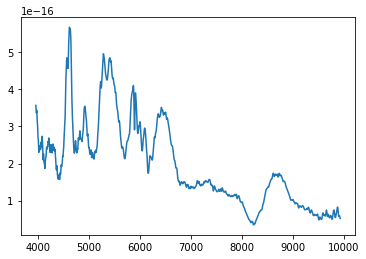

Instance number 814 completed
Minimum violation


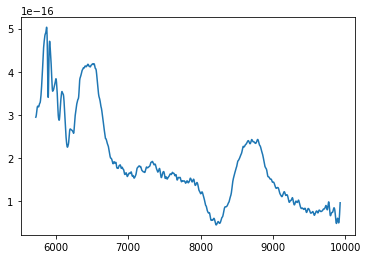

Instance number 815 completed
Minimum violation


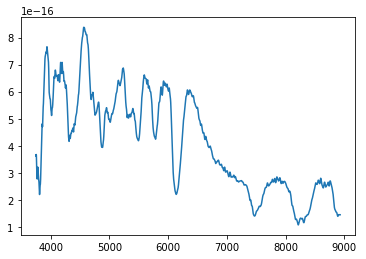

Instance number 816 completed
Minimum violation


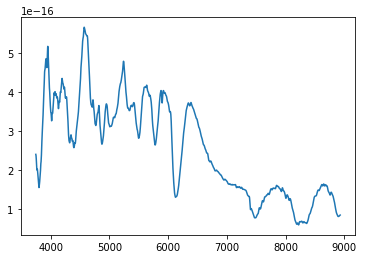

Instance number 817 completed
Minimum violation


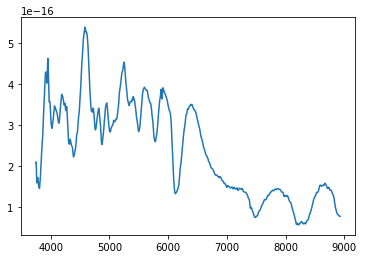

Instance number 818 completed
Instance number 819 completed
Minimum violation


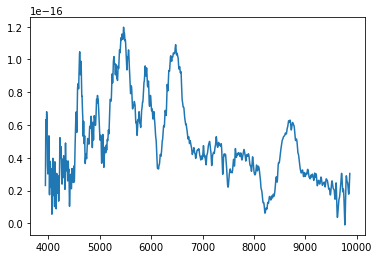

Instance number 820 completed
Minimum violation


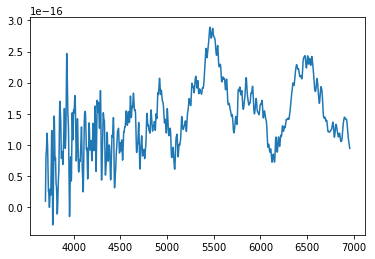

Instance number 821 completed
Minimum violation


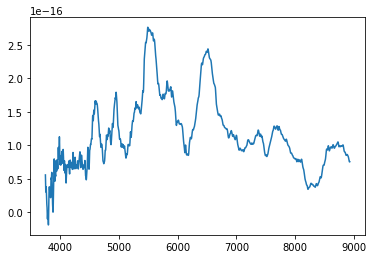

Instance number 822 completed
Minimum violation


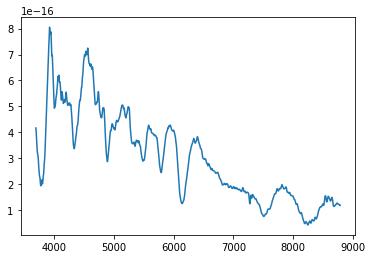

Instance number 823 completed
Minimum violation


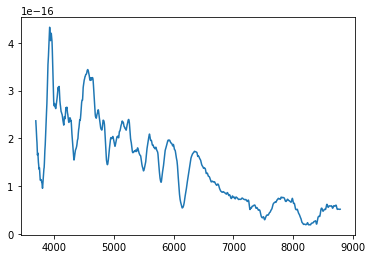

Instance number 824 completed
Minimum violation


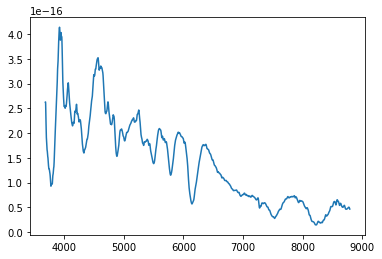

Instance number 825 completed
Minimum violation


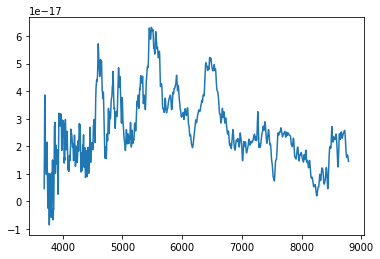

Instance number 826 completed
Minimum violation


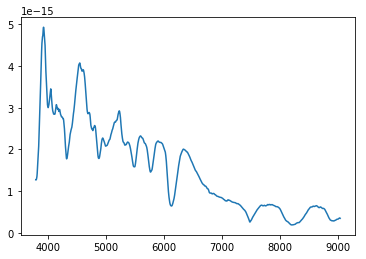

Instance number 827 completed
Minimum violation


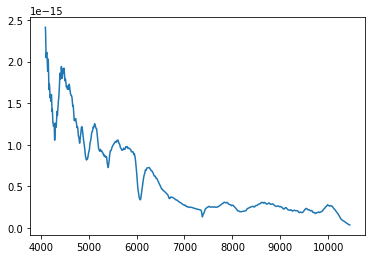

Instance number 828 completed
Instance number 829 completed
Minimum violation


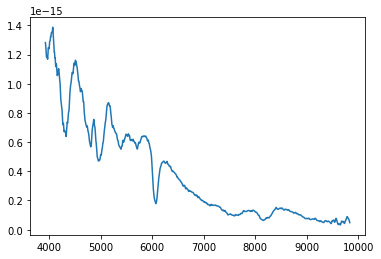

Instance number 830 completed
Minimum violation


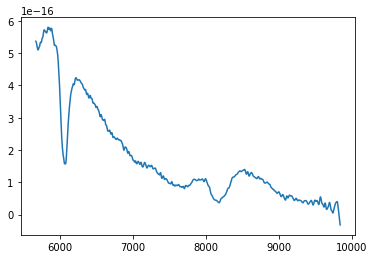

Instance number 831 completed
Minimum violation


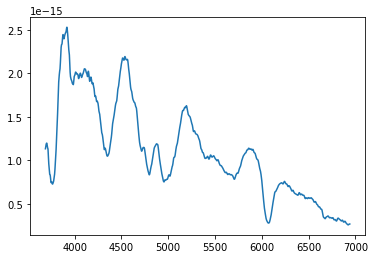

Instance number 832 completed
Minimum violation


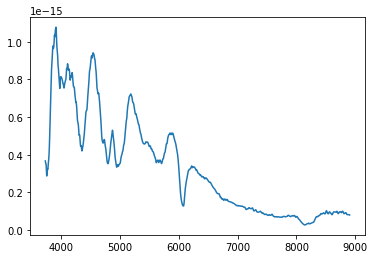

Instance number 833 completed
Minimum violation


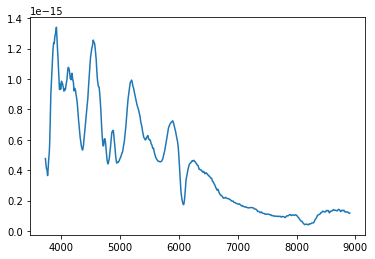

Instance number 834 completed
Minimum violation


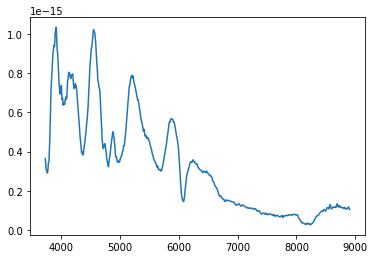

Instance number 835 completed
Minimum violation


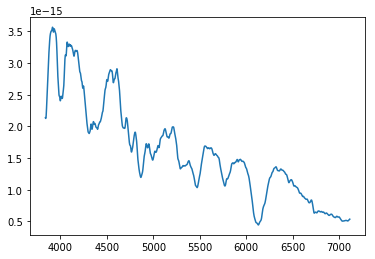

Instance number 836 completed
Instance number 837 completed
Minimum violation


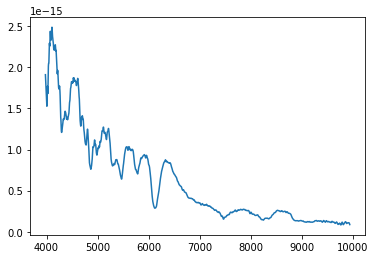

Instance number 838 completed
Minimum violation


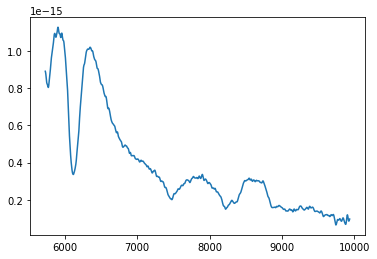

Instance number 839 completed
Minimum violation


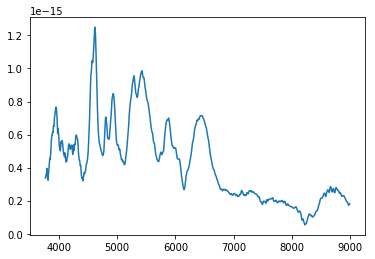

Instance number 840 completed
Minimum violation


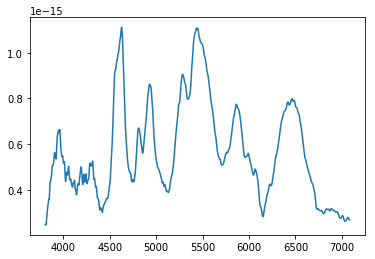

Instance number 841 completed
Minimum violation


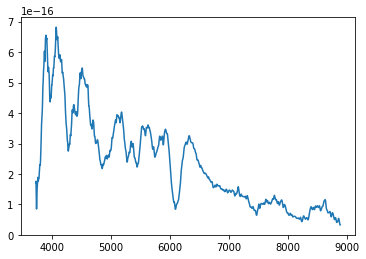

Instance number 842 completed
Instance number 843 completed
Instance number 844 completed
Instance number 845 completed
Instance number 846 completed
Minimum violation


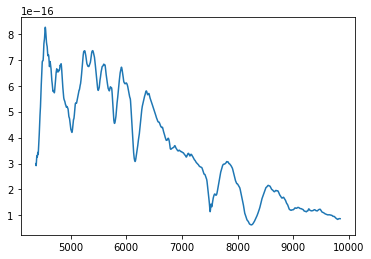

Instance number 847 completed
Instance number 848 completed
Minimum violation


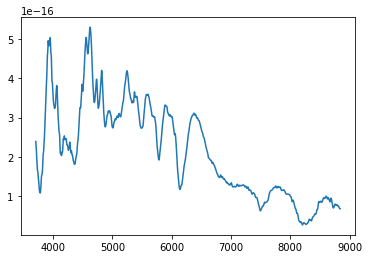

Instance number 849 completed
Instance number 850 completed
Minimum violation


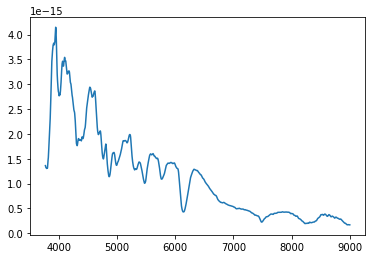

Instance number 851 completed
Minimum violation


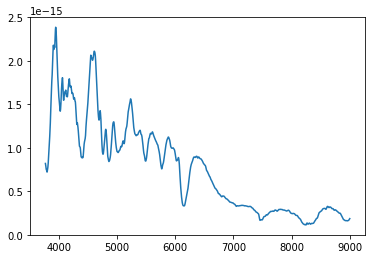

Instance number 852 completed
Minimum violation


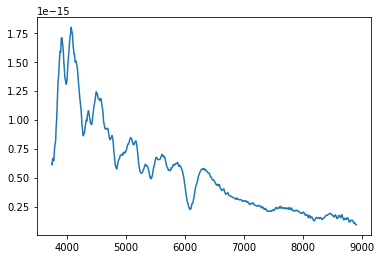

Instance number 853 completed
Minimum violation


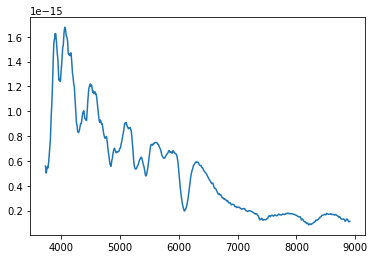

Instance number 854 completed
Instance number 855 completed
Instance number 856 completed
Instance number 857 completed
Minimum violation


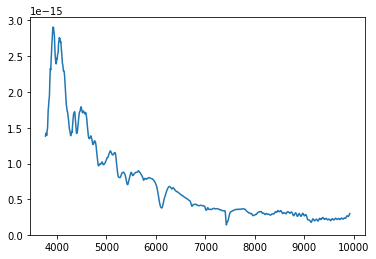

Instance number 858 completed
Minimum violation


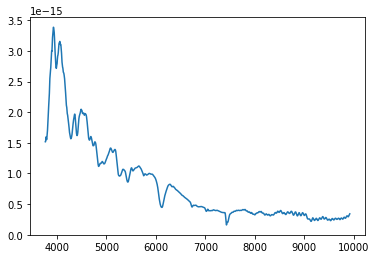

Instance number 859 completed
Instance number 860 completed
Minimum violation


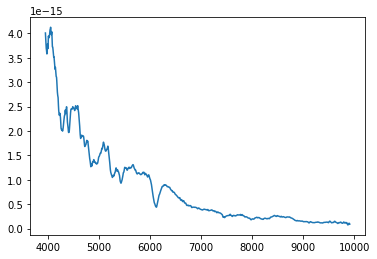

Instance number 861 completed
Minimum violation


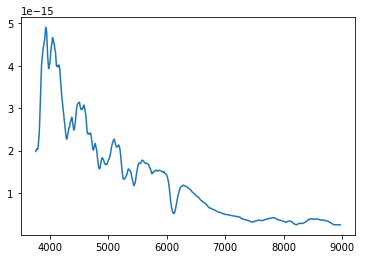

Instance number 862 completed
Minimum violation


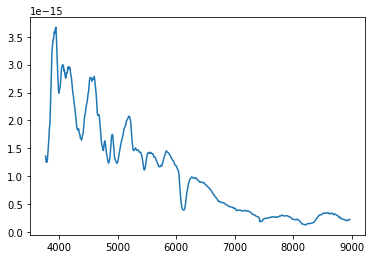

Instance number 863 completed
Minimum violation


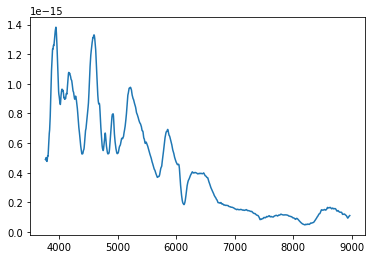

Instance number 864 completed
Instance number 865 completed
Instance number 866 completed
Instance number 867 completed
Instance number 868 completed
Instance number 869 completed
Instance number 870 completed
Instance number 871 completed
Maxiumum violation


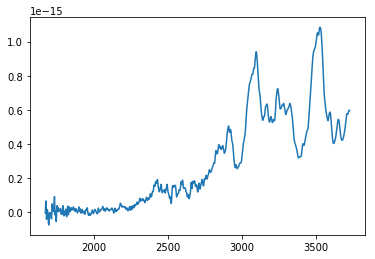

Instance number 872 completed
Instance number 873 completed
All complete


In [26]:
ca_data_table = []
i = 0
print "Grabbing phase and calcium velocity data..."
for SN in ca_v_evo_SN_Array:
    
    wavelength = SN.wavelength[SN.x1:SN.x2]
    flux = autosmooth(wavelength, SN.flux[SN.x1:SN.x2], 1 / SN.ivar[SN.x1:SN.x2])
    
    if SN.wavelength[SN.x1] > 3640:
        print "Minimum violation"
        plt.plot(wavelength, flux)
        plt.show()

    elif SN.wavelength[SN.x2] < 4100:
        print "Maxiumum violation"
        plt.plot(wavelength, flux)
        plt.show()
    
    else:
        
        min_wave = find_min_wave(wavelength, flux, 3650, 4100)

        name = SN.name
        filename = SN.filename

        phase = SN.phase
        v = ca_velocity(min_wave)

        source = SN.source

        data = [name, filename, phase, v, source]
        ca_data_table.append(data)

    i = i + 1

    print "Instance number", i, "completed"

print "All complete"

In [27]:
print len(ca_data_table)

471


In [31]:
ca_big_table = []
x = 0

print "Building event velocity evolutions..."

for i in range(len(ca_data_table)):
    x = x+1
    print x, ca_data_table[i][0]
    
    if ca_data_table[i][0] == ca_data_table[i-1][0]:
        pass
    
    else:
        sn_name = ca_data_table[i][0]
        filenames= []
        phase_data = []
        velocity_data = []
        source_data = []
        
        filenames.append(ca_data_table[i][1])
        phase_data.append(ca_data_table[i][2])
        velocity_data.append(ca_data_table[i][3])
        source_data.append(ca_data_table[i][4])
        #event_data.append([data_table[i][1], data_table[i][2]])
        
        for n in range(i+1, len(ca_data_table)):
            if ca_data_table[i][0] == ca_data_table[n][0]:
                filenames.append(ca_data_table[n][1])
                phase_data.append(ca_data_table[n][2])
                velocity_data.append(ca_data_table[n][3])
                source_data.append(ca_data_table[n][4])
        
        object_data = [sn_name, filenames, phase_data, velocity_data, source_data]
        
        print object_data
        ca_big_table.append(object_data)

Building event velocity evolutions...
1 1993ac
[u'1993ac', [u'sn1993ac-19931022-uoi.flm', u'sn1993ac-19931016.49-mmt.flm', u'sn1993ac-19931020.52-mmt.flm'], [12.50238322211436, 6.749285033359839, 10.591039084836327], [-15179.341772151898, -16697.27594936709, -21402.871898734178], [u'bsnip', u'cfa', u'cfa']]
2 1994s
[u'1994s', [u'sn1994s-19940616-uoi.flm'], [0.9988405962732136], [-11232.712911392406], [u'bsnip']]
3 1995e
[u'1995e', [u'sn1995e-19950224-uoi2.flm', u'sn1995E-19950224.27-fast.flm', u'sn1995E-19950226.27-fast.flm', u'sn1995E-19950228.23-fast.flm', u'sn1995E-19950303.16-fast.flm', u'sn1995E-19950305.17-fast.flm', u'sn1995E-19950308.16-mmt.flm'], [-2.176803499498083, -2.2203000271917173, -0.24318513210237608, 1.6943874650915078, 4.5908607863976805, 6.5778612559572895, 9.533648024121034], [-16849.069367088607, -16545.482531645568, -12295.266835443039, -12447.060253164556, -12295.266835443039, -12295.266835443039, -11688.093164556962], [u'bsnip', u'cfa', u'cfa', u'cfa', u'cfa', 

[u'2001eh', [u'sn2001eh-20010915.42-fast.flm', u'sn2001eh-20010917.39-fast.flm', u'sn2001eh-20010920.33-fast.flm', u'sn2001eh-20010921.35-fast.flm', u'sn2001eh-20010922.35-fast.flm', u'sn2001eh-20010923.37-fast.flm', u'sn2001eh-20010926.37-fast.flm'], [-2.2805379948287605, -0.3808932380400242, 2.454109596965056, 3.4376820091058096, 4.4019686876782025, 5.385541099825971, 8.27840113554315], [-17759.829873417722, -17304.449620253166, -17000.862784810128, -16849.069367088607, -16849.069367088607, -17152.656202531645, -17304.449620253166], [u'cfa', u'cfa', u'cfa', u'cfa', u'cfa', u'cfa', u'cfa']]
182 2001eh
183 2001eh
184 2001eh
185 2001eh
186 2001eh
187 2001eh
188 2001n
[u'2001n', [u'sn2001N-20010126.24-mmt.flm'], [7.36220954433028], [-19429.55746835443], [u'cfa']]
189 2002ha
[u'2002ha', [u'sn2002ha-20021104.11-mmt.flm'], [1.8986593059931745], [-16697.27594936709], [u'cfa']]
190 2002he
[u'2002he', [u'sn2002he-20021104.50-mmt.flm'], [-3.358501762699933], [-16090.102278481012], [u'cfa']]
191

In [32]:
SN_ca_v_object_list = []
for entry in ca_big_table:
    SN_ca_v_object = SN_ca_v_data(entry[0], entry[1], entry[2], entry[3], entry[4])
    SN_ca_v_object_list.append(SN_ca_v_object)
    
print SN_ca_v_object_list

[<__main__.SN_ca_v_data instance at 0x0000000038588C88>, <__main__.SN_ca_v_data instance at 0x0000000038588CC8>, <__main__.SN_ca_v_data instance at 0x0000000038588B88>, <__main__.SN_ca_v_data instance at 0x0000000038588B08>, <__main__.SN_ca_v_data instance at 0x0000000038588A88>, <__main__.SN_ca_v_data instance at 0x0000000038588D08>, <__main__.SN_ca_v_data instance at 0x0000000038588D48>, <__main__.SN_ca_v_data instance at 0x0000000038588E88>, <__main__.SN_ca_v_data instance at 0x0000000038588C48>, <__main__.SN_ca_v_data instance at 0x0000000038588DC8>, <__main__.SN_ca_v_data instance at 0x0000000038588E08>, <__main__.SN_ca_v_data instance at 0x0000000038588E48>, <__main__.SN_ca_v_data instance at 0x0000000038588FC8>, <__main__.SN_ca_v_data instance at 0x0000000038588848>, <__main__.SN_ca_v_data instance at 0x0000000038588EC8>, <__main__.SN_ca_v_data instance at 0x0000000038588F48>, <__main__.SN_ca_v_data instance at 0x0000000038588F88>, <__main__.SN_ca_v_data instance at 0x0000000038

In [33]:
for object in SN_ca_v_object_list:
    print object.name

1993ac
1994s
1995e
1997cn
1997y
1998bp
1998dx
1999aa
1999ac
1999cp
1999da
1999dk
1999dq
1999ee
1999ek
2000cn
2000dk
2000fa
2001az
2001bf
2001cp
2001da
2001eh
2001en
2001ep
2001fe
2001fh
2001g
2001n
2001v
2002bz
2002ck
2002de
2002dp
2002fb
2002g
2002ha
2002hd
2002he
2002jy
2002kf
2003cq
2003d
2003iv
2003u
2003w
2004as
2004bg
2004eo
2004ey
2004gs
2004s
2005ag
2005el
2005eq
2005kc
2005ki
2005mc
2005ms
2005na
2006ac
2006ak
2006bq
2006bt
2006bu
2006bw
2006bz
2006cc
2006cf
2006cj
2006cq
2006cs
2006ef
2006ej
2006em
2006en
2006et
2006gj
2006gr
2006gt
2006kf
2006le
2006lf
2006mo
2006mp
2006n
2006or
2006os
2006s
2006sr
2007al
2007au
2007ba
2007bc
2007bd
2007bz
2007ca
2007ci
2007co
2007cq
2007f
2007qe
2007s
1993ac
1994m
1995ac
1995e
1996ab
1996bl
1996c
1998ab
1998dx
1999aa
1999ef
2000cf
2000dk
2001ah
2001az
2001bf
2001da
2001eh
2001n
2002ha
2002he
2003ch
2003fa
2003hu
2003ic
2004gs
2005bo
2005el
2005eq
2005eu
2005hc
2005hf
2005kc
2005ki
2005ls
2005lz
2005mc
2005na
2006ac
2006ak
2006al
2006ax
2006

1993ac [u'sn1993ac-19931022-uoi.flm', u'sn1993ac-19931016.49-mmt.flm', u'sn1993ac-19931020.52-mmt.flm'] [12.50238322211436, 6.749285033359839, 10.591039084836327] [-15179.341772151898, -16697.27594936709, -21402.871898734178]


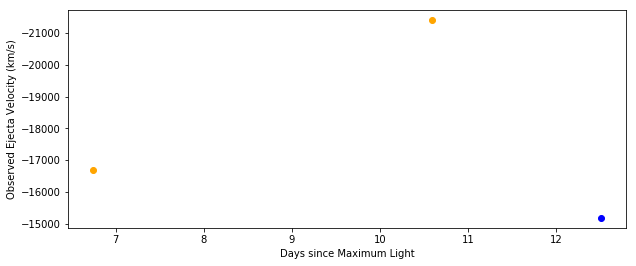

1994s [u'sn1994s-19940616-uoi.flm'] [0.9988405962732136] [-11232.712911392406]


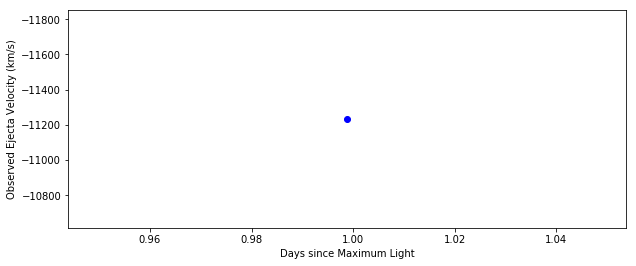

1995e [u'sn1995e-19950224-uoi2.flm', u'sn1995E-19950224.27-fast.flm', u'sn1995E-19950226.27-fast.flm', u'sn1995E-19950228.23-fast.flm', u'sn1995E-19950303.16-fast.flm', u'sn1995E-19950305.17-fast.flm', u'sn1995E-19950308.16-mmt.flm'] [-2.176803499498083, -2.2203000271917173, -0.24318513210237608, 1.6943874650915078, 4.5908607863976805, 6.5778612559572895, 9.533648024121034] [-16849.069367088607, -16545.482531645568, -12295.266835443039, -12447.060253164556, -12295.266835443039, -12295.266835443039, -11688.093164556962]


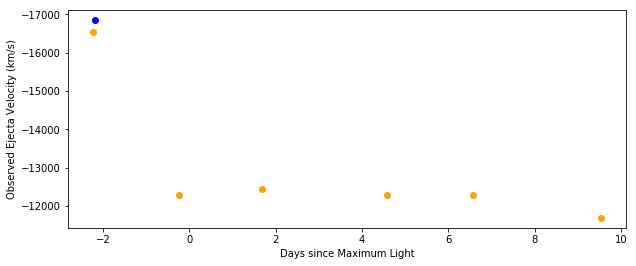

1997cn [u'sn1997cn-19970606-uoi.flm'] [18.927469629349428] [-10777.332658227848]


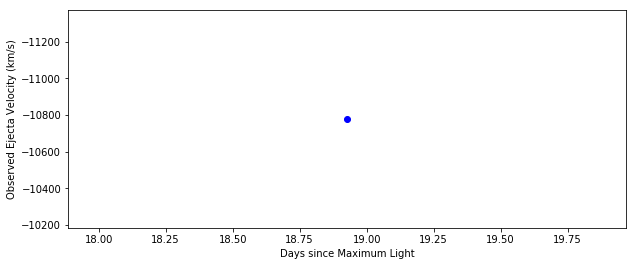

1997y [u'sn1997y-19970209-uohp.flm'] [2.7720191442561264] [-13509.61417721519]


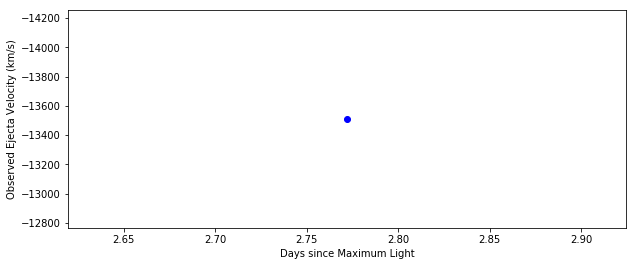

1998bp [u'sn1998bp-19980522-b.flm'] [18.970122650629133] [-10170.158987341772]


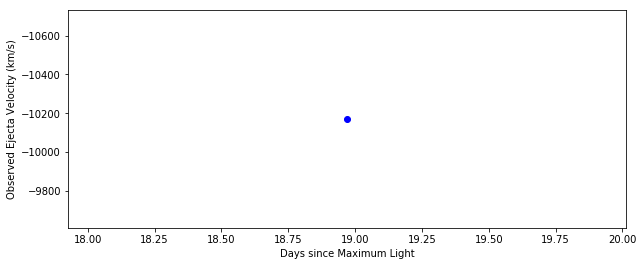

1998dx [u'sn1998dx-19980921-ui.flm', u'sn1998dx-19980914.18-fast.flm', u'sn1998dx-19980915.22-fast.flm', u'sn1998dx-19980917.13-fast.flm', u'sn1998dx-19980918.15-fast.flm', u'sn1998dx-19980922.12-fast.flm', u'sn1998dx-19980924.16-fast.flm', u'sn1998dx-19980929.13-fast.flm'] [4.71152240889689, -1.971118092550861, -0.9846104812643856, 0.8271486894585504, 1.7946850005310306, 5.560488093612922, 7.495560715750981, 12.209928819677554] [-14116.787848101267, -18670.590379746835, -18215.21012658228, -16393.68911392405, -12447.060253164556, -13509.61417721519, -14875.754936708861, -11991.68]


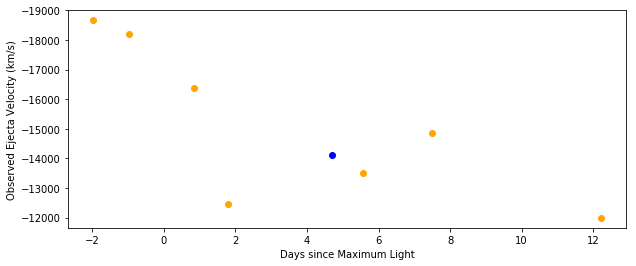

1999aa [u'sn1999aa-19990223-ui.flm', u'sn1999aa-19990312-ui.flm', u'sn1999aa-19990218.25-fast.flm', u'sn1999aa-19990219.28-fast.flm', u'sn1999aa-19990220.29-fast.flm'] [0.4603511483683075, 17.25577484393372, -4.455647089089085, -3.4403115798501864, -2.444691323214735] [-17608.0364556962, -11688.093164556962, -20492.111392405062, -20492.111392405062, -18215.21012658228]


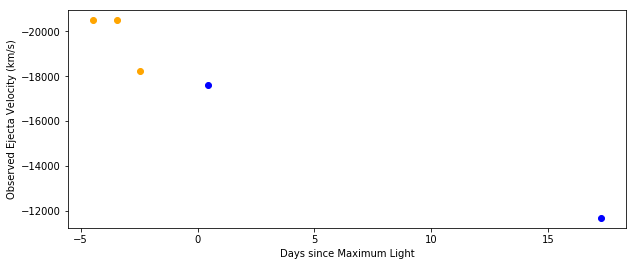

1999ac [u'sn1999ac-19990312-ui-corrected.flm'] [-0.3853392768725628] [-15331.135189873417]


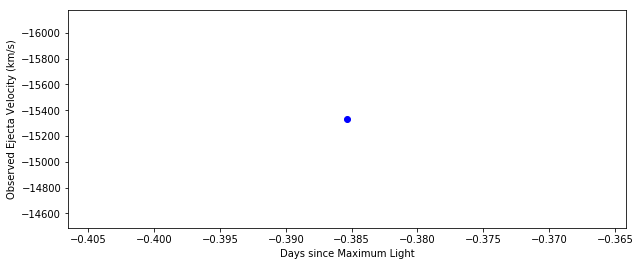

1999cp [u'sn1999cp-19990709-ui-corrected.flm', u'sn1999cp-19990718-ui-corrected.flm'] [4.856956056582031, 13.798193129139484] [-10929.126075949367, -10625.539240506328]


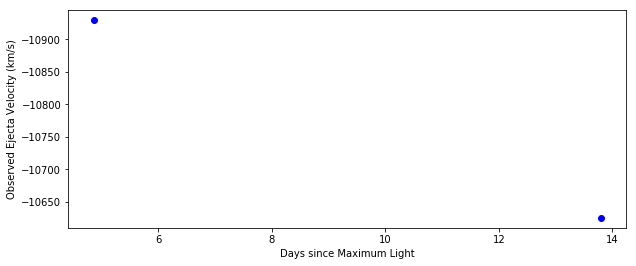

1999da [u'sn1999da-19990709-ui.flm', u'sn1999da-19990718-ui.flm'] [-2.6908397888787294, 6.183500461641901] [-14723.961518987342, -14572.168101265823]


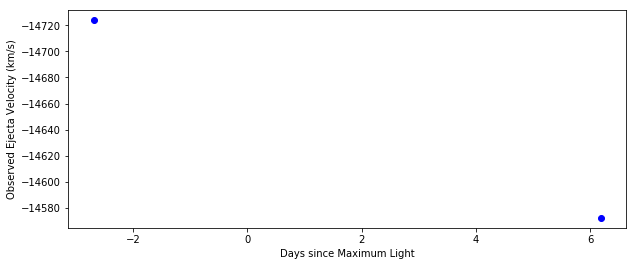

1999dk [u'sn1999dk-19990910-ui.flm'] [16.79278001103658] [-14723.961518987342]


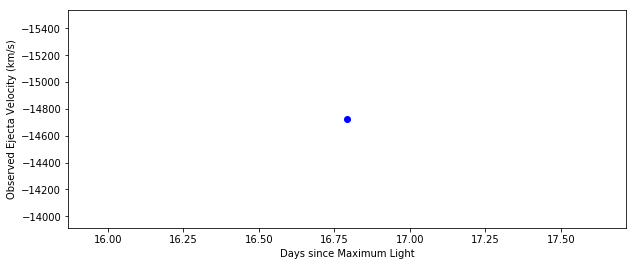

1999dq [u'sn1999dq-19990910-ui-corrected.flm', u'sn1999dq-near-19990917-clear-ui-corrected.flm'] [-3.560981813558142, 3.336202230639819] [-18822.383797468356, -18215.21012658228]


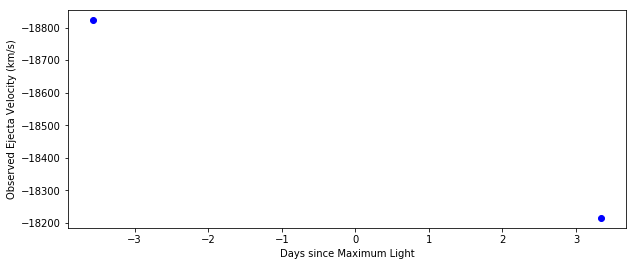

1999ee [u'sn1999ee-19991105-ui.flm'] [17.803769965844946] [-14420.374683544303]


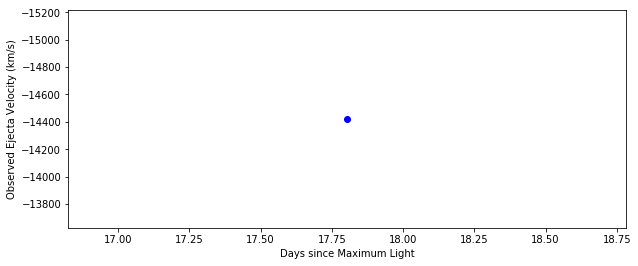

1999ek [u'sn1999ek-19991105-ui.flm'] [5.241164318804625] [-15179.341772151898]


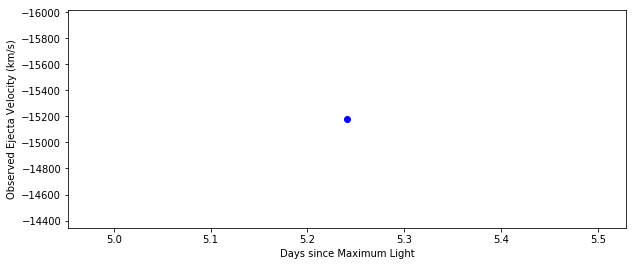

2000cn [u'sn2000cn-20000627-ui-corrected.flm'] [14.318612828811565] [-12295.266835443039]


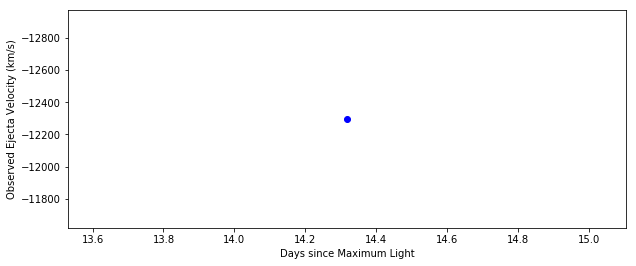

2000dk [u'sn2000dk-20000926-ui-corrected.flm', u'sn2000dk-20001006-ui-corrected.flm', u'sn2000dk-20001005.33-fast.flm'] [1.027085573426548, 10.86351851014592, 9.726352951815082] [-13054.233924050634, -12902.440506329114, -12902.440506329114]


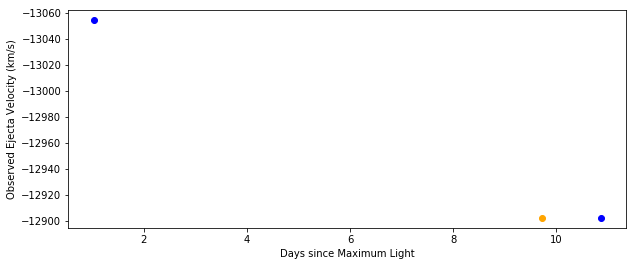

2000fa [u'sn2000fa-20001221-ui-corrected.flm'] [6.922719150081721] [-17456.243037974684]


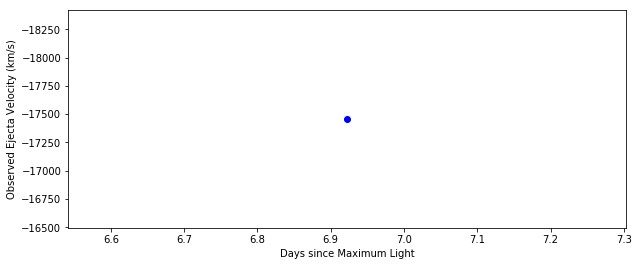

2001az [u'sn2001az-20010430-ui.flm', u'sn2001az-20010430.40-fast.flm', u'sn2001az-20010522.33-fast.flm'] [-3.1940193812793605, -2.8096608516415174, 18.262795535676855] [-18822.383797468356, -18822.383797468356, -22465.42582278481]


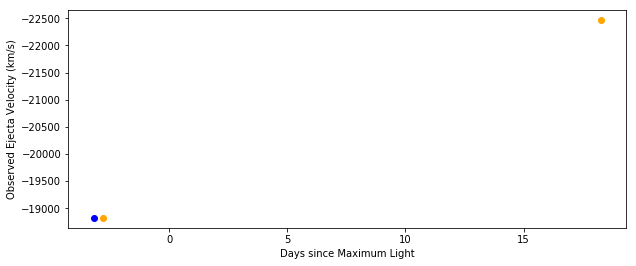

2001bf [u'sn2001bf-20010516-ui-corrected.flm', u'sn2001bf-20010525.47-mmt.flm'] [1.9596238703831534, 10.852771193726683] [-17000.862784810128, -16241.895696202531]


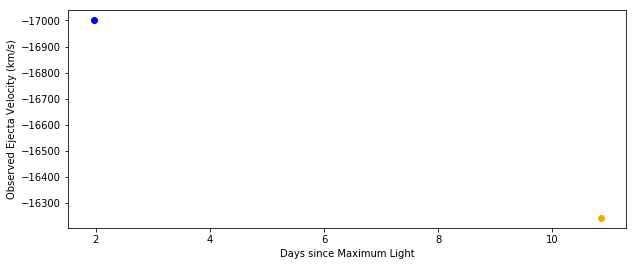

2001cp [u'sn2001cp-20010629-ui.flm', u'sn2001cp-20010716-ui.flm'] [0.9174473445884503, 17.529308432501047] [-11688.093164556962, -13206.027341772153]


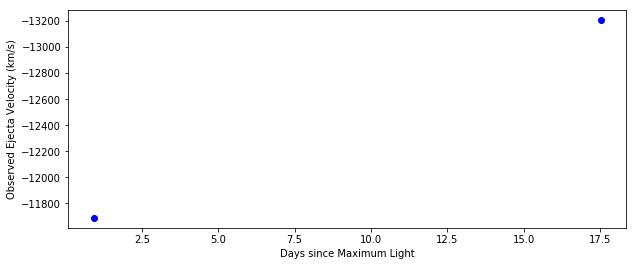

2001da [u'sn2001da-20010716-ui-corrected.flm', u'sn2001da-20010727-ui-corrected.flm', u'sn2001da-20010715.47-mmt.flm'] [2.216880735746224, 13.058459784009761, 1.2455822138329675] [-19581.35088607595, -17000.862784810128, -19733.144303797468]


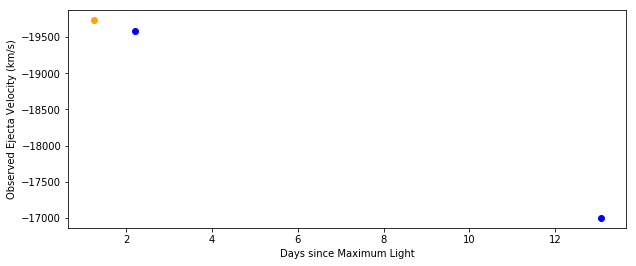

2001eh [u'sn2001eh-20010920-ui.flm', u'sn2001eh-20010915.42-fast.flm', u'sn2001eh-20010917.39-fast.flm', u'sn2001eh-20010920.33-fast.flm', u'sn2001eh-20010921.35-fast.flm', u'sn2001eh-20010922.35-fast.flm', u'sn2001eh-20010923.37-fast.flm', u'sn2001eh-20010926.37-fast.flm'] [2.5968240253947803, -2.2805379948287605, -0.3808932380400242, 2.454109596965056, 3.4376820091058096, 4.4019686876782025, 5.385541099825971, 8.27840113554315] [-17152.656202531645, -17759.829873417722, -17304.449620253166, -17000.862784810128, -16849.069367088607, -16849.069367088607, -17152.656202531645, -17304.449620253166]


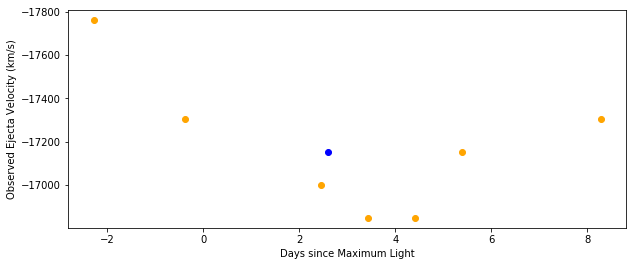

2001en [u'sn2001en-20011020-ui-corrected.flm', u'sn2001en-20011025-ui-corrected.flm'] [10.924615428531908, 15.55020273243223] [-12143.47341772152, -13054.233924050634]


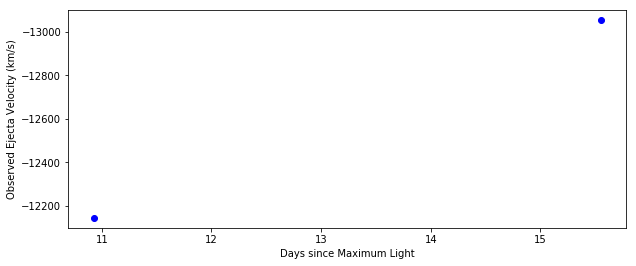

2001ep [u'sn2001ep-20011020-ui-corrected.flm', u'sn2001ep-20011025-ui-corrected.flm', u'sn2001ep-20011028.024-hst.flm'] [2.684751892405769, 7.704843114743391, 10.117171653362998] [-14420.374683544303, -12598.853670886076, -14116.787848101267]


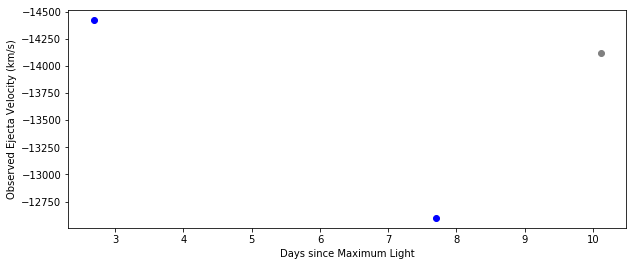

2001fe [u'sn2001fe-20011115-ui.flm'] [-1.0645865625278401] [-11839.886582278481]


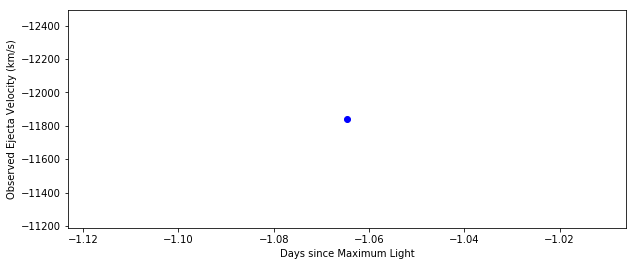

2001fh [u'sn2001fh-20011116-ui-corrected.flm'] [5.868764745949821] [-12598.853670886076]


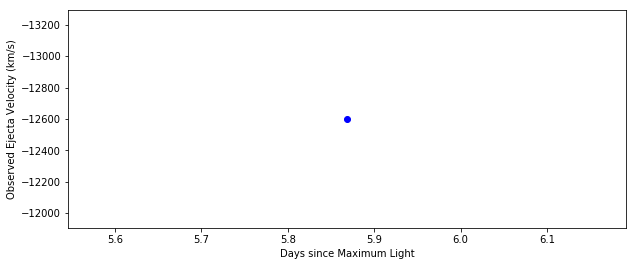

2001g [u'sn2001g-20010201-ui.flm'] [10.276660405008531] [-11991.68]


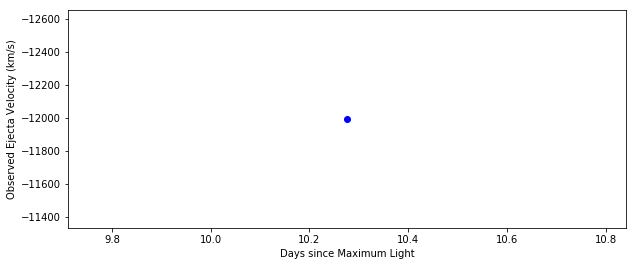

2001n [u'sn2001n-20010201-ui.flm', u'sn2001N-20010126.24-mmt.flm'] [13.00359932421034, 7.36220954433028] [-16090.102278481012, -19429.55746835443]


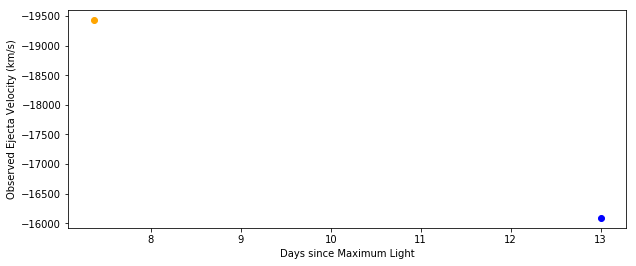

2001v [u'sn2001v-20010321-ui.flm'] [16.68738879507745] [-12295.266835443039]


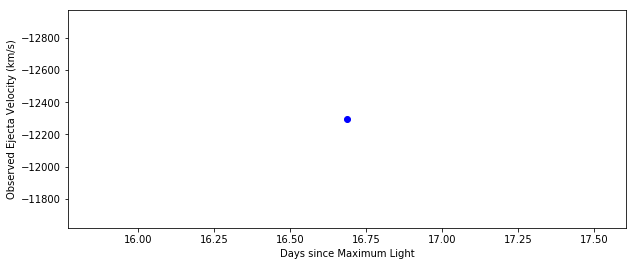

2002bz [u'sn2002bz-20020408-ui.flm'] [5.641410323650835] [-11991.68]


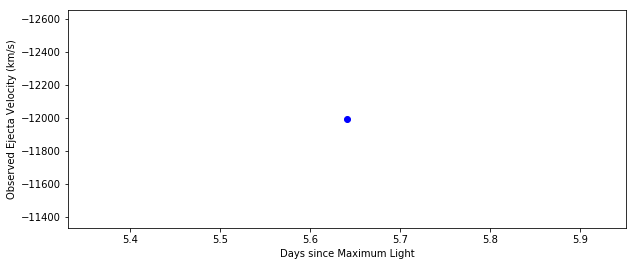

2002ck [u'sn2002ck-20020507-ui.flm'] [5.226903746515686] [-10777.332658227848]


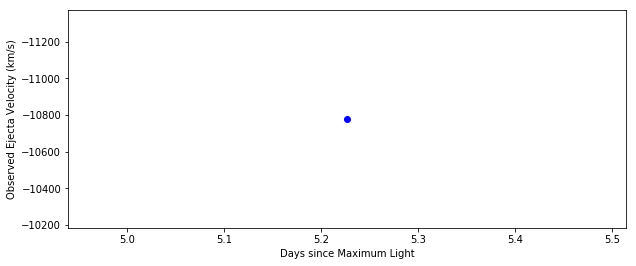

2002de [u'sn2002de-20020608.374-ui-corrected.flm', u'sn2002de-20020617-ui-corrected.flm'] [-0.16048772705958972, 8.525302592313919] [-18822.383797468356, -12295.266835443039]


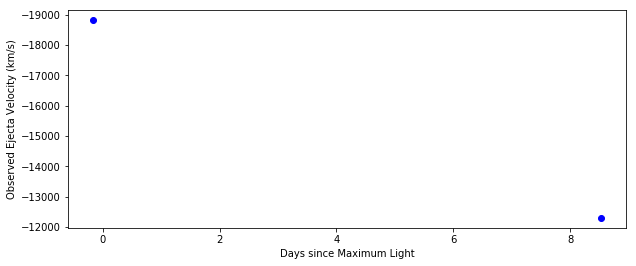

2002dp [u'sn2002dp-20020711-ui-corrected.flm'] [15.705207094631866] [-10170.158987341772]


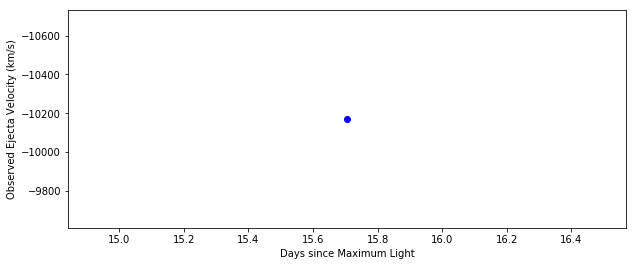

2002fb [u'sn2002fb-20020913-ui-corrected.flm'] [3.1863973524121474] [-13661.407594936709]


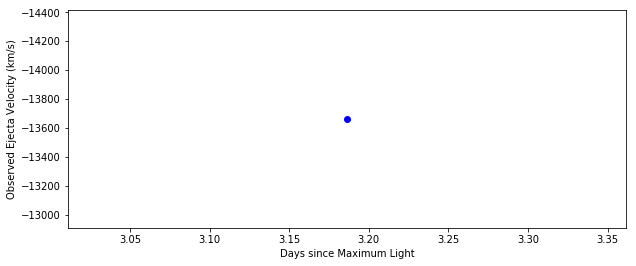

2002g [u'sn2002g-20020211-ui.flm'] [17.26164391910573] [-14116.787848101267]


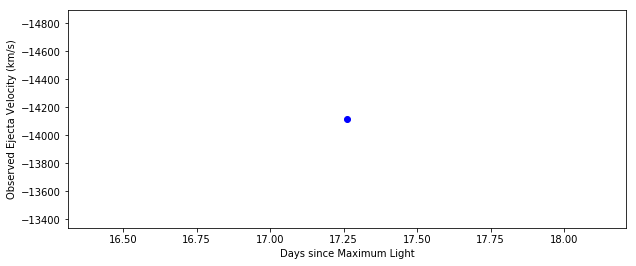

2002ha [u'sn2002ha-20021102-ui-corrected.flm', u'sn2002ha-20021108-br-corrected.flm', u'sn2002ha-20021111-br.flm', u'sn2002ha-20021104.11-mmt.flm'] [-0.04339037736251241, 5.73541897115097, 8.693853791208774, 1.8986593059931745] [-16849.069367088607, -12598.853670886076, -11688.093164556962, -16697.27594936709]


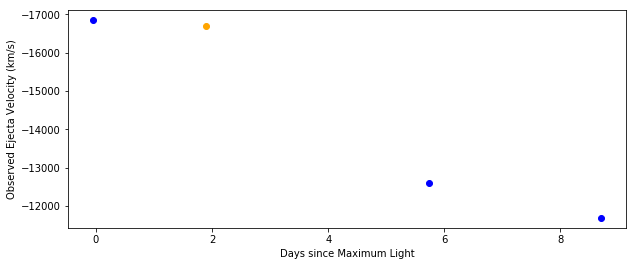

2002hd [u'sn2002hd-20021102-ui.flm'] [13.67241120062602] [-10473.745822784811]


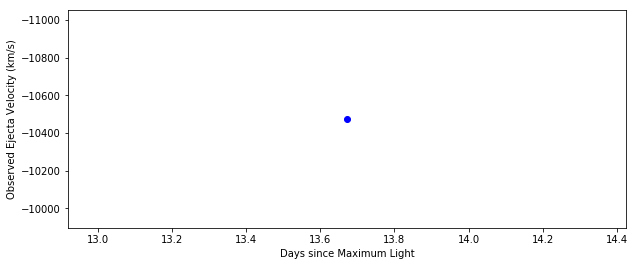

2002he [u'sn2002he-20021108-br.flm', u'sn2002he-20021111-br.flm', u'sn2002he-20021104.50-mmt.flm'] [0.05758547050365418, 2.9856602418210145, -3.358501762699933] [-15179.341772151898, -14268.581265822784, -16090.102278481012]


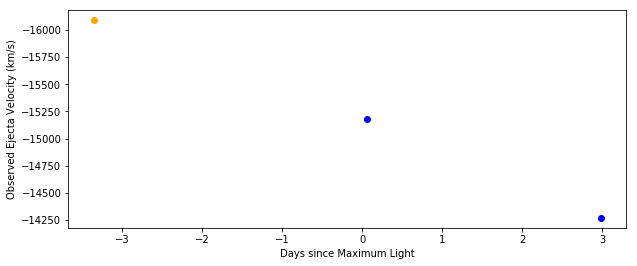

2002jy [u'sn2002jy-20030107-br.flm'] [11.546684974500831] [-12447.060253164556]


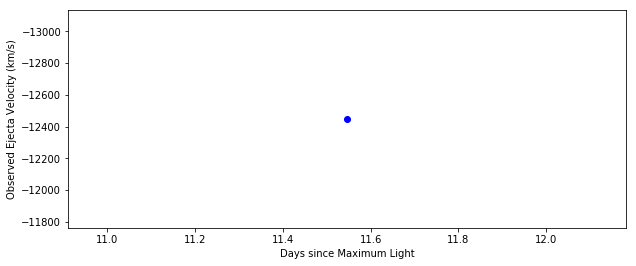

2002kf [u'sn2002kf-20030106-br.flm'] [7.066614343178003] [-14875.754936708861]


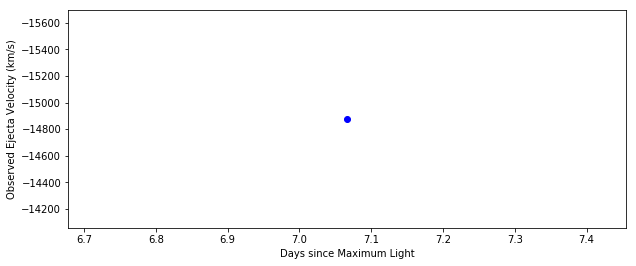

2003cq [u'sn2003cq-20030408-ui.flm'] [-1.3490979721847325] [-16697.27594936709]


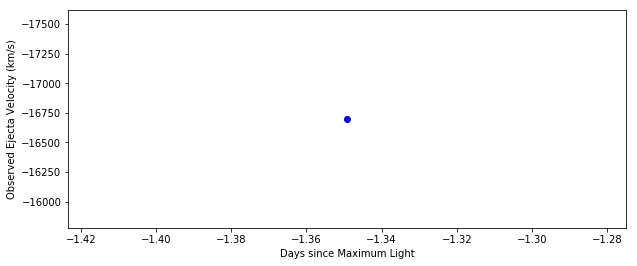

2003d [u'sn2003d-20030107-br.flm'] [5.354614820922365] [-10929.126075949367]


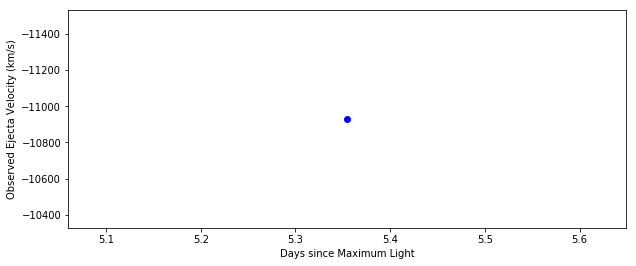

2003iv [u'sn2003iv-20031028-ui.flm'] [6.482601393978524] [-11991.68]


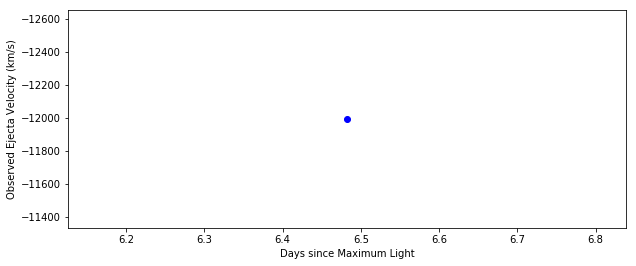

2003u [u'sn2003U-20030204-ui.flm'] [-2.677127528705919] [-17000.862784810128]


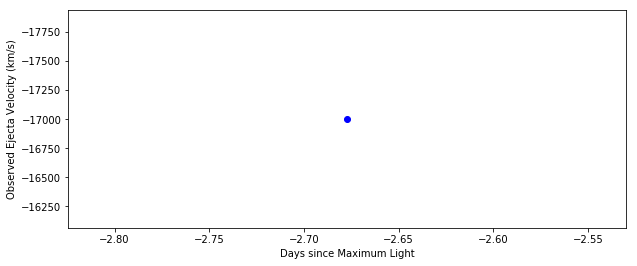

2003w [u'sn2003w-20030228-br.flm'] [17.840914995133208] [-17304.449620253166]


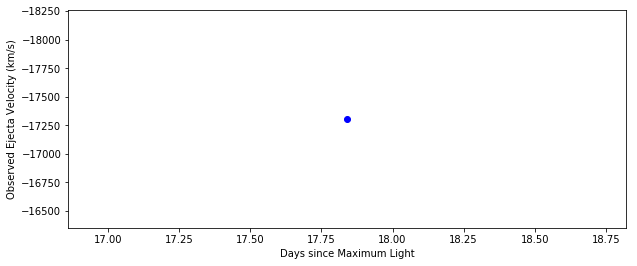

2004as [u'sn2004as-20040316.608-br-corrected.flm'] [-4.991168948062785] [-20036.731139240506]


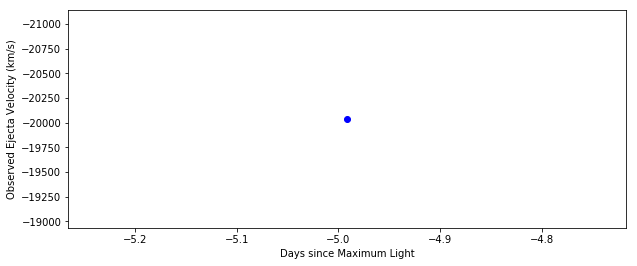

2004bg [u'sn2004bg-20040424.256-ui.flm'] [11.088748181991917] [-12295.266835443039]


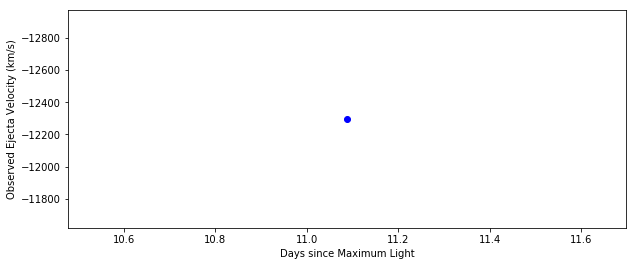

2004eo [u'sn2004eo-20041013.300-ui.flm'] [13.44391705827415] [-12750.647088607595]


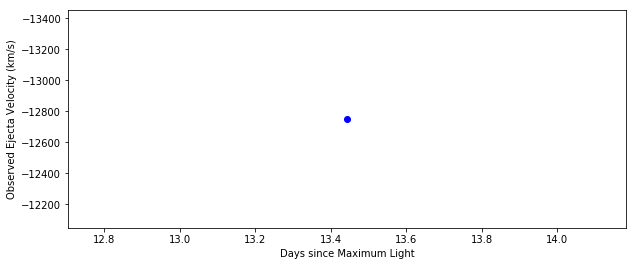

2004ey [u'sn2004ey-20041114-br.flm', u'SN04ey_041025_b01_CLA_LD.dat'] [19.339703441469755, -0.2904155008508899] [-11991.68, -17608.0364556962]


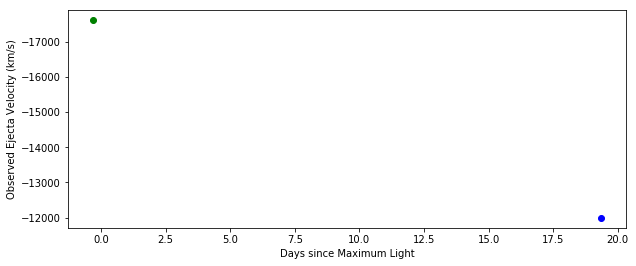

2004gs [u'sn2004gs-20041217.447-ui-corrected.flm', u'sn2004gs-20041213.44-fast.flm', u'sn2004gs-20041215.48-fast.flm', u'sn2004gs-20041216.49-fast.flm', u'sn2004gs-20041218.46-fast.flm', u'sn2004gs-20041219.42-fast.flm', u'sn2004gs-20041220.44-fast.flm', u'SN04gs_041219_b01_CLA_LD.dat'] [1.4161617636340815, -2.4838796019135625, -0.4983332116652493, 0.48470691291295476, 2.4021218093785497, 3.336496581258859, 4.329269776386557, 3.1710343820732705] [-13357.82075949367, -17152.656202531645, -15027.54835443038, -11839.886582278481, -13054.233924050634, -12902.440506329114, -14116.787848101267, -12143.47341772152]


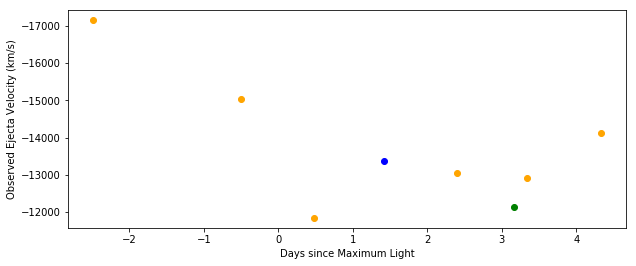

2004s [u'sn2004s-20040213.341-br.flm'] [8.26] [-18215.21012658228]


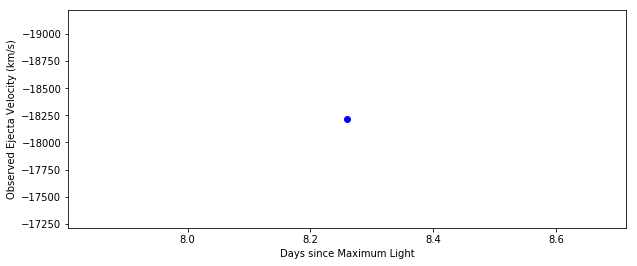

2005ag [u'sn2005ag-20050212.596-br.flm', u'SN05ag_050212_b01_DUP_WF.dat'] [-0.6705783738492764, -0.861378297776925] [-18518.796962025317, -19125.970632911394]


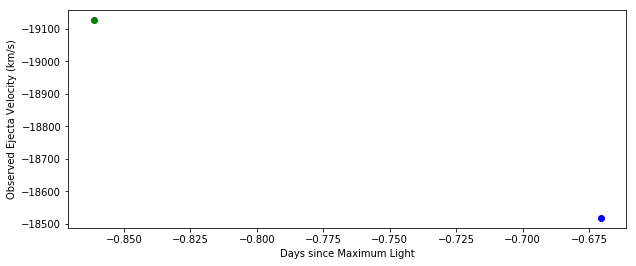

2005el [u'sn2005el-20050926.496-ui-corrected.flm', u'sn2005el-20051004.534-ui-corrected.flm', u'sn2005el-20051011.512-ui-corrected.flm', u'sn2005el-20050927.47-fast.flm', u'sn2005el-20050928.47-fast.flm', u'sn2005el-20050929.48-fast.flm', u'sn2005el-20051005.49-fast.flm', u'sn2005el-20051007.48-fast.flm', u'SN05el_051018_b01_NTT_EM.dat'] [-4.495965159474161, 3.4239489215778196, 10.299435417920149, -3.5362741523878394, -2.550965110206759, -1.5558029776018607, 4.365904365901269, 6.32666935984678, 17.04683173864531] [-18822.383797468356, -17759.829873417722, -11080.919493670886, -18974.177215189873, -18063.41670886076, -18063.41670886076, -17608.0364556962, -17152.656202531645, -11384.506329113925]


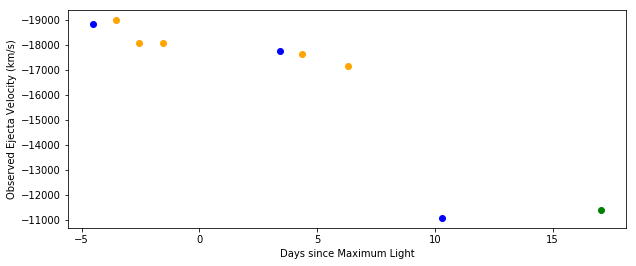

2005eq [u'sn2005eq-20051007.633-br-corrected.flm', u'sn2005eq-20051011.376-ui-corrected.flm', u'sn2005eq-20051007.40-fast.flm', u'sn2005eq-20051009.42-fast.flm', u'sn2005eq-20051011.39-fast.flm', u'sn2005eq-20051012.33-fast.flm', u'sn2005eq-20051025.38-fast.flm', u'sn2005eq-20051028.34-fast.flm', u'SN05eq_051018_b01_NTT_EM.dat'] [-3.6064946058033294, 0.031098848661576788, -3.83293309762596, -1.8698182758206148, 0.04470459495411022, 0.9582332744117932, 13.640732494506736, 16.517375995769765, 6.721238666927599] [-17608.0364556962, -17152.656202531645, -16393.68911392405, -16393.68911392405, -17304.449620253166, -16849.069367088607, -14723.961518987342, -13357.82075949367, -16849.069367088607]


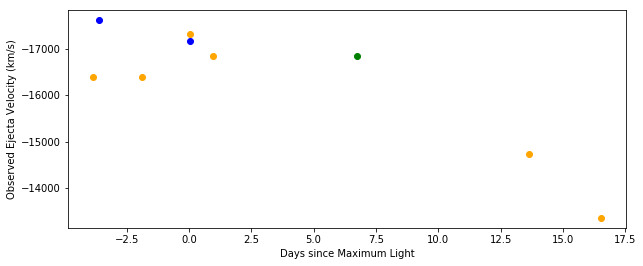

2005kc [u'sn2005kc-20051205.181-br.flm', u'sn2005kc-20051130.11-fast.flm', u'sn2005kc-20051203.17-fast.flm', u'sn2005kc-20051205.09-fast.flm', u'sn2005kc-20051209.08-fast.flm'] [11.979864449523266, 6.984395933489424, 9.99881787375035, 11.890219875482414, 15.820789660340598] [-11080.919493670886, -10473.745822784811, -10929.126075949367, -10170.158987341772, -12902.440506329114]


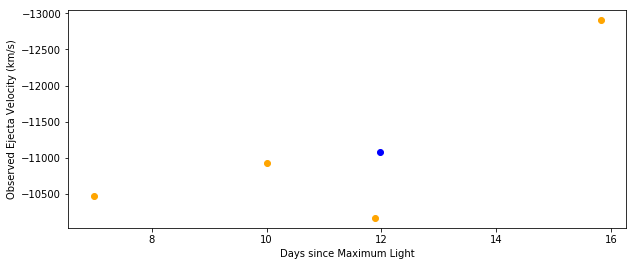

2005ki [u'sn2005ki-20051209.514-ui.flm', u'sn2005ki-20051202.52-fast.flm'] [8.21913507265983, 1.3569373051738791] [-11384.506329113925, -12750.647088607595]


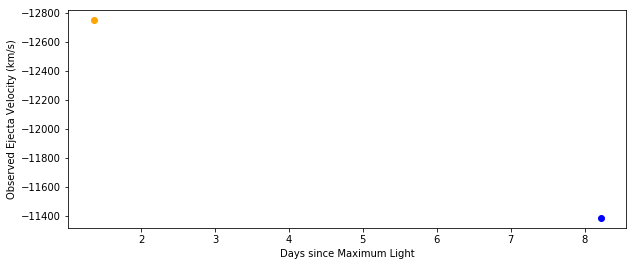

2005mc [u'sn2005mc-20060105.368-ui.flm', u'sn2005mc-20051227.37-fast.flm', u'sn2005mc-20060104.38-fast.flm'] [6.634667062031814, -2.141977193206416, 5.670972404972671] [-17152.656202531645, -17456.243037974684, -11839.886582278481]


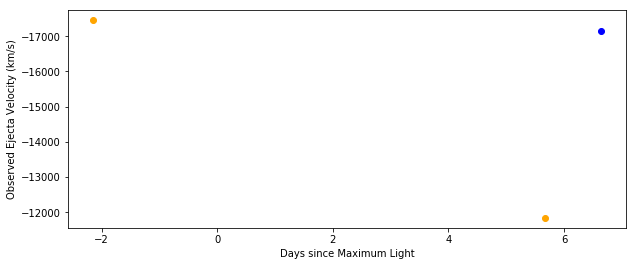

2005ms [u'sn2005ms-20060106.400-ui.flm', u'sn2005ms-20060123.318-ui.flm'] [-1.938150846076478, 14.563930690864312] [-16545.482531645568, -14420.374683544303]


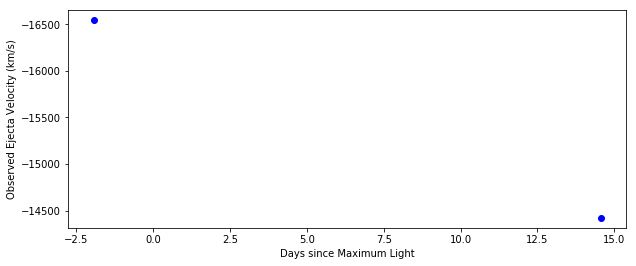

2005na [u'sn2005na-20060105.335-ui.flm', u'sn2005na-20060106.361-ui-corrected.flm', u'sn2005na-20060123.255-ui-corrected.flm', u'sn2005na-20060104.34-fast.flm', u'sn2005na-20060107.32-fast.flm', u'sn2005na-20060109.43-fast.flm', u'sn2005na-20060122.27-fast.flm', u'SN05na_060116_b01_NTT_EM.dat'] [0.45599724063281966, 1.4556834989396872, 17.916404403295466, -0.5134840722520444, 2.390088101006642, 4.445973096164675, 16.956666621195325, 11.032599905240023] [-11384.506329113925, -11384.506329113925, -11536.299746835442, -11384.506329113925, -11688.093164556962, -11080.919493670886, -12295.266835443039, -11839.886582278481]


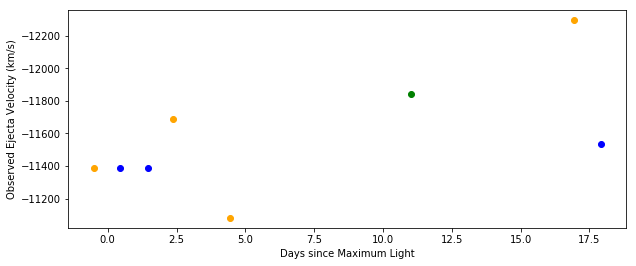

2006ac [u'sn2006ac-20060222.439-ui-corrected.flm', u'sn2006ac-20060221.43-fast.flm', u'sn2006ac-20060222.43-fast.flm', u'sn2006ac-20060224.37-fast.flm', u'sn2006ac-20060225.38-fast.flm', u'sn2006ac-20060226.34-fast.flm', u'sn2006ac-20060228.36-fast.flm', u'sn2006ac-20060302.48-fast.flm', u'sn2006ac-20060304.54-fast.flm', u'sn2006ac-20060305.48-fast.flm'] [7.324754228788392, 6.338541656485821, 7.315957486321634, 9.212144196205388, 10.19933418433444, 11.137653380975967, 13.112033357248293, 15.184154916502779, 17.19763152596228, 18.11640240601022] [-13661.407594936709, -13357.82075949367, -14572.168101265823, -13054.233924050634, -15634.722025316456, -14268.581265822784, -15027.54835443038, -13661.407594936709, -10473.745822784811, -14875.754936708861]


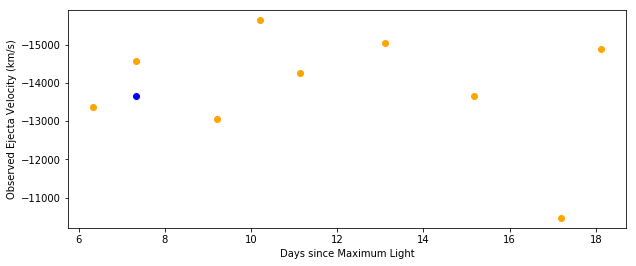

2006ak [u'sn2006ak-20060222.389-ui.flm', u'sn2006ak-20060221.33-fast.flm'] [9.277526249880765, 8.257393314709677] [-18670.590379746835, -18215.21012658228]


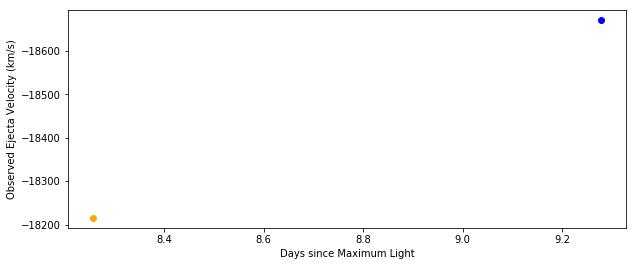

2006bq [u'sn2006bq-20060427.636-br.flm', u'sn2006bq-20060505.375-ui.flm', u'sn2006bq-20060505.473-ui.flm', u'sn2006bq-20060427.35-fast.flm'] [7.205170735046364, 14.874181063794666, 14.874181063794666, 6.925301275556433] [-17759.829873417722, -17000.862784810128, -16241.895696202531, -17000.862784810128]


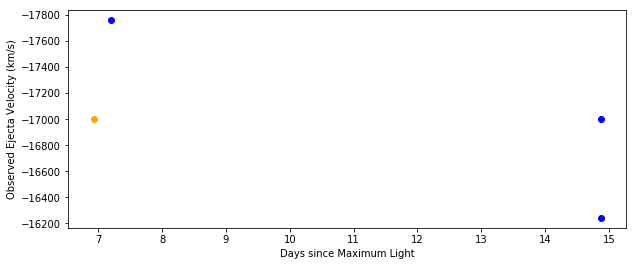

2006bt [u'sn2006bt-20060428.425-ui.flm', u'sn2006bt-20060505.444-ui.flm', u'sn2006bt-20060429.41-fast.flm', u'sn2006bt-20060501.39-fast.flm', u'sn2006bt-20060504.35-fast.flm', u'sn2006bt-20060505.27-fast.flm', u'sn2006bt-20060507.30-fast.flm', u'sn2006bt-20060508.31-fast.flm', u'sn2006bt-20060519.28-fast.flm'] [-2.9675746689402036, 3.8327539635535595, -2.013261561231115, -0.09494688787173387, 2.772836664226134, 3.6641747952821504, 5.630931758382798, 6.609466010951945, 17.237704378021615] [-17608.0364556962, -18063.41670886076, -19429.55746835443, -15786.515443037975, -17911.62329113924, -18215.21012658228, -17759.829873417722, -17152.656202531645, -15938.308860759495]


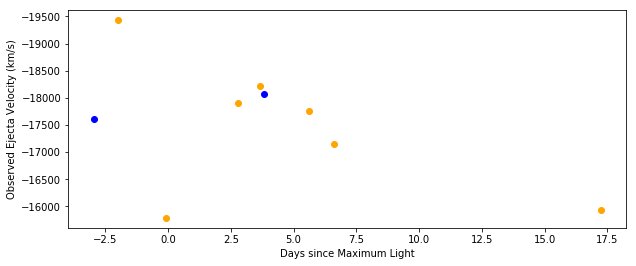

2006bu [u'sn2006bu-20060505.325-ui.flm', u'sn2006bu-20060505.19-fast.flm'] [6.940950150122673, 6.835337650326413] [-17759.829873417722, -16545.482531645568]


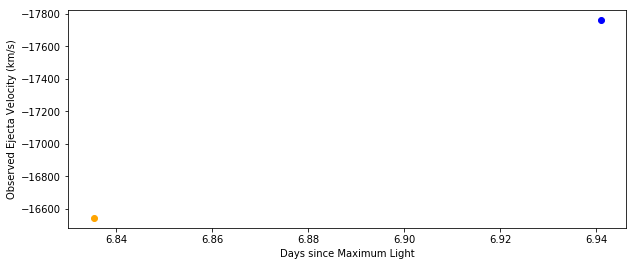

2006bw [u'sn2006bw-20060505.353-ui.flm', u'sn2006bw-20060502.31-fast.flm'] [11.78444313700972, 8.830079941593477] [-11080.919493670886, -13357.82075949367]


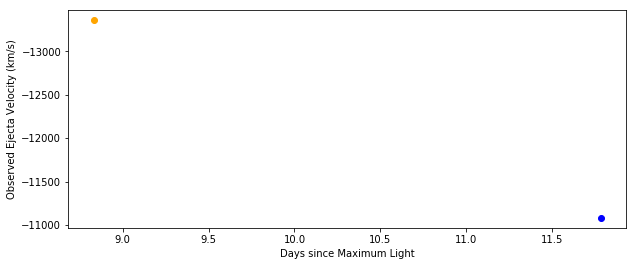

2006bz [u'sn2006bz-20060505.218-ui.flm', u'sn2006bz-20060506.16-fast.flm', u'sn2006bz-20060507.22-fast.flm', u'sn2006bz-20060508.23-fast.flm'] [12.076006950052307, 12.99243316023372, 14.023655859583341, 15.0062359787791] [-11384.506329113925, -16241.895696202531, -12598.853670886076, -15482.928607594937]


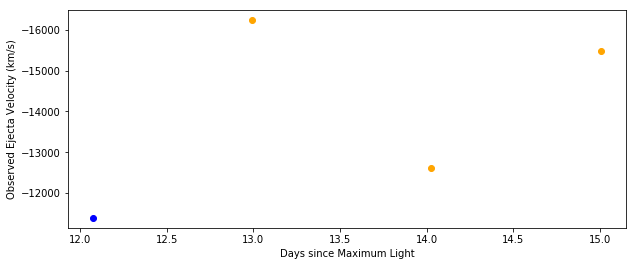

2006cc [u'sn2006cc-20060605.406-ui.flm'] [17.70119773875781] [-11536.299746835442]


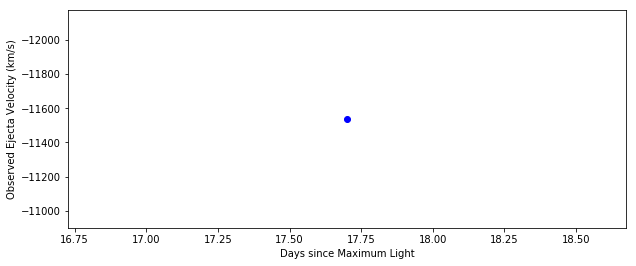

2006cf [u'sn2006cf-20060523.291-ui.flm', u'sn2006cf-20060528.299-ui.flm', u'sn2006cf-20060605.221-ui.flm', u'sn2006cf-20060519.25-fast.flm', u'sn2006cf-20060520.16-fast.flm', u'sn2006cf-20060521.27-fast.flm', u'sn2006cf-20060522.26-fast.flm', u'sn2006cf-20060524.21-fast.flm', u'sn2006cf-20060604.22-fast.flm'] [5.503325806101215, 10.311535093781167, 17.917492357555478, 1.6235387191411412, 2.497234895619601, 3.562952209775117, 4.513456841329988, 6.385662933773849, 16.956426563436157] [-16849.069367088607, -11688.093164556962, -8804.0182278481, -16849.069367088607, -17000.862784810128, -16241.895696202531, -10321.952405063292, -10321.952405063292, -11536.299746835442]


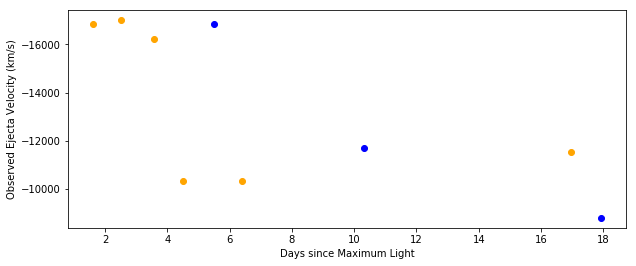

2006cj [u'sn2006cj-20060528.349-ui.flm', u'sn2006cj-20060521.29-fast.flm', u'sn2006cj-20060522.29-fast.flm', u'sn2006cj-20060523.33-fast.flm', u'sn2006cj-20060528.19-fast.flm', u'sn2006cj-20060601.28-fast.flm', u'sn2006cj-20060602.21-fast.flm', u'sn2006cj-20060604.27-fast.flm'] [3.645843579071645, -2.9666974858492, -2.0299442538163612, -1.055720892501391, 3.4968998151787507, 7.32822053418979, 8.199401039980602, 10.12911269796607] [-11232.712911392406, -18518.796962025317, -13964.994430379747, -13661.407594936709, -11839.886582278481, -11232.712911392406, -11839.886582278481, -11536.299746835442]


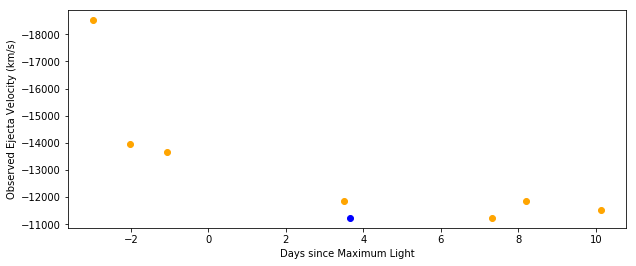

2006cq [u'sn2006cq-20060605.307-ui.flm', u'sn2006cq-20060531.27-fast.flm'] [1.4594543548485226, -3.345298315336637] [-17304.449620253166, -20036.731139240506]


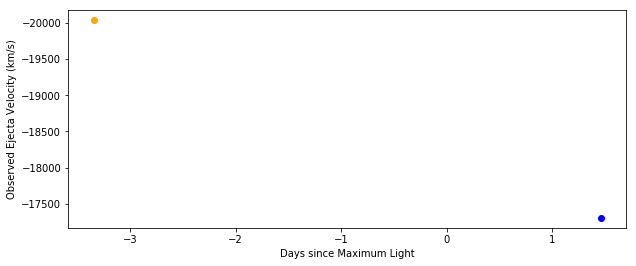

2006cs [u'sn2006cs-20060605.335-ui.flm'] [1.8120967962479588] [-13054.233924050634]


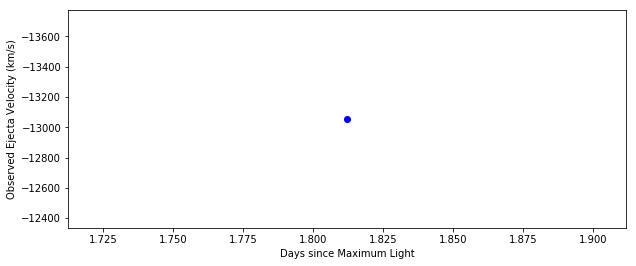

2006ef [u'sn2006ef-20060824.454-ui-corrected.flm'] [6.263864301275138] [-18822.383797468356]


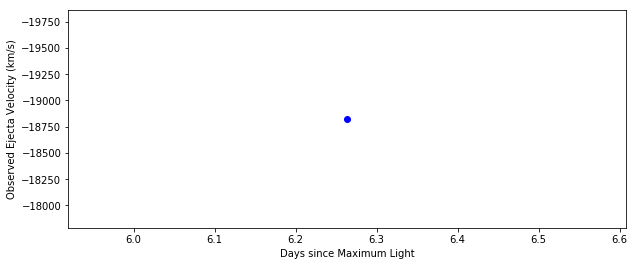

2006ej [u'sn2006ej-20060824.430-ui.flm', u'sn2006ej-20060902.398-ui.flm'] [-0.175412464277055, 8.612849991968567] [-12902.440506329114, -12750.647088607595]


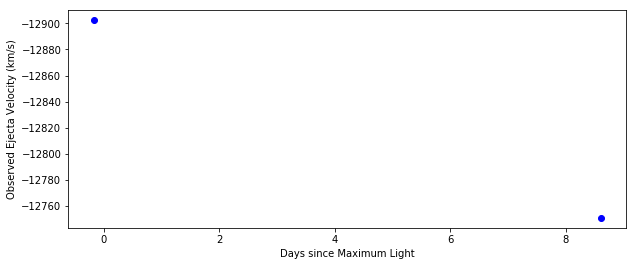

2006em [u'sn2006em-20060902.440-ui.flm', u'sn2006em-20060902.41-fast.flm'] [6.031005667991992, 6.001571770150345] [-13206.027341772153, -14572.168101265823]


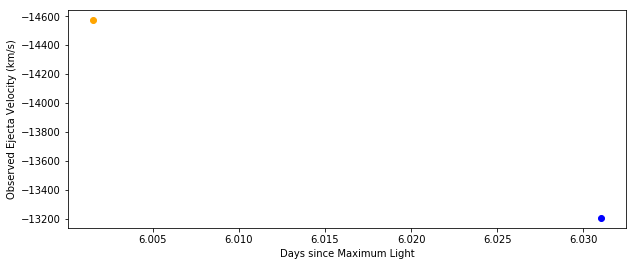

2006en [u'sn2006en-20060902.319-ui-corrected.flm'] [8.822226895200817] [-10625.539240506328]


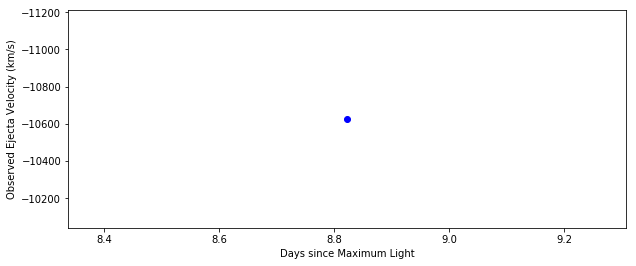

2006et [u'sn2006et-20060919.345-ui.flm', u'sn2006et-20060925.321-ui.flm', u'sn2006et-20060918.36-fast.flm', u'sn2006et-20060922.37-fast.flm', u'SN06et_061005_b01_NTT_EM.dat'] [4.50109960602206, 10.344803982642144, 3.537905360544837, 7.459132694923867, 19.90731822284771] [-16545.482531645568, -15482.928607594937, -15938.308860759495, -15786.515443037975, -12750.647088607595]


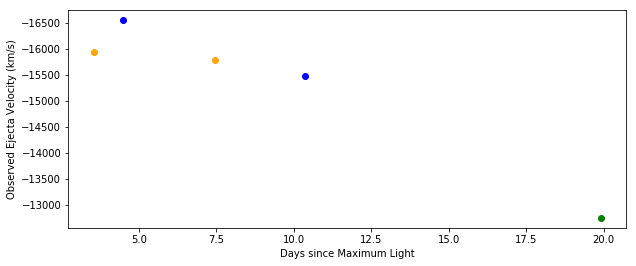

2006gj [u'sn2006gj-20060925.482-ui.flm', u'sn2006gj-20060920.43-fast.flm', u'sn2006gj-20060924.46-fast.flm', u'SN06gj_061005_b01_NTT_EM.dat'] [3.5077550853731467, -1.4052415021785707, 2.513874936422914, 13.026442852395794] [-10929.126075949367, -12295.266835443039, -11688.093164556962, -13357.82075949367]


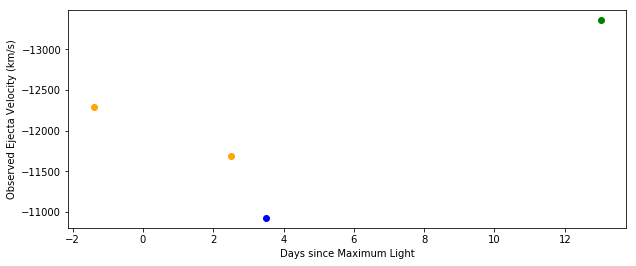

2006gr [u'sn2006gr-20061024.150-ui.flm', u'sn2006gr-20060929.13-fast.flm', u'sn2006gr-20060930.30-fast.flm', u'sn2006gr-20061002.26-fast.flm', u'sn2006gr-20061003.26-fast.flm', u'sn2006gr-20061014.14-fast.flm', u'sn2006gr-20061017.24-fast.flm', u'sn2006gr-20061023.18-fast.flm'] [19.574771626053824, -4.608557728278418, -3.4776826145814623, -1.5832251591672994, -0.616665232935153, 9.899506764468068, 12.895842535786317, 18.637208497607517] [-14268.581265822784, -21402.871898734178, -21554.665316455696, -20947.491645569622, -20492.111392405062, -17000.862784810128, -13206.027341772153, -17304.449620253166]


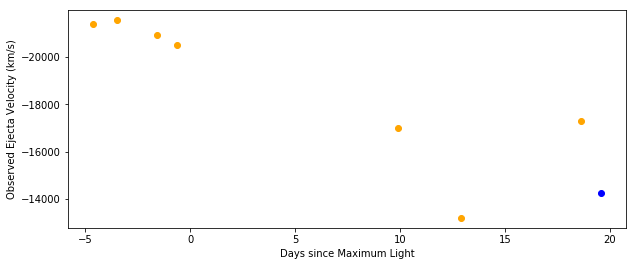

2006gt [u'sn2006gt-20060925.348-ui.flm', u'sn2006gt-20060925.36-fast.flm', u'sn2006gt-20060926.38-fast.flm', u'sn2006gt-20060927.37-fast.flm'] [0.49005954414428504, 0.5015453147126151, 1.477835812818706, 2.4254118845179002] [-11384.506329113925, -11839.886582278481, -14268.581265822784, -12902.440506329114]


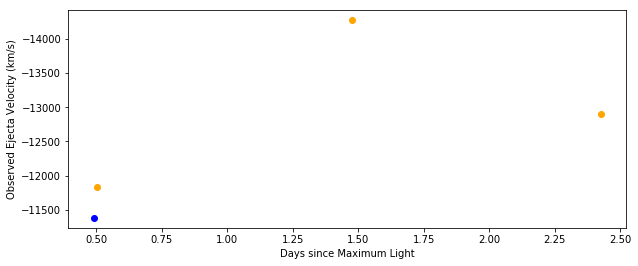

2006kf [u'sn2006kf-20061030.385-ui.flm', u'sn2006kf-20061120.241-ui.flm', u'SN06kf_061103_b01_NTT_EM.dat'] [-2.1012414557516736, 18.3197705671483, 1.643981548985137] [-17456.243037974684, -10018.365569620253, -17000.862784810128]


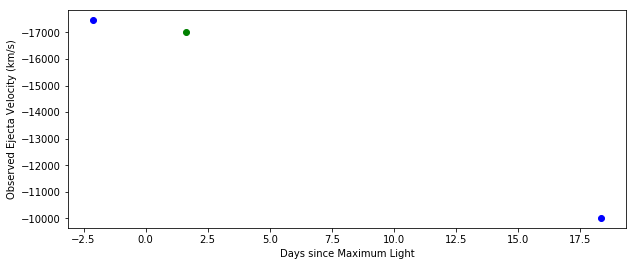

2006le [u'sn2006le-20061120.427-ui-corrected.flm', u'sn2006le-20061112.40-fast.flm', u'sn2006le-20061114.38-fast.flm', u'sn2006le-20061115.44-fast.flm', u'sn2006le-20061116.42-fast.flm', u'sn2006le-20061117.44-fast.flm', u'sn2006le-20061119.40-fast.flm', u'sn2006le-20061121.37-fast.flm', u'sn2006le-20061122.38-fast.flm', u'sn2006le-20061123.36-fast.flm', u'sn2006le-20061125.36-fast.flm'] [12.310405019698079, 4.4209342737397614, 6.367010276849479, 7.40884894518795, 8.372058280058413, 9.374582281666457, 11.301000951414535, 13.23724828784701, 14.229943622763507, 15.193152957641122, 17.15888629411963] [-17911.62329113924, -17911.62329113924, -18215.21012658228, -18822.383797468356, -17759.829873417722, -17000.862784810128, -12295.266835443039, -12143.47341772152, -13054.233924050634, -13054.233924050634, -11232.712911392406]


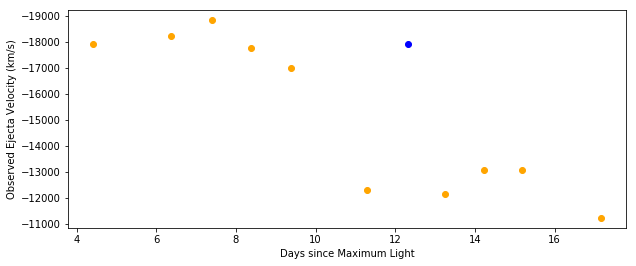

2006lf [u'sn2006lf-20061120.276-ui-corrected.flm'] [14.263634443536159] [-9866.572151898734]


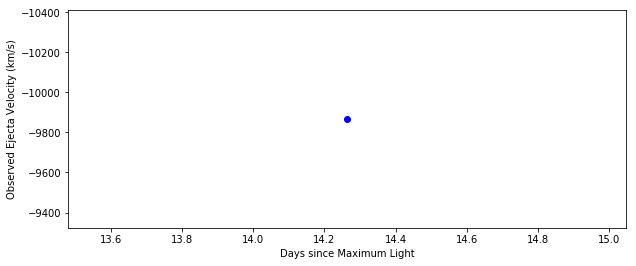

2006mo [u'sn2006mo-20061120.174-ui.flm', u'sn2006mo-20061113.21-fast.flm'] [13.144622671895737, 6.429110069220002] [-11080.919493670886, -11232.712911392406]


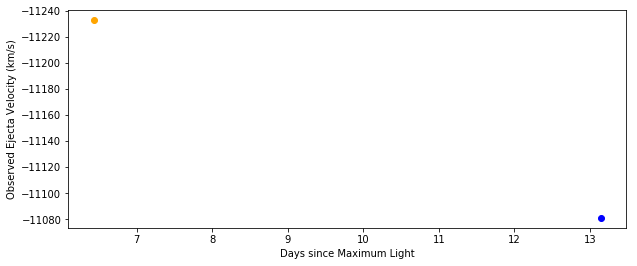

2006mp [u'sn2006mp-20061120.101-ui.flm'] [5.5598903124857095] [-16697.27594936709]


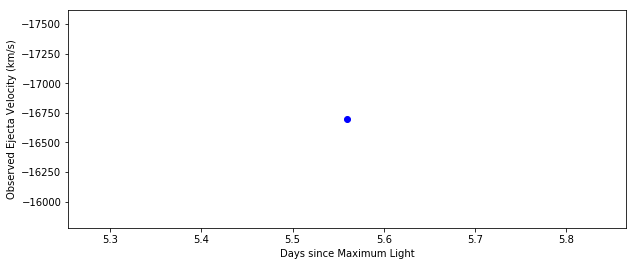

2006n [u'sn2006n-20060123.286-ui.flm', u'sn2006n-20060124.285-ui.flm', u'sn2006n-20060206.285-ui.flm', u'sn2006N-20060122.23-fast.flm', u'sn2006N-20060124.26-fast.flm', u'sn2006N-20060126.32-fast.flm', u'sn2006N-20060127.24-fast.flm', u'sn2006N-20060128.22-fast.flm', u'sn2006N-20060130.22-fast.flm', u'sn2006N-20060131.22-fast.flm', u'sn2006N-20060201.21-fast.flm', u'sn2006N-20060202.20-fast.flm', u'sn2006N-20060203.21-fast.flm', u'sn2006N-20060206.32-fast.flm'] [-1.4433926826694696, -0.4584546430575745, 12.358556883379482, -2.4845283881984885, -0.4831027421483112, 1.5479006228078807, 2.4549506692924736, 3.42115615359627, 5.3930040807404325, 6.378928044312514, 7.354992768246865, 8.331057492181218, 9.326840695391029, 12.393064222100776] [-18670.590379746835, -17759.829873417722, -11232.712911392406, -18974.177215189873, -18367.003544303796, -11688.093164556962, -11991.68, -11991.68, -11536.299746835442, -11536.299746835442, -11688.093164556962, -11384.506329113925, -11384.506329113925, -

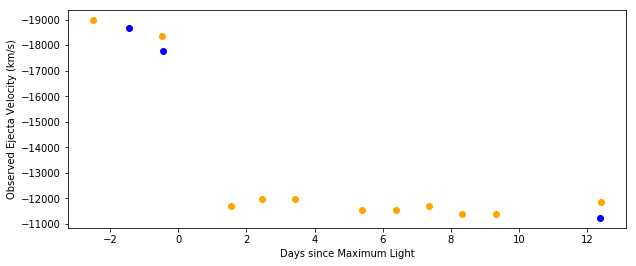

2006or [u'sn2006or-20061201.530-ui.flm'] [2.0107481491419636] [-16393.68911392405]


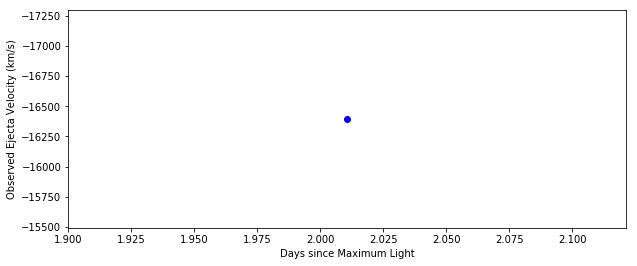

2006os [u'sn2006os-20061201.142-ui.flm', u'SN06os_061213_b01_DUP_BC.dat'] [7.217210539410388, 18.82439056968551] [-15482.928607594937, -9259.398481012659]


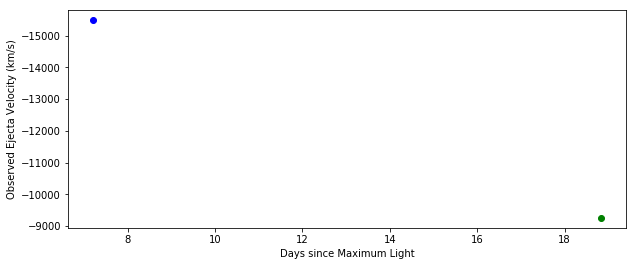

2006s [u'sn2006s-20060130.375-ui.flm', u'sn2006s-20060206.517-ui.flm', u'sn2006s-20060222.476-ui.flm', u'sn2006S-20060129.51-fast.flm', u'sn2006S-20060131.49-fast.flm', u'sn2006S-20060202.47-fast.flm', u'sn2006S-20060203.47-fast.flm', u'sn2006S-20060204.47-fast.flm', u'sn2006S-20060206.48-fast.flm', u'sn2006S-20060207.43-mmt.flm'] [-4.087774270369907, 2.832084425766545, 18.2947034304798, -4.925869729925226, -3.0074546895552565, -1.0890396491782384, -0.1201431641409069, 0.8487533208964246, 2.7962352558234347, 3.71668691660608] [-18974.177215189873, -18518.796962025317, -15634.722025316456, -19125.970632911394, -18367.003544303796, -19125.970632911394, -17759.829873417722, -18367.003544303796, -18518.796962025317, -17911.62329113924]


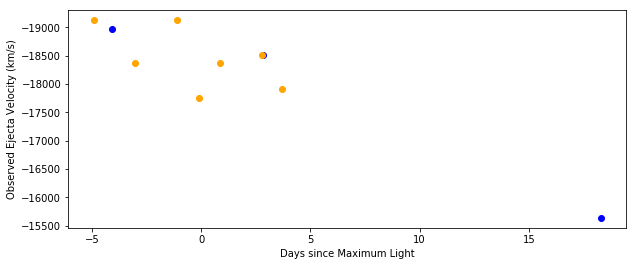

2006sr [u'sn2006sr-20061220.097-ui.flm', u'sn2006sr-20061225.242-br.flm', u'sn2006sr-20061222.12-fast.flm', u'sn2006sr-20061224.09-fast.flm', u'sn2006sr-20061225.12-fast.flm', u'sn2006sr-20061226.13-fast.flm', u'sn2006sr-20061227.09-fast.flm', u'sn2006sr-20070110.12-fast.flm'] [-2.5484797000415784, 2.475247524748781, -0.5731638252578107, 1.350401312315068, 2.35612318628358, 3.342316480164066, 4.279688323856459, 17.978987247837665] [-19581.35088607595, -15179.341772151898, -19277.76405063291, -13206.027341772153, -15786.515443037975, -14268.581265822784, -13964.994430379747, -10777.332658227848]


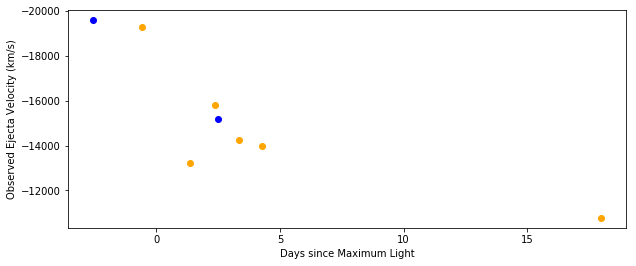

2007al [u'sn2007al-20070313.289-ui.flm', u'sn2007al-20070312.31-fast.flm', u'sn2007al-20070313.23-fast.flm', u'sn2007al-20070314.26-fast.flm', u'sn2007al-20070315.23-fast.flm', u'sn2007al-20070318.25-fast.flm', u'sn2007al-20070320.24-fast.flm'] [3.759231358214035, 2.7920073109896326, 3.7009410428102463, 4.718551633863014, 5.676883938060573, 8.660557709885405, 10.626620890657467] [-10777.332658227848, -11688.093164556962, -8652.224810126583, -11080.919493670886, -10473.745822784811, -11688.093164556962, -22161.838987341773]


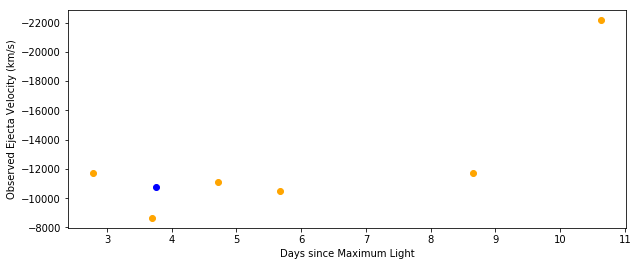

2007au [u'sn2007au-20070410.192-ui-corrected.flm', u'sn2007au-20070320.20-fast.flm', u'sn2007au-20070321.14-fast.flm', u'sn2007au-20070326.15-fast.flm'] [16.08784774207874, -4.480767874083817, -3.559726587915968, 1.3492275011174069] [-16849.069367088607, -16849.069367088607, -15786.515443037975, -12143.47341772152]


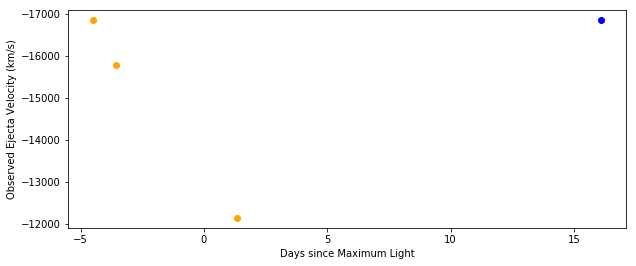

2007ba [u'sn2007ba-20070410.475-ui.flm', u'sn2007ba-20070409.43-fast.flm', u'sn2007ba-20070411.50-fast.flm', u'sn2007ba-20070412.47-fast.flm', u'SN07ba_070409_b01_BAA_IM.dat'] [3.5570089156282756, 2.550762484434584, 4.543997041921789, 5.478024829731054, 2.3678085880685553] [-13357.82075949367, -15482.928607594937, -13206.027341772153, -15027.54835443038, -12447.060253164556]


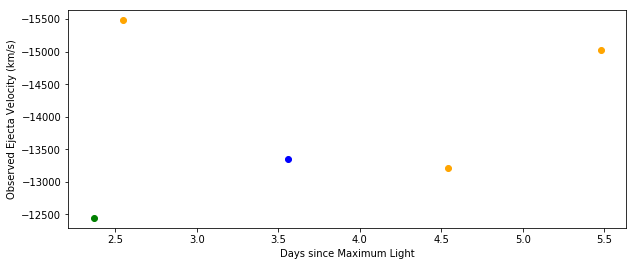

2007bc [u'sn2007bc-20070410.323-ui-corrected.flm', u'sn2007bc-20070407.24-fast.flm', u'sn2007bc-20070414.27-fast.flm', u'sn2007bc-20070416.21-fast.flm', u'sn2007bc-20070417.36-fast.flm', u'SN07bc_070409_b01_BAA_IM.dat'] [1.3764105271033158, -1.643808777429353, 5.242946708462924, 7.143416927900941, 8.26998432602149, 0.19788982837849114] [-12902.440506329114, -17152.656202531645, -11232.712911392406, -11991.68, -10777.332658227848, -12447.060253164556]


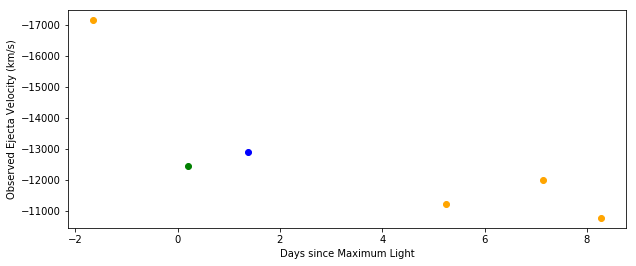

2007bd [u'sn2007bd-20070426.226-ui.flm', u'sn2007bd-20070412.18-fast.flm', u'sn2007bd-20070415.20-fast.flm', u'sn2007bd-20070418.22-fast.flm', u'sn2007bd-20070425.17-fast.flm', u'SN07bd_070430_b01_DUP_BC.dat'] [9.555653850782404, -4.069228291952055, -1.1397719292147412, 1.7896844335296305, 8.531314142482408, 13.22620447195723] [-13813.201012658228, -19277.76405063291, -18518.796962025317, -15179.341772151898, -13964.994430379747, -13357.82075949367]


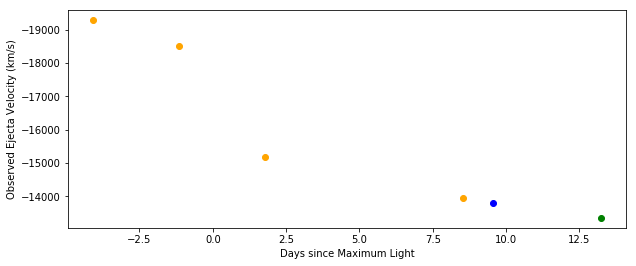

2007bz [u'sn2007bz-20070426.419-ui.flm', u'sn2007bz-20070512.31-fast.flm'] [0.9493255873596457, 16.501627555102132] [-14420.374683544303, -11536.299746835442]


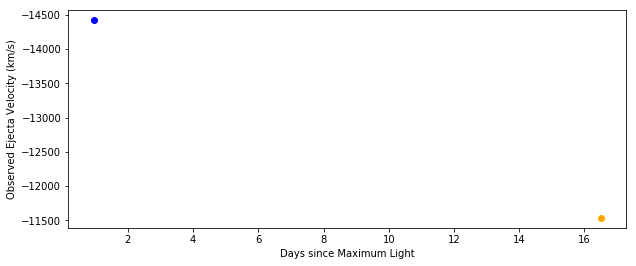

2007ca [u'sn2007ca-20070524.291-ui-corrected.flm', u'sn2007ca-20070510.23-fast.flm', u'sn2007ca-20070512.27-fast.flm', u'sn2007ca-20070513.21-fast.flm', u'sn2007ca-20070516.26-fast.flm', u'sn2007ca-20070518.32-fast.flm', u'sn2007ca-20070520.22-fast.flm', u'SN07ca_070508_b01_BAA_IM.dat', u'SN07ca_070511_b01_DUP_BC.dat'] [17.34009423449291, 3.474132847369942, 5.485836227616985, 6.412797589108573, 9.420491368411804, 11.45191733082221, 13.325562635961576, 1.5215972135914688, 4.322203880071746] [-12902.440506329114, -13661.407594936709, -13054.233924050634, -15179.341772151898, -13054.233924050634, -12902.440506329114, -12295.266835443039, -17152.656202531645, -13661.407594936709]


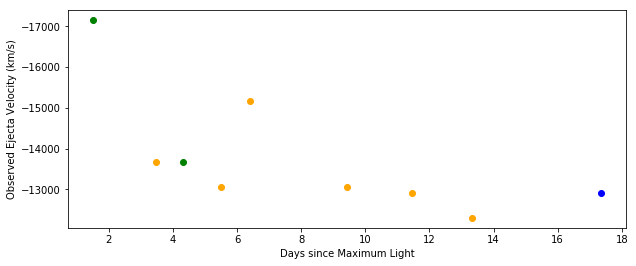

2007ci [u'sn2007ci-20070524.264-ui-corrected.flm', u'sn2007ci-20070521.19-fast.flm', u'sn2007ci-20070522.19-fast.flm', u'sn2007ci-20070524.19-fast.flm', u'sn2007ci-20070525.19-fast.flm', u'sn2007ci-20070608.18-fast.flm', u'sn2007ci-20070612.19-fast.flm', u'sn2007ci-20070614.18-fast.flm'] [-1.8858176689312065, -4.905090332629534, -3.922893630060304, -1.9585002249218442, -0.9763035223526141, 12.764628346588914, 16.703237123893526, 18.657808562004295] [-12598.853670886076, -12750.647088607595, -13357.82075949367, -12447.060253164556, -11991.68, -12295.266835443039, -15027.54835443038, -11536.299746835442]


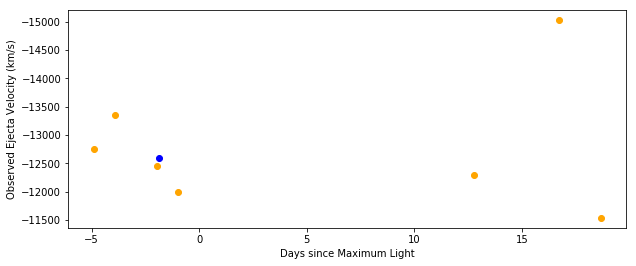

2007co [u'sn2007co-20070609.398-ui-corrected.flm', u'sn2007co-20070614.468-ui-corrected.flm', u'sn2007co-20070623.408-ui-corrected.flm', u'sn2007co-20070609.33-fast.flm', u'sn2007co-20070610.39-fast.flm', u'sn2007co-20070612.35-fast.flm', u'sn2007co-20070613.39-fast.flm', u'sn2007co-20070614.38-fast.flm', u'sn2007co-20070615.36-fast.flm', u'sn2007co-20070616.35-fast.flm', u'sn2007co-20070617.34-fast.flm', u'sn2007co-20070619.45-fast.flm', u'sn2007co-20070620.34-fast.flm', u'sn2007co-20070621.33-fast.flm', u'sn2007co-20070622.38-fast.flm', u'sn2007co-20070624.36-fast.flm', u'sn2007co-20070625.40-fast.flm'] [-4.112128783731178, 0.8247627468217633, 9.530050771113148, -4.17834350248348, -3.1461728866304375, -1.23763099316298, -0.22493529458710954, 0.7390731107852049, 1.693344057522476, 2.6573524628947904, 3.621360868267105, 5.675964641338146, 6.542598460310433, 7.506606865689832, 8.529040022900746, 10.45705683365246, 11.46975253222833] [-20947.491645569622, -18518.796962025317, -16090.1022

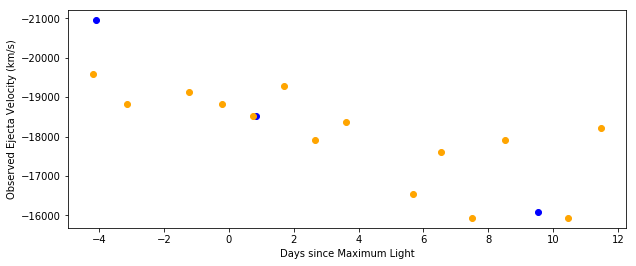

2007cq [u'sn2007cq-20070707.439-ui.flm', u'sn2007cq-20070715.374-ui-corrected.flm', u'sn2007cq-20070625.45-fast.flm'] [7.628414513389168, 15.363077069455304, -4.0567140908209565] [-13206.027341772153, -12295.266835443039, -12143.47341772152]


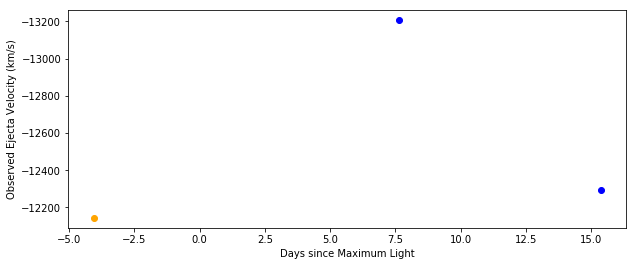

2007f [u'sn2007f-20070126.534-ui.flm', u'sn2007F-20070121.55-fast.flm', u'sn2007F-20070122.49-fast.flm', u'sn2007F-20070126.43-fast.flm', u'sn2007F-20070210.39-fast.flm'] [3.154580296230975, -1.714552003678599, -0.796216457552214, 3.0529772145319765, 17.6681897359386] [-12143.47341772152, -11688.093164556962, -11991.68, -12750.647088607595, -12598.853670886076]


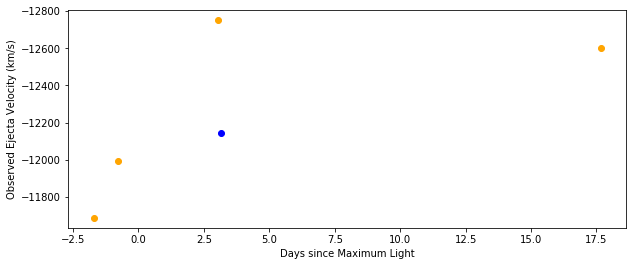

2007qe [u'sn2007qe-20071201.176-ui.flm', u'sn2007qe-20071211.187-ui.flm', u'sn2007qe-20071203.12-fast.flm', u'sn2007qe-20071204.14-fast.flm', u'sn2007qe-20071206.15-fast.flm', u'sn2007qe-20071214.07-mmt.flm', u'sn2007qe-20071214.11-fast.flm'] [6.185294117648143, 15.999999999999714, 8.091176470592401, 9.091176470589263, 11.061764705885377, 18.826470588236607, 18.865686274511972] [-16241.895696202531, -15938.308860759495, -15179.341772151898, -15786.515443037975, -15786.515443037975, -13813.201012658228, -15179.341772151898]


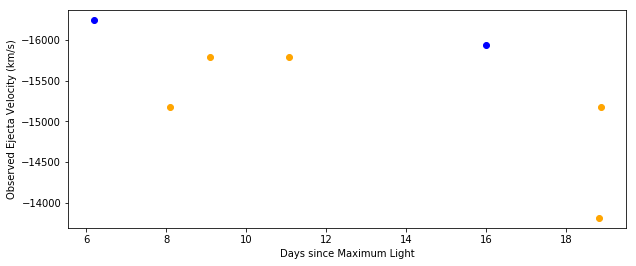

2007s [u'sn2007s-20070218.375-ui.flm', u'sn2007S-20070208.34-fast.flm', u'sn2007S-20070209.30-fast.flm', u'sn2007S-20070210.32-fast.flm', u'sn2007S-20070212.33-fast.flm', u'sn2007S-20070219.32-fast.flm', u'sn2007S-20070221.32-fast.flm', u'sn2007S-20070225.30-fast.flm', u'sn2007S-20070226.30-fast.flm'] [6.476114113587971, -3.4214419568050087, -2.4746030180473375, -1.4685866456271792, 0.5138573823854821, 7.408028405166784, 9.380609527565444, 13.306045961141931, 14.29233652234126] [-17456.243037974684, -18518.796962025317, -18063.41670886076, -17608.0364556962, -17759.829873417722, -15634.722025316456, -16090.102278481012, -14875.754936708861, -15786.515443037975]


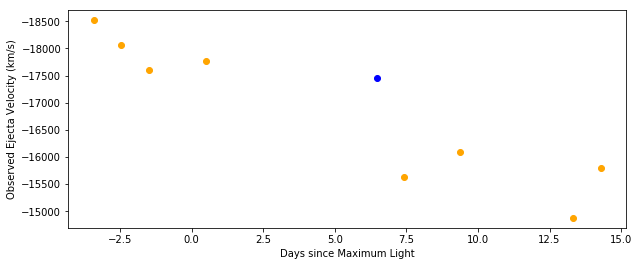

1993ac [u'sn1993ac-19931016.49-mmt.flm', u'sn1993ac-19931020.52-mmt.flm'] [6.749285033359839, 10.591039084836327] [-16697.27594936709, -21402.871898734178]


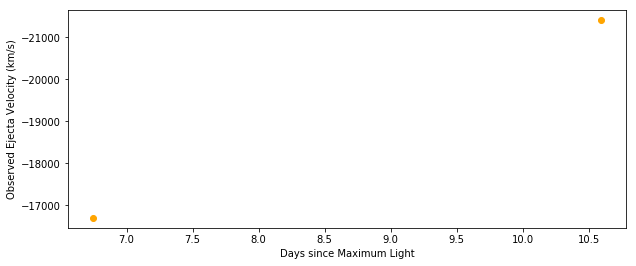

1994m [u'sn1994M-19940514.29-mmt.flm', u'sn1994M-19940515.27-mmt.flm'] [12.736512900702934, 13.694292415945238] [-17000.862784810128, -18215.21012658228]


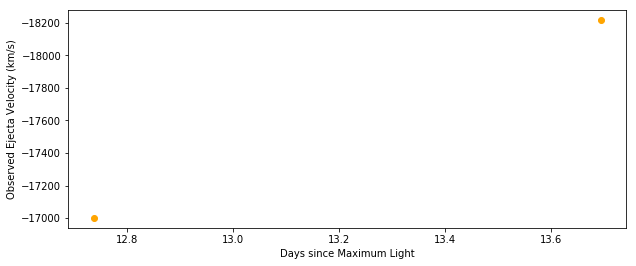

1995ac [u'sn1995ac-19950927.31-fast.flm'] [-4.987357805068296] [-19884.93772151899]


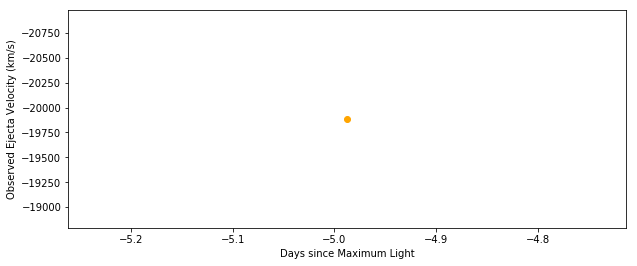

1995e [u'sn1995E-19950224.27-fast.flm', u'sn1995E-19950226.27-fast.flm', u'sn1995E-19950228.23-fast.flm', u'sn1995E-19950303.16-fast.flm', u'sn1995E-19950305.17-fast.flm', u'sn1995E-19950308.16-mmt.flm'] [-2.2203000271917173, -0.24318513210237608, 1.6943874650915078, 4.5908607863976805, 6.5778612559572895, 9.533648024121034] [-16545.482531645568, -12295.266835443039, -12447.060253164556, -12295.266835443039, -12295.266835443039, -11688.093164556962]


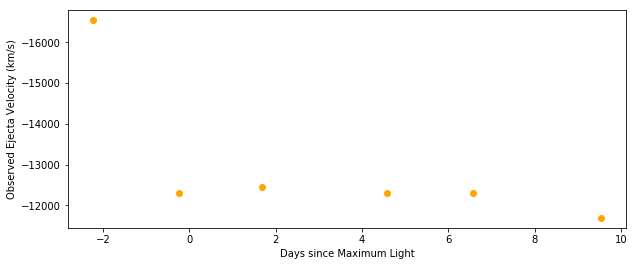

1996ab [u'sn1996ab-19960522.37-fast.flm'] [-0.19469026548131702] [-14268.581265822784]


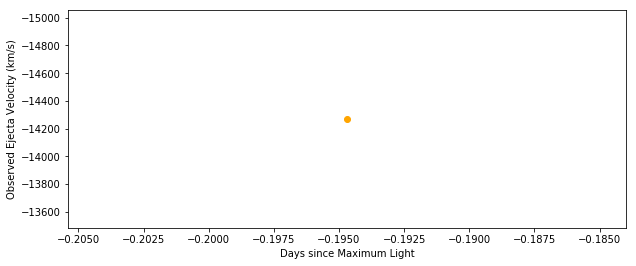

1996bl [u'sn1996bl-19961016.29-fast.flm', u'sn1996bl-19961018.18-fast.flm', u'sn1996bl-19961103.25-fast.flm', u'sn1996bl-19961108.24-fast.flm'] [-3.913127413123986, -2.088803088800223, 13.422779922782507, 18.239382239382856] [-18367.003544303796, -18063.41670886076, -16393.68911392405, -10473.745822784811]


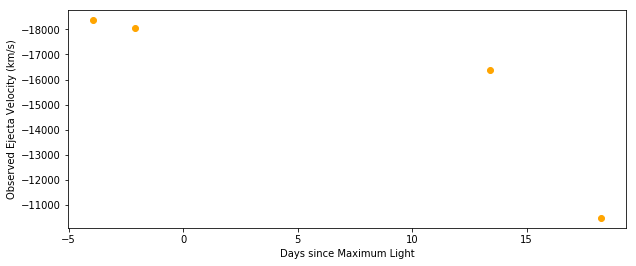

1996c [u'sn1996C-19960223.44-mmt.flm'] [7.666991236614835] [-11384.506329113925]


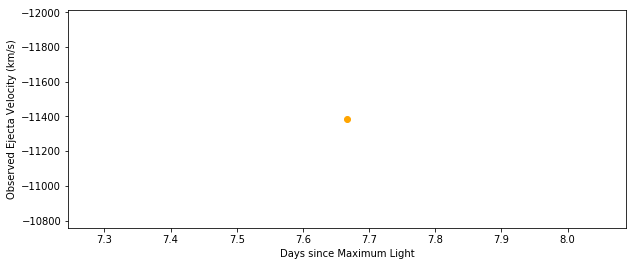

1998ab [u'sn1998ab-19980419.29-fast.flm'] [7.83540966497247] [-16241.895696202531]


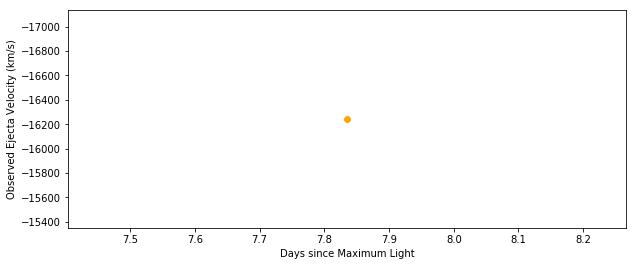

1998dx [u'sn1998dx-19980914.18-fast.flm', u'sn1998dx-19980915.22-fast.flm', u'sn1998dx-19980917.13-fast.flm', u'sn1998dx-19980918.15-fast.flm', u'sn1998dx-19980922.12-fast.flm', u'sn1998dx-19980924.16-fast.flm', u'sn1998dx-19980929.13-fast.flm'] [-1.971118092550861, -0.9846104812643856, 0.8271486894585504, 1.7946850005310306, 5.560488093612922, 7.495560715750981, 12.209928819677554] [-18670.590379746835, -18215.21012658228, -16393.68911392405, -12447.060253164556, -13509.61417721519, -14875.754936708861, -11991.68]


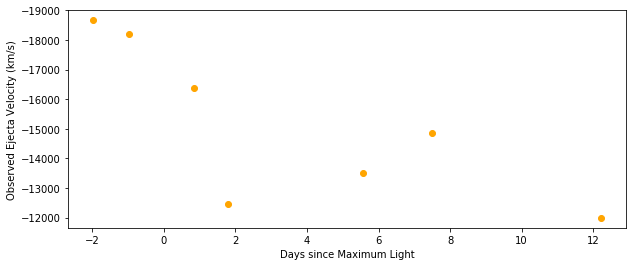

1999aa [u'sn1999aa-19990218.25-fast.flm', u'sn1999aa-19990219.28-fast.flm', u'sn1999aa-19990220.29-fast.flm'] [-4.455647089089085, -3.4403115798501864, -2.444691323214735] [-20492.111392405062, -20492.111392405062, -18215.21012658228]


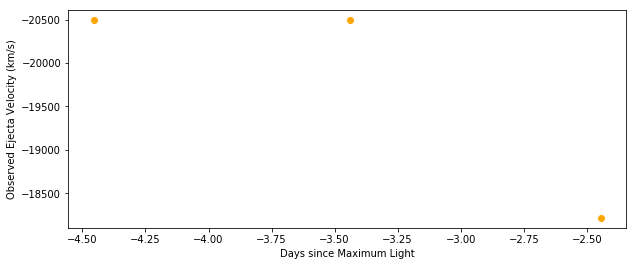

1999ef [u'sn1999ef-19991013.29-fast.flm', u'sn1999ef-19991014.31-fast.flm', u'sn1999ef-19991016.30-fast.flm'] [7.842084344987825, 8.823668101505781, 10.738718763743039] [-11991.68, -13661.407594936709, -12598.853670886076]


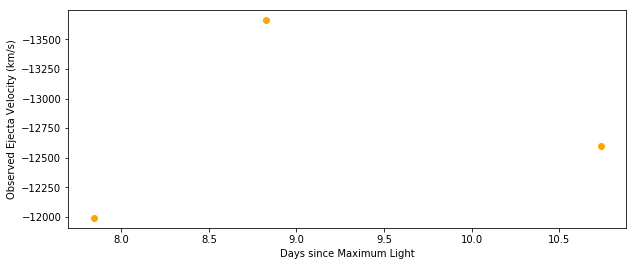

2000cf [u'sn2000cf-20000511.34-fast.flm', u'sn2000cf-20000512.36-fast.flm', u'sn2000cf-20000523.31-fast.flm', u'sn2000cf-20000525.35-fast.flm'] [3.441638324042222, 4.425790578189, 14.99095448295499, 16.959258991241526] [-12295.266835443039, -11688.093164556962, -22617.21924050633, -10321.952405063292]


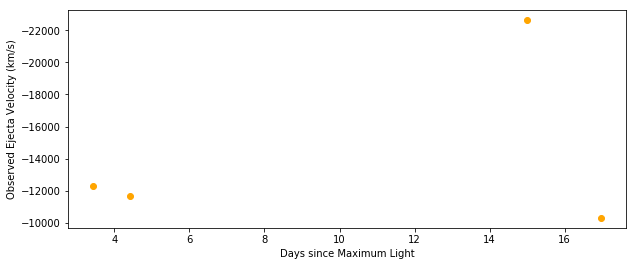

2000dk [u'sn2000dk-20001005.33-fast.flm'] [9.726352951815082] [-12902.440506329114]


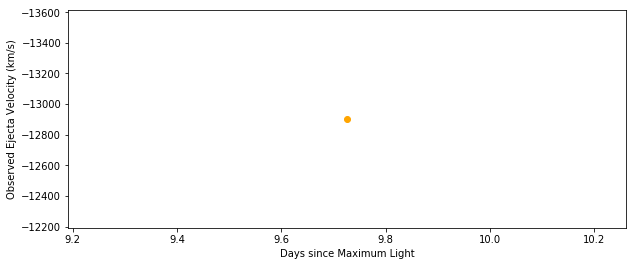

2001ah [u'sn2001ah-20010426.30-mmt.flm'] [17.10507905414931] [-16090.102278481012]


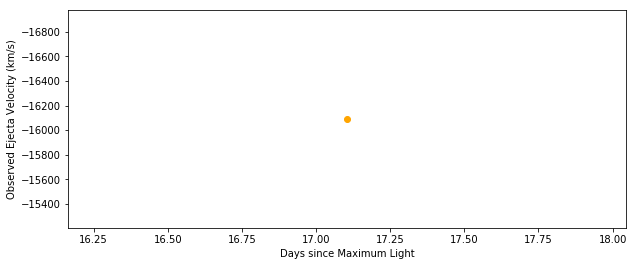

2001az [u'sn2001az-20010430.40-fast.flm', u'sn2001az-20010522.33-fast.flm'] [-2.8096608516415174, 18.262795535676855] [-18822.383797468356, -22465.42582278481]


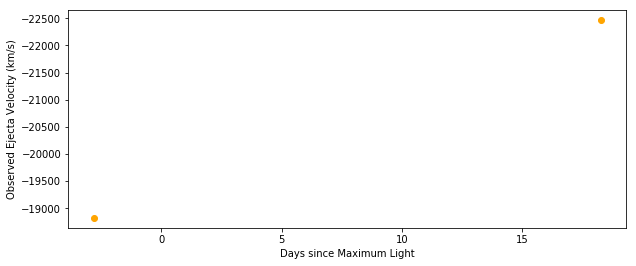

2001bf [u'sn2001bf-20010525.47-mmt.flm'] [10.852771193726683] [-16241.895696202531]


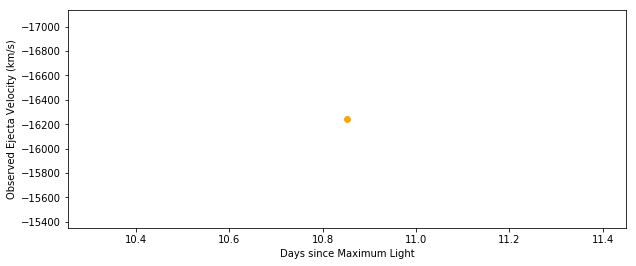

2001da [u'sn2001da-20010715.47-mmt.flm'] [1.2455822138329675] [-19733.144303797468]


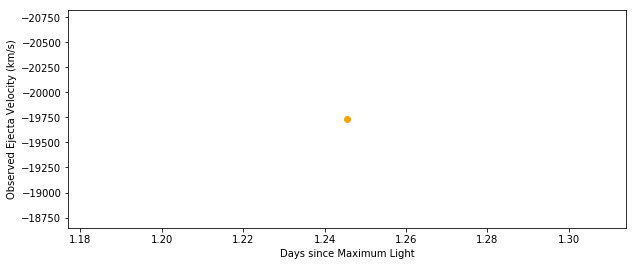

2001eh [u'sn2001eh-20010915.42-fast.flm', u'sn2001eh-20010917.39-fast.flm', u'sn2001eh-20010920.33-fast.flm', u'sn2001eh-20010921.35-fast.flm', u'sn2001eh-20010922.35-fast.flm', u'sn2001eh-20010923.37-fast.flm', u'sn2001eh-20010926.37-fast.flm'] [-2.2805379948287605, -0.3808932380400242, 2.454109596965056, 3.4376820091058096, 4.4019686876782025, 5.385541099825971, 8.27840113554315] [-17759.829873417722, -17304.449620253166, -17000.862784810128, -16849.069367088607, -16849.069367088607, -17152.656202531645, -17304.449620253166]


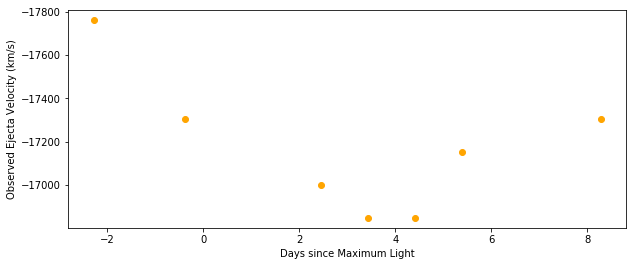

2001n [u'sn2001N-20010126.24-mmt.flm'] [7.36220954433028] [-19429.55746835443]


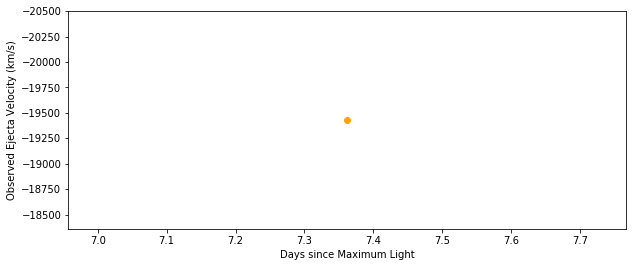

2002ha [u'sn2002ha-20021104.11-mmt.flm'] [1.8986593059931745] [-16697.27594936709]


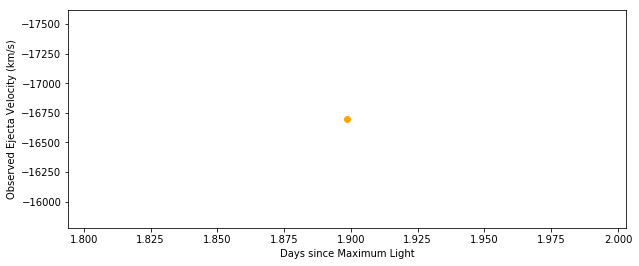

2002he [u'sn2002he-20021104.50-mmt.flm'] [-3.358501762699933] [-16090.102278481012]


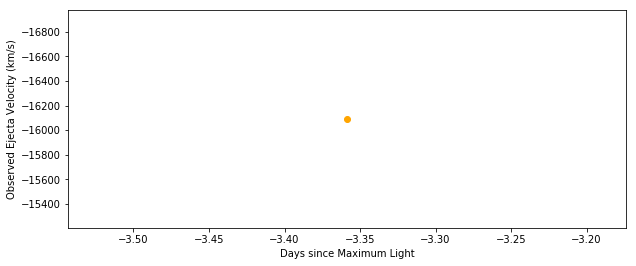

2003ch [u'sn2003ch-20030329.11-mmt.flm'] [2.3478057980603846] [-18215.21012658228]


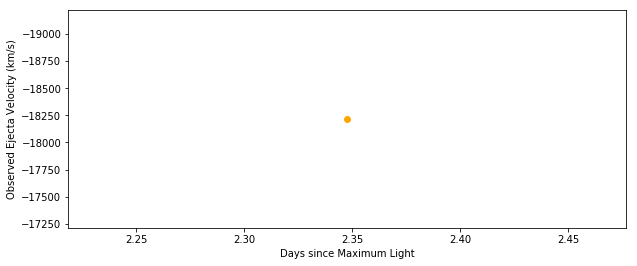

2003fa [u'sn2003fa-20030623.33-fast.flm', u'sn2003fa-20030624.29-fast.flm', u'sn2003fa-20030625.30-fast.flm', u'sn2003fa-20030627.30-fast.flm', u'sn2003fa-20030628.23-fast.flm', u'sn2003fa-20030630.22-fast.flm', u'sn2003fa-20030701.39-fast.flm', u'sn2003fa-20030702.29-fast.flm', u'sn2003fa-20030703.38-fast.flm', u'sn2003fa-20030704.24-fast.flm', u'sn2003fa-20030705.41-mmt.flm', u'sn2003fa-20030706.28-fast.flm'] [7.139644055871351, 8.06237672868104, 9.033168394869074, 10.95552812989101, 11.849425406676488, 13.762173343021354, 14.886753788007507, 15.751815668768776, 16.79950172435237, 17.626116410412365, 18.75069685540551, 19.586923340135577] [-17000.862784810128, -11839.886582278481, -10018.365569620253, -12902.440506329114, -10321.952405063292, -11536.299746835442, -9259.398481012659, -12447.060253164556, -11536.299746835442, -12447.060253164556, -11688.093164556962, -20947.491645569622]


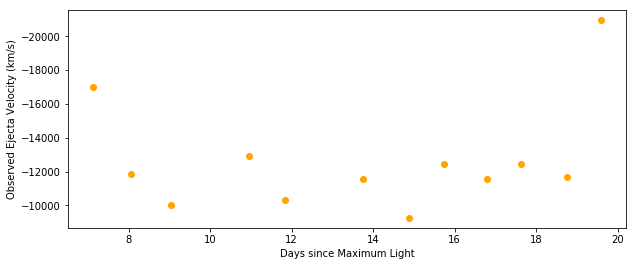

2003hu [u'sn2003hu-20030919.19-fast.flm', u'sn2003hu-20030921.16-fast.flm', u'sn2003hu-20030927.14-fast.flm', u'sn2003hu-20030928.12-fast.flm', u'sn2003hu-20030930.16-fast.flm'] [8.022325581398544, 9.854883720934511, 15.41767441860514, 16.329302325584862, 18.226976744190324] [-8500.431392405064, -14116.787848101267, -16090.102278481012, -15482.928607594937, -17608.0364556962]


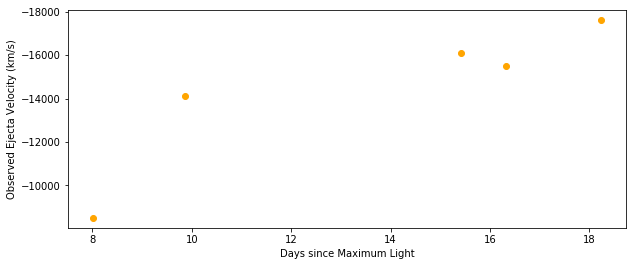

2003ic [u'sn2003ic-20030921.36-fast.flm', u'sn2003ic-20030928.30-fast.flm', u'sn2003ic-20031001.32-fast.flm'] [1.1698709447636975, 7.743882569588765, 10.604619616698852] [-11688.093164556962, -13357.82075949367, -11536.299746835442]


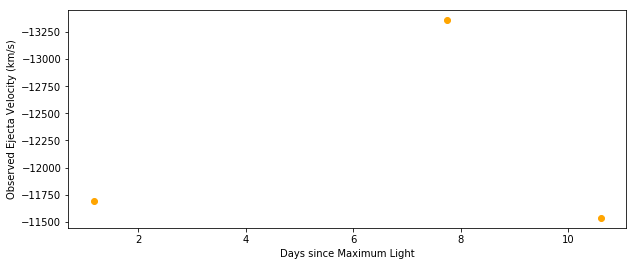

2004gs [u'sn2004gs-20041213.44-fast.flm', u'sn2004gs-20041215.48-fast.flm', u'sn2004gs-20041216.49-fast.flm', u'sn2004gs-20041218.46-fast.flm', u'sn2004gs-20041219.42-fast.flm', u'sn2004gs-20041220.44-fast.flm', u'SN04gs_041219_b01_CLA_LD.dat'] [-2.4838796019135625, -0.4983332116652493, 0.48470691291295476, 2.4021218093785497, 3.336496581258859, 4.329269776386557, 3.1710343820732705] [-17152.656202531645, -15027.54835443038, -11839.886582278481, -13054.233924050634, -12902.440506329114, -14116.787848101267, -12143.47341772152]


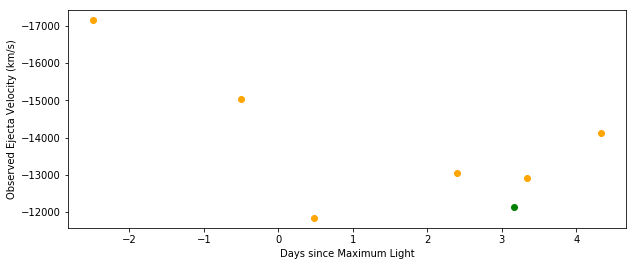

2005bo [u'sn2005bo-20050418.21-fast.flm'] [0.46158580367291785] [-13661.407594936709]


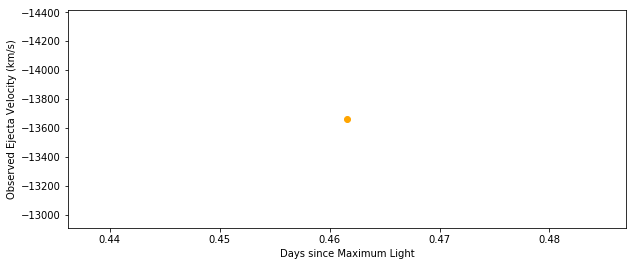

2005el [u'sn2005el-20050927.47-fast.flm', u'sn2005el-20050928.47-fast.flm', u'sn2005el-20050929.48-fast.flm', u'sn2005el-20051005.49-fast.flm', u'sn2005el-20051007.48-fast.flm', u'SN05el_051018_b01_NTT_EM.dat'] [-3.5362741523878394, -2.550965110206759, -1.5558029776018607, 4.365904365901269, 6.32666935984678, 17.04683173864531] [-18974.177215189873, -18063.41670886076, -18063.41670886076, -17608.0364556962, -17152.656202531645, -11384.506329113925]


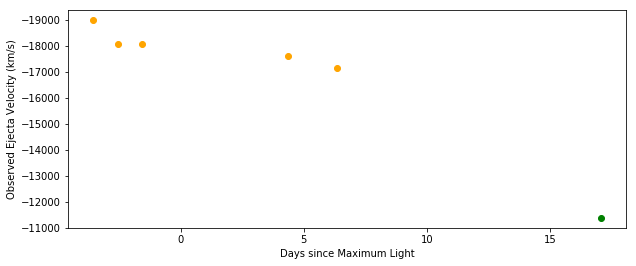

2005eq [u'sn2005eq-20051007.40-fast.flm', u'sn2005eq-20051009.42-fast.flm', u'sn2005eq-20051011.39-fast.flm', u'sn2005eq-20051012.33-fast.flm', u'sn2005eq-20051025.38-fast.flm', u'sn2005eq-20051028.34-fast.flm', u'SN05eq_051018_b01_NTT_EM.dat'] [-3.83293309762596, -1.8698182758206148, 0.04470459495411022, 0.9582332744117932, 13.640732494506736, 16.517375995769765, 6.721238666927599] [-16393.68911392405, -16393.68911392405, -17304.449620253166, -16849.069367088607, -14723.961518987342, -13357.82075949367, -16849.069367088607]


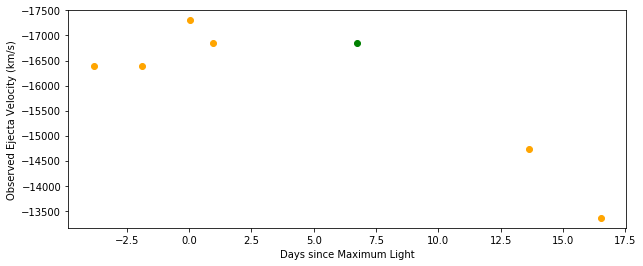

2005eu [u'sn2005eu-20051025.29-fast.flm', u'sn2005eu-20051027.36-fast.flm'] [8.315779302347828, 10.315972557734542] [-13509.61417721519, -11688.093164556962]


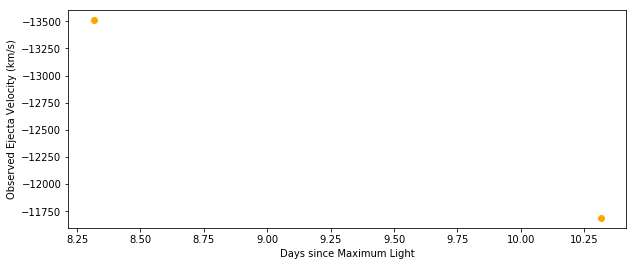

2005hc [u'sn2005hc-20051030.32-fast.flm', u'sn2005hc-20051031.29-fast.flm', u'sn2005hc-20051105.31-fast.flm'] [5.983134787847897, 6.910530240743057, 11.710040728913313] [-18215.21012658228, -17608.0364556962, -10625.539240506328]


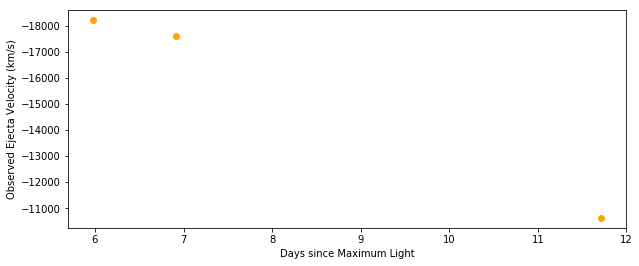

2005hf [u'sn2005hf-20051103.26-fast.flm'] [15.16522706138676] [-10929.126075949367]


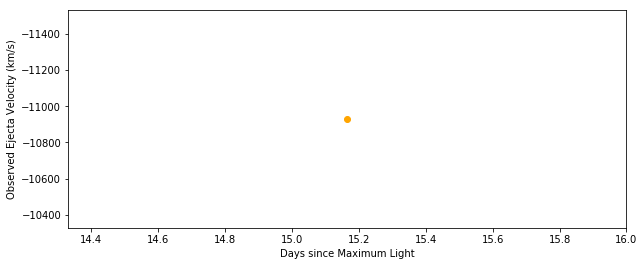

2005kc [u'sn2005kc-20051130.11-fast.flm', u'sn2005kc-20051203.17-fast.flm', u'sn2005kc-20051205.09-fast.flm', u'sn2005kc-20051209.08-fast.flm'] [6.984395933489424, 9.99881787375035, 11.890219875482414, 15.820789660340598] [-10473.745822784811, -10929.126075949367, -10170.158987341772, -12902.440506329114]


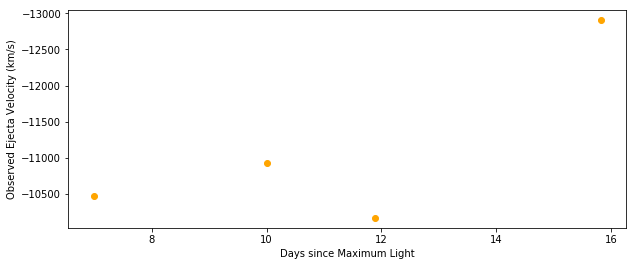

2005ki [u'sn2005ki-20051202.52-fast.flm'] [1.3569373051738791] [-12750.647088607595]


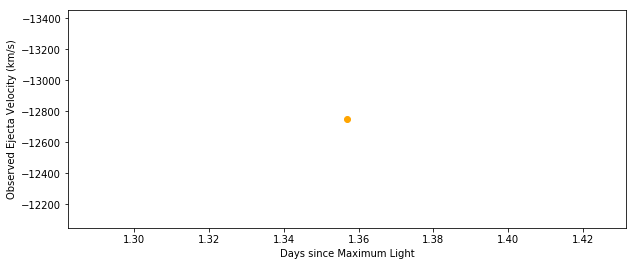

2005ls [u'sn2005ls-20051221.22-fast.flm', u'sn2005ls-20051227.20-fast.flm'] [10.322019590293065, 16.178345695597177] [-17608.0364556962, -18367.003544303796]


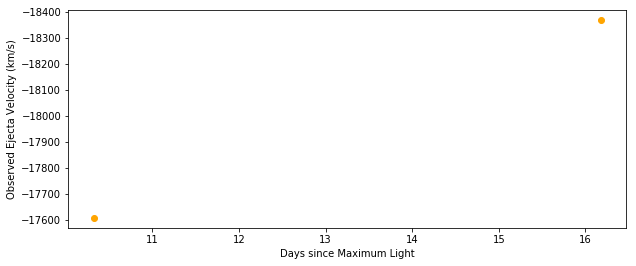

2005lz [u'sn2005lz-20051227.29-fast.flm'] [-4.423842403968263] [-17304.449620253166]


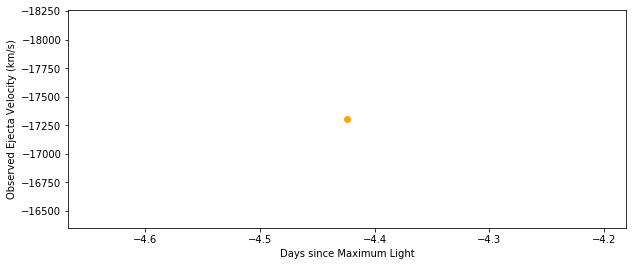

2005mc [u'sn2005mc-20051227.37-fast.flm', u'sn2005mc-20060104.38-fast.flm'] [-2.141977193206416, 5.670972404972671] [-17456.243037974684, -11839.886582278481]


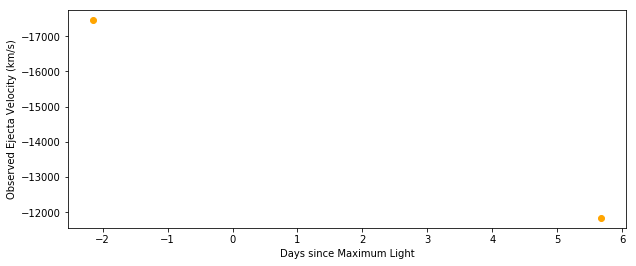

2005na [u'sn2005na-20060104.34-fast.flm', u'sn2005na-20060107.32-fast.flm', u'sn2005na-20060109.43-fast.flm', u'sn2005na-20060122.27-fast.flm', u'SN05na_060116_b01_NTT_EM.dat'] [-0.5134840722520444, 2.390088101006642, 4.445973096164675, 16.956666621195325, 11.032599905240023] [-11384.506329113925, -11688.093164556962, -11080.919493670886, -12295.266835443039, -11839.886582278481]


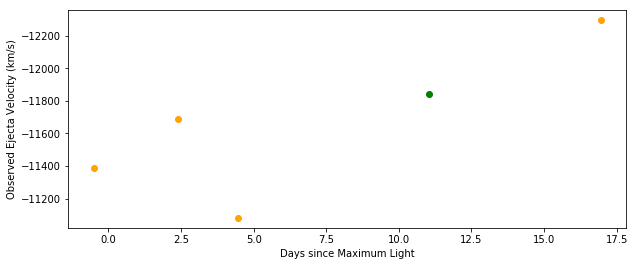

2006ac [u'sn2006ac-20060221.43-fast.flm', u'sn2006ac-20060222.43-fast.flm', u'sn2006ac-20060224.37-fast.flm', u'sn2006ac-20060225.38-fast.flm', u'sn2006ac-20060226.34-fast.flm', u'sn2006ac-20060228.36-fast.flm', u'sn2006ac-20060302.48-fast.flm', u'sn2006ac-20060304.54-fast.flm', u'sn2006ac-20060305.48-fast.flm'] [6.338541656485821, 7.315957486321634, 9.212144196205388, 10.19933418433444, 11.137653380975967, 13.112033357248293, 15.184154916502779, 17.19763152596228, 18.11640240601022] [-13357.82075949367, -14572.168101265823, -13054.233924050634, -15634.722025316456, -14268.581265822784, -15027.54835443038, -13661.407594936709, -10473.745822784811, -14875.754936708861]


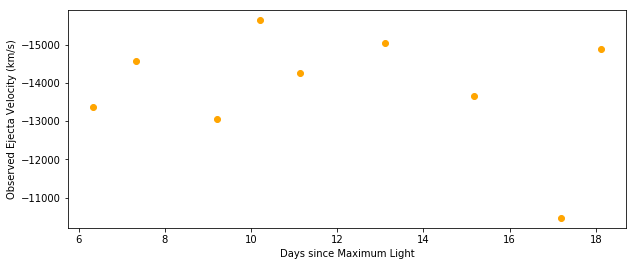

2006ak [u'sn2006ak-20060221.33-fast.flm'] [8.257393314709677] [-18215.21012658228]


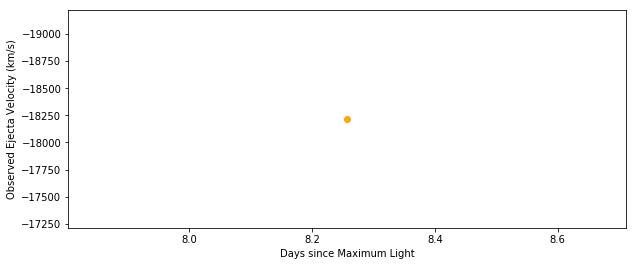

2006al [u'sn2006al-20060224.34-fast.flm', u'sn2006al-20060225.32-fast.flm', u'sn2006al-20060226.29-fast.flm', u'sn2006al-20060227.42-fast.flm', u'sn2006al-20060228.38-fast.flm'] [5.578504076882478, 6.496236827489728, 7.404604958190945, 8.46280700735462, 9.361810518149804] [-17759.829873417722, -12598.853670886076, -13813.201012658228, -13813.201012658228, -11991.68]


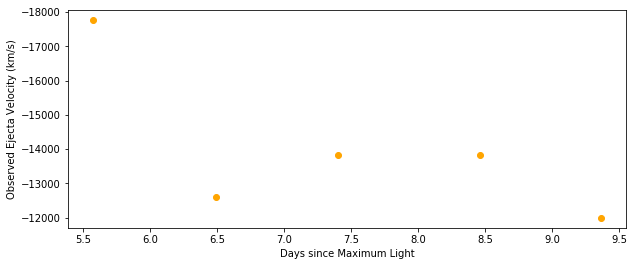

2006ax [u'sn2006ax-20060402.30-fast.flm'] [0.8330554842506991] [-16849.069367088607]


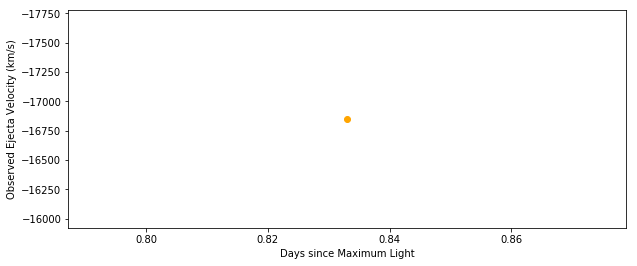

2006az [u'sn2006az-20060331.37-fast.flm', u'sn2006az-20060403.30-fast.flm'] [-0.5276763326440679, 2.3144039148984943] [-11384.506329113925, -10625.539240506328]


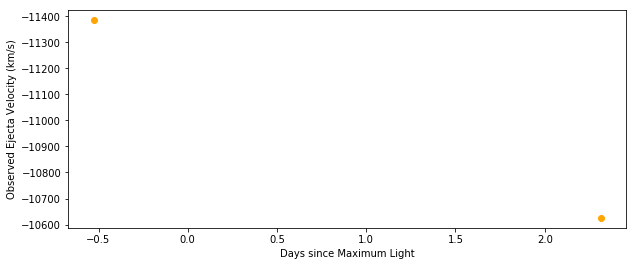

2006bq [u'sn2006bq-20060427.35-fast.flm'] [6.925301275556433] [-17000.862784810128]


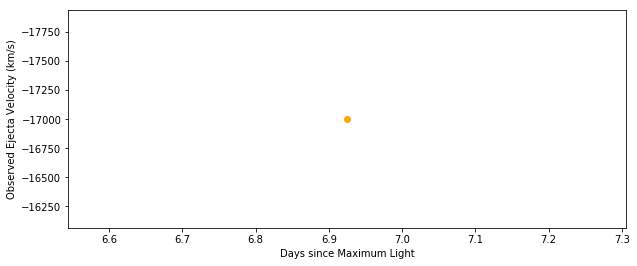

2006bt [u'sn2006bt-20060429.41-fast.flm', u'sn2006bt-20060501.39-fast.flm', u'sn2006bt-20060504.35-fast.flm', u'sn2006bt-20060505.27-fast.flm', u'sn2006bt-20060507.30-fast.flm', u'sn2006bt-20060508.31-fast.flm', u'sn2006bt-20060519.28-fast.flm'] [-2.013261561231115, -0.09494688787173387, 2.772836664226134, 3.6641747952821504, 5.630931758382798, 6.609466010951945, 17.237704378021615] [-19429.55746835443, -15786.515443037975, -17911.62329113924, -18215.21012658228, -17759.829873417722, -17152.656202531645, -15938.308860759495]


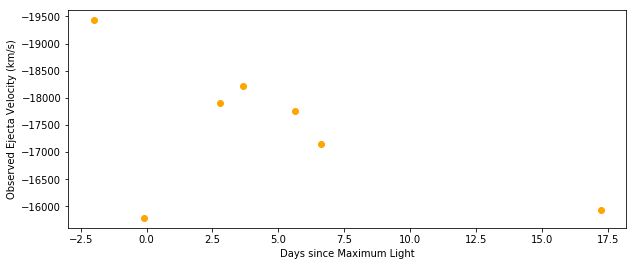

2006bu [u'sn2006bu-20060505.19-fast.flm'] [6.835337650326413] [-16545.482531645568]


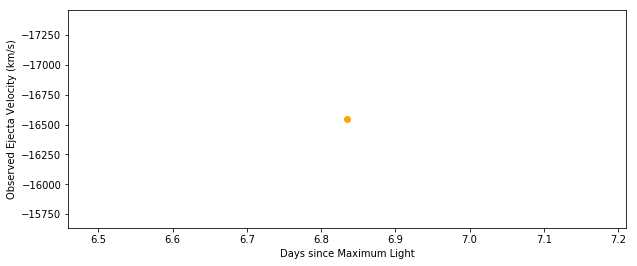

2006bw [u'sn2006bw-20060502.31-fast.flm'] [8.830079941593477] [-13357.82075949367]


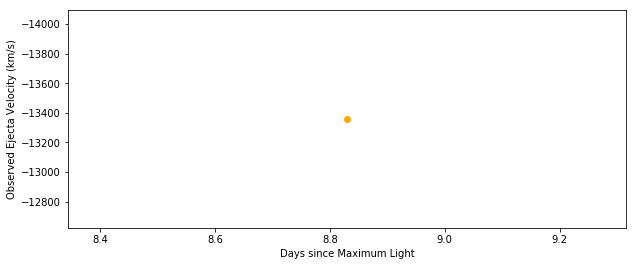

2006bz [u'sn2006bz-20060506.16-fast.flm', u'sn2006bz-20060507.22-fast.flm', u'sn2006bz-20060508.23-fast.flm'] [12.99243316023372, 14.023655859583341, 15.0062359787791] [-16241.895696202531, -12598.853670886076, -15482.928607594937]


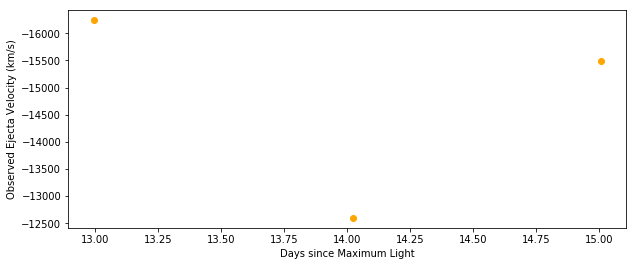

2006cf [u'sn2006cf-20060519.25-fast.flm', u'sn2006cf-20060520.16-fast.flm', u'sn2006cf-20060521.27-fast.flm', u'sn2006cf-20060522.26-fast.flm', u'sn2006cf-20060524.21-fast.flm', u'sn2006cf-20060604.22-fast.flm'] [1.6235387191411412, 2.497234895619601, 3.562952209775117, 4.513456841329988, 6.385662933773849, 16.956426563436157] [-16849.069367088607, -17000.862784810128, -16241.895696202531, -10321.952405063292, -10321.952405063292, -11536.299746835442]


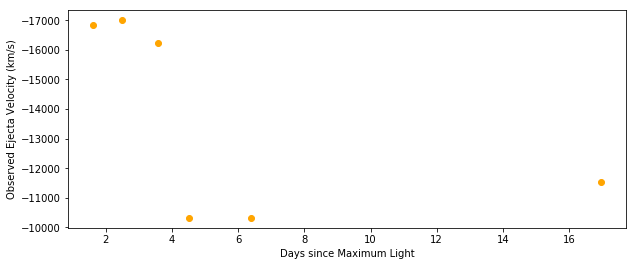

2006cj [u'sn2006cj-20060521.29-fast.flm', u'sn2006cj-20060522.29-fast.flm', u'sn2006cj-20060523.33-fast.flm', u'sn2006cj-20060528.19-fast.flm', u'sn2006cj-20060601.28-fast.flm', u'sn2006cj-20060602.21-fast.flm', u'sn2006cj-20060604.27-fast.flm'] [-2.9666974858492, -2.0299442538163612, -1.055720892501391, 3.4968998151787507, 7.32822053418979, 8.199401039980602, 10.12911269796607] [-18518.796962025317, -13964.994430379747, -13661.407594936709, -11839.886582278481, -11232.712911392406, -11839.886582278481, -11536.299746835442]


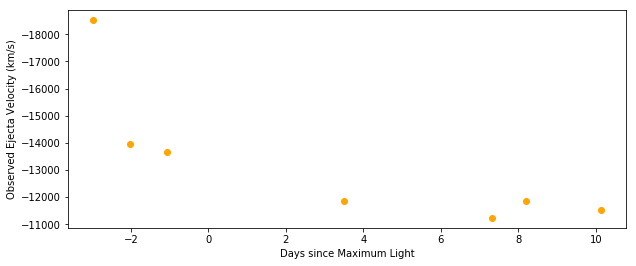

2006cp [u'sn2006cp-20060617.21-fast.flm', u'sn2006cp-20060618.21-fast.flm', u'sn2006cp-20060620.19-fast.flm'] [6.594025759840715, 7.572222727625754, 9.509052723843263] [-15786.515443037975, -15027.54835443038, -15634.722025316456]


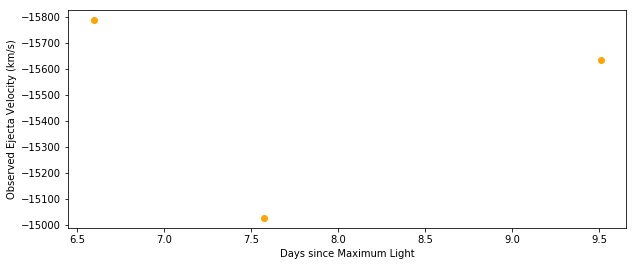

2006cq [u'sn2006cq-20060531.27-fast.flm'] [-3.345298315336637] [-20036.731139240506]


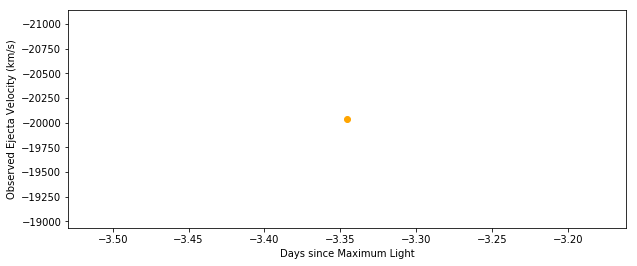

2006em [u'sn2006em-20060902.41-fast.flm'] [6.001571770150345] [-14572.168101265823]


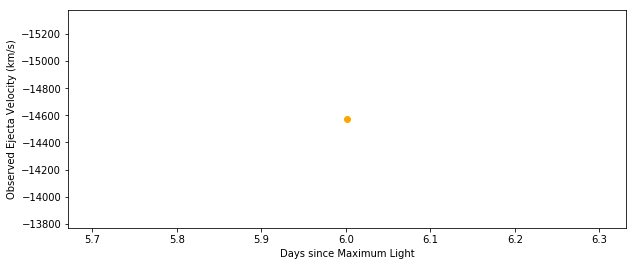

2006et [u'sn2006et-20060918.36-fast.flm', u'sn2006et-20060922.37-fast.flm', u'SN06et_061005_b01_NTT_EM.dat'] [3.537905360544837, 7.459132694923867, 19.90731822284771] [-15938.308860759495, -15786.515443037975, -12750.647088607595]


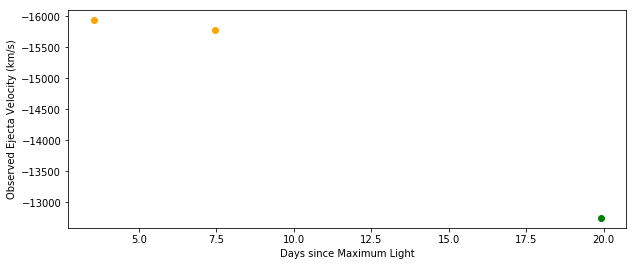

2006gj [u'sn2006gj-20060920.43-fast.flm', u'sn2006gj-20060924.46-fast.flm', u'SN06gj_061005_b01_NTT_EM.dat'] [-1.4052415021785707, 2.513874936422914, 13.026442852395794] [-12295.266835443039, -11688.093164556962, -13357.82075949367]


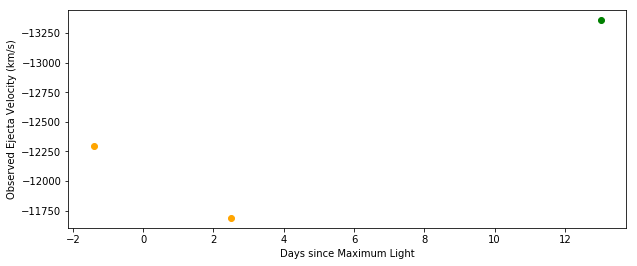

2006gr [u'sn2006gr-20060929.13-fast.flm', u'sn2006gr-20060930.30-fast.flm', u'sn2006gr-20061002.26-fast.flm', u'sn2006gr-20061003.26-fast.flm', u'sn2006gr-20061014.14-fast.flm', u'sn2006gr-20061017.24-fast.flm', u'sn2006gr-20061023.18-fast.flm'] [-4.608557728278418, -3.4776826145814623, -1.5832251591672994, -0.616665232935153, 9.899506764468068, 12.895842535786317, 18.637208497607517] [-21402.871898734178, -21554.665316455696, -20947.491645569622, -20492.111392405062, -17000.862784810128, -13206.027341772153, -17304.449620253166]


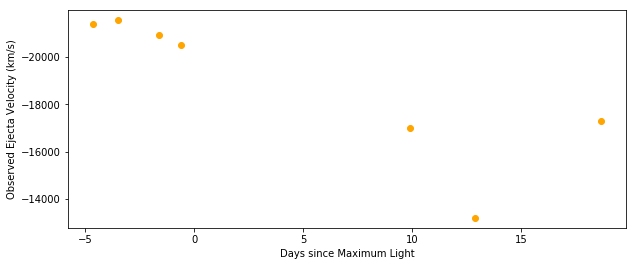

2006gt [u'sn2006gt-20060925.36-fast.flm', u'sn2006gt-20060926.38-fast.flm', u'sn2006gt-20060927.37-fast.flm'] [0.5015453147126151, 1.477835812818706, 2.4254118845179002] [-11839.886582278481, -14268.581265822784, -12902.440506329114]


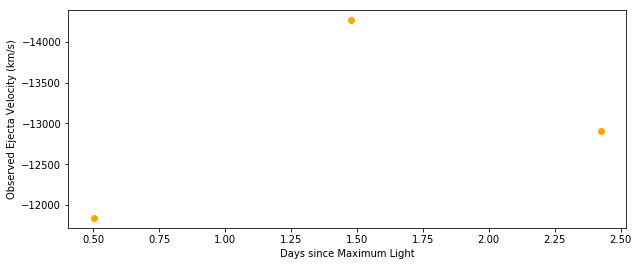

2006hb [u'sn2006hb-20060928.51-fast.flm', u'sn2006hb-20060929.51-fast.flm', u'sn2006hb-20060930.50-fast.flm', u'sn2006hb-20061001.52-fast.flm', u'sn2006hb-20061002.47-fast.flm', u'sn2006hb-20061003.51-fast.flm'] [13.487054633703595, 14.471942514067294, 15.44698151562535, 16.45156715359317, 17.387210639942985, 18.411494035522093] [-12598.853670886076, -12598.853670886076, -12447.060253164556, -10777.332658227848, -13054.233924050634, -12447.060253164556]


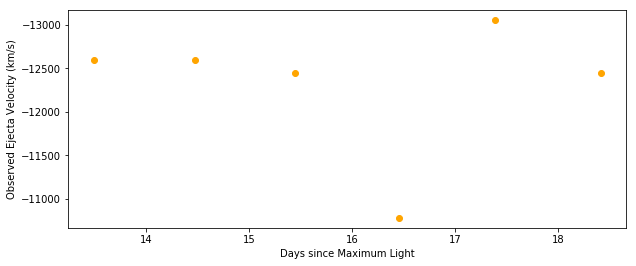

2006le [u'sn2006le-20061112.40-fast.flm', u'sn2006le-20061114.38-fast.flm', u'sn2006le-20061115.44-fast.flm', u'sn2006le-20061116.42-fast.flm', u'sn2006le-20061117.44-fast.flm', u'sn2006le-20061119.40-fast.flm', u'sn2006le-20061121.37-fast.flm', u'sn2006le-20061122.38-fast.flm', u'sn2006le-20061123.36-fast.flm', u'sn2006le-20061125.36-fast.flm'] [4.4209342737397614, 6.367010276849479, 7.40884894518795, 8.372058280058413, 9.374582281666457, 11.301000951414535, 13.23724828784701, 14.229943622763507, 15.193152957641122, 17.15888629411963] [-17911.62329113924, -18215.21012658228, -18822.383797468356, -17759.829873417722, -17000.862784810128, -12295.266835443039, -12143.47341772152, -13054.233924050634, -13054.233924050634, -11232.712911392406]


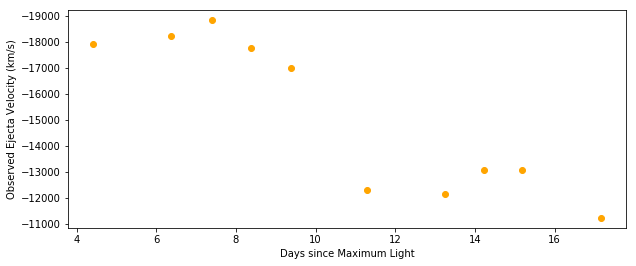

2006mo [u'sn2006mo-20061113.21-fast.flm'] [6.429110069220002] [-11232.712911392406]


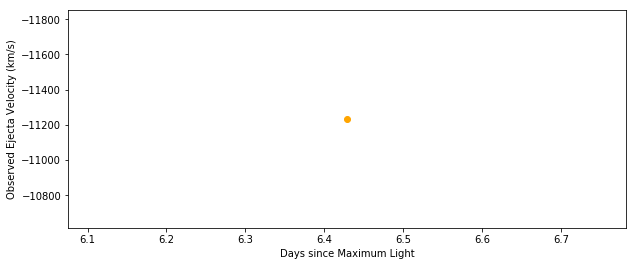

2006n [u'sn2006N-20060122.23-fast.flm', u'sn2006N-20060124.26-fast.flm', u'sn2006N-20060126.32-fast.flm', u'sn2006N-20060127.24-fast.flm', u'sn2006N-20060128.22-fast.flm', u'sn2006N-20060130.22-fast.flm', u'sn2006N-20060131.22-fast.flm', u'sn2006N-20060201.21-fast.flm', u'sn2006N-20060202.20-fast.flm', u'sn2006N-20060203.21-fast.flm', u'sn2006N-20060206.32-fast.flm'] [-2.4845283881984885, -0.4831027421483112, 1.5479006228078807, 2.4549506692924736, 3.42115615359627, 5.3930040807404325, 6.378928044312514, 7.354992768246865, 8.331057492181218, 9.326840695391029, 12.393064222100776] [-18974.177215189873, -18367.003544303796, -11688.093164556962, -11991.68, -11991.68, -11536.299746835442, -11536.299746835442, -11688.093164556962, -11384.506329113925, -11384.506329113925, -11839.886582278481]


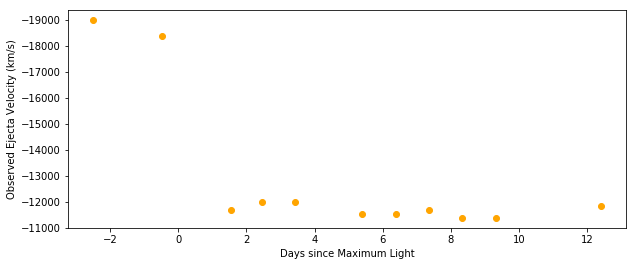

2006oa [u'sn2006oa-20061122.16-fast.flm', u'sn2006oa-20061123.13-fast.flm', u'sn2006oa-20061125.08-fast.flm', u'sn2006oa-20061127.10-fast.flm'] [-4.584905660371043, -3.669811320754168, -1.8301886792406152, 0.07547169811485493] [-19429.55746835443, -20492.111392405062, -19884.93772151899, -18215.21012658228]


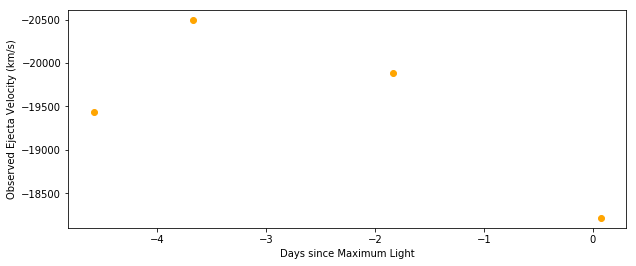

2006s [u'sn2006S-20060129.51-fast.flm', u'sn2006S-20060131.49-fast.flm', u'sn2006S-20060202.47-fast.flm', u'sn2006S-20060203.47-fast.flm', u'sn2006S-20060204.47-fast.flm', u'sn2006S-20060206.48-fast.flm', u'sn2006S-20060207.43-mmt.flm'] [-4.925869729925226, -3.0074546895552565, -1.0890396491782384, -0.1201431641409069, 0.8487533208964246, 2.7962352558234347, 3.71668691660608] [-19125.970632911394, -18367.003544303796, -19125.970632911394, -17759.829873417722, -18367.003544303796, -18518.796962025317, -17911.62329113924]


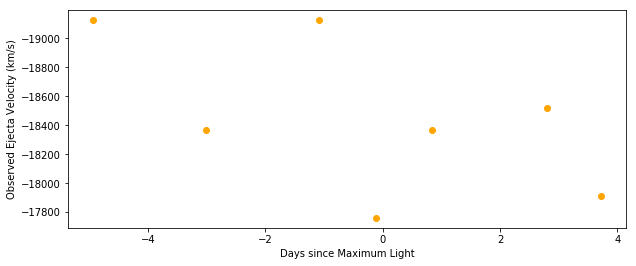

2006sr [u'sn2006sr-20061222.12-fast.flm', u'sn2006sr-20061224.09-fast.flm', u'sn2006sr-20061225.12-fast.flm', u'sn2006sr-20061226.13-fast.flm', u'sn2006sr-20061227.09-fast.flm', u'sn2006sr-20070110.12-fast.flm'] [-0.5731638252578107, 1.350401312315068, 2.35612318628358, 3.342316480164066, 4.279688323856459, 17.978987247837665] [-19277.76405063291, -13206.027341772153, -15786.515443037975, -14268.581265822784, -13964.994430379747, -10777.332658227848]


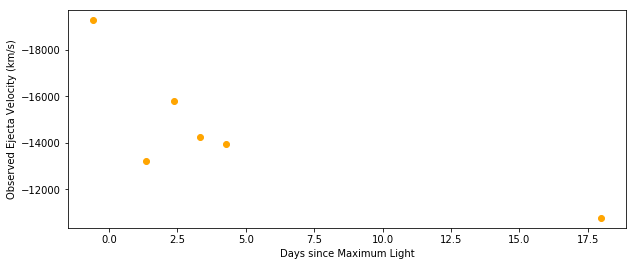

2006te [u'sn2006te-20070109.49-fast.flm'] [12.804480841258254] [-10625.539240506328]


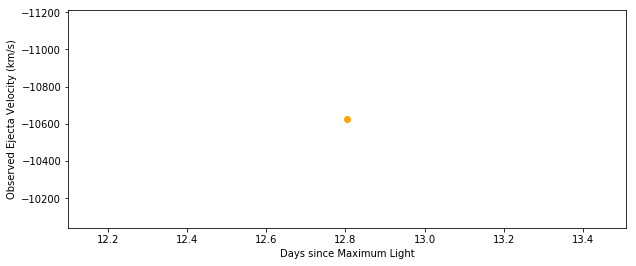

2007ae [u'sn2007ae-20070225.54-fast.flm', u'sn2007ae-20070226.53-fast.flm'] [2.4821798838202884, 3.412292709322632] [-17152.656202531645, -18367.003544303796]


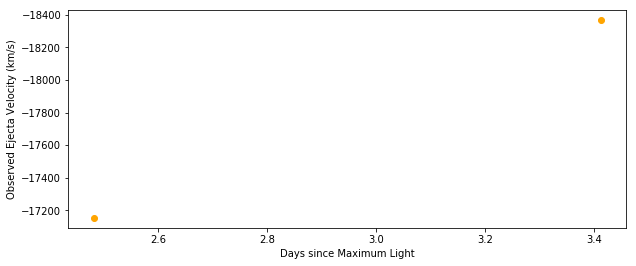

2007al [u'sn2007al-20070312.31-fast.flm', u'sn2007al-20070313.23-fast.flm', u'sn2007al-20070314.26-fast.flm', u'sn2007al-20070315.23-fast.flm', u'sn2007al-20070318.25-fast.flm', u'sn2007al-20070320.24-fast.flm'] [2.7920073109896326, 3.7009410428102463, 4.718551633863014, 5.676883938060573, 8.660557709885405, 10.626620890657467] [-11688.093164556962, -8652.224810126583, -11080.919493670886, -10473.745822784811, -11688.093164556962, -22161.838987341773]


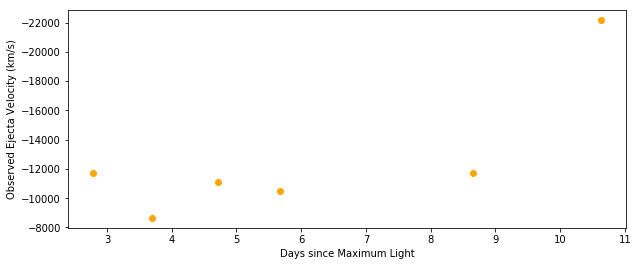

2007ap [u'sn2007ap-20070315.45-fast.flm', u'sn2007ap-20070319.46-fast.flm'] [9.248704000122856, 13.196261535037612] [-11232.712911392406, -10321.952405063292]


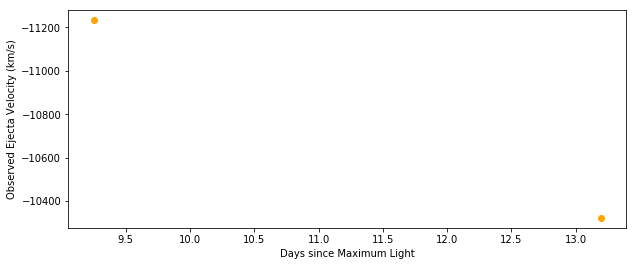

2007au [u'sn2007au-20070320.20-fast.flm', u'sn2007au-20070321.14-fast.flm', u'sn2007au-20070326.15-fast.flm'] [-4.480767874083817, -3.559726587915968, 1.3492275011174069] [-16849.069367088607, -15786.515443037975, -12143.47341772152]


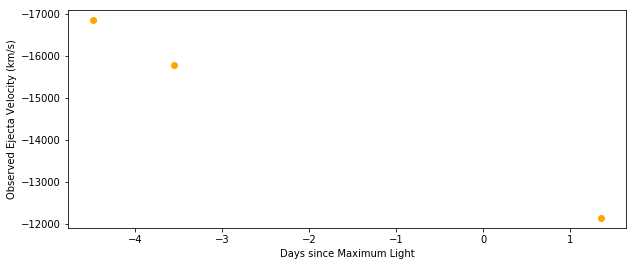

2007ba [u'sn2007ba-20070409.43-fast.flm', u'sn2007ba-20070411.50-fast.flm', u'sn2007ba-20070412.47-fast.flm', u'SN07ba_070409_b01_BAA_IM.dat'] [2.550762484434584, 4.543997041921789, 5.478024829731054, 2.3678085880685553] [-15482.928607594937, -13206.027341772153, -15027.54835443038, -12447.060253164556]


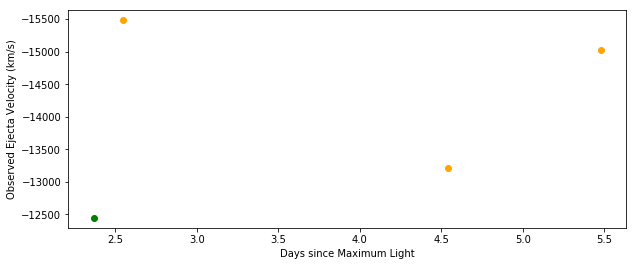

2007bc [u'sn2007bc-20070407.24-fast.flm', u'sn2007bc-20070414.27-fast.flm', u'sn2007bc-20070416.21-fast.flm', u'sn2007bc-20070417.36-fast.flm', u'SN07bc_070409_b01_BAA_IM.dat'] [-1.643808777429353, 5.242946708462924, 7.143416927900941, 8.26998432602149, 0.19788982837849114] [-17152.656202531645, -11232.712911392406, -11991.68, -10777.332658227848, -12447.060253164556]


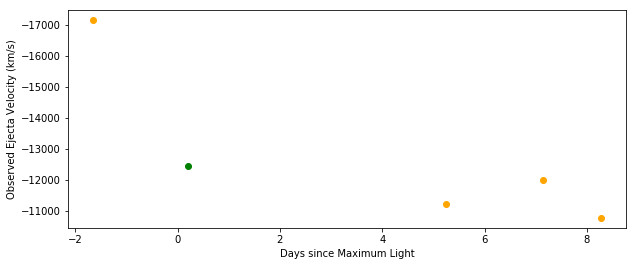

2007bd [u'sn2007bd-20070412.18-fast.flm', u'sn2007bd-20070415.20-fast.flm', u'sn2007bd-20070418.22-fast.flm', u'sn2007bd-20070425.17-fast.flm', u'SN07bd_070430_b01_DUP_BC.dat'] [-4.069228291952055, -1.1397719292147412, 1.7896844335296305, 8.531314142482408, 13.22620447195723] [-19277.76405063291, -18518.796962025317, -15179.341772151898, -13964.994430379747, -13357.82075949367]


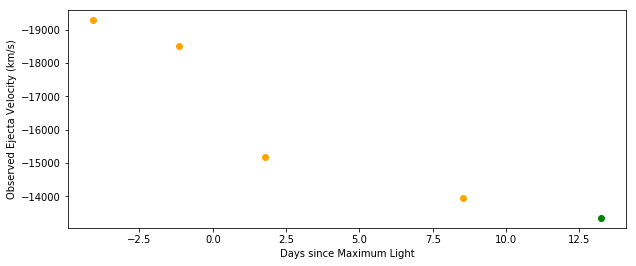

2007bz [u'sn2007bz-20070512.31-fast.flm'] [16.501627555102132] [-11536.299746835442]


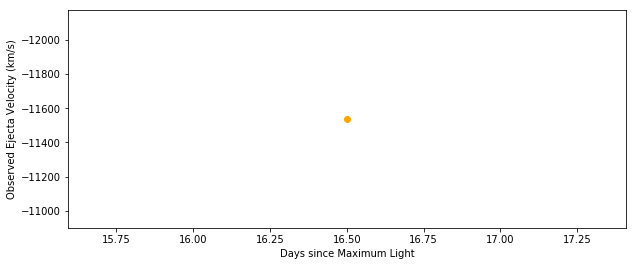

2007ca [u'sn2007ca-20070510.23-fast.flm', u'sn2007ca-20070512.27-fast.flm', u'sn2007ca-20070513.21-fast.flm', u'sn2007ca-20070516.26-fast.flm', u'sn2007ca-20070518.32-fast.flm', u'sn2007ca-20070520.22-fast.flm', u'SN07ca_070508_b01_BAA_IM.dat', u'SN07ca_070511_b01_DUP_BC.dat'] [3.474132847369942, 5.485836227616985, 6.412797589108573, 9.420491368411804, 11.45191733082221, 13.325562635961576, 1.5215972135914688, 4.322203880071746] [-13661.407594936709, -13054.233924050634, -15179.341772151898, -13054.233924050634, -12902.440506329114, -12295.266835443039, -17152.656202531645, -13661.407594936709]


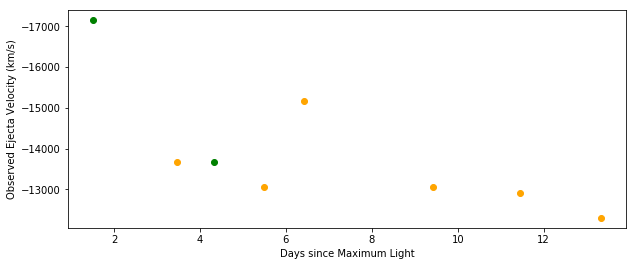

2007cg [u'sn2007cg-20070514.24-fast.flm', u'sn2007cg-20070515.22-fast.flm', u'sn2007cg-20070516.24-fast.flm'] [10.361054436906908, 11.309567594142516, 12.296795574116112] [-17759.829873417722, -17759.829873417722, -18974.177215189873]


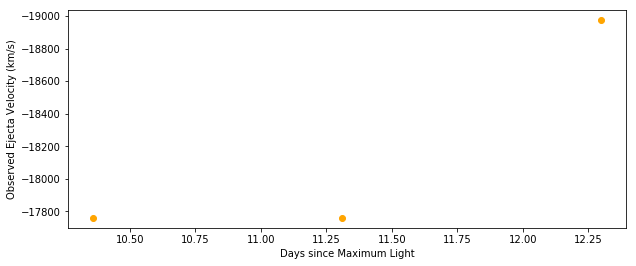

2007ci [u'sn2007ci-20070521.19-fast.flm', u'sn2007ci-20070522.19-fast.flm', u'sn2007ci-20070524.19-fast.flm', u'sn2007ci-20070525.19-fast.flm', u'sn2007ci-20070608.18-fast.flm', u'sn2007ci-20070612.19-fast.flm', u'sn2007ci-20070614.18-fast.flm'] [-4.905090332629534, -3.922893630060304, -1.9585002249218442, -0.9763035223526141, 12.764628346588914, 16.703237123893526, 18.657808562004295] [-12750.647088607595, -13357.82075949367, -12447.060253164556, -11991.68, -12295.266835443039, -15027.54835443038, -11536.299746835442]


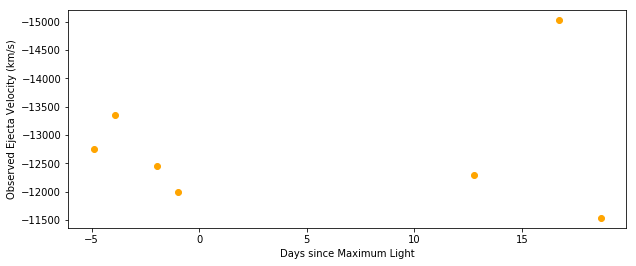

2007co [u'sn2007co-20070609.33-fast.flm', u'sn2007co-20070610.39-fast.flm', u'sn2007co-20070612.35-fast.flm', u'sn2007co-20070613.39-fast.flm', u'sn2007co-20070614.38-fast.flm', u'sn2007co-20070615.36-fast.flm', u'sn2007co-20070616.35-fast.flm', u'sn2007co-20070617.34-fast.flm', u'sn2007co-20070619.45-fast.flm', u'sn2007co-20070620.34-fast.flm', u'sn2007co-20070621.33-fast.flm', u'sn2007co-20070622.38-fast.flm', u'sn2007co-20070624.36-fast.flm', u'sn2007co-20070625.40-fast.flm'] [-4.17834350248348, -3.1461728866304375, -1.23763099316298, -0.22493529458710954, 0.7390731107852049, 1.693344057522476, 2.6573524628947904, 3.621360868267105, 5.675964641338146, 6.542598460310433, 7.506606865689832, 8.529040022900746, 10.45705683365246, 11.46975253222833] [-19581.35088607595, -18822.383797468356, -19125.970632911394, -18822.383797468356, -18518.796962025317, -19277.76405063291, -17911.62329113924, -18367.003544303796, -16545.482531645568, -17608.0364556962, -15938.308860759495, -17911.62329113

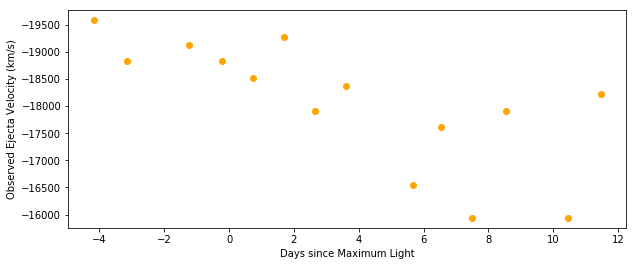

2007cq [u'sn2007cq-20070625.45-fast.flm'] [-4.0567140908209565] [-12143.47341772152]


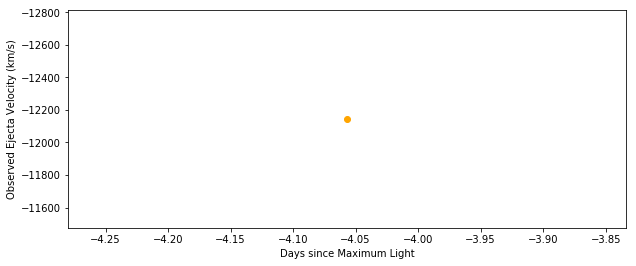

2007f [u'sn2007F-20070121.55-fast.flm', u'sn2007F-20070122.49-fast.flm', u'sn2007F-20070126.43-fast.flm', u'sn2007F-20070210.39-fast.flm'] [-1.714552003678599, -0.796216457552214, 3.0529772145319765, 17.6681897359386] [-11688.093164556962, -11991.68, -12750.647088607595, -12598.853670886076]


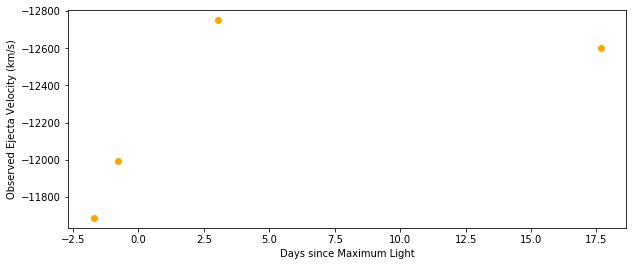

2007qe [u'sn2007qe-20071203.12-fast.flm', u'sn2007qe-20071204.14-fast.flm', u'sn2007qe-20071206.15-fast.flm', u'sn2007qe-20071214.07-mmt.flm', u'sn2007qe-20071214.11-fast.flm'] [8.091176470592401, 9.091176470589263, 11.061764705885377, 18.826470588236607, 18.865686274511972] [-15179.341772151898, -15786.515443037975, -15786.515443037975, -13813.201012658228, -15179.341772151898]


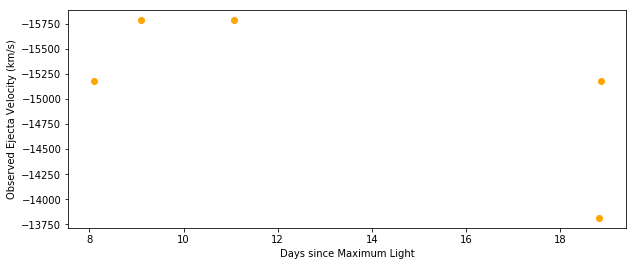

2007s [u'sn2007S-20070208.34-fast.flm', u'sn2007S-20070209.30-fast.flm', u'sn2007S-20070210.32-fast.flm', u'sn2007S-20070212.33-fast.flm', u'sn2007S-20070219.32-fast.flm', u'sn2007S-20070221.32-fast.flm', u'sn2007S-20070225.30-fast.flm', u'sn2007S-20070226.30-fast.flm'] [-3.4214419568050087, -2.4746030180473375, -1.4685866456271792, 0.5138573823854821, 7.408028405166784, 9.380609527565444, 13.306045961141931, 14.29233652234126] [-18518.796962025317, -18063.41670886076, -17608.0364556962, -17759.829873417722, -15634.722025316456, -16090.102278481012, -14875.754936708861, -15786.515443037975]


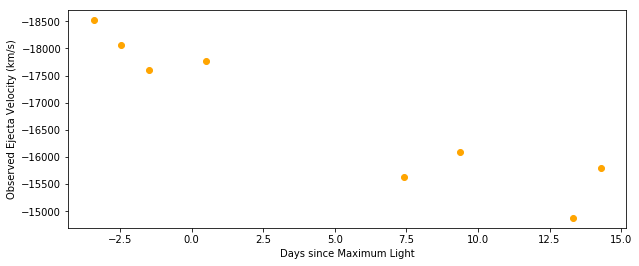

2008af [u'sn2008af-20080211.48-fast.flm'] [7.566470280317123] [-18670.590379746835]


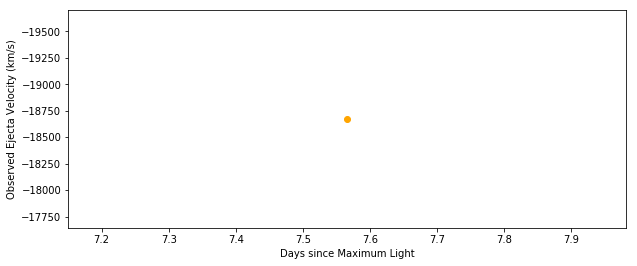

2008bf [u'sn2008bf-20080330.31-fast.flm', u'sn2008bf-20080401.29-fast.flm', u'sn2008bf-20080402.35-fast.flm', u'sn2008bf-20080403.30-fast.flm', u'sn2008bf-20080406.29-fast.flm', u'sn2008bf-20080409.33-fast.flm', u'sn2008bf-20080410.28-fast.flm', u'sn2008bf-20080412.30-fast.flm', u'sn2008bf-20080415.24-fast.flm', u'SN08bf_080328_b01_NTT_EM.dat'] [0.6880733944900159, 2.6205348428632362, 3.655084911180308, 4.582276010150019, 7.500487995312973, 10.467499512003265, 11.394690610965874, 13.366191684559544, 16.23560413819516, -1.323203421777879] [-19125.970632911394, -18215.21012658228, -18518.796962025317, -17911.62329113924, -14116.787848101267, -12447.060253164556, -13964.994430379747, -11839.886582278481, -11839.886582278481, -18670.590379746835]


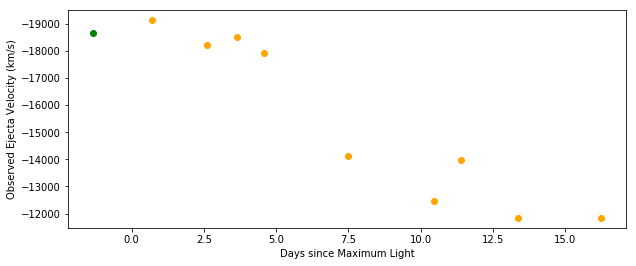

2008l [u'sn2008L-20080202.15-fast.flm'] [4.745928977833407] [-13054.233924050634]


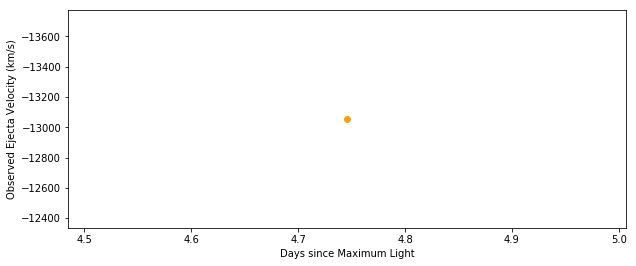

2004ey [u'SN04ey_041025_b01_CLA_LD.dat'] [-0.2904155008508899] [-17608.0364556962]


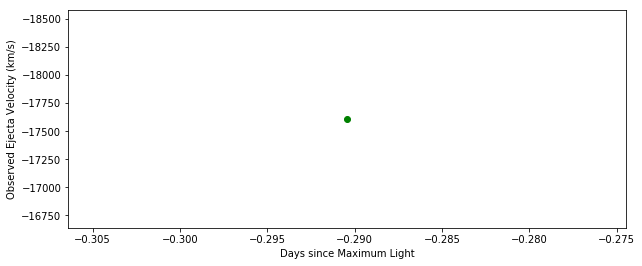

2004gs [u'SN04gs_041219_b01_CLA_LD.dat'] [3.1710343820732705] [-12143.47341772152]


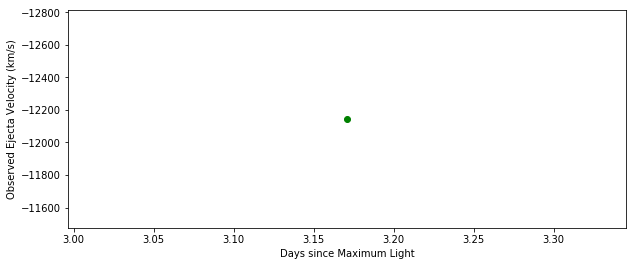

2004gu [u'SN04gu_041219_b01_CLA_LD.dat'] [-3.6697107353126377] [-20340.317974683545]


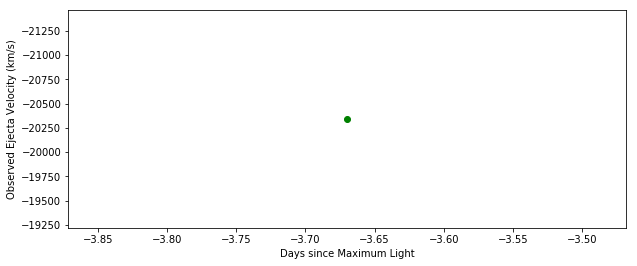

2005ag [u'SN05ag_050212_b01_DUP_WF.dat'] [-0.861378297776925] [-19125.970632911394]


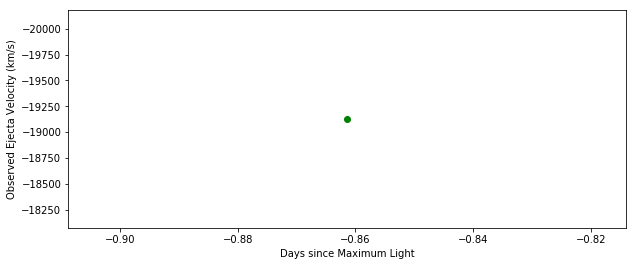

2005el [u'SN05el_051018_b01_NTT_EM.dat'] [17.04683173864531] [-11384.506329113925]


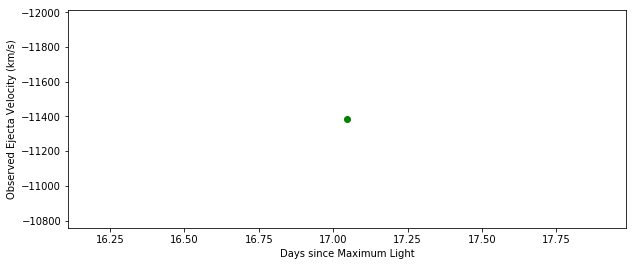

2005eq [u'SN05eq_051018_b01_NTT_EM.dat'] [6.721238666927599] [-16849.069367088607]


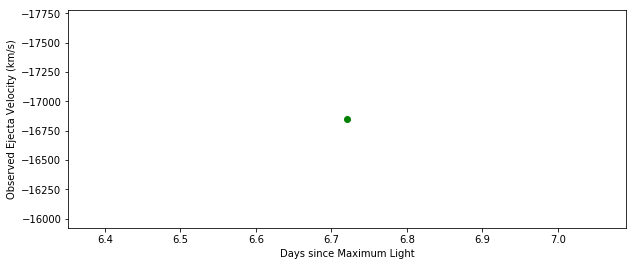

2005na [u'SN05na_060116_b01_NTT_EM.dat'] [11.032599905240023] [-11839.886582278481]


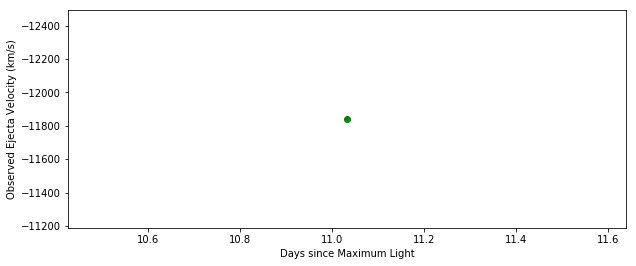

2006et [u'SN06et_061005_b01_NTT_EM.dat'] [19.90731822284771] [-12750.647088607595]


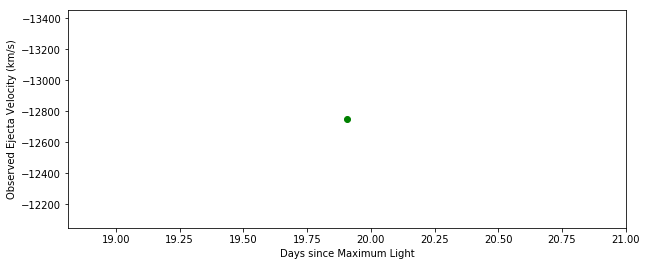

2006gj [u'SN06gj_061005_b01_NTT_EM.dat'] [13.026442852395794] [-13357.82075949367]


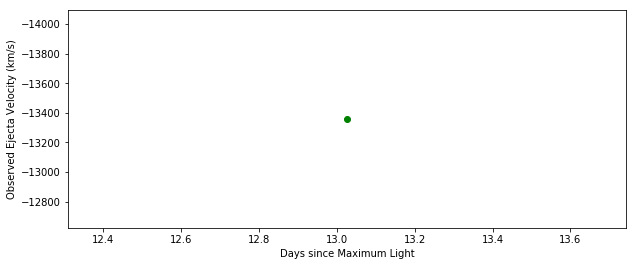

2006is [u'SN06is_061005_b01_NTT_EM.dat'] [9.951908160186708] [-14723.961518987342]


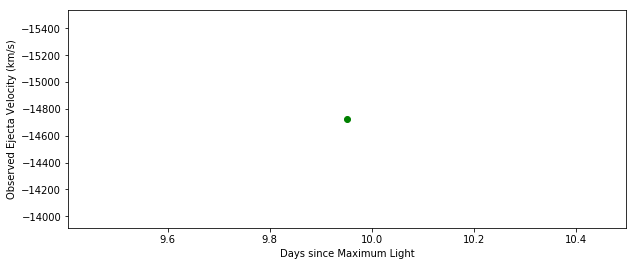

2006kf [u'SN06kf_061103_b01_NTT_EM.dat'] [1.643981548985137] [-17000.862784810128]


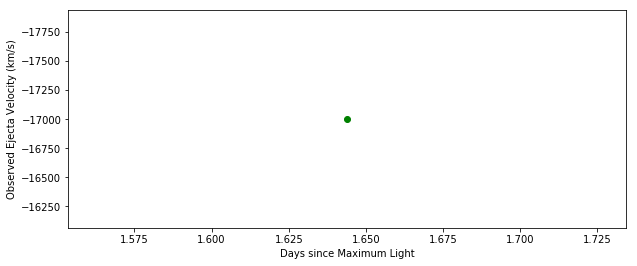

2006os [u'SN06os_061213_b01_DUP_BC.dat'] [18.82439056968551] [-9259.398481012659]


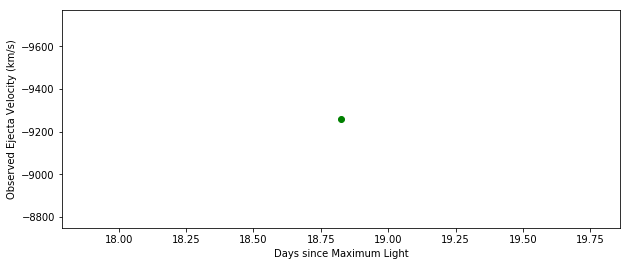

2007ai [u'SN07ai_070314_b01_DUP_BC.dat', u'SN07ai_070319_b01_DUP_BC.dat', u'SN07ai_070326_b01_DUP_BC.dat'] [0.15412024490020781, 4.990975726402731, 11.727678251247363] [-15938.308860759495, -17000.862784810128, -16545.482531645568]


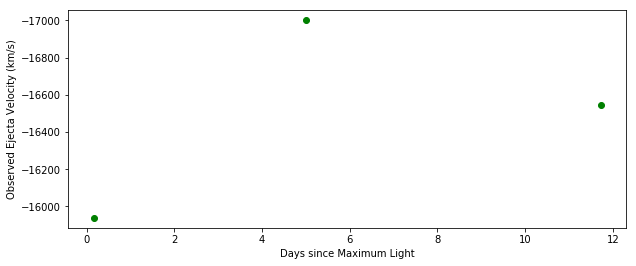

2007ba [u'SN07ba_070409_b01_BAA_IM.dat'] [2.3678085880685553] [-12447.060253164556]


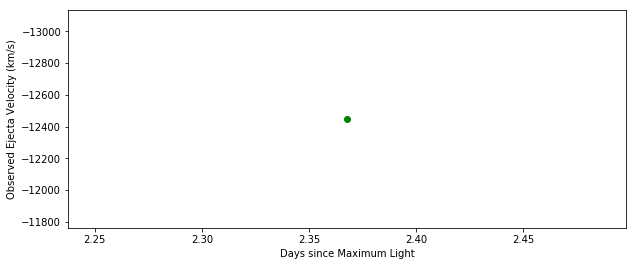

2007bc [u'SN07bc_070409_b01_BAA_IM.dat'] [0.19788982837849114] [-12447.060253164556]


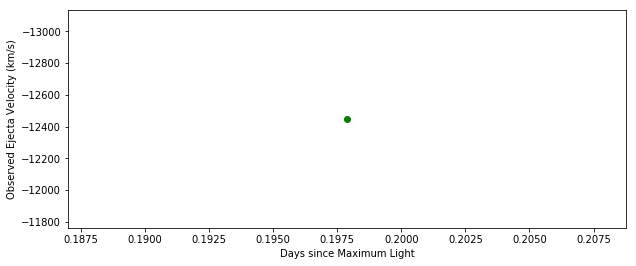

2007bd [u'SN07bd_070430_b01_DUP_BC.dat'] [13.22620447195723] [-13357.82075949367]


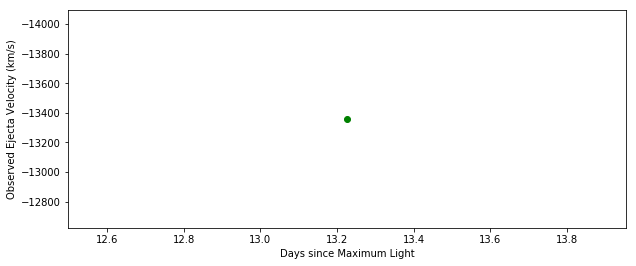

2007ca [u'SN07ca_070508_b01_BAA_IM.dat', u'SN07ca_070511_b01_DUP_BC.dat'] [1.5215972135914688, 4.322203880071746] [-17152.656202531645, -13661.407594936709]


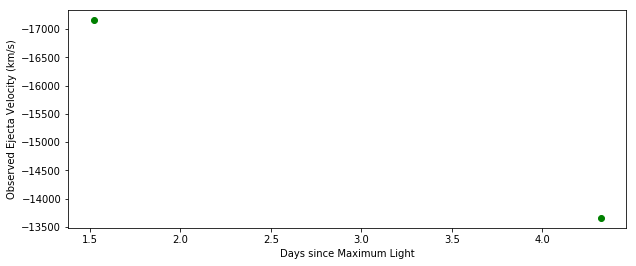

2008bf [u'SN08bf_080328_b01_NTT_EM.dat'] [-1.323203421777879] [-18670.590379746835]


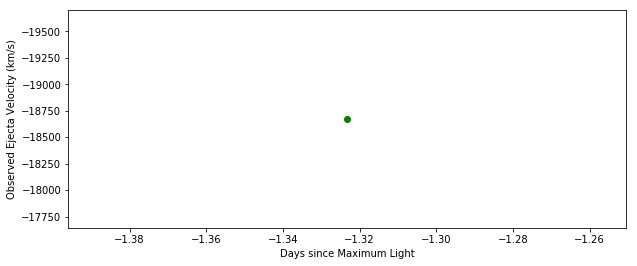

2002dj [u'2002dj_20020621_3255_9271_00.dat', u'2002dj_20020703_3397_9281_00.dat', u'2002dj_20020704_3340_10256_00.dat', u'2002dj_20020707_3201_9077_00.dat', u'2002dj_20020711_3304_10259_00.dat'] [-4.427413306806489, 7.460919582365518, 8.451613989796519, 11.423697212089522, 15.386474841813524] [-19429.55746835443, -14875.754936708861, -16090.102278481012, -17000.862784810128, -15482.928607594937]


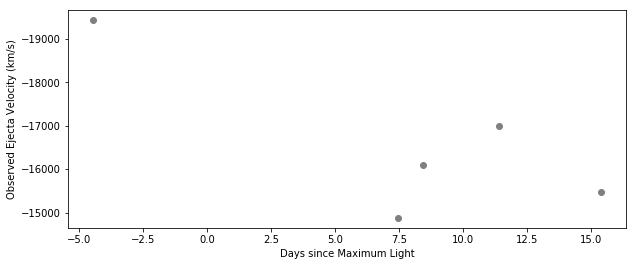

2001ba [u'sn2001ba-20010508.791-hst.flm', u'sn2001ba-20010516.229-hst.flm'] [2.6448268527125136, 10.415159141259917] [-14420.374683544303, -12902.440506329114]


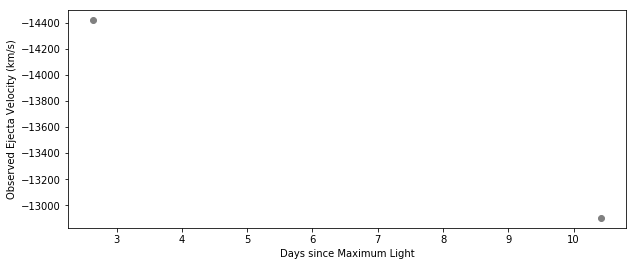

2001ep [u'sn2001ep-20011028.024-hst.flm'] [10.117171653362998] [-14116.787848101267]


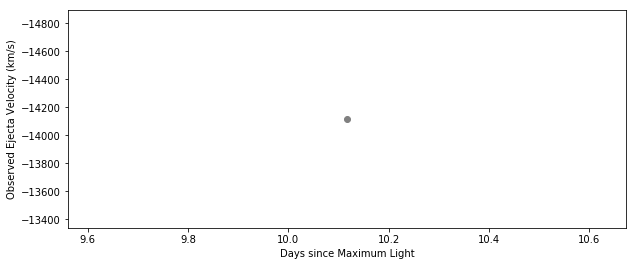

In [36]:
for object in SN_ca_v_object_list:
    print object.name, object.files,object.phases, object.ca_velocities
    
    #print object.sources
    color_data = []
    for entry in object.sources:
        color_code = color(entry)
        color_data.append(color_code)
    
    #print color_data
    x = object.phases
    y = object.ca_velocities
    
    #plt.plot(x,y)    
    plt.figure(figsize=(10,4))
    plt.xlabel("Days since Maximum Light")
    plt.ylabel("Observed Ejecta Velocity (km/s)")
    ax = plt.gca()
    ax.invert_yaxis()
    for i in range(len(x)):
        #if x[i] < 0:
        plt.plot(x[i],y[i], "o", color=color_data[i])

    plt.show()

# Adding File to Database

In [81]:
ca_file = open("ca_velocities.txt", "w")
for n in range(0,len(ca_velocities)):
    ca_file.write(ca_velocities_file[n] + " " + str(ca_velocities[n]) + "\n")
ca_file.close()

In [84]:
con = sq3.connect("..\data\SNIaDB_Spec_v20_phot_v10.db")
cur = con.cursor()
#con.execute("""ALTER TABLE Supernovae ca_vel REAL""")
with open("ca_velocities.txt", "r") as ca_file:
    lines = ca_file.readlines()
    for line in lines:
        filename, ca_vel = line.split()
        ca_vel = float(ca_vel)
        print filename, ca_vel
        cur.execute(("UPDATE Supernovae SET ca_vel = ? where filename = ?"), (ca_vel, filename))
con.commit()

sn1991t-19910505.flm -11384.5063291
sn1993ac-19931022-uoi.flm -15179.3417722
sn1994d-19940317.flm -18518.796962
sn1994d-19940318.flm -18215.2101266
sn1994d-19940404.flm -10929.1260759
sn1994q-19940603-uoh.flm -17759.8298734
sn1994s-19940616-uoi.flm -11232.7129114
sn1995d-19950224-uohp.flm -12295.2668354
sn1995e-19950224-uoi2.flm -16849.0693671
sn1997bp-19970416-uoi.flm -19125.9706329
sn1997br-19970416-uoi.flm -10473.7458228
sn1997y-19970209-uohp.flm -13509.6141772
sn1998dk-19980831-ui.flm -19125.9706329
sn1998dm-19980831-ui-corrected.flm -12902.4405063
sn1998dm-19980920-ui-corrected.flm -12447.0602532
sn1998dx-19980921-ui.flm -14116.7878481
sn1998ec-19981015-ui.flm -15331.1351899
sn1998es-19981125-ui-corrected.flm -17304.4496203
sn1999aa-19990223-ui.flm -17608.0364557
sn1999ac-19990312-ui-corrected.flm -15331.1351899
sn1999cp-19990709-ui-corrected.flm -10929.1260759
sn1999cp-19990718-ui-corrected.flm -10625.5392405
sn1999cw-19990709-ui.flm -14420.3746835
sn1999da-19990709-ui.flm -14723

sn1999by-19990508.15-fast.flm -11991.68
sn1999by-19990514.15-fast.flm -11232.7129114
sn1999cl-19990610.22-fast.flm -20340.3179747
sn2001ay-20010426.41-mmt.flm -19884.9377215
sn2001bf-20010525.47-mmt.flm -16241.8956962
sn2001da-20010715.47-mmt.flm -19733.1443038
sn2002ha-20021104.11-mmt.flm -16697.2759494
sn2002he-20021104.50-mmt.flm -16090.1022785
sn2003ch-20030329.11-mmt.flm -18215.2101266
sn2005am-20050309.25-fast.flm -19125.9706329
sn2007if-20070911.29-mmt.flm -8348.63797468
sn2007if-20070912.30-mmt.flm -7893.25772152
sn2008C-20080111.32-mmt.flm -13509.6141772
SN05eq_051018_b01_NTT_EM.dat -16849.0693671
SN05ke_051208_b01_T60_CS.dat -12143.4734177
SN05lu_051218_b01_NTT_EM.dat -13813.2010127
SN05na_060116_b01_NTT_EM.dat -11839.8865823
SN06gj_061005_b01_NTT_EM.dat -13357.8207595
SN06is_061005_b01_NTT_EM.dat -14723.961519
SN06kf_061103_b01_NTT_EM.dat -17000.8627848
SN06lu_061103_b01_NTT_EM.dat -16090.1022785
SN07af_070326_b01_DUP_BC.dat -11991.68
SN07ai_070314_b01_DUP_BC.dat -15938.3088

In [85]:
ca_V1_query = "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ca_vel < -14000"

ca_V2_query = "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase >= -3 and phase <= 3 and ca_vel > -14000"

In [86]:
ca_V1_array = composite.grab(ca_V1_query, multi_epoch = True, make_corr = True, selection = "max_coverage")
ca_V2_array = composite.grab(ca_V2_query, multi_epoch = True, make_corr = True, selection = "max_coverage")

172 questionable files currently ignored
0 questionable spectra removed 69 spectra left
0 Peculiar Ias removed 69 spectra left
(35, 'spectra with host corrections')
(35, 'valid SNe found')
Arrays cleaned
172 questionable files currently ignored
0 questionable spectra removed 30 spectra left
0 Peculiar Ias removed 30 spectra left
(14, 'spectra with host corrections')
(14, 'valid SNe found')
Arrays cleaned


In [89]:
for SN in ca_V1_array 

AttributeError: 'supernova' object has no attribute 'ca_vel'

# Silicon Velocity File

In [190]:
si_query = "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase <= 20 and minwave <= 5000 and maxwave >= 6500 and source != 'swift_uv'"
si_Array = composite.grab(si_query, multi_epoch = True, make_corr = True, selection = "max_coverage")

('ERROR: ', u'2002bo_20020313_3360_7726_00.dat', None)
172 questionable files currently ignored
('Generate variance failed for: ', [u'2005cf_20050601_3243_9720_00.dat'])
160 questionable spectra removed 2229 spectra left
47 Peculiar Ias removed 2182 spectra left
(1028, 'spectra with host corrections')
(1028, 'valid SNe found')
Arrays cleaned


In [192]:
si_filenames = []
si_velocities = []
si_velocity_errors = []
n = 0

for object in si_Array:
    wavelength = object.wavelength[object.x1:object.x2]
    flux = object.flux[object.x1:object.x2]
    flux_error = 1/object.ivar[object.x1:object.x2] ** .5
    sm_flux = autosmooth(wavelength, object.flux[object.x1:object.x2], flux_error)
    
    min_wave = find_min_wave(wavelength, flux)
    velocity = si_velocity(min_wave)
    velocity_error = si_velocity_error(wavelength, flux, flux_error)
    
    si_filenames.append(object.filename)
    si_velocities.append(velocity)
    si_velocity_errors.append(velocity_error)
    
    print "Object", n, "completed"
    n = n+1

print si_filenames
print si_velocities
print si_velocity_errors

Object 0 completed
Object 1 completed
Object 2 completed
Object 3 completed


KeyboardInterrupt: 

In [37]:
si_file = open("si_velocities.txt", "w")
for n in range(0,len(si_velocities)):
    si_file.write(si_filenames[n] + " " + str(si_velocities[n]) + " " + str(si_velocity_errors[n]) + "\n")
si_file.close()

# Equivalent Width file

In [128]:
ew_query = "SELECT * from Supernovae inner join Photometry ON Supernovae.SN = Photometry.SN where phase > -5 and phase <= 20 and minwave <= 5000 and maxwave >= 6500 and source != 'swift_uv'"
ew_Array = composite.grab(ew_query, multi_epoch = True, make_corr = True, selection = "max_coverage")

172 questionable files currently ignored
141 questionable spectra removed 1847 spectra left
40 Peculiar Ias removed 1807 spectra left
(852, 'spectra with host corrections')
(852, 'valid SNe found')
Arrays cleaned


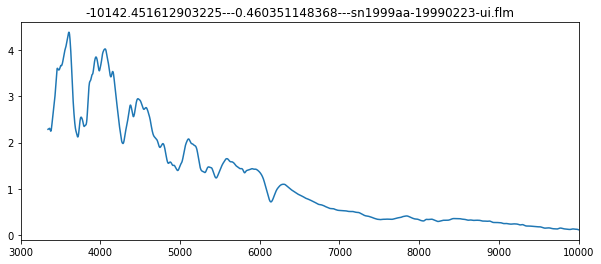

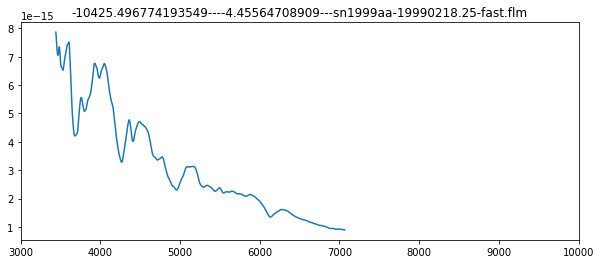

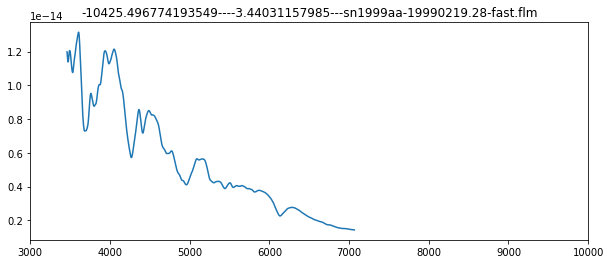

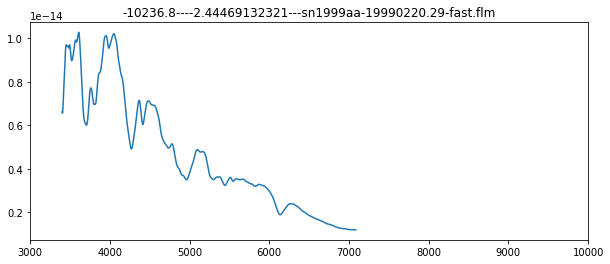

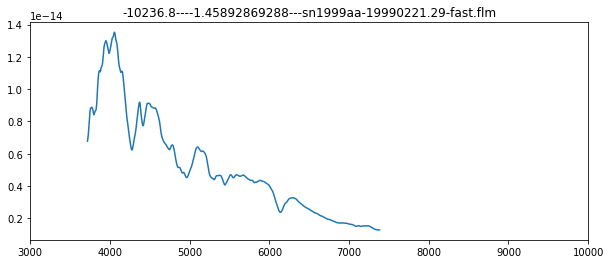

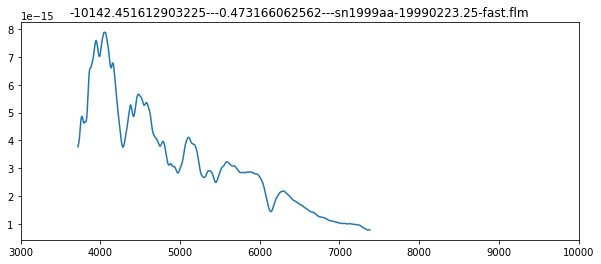

In [187]:
for object in ew_Array:
    if object.name == "1999aa" and -6 < object.phase < 10:
        wavelength = object.wavelength[object.x1:object.x2]
        flux = object.flux[object.x1:object.x2]
        flux_error = 1/object.ivar[object.x1:object.x2] ** .5
        sm_flux = autosmooth(wavelength, flux, flux_error)
        
        min_wave = find_min_wave(wavelength, sm_flux, 5900, 6300)
        v = si_velocity(min_wave)
        
        plt.figure(figsize=(10,4))
        plt.title(str(v) + "---" + str(object.phase) + "---" + object.filename)
        #plt.xlabel("Days since Maximum Light")
        #plt.ylabel("Observed Ejecta Velocity (km/s)")
        ax = plt.gca()
        #ax.set_ylim([-18000, -5000])
        ax.set_xlim([3000, 10000])
        #print object.phase
        plt.plot(wavelength, sm_flux)
        plt.show()

In [149]:
ew_data = []
ew_filenames = []
for object in ew_Array:
    wavelength = object.wavelength[object.x1:object.x2]
    flux = object.flux[object.x1:object.x2]
    flux_error = 1/object.ivar[object.x1:object.x2] ** .5
    sm_flux = autosmooth(wavelength, flux, flux_error)
    
    ew = eq_width(wavelength, sm_flux)
    
    ew_data.append(ew)
    ew_filenames.append(object.filename)

print ew_data
print ew_filenames

C:\Anaconda3\envs\py27\lib\site-packages\ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in divide
  


[108.6776565773568, 133.44181332469424, 83.12702364552723, 99.80325368790852, 137.0622123574774, 108.58289286485046, 100.04636028182904, 89.58047721301023, 53.36221573506765, 76.80767352498049, 94.28003784369048, 86.31373241370903, 102.21041326793585, 124.51478539469247, 120.55539128990944, 144.5080614819471, 160.0049247970157, 43.226401143163116, 61.42763343236106, 80.06446140861237, 111.8801399732597, 112.34696169946983, 177.55781180699273, 123.78216256396297, 147.18439803520437, 98.1276733615033, 76.83705343727365, 124.87159396375819, 77.63472413894192, 135.4552232326689, 118.76154250863783, 126.57720990352789, 61.540525663030905, 141.57986088894415, 161.01424396273228, 117.72421195360266, 120.87542849481235, 129.85559240645392, 128.07834591658332, 68.65605512462093, 120.6001852361884, 130.2670794996243, 90.18918872180461, 99.78020117687686, 99.208394380524, 105.40238935887976, 77.9549274044374, 104.2677771696915, 87.59982758590007, 162.80840128600875, 102.54510387533264, 187.412567

In [150]:
si_ew_file = open("si_ew.txt", "w")
for n in range(0,len(ew_data)):
    si_ew_file.write(ew_filenames[n] + " " + str(ew_data[n]) + "\n")
si_ew_file.close()

In [134]:
class ew_species:
    def __init__(self, name, objects):
        self.name = name
        self.objects = objects

In [172]:
ew_objects = []
name_table = []
object_table = []
#for n in range(0, len(ew_Array)):
#    if ew_Array[n].name != ew_Array[n-1].name:
#        name_table.append(ew_Array[n].name)
#print len(name_table)

subset = []
for n in range(0, len(ew_Array)):
    if ew_Array[n].name == ew_Array[n-1].name:
        subset.append(ew_Array[n])
        
    elif n == 0:
        subset.append(ew_Array[n])
    
    elif  ew_Array[n].name != ew_Array[n-1].name:
        object_table.append(subset)
        name_table.append(subset[0].name)
        subset = []
        subset.append(ew_Array[n])

print len(object_table), len(name_table)

for n in range(0,len(name_table)):
    ew_object = ew_species(name_table[n], object_table[n])
    ew_objects.append(ew_object)

279 279


In [174]:
ew0_names = []
ew0_data = []
ew0_phases = []

for event in ew_objects:
    phases = []
    print event.objects
    for file in event.objects:
        print file.phase
        phases.append(file.phase)
    
    print phases
    index = np.argmin(phases)
    best = event.objects[index]
    wavelength = best.wavelength[best.x1:best.x2]
    flux = best.flux[best.x1:best.x2]
    flux_error = 1/best.ivar[best.x1:best.x2] ** .5
    sm_flux = autosmooth(wavelength, flux, flux_error)
    
    ew_obs = eq_width(wavelength, sm_flux)
    ew_0 = eq_width_0(ew_obs, best.phase)
    
    ew0_names.append(best.name)
    ew0_data.append(ew_0)
    ew0_phases.append(best.phase)
    
print ew0_names, ew0_data, ew0_phases

12.5753882934
[12.57538829337492]
12.5023832221
[12.50238322211436]
0.998840596273
[0.9988405962732136]
-2.1768034995
[-2.176803499498083]
18.9274696293
[18.927469629349428]
2.77201914426
[2.7720191442561264]
4.7115224089
[4.71152240889689]
7.39102149597
[7.391021495972468]
[<composite.supernova object at 0x00000000626771D0>, <composite.supernova object at 0x0000000062677240>, <composite.supernova object at 0x0000000062677278>]
0.460351148368
14.2541276346
17.2557748439
[0.4603511483683075, 14.254127634580161, 17.25577484393372]
-0.385339276873
[-0.3853392768725628]
[<composite.supernova object at 0x0000000062677358>, <composite.supernova object at 0x00000000626773C8>]
4.85695605658
13.7981931291
[4.856956056582031, 13.798193129139484]
[<composite.supernova object at 0x00000000626774A8>, <composite.supernova object at 0x00000000626774E0>]
-2.69083978888
6.18350046164
[-2.6908397888787294, 6.183500461641901]
16.792780011
[16.79278001103658]
[<composite.supernova object at 0x000000006267

C:\Anaconda3\envs\py27\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: divide by zero encountered in divide


11.5466849745
[11.546684974500831]
7.06661434318
[7.066614343178003]
-1.34909797218
[-1.3490979721847325]
5.35461482092
[5.354614820922365]
6.48260139398
[6.482601393978524]
-2.67712752871
[-2.677127528705919]
17.8409149951
[17.840914995133208]
-4.99116894806
[-4.991168948062785]
11.088748182
[11.088748181991917]
13.4439170583
[13.44391705827415]
19.3397034415
[19.339703441469755]
1.41616176363
[1.4161617636340815]
8.26
[8.26]
-0.670578373849
[-0.6705783738492764]
[<composite.supernova object at 0x0000000061F3F550>, <composite.supernova object at 0x0000000061F3F588>, <composite.supernova object at 0x0000000061F3F5C0>]
-4.49596515947
3.42394892158
10.2994354179
[-4.495965159474161, 3.4239489215778196, 10.299435417920149]
[<composite.supernova object at 0x0000000061F3F5F8>, <composite.supernova object at 0x0000000061F3F630>]
-3.6064946058
0.0310988486616
[-3.6064946058033294, 0.031098848661576788]
14.7264661453
[14.726466145284077]
7.46168401136
[7.4616840113551985]
[<composite.supernova

6.47611411359
[6.476114113587971]
[<composite.supernova object at 0x000000006219D240>, <composite.supernova object at 0x000000006219D278>]
6.74928503336
10.5910390848
[6.749285033359839, 10.591039084836327]
[<composite.supernova object at 0x000000006219D6A0>, <composite.supernova object at 0x000000006219D6D8>, <composite.supernova object at 0x000000006219D710>, <composite.supernova object at 0x000000006219D748>, <composite.supernova object at 0x000000006219D780>, <composite.supernova object at 0x000000006219D7F0>, <composite.supernova object at 0x000000006219D860>, <composite.supernova object at 0x000000006219D898>]
2.82642689601
3.82329945269
4.8885848319
5.89523064894
6.84323690383
7.79124315872
12.7365129007
13.6942924159
[2.8264268960123387, 3.82329945269412, 4.888584831900319, 5.895230648943747, 6.8432369038315155, 7.791243158719284, 12.736512900702934, 13.694292415945238]
[<composite.supernova object at 0x000000006219D9B0>, <composite.supernova object at 0x000000006219DA20>]
-3.9

[<composite.supernova object at 0x0000000062357550>, <composite.supernova object at 0x0000000062357588>, <composite.supernova object at 0x00000000623575C0>, <composite.supernova object at 0x00000000623575F8>, <composite.supernova object at 0x0000000062357630>, <composite.supernova object at 0x0000000062357668>, <composite.supernova object at 0x00000000623576A0>, <composite.supernova object at 0x00000000623576D8>, <composite.supernova object at 0x0000000062357710>]
-4.45564708909
-3.44031157985
-2.44469132321
-1.45892869288
0.473166062562
14.2738428872
15.2398902649
16.2256528952
17.2705612834
[-4.455647089089085, -3.4403115798501864, -2.444691323214735, -1.4589286928845933, 0.4731660625616239, 14.273842887183608, 15.239890264910304, 16.225652895240444, 17.2705612833881]
[<composite.supernova object at 0x0000000062357748>, <composite.supernova object at 0x0000000062357780>, <composite.supernova object at 0x00000000623577B8>, <composite.supernova object at 0x00000000623577F0>, <composite

[<composite.supernova object at 0x0000000062A75C18>, <composite.supernova object at 0x0000000062A75C50>, <composite.supernova object at 0x0000000062A75C88>, <composite.supernova object at 0x0000000062A75CC0>, <composite.supernova object at 0x0000000062A75CF8>, <composite.supernova object at 0x0000000062A75D30>, <composite.supernova object at 0x0000000062A75D68>, <composite.supernova object at 0x0000000062A75DA0>, <composite.supernova object at 0x0000000062A75DD8>, <composite.supernova object at 0x0000000062A75E10>, <composite.supernova object at 0x0000000062A75E48>, <composite.supernova object at 0x0000000062A75E80>]
-3.25723575182
-2.2701946149
-1.28315347799
-0.325723575183
0.671187973101
1.66809952139
2.6551406583
3.63231138384
4.61935252076
5.6261344804
6.59343479458
7.5804759315
[-3.2572357518173014, -2.270194614903838, -1.2831534779903748, -0.32572357518316647, 0.6711879731014423, 1.668099521386051, 2.6551406582995143, 3.6323113838418317, 4.619352520755295, 5.626134480403867, 6.5

[<composite.supernova object at 0x00000000626D36D8>, <composite.supernova object at 0x00000000626D3710>, <composite.supernova object at 0x00000000626D3748>, <composite.supernova object at 0x00000000626D3780>, <composite.supernova object at 0x00000000626D37B8>, <composite.supernova object at 0x00000000626D37F0>, <composite.supernova object at 0x00000000626D3828>, <composite.supernova object at 0x00000000626D3860>, <composite.supernova object at 0x00000000626D3898>, <composite.supernova object at 0x00000000626D38D0>, <composite.supernova object at 0x00000000626D3908>, <composite.supernova object at 0x00000000626D3940>]
-1.49229064183
0.422896696543
1.40479477358
2.34780579806
2.40613637689
3.36859092765
4.33104547841
5.32266531858
6.15873694853
7.25729618324
14.0722521436
15.0541502207
[-1.492290641827124, 0.4228966965426218, 1.4047947735798534, 2.3478057980603846, 2.4061363768918986, 3.3685909276543167, 4.331045478409662, 5.322665318580763, 6.158736948532137, 7.257296183239469, 14.07225

[<composite.supernova object at 0x00000000620DFF98>, <composite.supernova object at 0x00000000620DFFD0>]
8.31577930235
10.3159725577
[8.315779302347828, 10.315972557734542]
[<composite.supernova object at 0x0000000062C30048>, <composite.supernova object at 0x0000000062C30080>, <composite.supernova object at 0x0000000062C300B8>]
5.98313478785
6.91053024074
11.7100407289
[5.983134787847897, 6.910530240743057, 11.710040728913313]
15.1652270614
[15.16522706138676]
[<composite.supernova object at 0x0000000062C30390>, <composite.supernova object at 0x0000000062C303C8>, <composite.supernova object at 0x0000000062C30400>, <composite.supernova object at 0x0000000062C30438>]
6.98439593349
9.99881787375
11.8902198755
15.8207896603
[6.984395933489424, 9.99881787375035, 11.890219875482414, 15.820789660340598]
1.35693730517
[1.3569373051738791]
[<composite.supernova object at 0x0000000062C30630>, <composite.supernova object at 0x0000000062C30668>]
10.3220195903
16.1783456956
[10.322019590293065, 16.

[<composite.supernova object at 0x0000000062C2B518>, <composite.supernova object at 0x0000000062C2B550>, <composite.supernova object at 0x0000000062C2B588>, <composite.supernova object at 0x0000000062C2B5C0>, <composite.supernova object at 0x0000000062C2B5F8>, <composite.supernova object at 0x0000000062C2B630>, <composite.supernova object at 0x0000000062C2B668>, <composite.supernova object at 0x0000000062C2B6A0>, <composite.supernova object at 0x0000000062C2B6D8>, <composite.supernova object at 0x0000000062C2B710>, <composite.supernova object at 0x0000000062C2B748>]
-2.4845283882
-0.483102742148
1.54790062281
2.45495066929
3.4211561536
5.39300408074
6.37892804431
7.35499276825
8.33105749218
9.32684069539
12.3930642221
[-2.4845283881984885, -0.4831027421483112, 1.5479006228078807, 2.4549506692924736, 3.42115615359627, 5.3930040807404325, 6.378928044312514, 7.354992768246865, 8.331057492181218, 9.326840695391029, 12.393064222100776]
[<composite.supernova object at 0x0000000062C2B7B8>, <c

[<composite.supernova object at 0x0000000061EF1898>, <composite.supernova object at 0x0000000061EF18D0>, <composite.supernova object at 0x0000000061EF1908>, <composite.supernova object at 0x0000000061EF1940>, <composite.supernova object at 0x0000000061EF1978>, <composite.supernova object at 0x0000000061EF19B0>, <composite.supernova object at 0x0000000061EF19E8>, <composite.supernova object at 0x0000000061EF1A20>, <composite.supernova object at 0x0000000061EF1A58>]
0.68807339449
2.62053484286
3.65508491118
4.58227601015
7.50048799531
10.467499512
11.394690611
13.3661916846
16.2356041382
[0.6880733944900159, 2.6205348428632362, 3.655084911180308, 4.582276010150019, 7.500487995312973, 10.467499512003265, 11.394690610965874, 13.366191684559544, 16.23560413819516]
4.74592897783
[4.745928977833407]
-0.290415500851
[-0.2904155008508899]
[<composite.supernova object at 0x0000000061F14710>, <composite.supernova object at 0x0000000061F14748>]
-2.65907487186
3.17103438207
[-2.659074871861097, 3.1

In [178]:
ew0_file = open("si_ew0.txt", "w")
for n in range(0, len(ew0_names)):
    ew0_file.write(ew0_names[n] + " " + str(ew0_data[n]) + " " + str(ew0_phases[n]) + "\n")
ew0_file.close()

In [ ]:
# for statistical error of velocity :smooth spectrum based on ideal smoothing, add noise based on the SNR 

In [188]:
# split events with llinear fitby spacing between measurements from -10<n<10 days
# use relativistic velocity formula